# Import Libraries

In [1]:
import torch
from torch.utils .data import DataLoader
import pdb #debugger
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

# Setting Parameters & Hyper-Parameters

In [2]:
epochs = 500
cur_step = 0 #step counter
info_step = 300 #visualize in each 300 steps
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64 #size of noise vector
lr = 0.00001
loss_fn = nn.BCEWithLogitsLoss() #scale to [0,1] + BCELoss
batch_size = 128

device = 'cuda'

#number of steps = 60000(MNIST images) / 128 = 468.75 ~ 469

# Generator

In [3]:
def genBlock(inp_size, out_size):
    return nn.Sequential(
    nn.Linear(inp_size, out_size),
    nn.BatchNorm1d(out_size),
    nn.ReLU(inplace=True)
    )

#z_dim - size of input latent space vector
#i_dim - size of generated image output (28*28) (default argument)
#h_dim = hidden layer (default argument)
class Generator(nn.Module): #child of nn.module
    def __init__(self, z_dim=64, i_dim=784, h_dim=128):
        super().__init__() #parent constructor
        self.gen = nn.Sequential(
        genBlock(z_dim, h_dim), #64 -> 128
        genBlock(h_dim, h_dim*2), #128 -> 256
        genBlock(h_dim*2, h_dim*4), #256 -> 512
        genBlock(h_dim*4, h_dim*8), #512 -> 1024
        nn.Linear(h_dim*8, i_dim), #1024 -> 784(28*28)
        nn.Sigmoid()
        )
        
    def forward(self, noise):
        return self.gen(noise)

# Discriminator

In [4]:
def discBlock(inp_size, out_size):
    return nn.Sequential(
    nn.Linear(inp_size, out_size),
    nn.LeakyReLU(0.2)
    )

class Discriminator(nn.Module):
    def __init__(self, i_dim=784, h_dim=256):
        super().__init__()
        self.disc = nn.Sequential(
        discBlock(i_dim, h_dim*4), #784 -> 1024
        discBlock(h_dim*4, h_dim*2), # 1024-> 512
        discBlock(h_dim*2, h_dim), #512 -> 256
        nn.Linear(h_dim, 1) #256 -> 1
        )
    
    def forward(self, image):
        return self.disc(image)

# Creating Object of Generator & Discriminator

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)

disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

In [6]:
gen
#track_running_Stats - keep track of stats all batch (not just current batch)
#affine - dynamic tuning of batch norm params

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

In [7]:
disc

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Linear(in_features=784, out_features=1024, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): Linear(in_features=1024, out_features=512, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (3): Linear(in_features=256, out_features=1, bias=True)
  )
)

# Data Iterator

In [8]:
dataloader = DataLoader(MNIST('.', download=True, transform=transforms.ToTensor()), shuffle=True, batch_size = batch_size) #download and transform to tensor (for compatibility)

def gen_noise(number, z_dim): #number - no of noise vectors ; z_dim - size of noise vectors
    return torch.randn(number, z_dim).to(device) #store in GPU

noise = gen_noise(batch_size, z_dim)

In [9]:
x, y = next(iter(dataloader)) #returns next batch of dataloader which is casted into iterator
print(x.shape, y.shape)
print(y[:10])

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([9, 5, 5, 7, 8, 9, 0, 6, 2, 5])


# Visualization Function - Generator Output

In [10]:
#visualize first 16 images in a batch of size 128
# tensor : 128(batch size) * 28 * 28
def show(tensor, ch=1, size=(28, 28), num=16):
    data = tensor.detach().cpu().view(-1, ch, *size)#detach from gradient computations to visualize & reshape to 128x1(ch)x28x28
    grid = make_grid(data[:num], nrow=4).permute(1,2,0) #16x1x28x28 -> 1x28x28 =>28x28x1 change order of shape for plt compatibility
    plt.imshow(grid)
    plt.show()

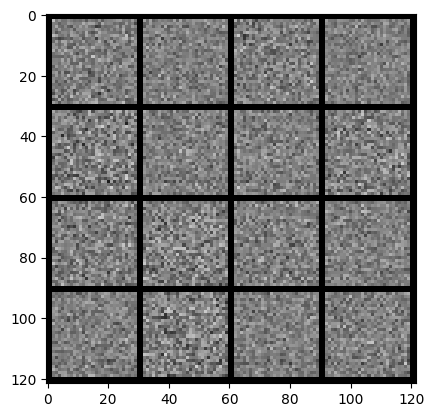

In [11]:
fake = gen(noise)
show(fake)

Initial output from generator before learning when noise is inputted

# Loss Function

## Generator Loss

In [13]:
#number - batch size
def gen_loss(loss_func, gen, disc, number, z_dim):
    noise = gen_noise(number, z_dim)
    fake = gen(noise)
    pred = disc(fake)
    targets = torch.ones_like(pred)
    gen_loss = loss_func(pred, targets)
    return gen_loss

## Discriminator Loss

In [14]:
#real - set of real images
def disc_loss(loss_func, gen, disc, number, real, z_dim):
    noise = gen_noise(number, z_dim)
    fake = gen(noise)
    
    disc_fake = disc(fake.detach()) #detach from grad calc- not needed to alter parameter of generator whenoptimizing discriminator
    disc_fake_targets = torch.zeros_like(disc_fake)
    disc_fake_loss = loss_func(disc_fake, disc_fake_targets)
    
    disc_real = disc(real)
    disc_real_targets = torch.ones_like(disc_real)
    disc_real_loss = loss_func(disc_real, disc_real_targets)
    
    disc_loss = (disc_fake_loss + disc_real_loss)/2
    
    return disc_loss

# Training Loop

  0%|          | 0/469 [00:00<?, ?it/s]

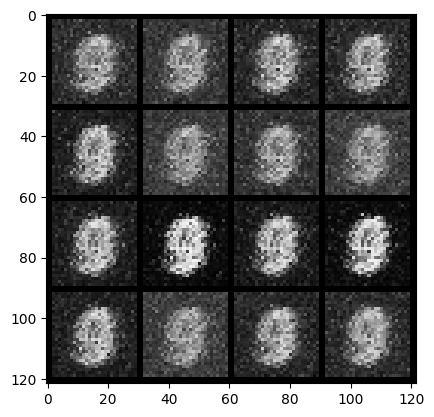

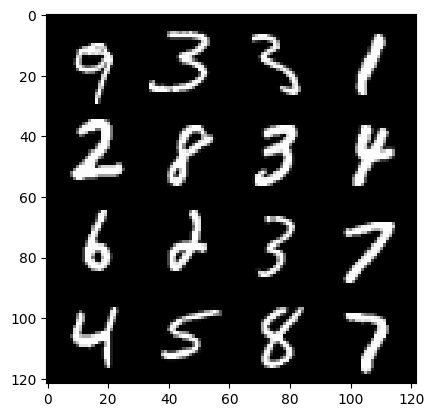

0: Step 300 / Gen Loss : 1.9695088706413904 / Disc Loss : 0.336393819600344


  0%|          | 0/469 [00:00<?, ?it/s]

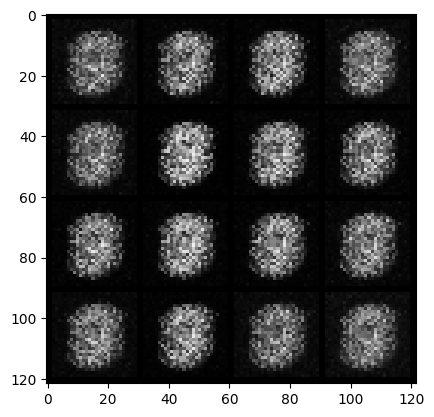

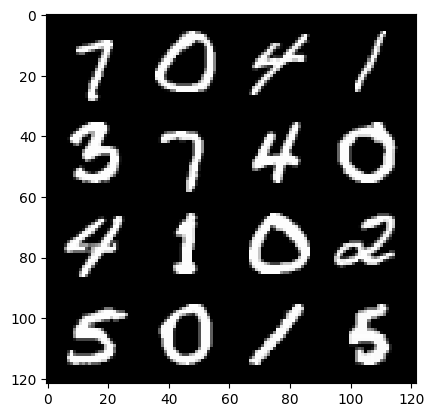

1: Step 600 / Gen Loss : 3.4822283132871 / Disc Loss : 0.12315110526978978


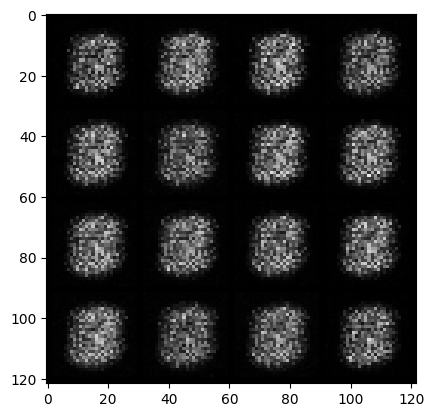

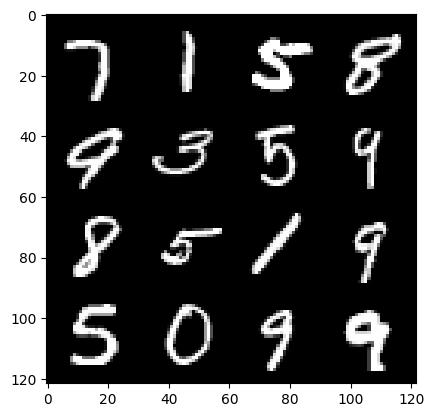

1: Step 900 / Gen Loss : 3.3125112382570903 / Disc Loss : 0.06296183920154969


  0%|          | 0/469 [00:00<?, ?it/s]

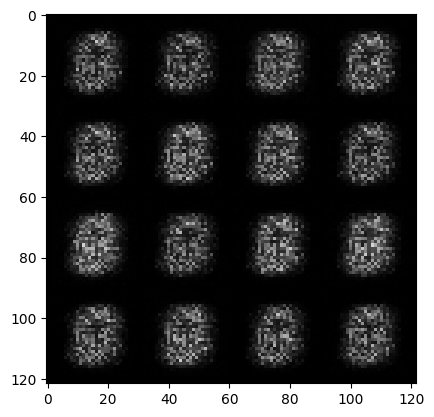

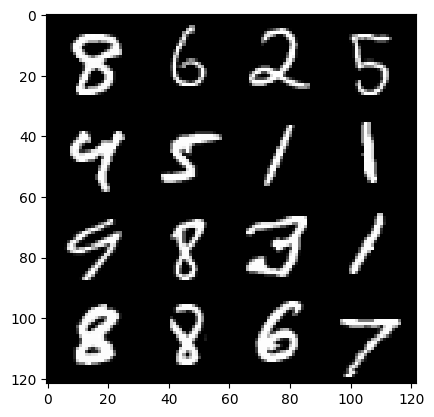

2: Step 1200 / Gen Loss : 3.2840597343444804 / Disc Loss : 0.045670056163022915


  0%|          | 0/469 [00:00<?, ?it/s]

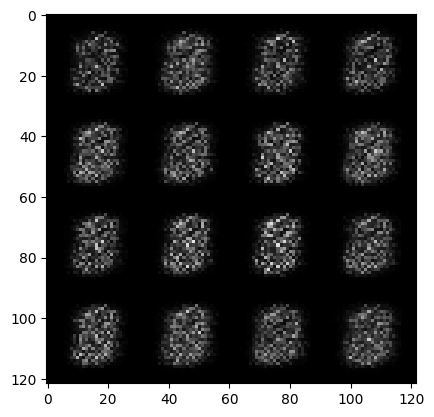

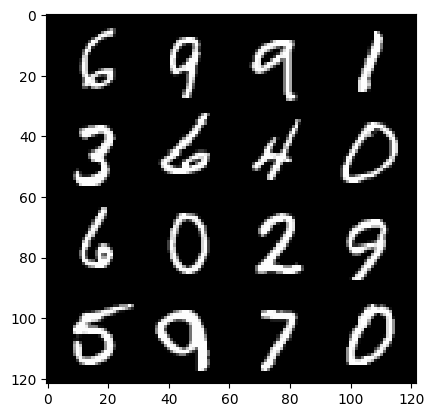

3: Step 1500 / Gen Loss : 3.324405984083811 / Disc Loss : 0.04105286018302042


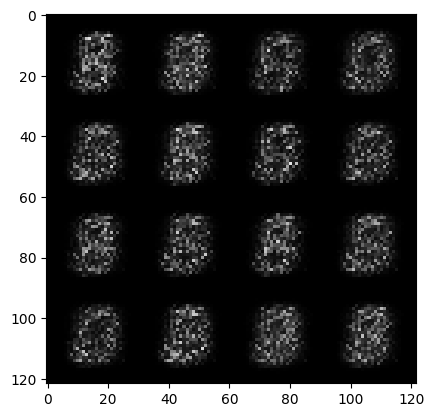

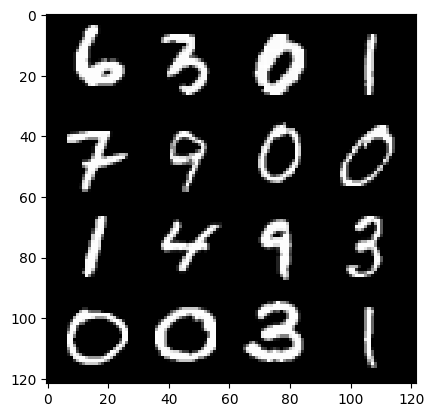

3: Step 1800 / Gen Loss : 3.507912597656251 / Disc Loss : 0.03613624817381302


  0%|          | 0/469 [00:00<?, ?it/s]

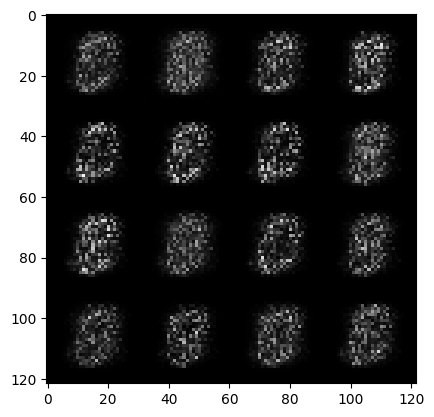

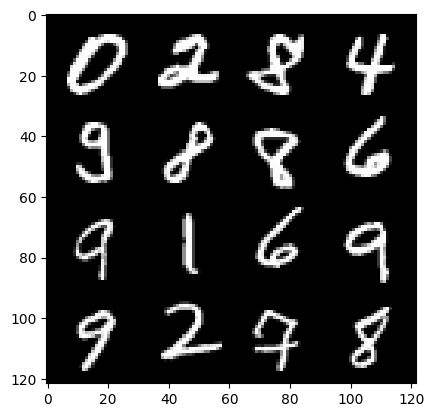

4: Step 2100 / Gen Loss : 3.814856434663136 / Disc Loss : 0.03301134690642358


  0%|          | 0/469 [00:00<?, ?it/s]

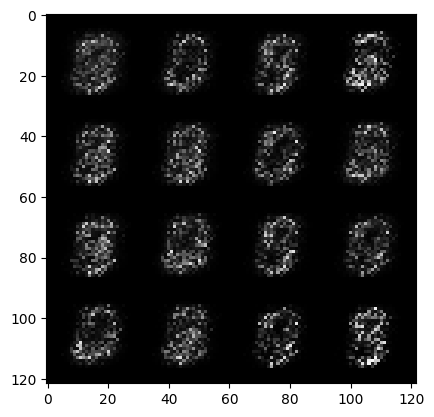

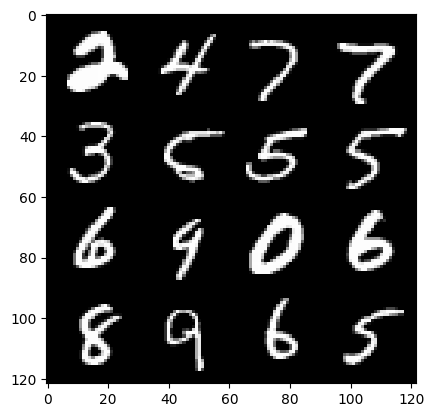

5: Step 2400 / Gen Loss : 4.1570853956540414 / Disc Loss : 0.02861059619734683


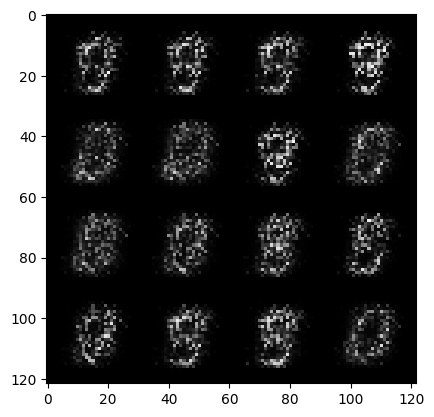

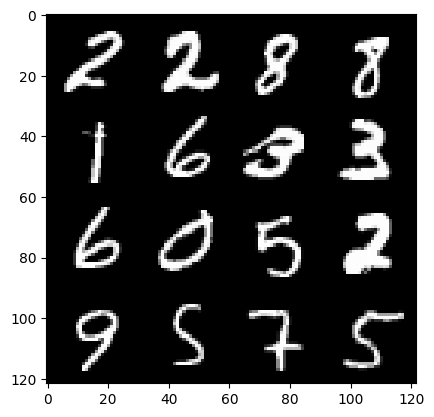

5: Step 2700 / Gen Loss : 4.3870491663614875 / Disc Loss : 0.023726798162485147


  0%|          | 0/469 [00:00<?, ?it/s]

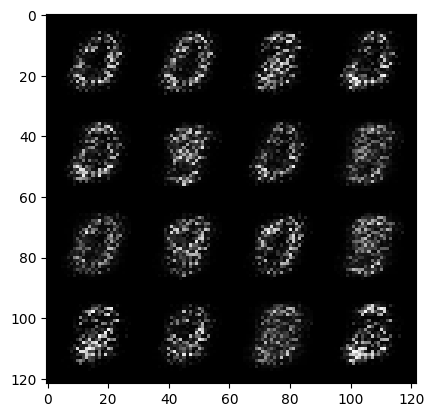

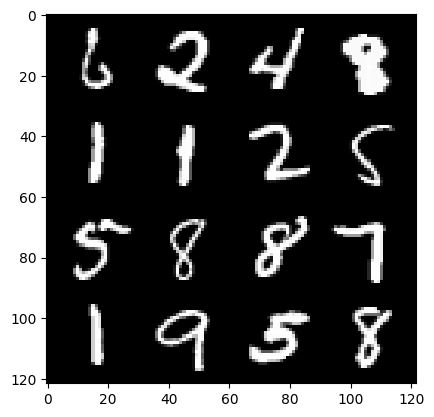

6: Step 3000 / Gen Loss : 4.786715087890628 / Disc Loss : 0.020444005494937304


  0%|          | 0/469 [00:00<?, ?it/s]

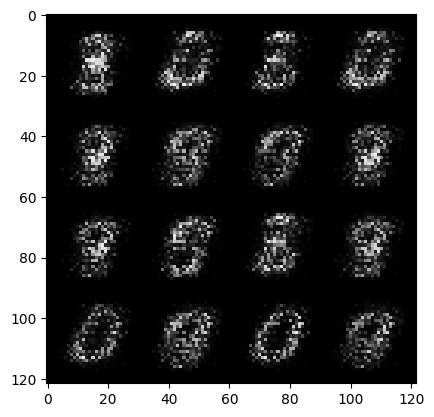

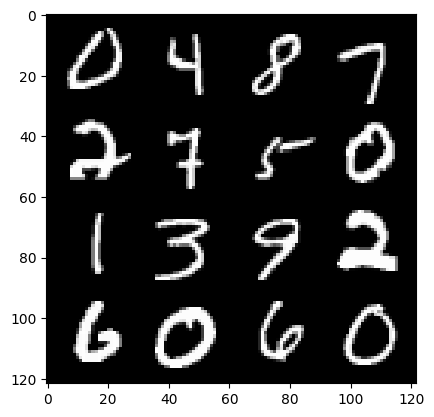

7: Step 3300 / Gen Loss : 5.455677248636881 / Disc Loss : 0.017902910476550467


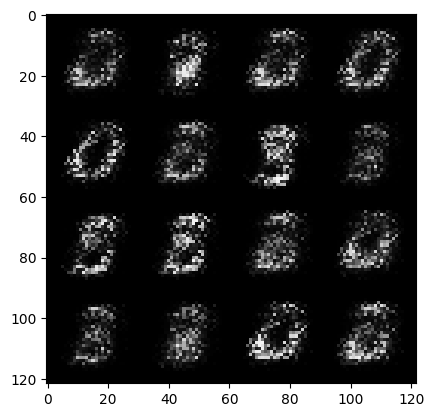

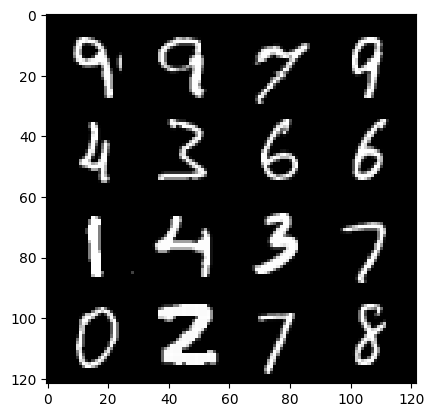

7: Step 3600 / Gen Loss : 5.934126989046729 / Disc Loss : 0.01686947981206079


  0%|          | 0/469 [00:00<?, ?it/s]

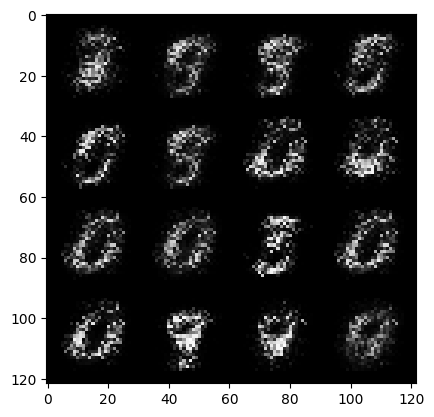

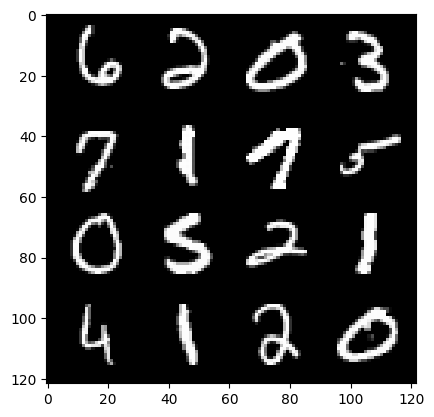

8: Step 3900 / Gen Loss : 5.413193519910179 / Disc Loss : 0.019624179853126412


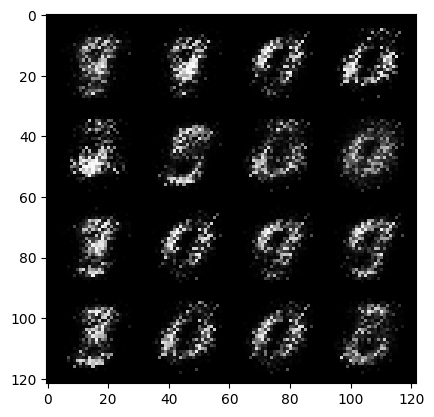

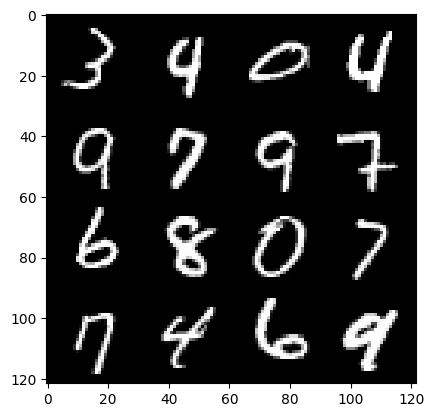

8: Step 4200 / Gen Loss : 5.3038843774795525 / Disc Loss : 0.018157652147735147


  0%|          | 0/469 [00:00<?, ?it/s]

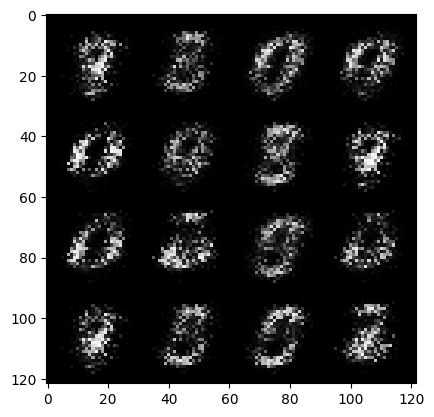

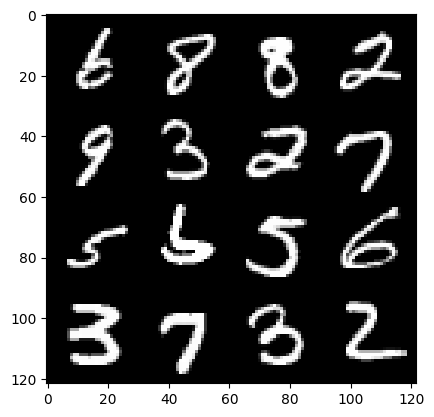

9: Step 4500 / Gen Loss : 6.060081162452696 / Disc Loss : 0.014080443006629747


  0%|          | 0/469 [00:00<?, ?it/s]

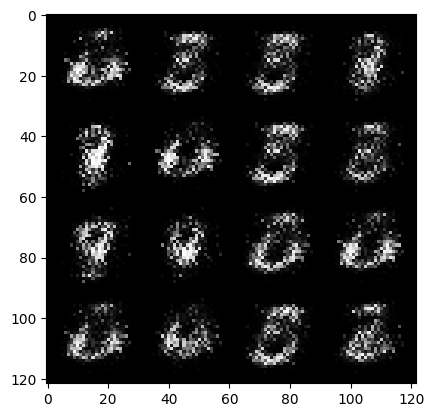

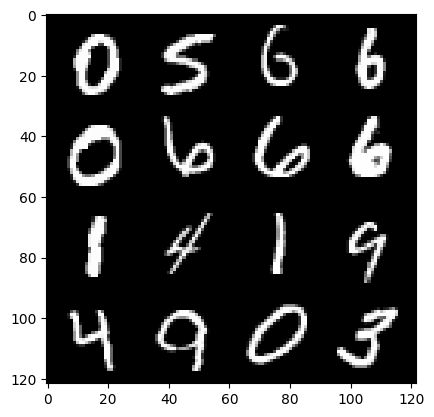

10: Step 4800 / Gen Loss : 6.34060114542643 / Disc Loss : 0.011748886254305637


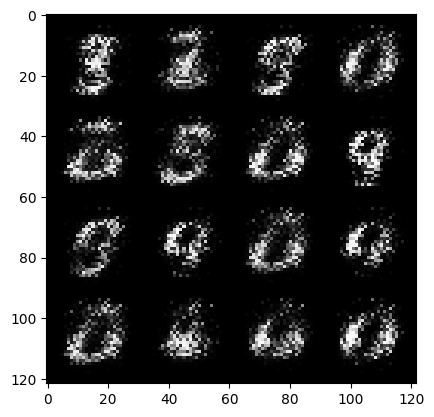

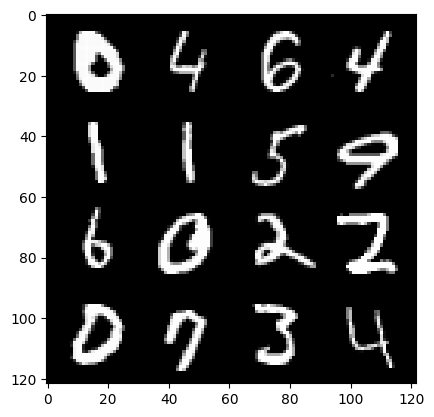

10: Step 5100 / Gen Loss : 6.460592627525326 / Disc Loss : 0.010071702285980186


  0%|          | 0/469 [00:00<?, ?it/s]

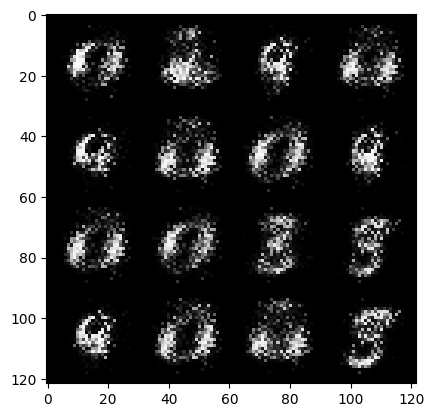

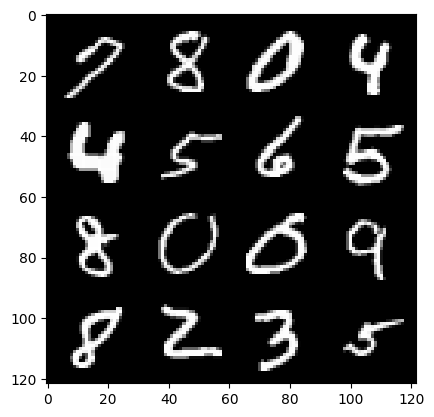

11: Step 5400 / Gen Loss : 6.580804344813024 / Disc Loss : 0.010683223592738314


  0%|          | 0/469 [00:00<?, ?it/s]

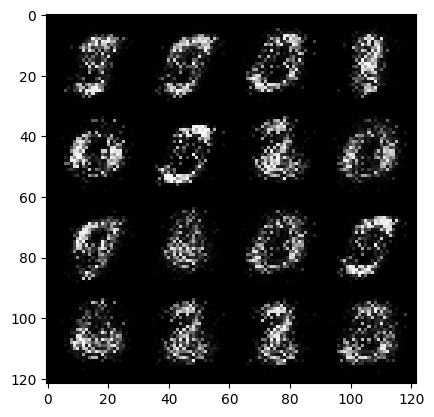

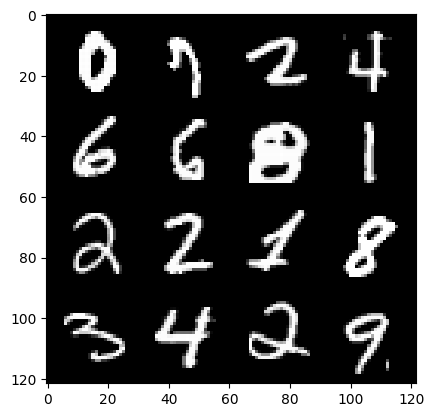

12: Step 5700 / Gen Loss : 6.491900027592975 / Disc Loss : 0.010856108942534779


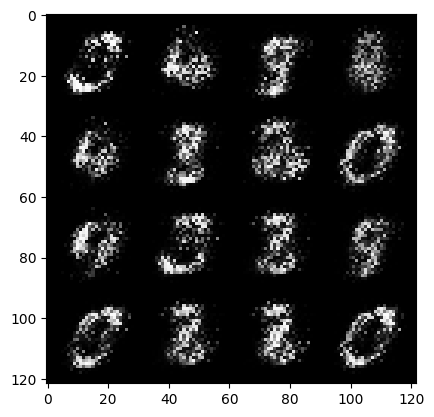

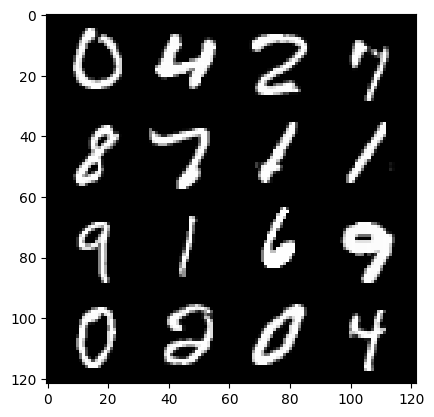

12: Step 6000 / Gen Loss : 6.954052421251934 / Disc Loss : 0.010850038005349536


  0%|          | 0/469 [00:00<?, ?it/s]

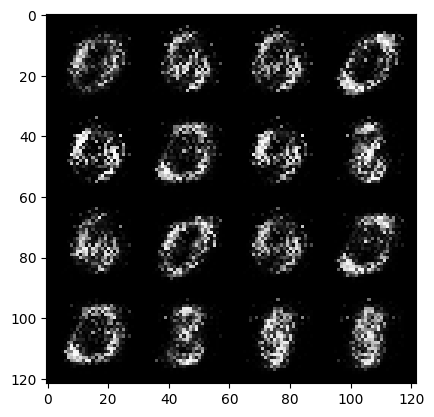

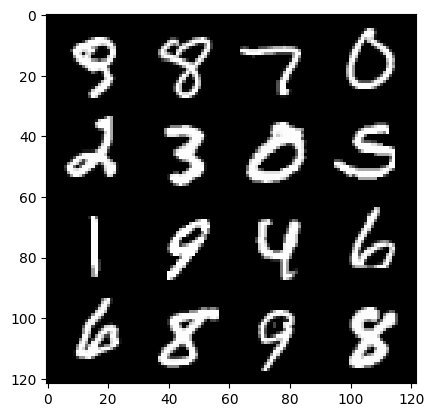

13: Step 6300 / Gen Loss : 7.310701886812849 / Disc Loss : 0.01123039384838194


  0%|          | 0/469 [00:00<?, ?it/s]

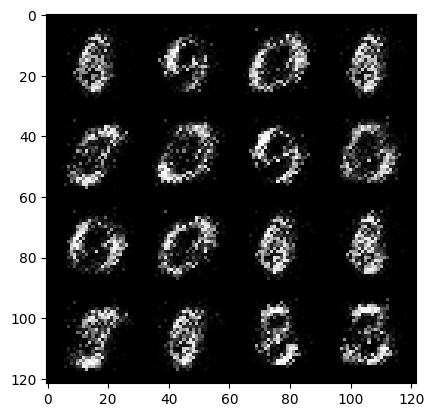

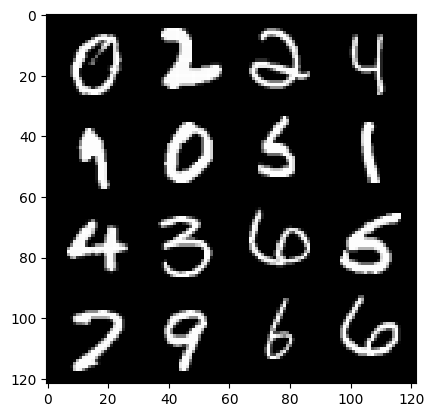

14: Step 6600 / Gen Loss : 7.070339255332944 / Disc Loss : 0.012083376144679877


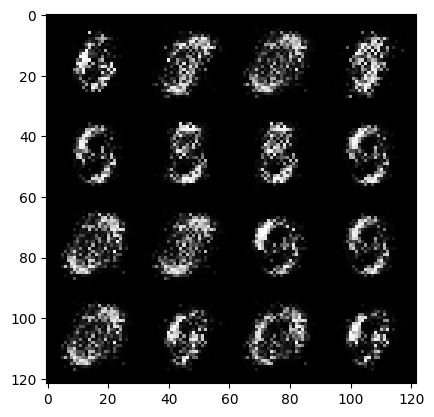

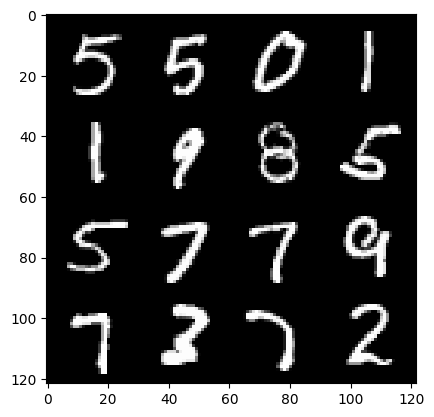

14: Step 6900 / Gen Loss : 6.594927309354148 / Disc Loss : 0.012573688027138517


  0%|          | 0/469 [00:00<?, ?it/s]

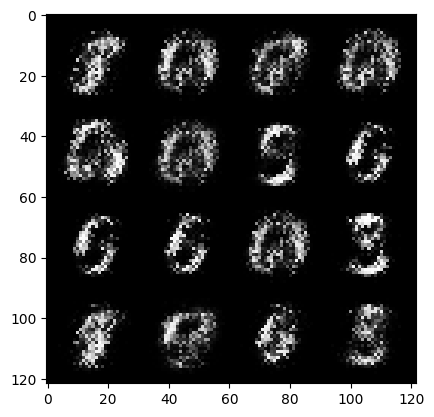

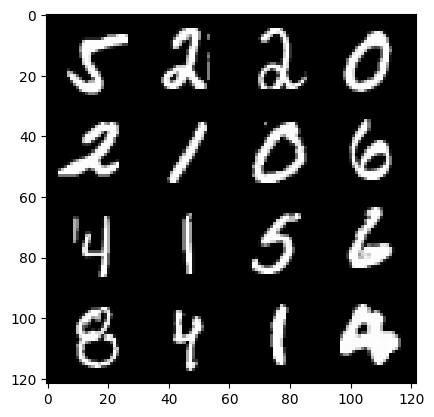

15: Step 7200 / Gen Loss : 6.911223862965905 / Disc Loss : 0.012924692709154141


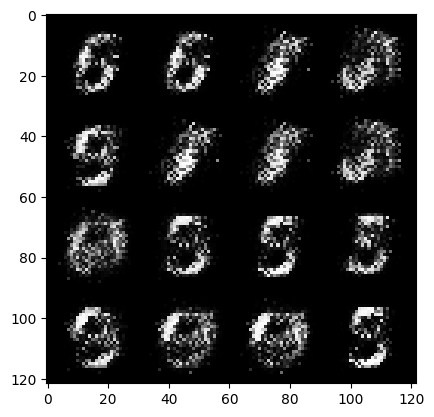

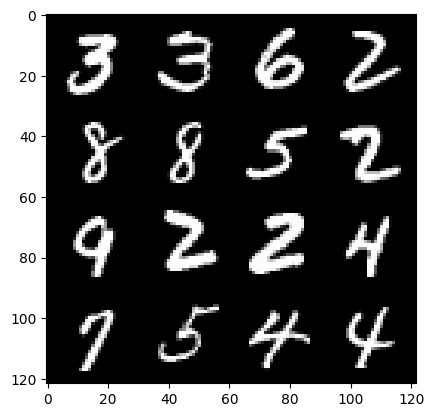

15: Step 7500 / Gen Loss : 6.522073828379308 / Disc Loss : 0.015588784180581563


  0%|          | 0/469 [00:00<?, ?it/s]

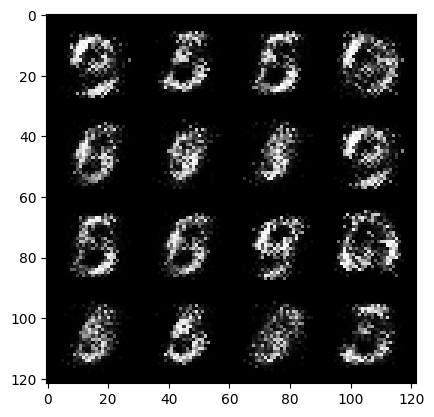

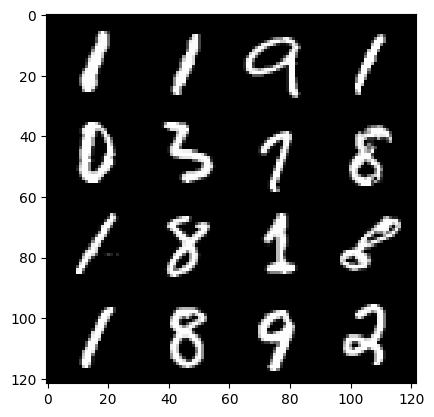

16: Step 7800 / Gen Loss : 7.048448855082195 / Disc Loss : 0.011505155504370725


  0%|          | 0/469 [00:00<?, ?it/s]

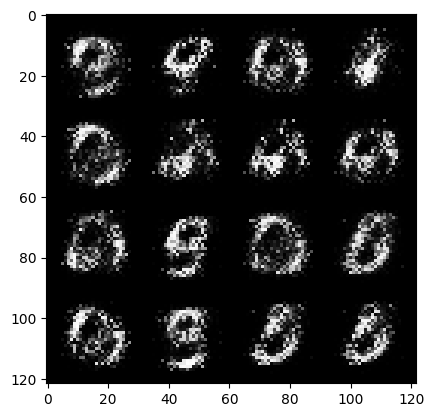

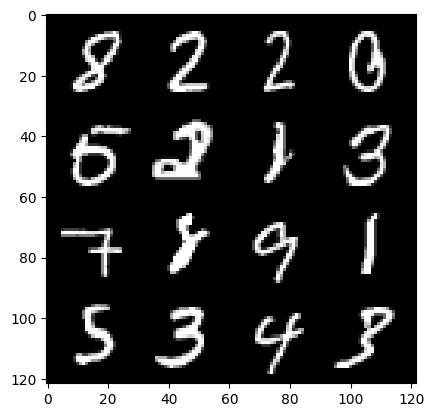

17: Step 8100 / Gen Loss : 7.030391287803647 / Disc Loss : 0.013290918121735261


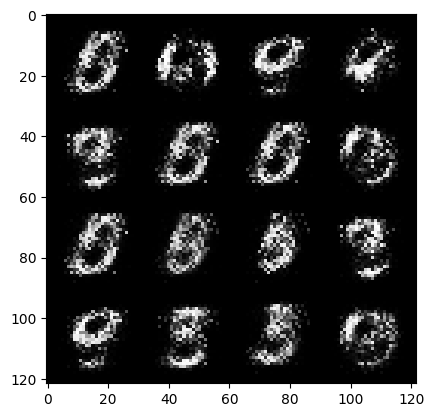

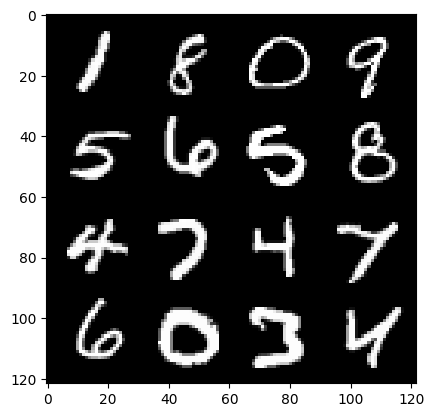

17: Step 8400 / Gen Loss : 6.910333739916482 / Disc Loss : 0.01208817023628702


  0%|          | 0/469 [00:00<?, ?it/s]

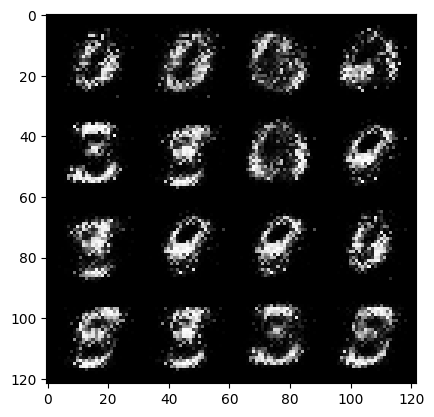

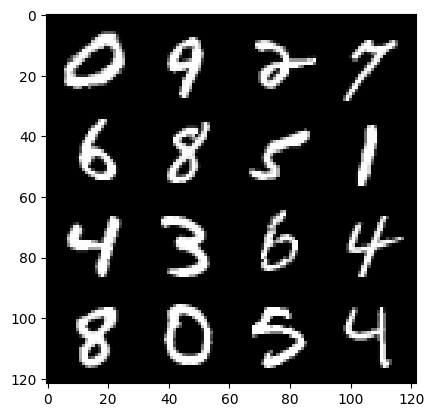

18: Step 8700 / Gen Loss : 6.795235516230268 / Disc Loss : 0.01276137803215534


  0%|          | 0/469 [00:00<?, ?it/s]

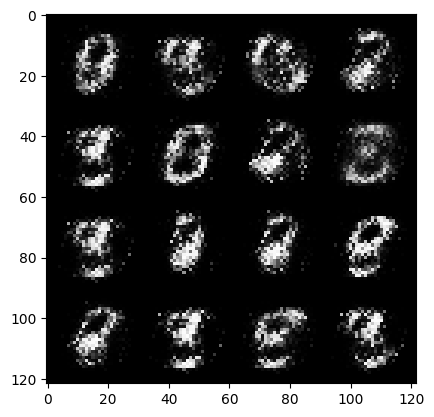

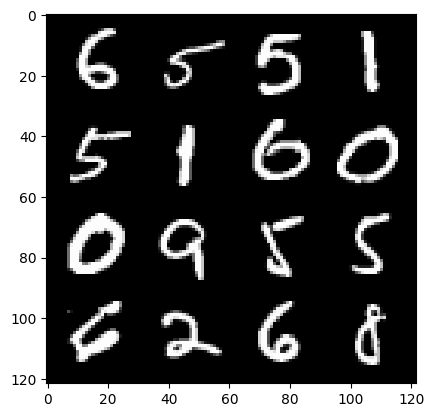

19: Step 9000 / Gen Loss : 7.0460977093378725 / Disc Loss : 0.013279235208562256


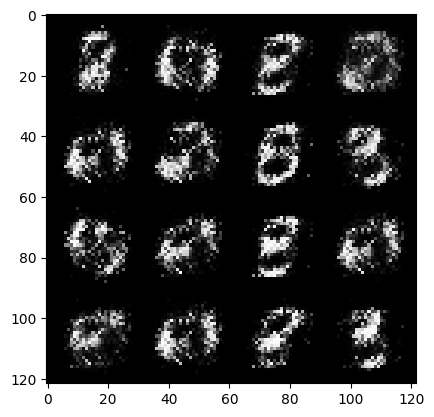

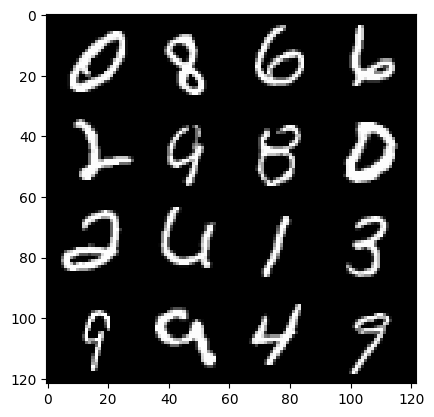

19: Step 9300 / Gen Loss : 6.558656603495283 / Disc Loss : 0.015987628668857116


  0%|          | 0/469 [00:00<?, ?it/s]

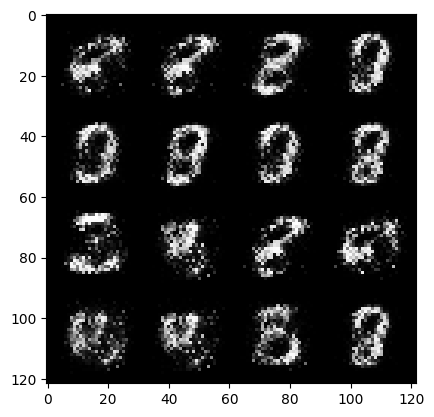

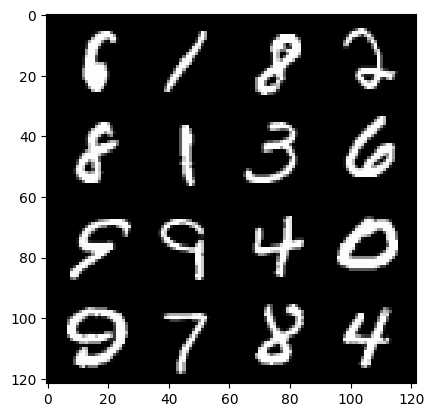

20: Step 9600 / Gen Loss : 6.631538740793866 / Disc Loss : 0.014766722770097359


  0%|          | 0/469 [00:00<?, ?it/s]

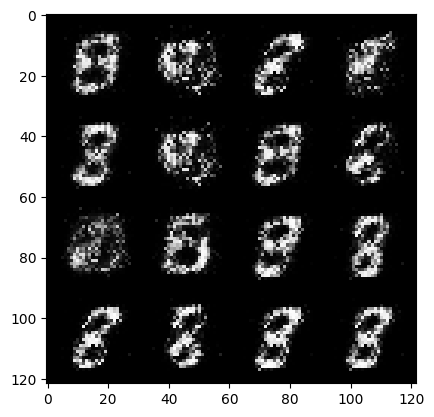

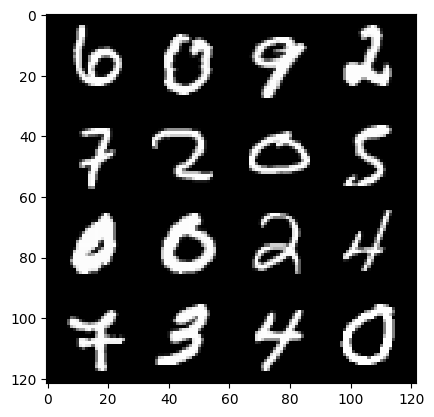

21: Step 9900 / Gen Loss : 6.446622331937155 / Disc Loss : 0.013682789374918986


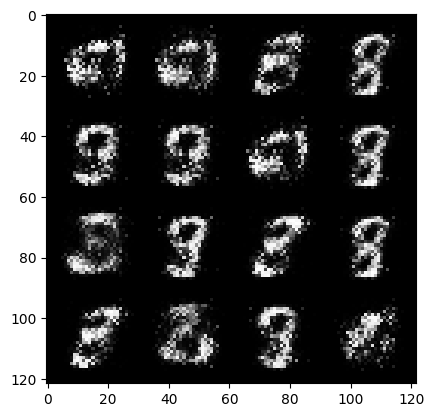

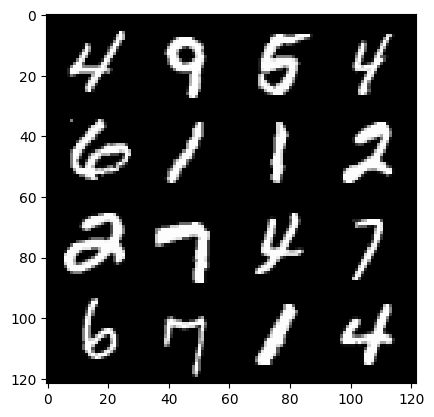

21: Step 10200 / Gen Loss : 6.598054679234826 / Disc Loss : 0.015018329470573619


  0%|          | 0/469 [00:00<?, ?it/s]

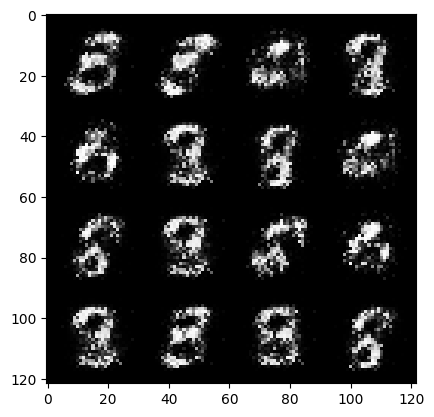

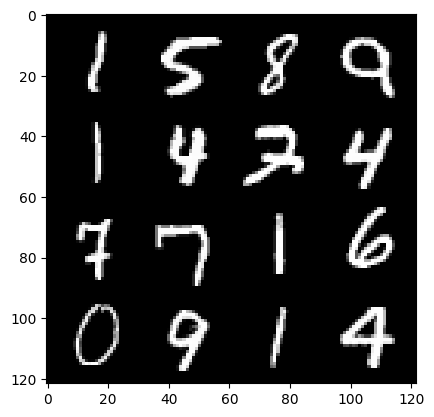

22: Step 10500 / Gen Loss : 6.382150301933286 / Disc Loss : 0.015067387276018666


  0%|          | 0/469 [00:00<?, ?it/s]

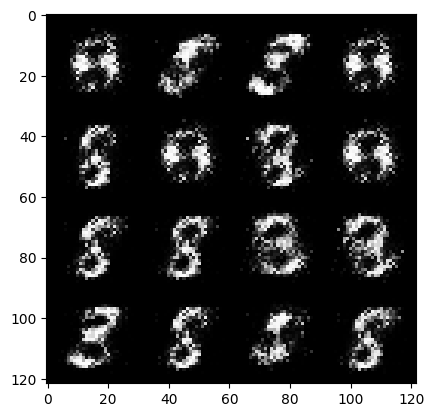

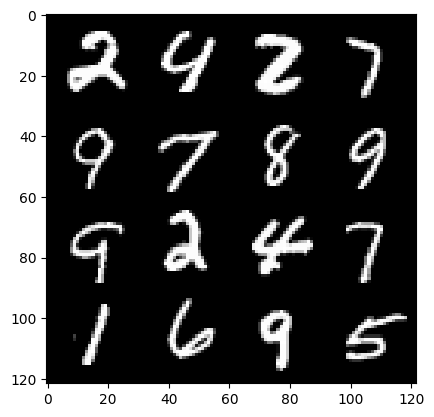

23: Step 10800 / Gen Loss : 6.320837788581851 / Disc Loss : 0.014665089589543642


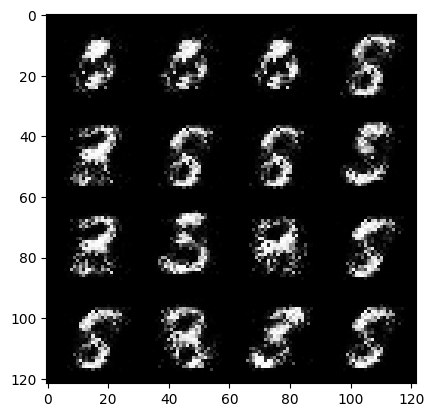

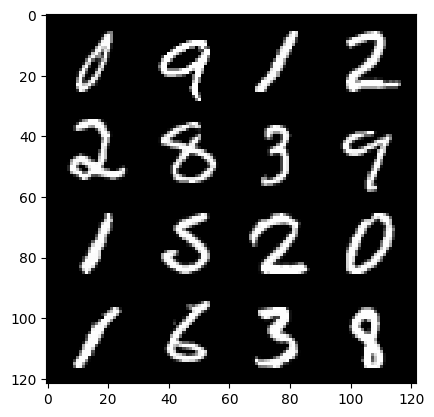

23: Step 11100 / Gen Loss : 6.337856383323669 / Disc Loss : 0.014308087263101104


  0%|          | 0/469 [00:00<?, ?it/s]

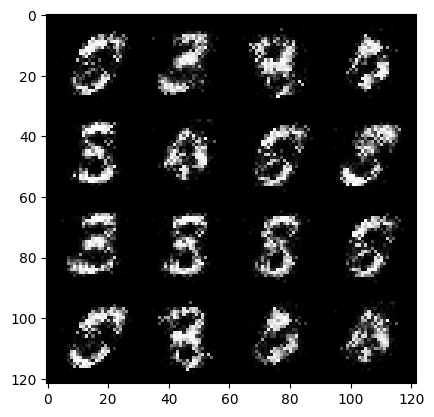

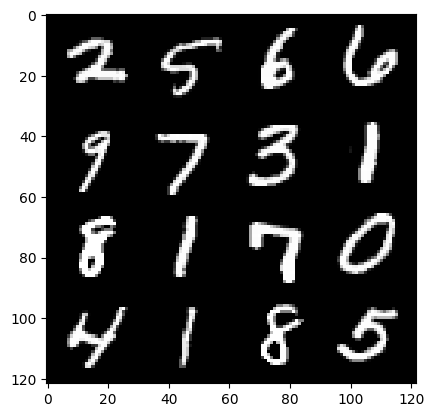

24: Step 11400 / Gen Loss : 6.543991716702778 / Disc Loss : 0.012190104373730718


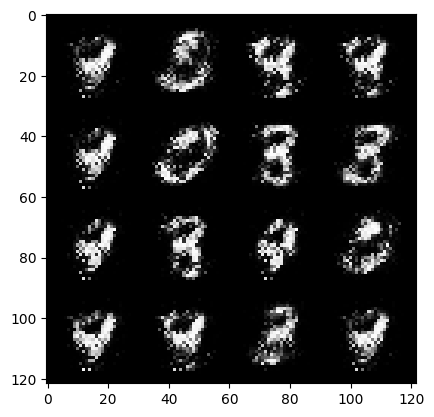

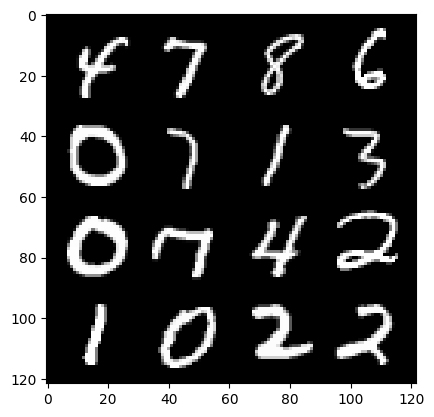

24: Step 11700 / Gen Loss : 6.709772731463118 / Disc Loss : 0.011872647730633616


  0%|          | 0/469 [00:00<?, ?it/s]

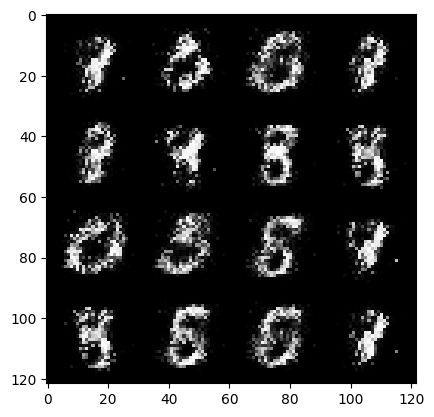

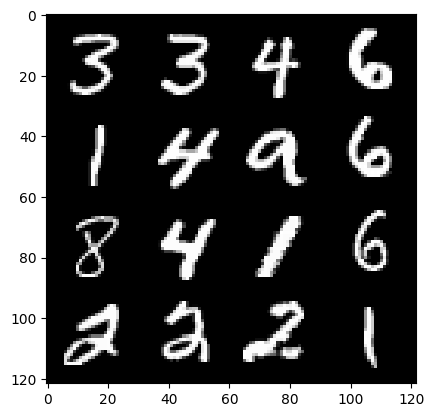

25: Step 12000 / Gen Loss : 6.725650688807169 / Disc Loss : 0.013675626503148429


  0%|          | 0/469 [00:00<?, ?it/s]

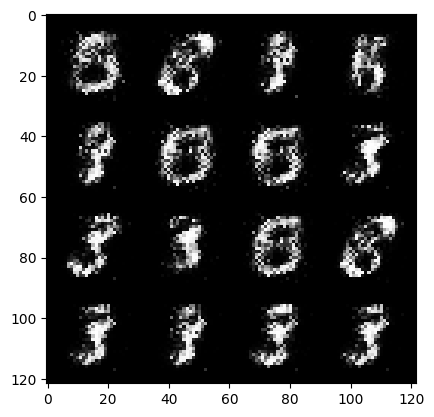

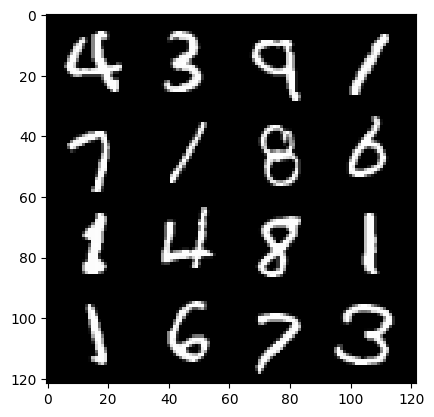

26: Step 12300 / Gen Loss : 6.737036325136823 / Disc Loss : 0.011758545733367404


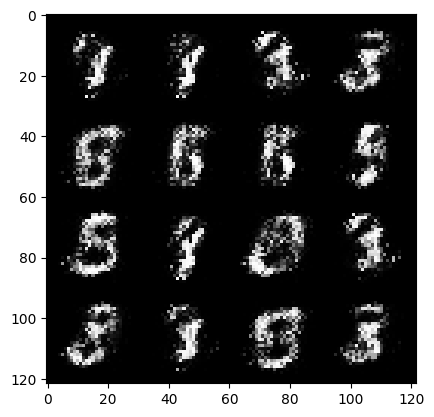

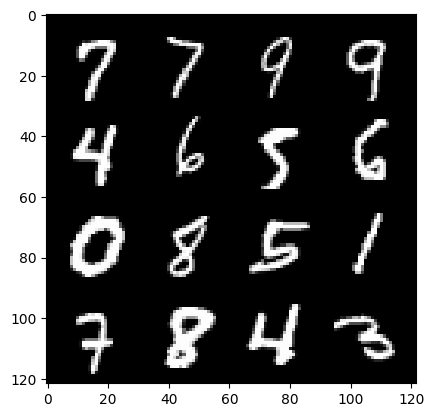

26: Step 12600 / Gen Loss : 6.705458350181579 / Disc Loss : 0.013412461987075712


  0%|          | 0/469 [00:00<?, ?it/s]

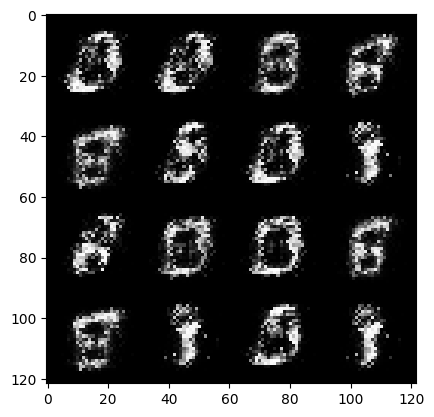

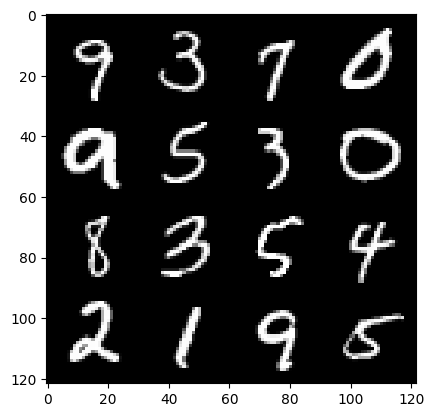

27: Step 12900 / Gen Loss : 6.572060227394101 / Disc Loss : 0.014205331569537521


  0%|          | 0/469 [00:00<?, ?it/s]

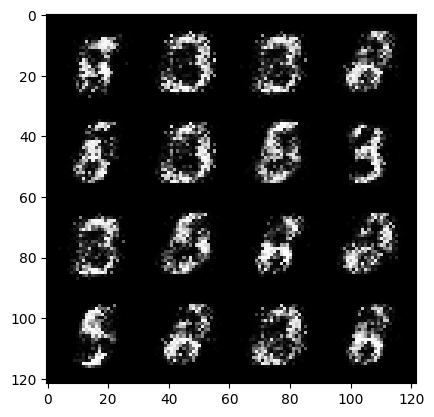

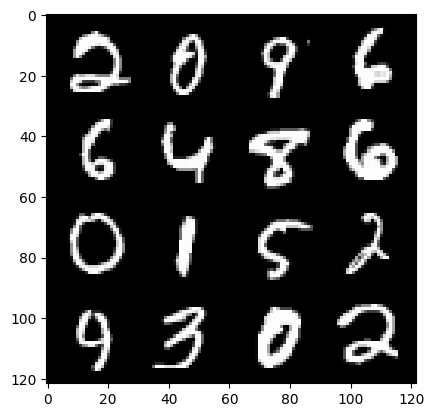

28: Step 13200 / Gen Loss : 6.293837674458825 / Disc Loss : 0.01566092312724019


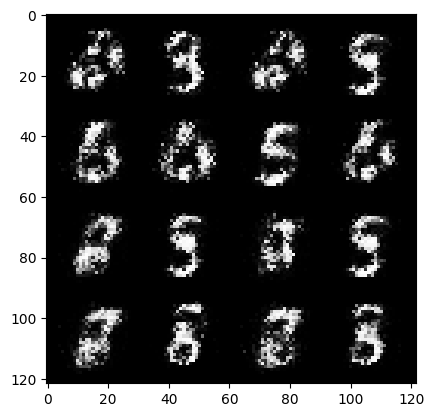

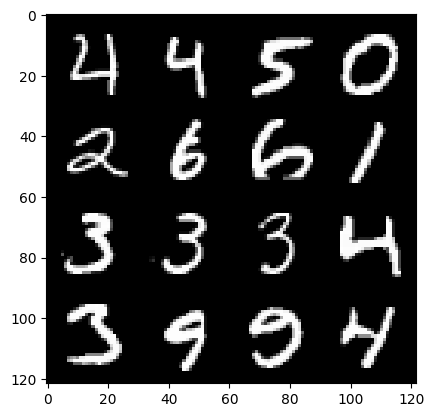

28: Step 13500 / Gen Loss : 6.248226203918454 / Disc Loss : 0.0186092634134305


  0%|          | 0/469 [00:00<?, ?it/s]

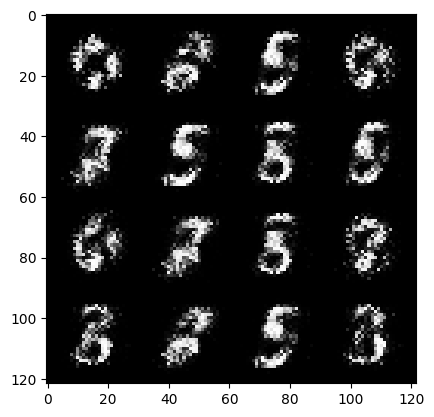

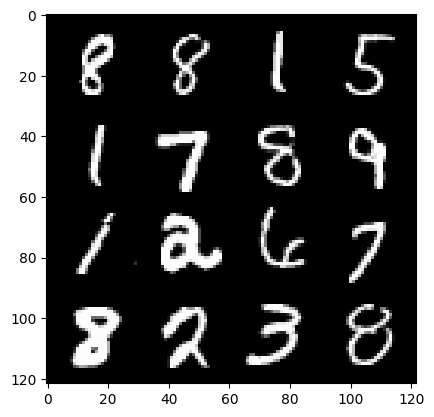

29: Step 13800 / Gen Loss : 6.451324817339582 / Disc Loss : 0.017562991927843555


  0%|          | 0/469 [00:00<?, ?it/s]

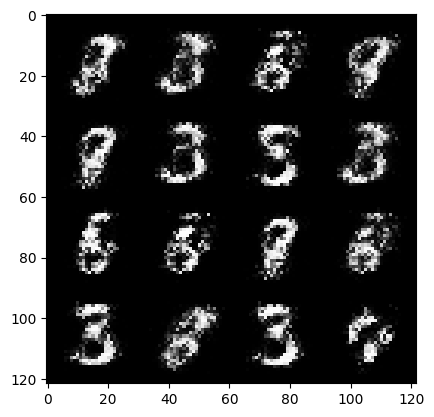

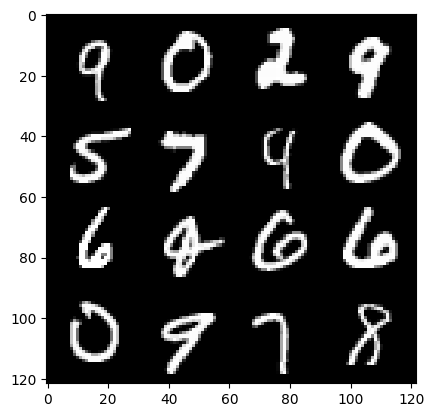

30: Step 14100 / Gen Loss : 6.489372229576113 / Disc Loss : 0.015815845741114266


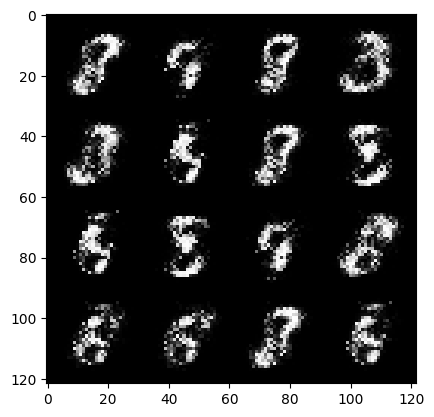

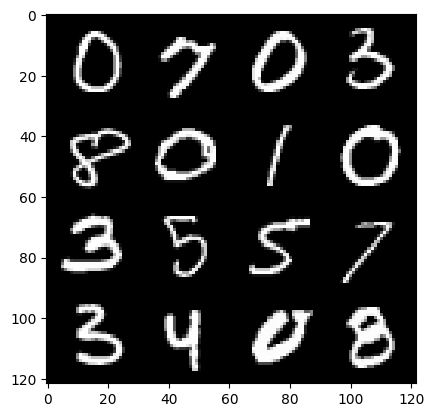

30: Step 14400 / Gen Loss : 6.402878443400067 / Disc Loss : 0.016911174662721653


  0%|          | 0/469 [00:00<?, ?it/s]

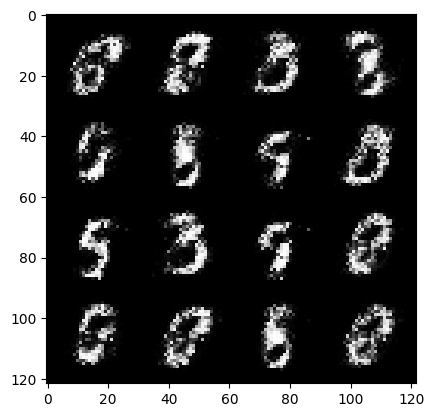

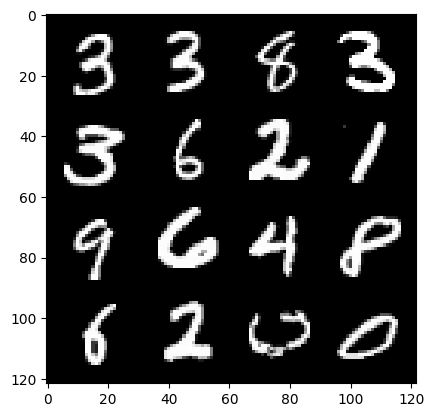

31: Step 14700 / Gen Loss : 6.474174060821533 / Disc Loss : 0.020392375052906593


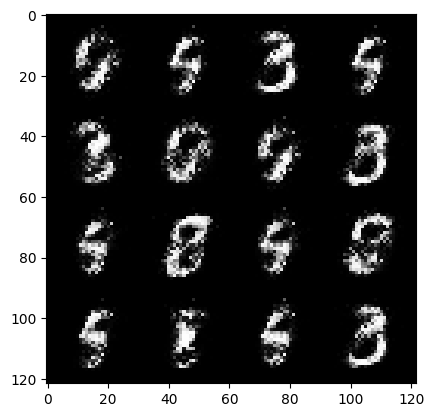

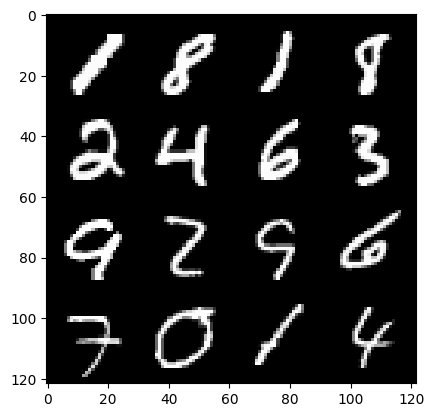

31: Step 15000 / Gen Loss : 5.907703280448913 / Disc Loss : 0.02656662550599626


  0%|          | 0/469 [00:00<?, ?it/s]

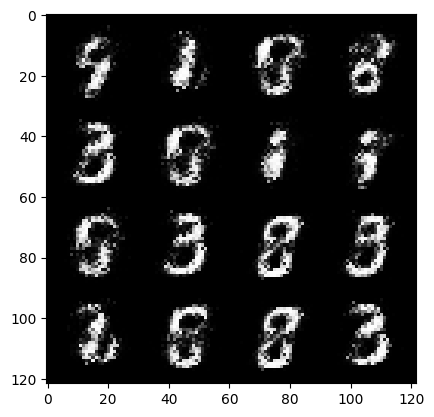

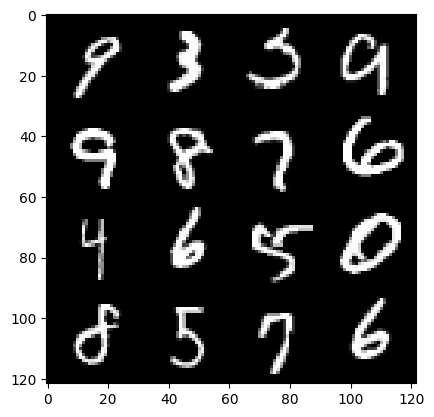

32: Step 15300 / Gen Loss : 5.847978790601091 / Disc Loss : 0.023846081264006568


  0%|          | 0/469 [00:00<?, ?it/s]

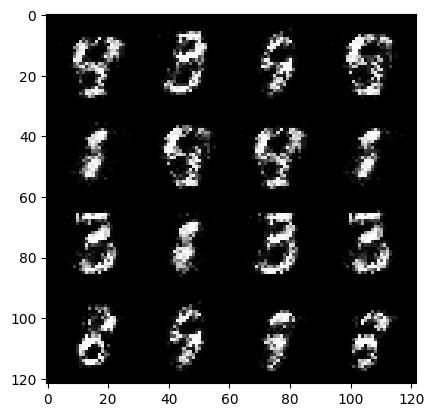

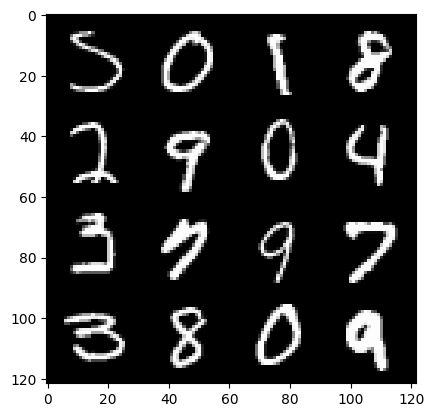

33: Step 15600 / Gen Loss : 6.104705991744989 / Disc Loss : 0.022357138573812944


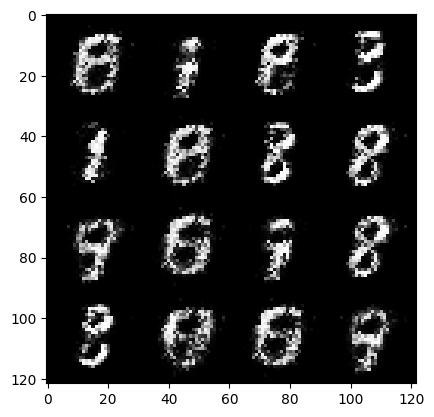

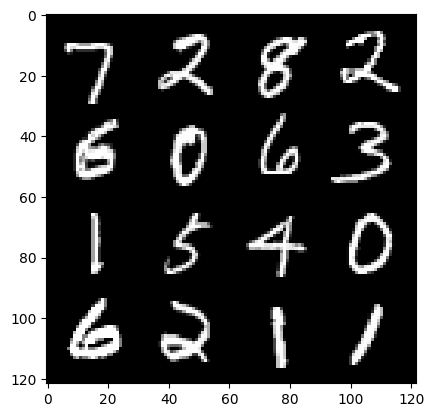

33: Step 15900 / Gen Loss : 5.988069893519082 / Disc Loss : 0.02419586475938561


  0%|          | 0/469 [00:00<?, ?it/s]

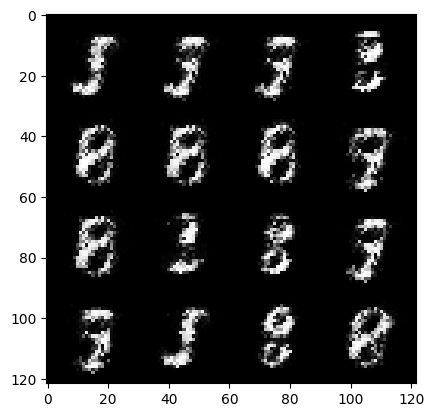

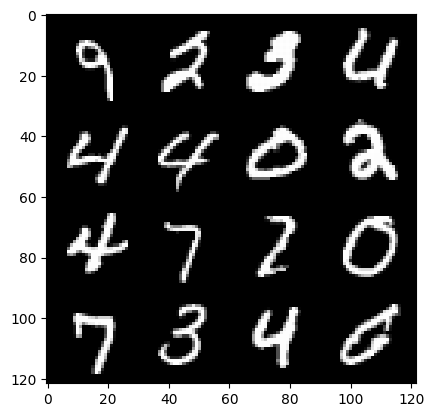

34: Step 16200 / Gen Loss : 5.856754671732581 / Disc Loss : 0.024864818397909404


  0%|          | 0/469 [00:00<?, ?it/s]

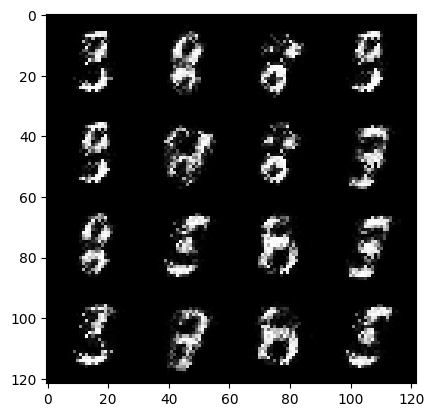

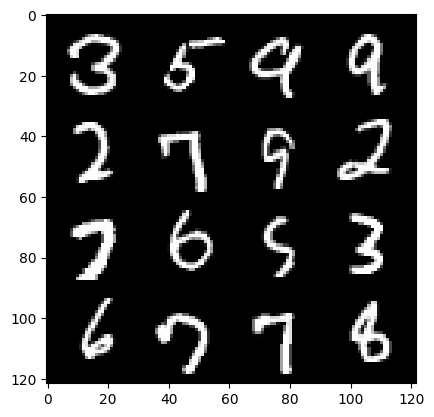

35: Step 16500 / Gen Loss : 5.623098618189494 / Disc Loss : 0.030800588548493876


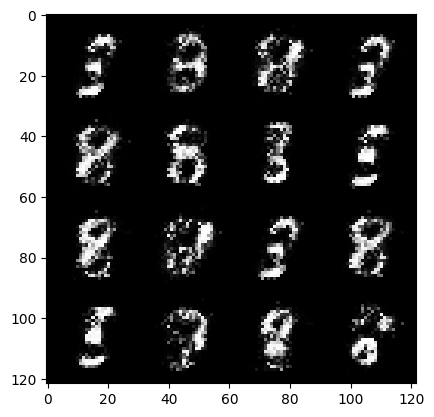

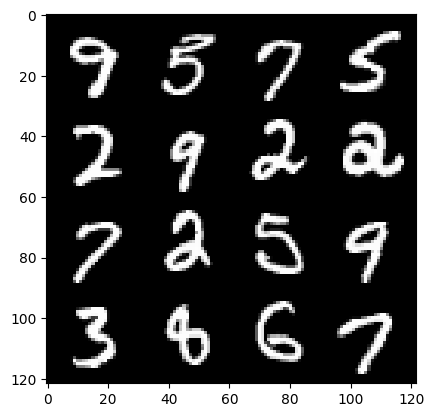

35: Step 16800 / Gen Loss : 5.748835997581485 / Disc Loss : 0.02425863948417828


  0%|          | 0/469 [00:00<?, ?it/s]

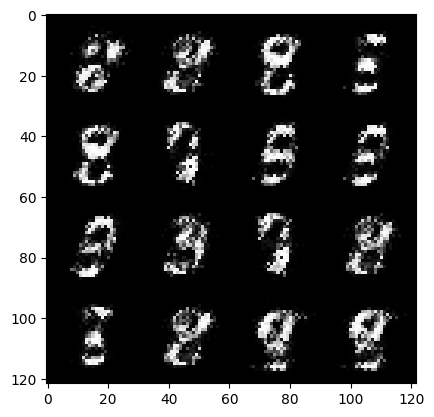

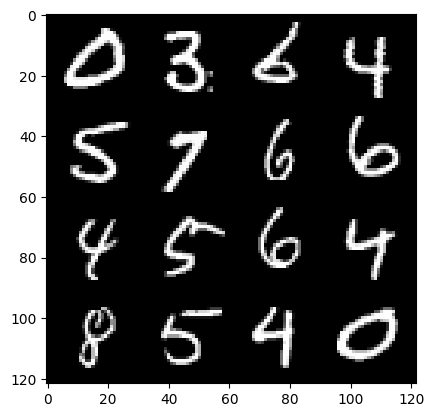

36: Step 17100 / Gen Loss : 6.156596757570899 / Disc Loss : 0.024586581431018814


  0%|          | 0/469 [00:00<?, ?it/s]

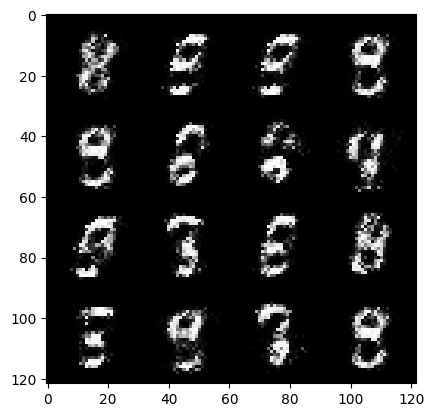

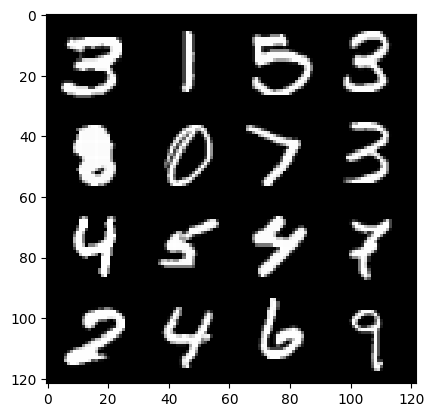

37: Step 17400 / Gen Loss : 6.022862474123639 / Disc Loss : 0.02844764648936688


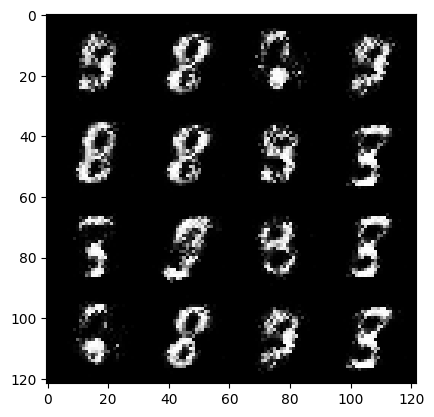

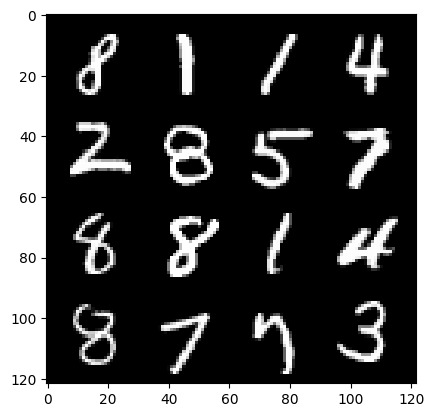

37: Step 17700 / Gen Loss : 6.003493576049804 / Disc Loss : 0.03172563940597077


  0%|          | 0/469 [00:00<?, ?it/s]

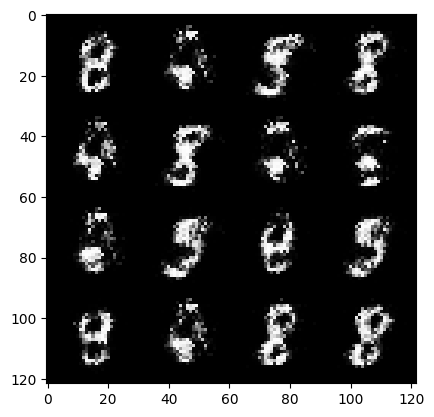

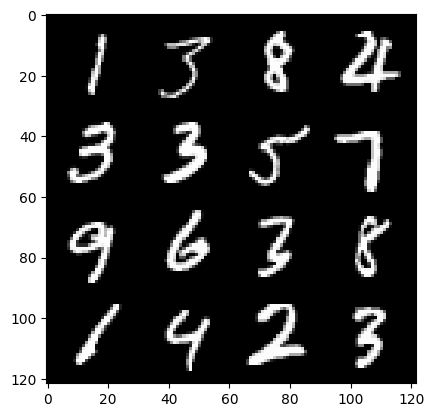

38: Step 18000 / Gen Loss : 5.637583322525023 / Disc Loss : 0.031456777740580324


  0%|          | 0/469 [00:00<?, ?it/s]

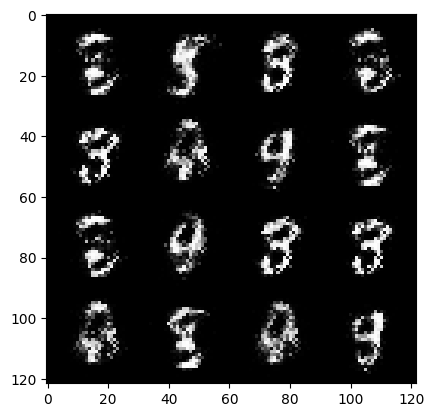

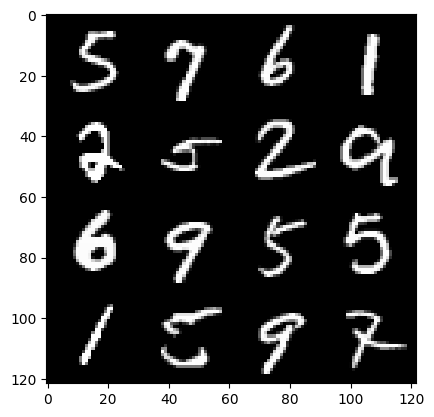

39: Step 18300 / Gen Loss : 5.851809166272489 / Disc Loss : 0.02770829207729551


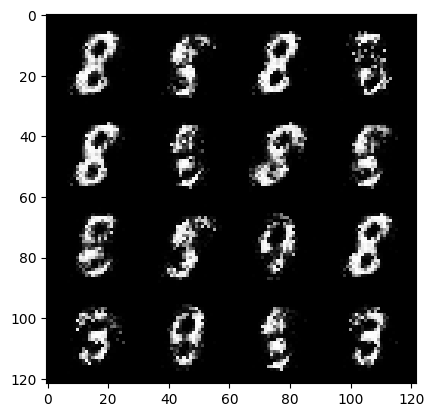

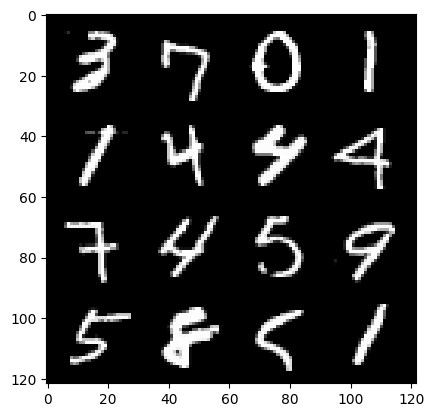

39: Step 18600 / Gen Loss : 5.913755421638486 / Disc Loss : 0.030897800475358974


  0%|          | 0/469 [00:00<?, ?it/s]

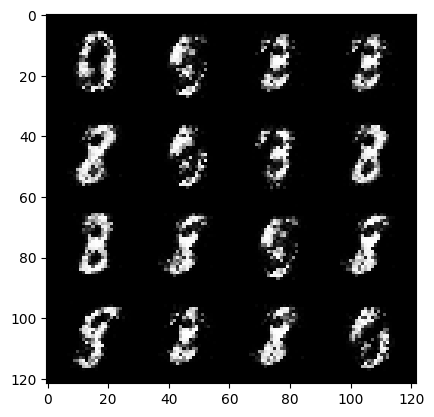

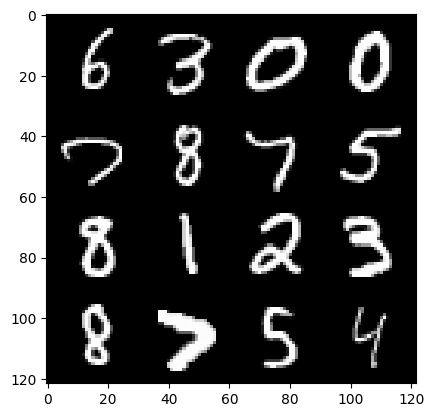

40: Step 18900 / Gen Loss : 5.8680578041076705 / Disc Loss : 0.027954724853237474


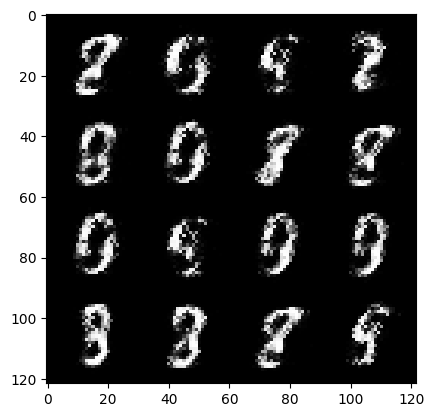

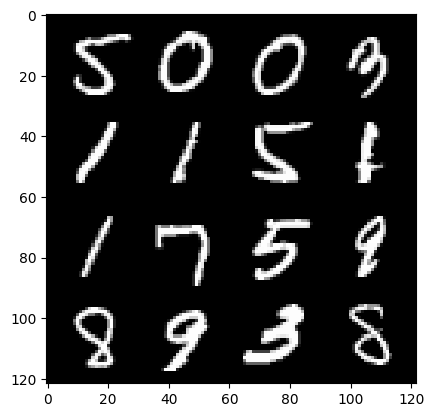

40: Step 19200 / Gen Loss : 5.757088731129961 / Disc Loss : 0.036948035211923164


  0%|          | 0/469 [00:00<?, ?it/s]

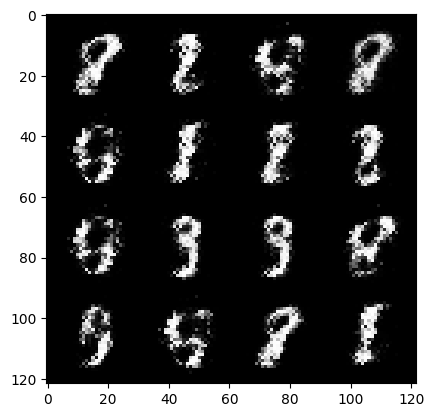

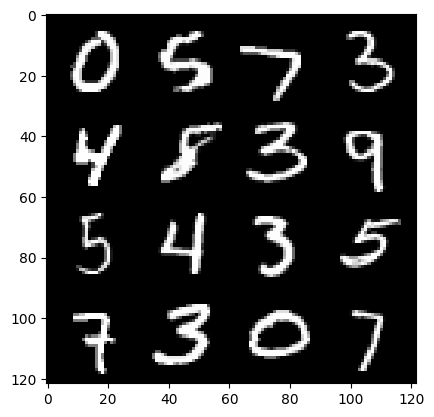

41: Step 19500 / Gen Loss : 5.4765411726633735 / Disc Loss : 0.03532365824716788


  0%|          | 0/469 [00:00<?, ?it/s]

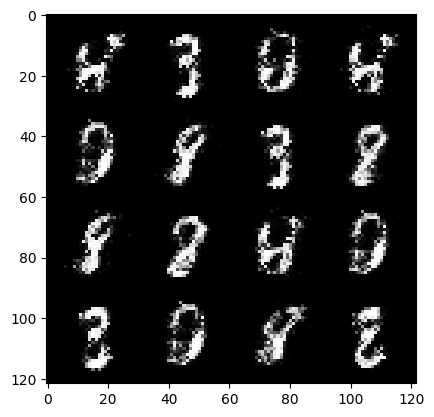

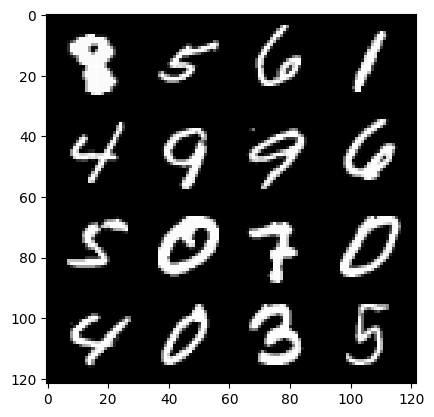

42: Step 19800 / Gen Loss : 5.650954343477882 / Disc Loss : 0.028027547559080015


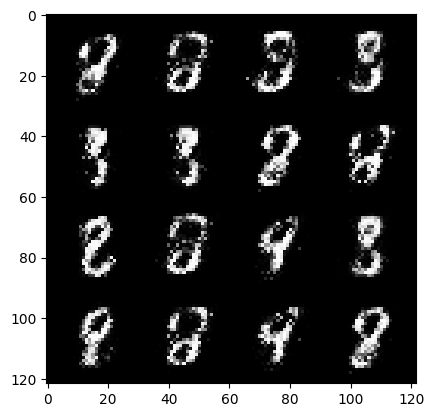

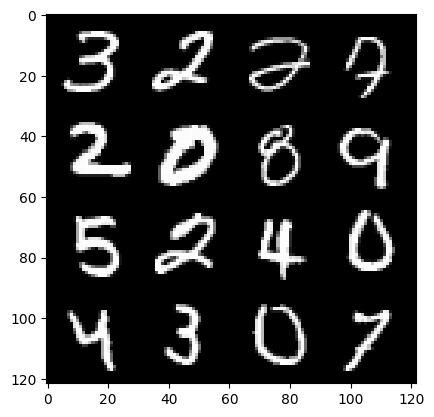

42: Step 20100 / Gen Loss : 5.749088407357536 / Disc Loss : 0.036100417835017065


  0%|          | 0/469 [00:00<?, ?it/s]

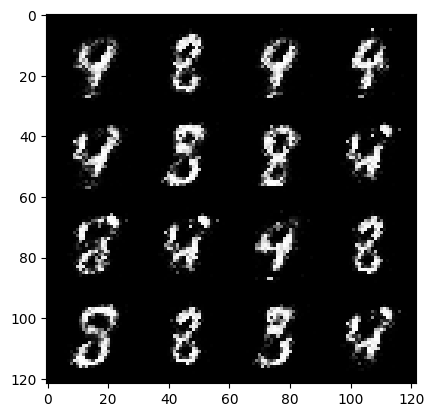

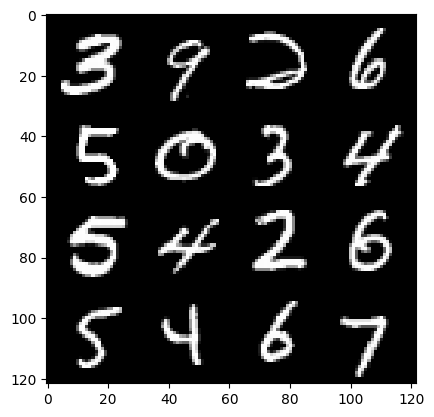

43: Step 20400 / Gen Loss : 5.404963366190593 / Disc Loss : 0.0318164845711241


  0%|          | 0/469 [00:00<?, ?it/s]

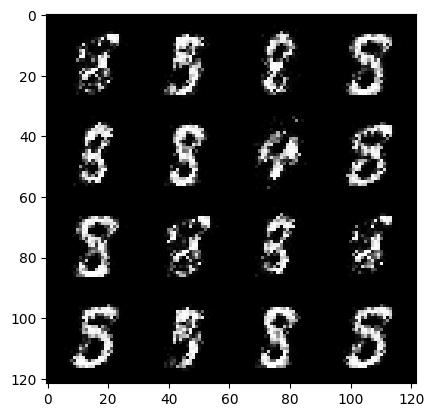

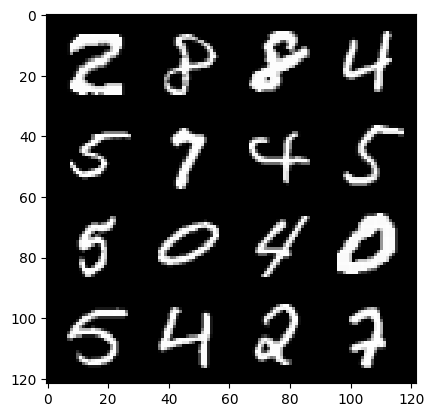

44: Step 20700 / Gen Loss : 5.844385846455893 / Disc Loss : 0.026407495058762546


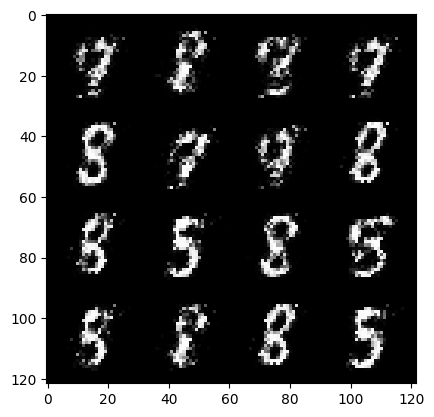

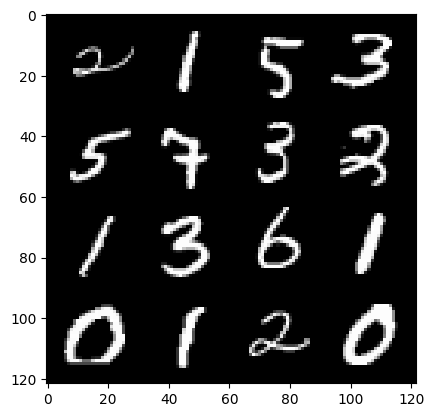

44: Step 21000 / Gen Loss : 5.7776767587661775 / Disc Loss : 0.027975683258846414


  0%|          | 0/469 [00:00<?, ?it/s]

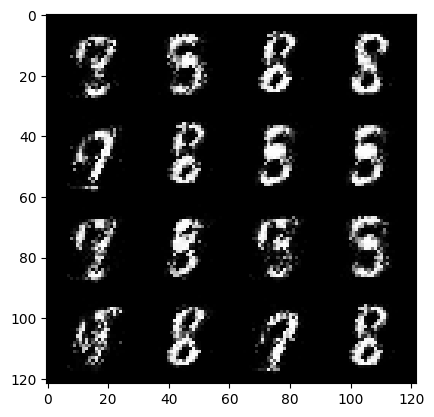

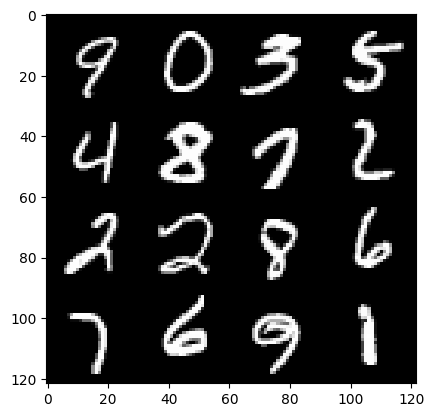

45: Step 21300 / Gen Loss : 5.872207323710123 / Disc Loss : 0.029108765136140097


  0%|          | 0/469 [00:00<?, ?it/s]

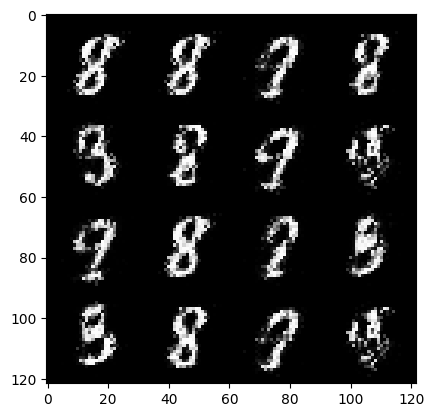

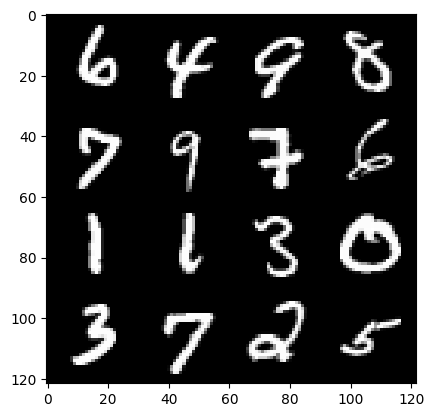

46: Step 21600 / Gen Loss : 6.140969034830729 / Disc Loss : 0.02784063062397762


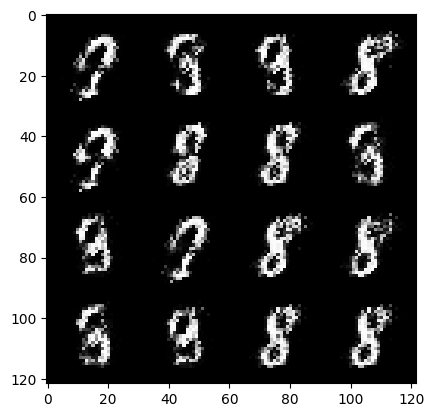

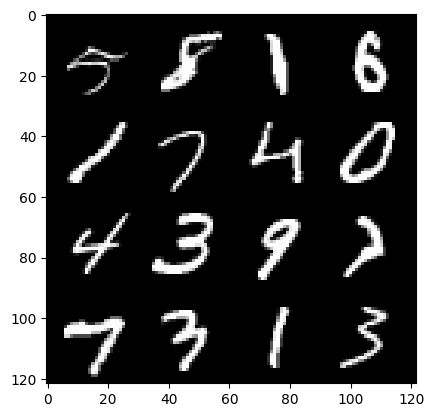

46: Step 21900 / Gen Loss : 5.930640486081443 / Disc Loss : 0.03411884347287318


  0%|          | 0/469 [00:00<?, ?it/s]

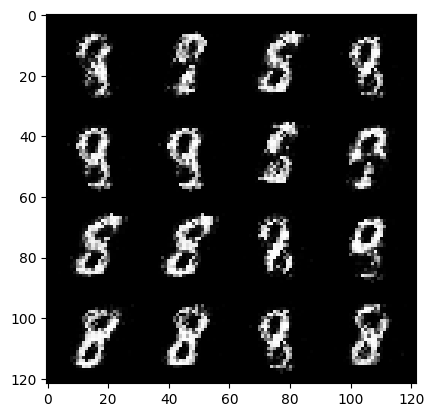

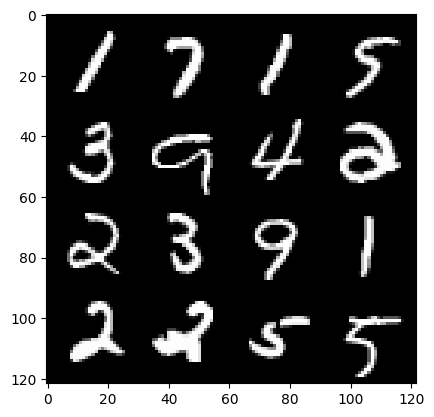

47: Step 22200 / Gen Loss : 5.731521941820778 / Disc Loss : 0.048173443420479696


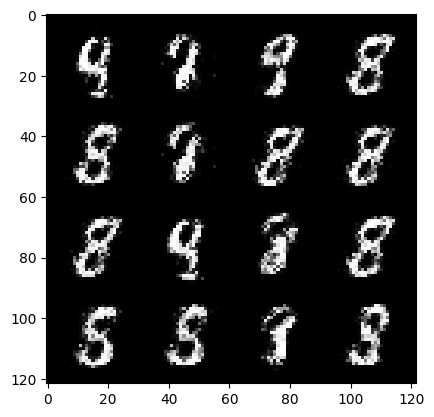

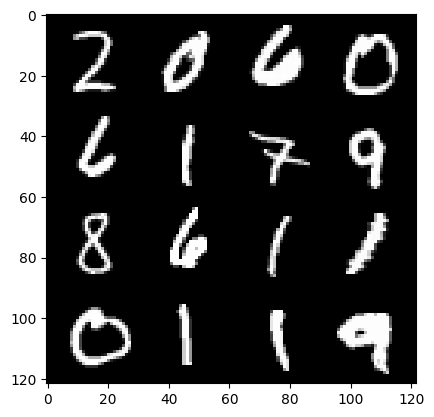

47: Step 22500 / Gen Loss : 5.39170266071956 / Disc Loss : 0.05506573995885749


  0%|          | 0/469 [00:00<?, ?it/s]

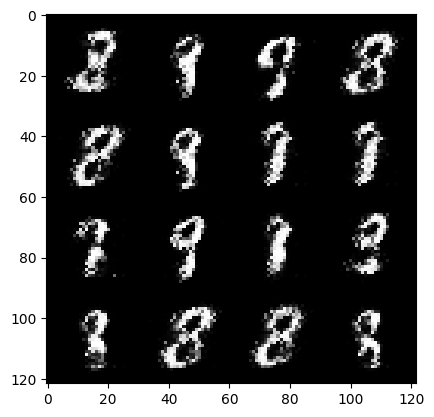

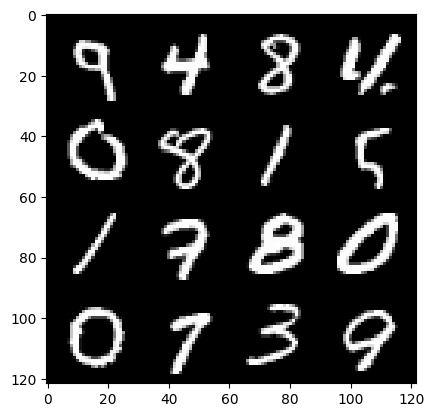

48: Step 22800 / Gen Loss : 5.401962110201521 / Disc Loss : 0.04014659781008961


  0%|          | 0/469 [00:00<?, ?it/s]

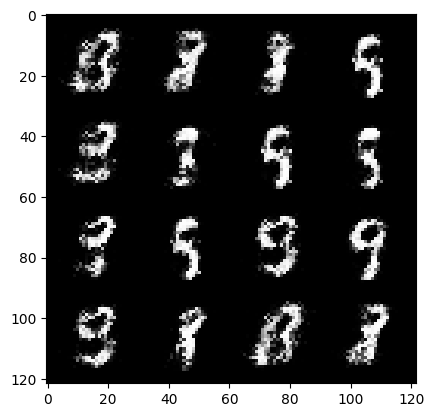

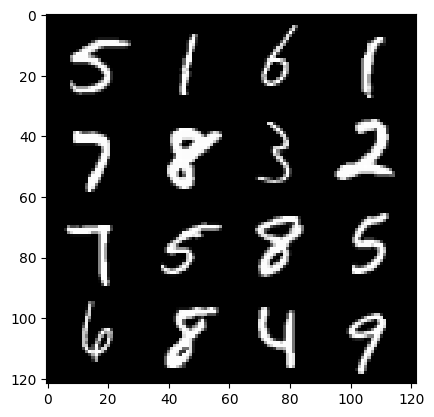

49: Step 23100 / Gen Loss : 5.59350832144419 / Disc Loss : 0.03708157743172099


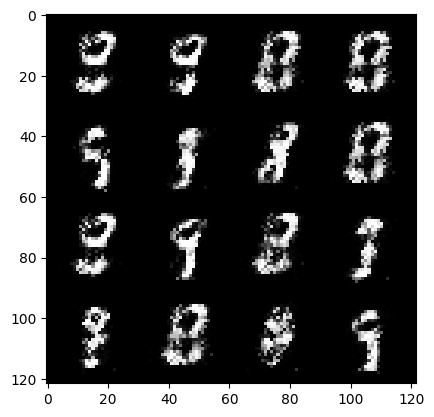

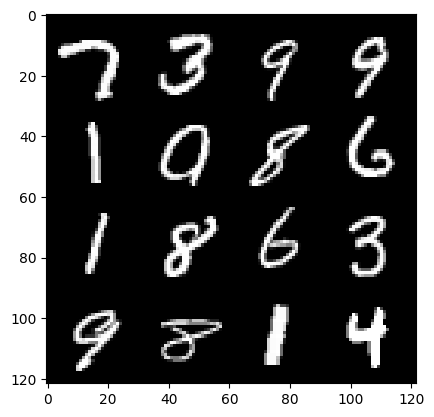

49: Step 23400 / Gen Loss : 5.4814507961273184 / Disc Loss : 0.0457100186077878


  0%|          | 0/469 [00:00<?, ?it/s]

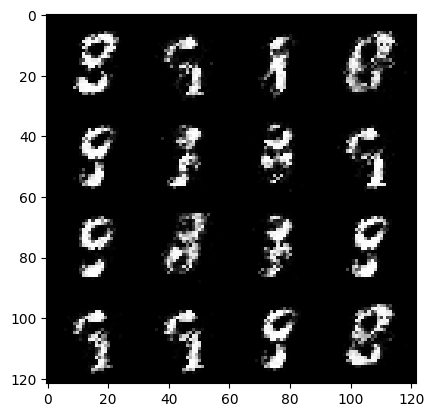

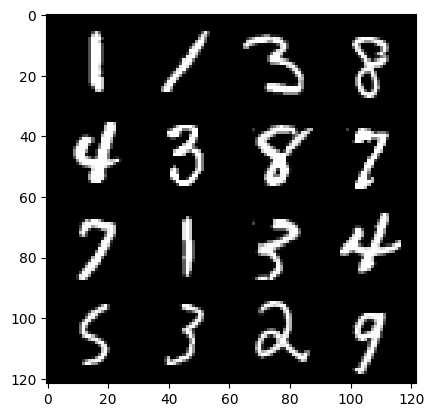

50: Step 23700 / Gen Loss : 5.745104161898294 / Disc Loss : 0.04906379796875017


  0%|          | 0/469 [00:00<?, ?it/s]

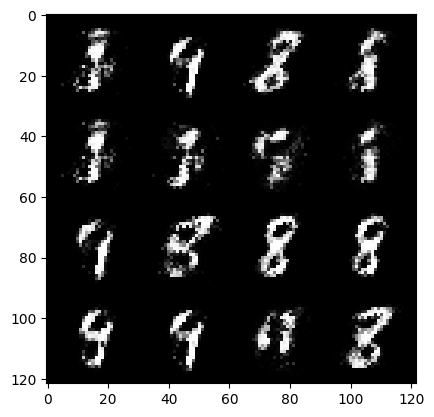

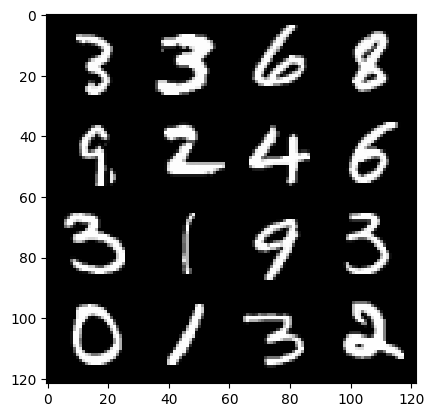

51: Step 24000 / Gen Loss : 6.042007810274763 / Disc Loss : 0.04960802190316219


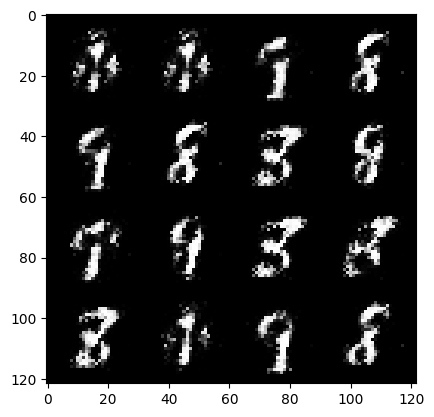

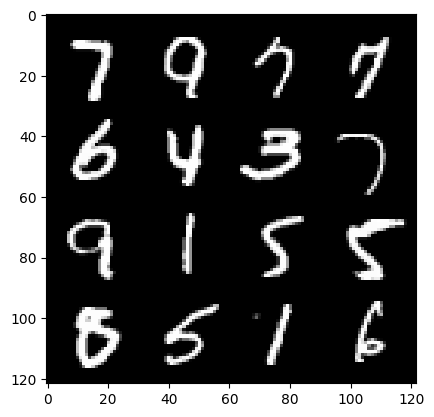

51: Step 24300 / Gen Loss : 5.410311961174013 / Disc Loss : 0.04553470000003774


  0%|          | 0/469 [00:00<?, ?it/s]

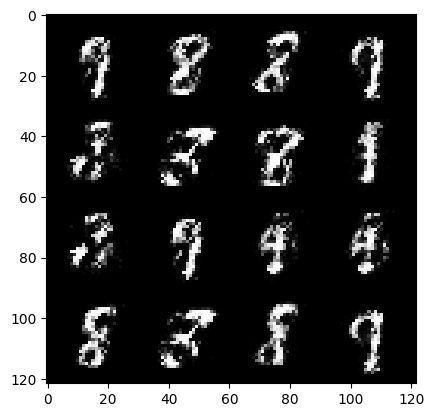

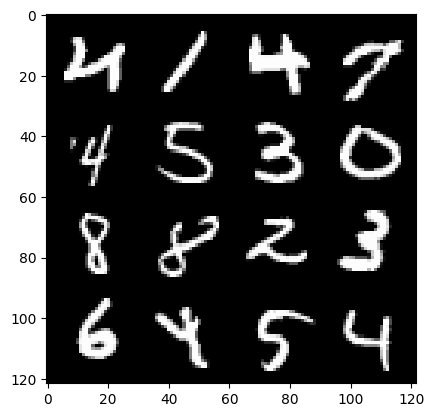

52: Step 24600 / Gen Loss : 5.530956431229908 / Disc Loss : 0.04752660996280611


  0%|          | 0/469 [00:00<?, ?it/s]

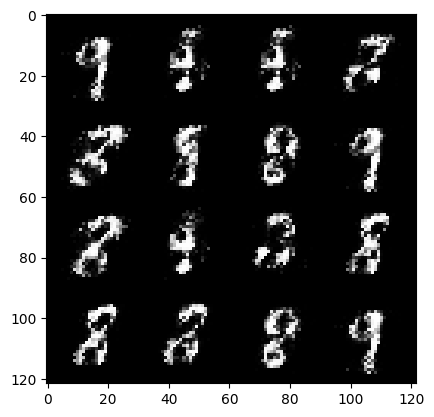

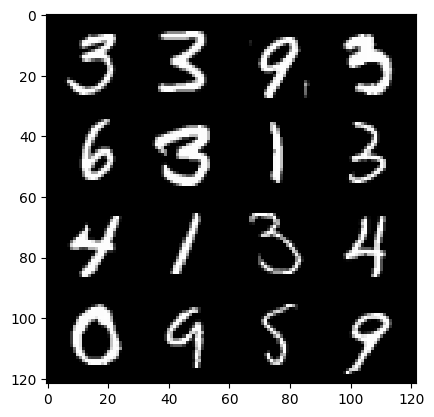

53: Step 24900 / Gen Loss : 5.433861333529154 / Disc Loss : 0.042139065433293606


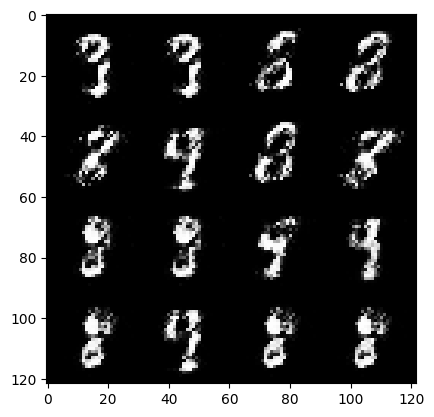

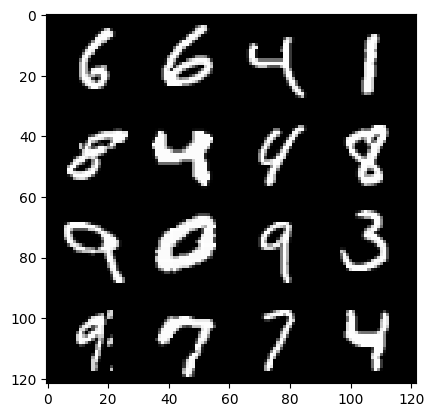

53: Step 25200 / Gen Loss : 5.470289775530496 / Disc Loss : 0.042881921067212996


  0%|          | 0/469 [00:00<?, ?it/s]

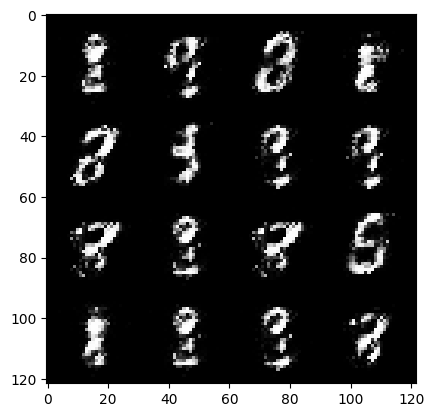

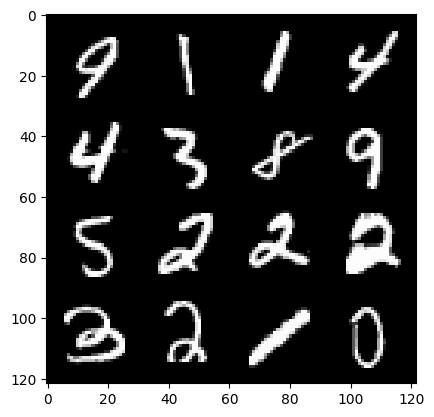

54: Step 25500 / Gen Loss : 5.325673038959504 / Disc Loss : 0.04279827134994171


  0%|          | 0/469 [00:00<?, ?it/s]

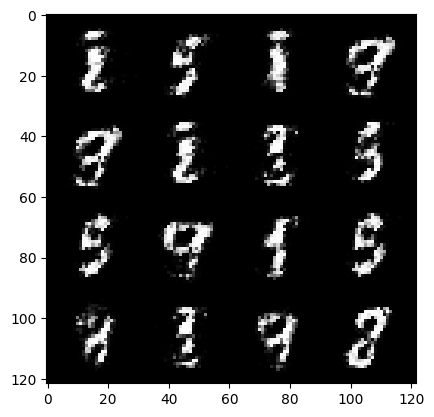

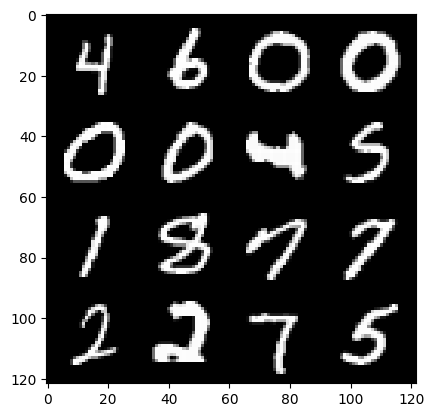

55: Step 25800 / Gen Loss : 5.314382371902469 / Disc Loss : 0.04289460180792956


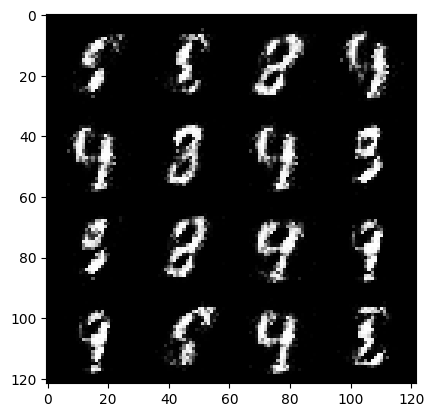

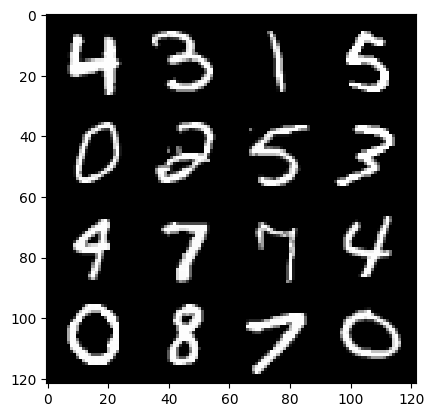

55: Step 26100 / Gen Loss : 5.233942610422769 / Disc Loss : 0.04841910279511166


  0%|          | 0/469 [00:00<?, ?it/s]

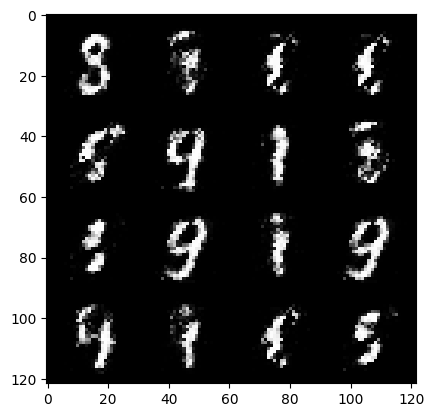

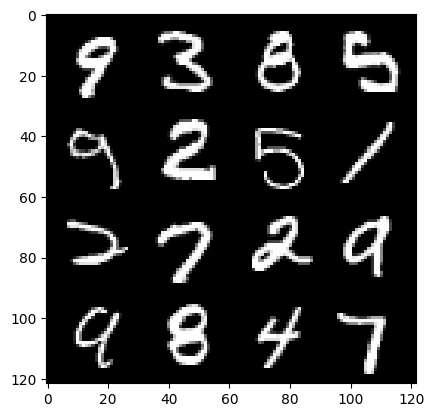

56: Step 26400 / Gen Loss : 4.889040006001795 / Disc Loss : 0.05365184035462639


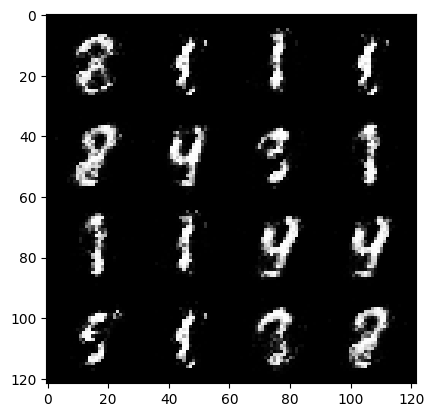

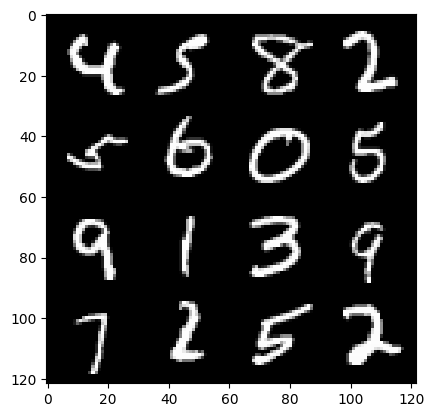

56: Step 26700 / Gen Loss : 4.861873797575634 / Disc Loss : 0.05793516789252563


  0%|          | 0/469 [00:00<?, ?it/s]

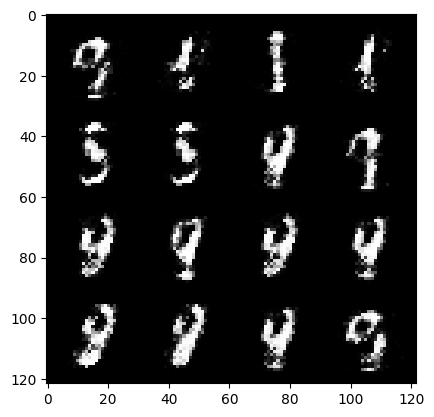

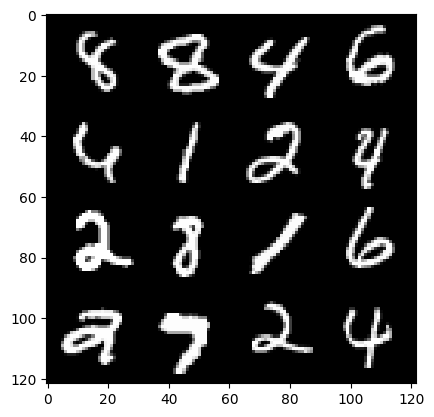

57: Step 27000 / Gen Loss : 4.8496737766265845 / Disc Loss : 0.06615258634090425


  0%|          | 0/469 [00:00<?, ?it/s]

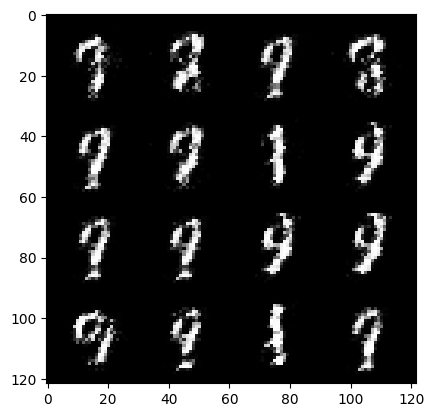

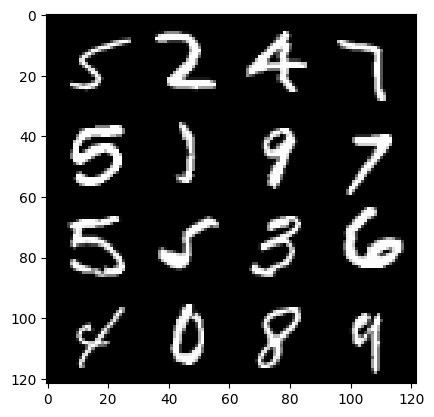

58: Step 27300 / Gen Loss : 4.452027711868285 / Disc Loss : 0.06890921062479412


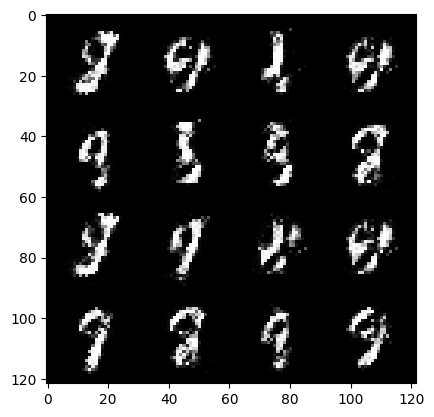

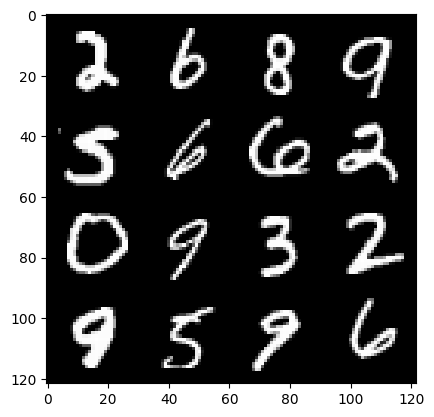

58: Step 27600 / Gen Loss : 4.975305876731873 / Disc Loss : 0.05656363274281223


  0%|          | 0/469 [00:00<?, ?it/s]

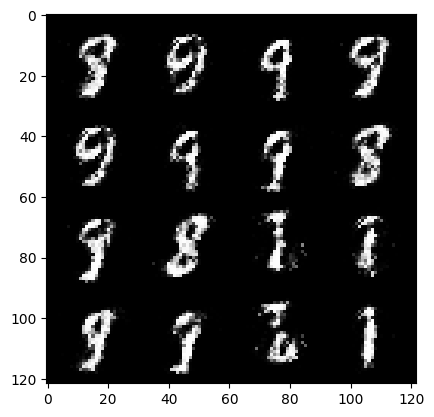

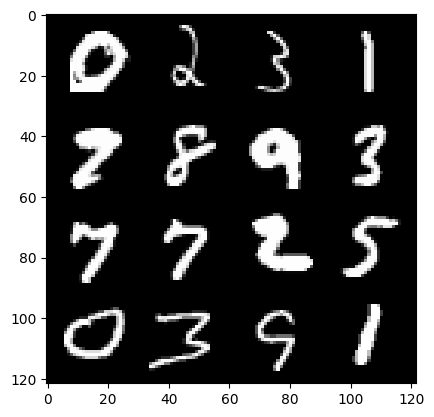

59: Step 27900 / Gen Loss : 4.857732863426213 / Disc Loss : 0.073704141775767


  0%|          | 0/469 [00:00<?, ?it/s]

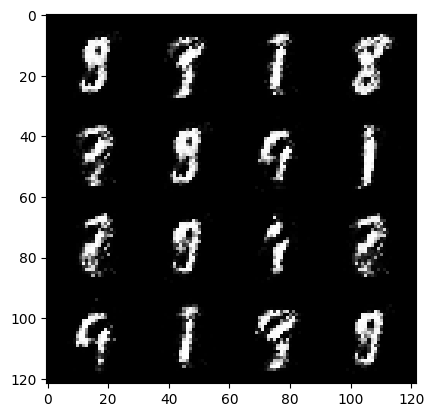

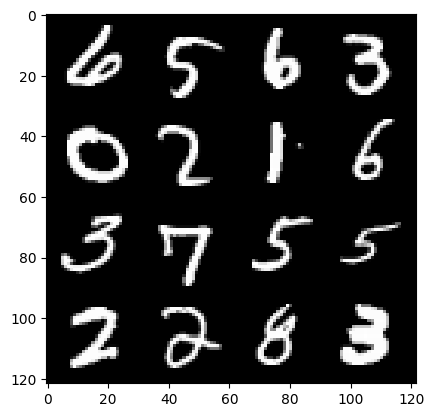

60: Step 28200 / Gen Loss : 4.733813892205552 / Disc Loss : 0.06807738129049538


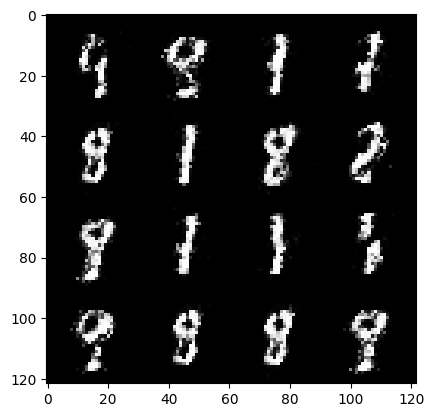

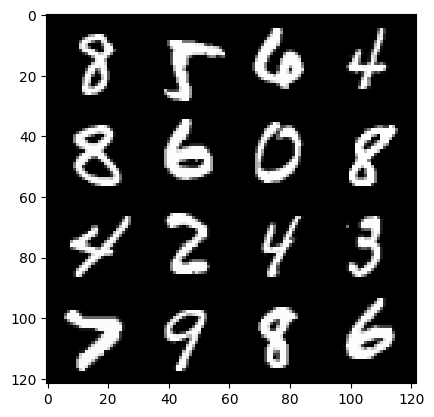

60: Step 28500 / Gen Loss : 4.868051734765367 / Disc Loss : 0.05901777613908055


  0%|          | 0/469 [00:00<?, ?it/s]

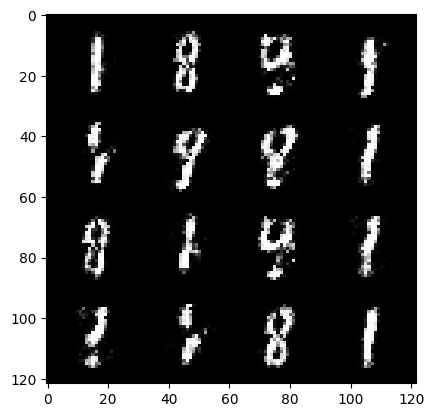

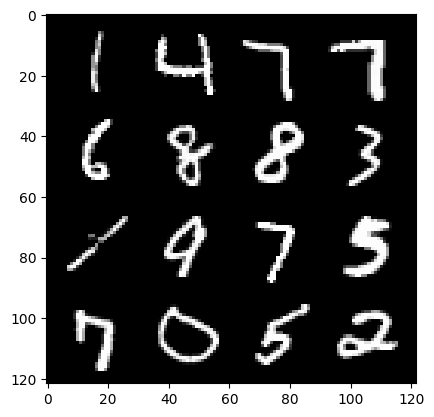

61: Step 28800 / Gen Loss : 4.9480227271715815 / Disc Loss : 0.06018284933331113


  0%|          | 0/469 [00:00<?, ?it/s]

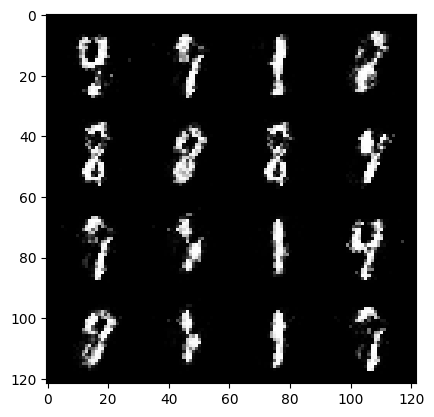

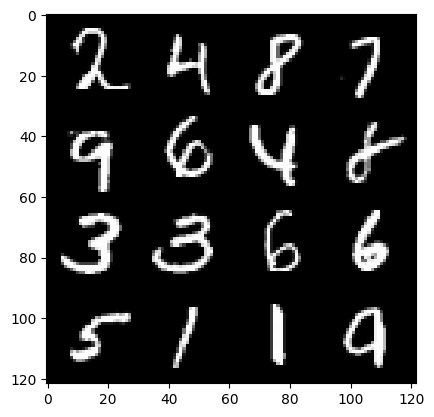

62: Step 29100 / Gen Loss : 5.1310064109166476 / Disc Loss : 0.06003802975639702


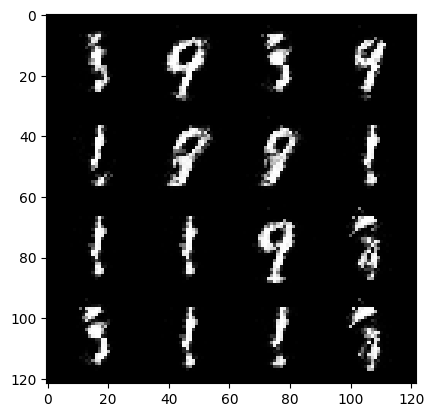

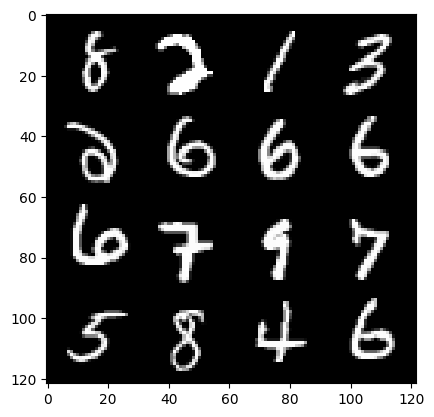

62: Step 29400 / Gen Loss : 4.838692998091377 / Disc Loss : 0.06894423604321977


  0%|          | 0/469 [00:00<?, ?it/s]

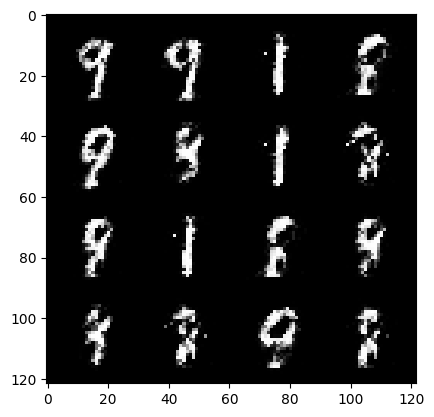

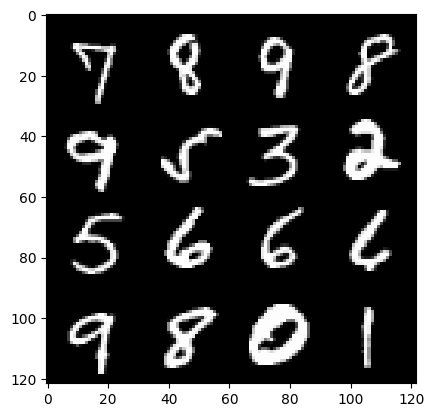

63: Step 29700 / Gen Loss : 4.602525791327158 / Disc Loss : 0.06501161377256116


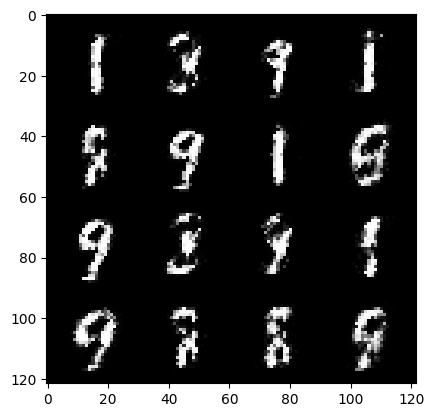

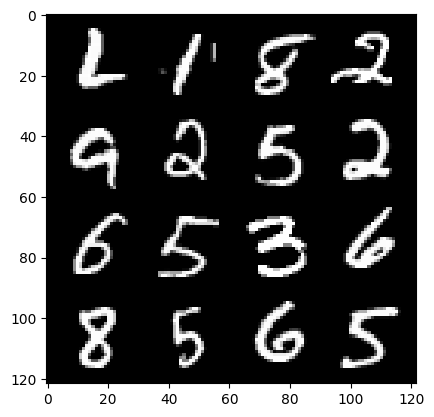

63: Step 30000 / Gen Loss : 4.747139248847963 / Disc Loss : 0.08170216966420417


  0%|          | 0/469 [00:00<?, ?it/s]

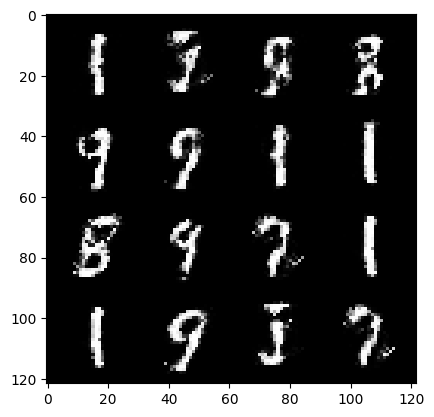

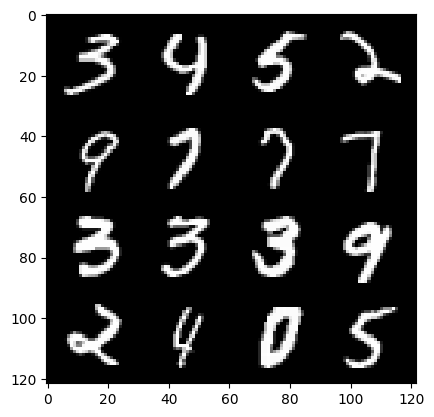

64: Step 30300 / Gen Loss : 4.45775872151057 / Disc Loss : 0.0846880753928174


  0%|          | 0/469 [00:00<?, ?it/s]

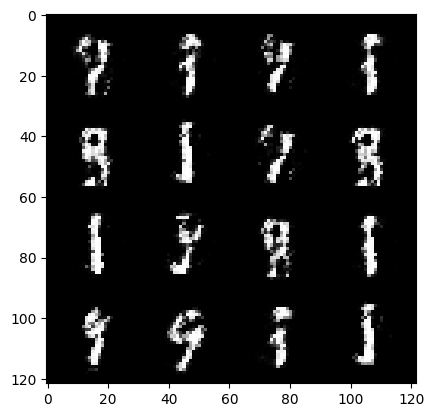

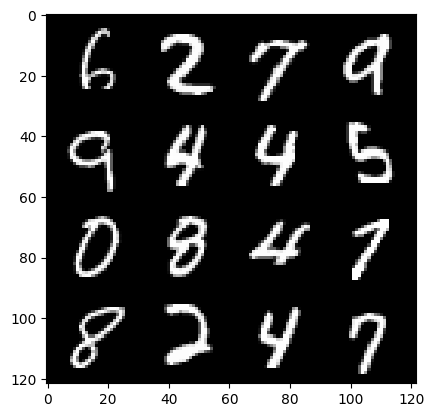

65: Step 30600 / Gen Loss : 4.394715825716658 / Disc Loss : 0.08195559456634027


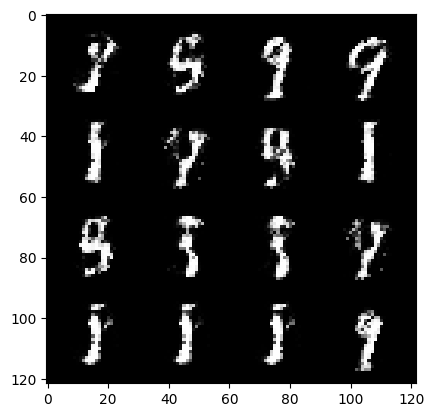

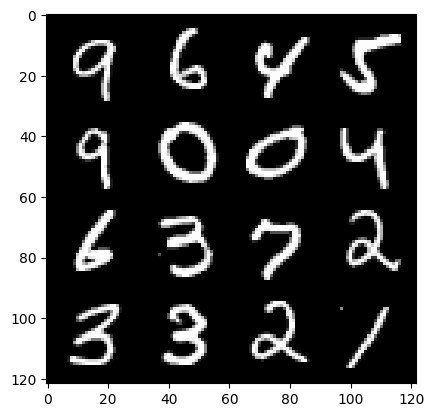

65: Step 30900 / Gen Loss : 4.5276224462191275 / Disc Loss : 0.06382508649490777


  0%|          | 0/469 [00:00<?, ?it/s]

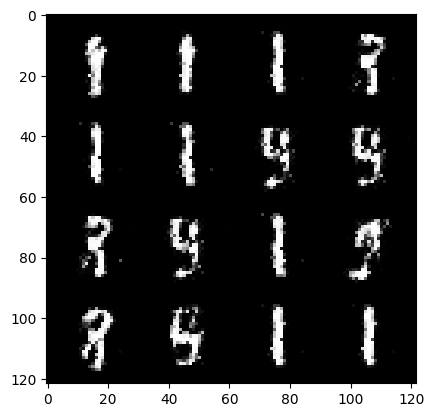

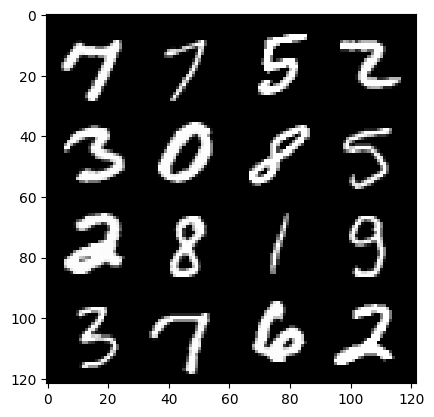

66: Step 31200 / Gen Loss : 4.491369818846383 / Disc Loss : 0.06987064210698006


  0%|          | 0/469 [00:00<?, ?it/s]

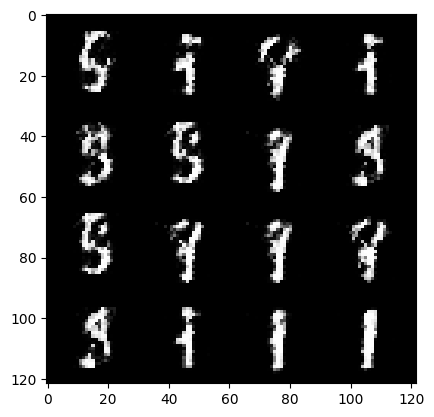

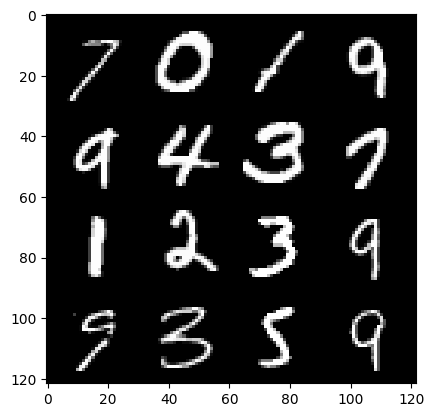

67: Step 31500 / Gen Loss : 4.544889512062073 / Disc Loss : 0.07606155186581111


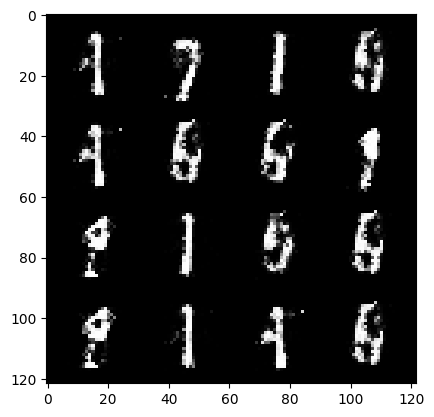

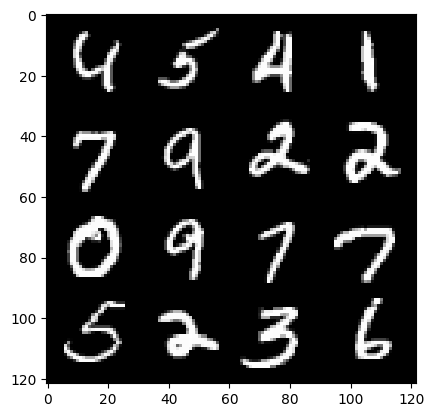

67: Step 31800 / Gen Loss : 4.451566050847373 / Disc Loss : 0.08016338133563598


  0%|          | 0/469 [00:00<?, ?it/s]

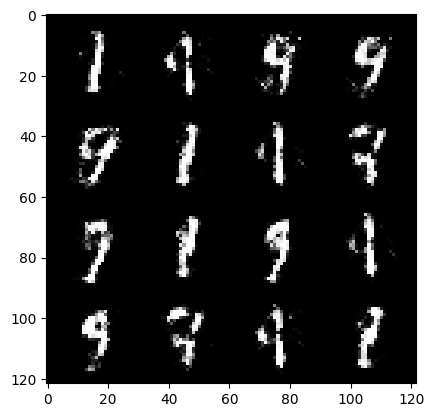

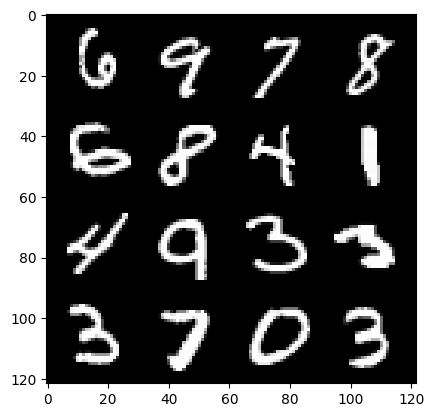

68: Step 32100 / Gen Loss : 4.41298198302587 / Disc Loss : 0.0853772079199552


  0%|          | 0/469 [00:00<?, ?it/s]

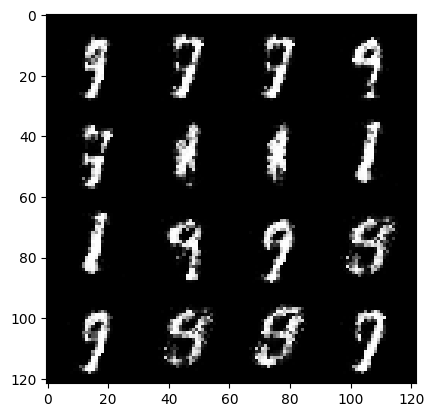

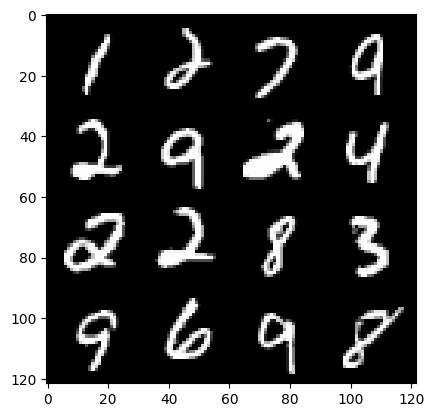

69: Step 32400 / Gen Loss : 4.440139033794407 / Disc Loss : 0.09025916013866665


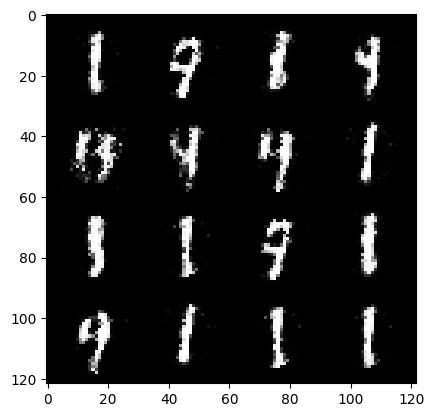

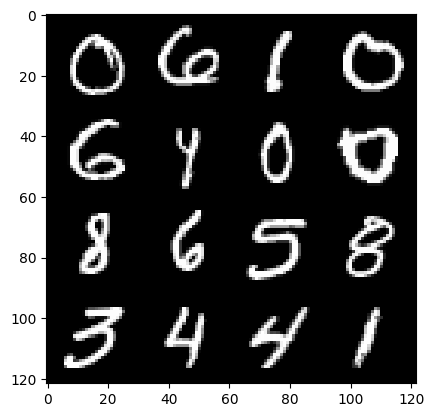

69: Step 32700 / Gen Loss : 4.221841889222461 / Disc Loss : 0.09093277787168817


  0%|          | 0/469 [00:00<?, ?it/s]

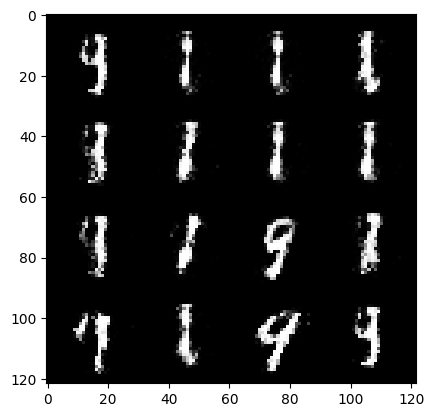

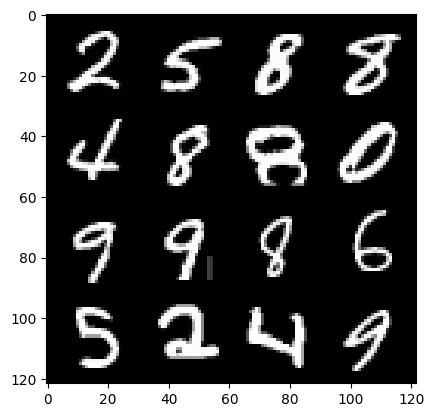

70: Step 33000 / Gen Loss : 4.062134274641673 / Disc Loss : 0.09125338368117811


  0%|          | 0/469 [00:00<?, ?it/s]

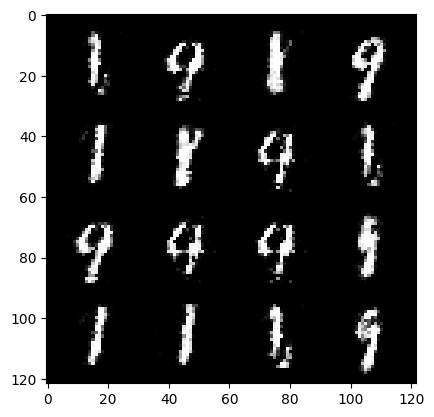

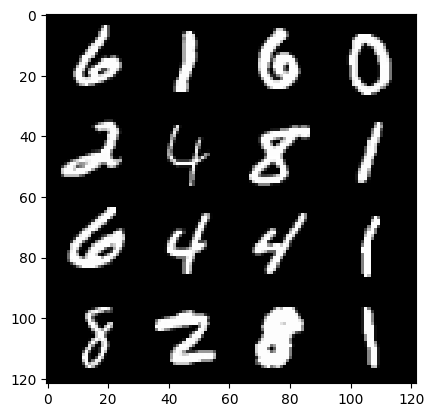

71: Step 33300 / Gen Loss : 4.165151338577272 / Disc Loss : 0.07778897607078153


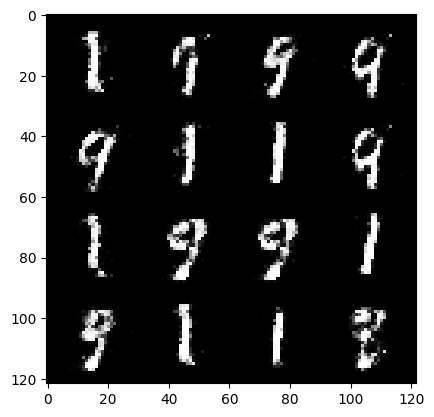

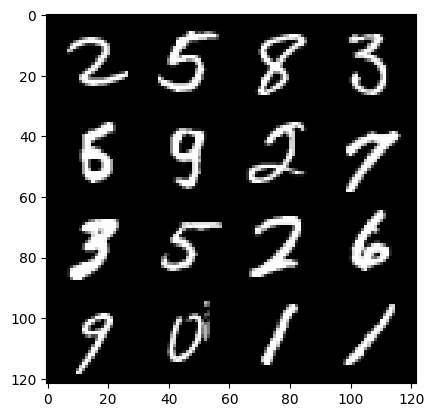

71: Step 33600 / Gen Loss : 4.071803223292033 / Disc Loss : 0.0982895718390742


  0%|          | 0/469 [00:00<?, ?it/s]

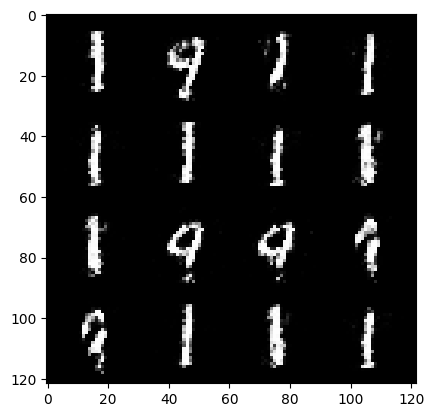

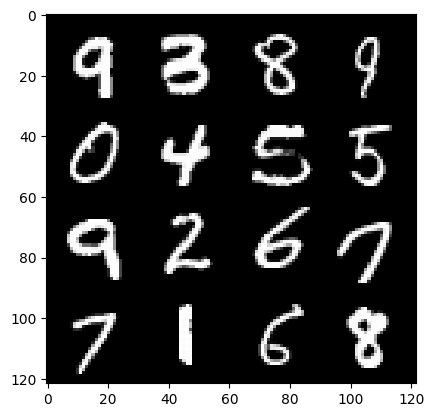

72: Step 33900 / Gen Loss : 3.8510929552714037 / Disc Loss : 0.1121865381424626


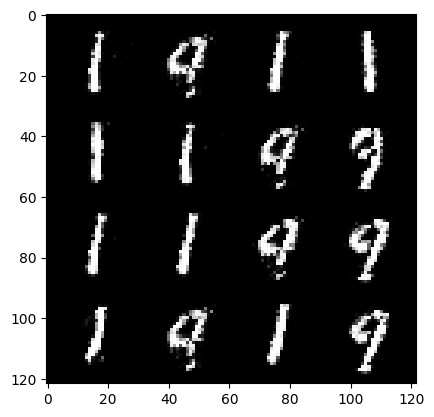

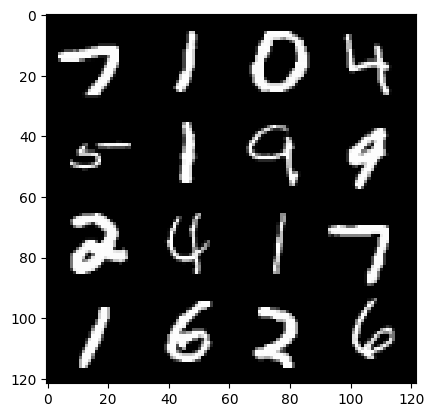

72: Step 34200 / Gen Loss : 3.8017414530118288 / Disc Loss : 0.11089435454458006


  0%|          | 0/469 [00:00<?, ?it/s]

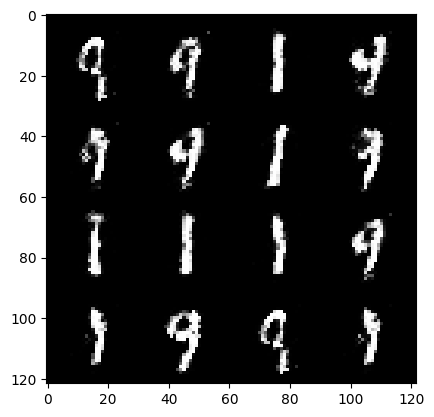

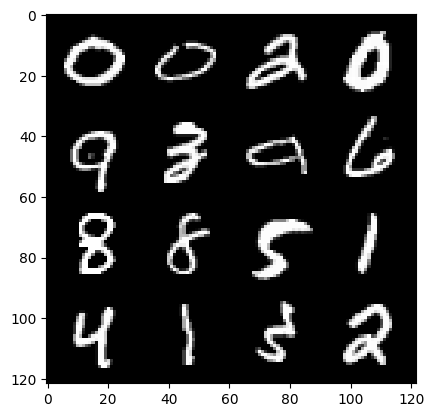

73: Step 34500 / Gen Loss : 3.8492980988820413 / Disc Loss : 0.10519111763685952


  0%|          | 0/469 [00:00<?, ?it/s]

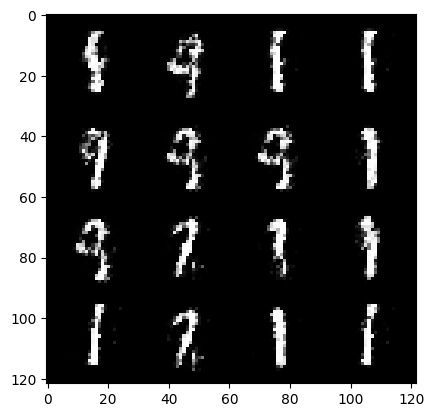

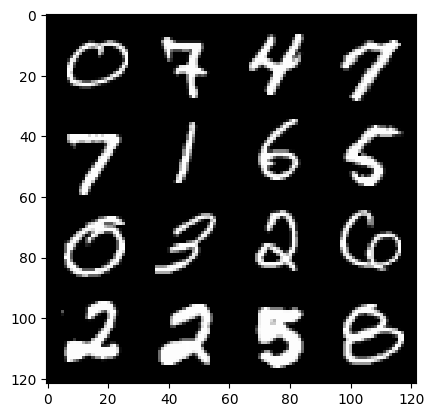

74: Step 34800 / Gen Loss : 4.103668230374657 / Disc Loss : 0.09941187319656208


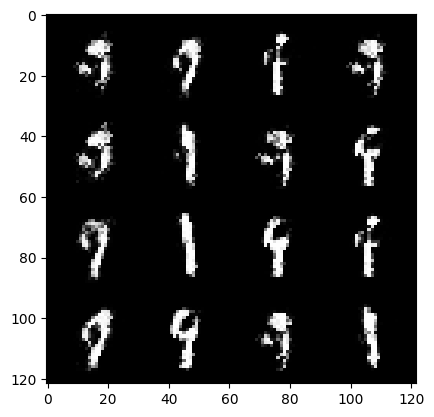

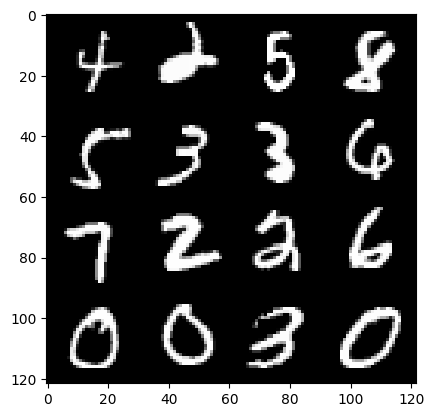

74: Step 35100 / Gen Loss : 4.066682976881662 / Disc Loss : 0.10203016793976219


  0%|          | 0/469 [00:00<?, ?it/s]

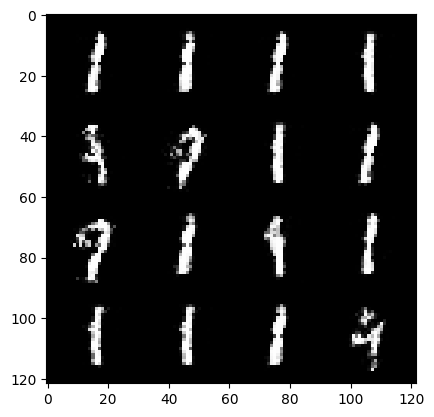

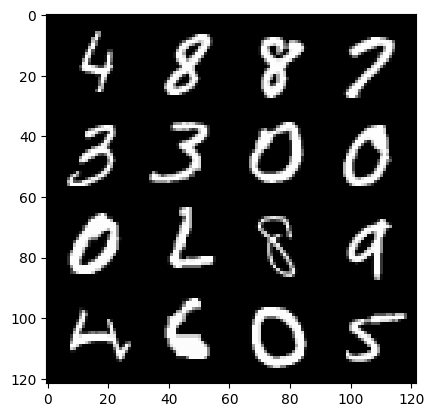

75: Step 35400 / Gen Loss : 3.7139445281028736 / Disc Loss : 0.12504984838267164


  0%|          | 0/469 [00:00<?, ?it/s]

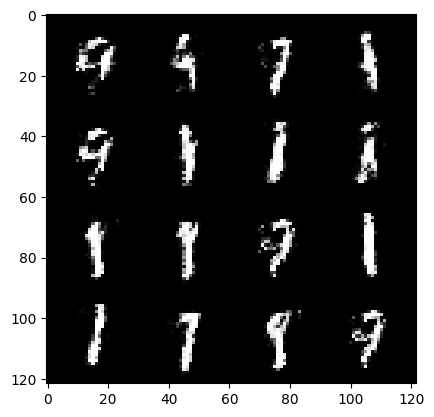

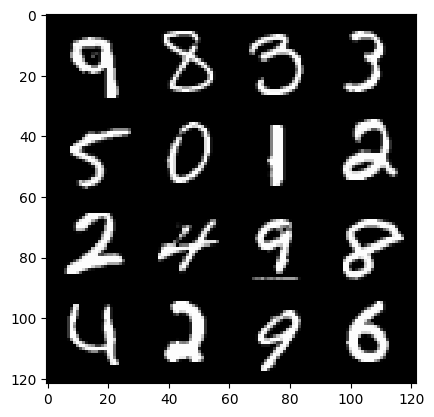

76: Step 35700 / Gen Loss : 3.879249638716381 / Disc Loss : 0.09856851262971762


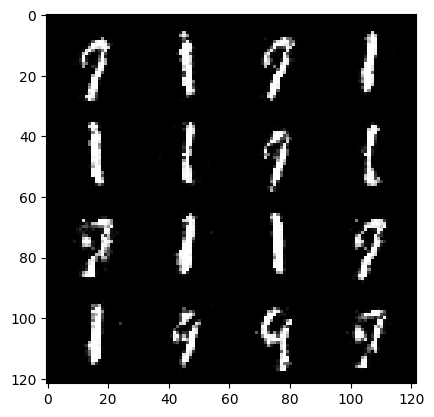

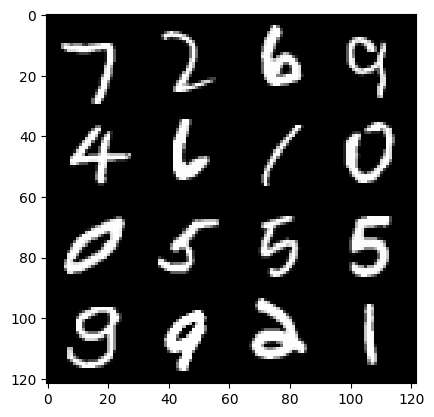

76: Step 36000 / Gen Loss : 3.9131096315383935 / Disc Loss : 0.09150702908635132


  0%|          | 0/469 [00:00<?, ?it/s]

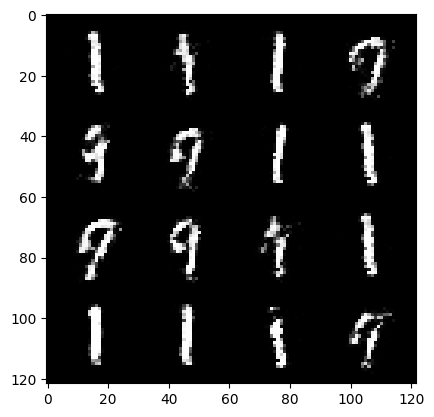

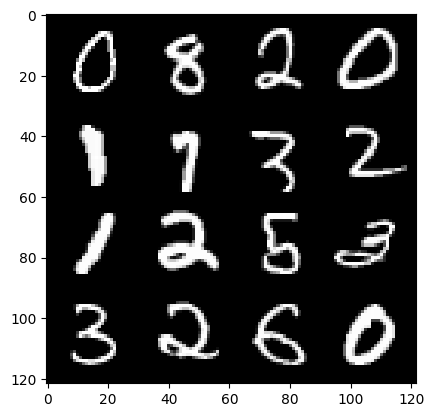

77: Step 36300 / Gen Loss : 3.8801554449399336 / Disc Loss : 0.09584960776691635


  0%|          | 0/469 [00:00<?, ?it/s]

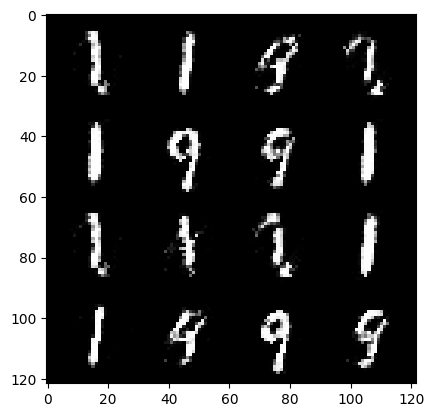

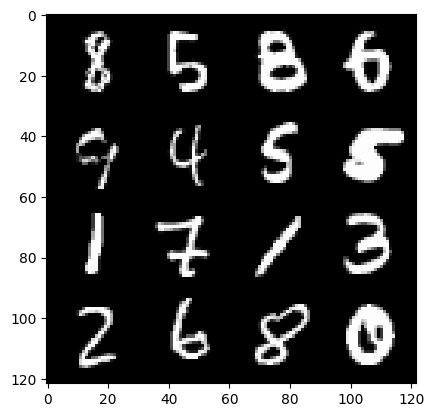

78: Step 36600 / Gen Loss : 3.836780507564545 / Disc Loss : 0.118975099089245


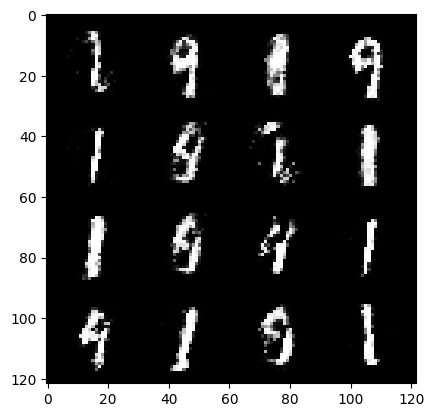

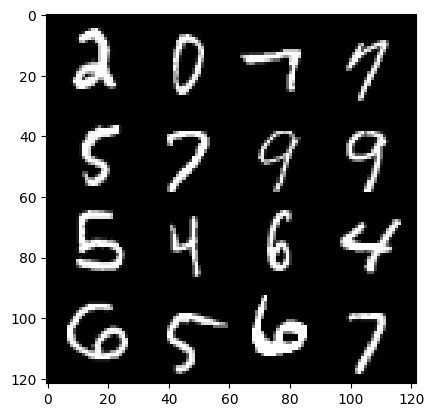

78: Step 36900 / Gen Loss : 3.9807349308331808 / Disc Loss : 0.1106305860231321


  0%|          | 0/469 [00:00<?, ?it/s]

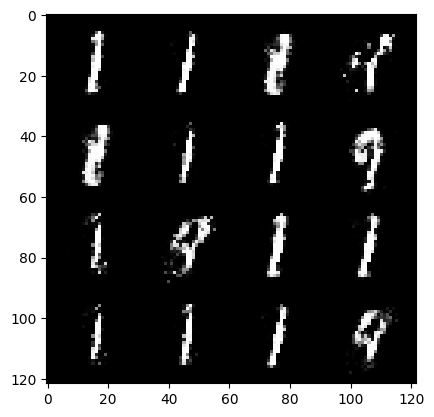

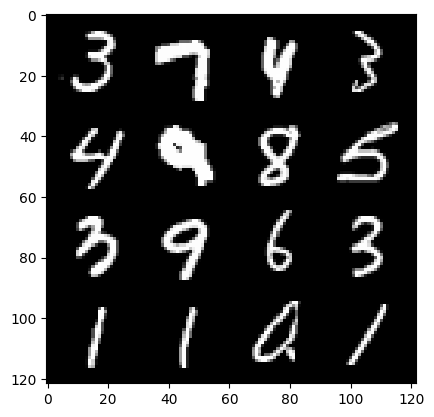

79: Step 37200 / Gen Loss : 3.8436135196685774 / Disc Loss : 0.1049962428336342


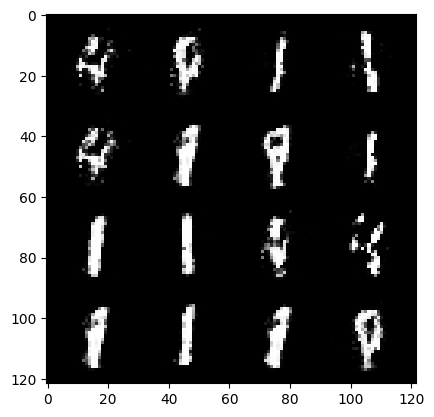

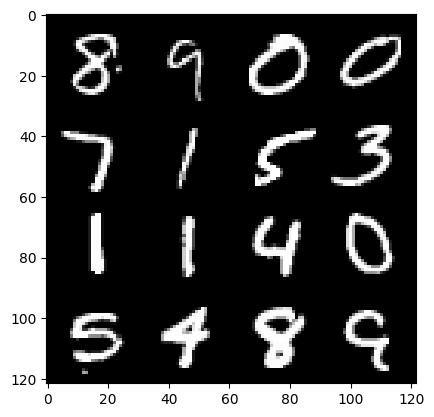

79: Step 37500 / Gen Loss : 3.676982658704124 / Disc Loss : 0.10083873207370445


  0%|          | 0/469 [00:00<?, ?it/s]

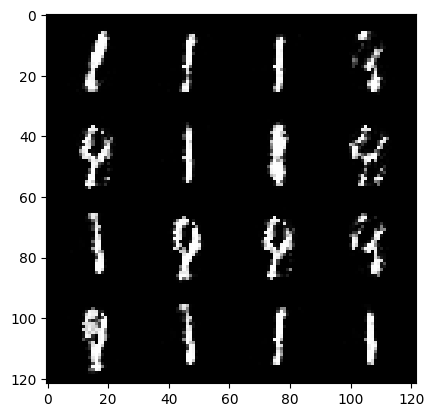

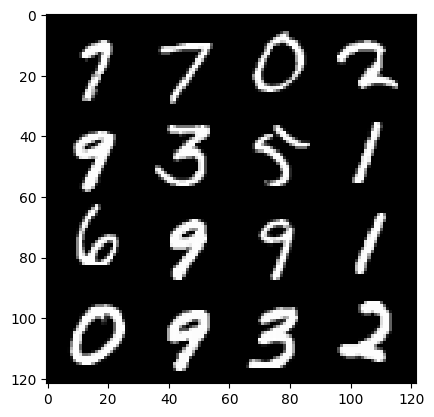

80: Step 37800 / Gen Loss : 3.764760200977326 / Disc Loss : 0.10725608546286813


  0%|          | 0/469 [00:00<?, ?it/s]

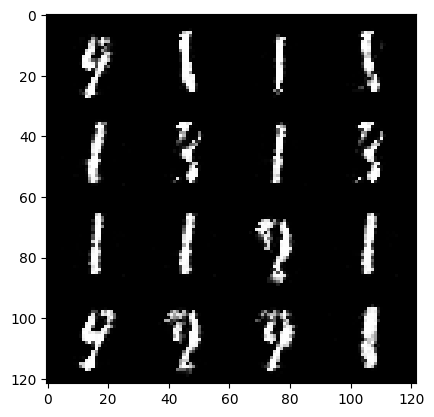

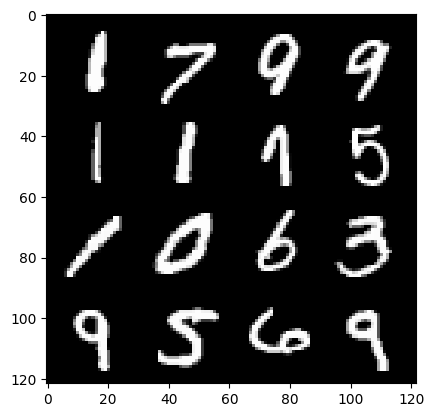

81: Step 38100 / Gen Loss : 3.727254966894786 / Disc Loss : 0.10602551793058715


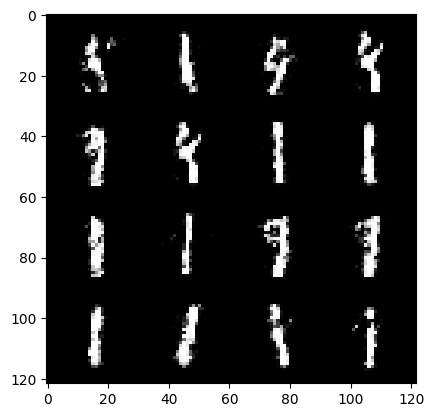

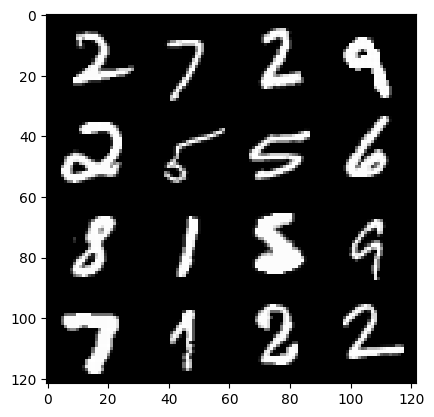

81: Step 38400 / Gen Loss : 3.538677346706389 / Disc Loss : 0.11400130589803065


  0%|          | 0/469 [00:00<?, ?it/s]

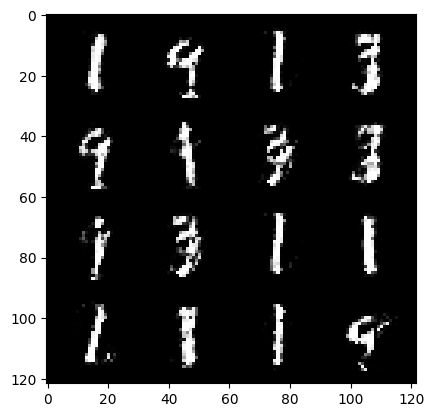

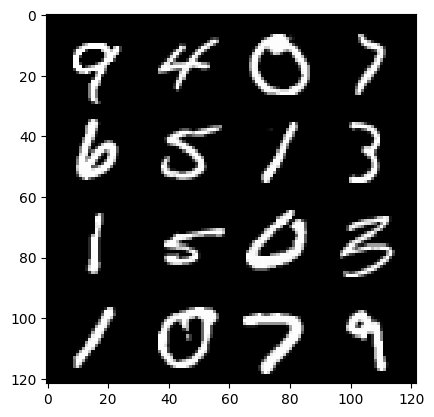

82: Step 38700 / Gen Loss : 3.620739058653513 / Disc Loss : 0.10642338487009209


  0%|          | 0/469 [00:00<?, ?it/s]

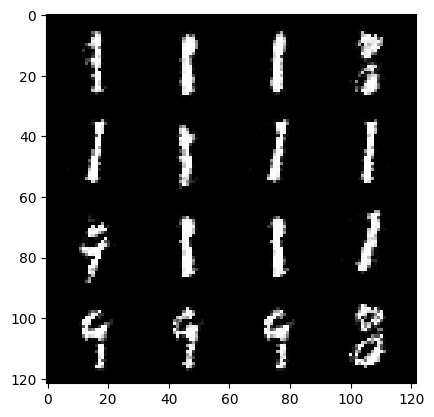

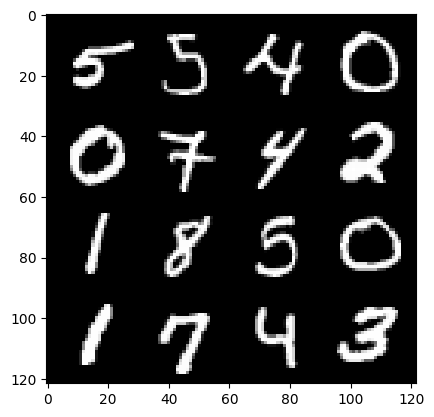

83: Step 39000 / Gen Loss : 3.7137302867571513 / Disc Loss : 0.10262473426759235


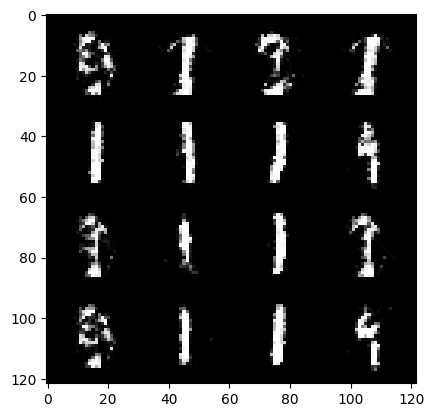

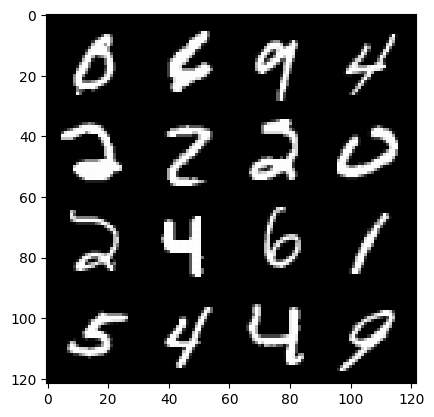

83: Step 39300 / Gen Loss : 3.6252798295021087 / Disc Loss : 0.1261111751074592


  0%|          | 0/469 [00:00<?, ?it/s]

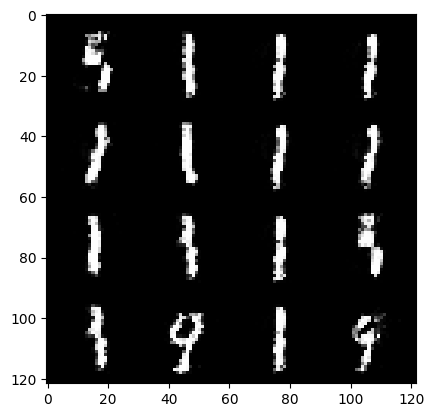

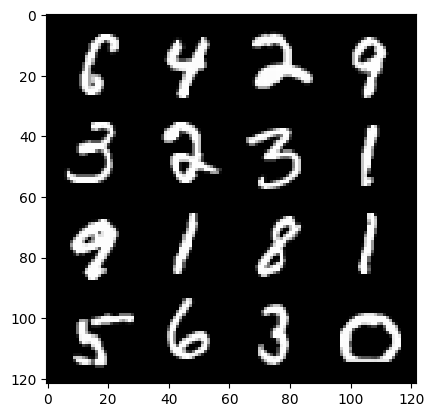

84: Step 39600 / Gen Loss : 3.548700290520985 / Disc Loss : 0.12629804265995817


  0%|          | 0/469 [00:00<?, ?it/s]

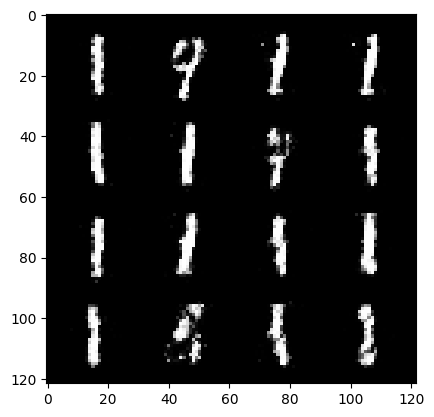

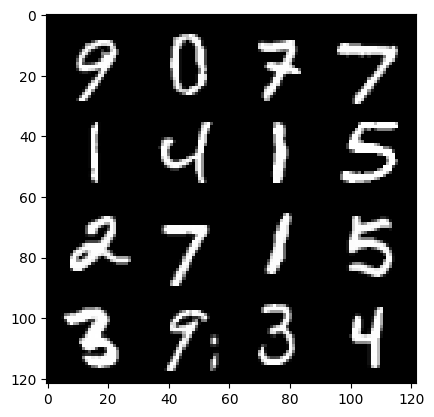

85: Step 39900 / Gen Loss : 3.4839908091227194 / Disc Loss : 0.12949761704852192


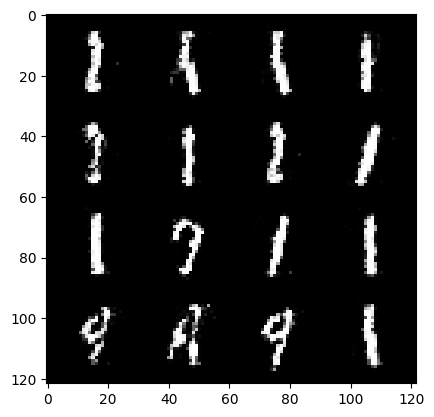

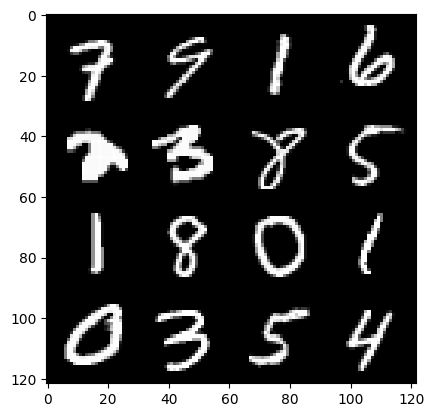

85: Step 40200 / Gen Loss : 3.2872935549418103 / Disc Loss : 0.12683077270785972


  0%|          | 0/469 [00:00<?, ?it/s]

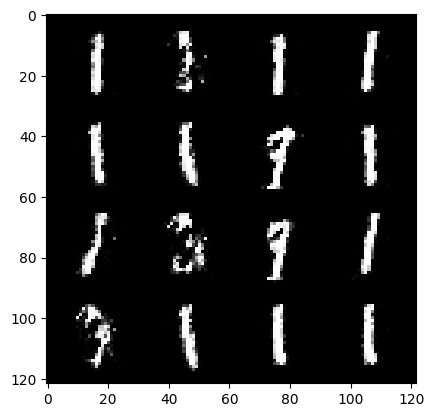

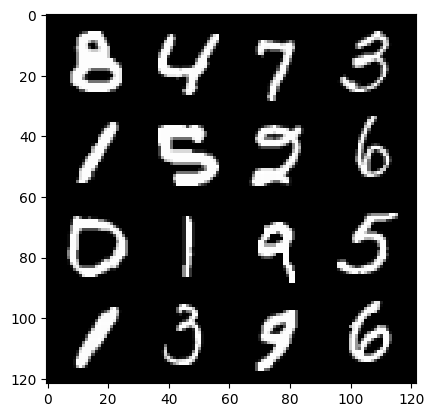

86: Step 40500 / Gen Loss : 3.363913328647616 / Disc Loss : 0.13147143927713242


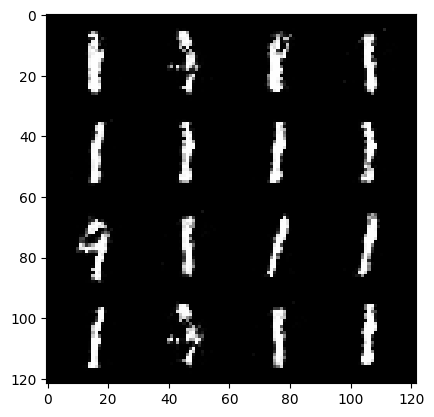

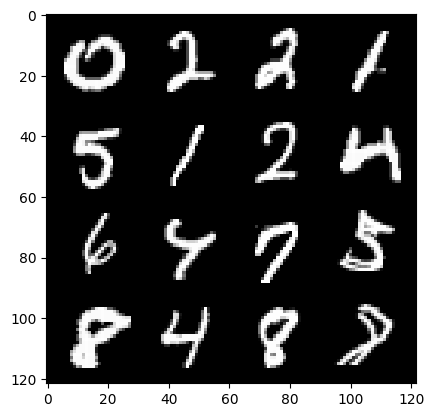

86: Step 40800 / Gen Loss : 3.296230723063153 / Disc Loss : 0.1375863777225216


  0%|          | 0/469 [00:00<?, ?it/s]

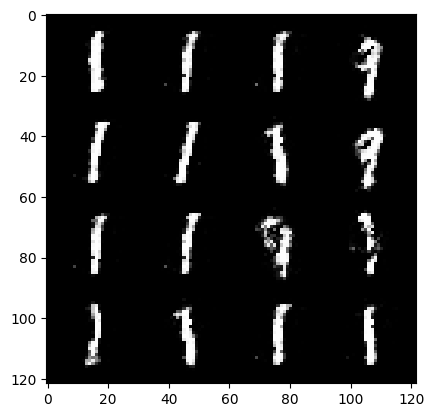

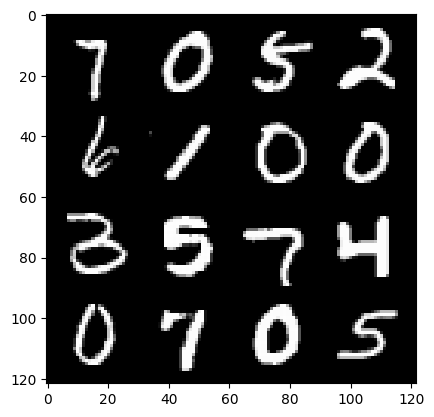

87: Step 41100 / Gen Loss : 3.1381812222798646 / Disc Loss : 0.14599518023431307


  0%|          | 0/469 [00:00<?, ?it/s]

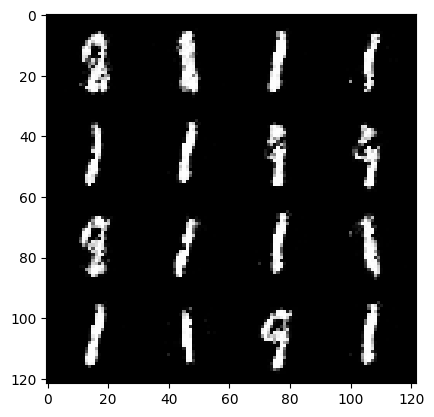

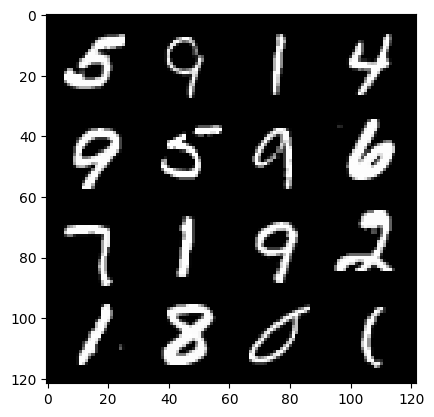

88: Step 41400 / Gen Loss : 3.206187823613484 / Disc Loss : 0.13071338108430294


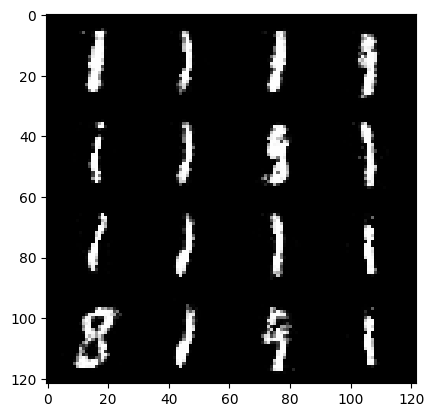

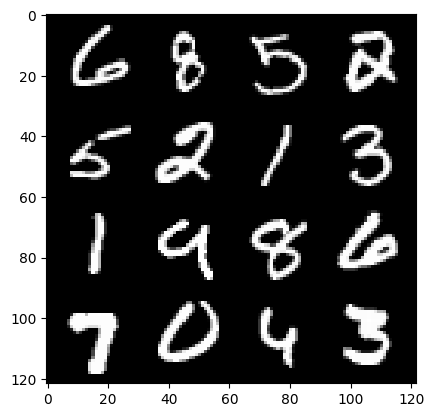

88: Step 41700 / Gen Loss : 3.142763586044315 / Disc Loss : 0.14150757215917123


  0%|          | 0/469 [00:00<?, ?it/s]

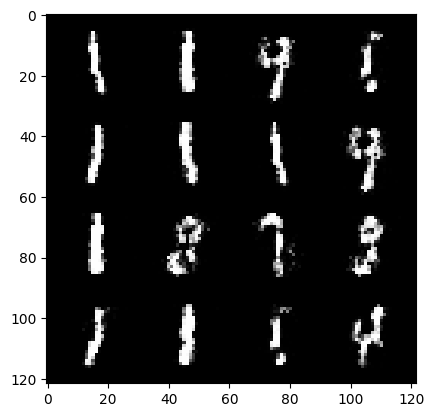

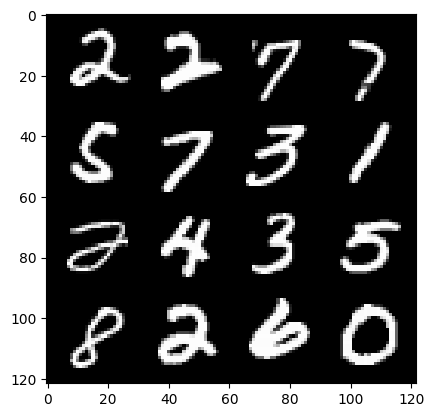

89: Step 42000 / Gen Loss : 3.1413748335838325 / Disc Loss : 0.1474665127197902


  0%|          | 0/469 [00:00<?, ?it/s]

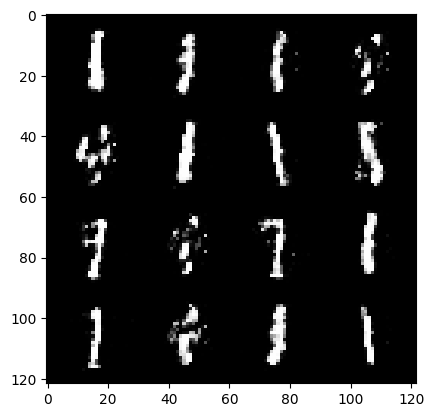

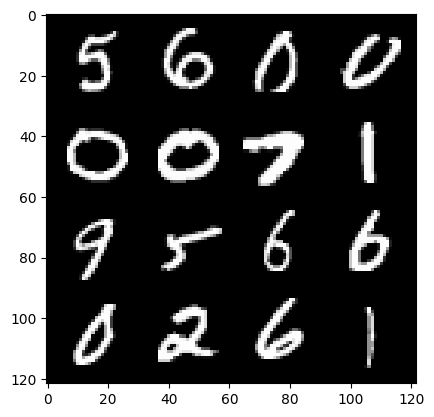

90: Step 42300 / Gen Loss : 3.106743106842041 / Disc Loss : 0.13846989548454697


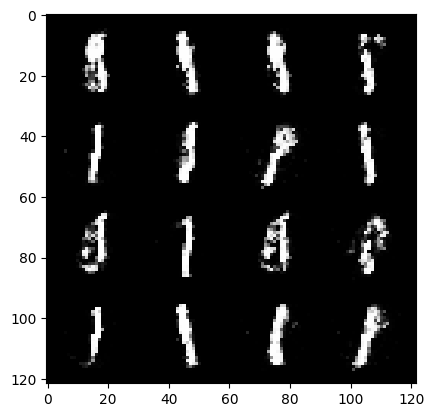

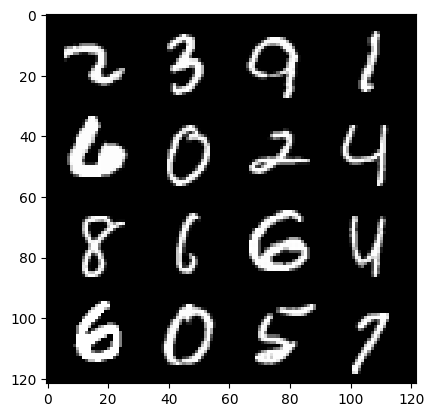

90: Step 42600 / Gen Loss : 3.1571293552716573 / Disc Loss : 0.1289381957178314


  0%|          | 0/469 [00:00<?, ?it/s]

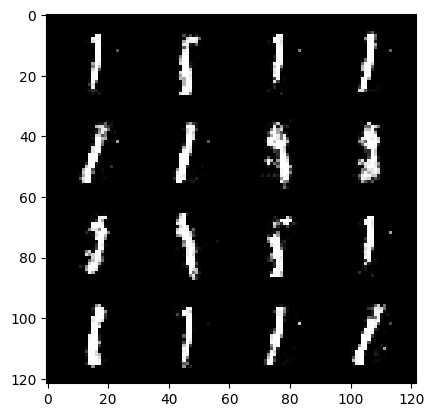

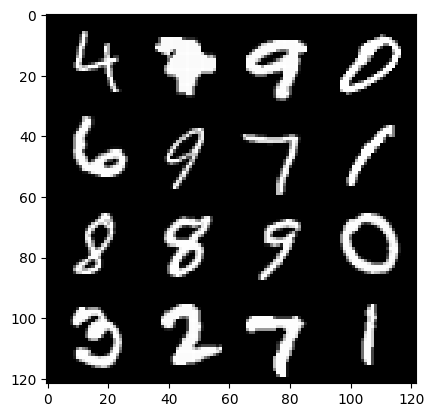

91: Step 42900 / Gen Loss : 3.184710981845856 / Disc Loss : 0.12177755866199728


  0%|          | 0/469 [00:00<?, ?it/s]

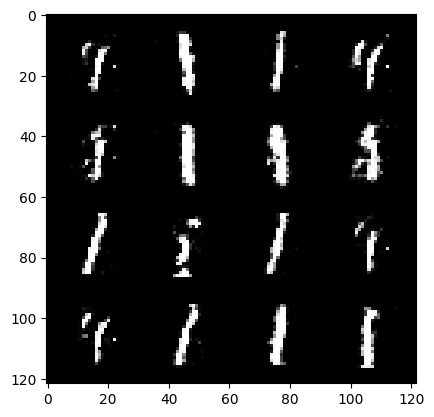

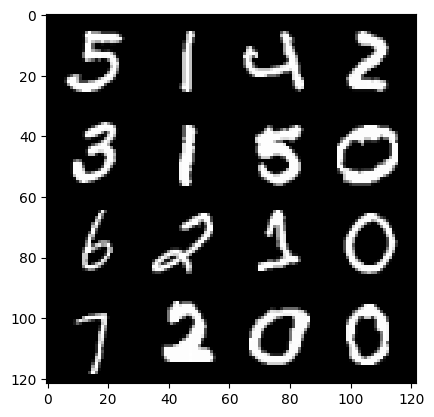

92: Step 43200 / Gen Loss : 3.2664629689852385 / Disc Loss : 0.12129798599829279


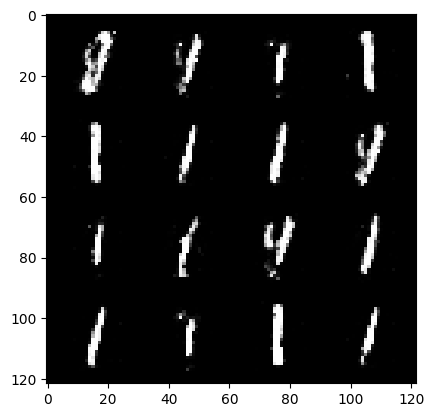

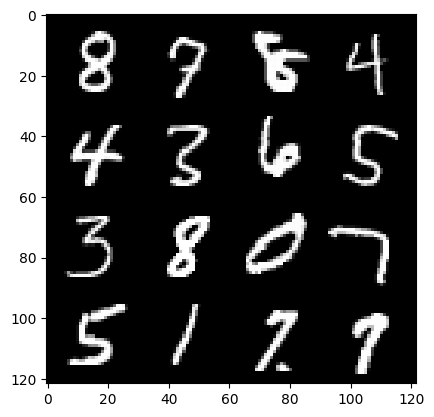

92: Step 43500 / Gen Loss : 3.123464616934457 / Disc Loss : 0.13172212430586433


  0%|          | 0/469 [00:00<?, ?it/s]

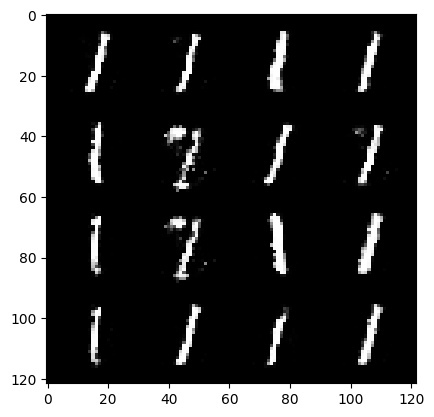

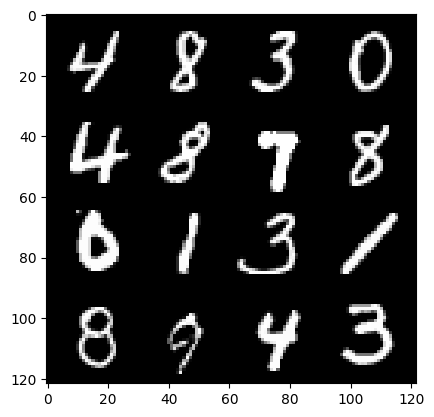

93: Step 43800 / Gen Loss : 2.9291659037272155 / Disc Loss : 0.17362874714036777


  0%|          | 0/469 [00:00<?, ?it/s]

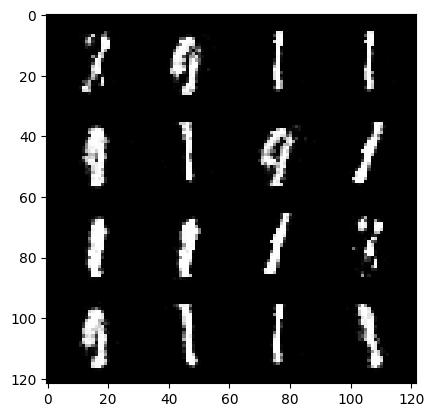

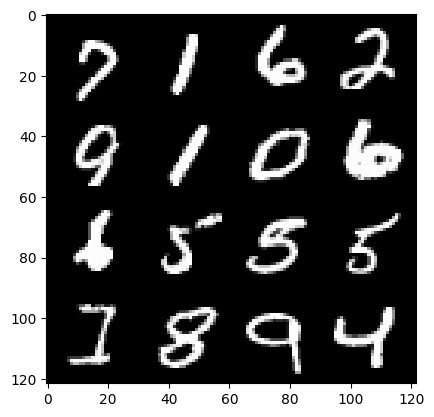

94: Step 44100 / Gen Loss : 2.818898156483969 / Disc Loss : 0.1759917778521777


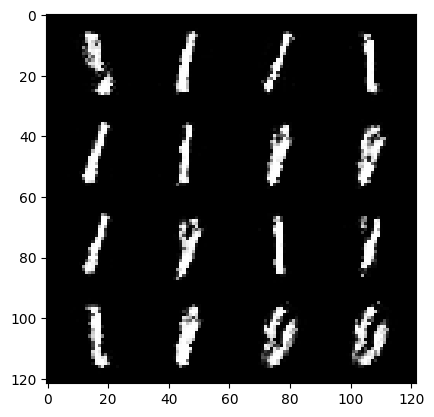

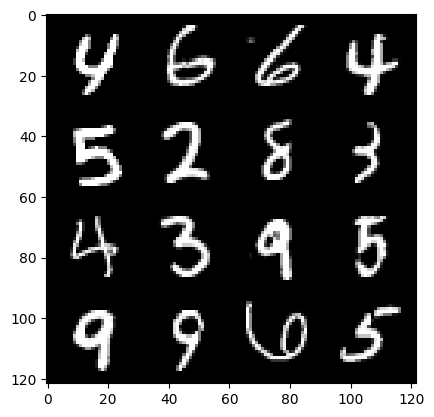

94: Step 44400 / Gen Loss : 2.741250195503234 / Disc Loss : 0.1742013884832464


  0%|          | 0/469 [00:00<?, ?it/s]

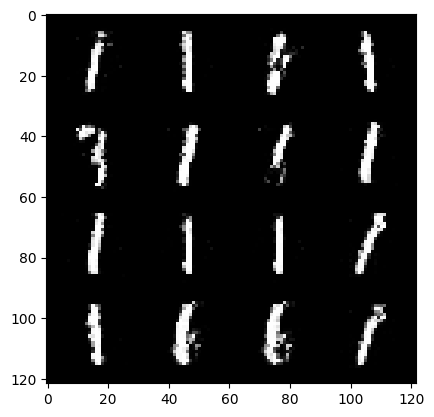

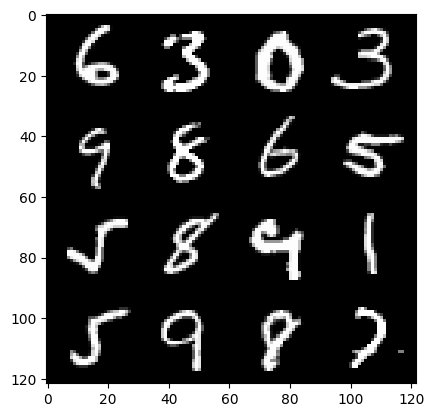

95: Step 44700 / Gen Loss : 2.8264300020535797 / Disc Loss : 0.16075812684992938


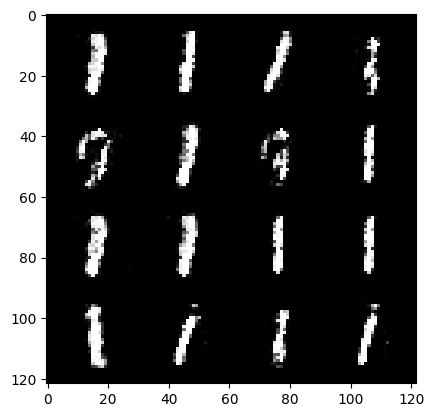

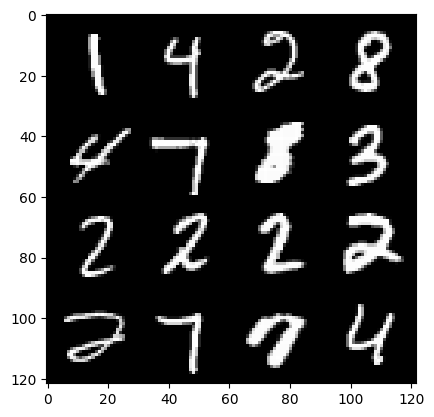

95: Step 45000 / Gen Loss : 2.890944267114004 / Disc Loss : 0.1588630483547846


  0%|          | 0/469 [00:00<?, ?it/s]

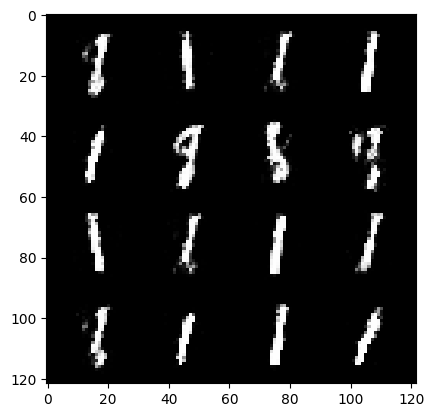

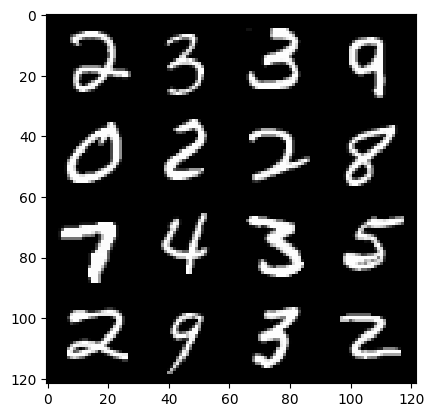

96: Step 45300 / Gen Loss : 2.829507844448089 / Disc Loss : 0.1583656055852771


  0%|          | 0/469 [00:00<?, ?it/s]

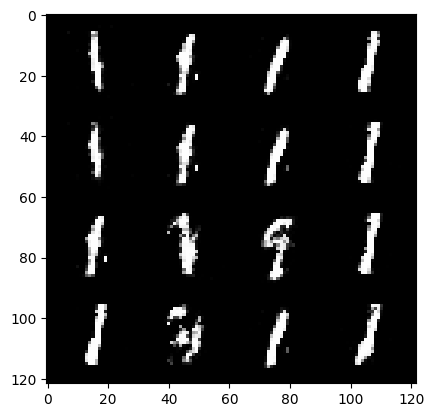

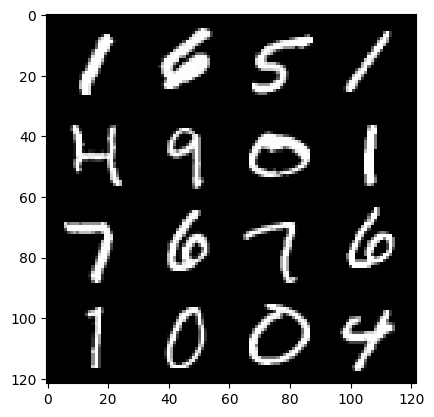

97: Step 45600 / Gen Loss : 2.8525745407740257 / Disc Loss : 0.16762709145744642


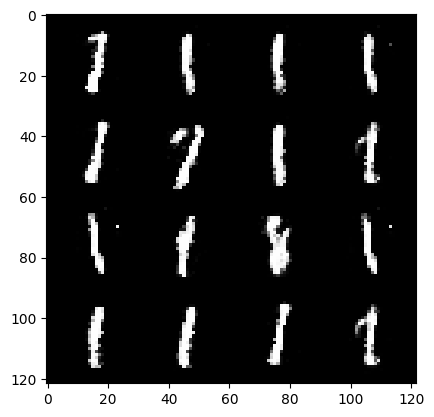

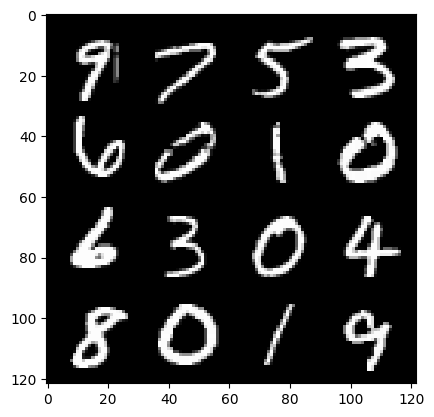

97: Step 45900 / Gen Loss : 2.974234669208529 / Disc Loss : 0.14991201599438986


  0%|          | 0/469 [00:00<?, ?it/s]

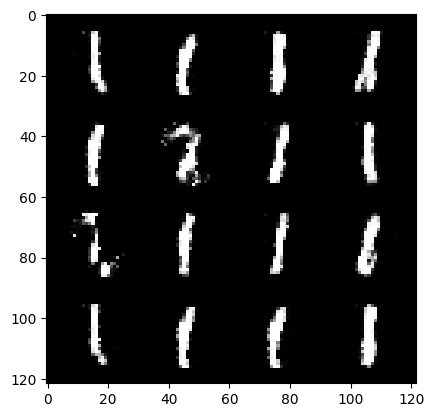

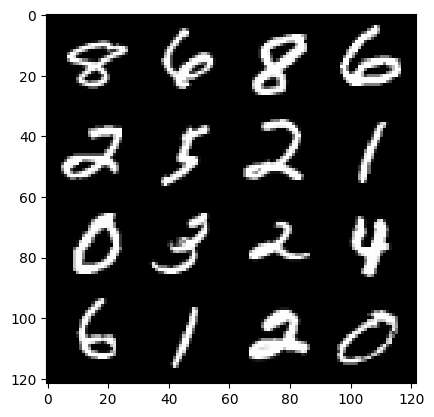

98: Step 46200 / Gen Loss : 2.8739285937945063 / Disc Loss : 0.15918668424089755


  0%|          | 0/469 [00:00<?, ?it/s]

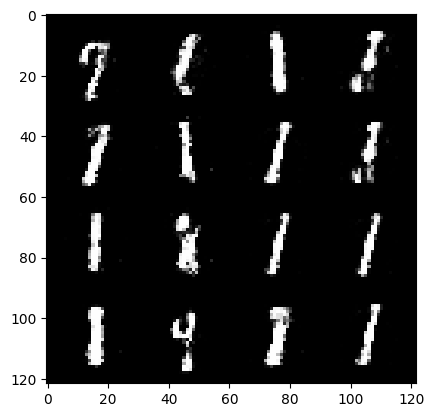

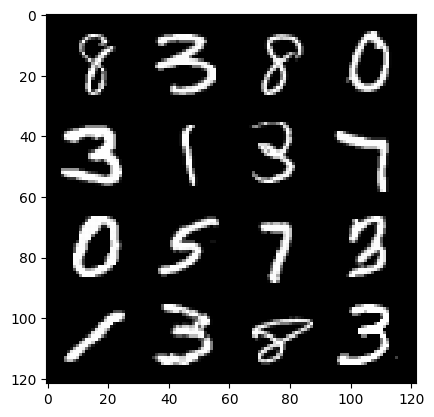

99: Step 46500 / Gen Loss : 2.9806207966804488 / Disc Loss : 0.1413375070691109


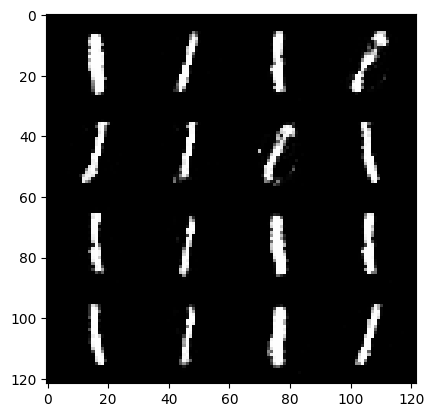

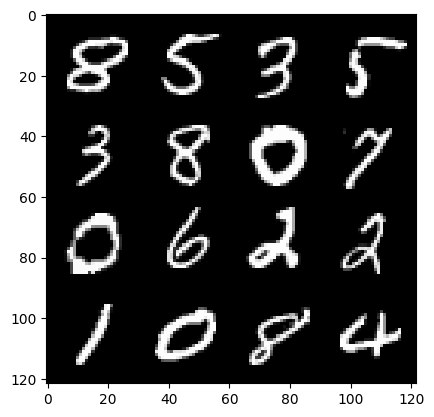

99: Step 46800 / Gen Loss : 2.8706667518615725 / Disc Loss : 0.15720653019845496


  0%|          | 0/469 [00:00<?, ?it/s]

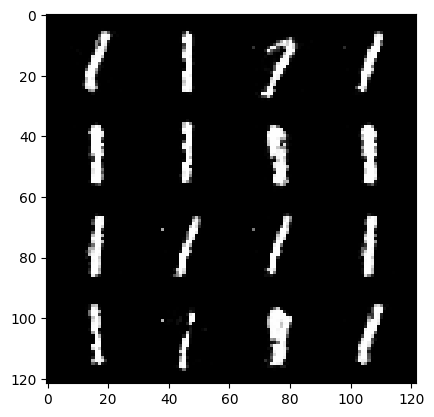

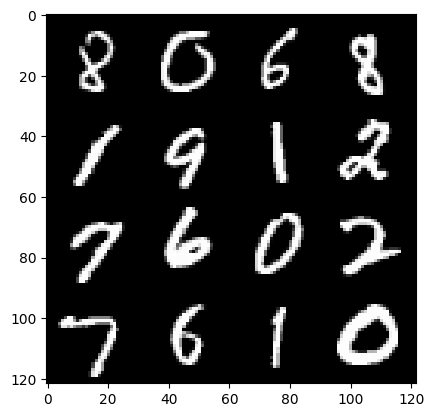

100: Step 47100 / Gen Loss : 2.6498125863075264 / Disc Loss : 0.1765515314539275


  0%|          | 0/469 [00:00<?, ?it/s]

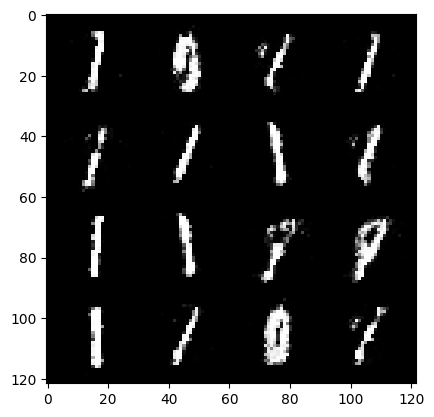

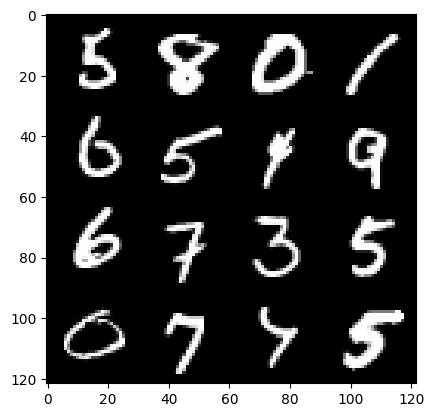

101: Step 47400 / Gen Loss : 2.704297484556834 / Disc Loss : 0.16216506754358592


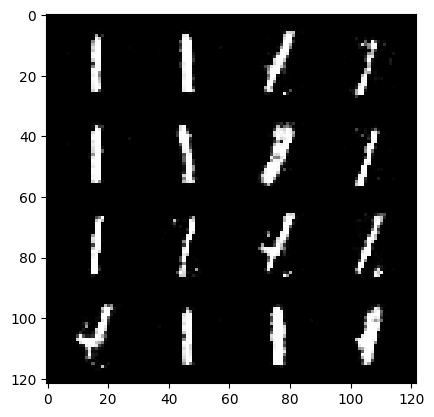

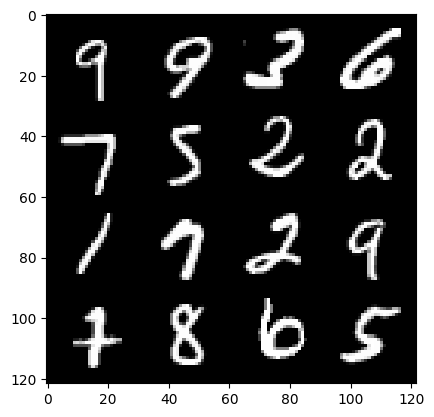

101: Step 47700 / Gen Loss : 2.7051439070701613 / Disc Loss : 0.17006522183616962


  0%|          | 0/469 [00:00<?, ?it/s]

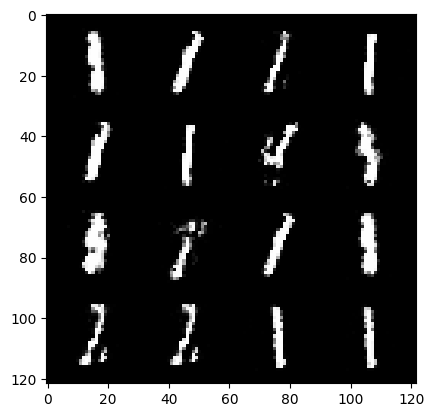

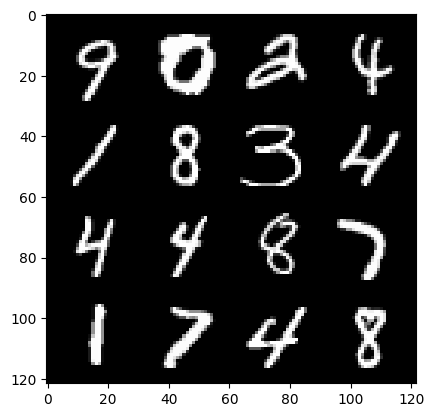

102: Step 48000 / Gen Loss : 2.729612751007079 / Disc Loss : 0.1532700531433026


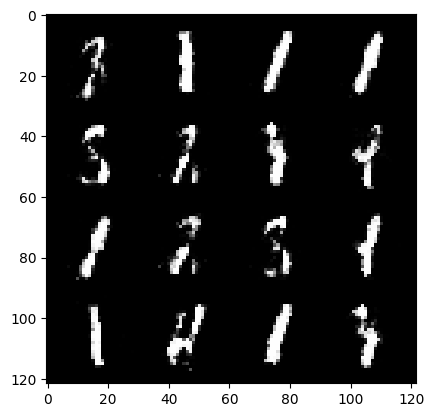

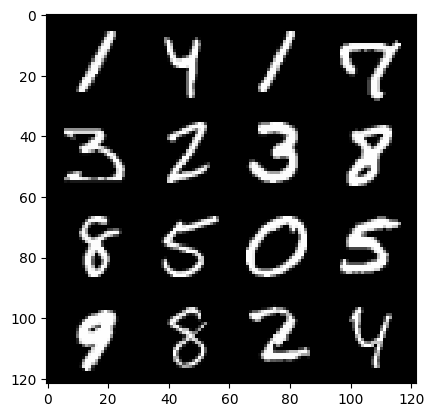

102: Step 48300 / Gen Loss : 2.749693507353463 / Disc Loss : 0.17235081126292542


  0%|          | 0/469 [00:00<?, ?it/s]

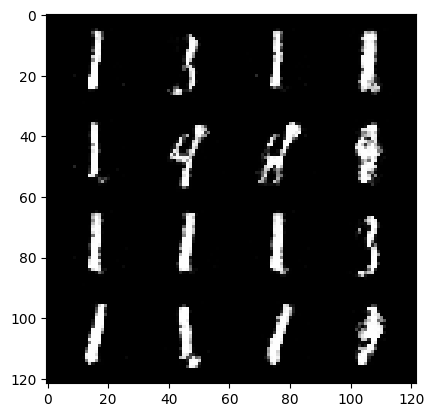

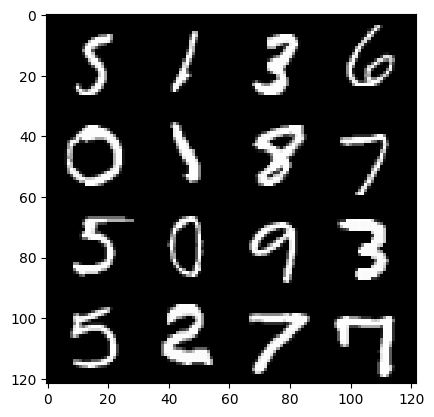

103: Step 48600 / Gen Loss : 2.5935361949602744 / Disc Loss : 0.18180086068809048


  0%|          | 0/469 [00:00<?, ?it/s]

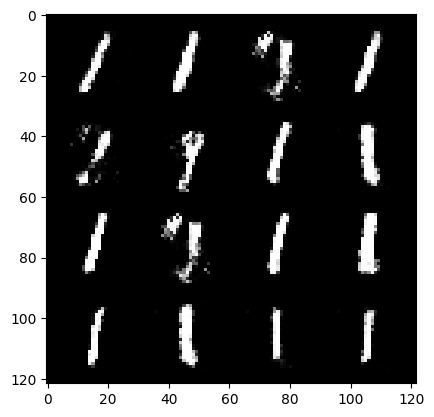

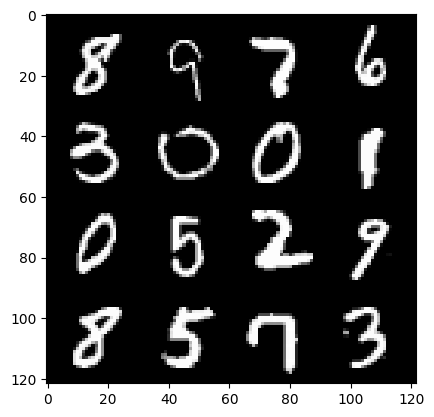

104: Step 48900 / Gen Loss : 2.68192648569743 / Disc Loss : 0.17589400708675396


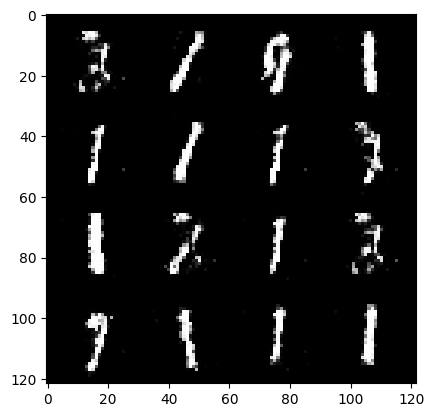

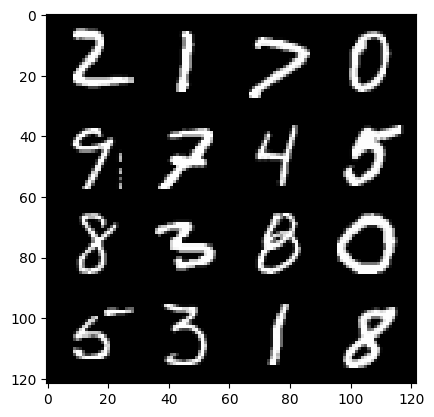

104: Step 49200 / Gen Loss : 2.6838723842302943 / Disc Loss : 0.17405868291854856


  0%|          | 0/469 [00:00<?, ?it/s]

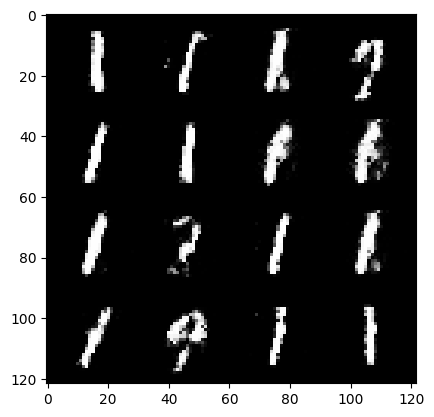

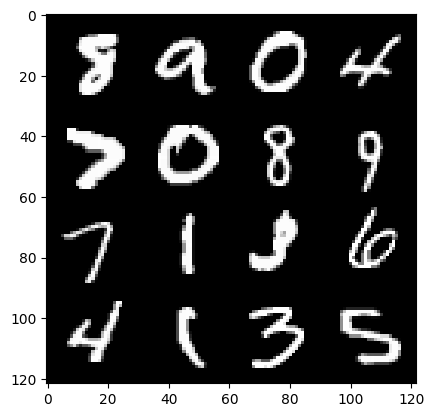

105: Step 49500 / Gen Loss : 2.49279280145963 / Disc Loss : 0.2058742548525334


  0%|          | 0/469 [00:00<?, ?it/s]

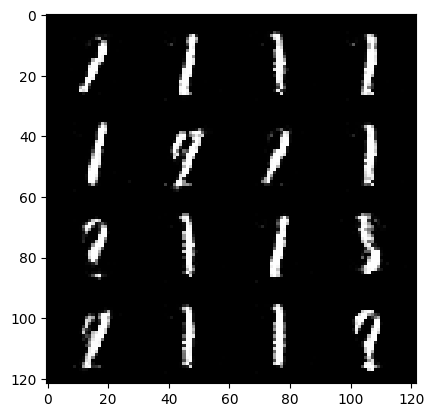

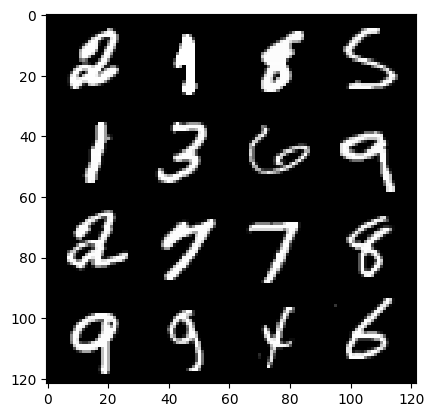

106: Step 49800 / Gen Loss : 2.4903144923845937 / Disc Loss : 0.1923293119917312


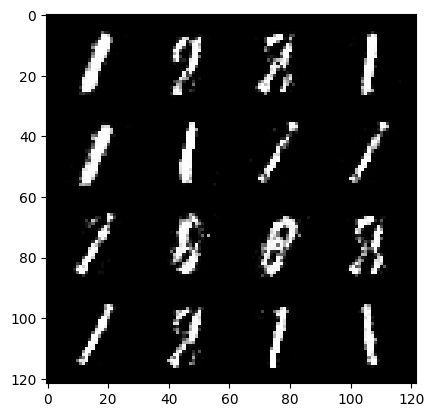

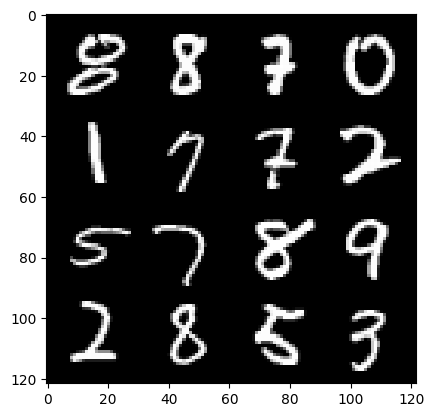

106: Step 50100 / Gen Loss : 2.515095631281531 / Disc Loss : 0.18653911607960863


  0%|          | 0/469 [00:00<?, ?it/s]

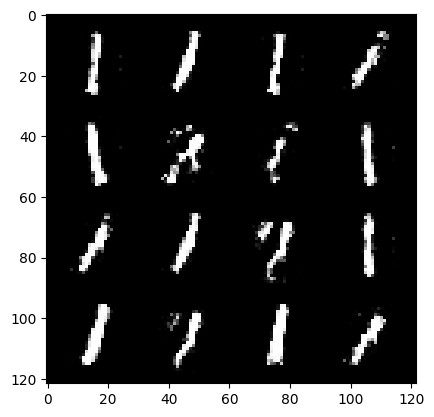

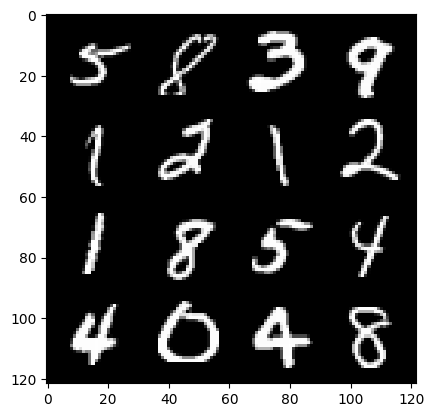

107: Step 50400 / Gen Loss : 2.5466271122296638 / Disc Loss : 0.19293372737864653


  0%|          | 0/469 [00:00<?, ?it/s]

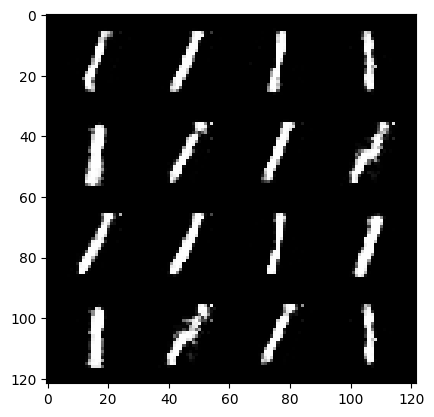

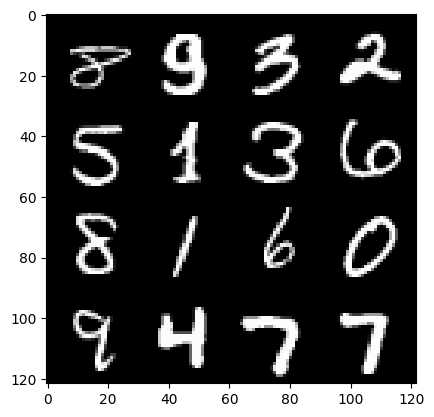

108: Step 50700 / Gen Loss : 2.530454316139222 / Disc Loss : 0.19194784914453838


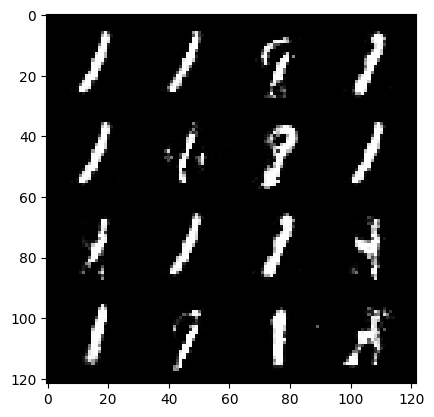

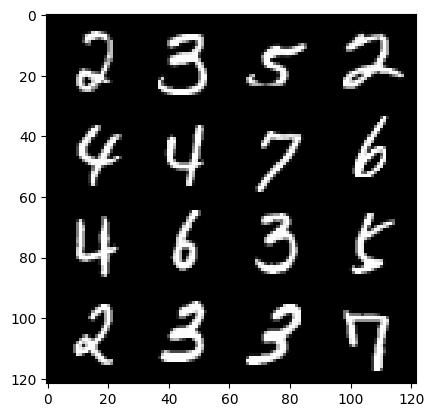

108: Step 51000 / Gen Loss : 2.4760471423466988 / Disc Loss : 0.19115352531274174


  0%|          | 0/469 [00:00<?, ?it/s]

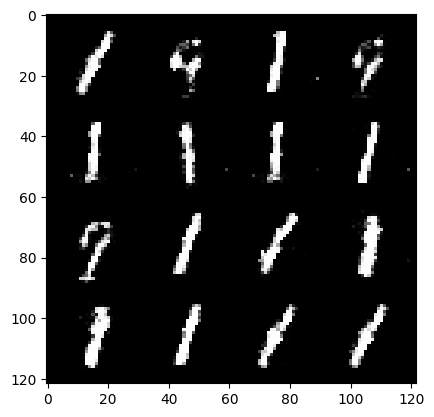

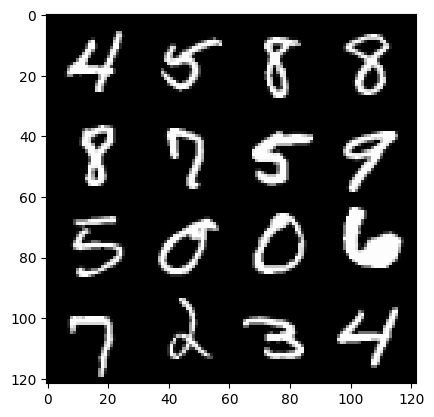

109: Step 51300 / Gen Loss : 2.532162627379099 / Disc Loss : 0.19897626787424094


  0%|          | 0/469 [00:00<?, ?it/s]

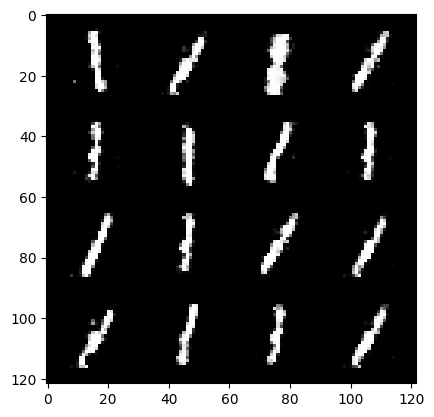

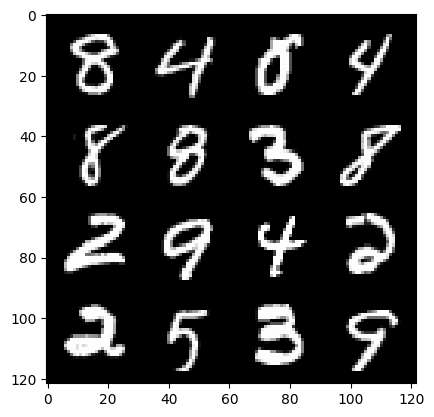

110: Step 51600 / Gen Loss : 2.4893664073944084 / Disc Loss : 0.1811103637516498


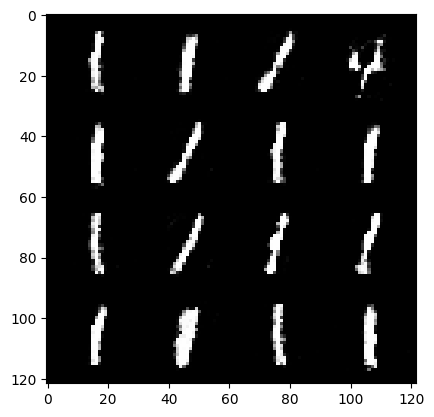

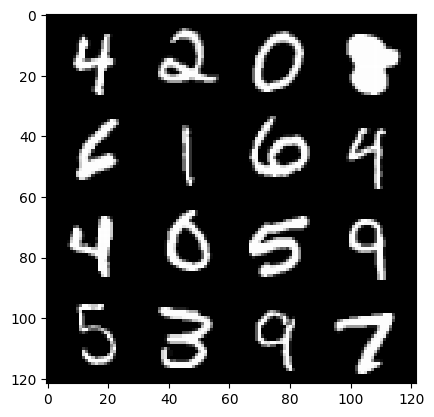

110: Step 51900 / Gen Loss : 2.5414104064305634 / Disc Loss : 0.180952683662375


  0%|          | 0/469 [00:00<?, ?it/s]

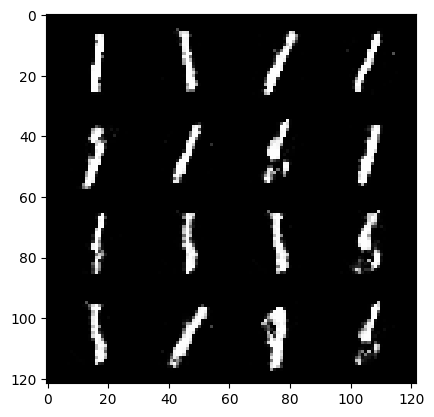

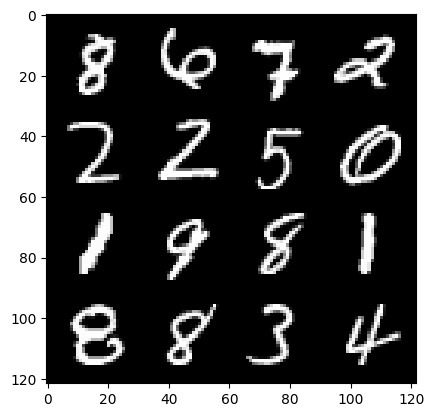

111: Step 52200 / Gen Loss : 2.616069732507071 / Disc Loss : 0.17341837264597423


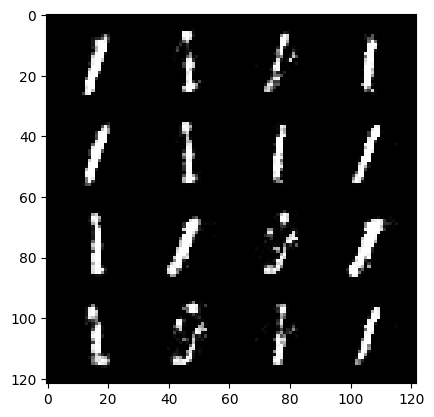

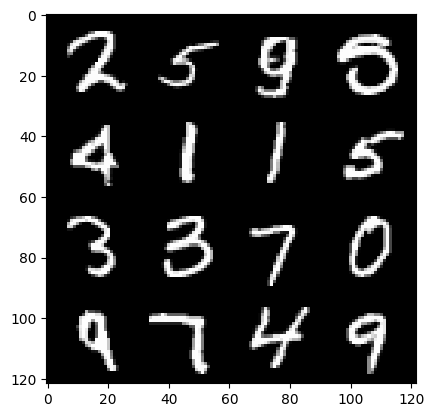

111: Step 52500 / Gen Loss : 2.526683076222735 / Disc Loss : 0.19147925260166326


  0%|          | 0/469 [00:00<?, ?it/s]

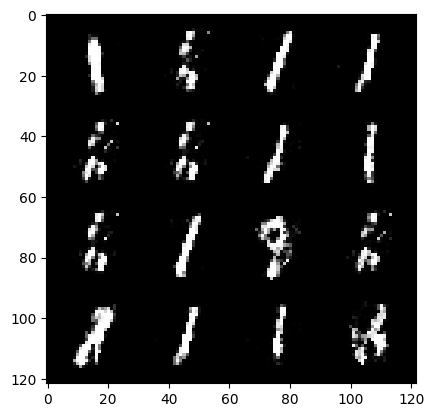

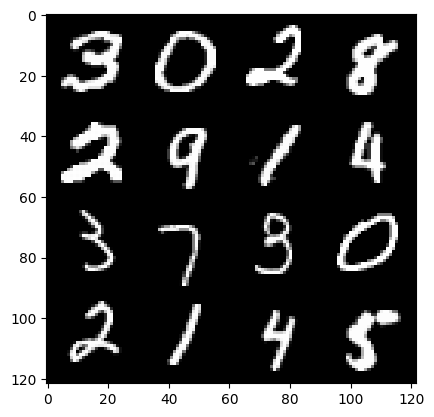

112: Step 52800 / Gen Loss : 2.539868760903677 / Disc Loss : 0.18144553042948233


  0%|          | 0/469 [00:00<?, ?it/s]

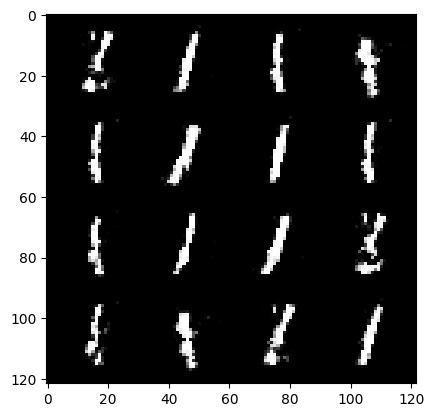

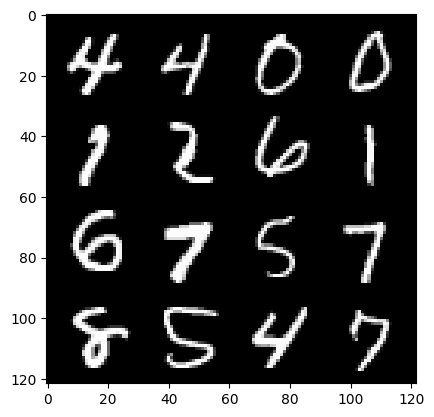

113: Step 53100 / Gen Loss : 2.5644779276847838 / Disc Loss : 0.1667955953379473


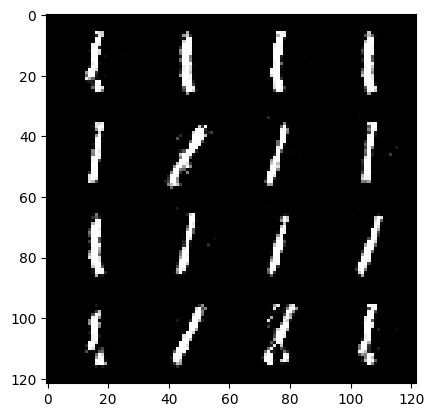

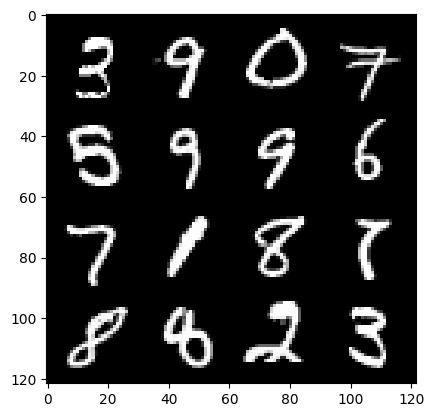

113: Step 53400 / Gen Loss : 2.688578532536824 / Disc Loss : 0.1575359507650137


  0%|          | 0/469 [00:00<?, ?it/s]

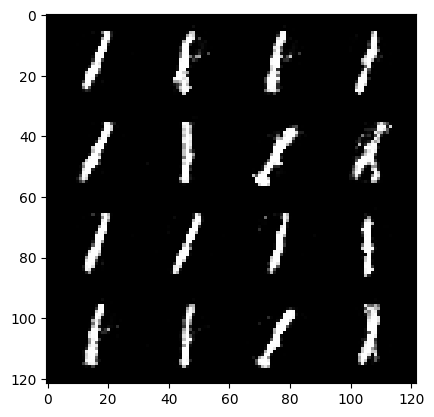

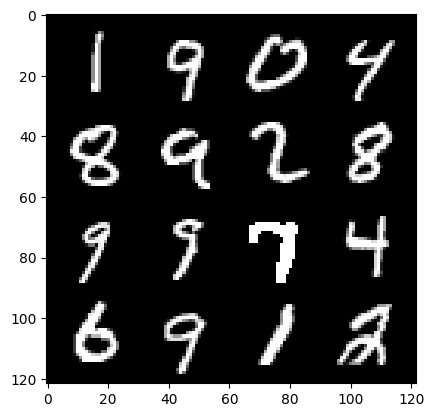

114: Step 53700 / Gen Loss : 2.8027681215604145 / Disc Loss : 0.1456274164219697


  0%|          | 0/469 [00:00<?, ?it/s]

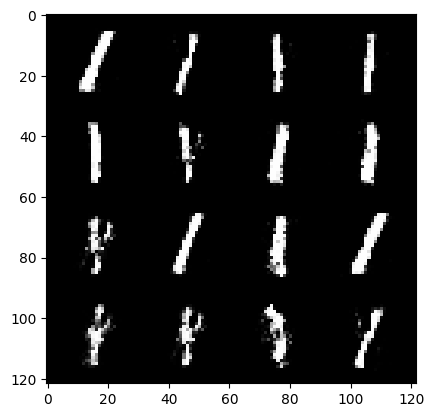

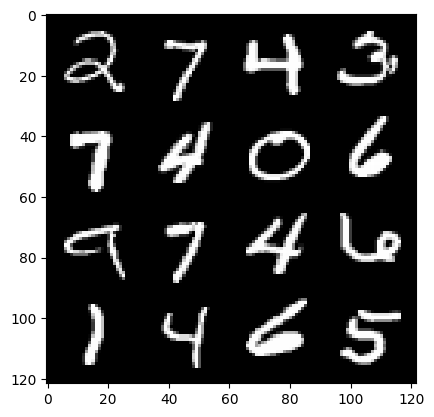

115: Step 54000 / Gen Loss : 2.8201298276583366 / Disc Loss : 0.16361534538368386


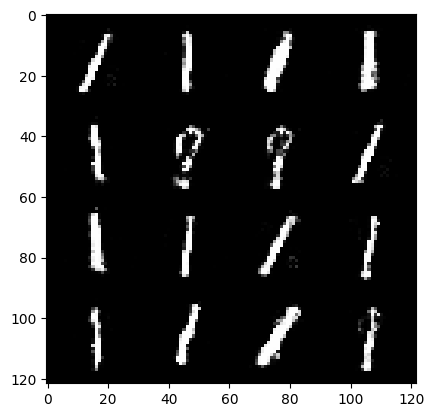

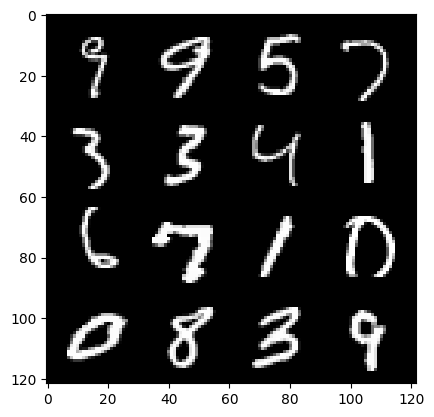

115: Step 54300 / Gen Loss : 2.5666023937861113 / Disc Loss : 0.1902525592346985


  0%|          | 0/469 [00:00<?, ?it/s]

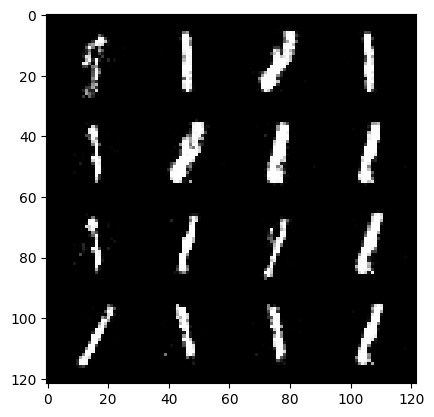

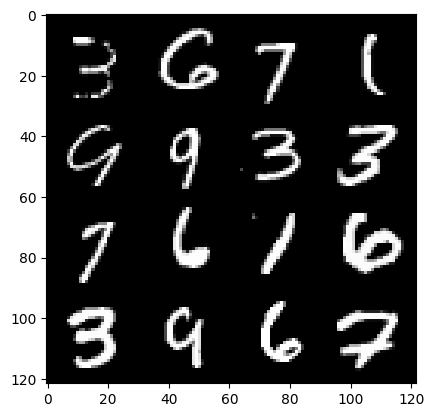

116: Step 54600 / Gen Loss : 2.4855518428484595 / Disc Loss : 0.18398343985279408


  0%|          | 0/469 [00:00<?, ?it/s]

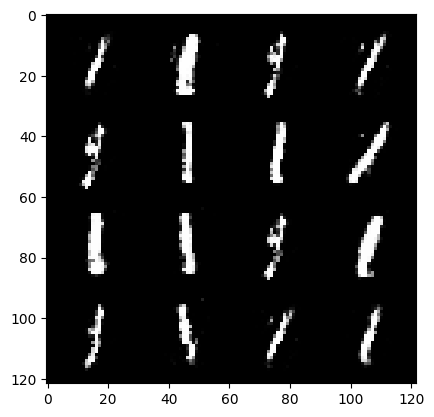

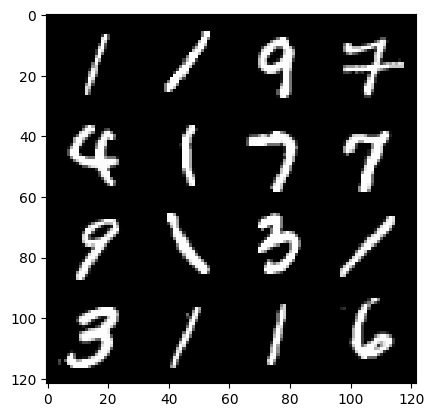

117: Step 54900 / Gen Loss : 2.4740516646703083 / Disc Loss : 0.1829527310778698


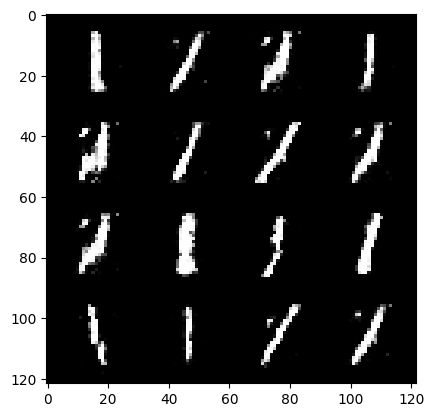

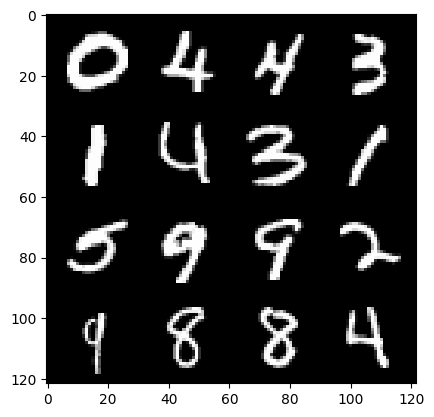

117: Step 55200 / Gen Loss : 2.5190476425488817 / Disc Loss : 0.16132843049863985


  0%|          | 0/469 [00:00<?, ?it/s]

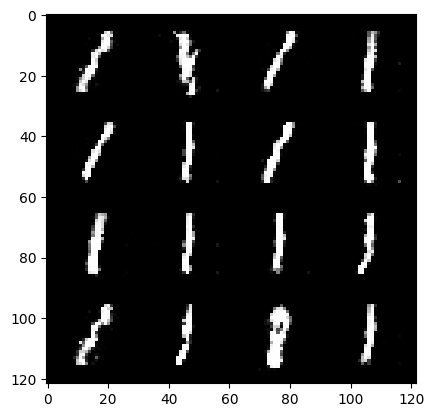

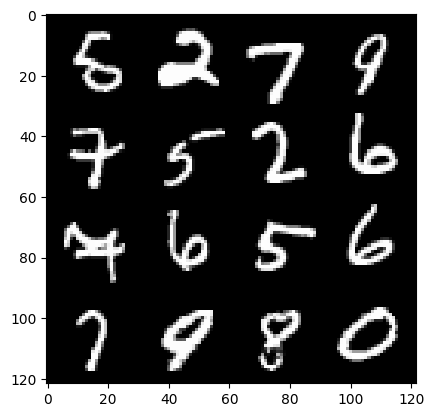

118: Step 55500 / Gen Loss : 2.5676732635498043 / Disc Loss : 0.1770829985042414


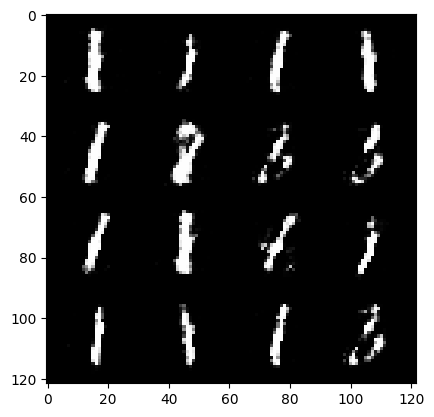

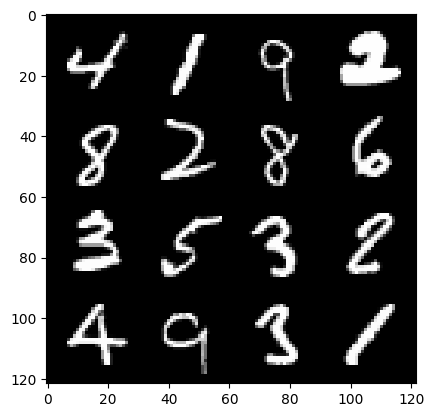

118: Step 55800 / Gen Loss : 2.536219015916189 / Disc Loss : 0.17782869470616194


  0%|          | 0/469 [00:00<?, ?it/s]

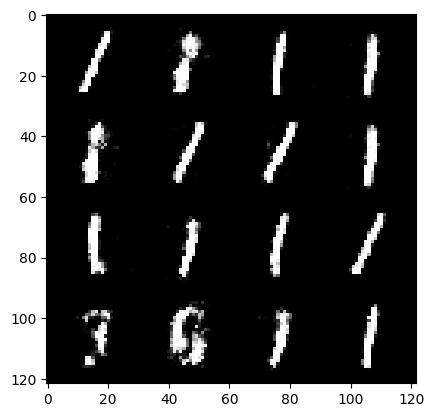

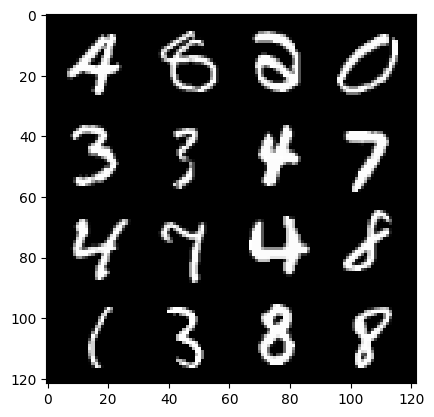

119: Step 56100 / Gen Loss : 2.5805428338050853 / Disc Loss : 0.18040209616223957


  0%|          | 0/469 [00:00<?, ?it/s]

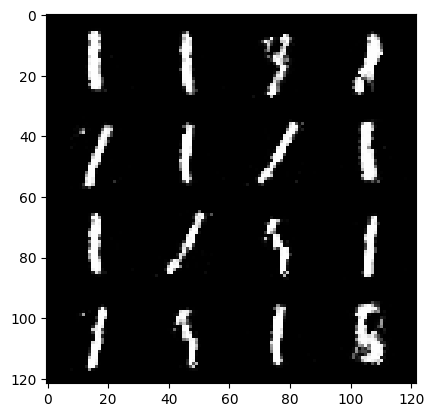

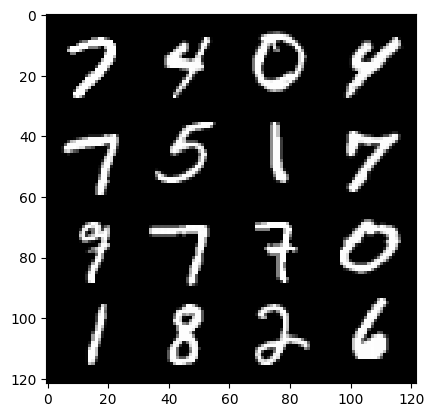

120: Step 56400 / Gen Loss : 2.552679100036622 / Disc Loss : 0.17594766815503438


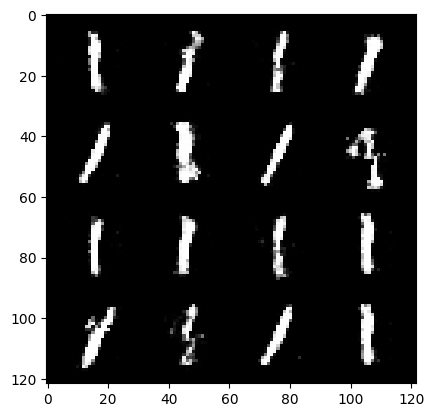

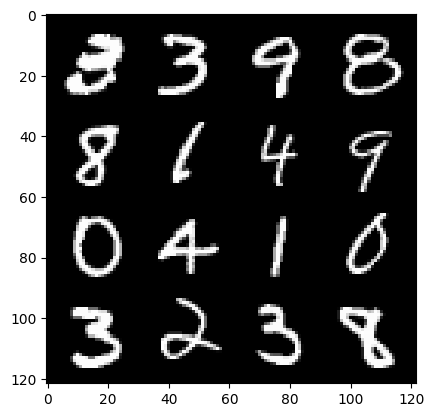

120: Step 56700 / Gen Loss : 2.567139409383138 / Disc Loss : 0.1814679430425167


  0%|          | 0/469 [00:00<?, ?it/s]

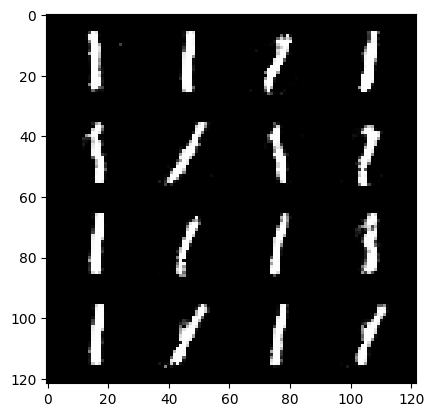

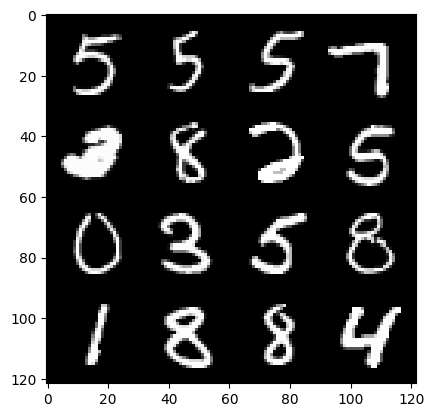

121: Step 57000 / Gen Loss : 2.5445602599779775 / Disc Loss : 0.17950855920712155


  0%|          | 0/469 [00:00<?, ?it/s]

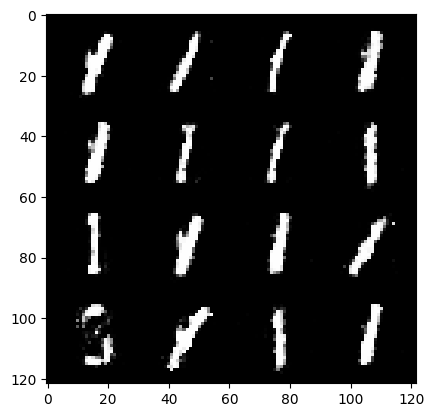

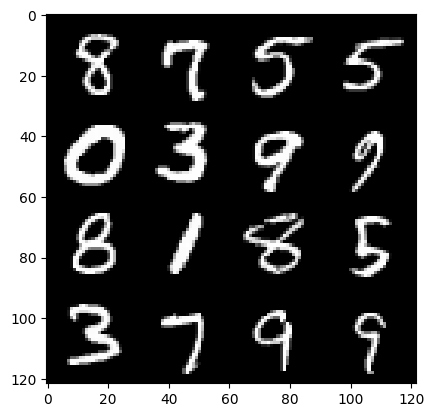

122: Step 57300 / Gen Loss : 2.464800627231597 / Disc Loss : 0.19831513474384957


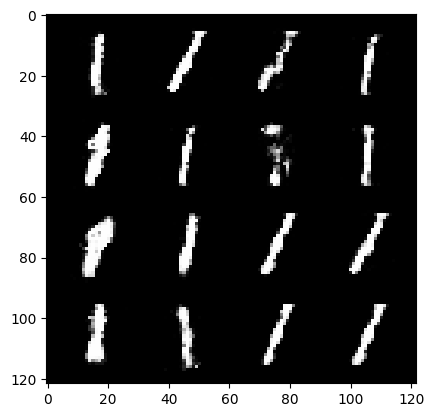

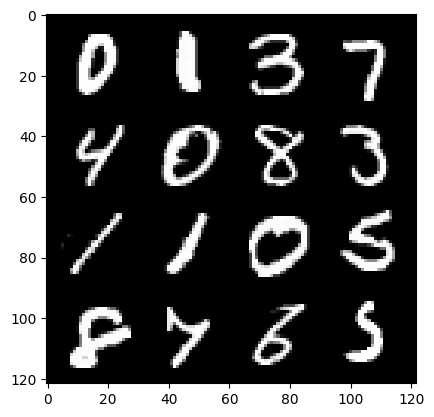

122: Step 57600 / Gen Loss : 2.453744961420694 / Disc Loss : 0.18522014329830802


  0%|          | 0/469 [00:00<?, ?it/s]

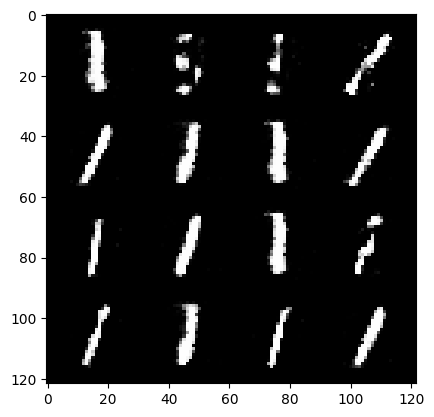

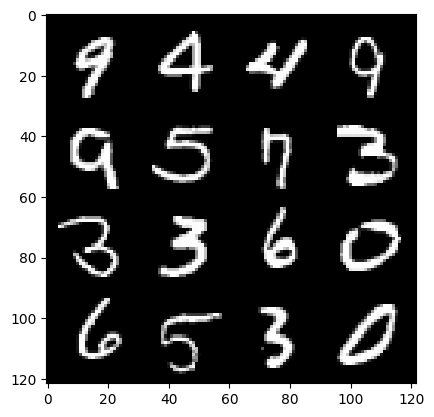

123: Step 57900 / Gen Loss : 2.4117699440320317 / Disc Loss : 0.19162624595065902


  0%|          | 0/469 [00:00<?, ?it/s]

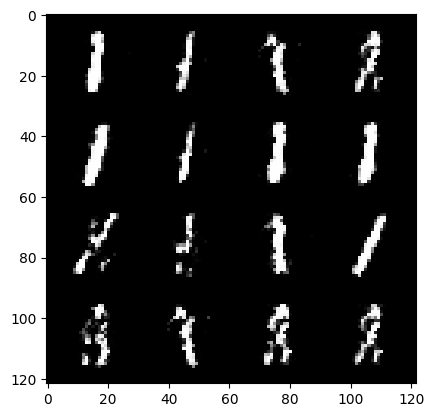

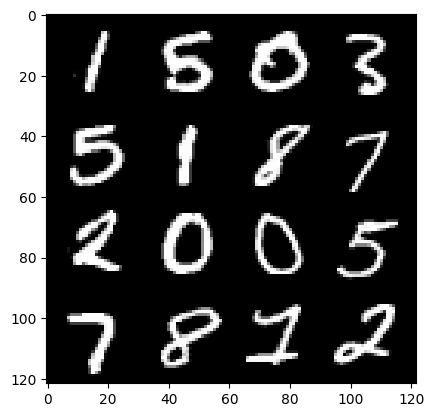

124: Step 58200 / Gen Loss : 2.4392655062675477 / Disc Loss : 0.19258579085270575


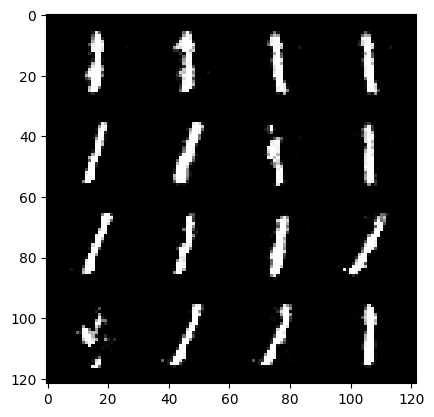

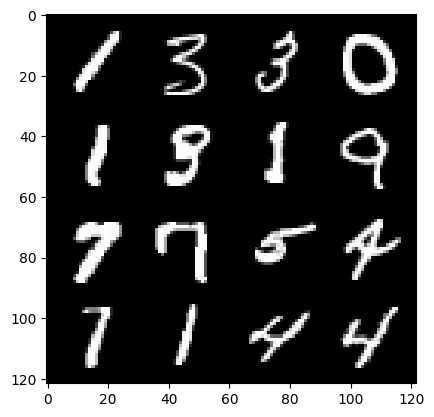

124: Step 58500 / Gen Loss : 2.383486901124321 / Disc Loss : 0.19102205000817796


  0%|          | 0/469 [00:00<?, ?it/s]

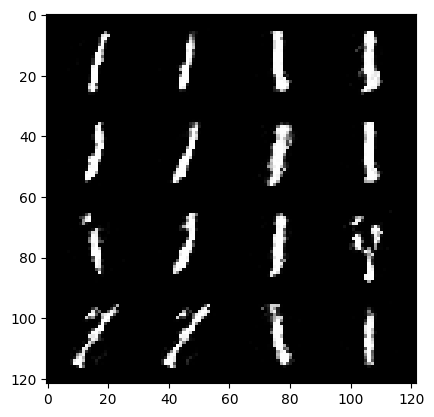

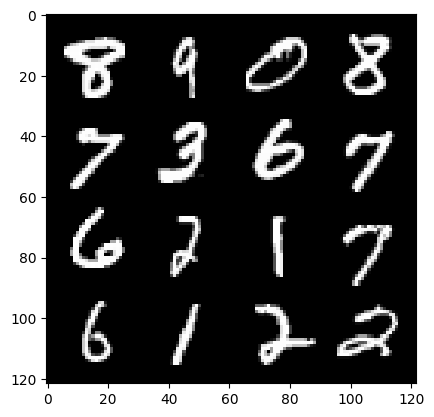

125: Step 58800 / Gen Loss : 2.4781329266230268 / Disc Loss : 0.17555780798196793


  0%|          | 0/469 [00:00<?, ?it/s]

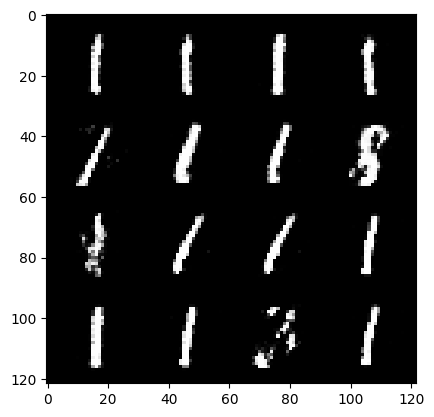

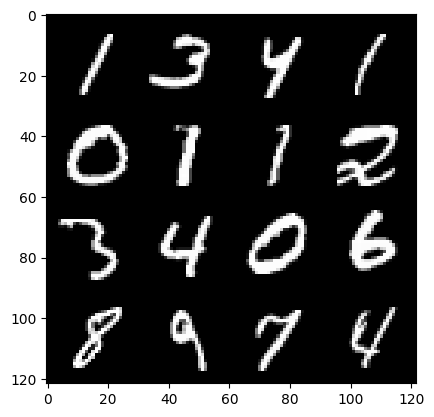

126: Step 59100 / Gen Loss : 2.4548938600222265 / Disc Loss : 0.19065302478770413


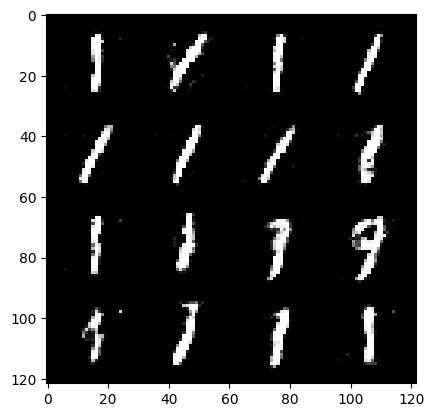

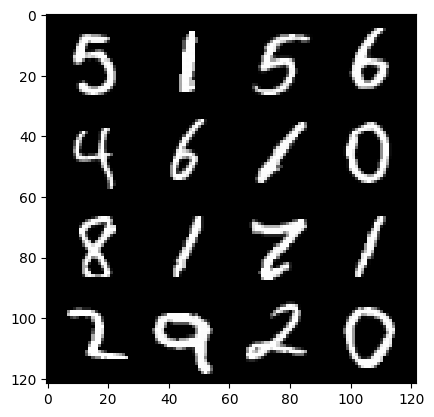

126: Step 59400 / Gen Loss : 2.4949473865826945 / Disc Loss : 0.17672967093686268


  0%|          | 0/469 [00:00<?, ?it/s]

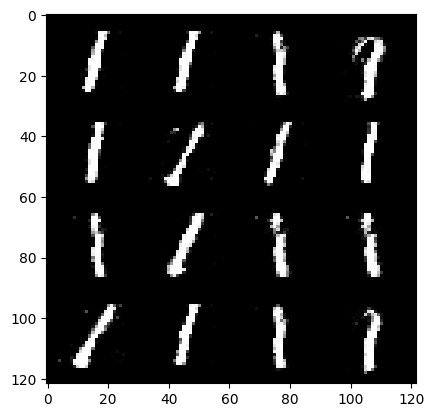

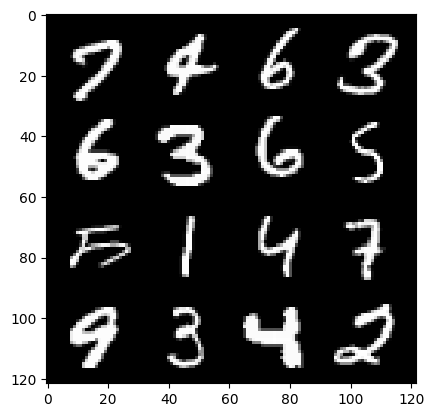

127: Step 59700 / Gen Loss : 2.538301122983296 / Disc Loss : 0.19696178791423632


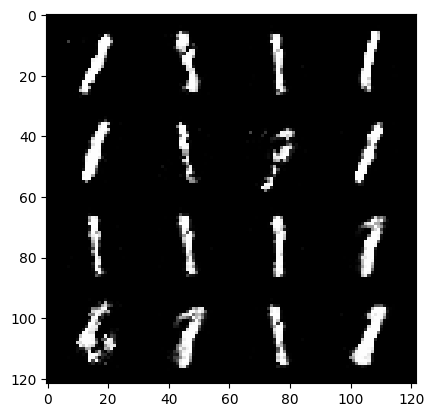

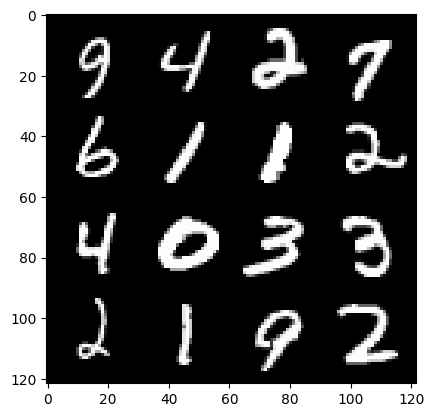

127: Step 60000 / Gen Loss : 2.446078050136566 / Disc Loss : 0.1922361217687526


  0%|          | 0/469 [00:00<?, ?it/s]

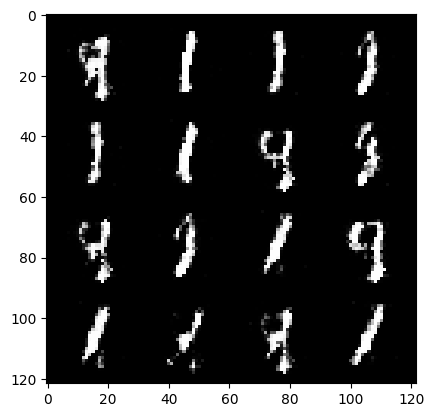

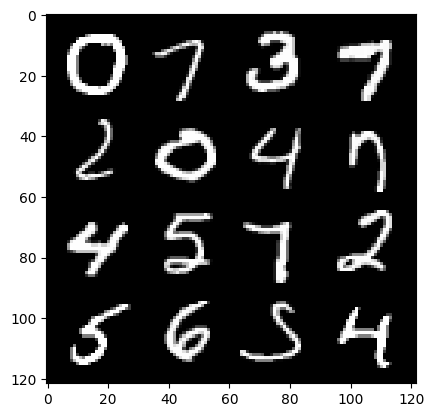

128: Step 60300 / Gen Loss : 2.514399844010671 / Disc Loss : 0.19197699757913758


  0%|          | 0/469 [00:00<?, ?it/s]

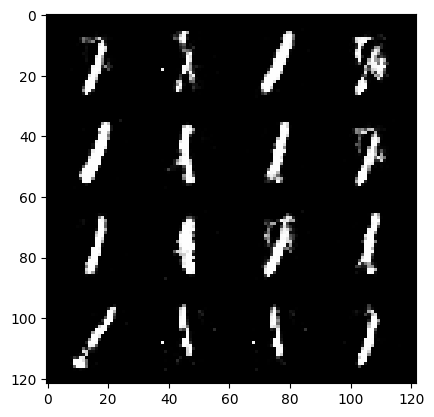

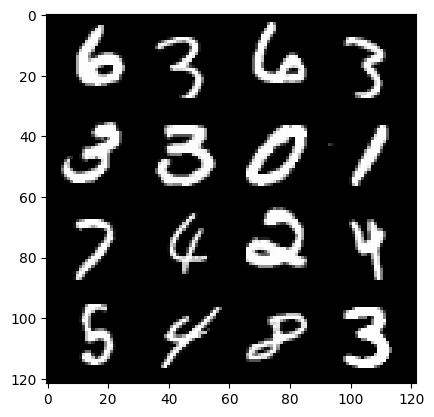

129: Step 60600 / Gen Loss : 2.4588475052515673 / Disc Loss : 0.18215089569489162


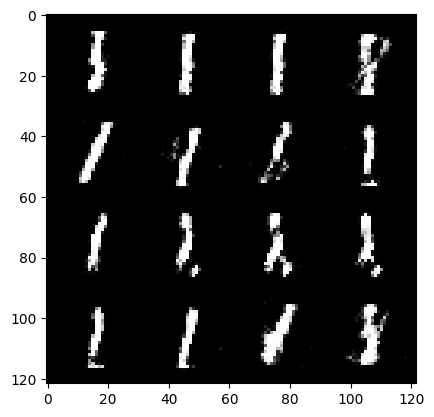

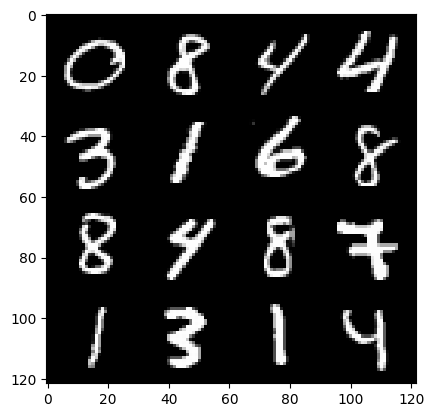

129: Step 60900 / Gen Loss : 2.586281068325043 / Disc Loss : 0.17686697043478491


  0%|          | 0/469 [00:00<?, ?it/s]

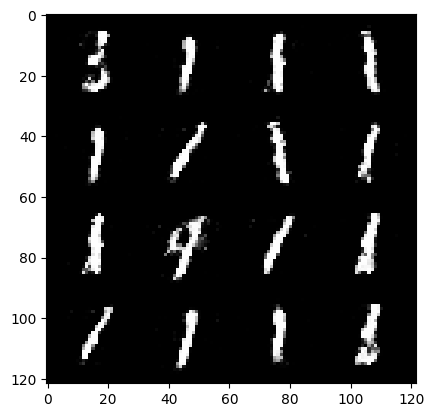

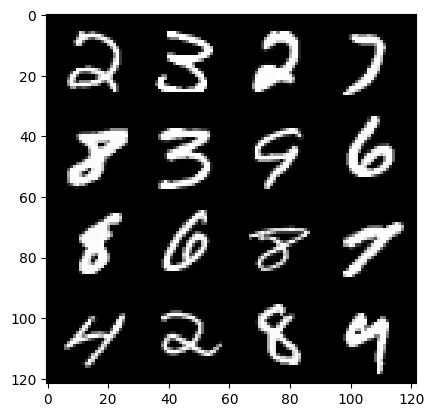

130: Step 61200 / Gen Loss : 2.4570800725618995 / Disc Loss : 0.1763219689826169


  0%|          | 0/469 [00:00<?, ?it/s]

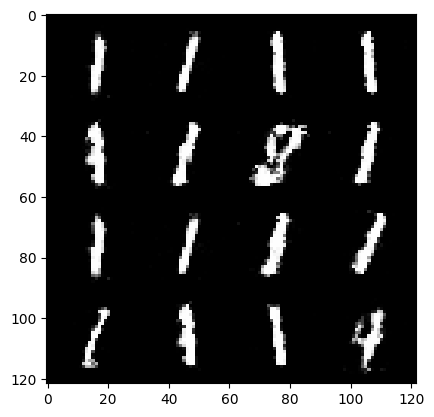

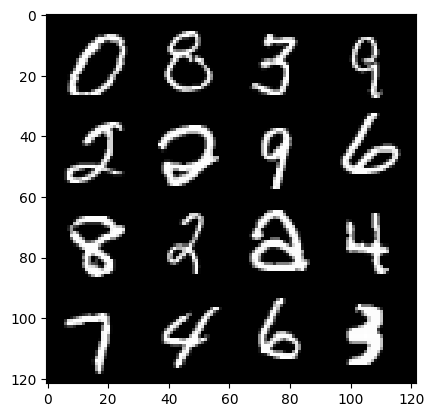

131: Step 61500 / Gen Loss : 2.457468049526213 / Disc Loss : 0.19195616493622464


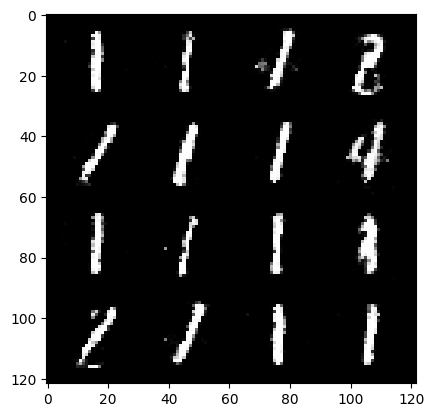

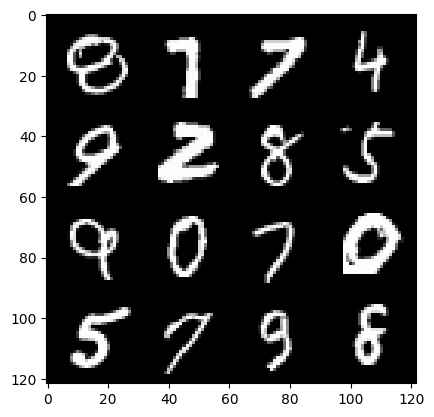

131: Step 61800 / Gen Loss : 2.3954307548205063 / Disc Loss : 0.19598004077871653


  0%|          | 0/469 [00:00<?, ?it/s]

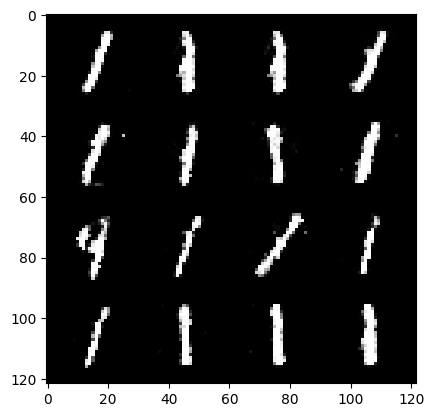

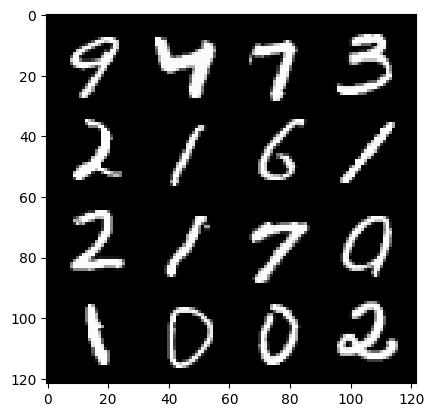

132: Step 62100 / Gen Loss : 2.339607379436491 / Disc Loss : 0.21107188756267234


  0%|          | 0/469 [00:00<?, ?it/s]

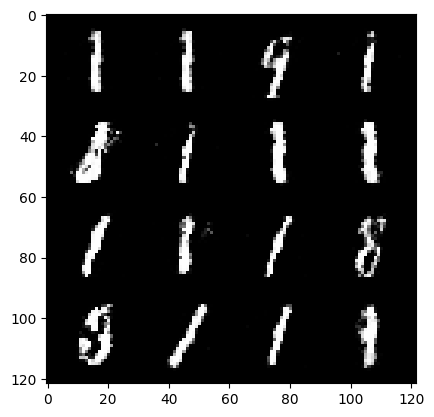

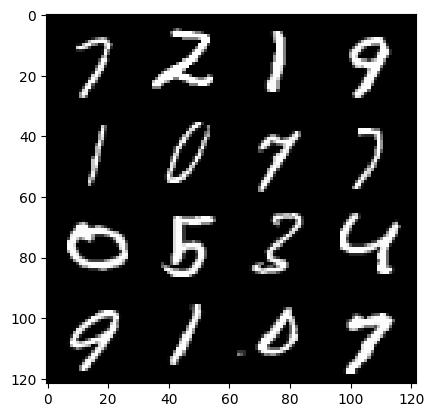

133: Step 62400 / Gen Loss : 2.4002045297622665 / Disc Loss : 0.19058532396952316


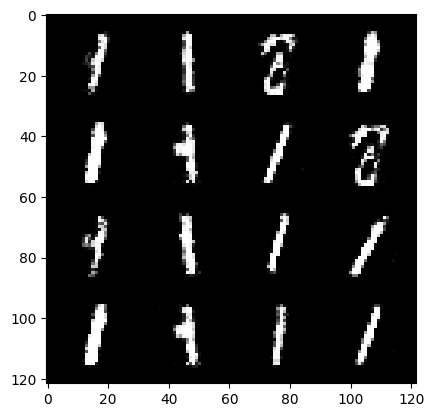

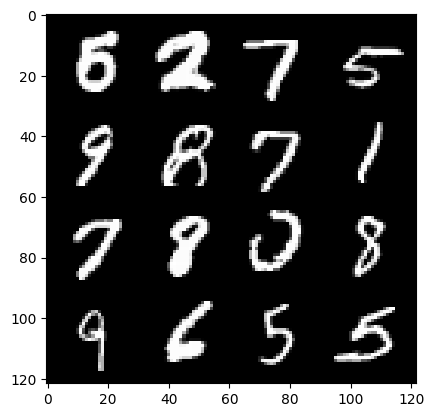

133: Step 62700 / Gen Loss : 2.4065952150026964 / Disc Loss : 0.19274594443539783


  0%|          | 0/469 [00:00<?, ?it/s]

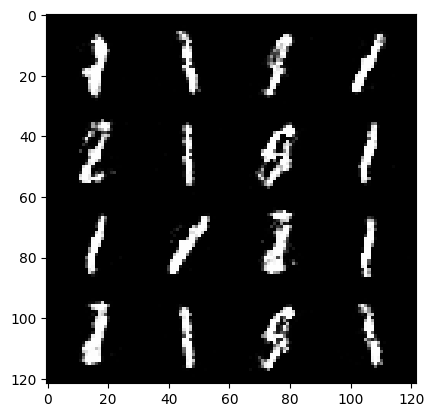

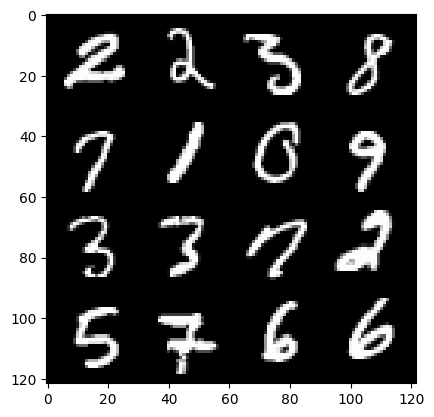

134: Step 63000 / Gen Loss : 2.2960439038276674 / Disc Loss : 0.20764073789119722


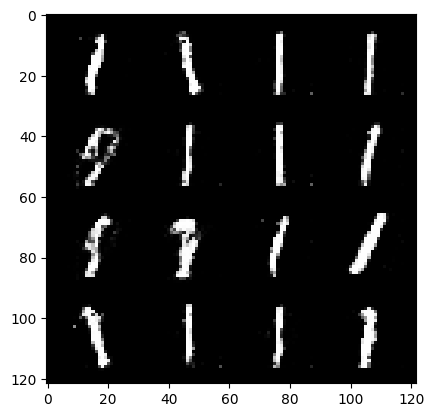

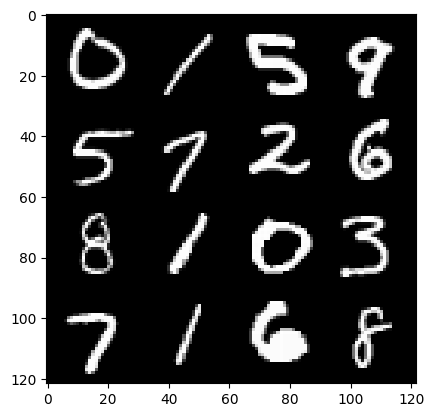

134: Step 63300 / Gen Loss : 2.3260033679008485 / Disc Loss : 0.21426931778589883


  0%|          | 0/469 [00:00<?, ?it/s]

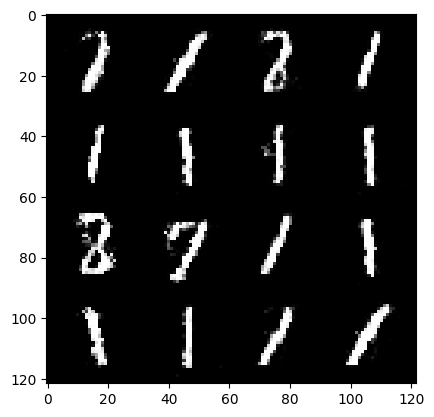

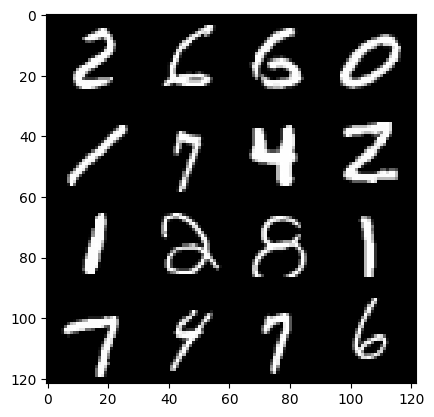

135: Step 63600 / Gen Loss : 2.331318054993946 / Disc Loss : 0.19479159350196512


  0%|          | 0/469 [00:00<?, ?it/s]

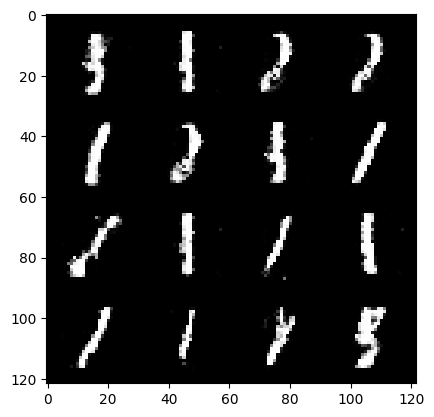

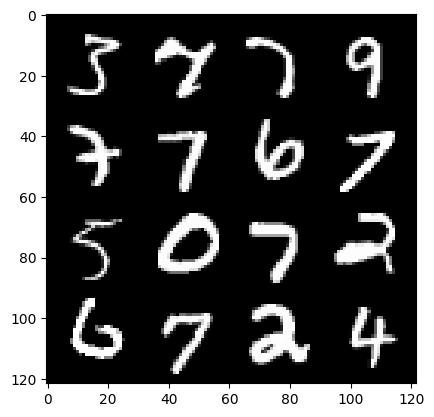

136: Step 63900 / Gen Loss : 2.4394999670982367 / Disc Loss : 0.18828074629108107


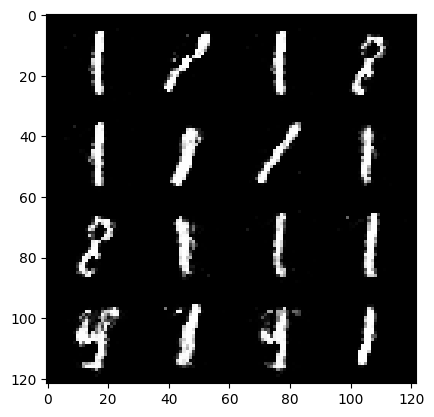

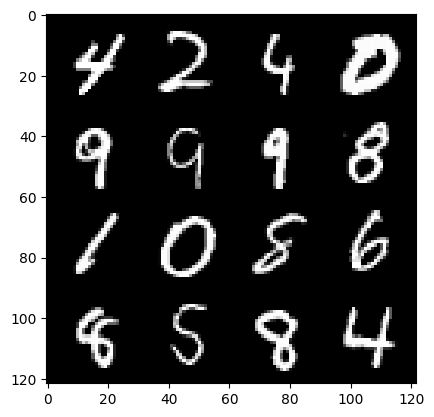

136: Step 64200 / Gen Loss : 2.4505258536338785 / Disc Loss : 0.19666904481748743


  0%|          | 0/469 [00:00<?, ?it/s]

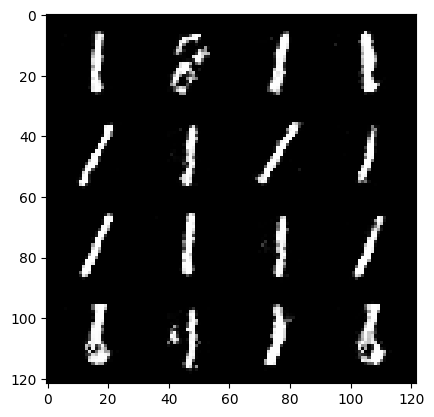

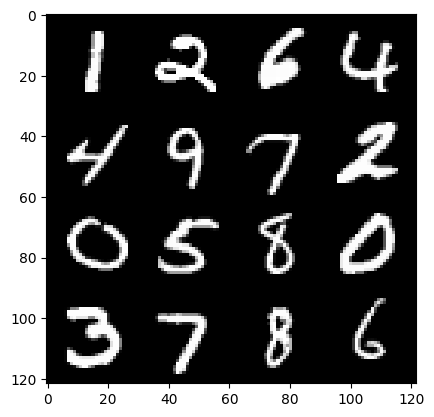

137: Step 64500 / Gen Loss : 2.2666994293530767 / Disc Loss : 0.21994142815470685


  0%|          | 0/469 [00:00<?, ?it/s]

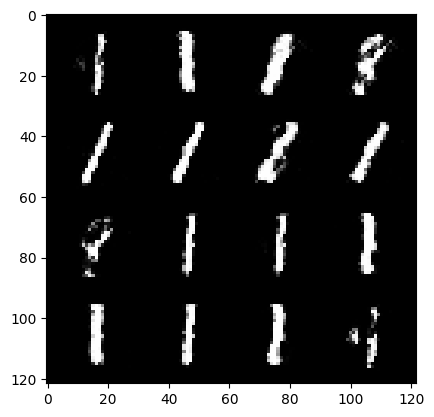

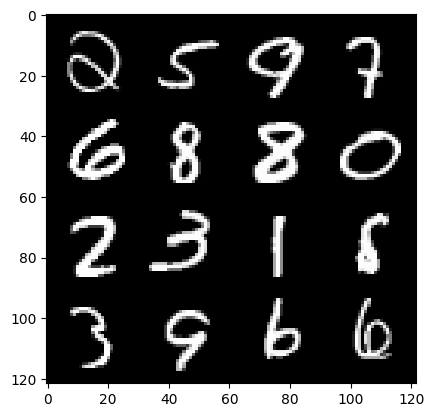

138: Step 64800 / Gen Loss : 2.380374869505564 / Disc Loss : 0.20076750266055257


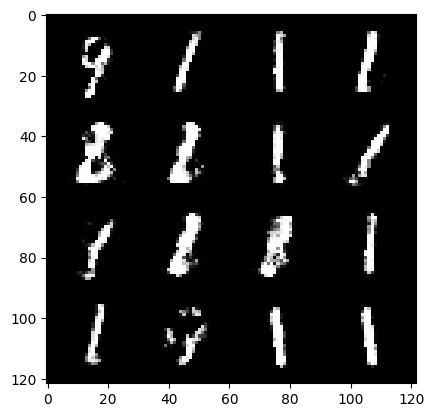

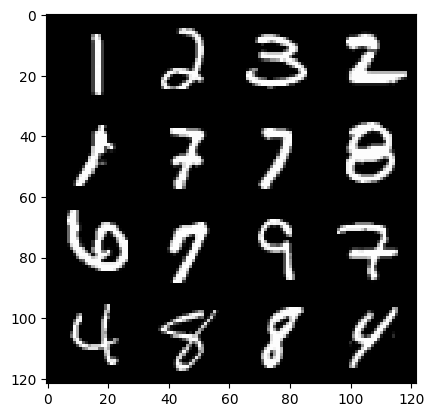

138: Step 65100 / Gen Loss : 2.25883148431778 / Disc Loss : 0.2111671730875968


  0%|          | 0/469 [00:00<?, ?it/s]

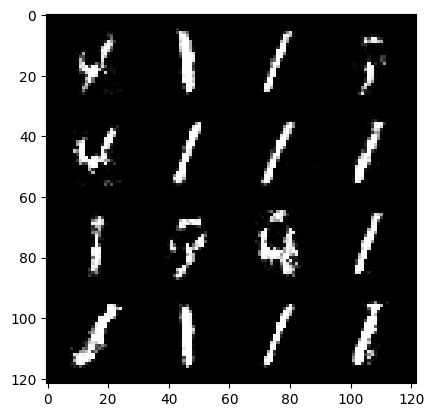

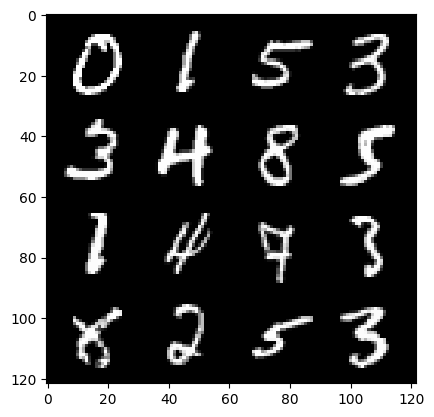

139: Step 65400 / Gen Loss : 2.231388221184413 / Disc Loss : 0.2256356920301915


  0%|          | 0/469 [00:00<?, ?it/s]

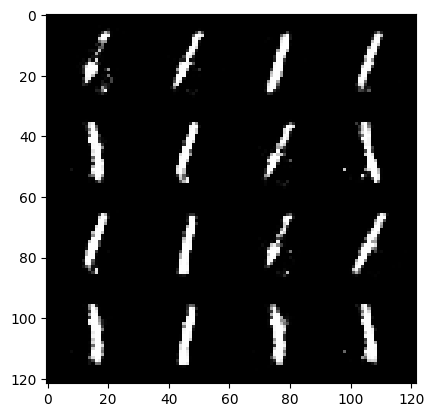

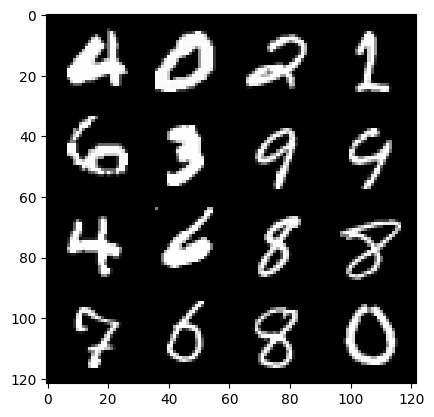

140: Step 65700 / Gen Loss : 2.180456285476685 / Disc Loss : 0.21964183951417618


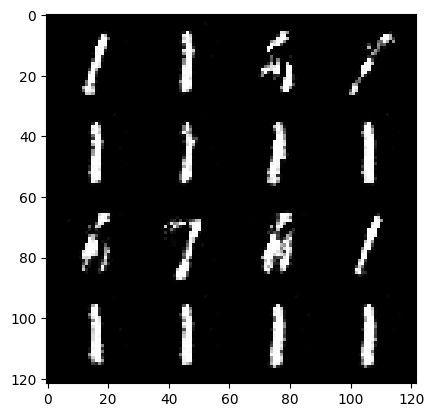

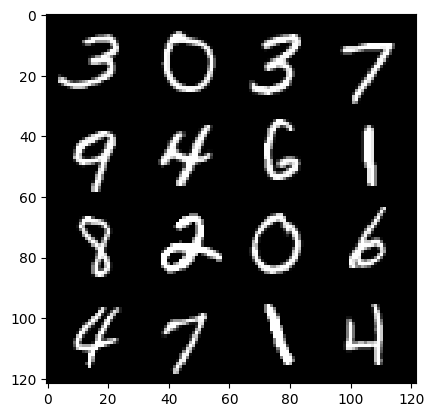

140: Step 66000 / Gen Loss : 2.3260746932029717 / Disc Loss : 0.2062672809263071


  0%|          | 0/469 [00:00<?, ?it/s]

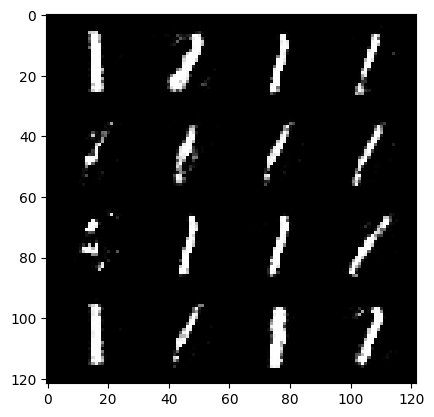

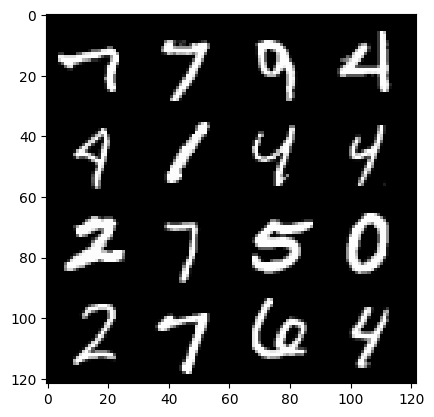

141: Step 66300 / Gen Loss : 2.2978569861253098 / Disc Loss : 0.19780275101463016


  0%|          | 0/469 [00:00<?, ?it/s]

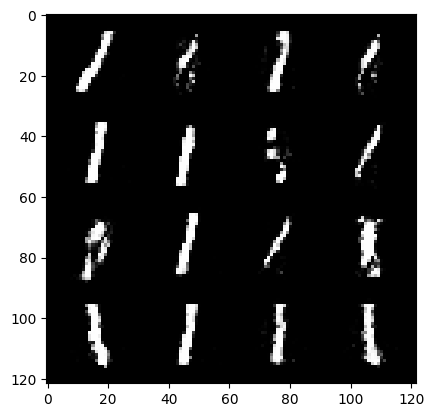

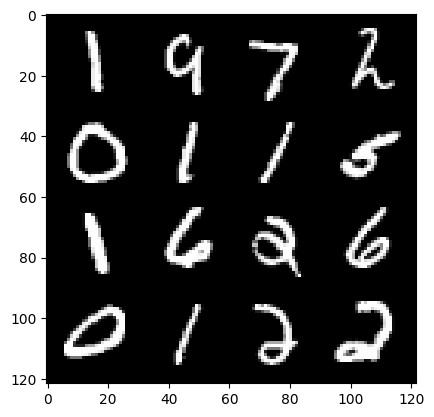

142: Step 66600 / Gen Loss : 2.376445014476778 / Disc Loss : 0.18494240477681154


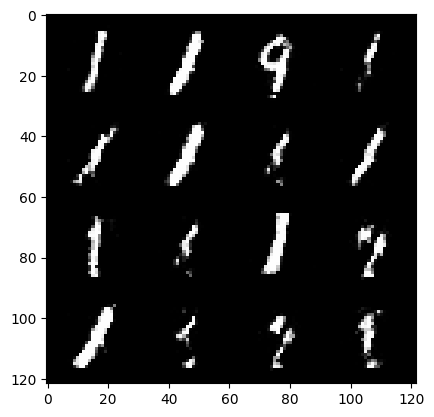

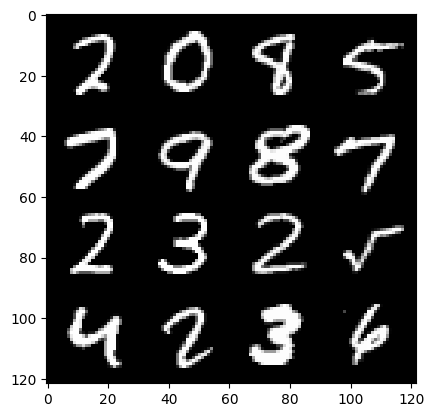

142: Step 66900 / Gen Loss : 2.3378700947761537 / Disc Loss : 0.20767218239605428


  0%|          | 0/469 [00:00<?, ?it/s]

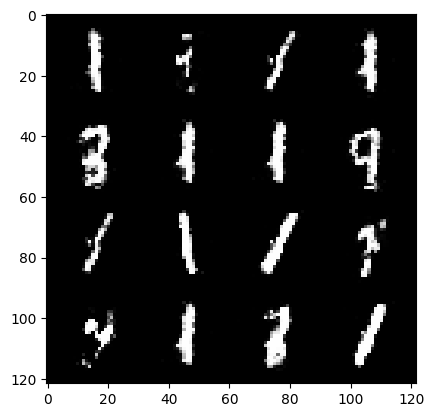

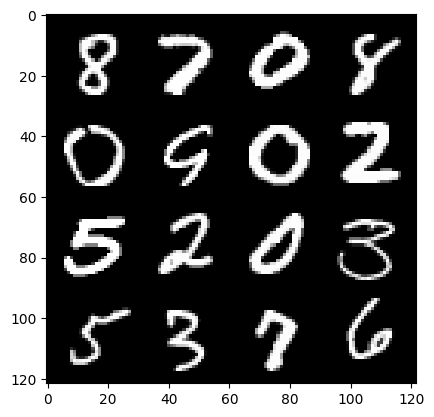

143: Step 67200 / Gen Loss : 2.3454441436131797 / Disc Loss : 0.19749413828055062


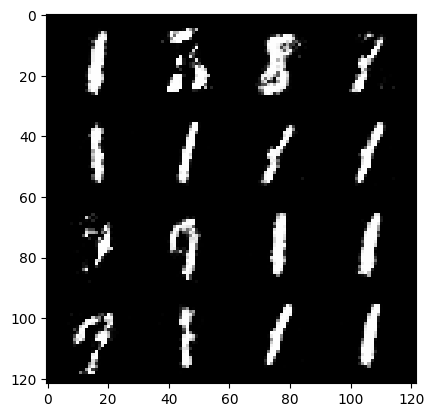

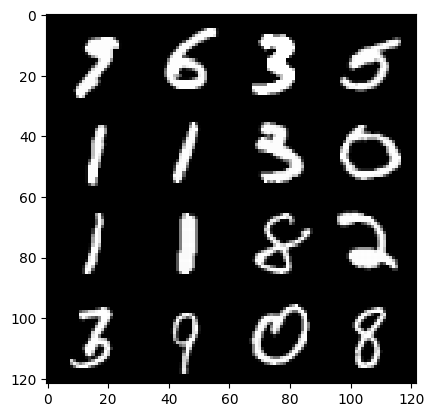

143: Step 67500 / Gen Loss : 2.250943678617479 / Disc Loss : 0.21787640184164056


  0%|          | 0/469 [00:00<?, ?it/s]

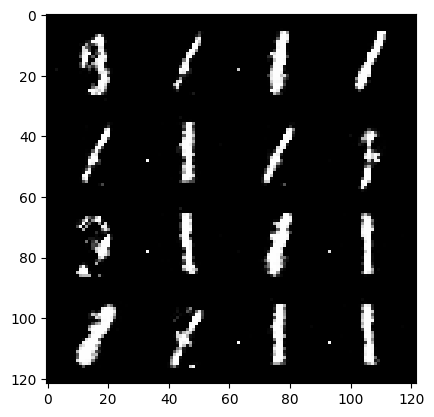

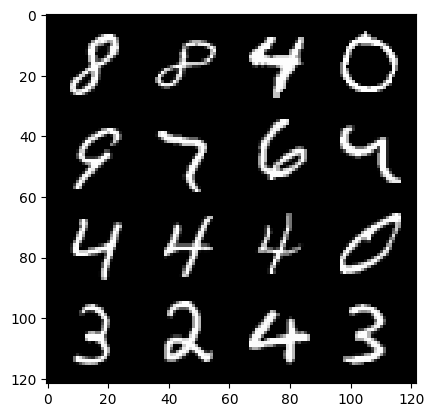

144: Step 67800 / Gen Loss : 2.2949495017528507 / Disc Loss : 0.20813191970189407


  0%|          | 0/469 [00:00<?, ?it/s]

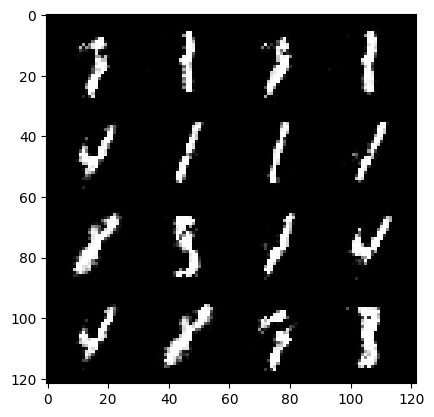

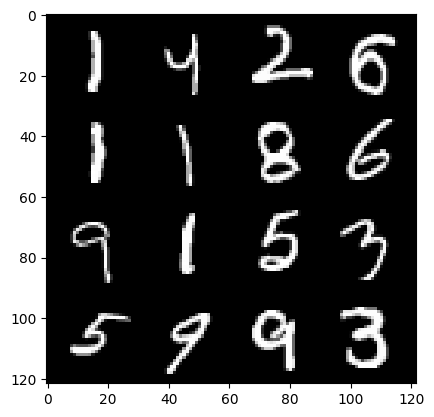

145: Step 68100 / Gen Loss : 2.3872876914342243 / Disc Loss : 0.18244715919097268


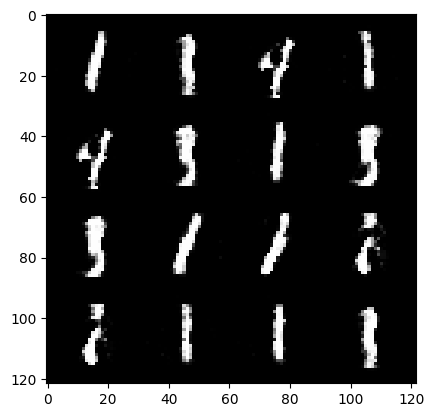

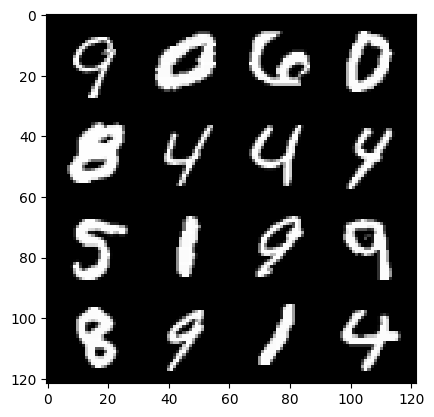

145: Step 68400 / Gen Loss : 2.532976780732474 / Disc Loss : 0.18079132288694372


  0%|          | 0/469 [00:00<?, ?it/s]

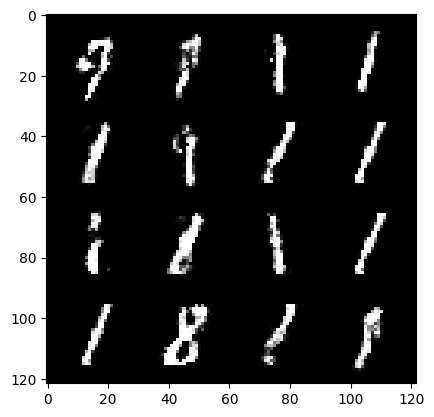

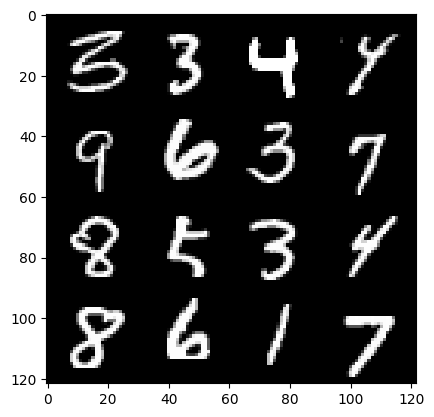

146: Step 68700 / Gen Loss : 2.308851738373439 / Disc Loss : 0.2065976108858983


  0%|          | 0/469 [00:00<?, ?it/s]

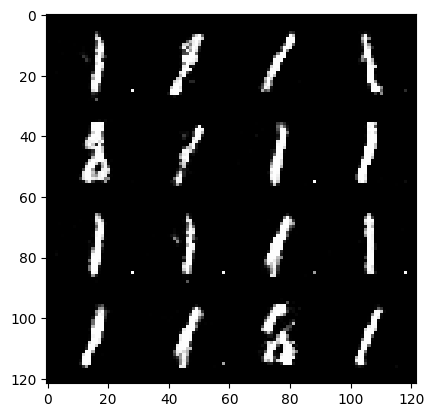

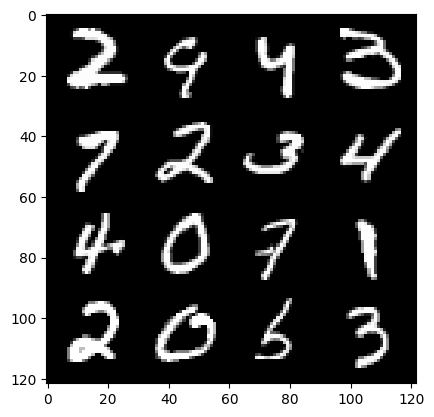

147: Step 69000 / Gen Loss : 2.232470213969548 / Disc Loss : 0.22747517064213768


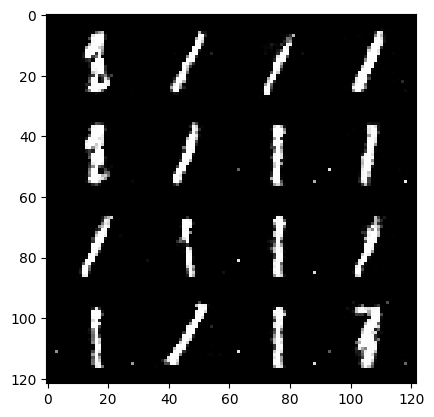

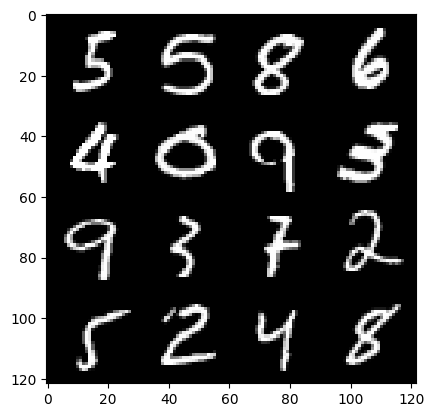

147: Step 69300 / Gen Loss : 2.325251112381617 / Disc Loss : 0.2117173997064433


  0%|          | 0/469 [00:00<?, ?it/s]

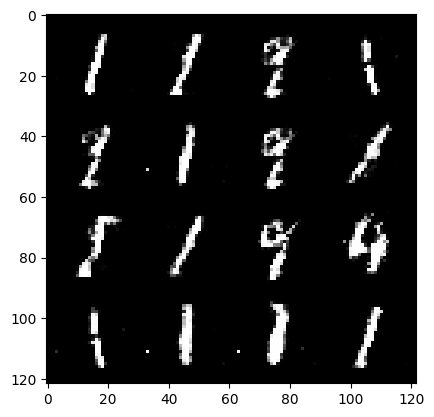

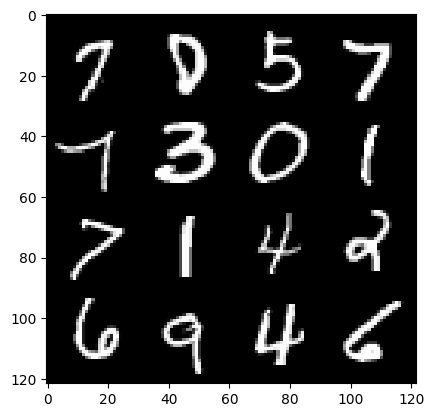

148: Step 69600 / Gen Loss : 2.2938934564590463 / Disc Loss : 0.22099275290966053


  0%|          | 0/469 [00:00<?, ?it/s]

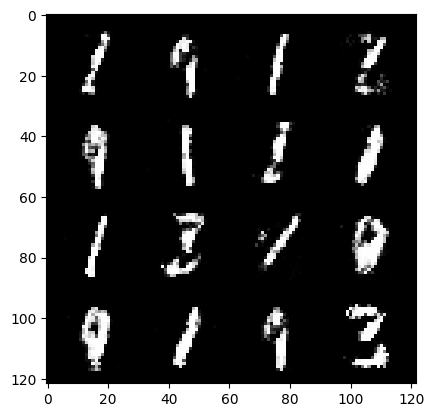

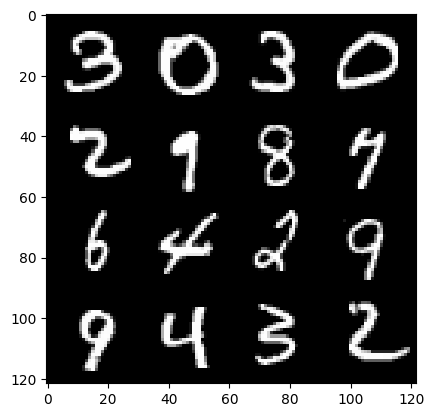

149: Step 69900 / Gen Loss : 2.279792917966843 / Disc Loss : 0.21487655267119413


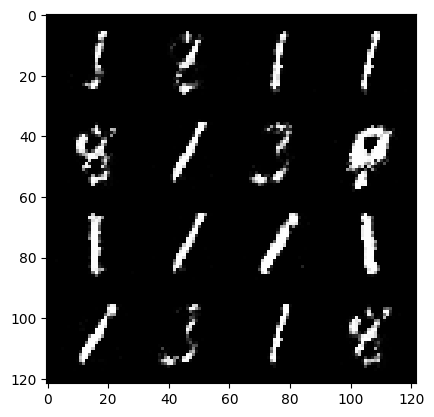

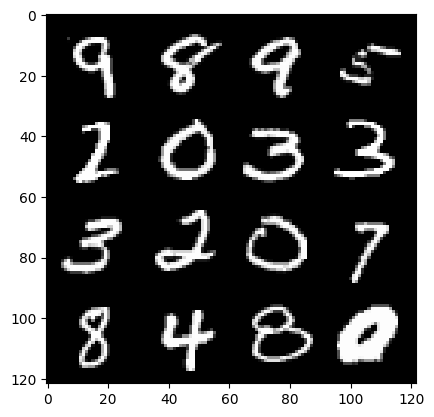

149: Step 70200 / Gen Loss : 2.205488921403884 / Disc Loss : 0.23105513398845984


  0%|          | 0/469 [00:00<?, ?it/s]

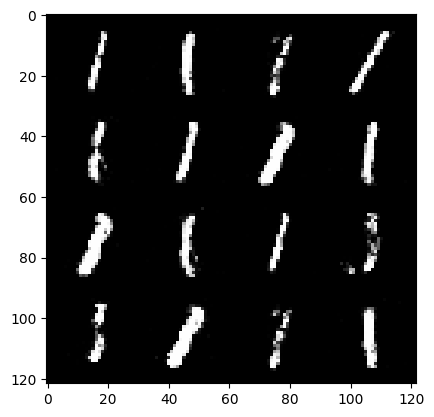

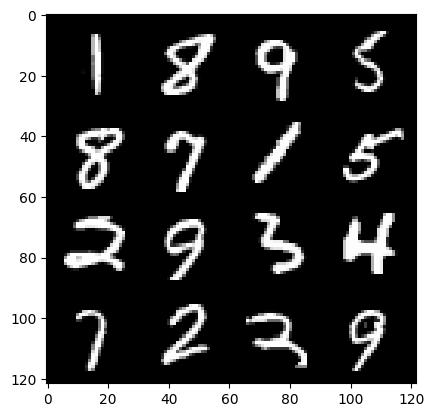

150: Step 70500 / Gen Loss : 2.2025793524583177 / Disc Loss : 0.22331748098134988


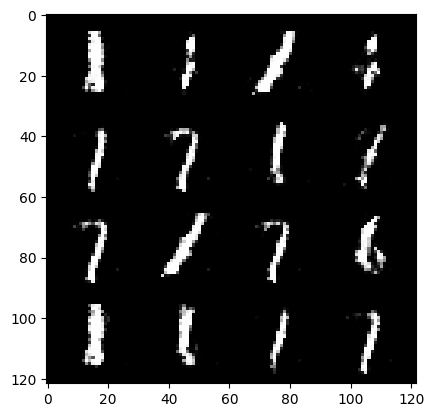

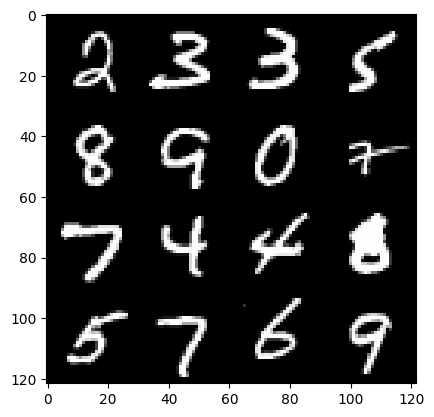

150: Step 70800 / Gen Loss : 2.174761573870977 / Disc Loss : 0.22903990477323524


  0%|          | 0/469 [00:00<?, ?it/s]

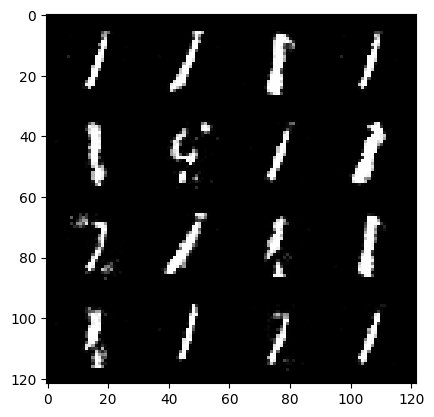

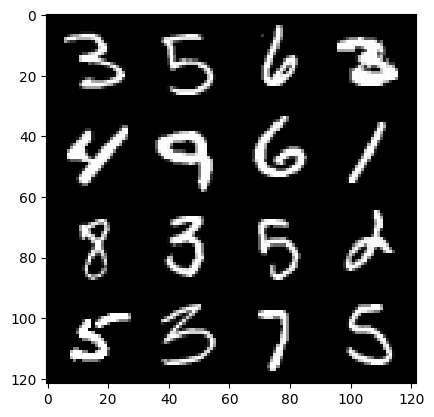

151: Step 71100 / Gen Loss : 2.2237050247192385 / Disc Loss : 0.21266351183255527


  0%|          | 0/469 [00:00<?, ?it/s]

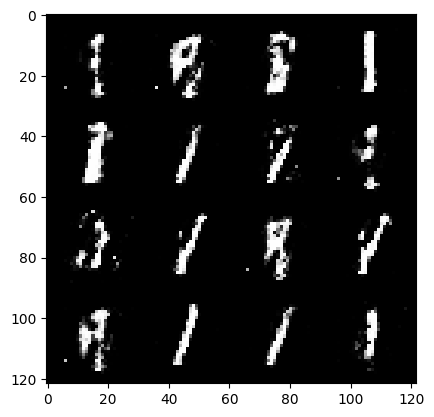

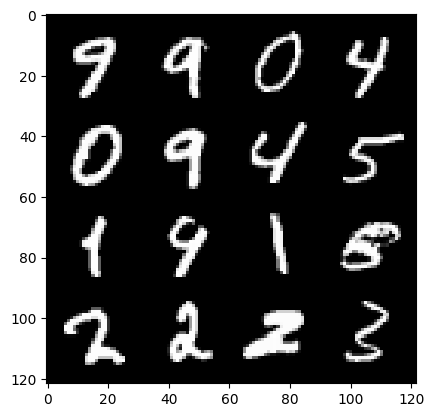

152: Step 71400 / Gen Loss : 2.1885252682367957 / Disc Loss : 0.21442824239532163


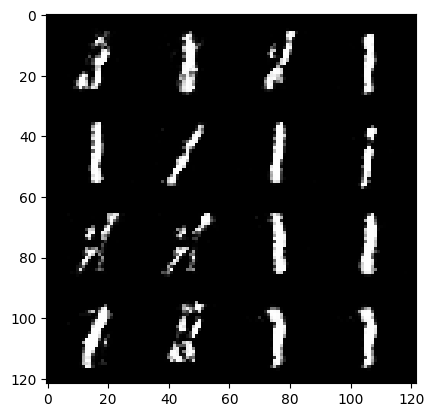

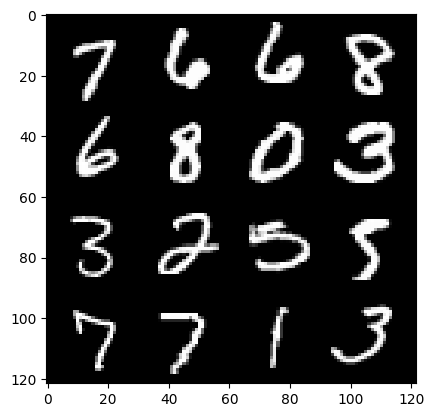

152: Step 71700 / Gen Loss : 2.2957893204689017 / Disc Loss : 0.20936953137318307


  0%|          | 0/469 [00:00<?, ?it/s]

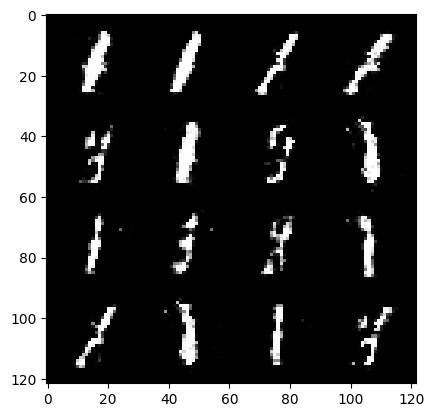

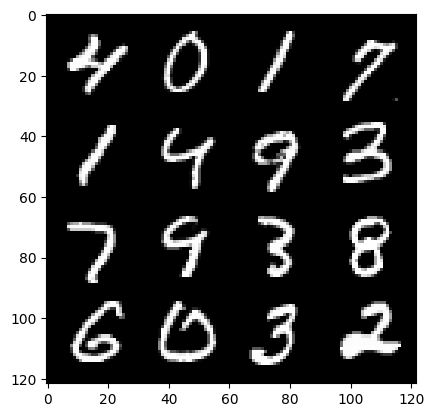

153: Step 72000 / Gen Loss : 2.2398743140697484 / Disc Loss : 0.21885598291953393


  0%|          | 0/469 [00:00<?, ?it/s]

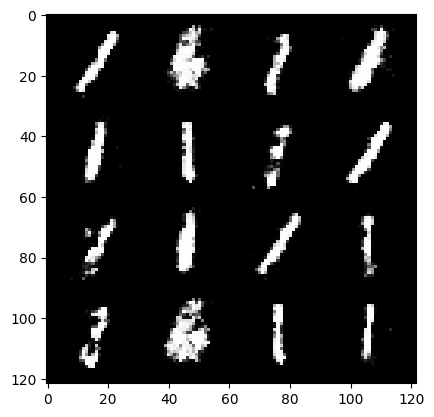

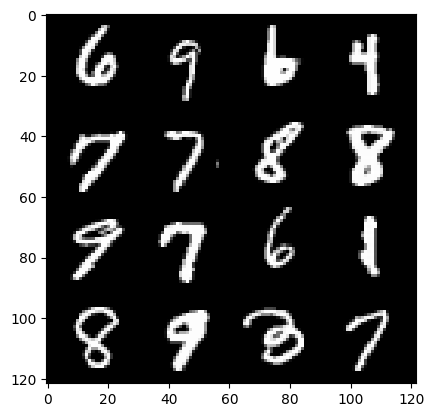

154: Step 72300 / Gen Loss : 2.265575350920361 / Disc Loss : 0.2131843231866757


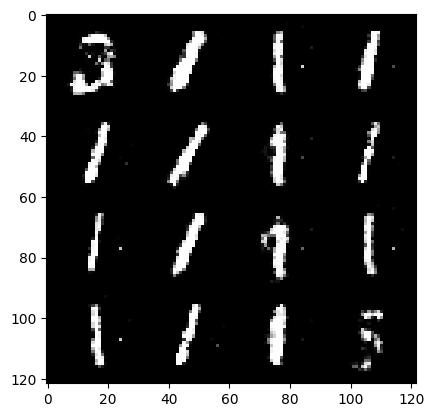

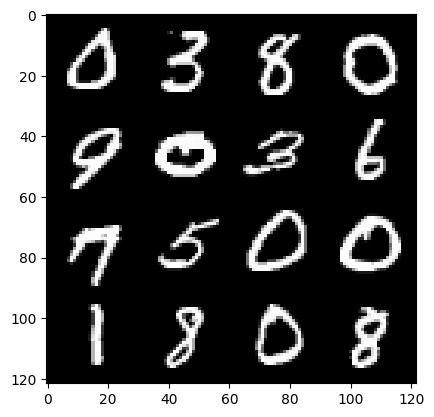

154: Step 72600 / Gen Loss : 2.1505860694249472 / Disc Loss : 0.23717258344093958


  0%|          | 0/469 [00:00<?, ?it/s]

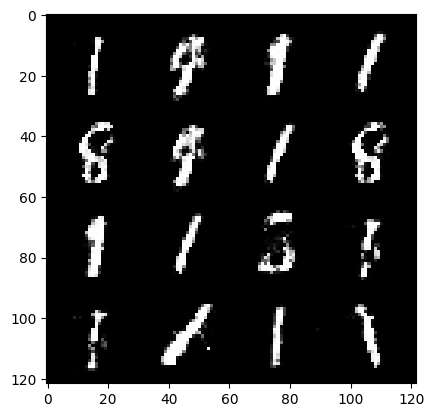

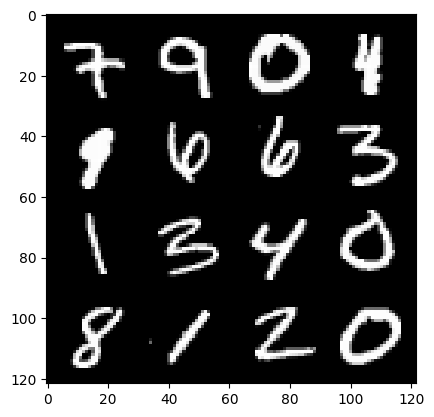

155: Step 72900 / Gen Loss : 2.1504924885431924 / Disc Loss : 0.23114539961020156


  0%|          | 0/469 [00:00<?, ?it/s]

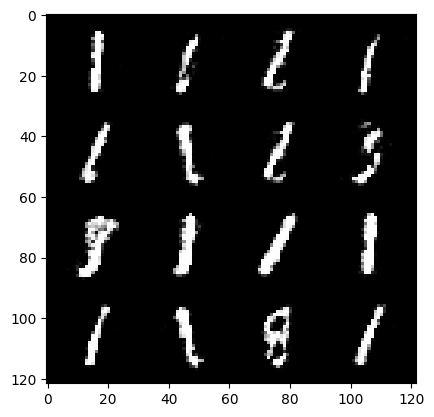

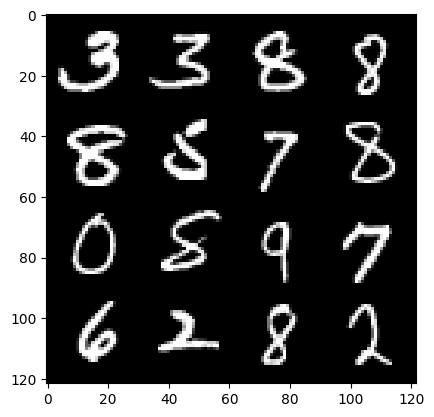

156: Step 73200 / Gen Loss : 2.236594973802568 / Disc Loss : 0.21366376380125685


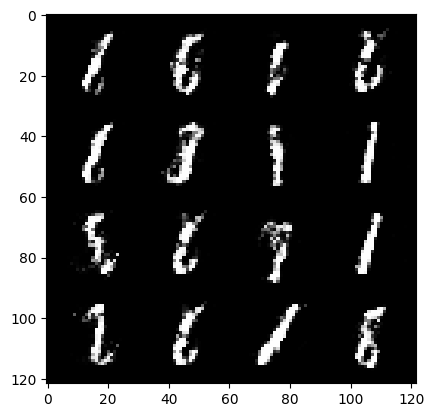

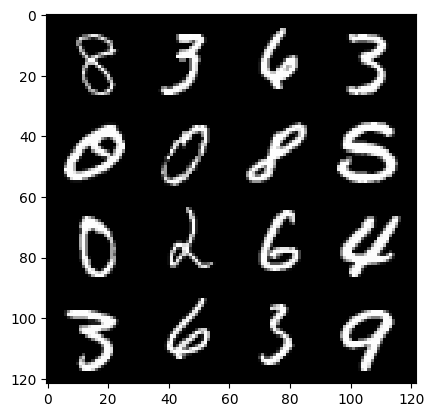

156: Step 73500 / Gen Loss : 2.129210316340128 / Disc Loss : 0.24375394046306625


  0%|          | 0/469 [00:00<?, ?it/s]

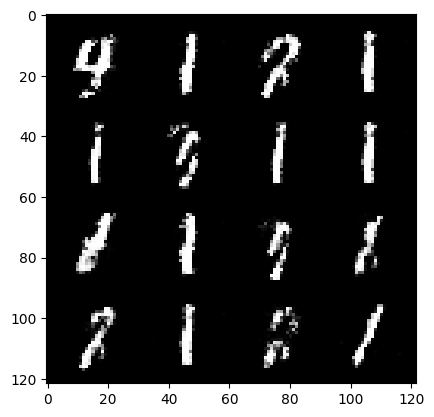

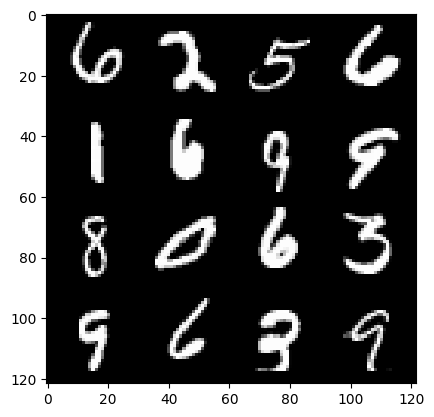

157: Step 73800 / Gen Loss : 2.233788820107778 / Disc Loss : 0.22018835097551354


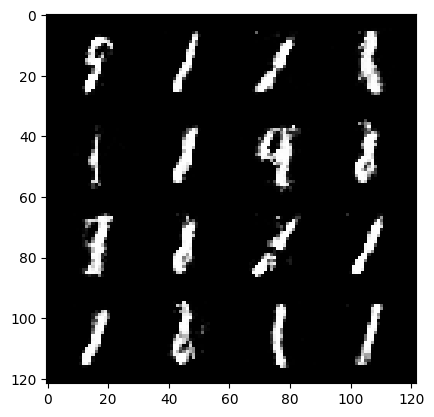

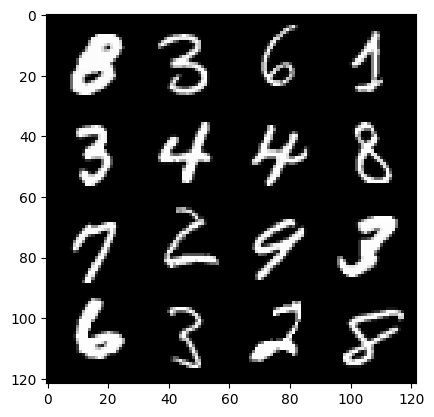

157: Step 74100 / Gen Loss : 2.1980431290467575 / Disc Loss : 0.23028588260213523


  0%|          | 0/469 [00:00<?, ?it/s]

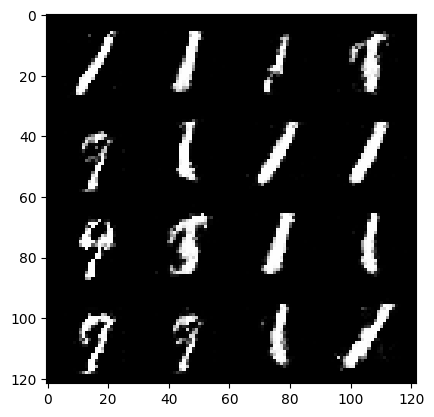

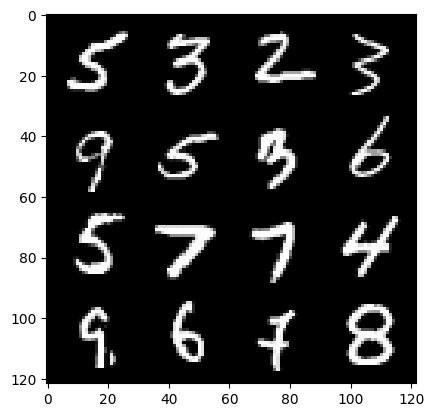

158: Step 74400 / Gen Loss : 2.205886101722717 / Disc Loss : 0.21889070848623896


  0%|          | 0/469 [00:00<?, ?it/s]

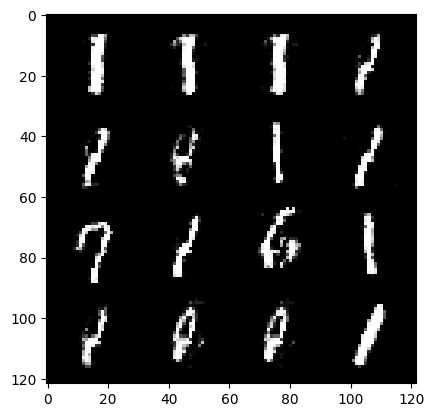

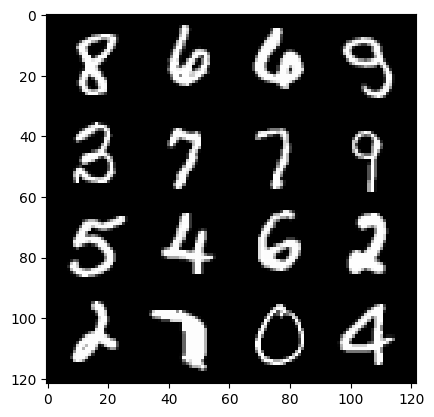

159: Step 74700 / Gen Loss : 2.2501116601626077 / Disc Loss : 0.21143358116348568


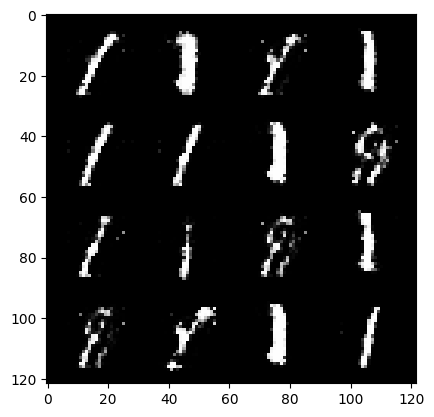

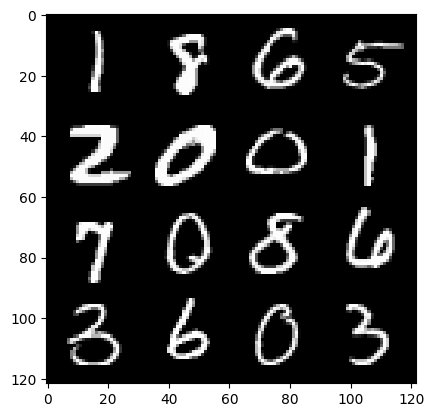

159: Step 75000 / Gen Loss : 2.1852292676766707 / Disc Loss : 0.22855579977234206


  0%|          | 0/469 [00:00<?, ?it/s]

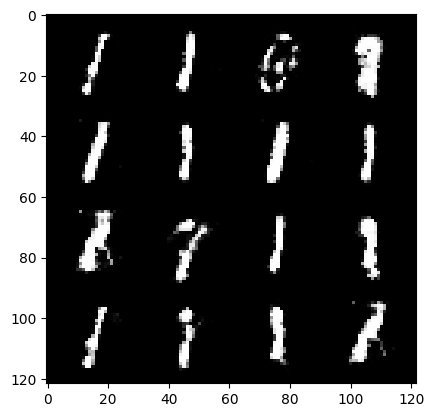

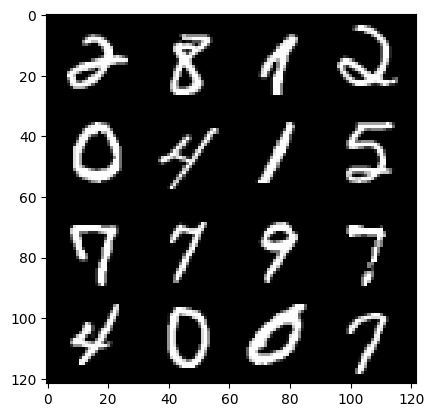

160: Step 75300 / Gen Loss : 2.1203999288876845 / Disc Loss : 0.2318120016157627


  0%|          | 0/469 [00:00<?, ?it/s]

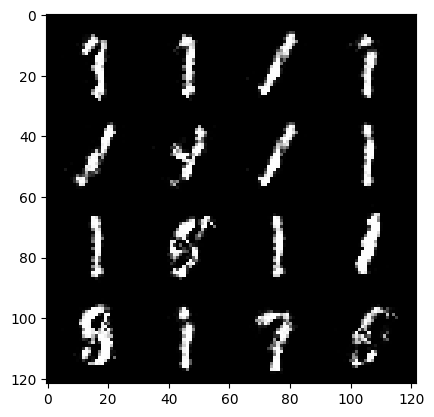

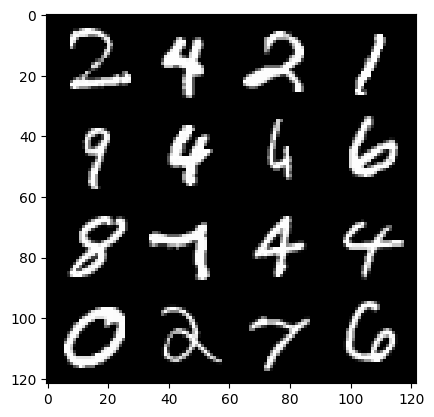

161: Step 75600 / Gen Loss : 2.1438212891419735 / Disc Loss : 0.23621972809235253


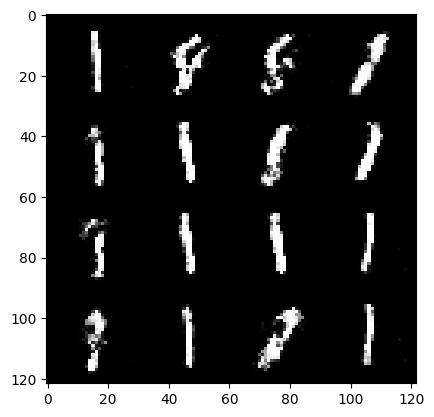

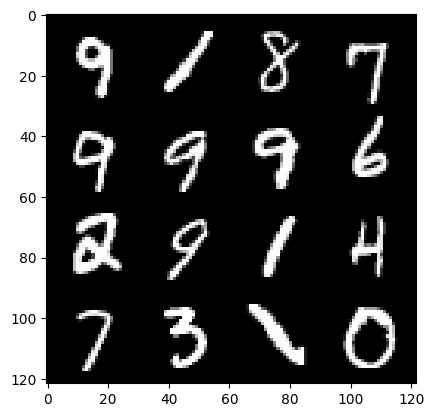

161: Step 75900 / Gen Loss : 2.151891372203827 / Disc Loss : 0.23049688175320626


  0%|          | 0/469 [00:00<?, ?it/s]

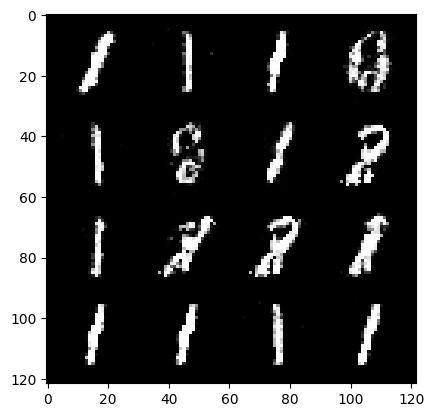

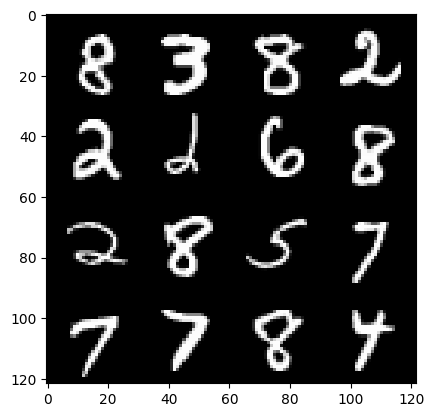

162: Step 76200 / Gen Loss : 2.2199549444516506 / Disc Loss : 0.22450049467384828


  0%|          | 0/469 [00:00<?, ?it/s]

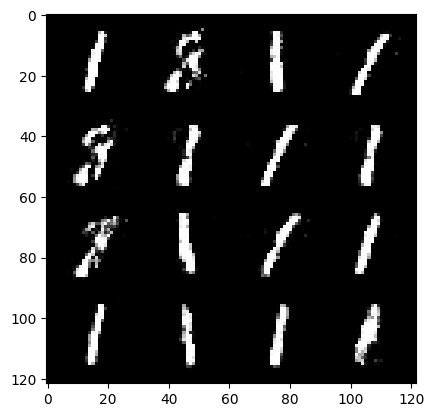

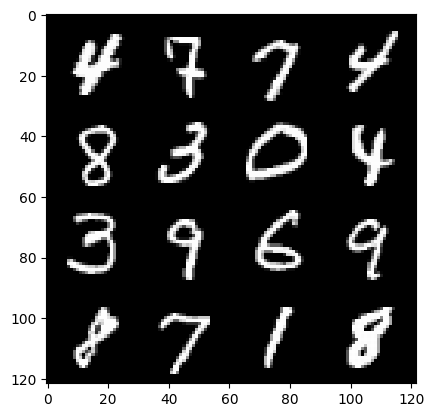

163: Step 76500 / Gen Loss : 2.271486526727675 / Disc Loss : 0.221217715938886


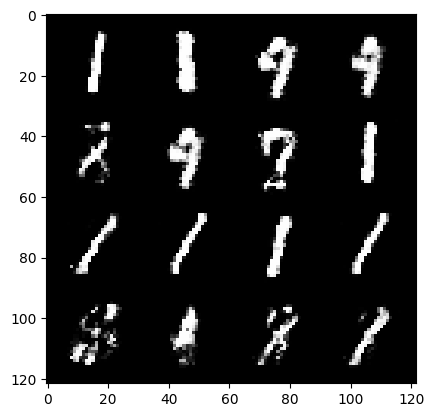

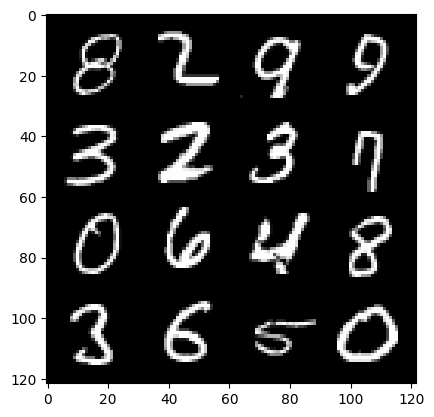

163: Step 76800 / Gen Loss : 2.1547076789538058 / Disc Loss : 0.2384620393315951


  0%|          | 0/469 [00:00<?, ?it/s]

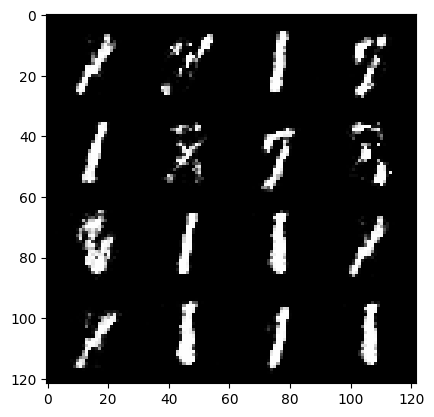

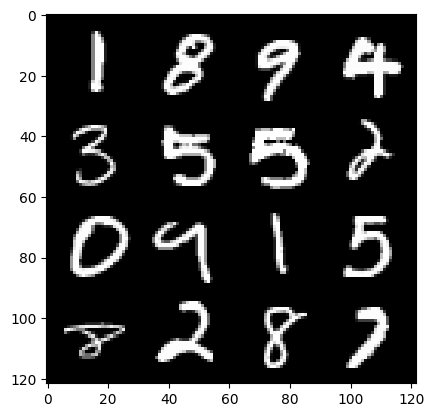

164: Step 77100 / Gen Loss : 2.157749558687211 / Disc Loss : 0.24280074929197637


  0%|          | 0/469 [00:00<?, ?it/s]

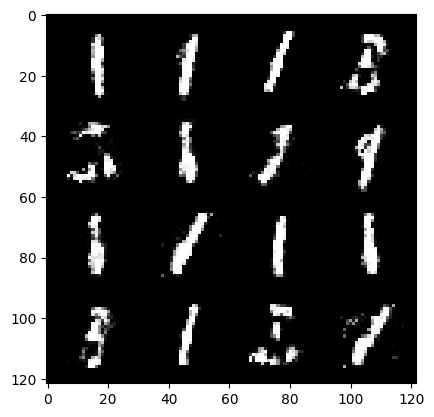

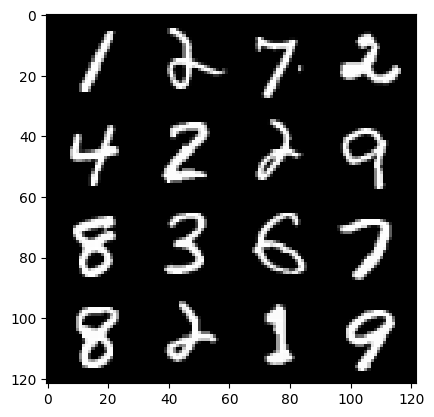

165: Step 77400 / Gen Loss : 2.166578137874605 / Disc Loss : 0.24328606670101485


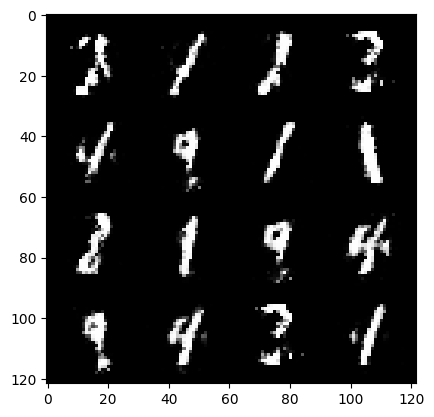

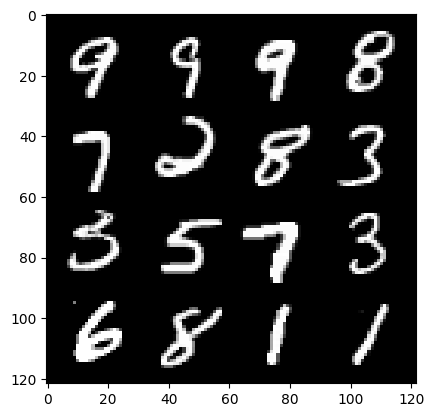

165: Step 77700 / Gen Loss : 2.201797851721445 / Disc Loss : 0.23370966389775272


  0%|          | 0/469 [00:00<?, ?it/s]

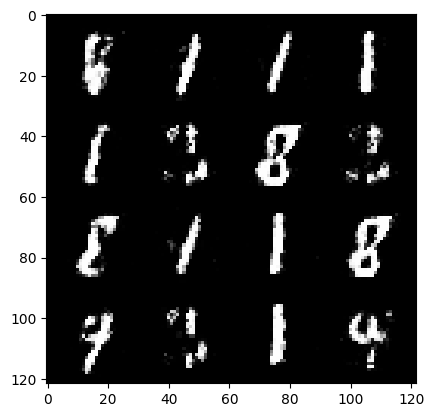

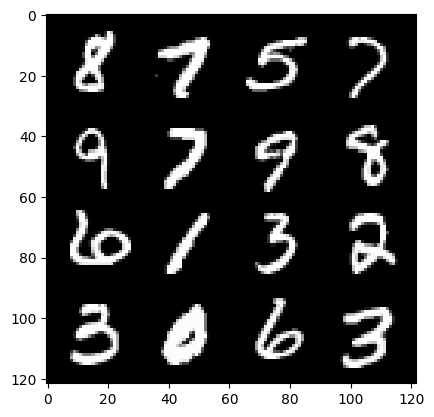

166: Step 78000 / Gen Loss : 2.2033783841133117 / Disc Loss : 0.2326508220036824


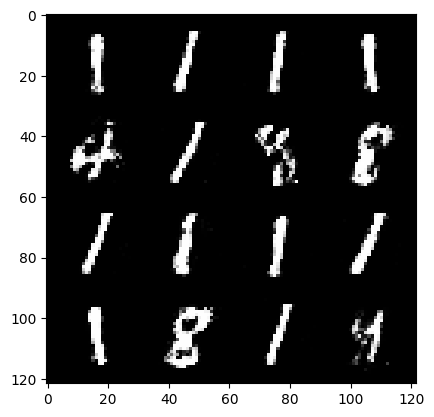

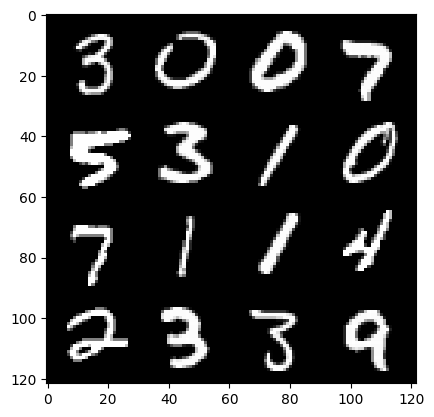

166: Step 78300 / Gen Loss : 2.2585667689641333 / Disc Loss : 0.22598707536856336


  0%|          | 0/469 [00:00<?, ?it/s]

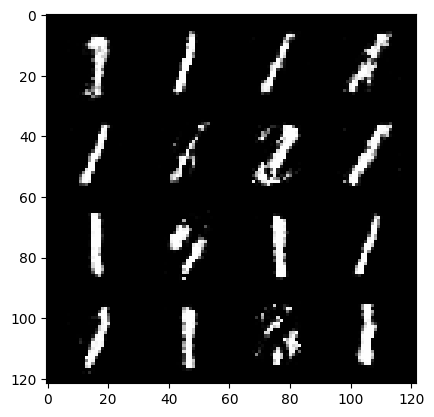

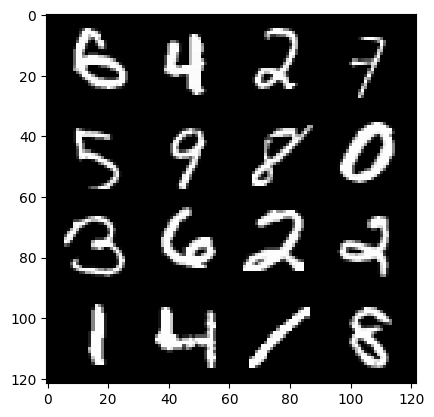

167: Step 78600 / Gen Loss : 2.226472730239231 / Disc Loss : 0.22784747615456594


  0%|          | 0/469 [00:00<?, ?it/s]

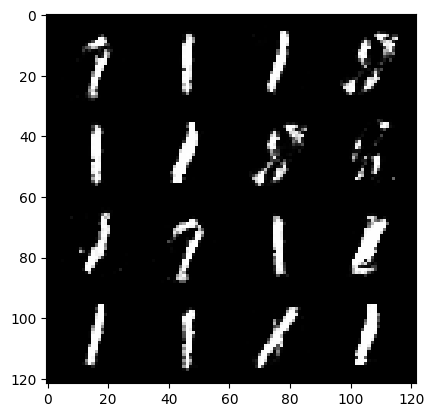

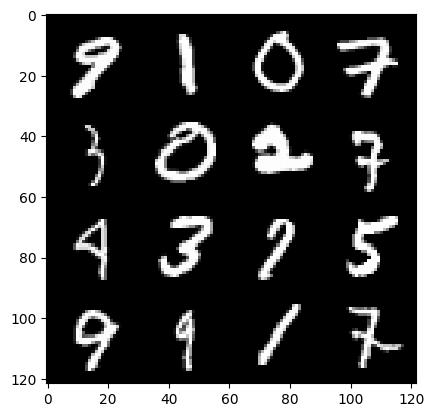

168: Step 78900 / Gen Loss : 2.1061555250485737 / Disc Loss : 0.23725029150644944


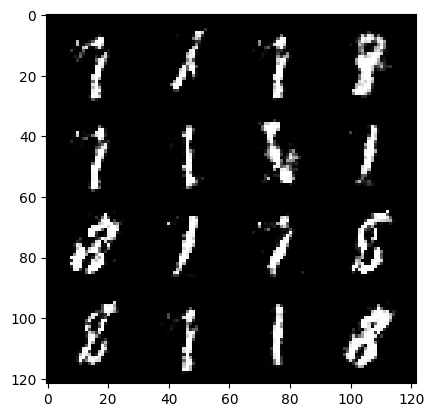

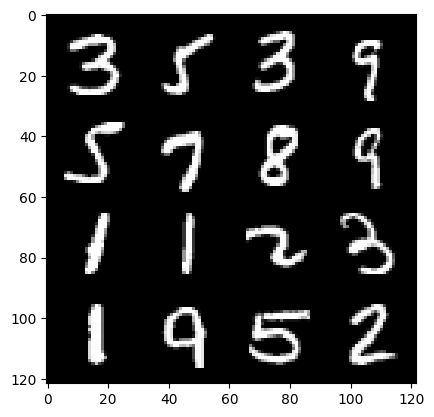

168: Step 79200 / Gen Loss : 2.141120610237122 / Disc Loss : 0.22395069912076007


  0%|          | 0/469 [00:00<?, ?it/s]

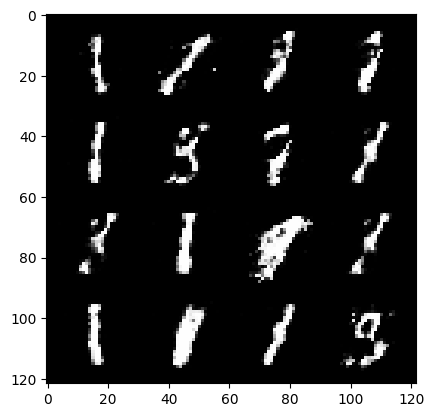

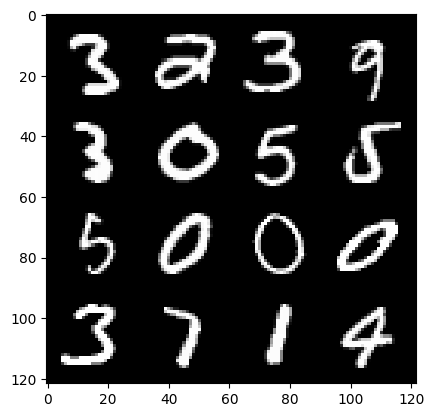

169: Step 79500 / Gen Loss : 2.3264463233947765 / Disc Loss : 0.21106027133762825


  0%|          | 0/469 [00:00<?, ?it/s]

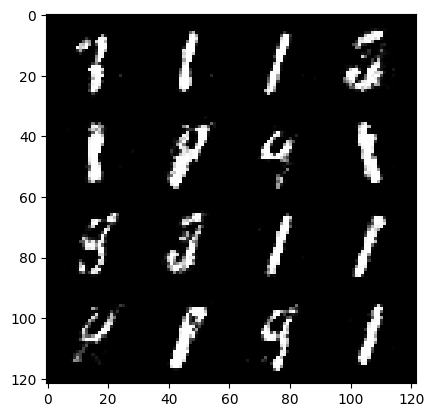

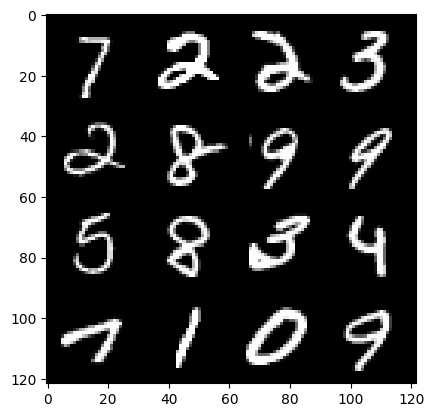

170: Step 79800 / Gen Loss : 2.1818563306331633 / Disc Loss : 0.23089720790584875


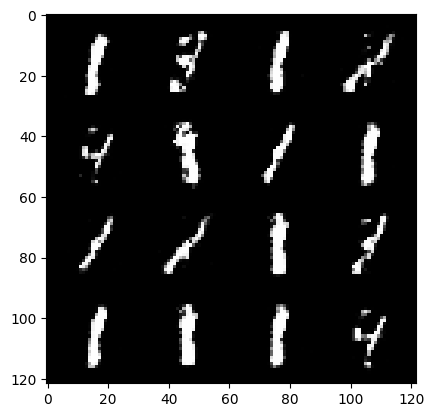

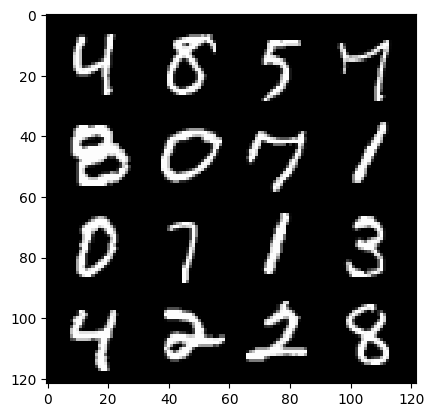

170: Step 80100 / Gen Loss : 2.161897689501444 / Disc Loss : 0.22962220152219157


  0%|          | 0/469 [00:00<?, ?it/s]

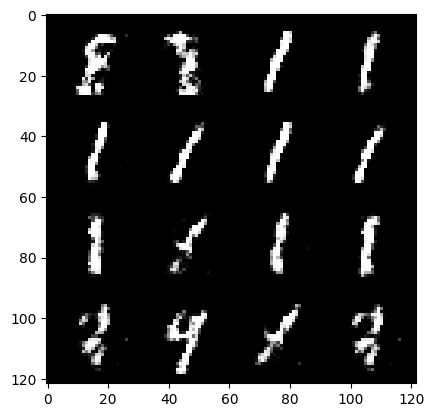

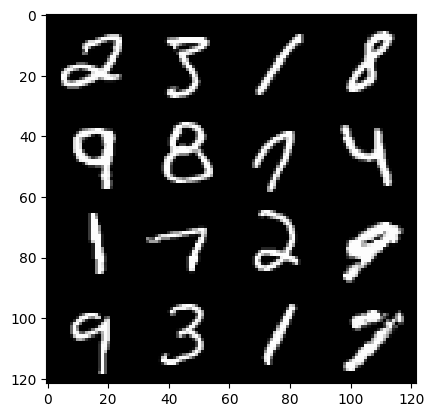

171: Step 80400 / Gen Loss : 2.301418341795604 / Disc Loss : 0.2122659787784021


  0%|          | 0/469 [00:00<?, ?it/s]

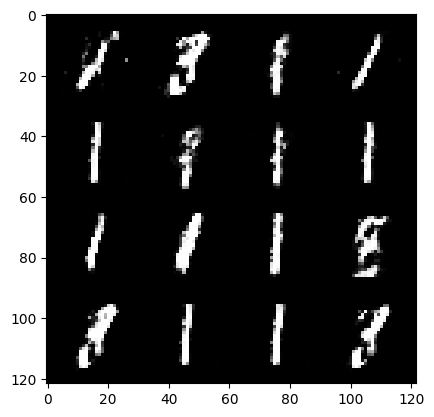

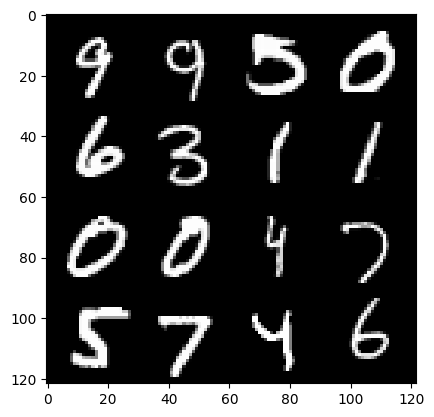

172: Step 80700 / Gen Loss : 2.214575430949528 / Disc Loss : 0.22431204244494427


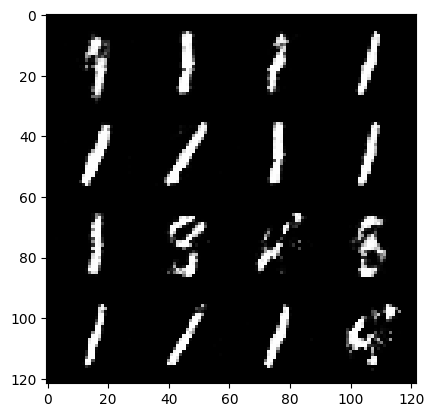

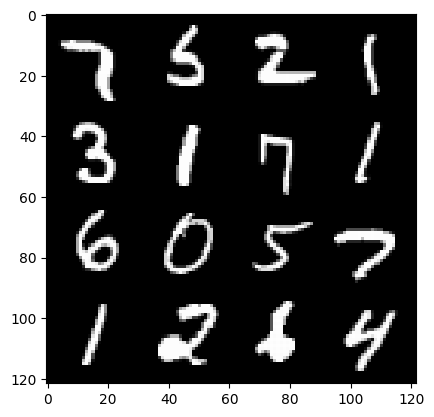

172: Step 81000 / Gen Loss : 2.166454405387243 / Disc Loss : 0.23689541965723032


  0%|          | 0/469 [00:00<?, ?it/s]

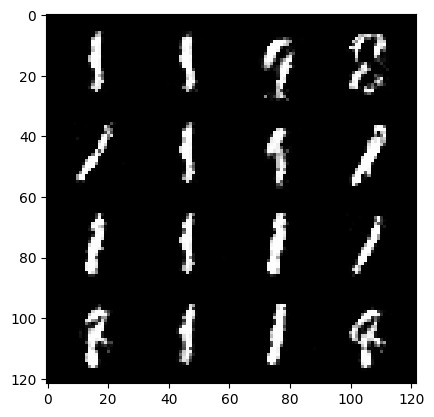

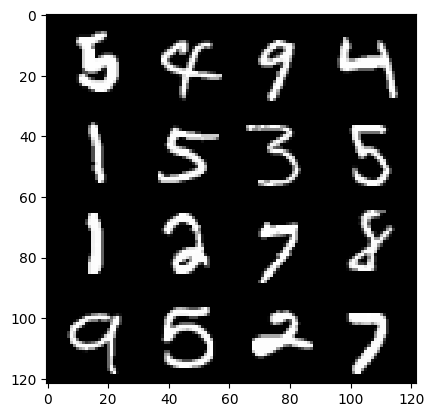

173: Step 81300 / Gen Loss : 2.06682703057925 / Disc Loss : 0.2431280999879042


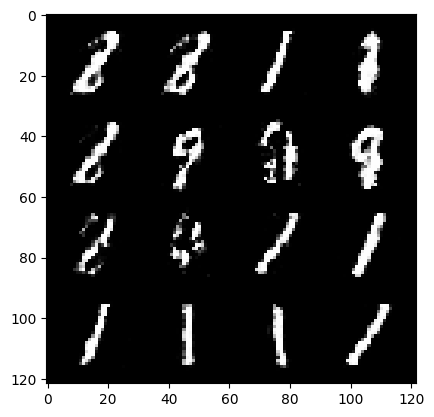

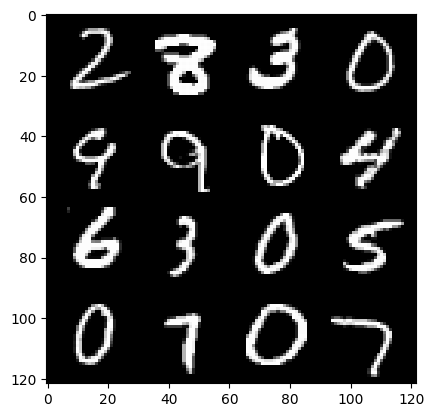

173: Step 81600 / Gen Loss : 2.2304281663894643 / Disc Loss : 0.22322491064667696


  0%|          | 0/469 [00:00<?, ?it/s]

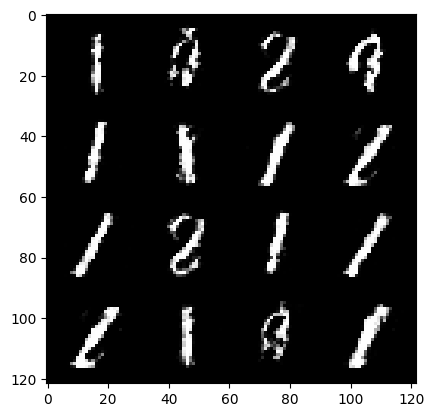

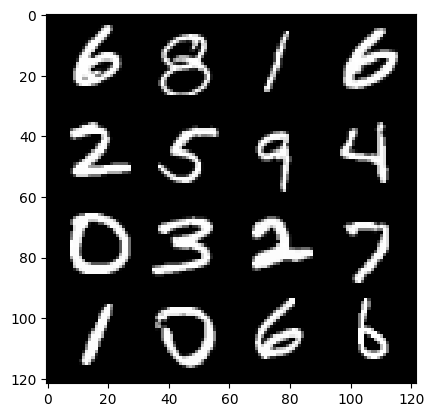

174: Step 81900 / Gen Loss : 2.1358008682727814 / Disc Loss : 0.23599050233761484


  0%|          | 0/469 [00:00<?, ?it/s]

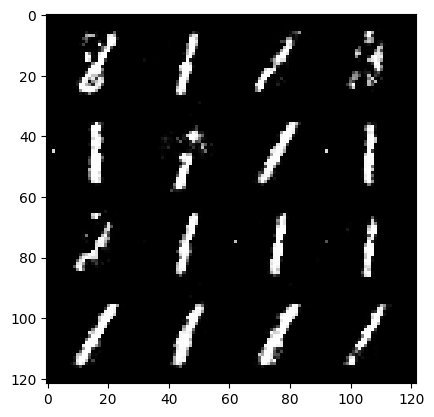

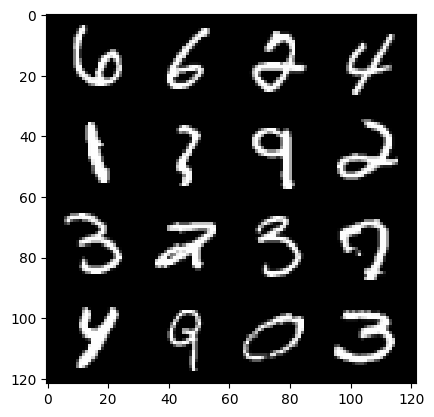

175: Step 82200 / Gen Loss : 2.050370055834453 / Disc Loss : 0.2499802511433758


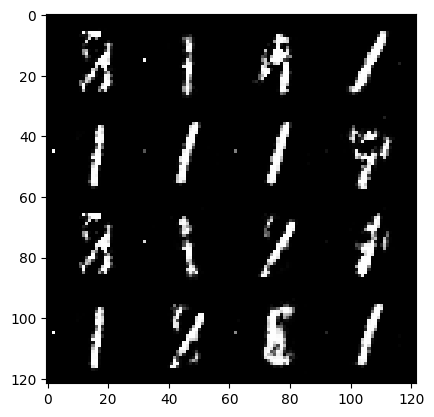

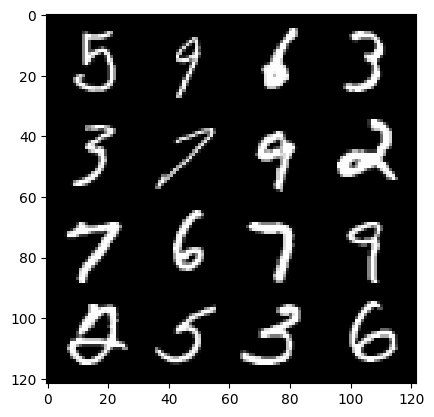

175: Step 82500 / Gen Loss : 2.0535469460487357 / Disc Loss : 0.25245586663484576


  0%|          | 0/469 [00:00<?, ?it/s]

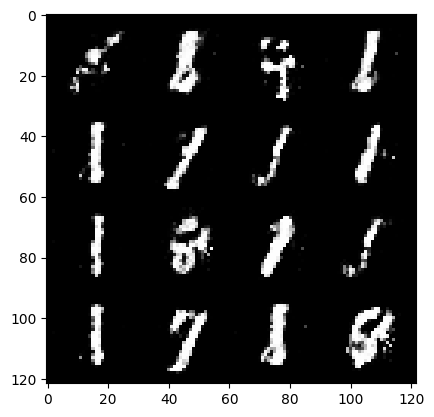

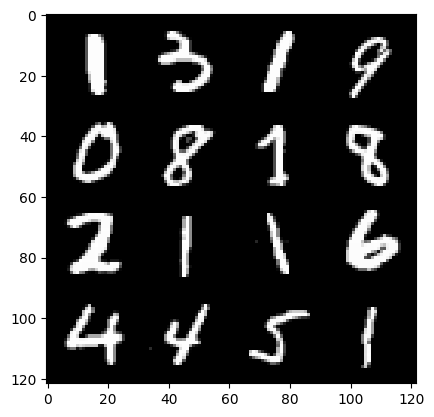

176: Step 82800 / Gen Loss : 2.207287117640177 / Disc Loss : 0.22569420496622716


  0%|          | 0/469 [00:00<?, ?it/s]

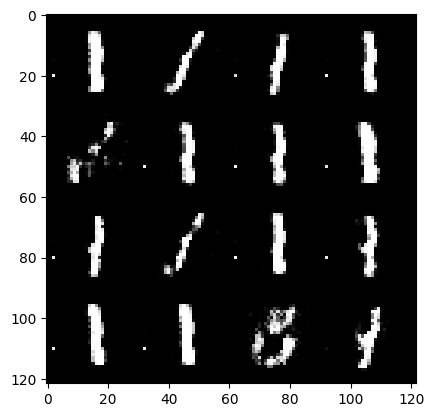

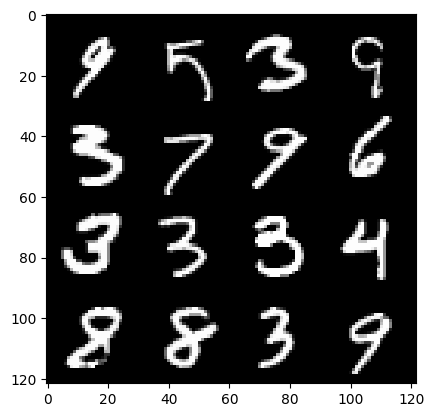

177: Step 83100 / Gen Loss : 2.16807587504387 / Disc Loss : 0.25158477986852346


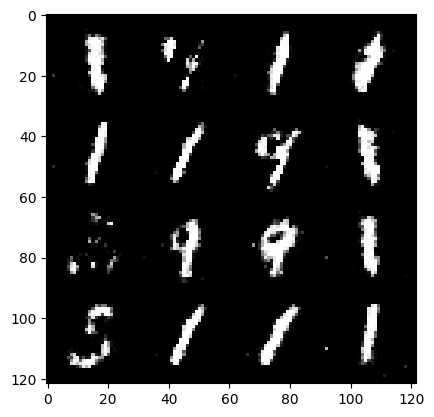

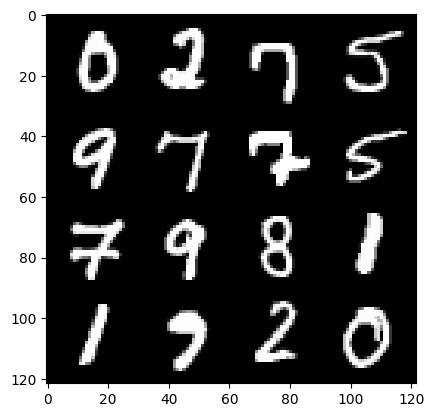

177: Step 83400 / Gen Loss : 1.9917242360115064 / Disc Loss : 0.25636907438437145


  0%|          | 0/469 [00:00<?, ?it/s]

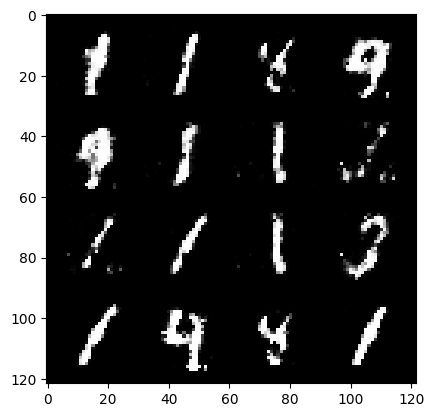

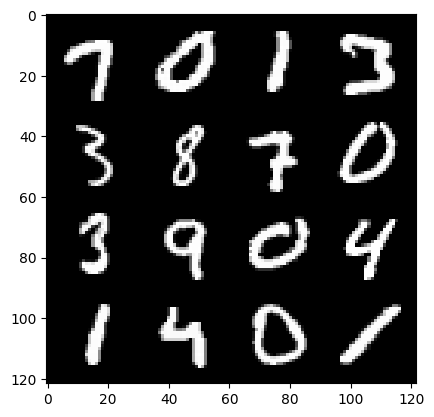

178: Step 83700 / Gen Loss : 2.2317828194300344 / Disc Loss : 0.23104170396924026


  0%|          | 0/469 [00:00<?, ?it/s]

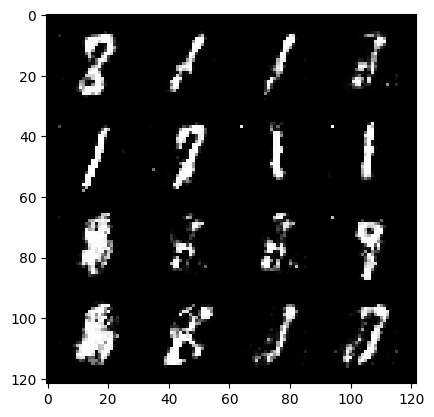

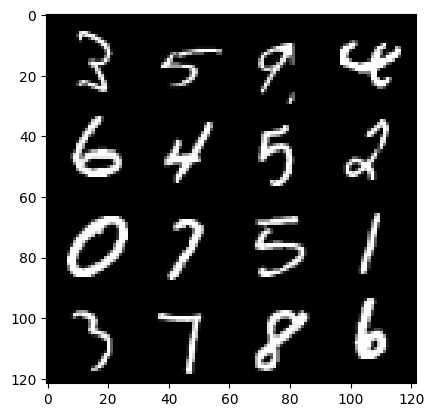

179: Step 84000 / Gen Loss : 2.066659495433172 / Disc Loss : 0.24768060450752588


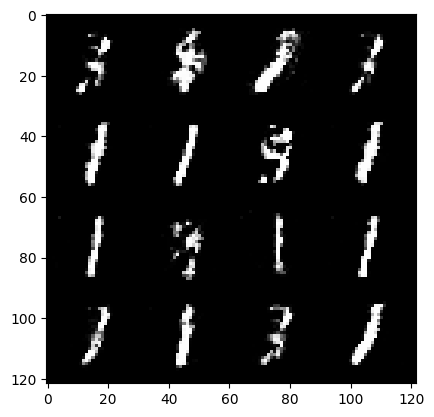

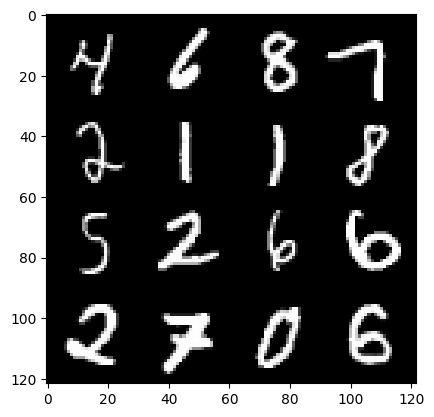

179: Step 84300 / Gen Loss : 2.116462563276292 / Disc Loss : 0.21895512809356055


  0%|          | 0/469 [00:00<?, ?it/s]

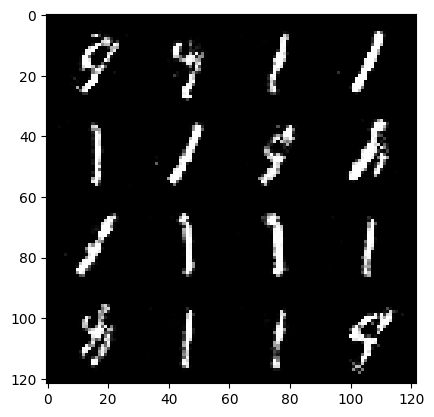

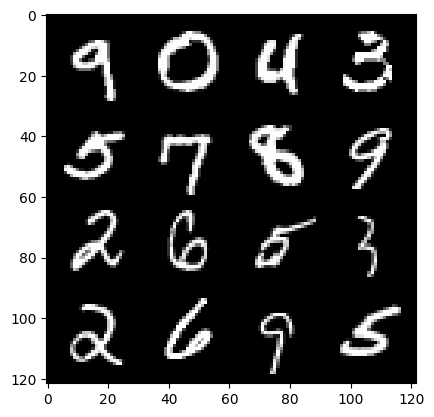

180: Step 84600 / Gen Loss : 2.2642173981666556 / Disc Loss : 0.22313273400068295


  0%|          | 0/469 [00:00<?, ?it/s]

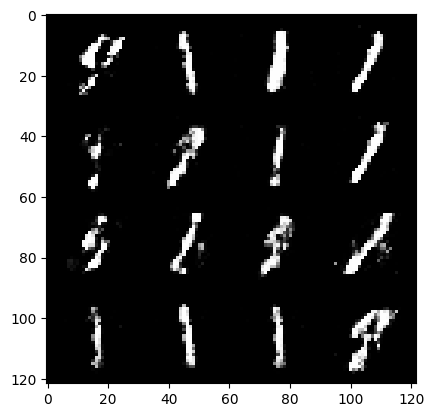

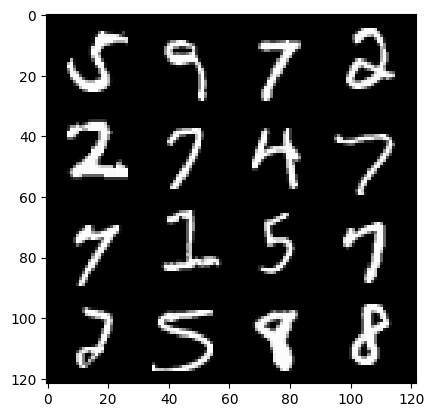

181: Step 84900 / Gen Loss : 2.173790794610978 / Disc Loss : 0.23208361491560942


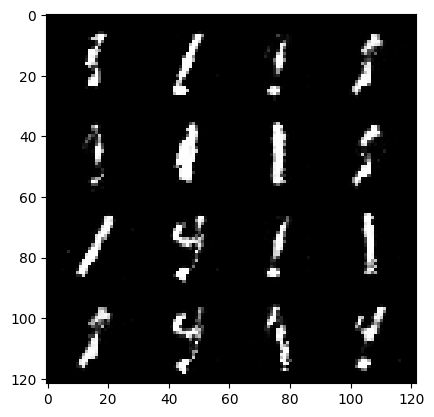

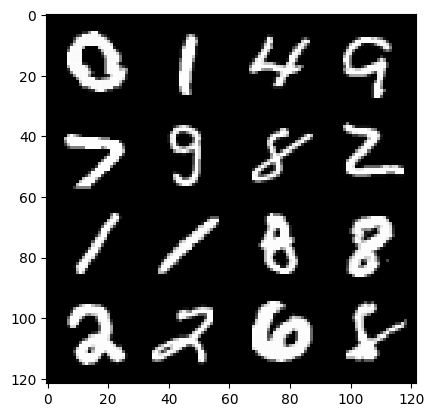

181: Step 85200 / Gen Loss : 2.291427340904872 / Disc Loss : 0.20280390923221892


  0%|          | 0/469 [00:00<?, ?it/s]

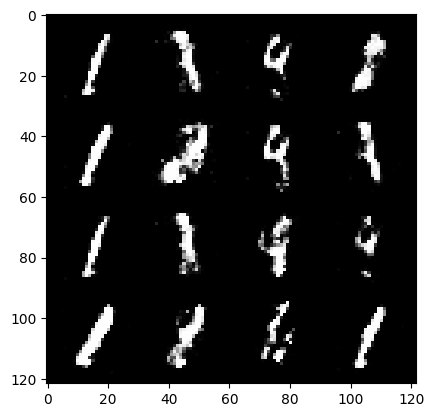

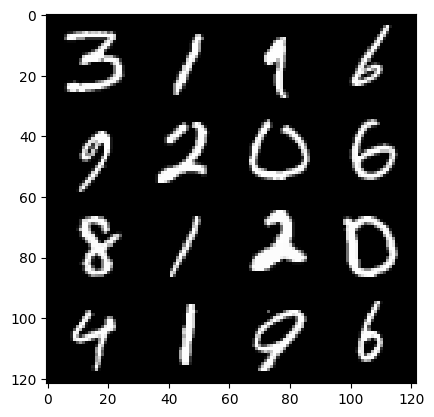

182: Step 85500 / Gen Loss : 2.182515612840651 / Disc Loss : 0.243896325578292


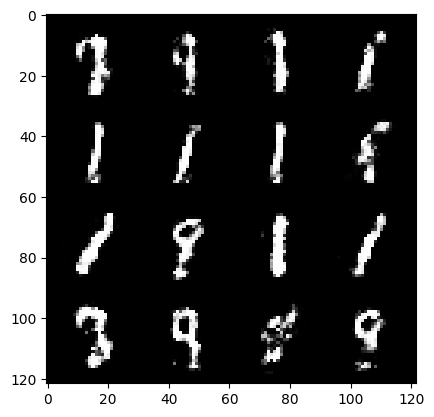

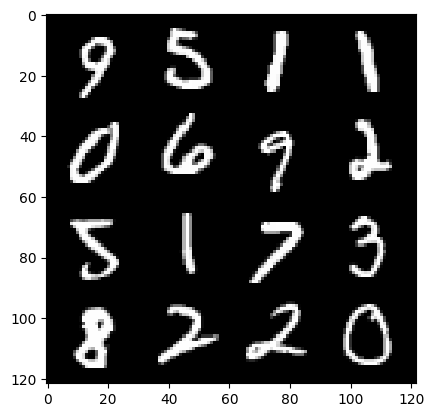

182: Step 85800 / Gen Loss : 2.115797843535741 / Disc Loss : 0.24075625757376348


  0%|          | 0/469 [00:00<?, ?it/s]

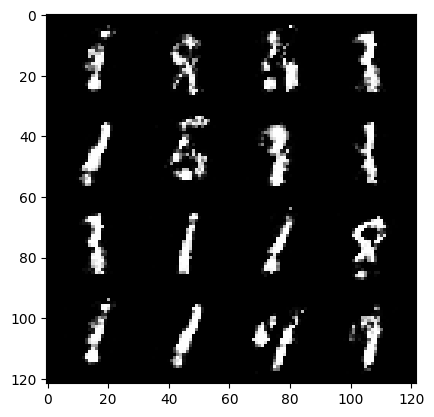

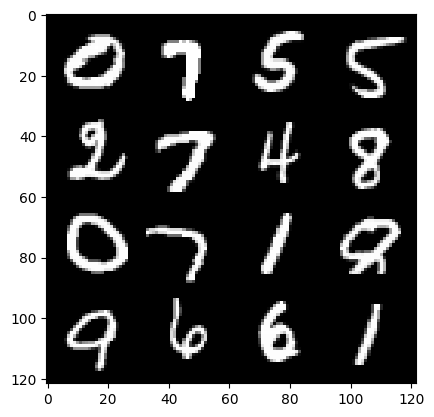

183: Step 86100 / Gen Loss : 2.1057351930936186 / Disc Loss : 0.24176311984658258


  0%|          | 0/469 [00:00<?, ?it/s]

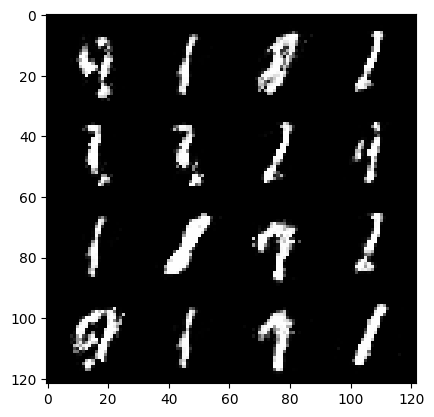

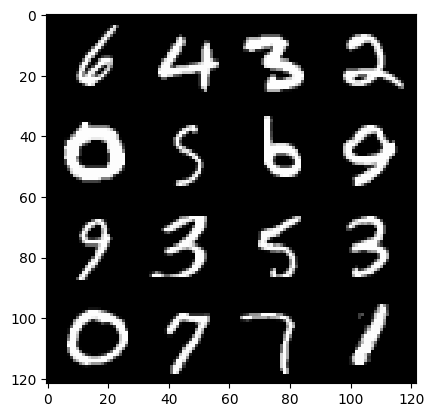

184: Step 86400 / Gen Loss : 2.132540578842164 / Disc Loss : 0.24501135215163233


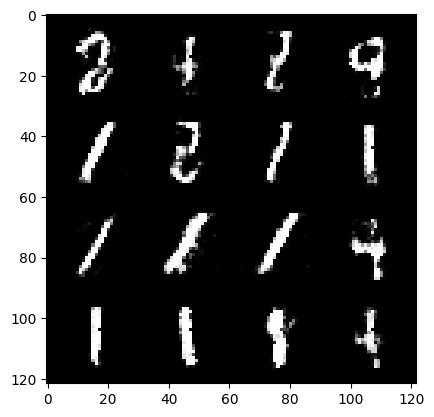

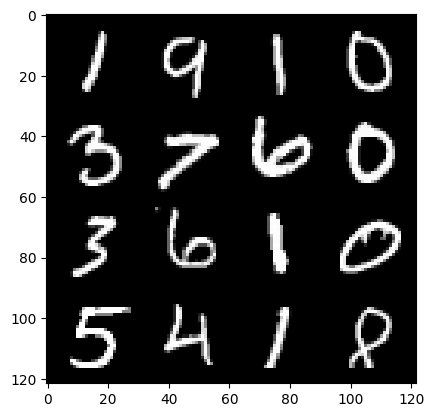

184: Step 86700 / Gen Loss : 2.0279904985427852 / Disc Loss : 0.2581087166070939


  0%|          | 0/469 [00:00<?, ?it/s]

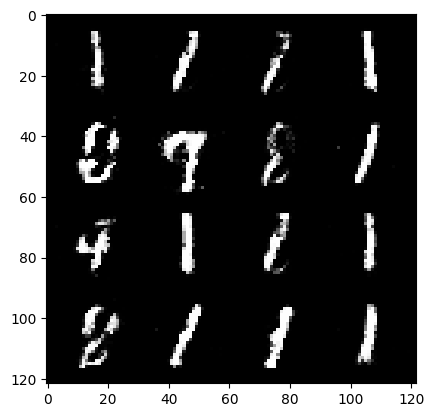

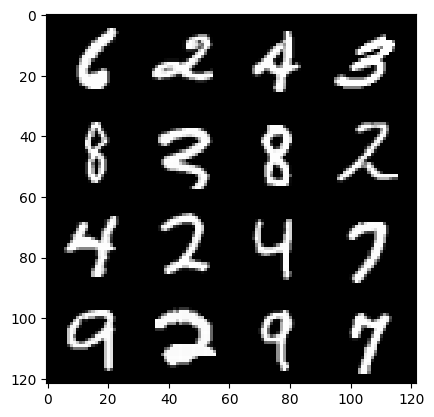

185: Step 87000 / Gen Loss : 2.0240568542480477 / Disc Loss : 0.26837496663133303


  0%|          | 0/469 [00:00<?, ?it/s]

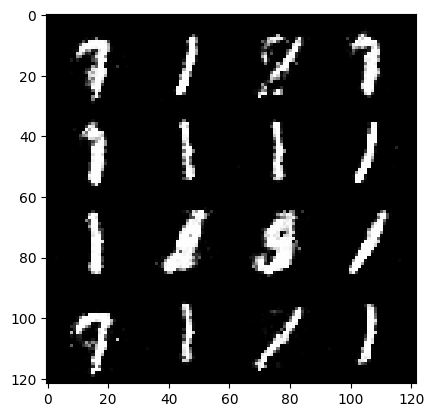

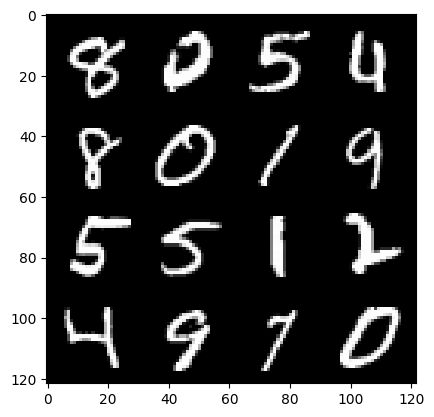

186: Step 87300 / Gen Loss : 1.9616344622770938 / Disc Loss : 0.2758925603826843


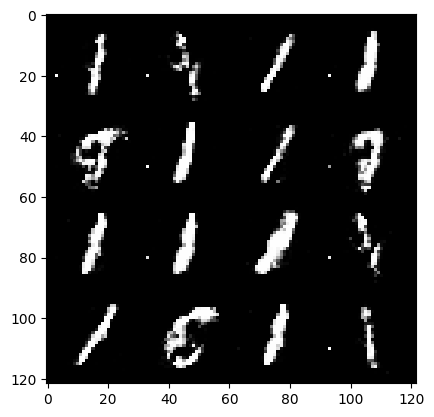

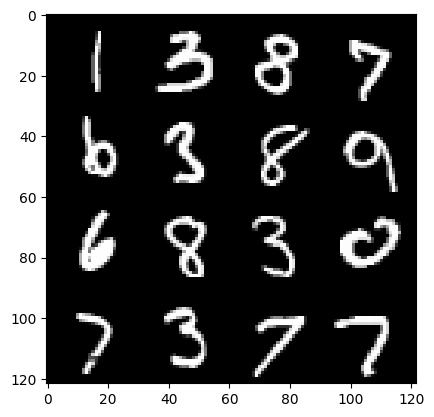

186: Step 87600 / Gen Loss : 1.84351077357928 / Disc Loss : 0.32421102205912267


  0%|          | 0/469 [00:00<?, ?it/s]

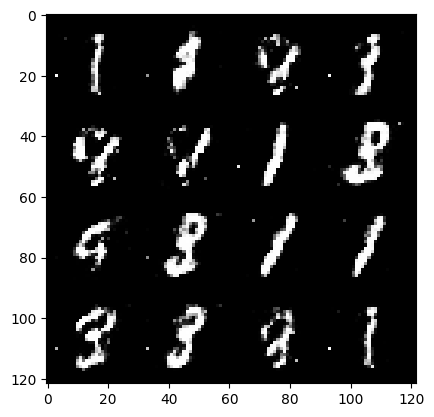

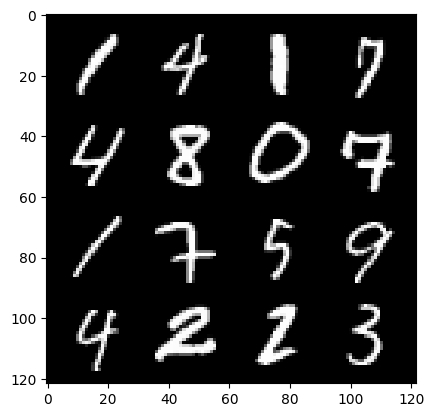

187: Step 87900 / Gen Loss : 1.818423037926356 / Disc Loss : 0.3002302166819573


  0%|          | 0/469 [00:00<?, ?it/s]

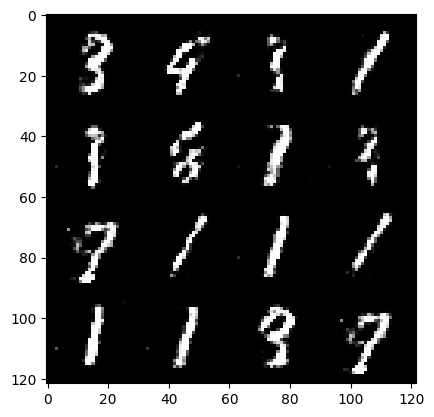

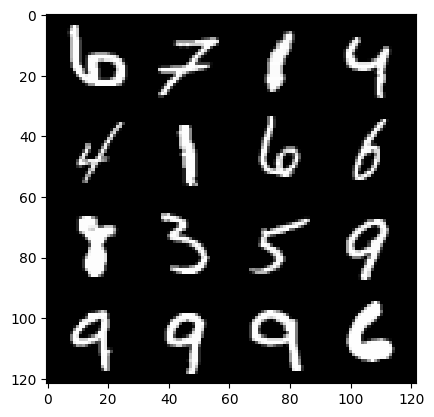

188: Step 88200 / Gen Loss : 2.0469135673840837 / Disc Loss : 0.24192891468604416


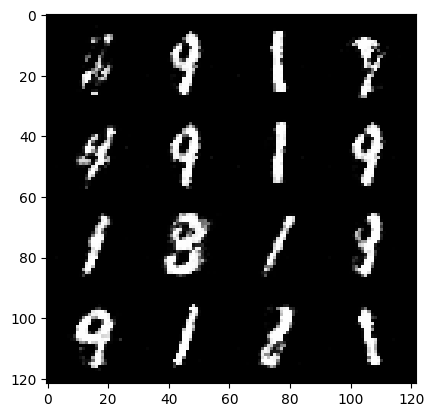

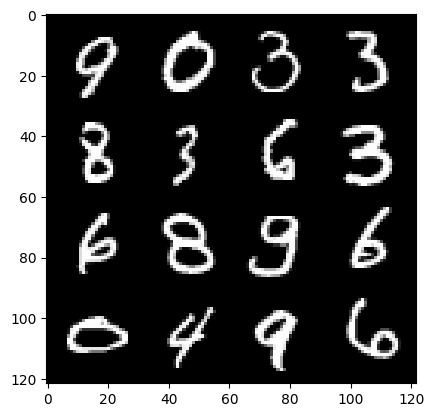

188: Step 88500 / Gen Loss : 1.8918214468161265 / Disc Loss : 0.2893574843307337


  0%|          | 0/469 [00:00<?, ?it/s]

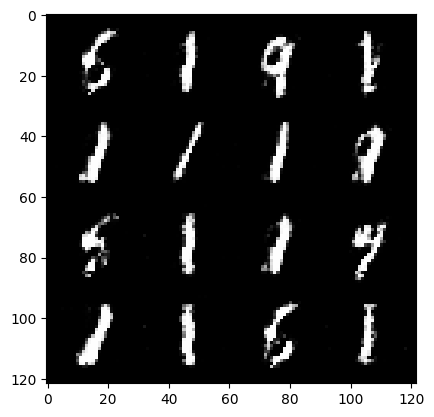

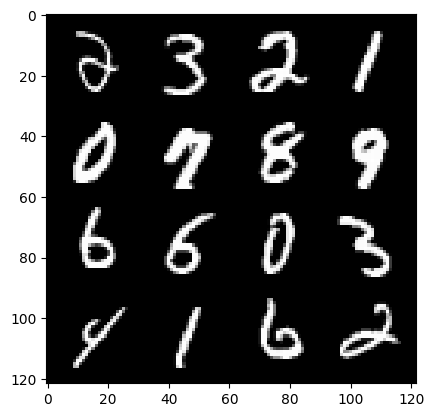

189: Step 88800 / Gen Loss : 1.9389317675431574 / Disc Loss : 0.2745211860040823


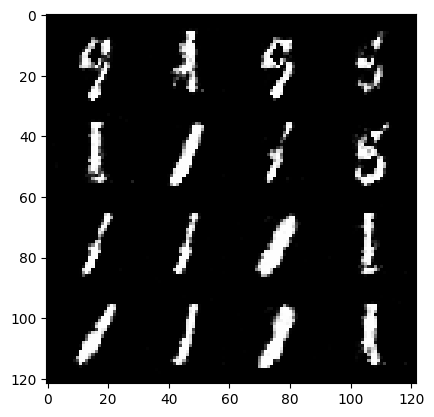

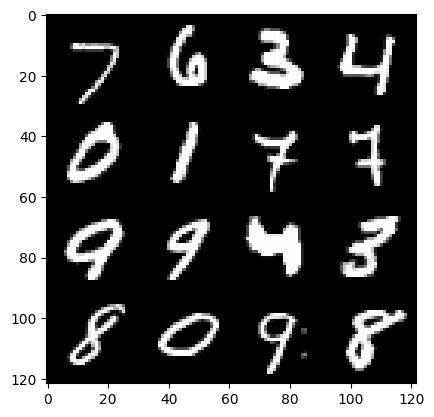

189: Step 89100 / Gen Loss : 1.9087967888514215 / Disc Loss : 0.2719403235117596


  0%|          | 0/469 [00:00<?, ?it/s]

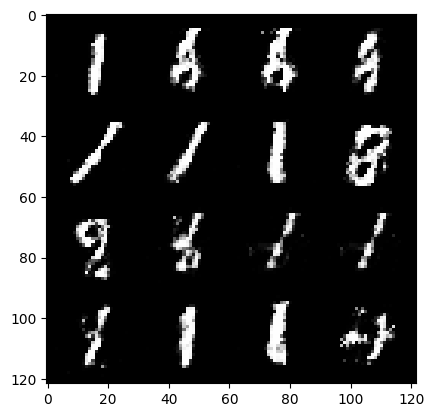

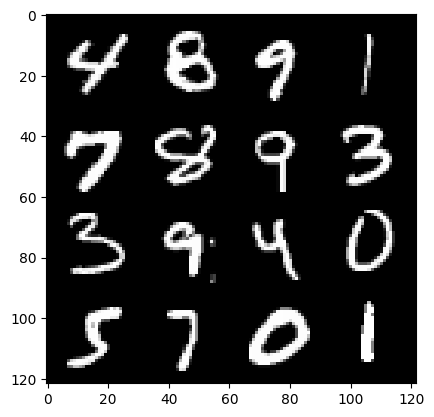

190: Step 89400 / Gen Loss : 2.008318919738134 / Disc Loss : 0.2621163855493069


  0%|          | 0/469 [00:00<?, ?it/s]

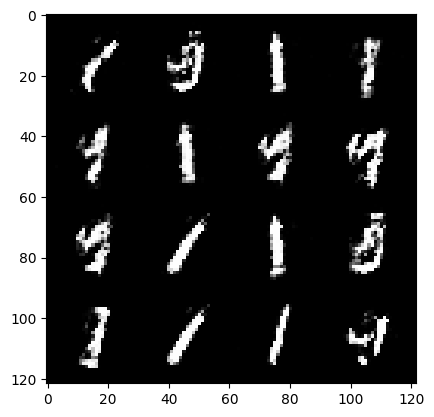

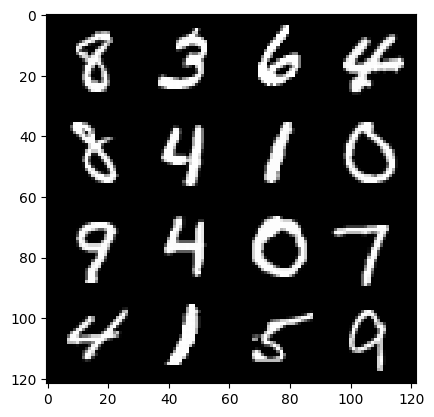

191: Step 89700 / Gen Loss : 2.034048194885253 / Disc Loss : 0.25066868747274074


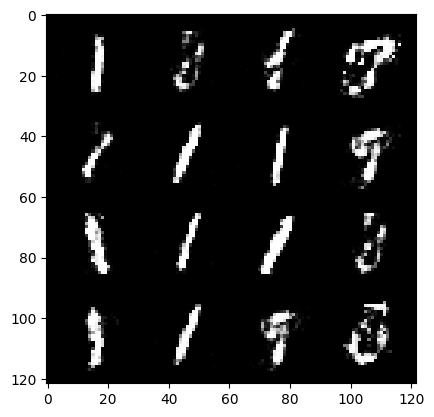

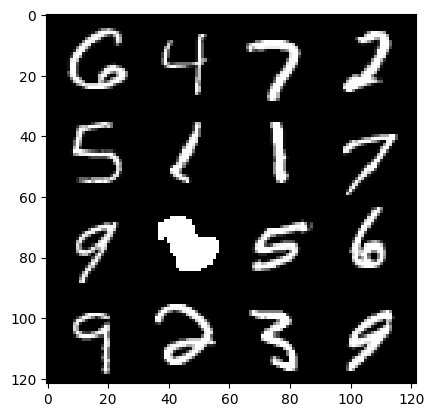

191: Step 90000 / Gen Loss : 2.058037130037944 / Disc Loss : 0.24277526343862207


  0%|          | 0/469 [00:00<?, ?it/s]

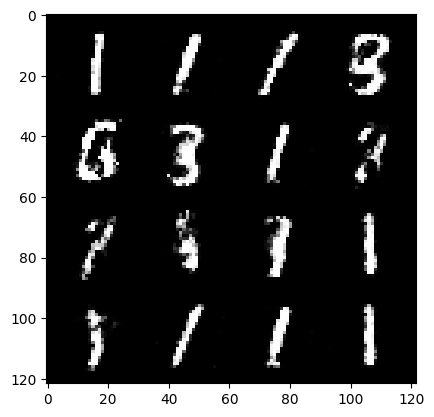

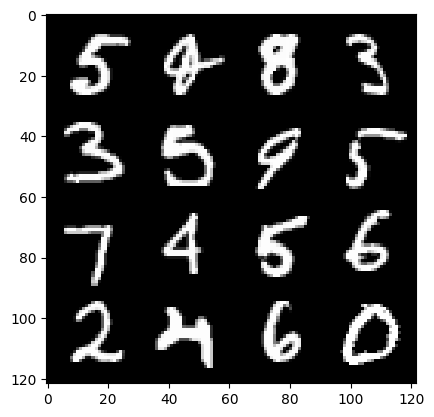

192: Step 90300 / Gen Loss : 2.125377828677496 / Disc Loss : 0.24304783115784329


  0%|          | 0/469 [00:00<?, ?it/s]

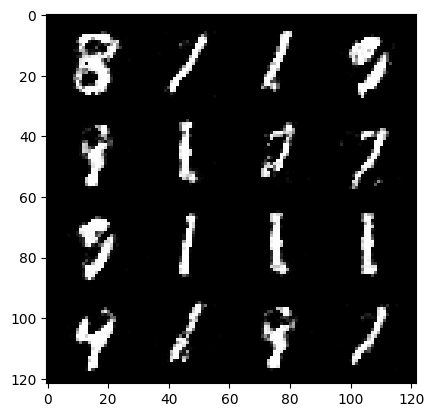

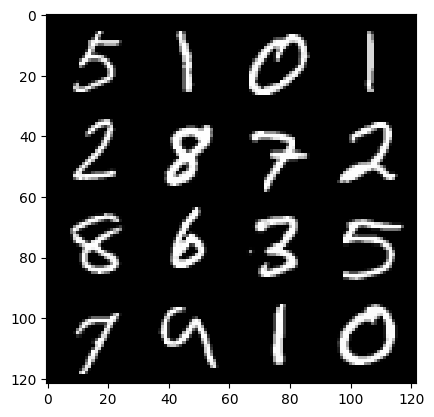

193: Step 90600 / Gen Loss : 2.0593536921342217 / Disc Loss : 0.25558159112930284


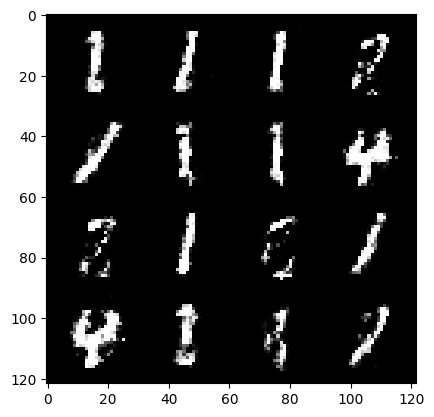

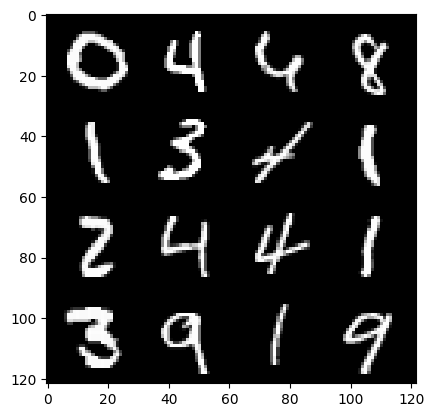

193: Step 90900 / Gen Loss : 2.0589861031373333 / Disc Loss : 0.24504320755600945


  0%|          | 0/469 [00:00<?, ?it/s]

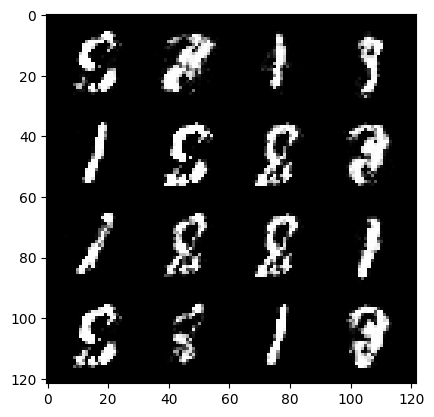

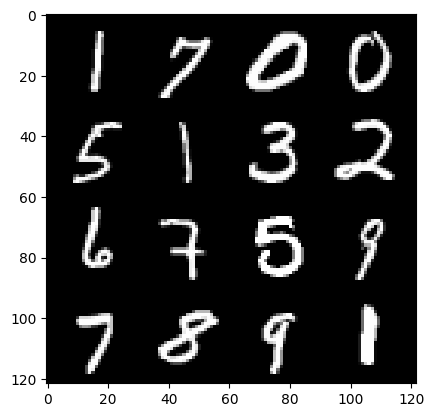

194: Step 91200 / Gen Loss : 2.0457890768845886 / Disc Loss : 0.2484265662233034


  0%|          | 0/469 [00:00<?, ?it/s]

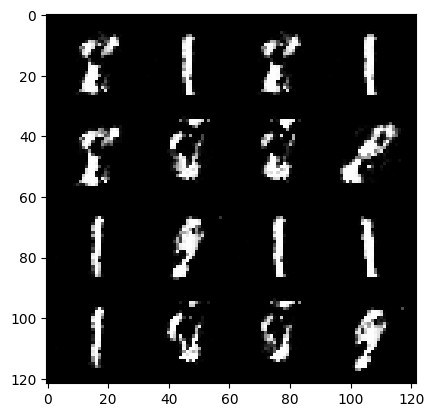

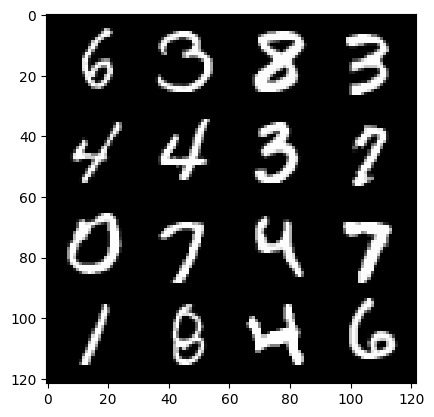

195: Step 91500 / Gen Loss : 1.9769324886798854 / Disc Loss : 0.27143656268715893


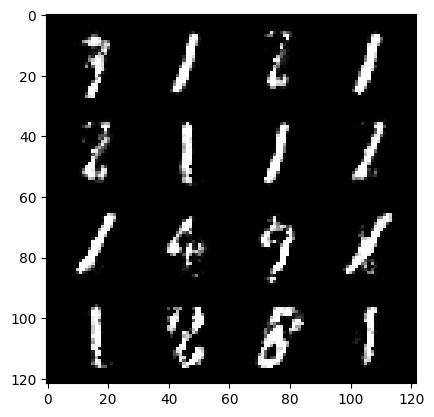

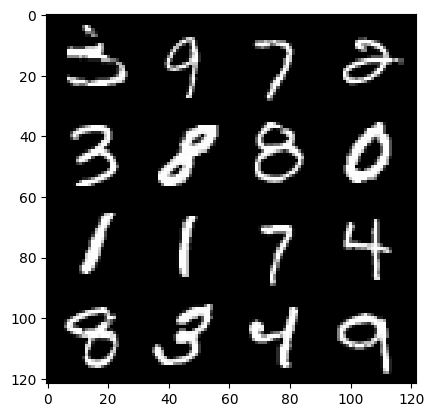

195: Step 91800 / Gen Loss : 1.9998514326413472 / Disc Loss : 0.2610715429484845


  0%|          | 0/469 [00:00<?, ?it/s]

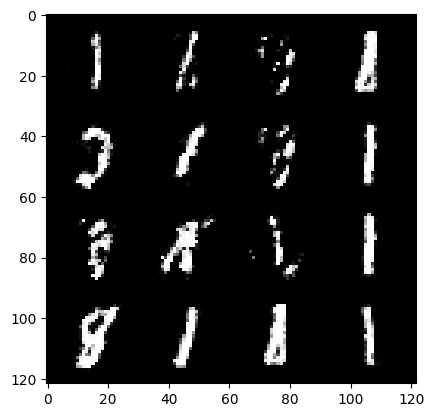

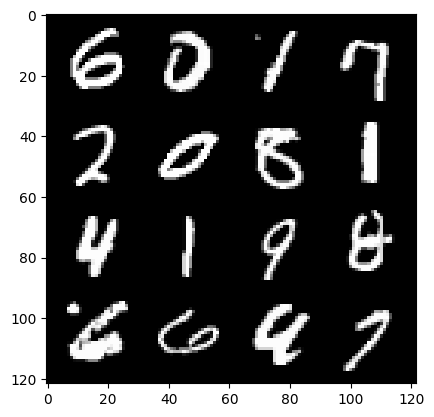

196: Step 92100 / Gen Loss : 2.0450494404633845 / Disc Loss : 0.25231031929453224


  0%|          | 0/469 [00:00<?, ?it/s]

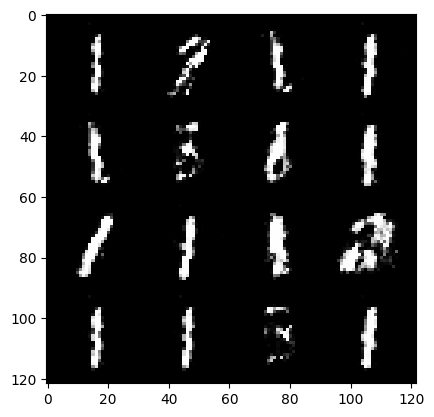

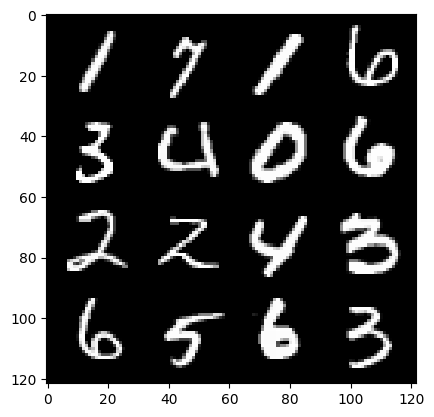

197: Step 92400 / Gen Loss : 2.0113363512357076 / Disc Loss : 0.2508470338582992


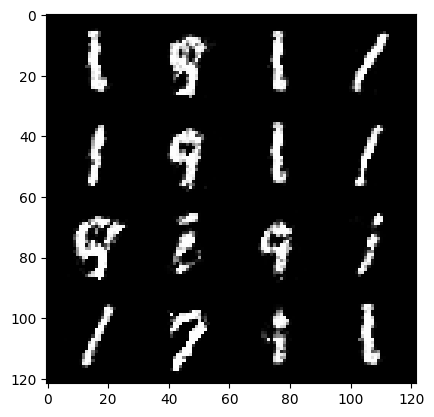

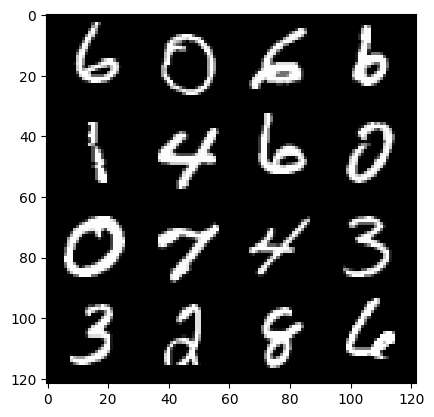

197: Step 92700 / Gen Loss : 1.9477018415927891 / Disc Loss : 0.2631283052265644


  0%|          | 0/469 [00:00<?, ?it/s]

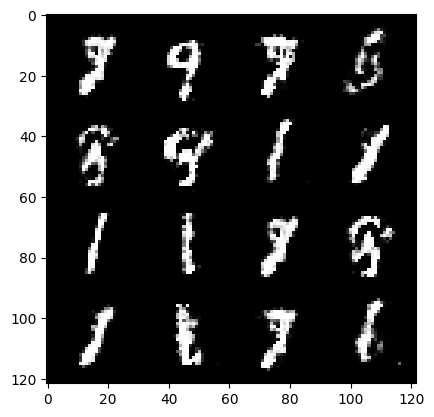

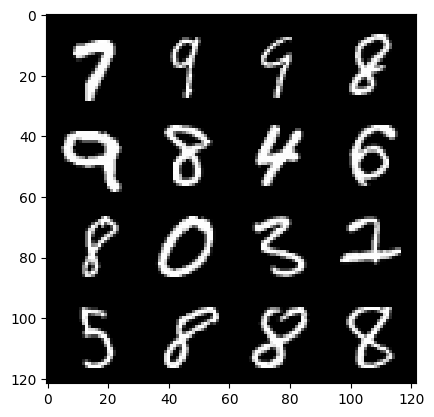

198: Step 93000 / Gen Loss : 2.0345187397797897 / Disc Loss : 0.2509053227802116


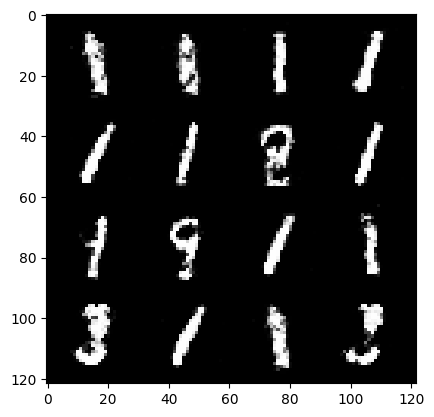

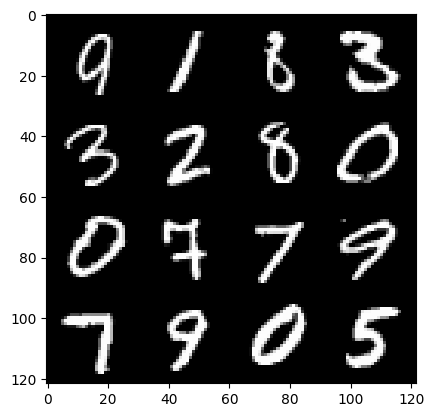

198: Step 93300 / Gen Loss : 1.9598602239290874 / Disc Loss : 0.2760775097707907


  0%|          | 0/469 [00:00<?, ?it/s]

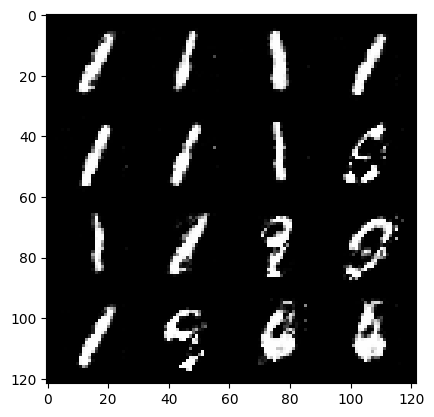

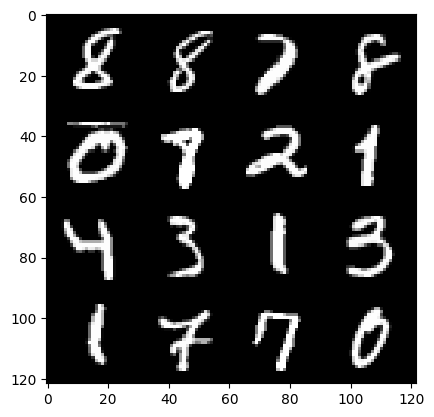

199: Step 93600 / Gen Loss : 2.0224436442057283 / Disc Loss : 0.25799069290359833


  0%|          | 0/469 [00:00<?, ?it/s]

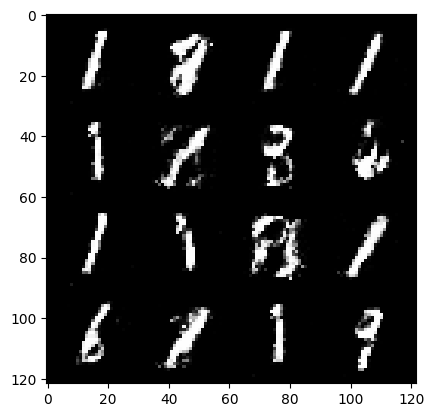

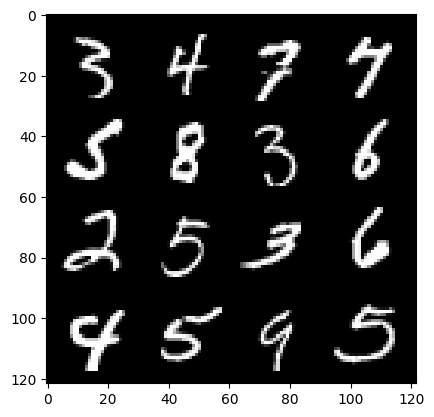

200: Step 93900 / Gen Loss : 1.9647347446282715 / Disc Loss : 0.26332277745008453


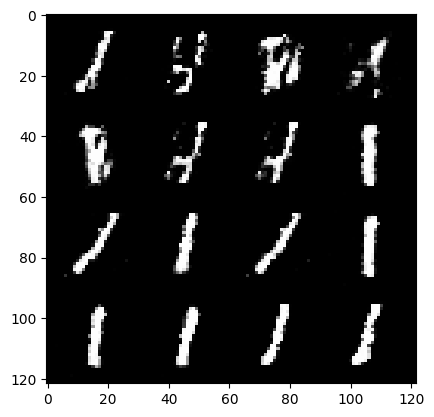

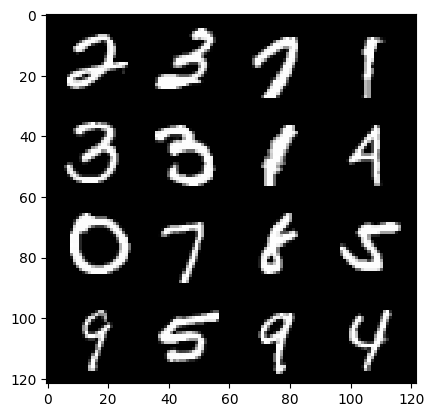

200: Step 94200 / Gen Loss : 2.1092082591851544 / Disc Loss : 0.24882233262062078


  0%|          | 0/469 [00:00<?, ?it/s]

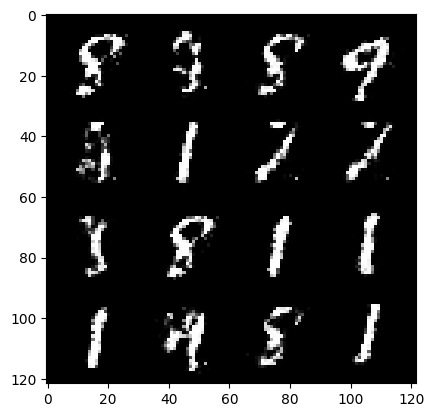

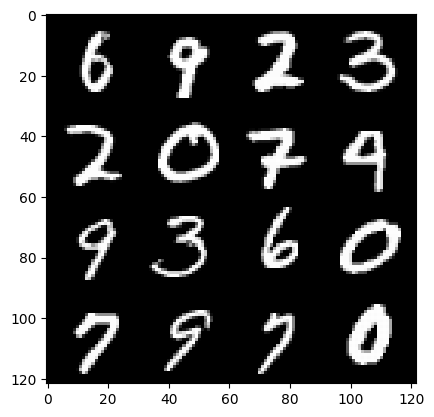

201: Step 94500 / Gen Loss : 2.0010589941342665 / Disc Loss : 0.25498396058877326


  0%|          | 0/469 [00:00<?, ?it/s]

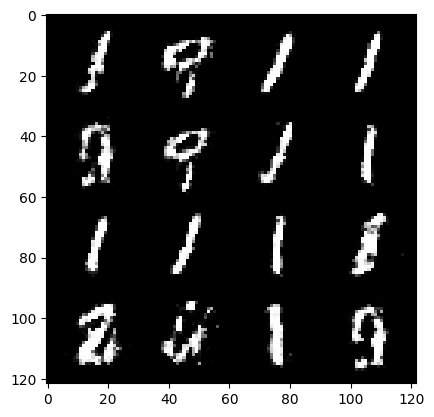

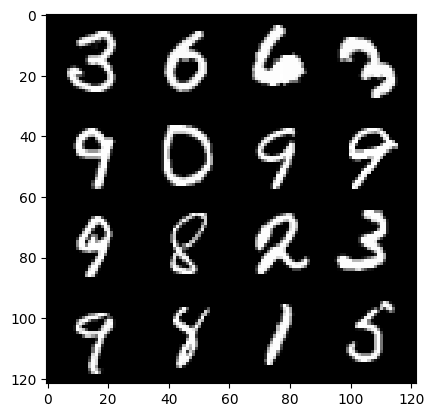

202: Step 94800 / Gen Loss : 2.1127142119407654 / Disc Loss : 0.2337844459215799


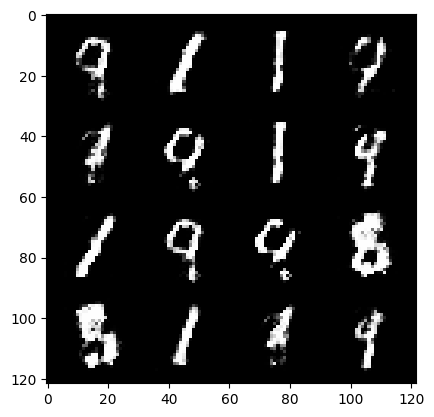

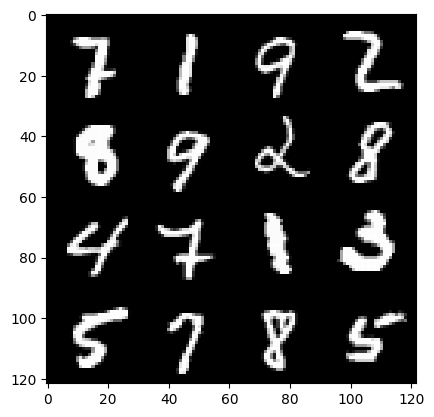

202: Step 95100 / Gen Loss : 2.153105094830195 / Disc Loss : 0.2382027683158715


  0%|          | 0/469 [00:00<?, ?it/s]

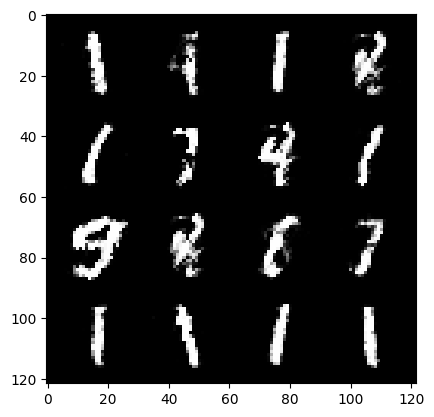

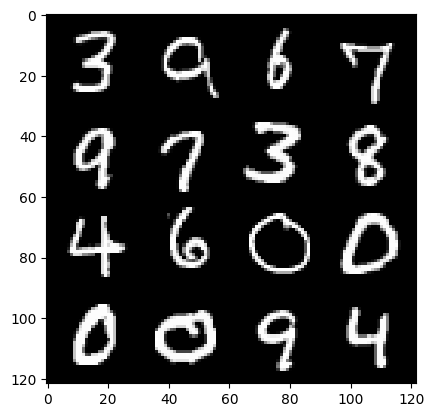

203: Step 95400 / Gen Loss : 2.2102023629347483 / Disc Loss : 0.23292146210869152


  0%|          | 0/469 [00:00<?, ?it/s]

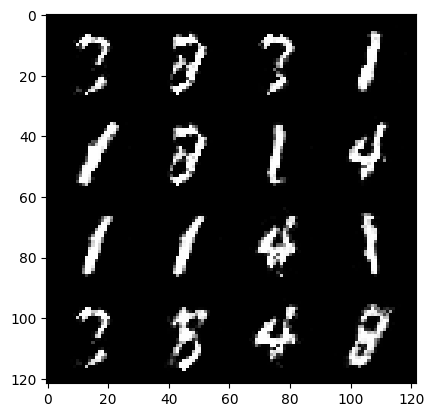

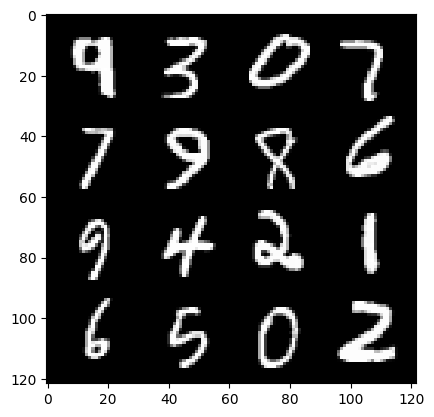

204: Step 95700 / Gen Loss : 2.2374858081340774 / Disc Loss : 0.2258752595384917


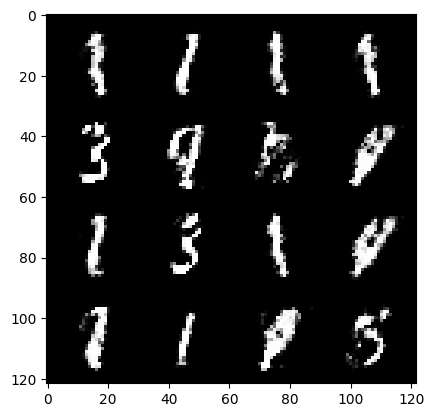

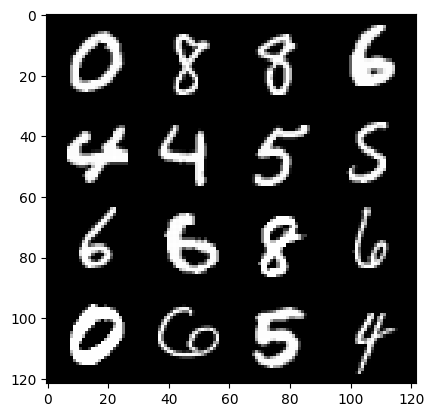

204: Step 96000 / Gen Loss : 2.1935490155220023 / Disc Loss : 0.22174190508822597


  0%|          | 0/469 [00:00<?, ?it/s]

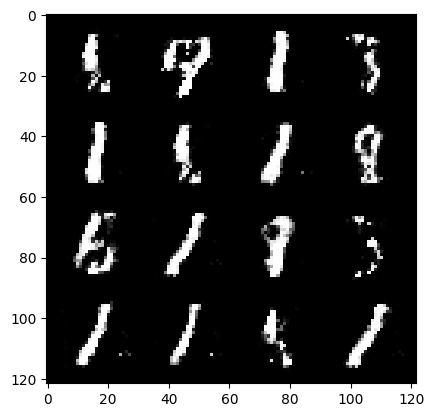

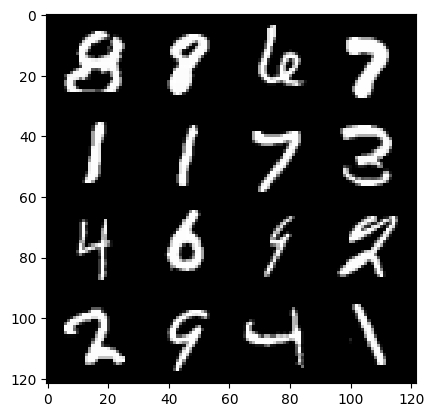

205: Step 96300 / Gen Loss : 2.158349061806996 / Disc Loss : 0.22716813281178472


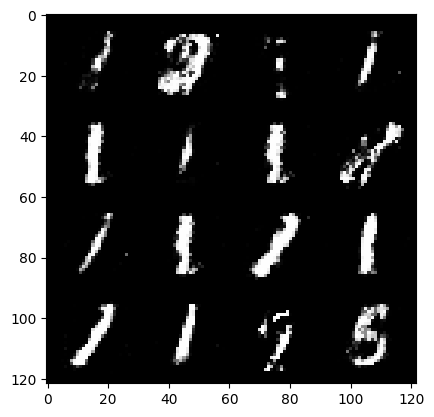

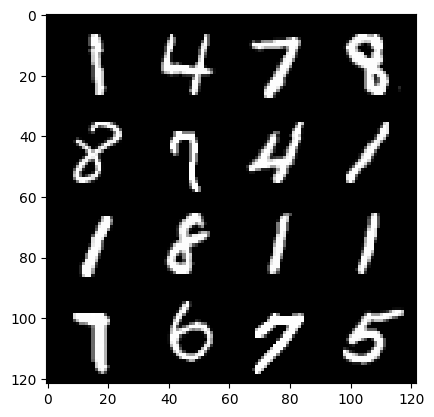

205: Step 96600 / Gen Loss : 2.09433750073115 / Disc Loss : 0.23294059949616613


  0%|          | 0/469 [00:00<?, ?it/s]

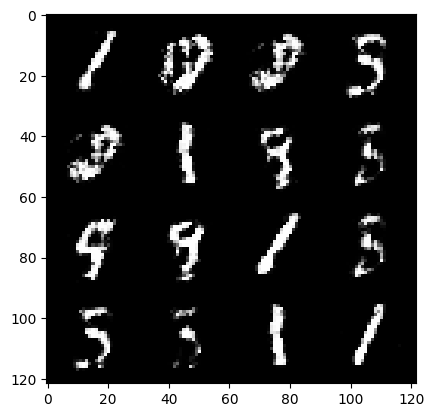

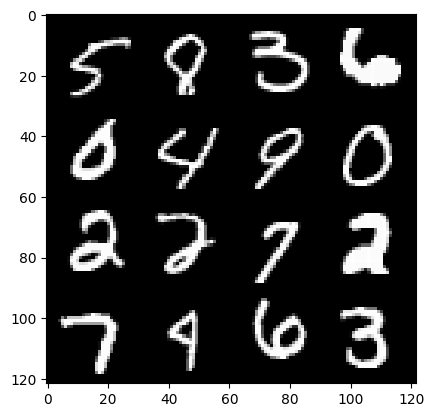

206: Step 96900 / Gen Loss : 2.0142978938420613 / Disc Loss : 0.2431008251508079


  0%|          | 0/469 [00:00<?, ?it/s]

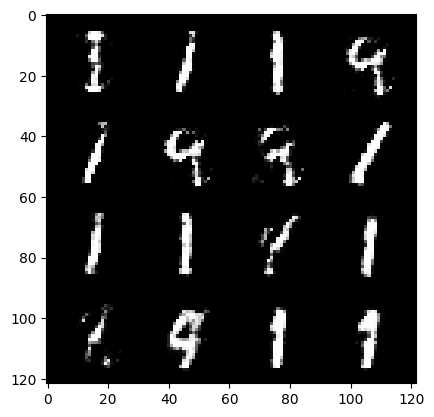

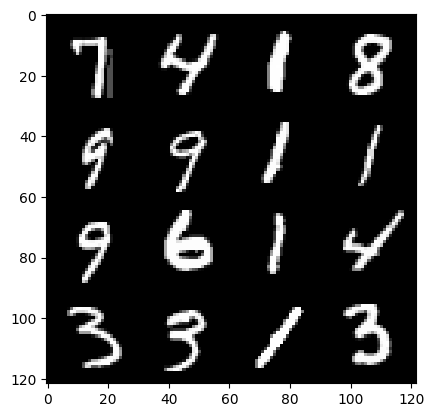

207: Step 97200 / Gen Loss : 1.9430089815457652 / Disc Loss : 0.27093691612283355


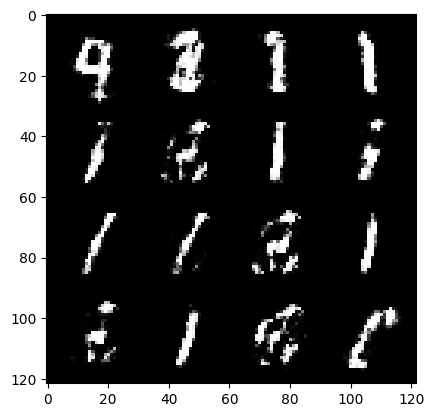

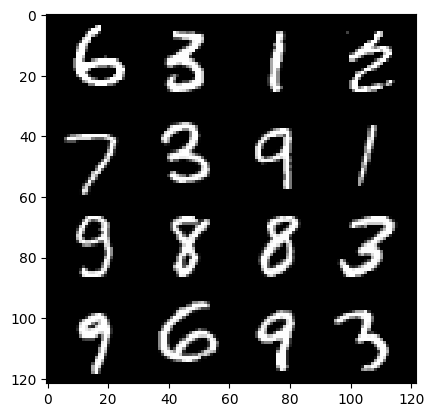

207: Step 97500 / Gen Loss : 1.979187598228454 / Disc Loss : 0.266112107584874


  0%|          | 0/469 [00:00<?, ?it/s]

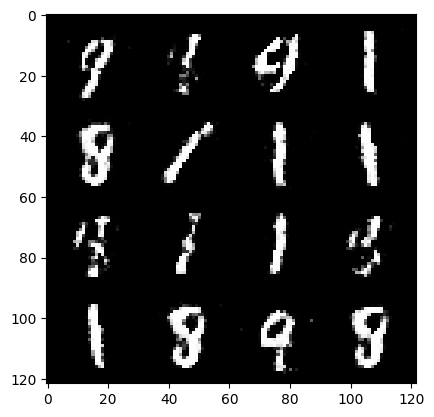

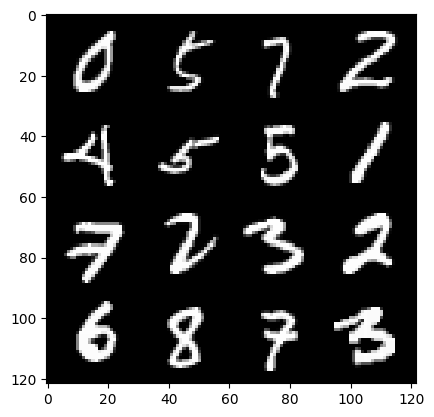

208: Step 97800 / Gen Loss : 1.9504740055402123 / Disc Loss : 0.2654036415616672


  0%|          | 0/469 [00:00<?, ?it/s]

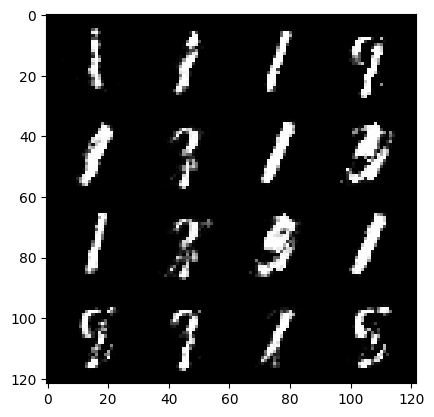

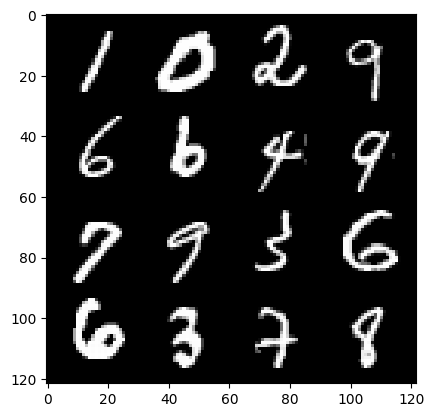

209: Step 98100 / Gen Loss : 2.0414177489280685 / Disc Loss : 0.25413882762193685


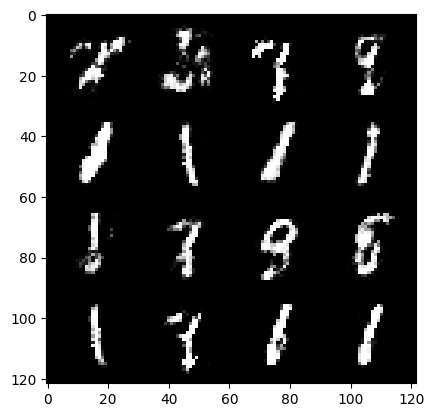

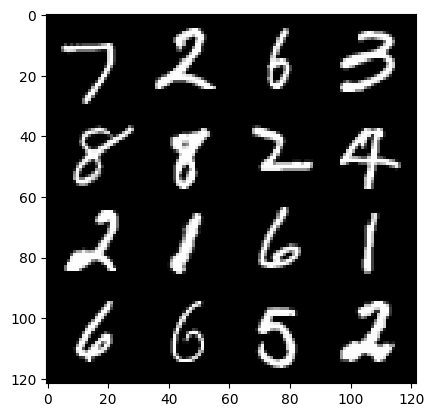

209: Step 98400 / Gen Loss : 1.9695208064715077 / Disc Loss : 0.260877858599027


  0%|          | 0/469 [00:00<?, ?it/s]

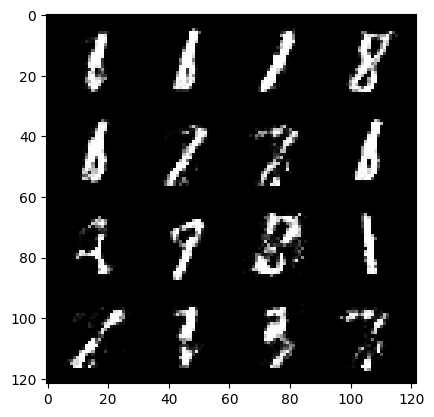

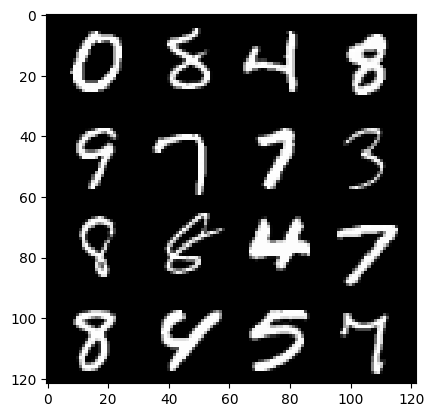

210: Step 98700 / Gen Loss : 1.9840116604169191 / Disc Loss : 0.2601293862859409


  0%|          | 0/469 [00:00<?, ?it/s]

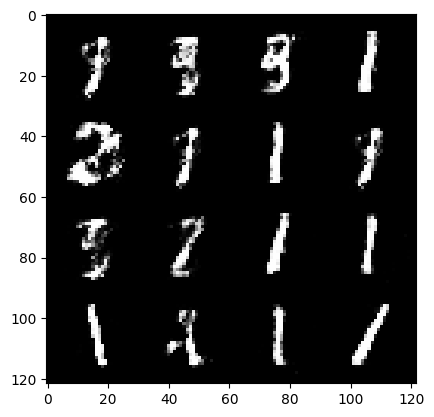

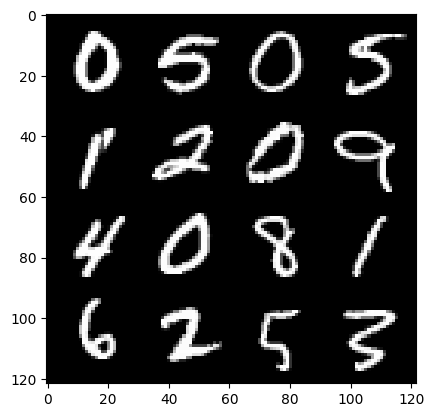

211: Step 99000 / Gen Loss : 1.891915708780288 / Disc Loss : 0.27932481010754906


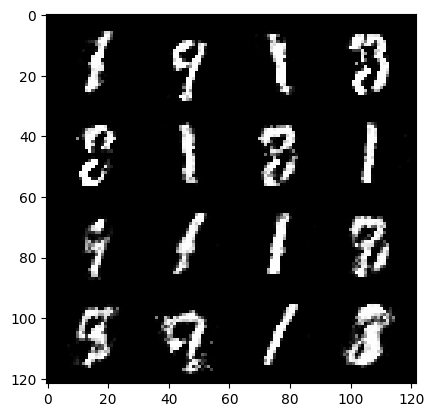

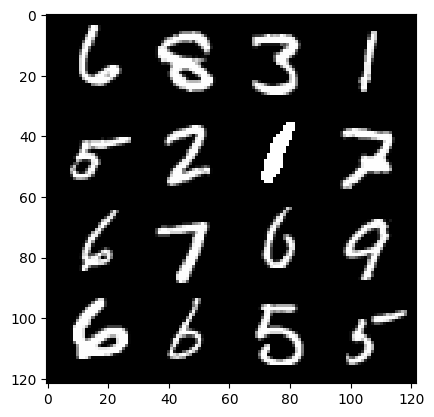

211: Step 99300 / Gen Loss : 1.875362456639607 / Disc Loss : 0.29151980151732737


  0%|          | 0/469 [00:00<?, ?it/s]

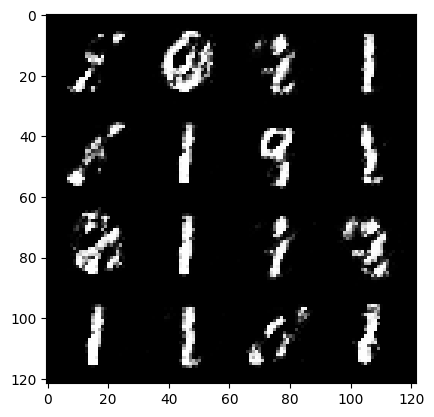

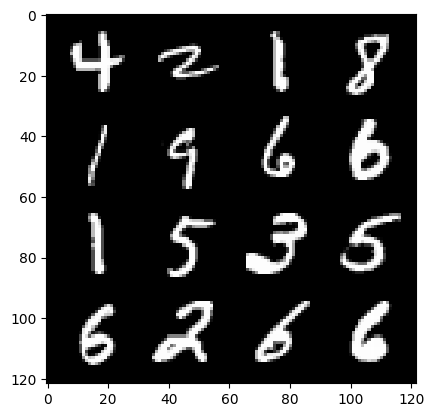

212: Step 99600 / Gen Loss : 1.8638779318332672 / Disc Loss : 0.2931228837867576


  0%|          | 0/469 [00:00<?, ?it/s]

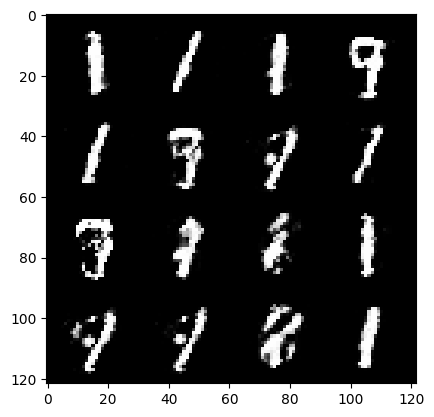

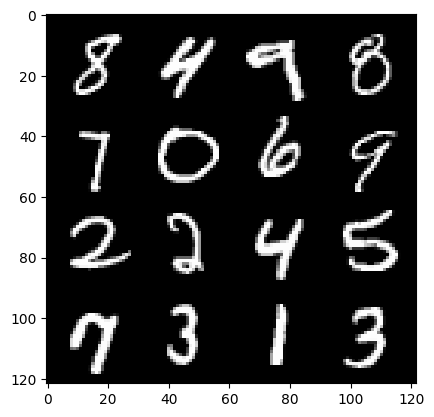

213: Step 99900 / Gen Loss : 1.967324052254359 / Disc Loss : 0.2751334565381209


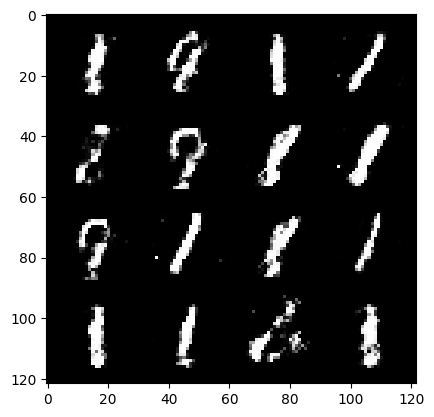

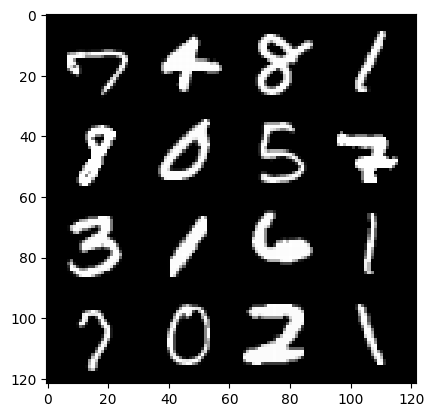

213: Step 100200 / Gen Loss : 2.0486313919226324 / Disc Loss : 0.2527853484451771


  0%|          | 0/469 [00:00<?, ?it/s]

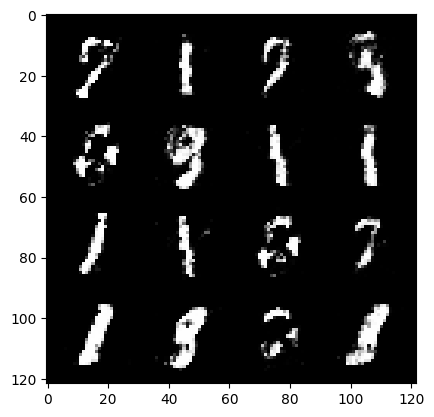

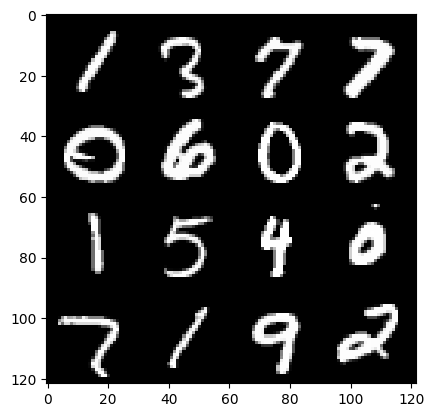

214: Step 100500 / Gen Loss : 2.0290806055068966 / Disc Loss : 0.2559504910806814


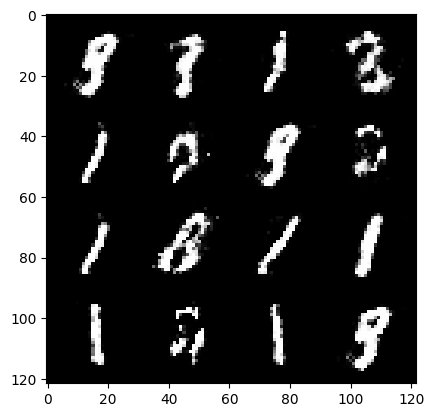

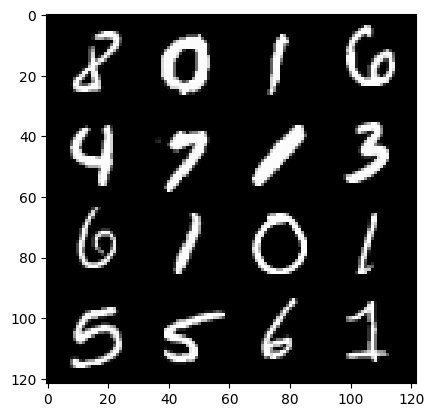

214: Step 100800 / Gen Loss : 1.92426854610443 / Disc Loss : 0.26208413581053414


  0%|          | 0/469 [00:00<?, ?it/s]

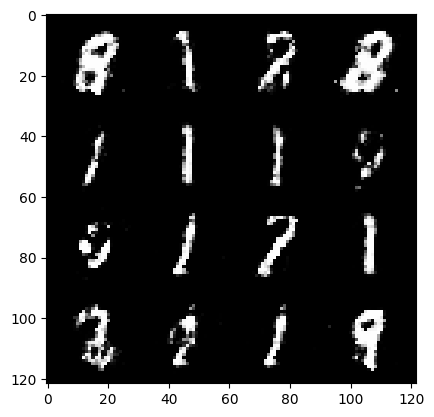

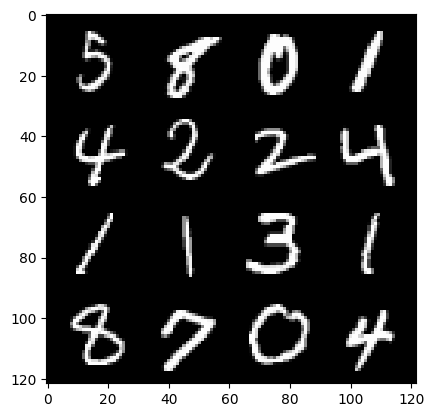

215: Step 101100 / Gen Loss : 1.9274142622947694 / Disc Loss : 0.27253895486394564


  0%|          | 0/469 [00:00<?, ?it/s]

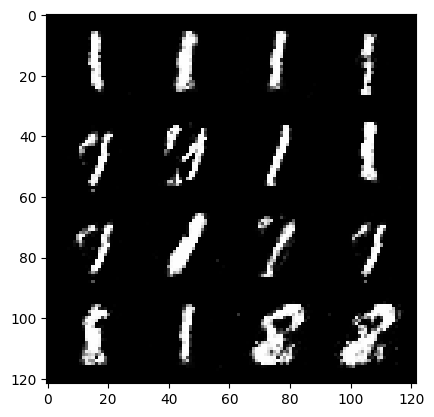

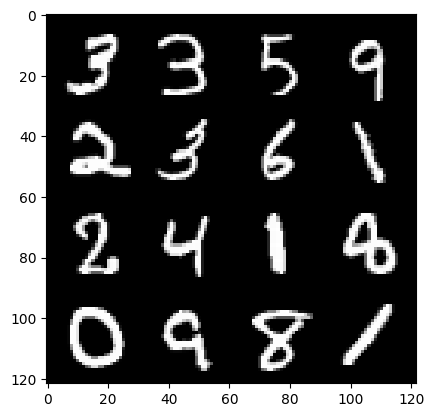

216: Step 101400 / Gen Loss : 1.919988660812379 / Disc Loss : 0.26960876882076273


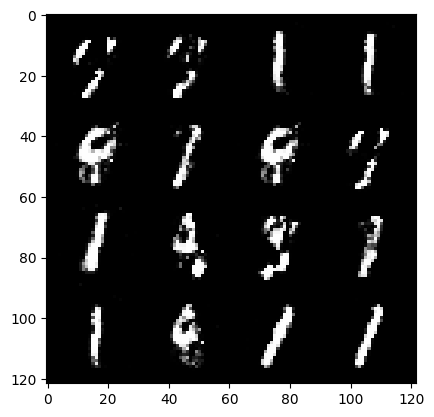

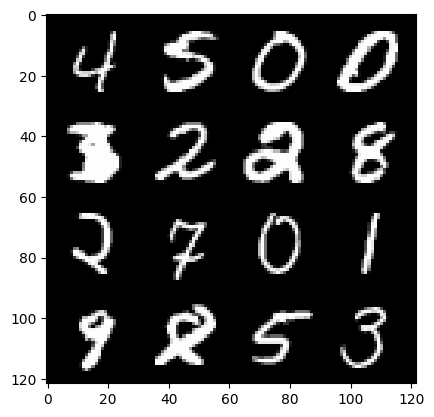

216: Step 101700 / Gen Loss : 2.2675347872575125 / Disc Loss : 0.2213707149028779


  0%|          | 0/469 [00:00<?, ?it/s]

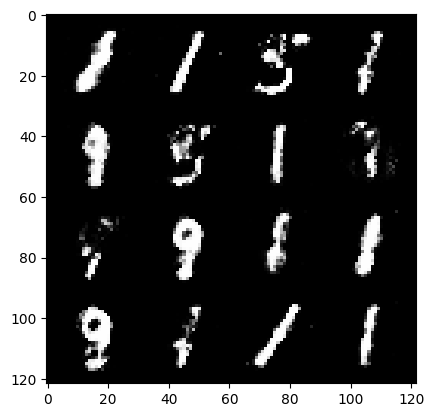

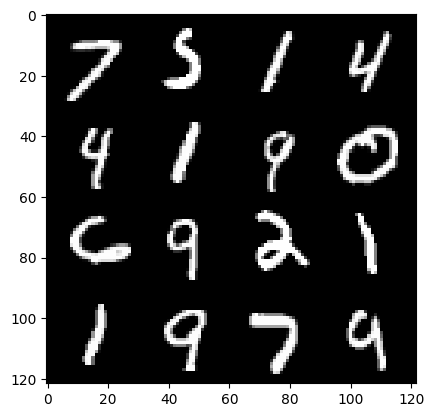

217: Step 102000 / Gen Loss : 2.062094157934188 / Disc Loss : 0.258658327460289


  0%|          | 0/469 [00:00<?, ?it/s]

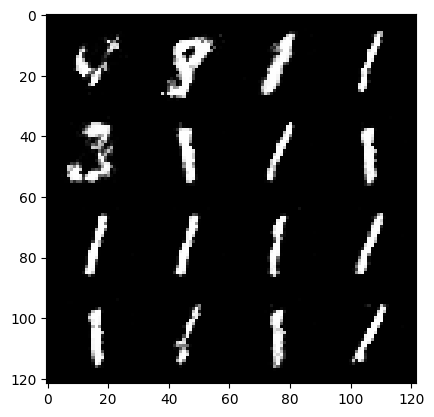

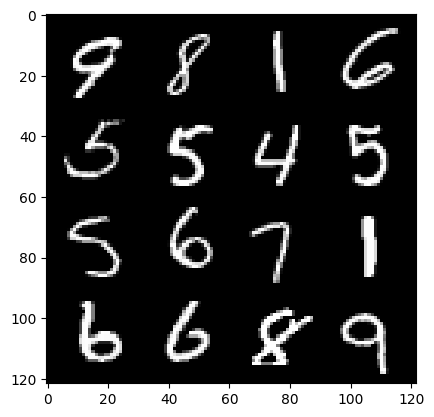

218: Step 102300 / Gen Loss : 1.7282238797346743 / Disc Loss : 0.3207878820598126


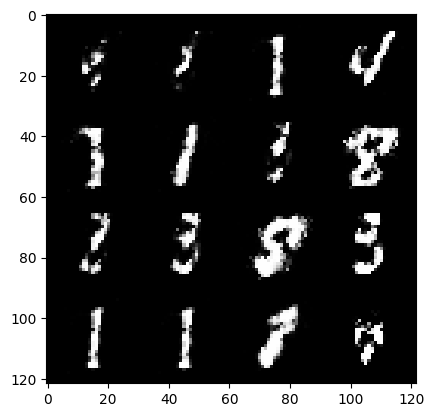

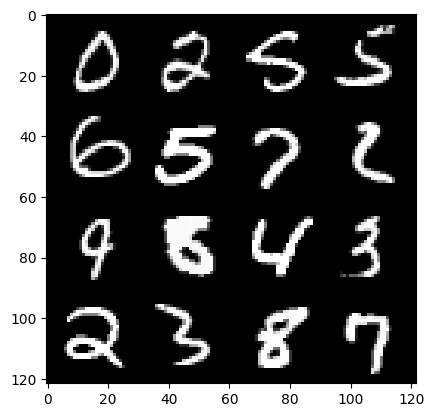

218: Step 102600 / Gen Loss : 1.8341412035624178 / Disc Loss : 0.2825123160084087


  0%|          | 0/469 [00:00<?, ?it/s]

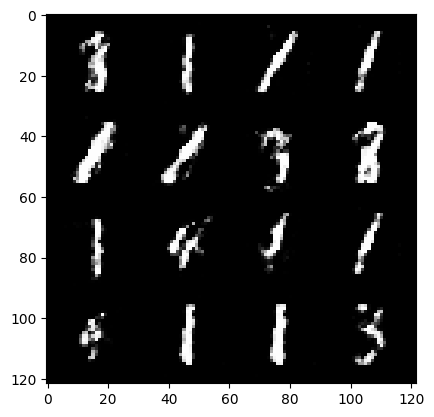

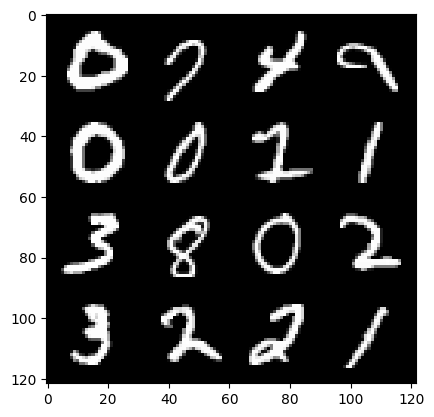

219: Step 102900 / Gen Loss : 1.961348671515783 / Disc Loss : 0.2591732479135196


  0%|          | 0/469 [00:00<?, ?it/s]

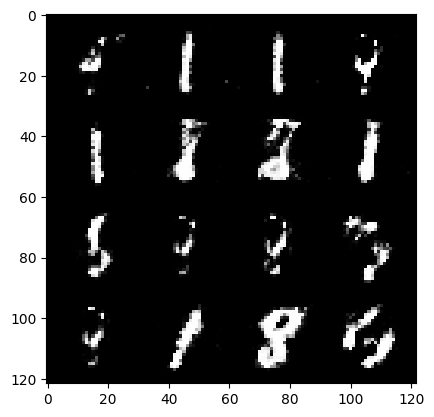

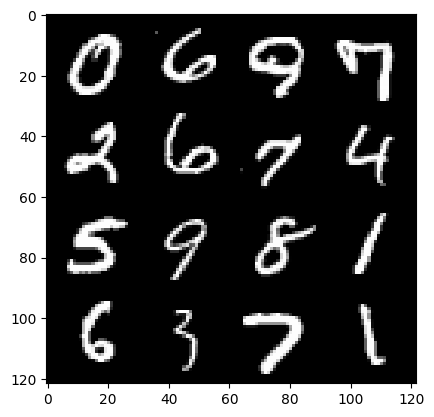

220: Step 103200 / Gen Loss : 2.000817444324493 / Disc Loss : 0.24532771016160643


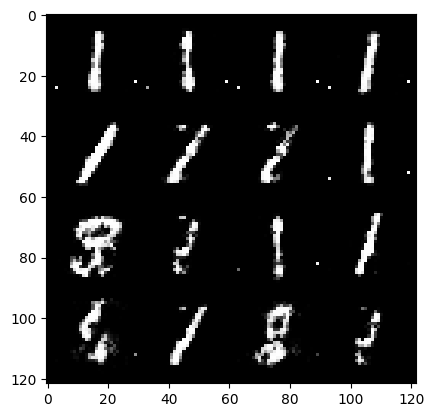

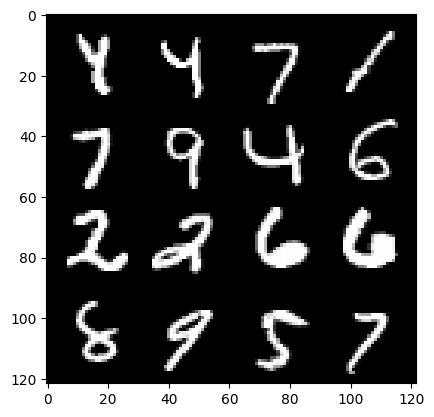

220: Step 103500 / Gen Loss : 1.8784077044328056 / Disc Loss : 0.29185357928276073


  0%|          | 0/469 [00:00<?, ?it/s]

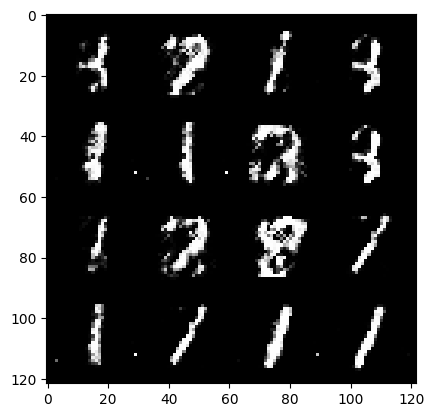

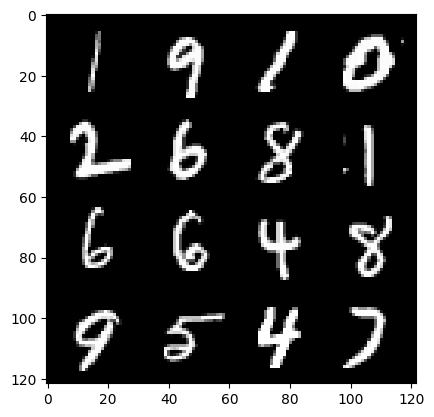

221: Step 103800 / Gen Loss : 1.8857142539819085 / Disc Loss : 0.2735072466234368


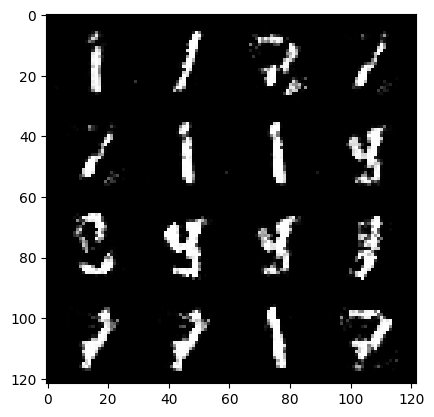

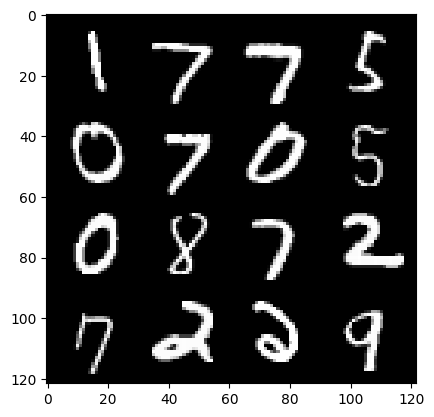

221: Step 104100 / Gen Loss : 1.9646036577224728 / Disc Loss : 0.2558433245619137


  0%|          | 0/469 [00:00<?, ?it/s]

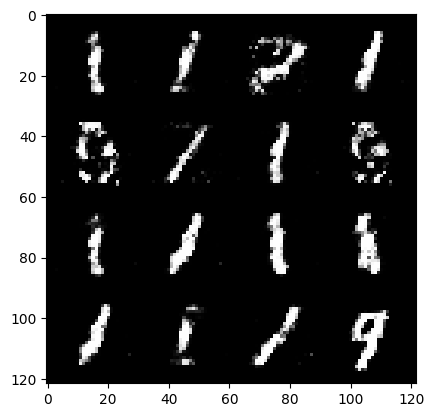

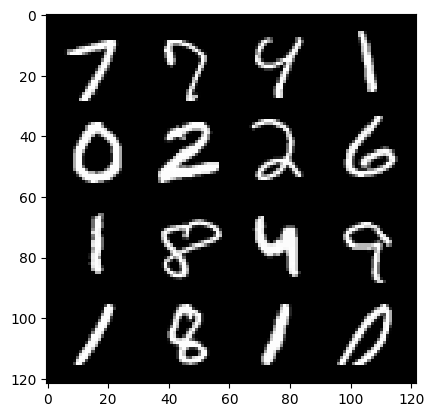

222: Step 104400 / Gen Loss : 1.8986697896321605 / Disc Loss : 0.27385188102722174


  0%|          | 0/469 [00:00<?, ?it/s]

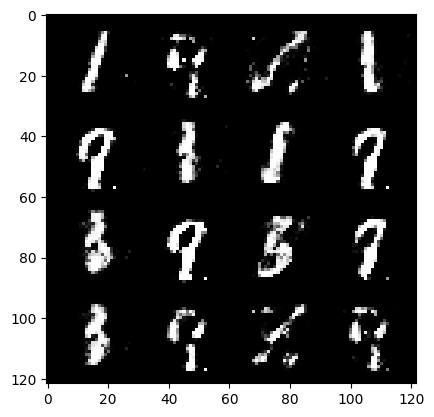

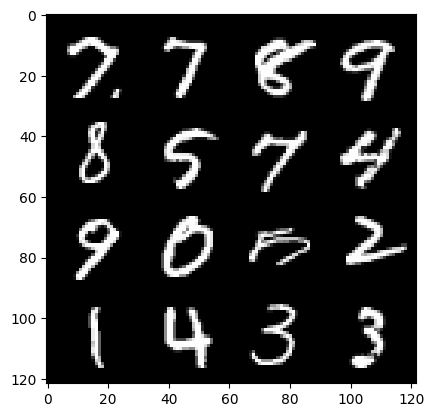

223: Step 104700 / Gen Loss : 1.8831714955965666 / Disc Loss : 0.2844434719781084


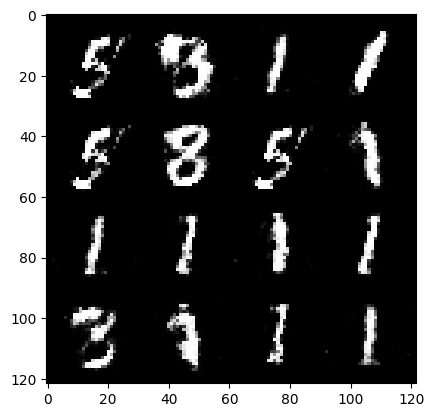

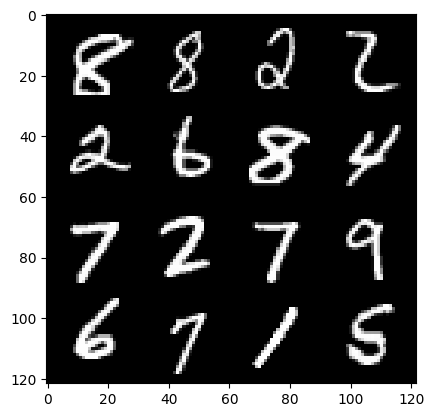

223: Step 105000 / Gen Loss : 1.8515360462665562 / Disc Loss : 0.2980688484509787


  0%|          | 0/469 [00:00<?, ?it/s]

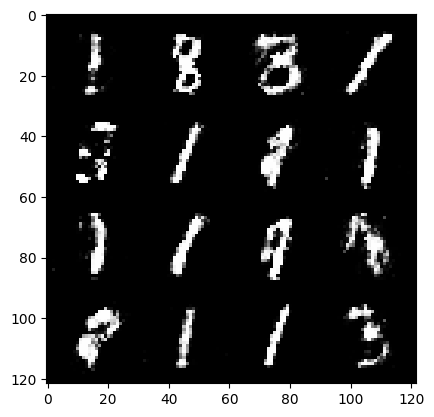

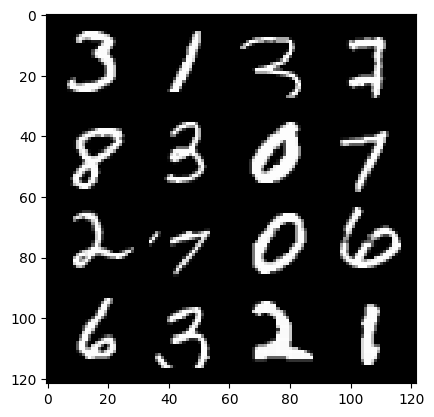

224: Step 105300 / Gen Loss : 1.8431593831380213 / Disc Loss : 0.28938291475176775


  0%|          | 0/469 [00:00<?, ?it/s]

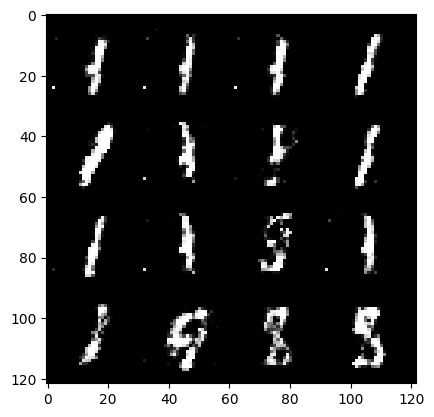

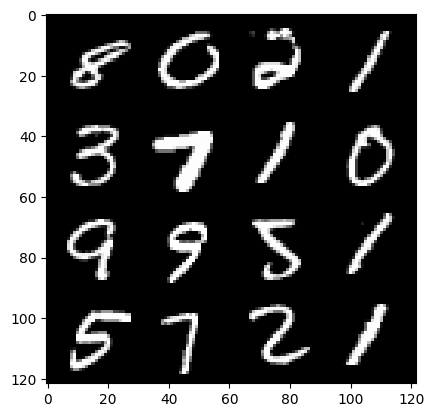

225: Step 105600 / Gen Loss : 2.099936905701956 / Disc Loss : 0.24156733309229203


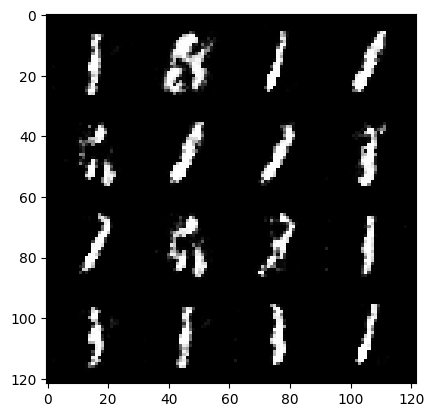

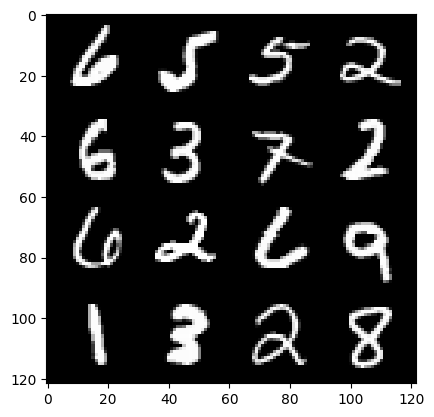

225: Step 105900 / Gen Loss : 1.9104205814997364 / Disc Loss : 0.26308580035964635


  0%|          | 0/469 [00:00<?, ?it/s]

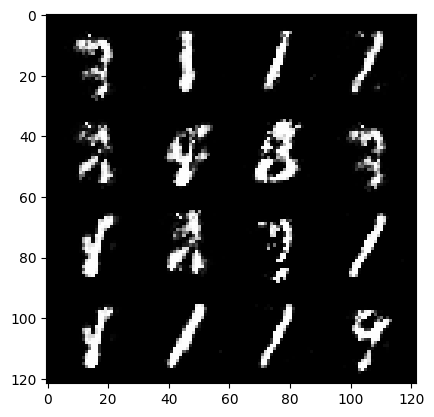

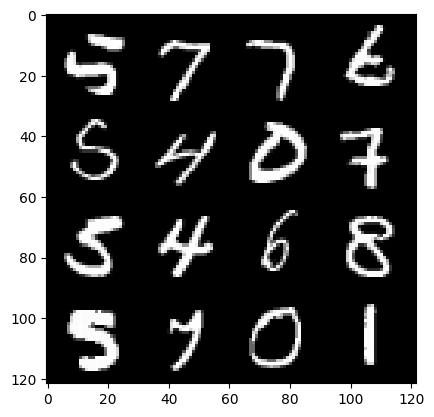

226: Step 106200 / Gen Loss : 1.9287031801541656 / Disc Loss : 0.2749569117029508


  0%|          | 0/469 [00:00<?, ?it/s]

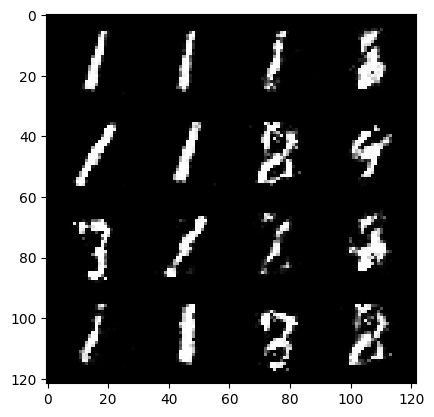

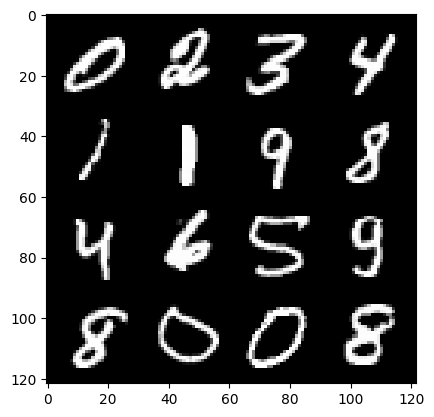

227: Step 106500 / Gen Loss : 2.009250333309174 / Disc Loss : 0.2703394430875779


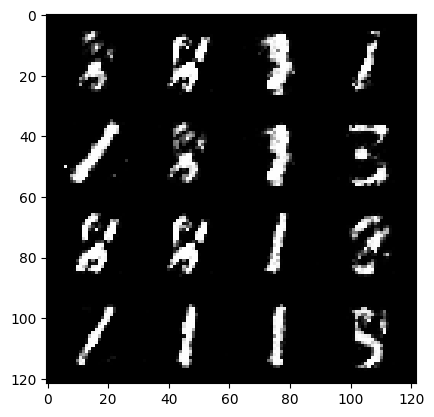

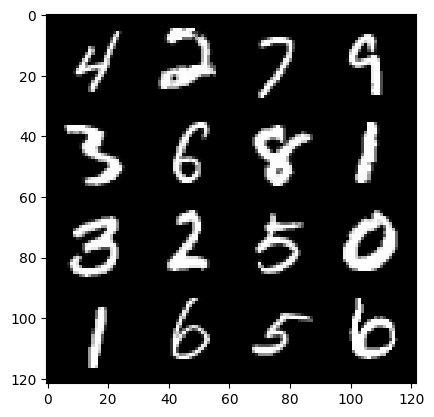

227: Step 106800 / Gen Loss : 2.0241373602549237 / Disc Loss : 0.26325668901205046


  0%|          | 0/469 [00:00<?, ?it/s]

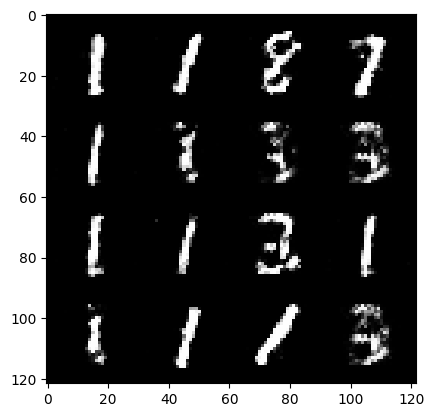

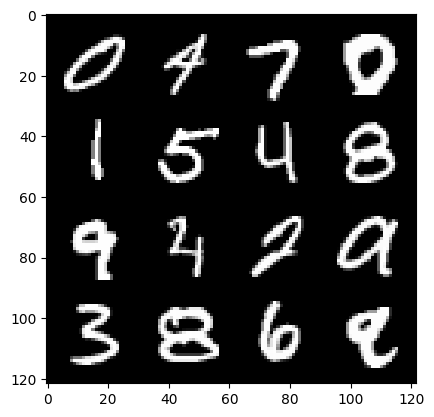

228: Step 107100 / Gen Loss : 1.8441824857393903 / Disc Loss : 0.28484688490629195


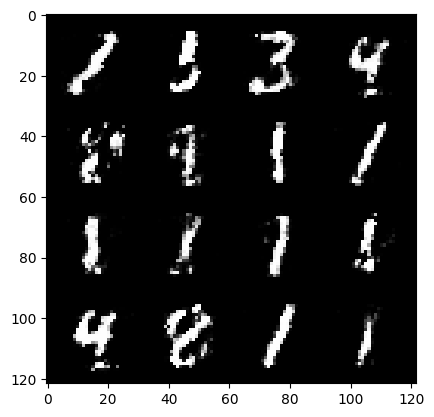

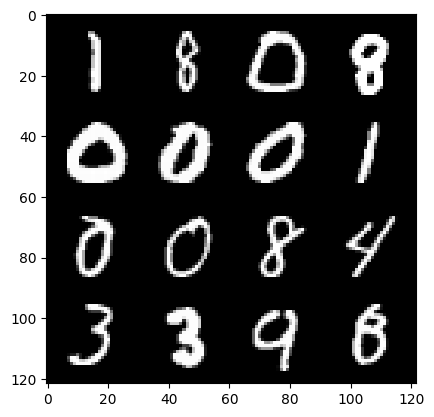

228: Step 107400 / Gen Loss : 2.0504929693539937 / Disc Loss : 0.25427291015783954


  0%|          | 0/469 [00:00<?, ?it/s]

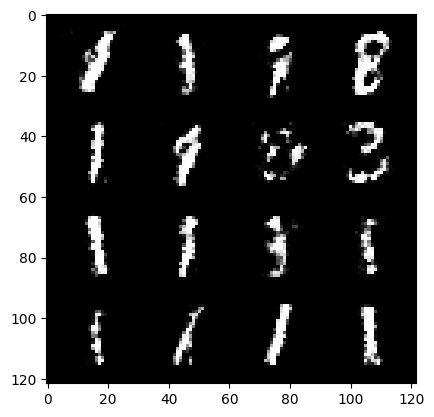

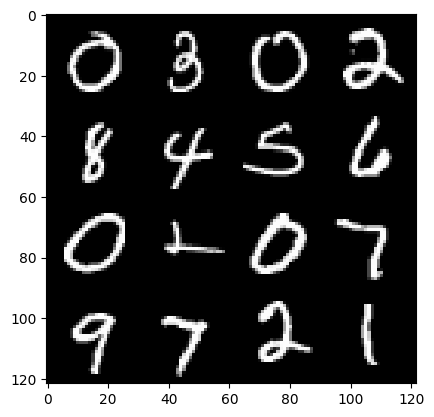

229: Step 107700 / Gen Loss : 2.1554147398471817 / Disc Loss : 0.24268469919761024


  0%|          | 0/469 [00:00<?, ?it/s]

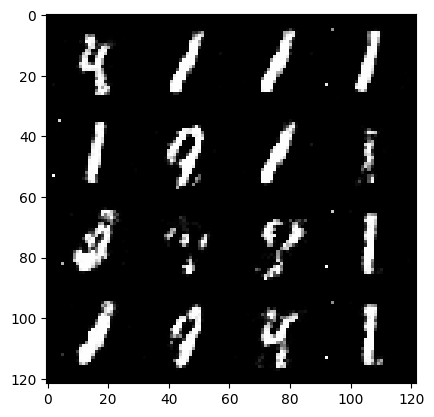

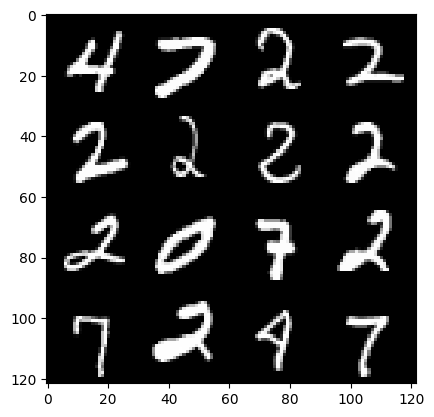

230: Step 108000 / Gen Loss : 1.9044137326876325 / Disc Loss : 0.2810649110873538


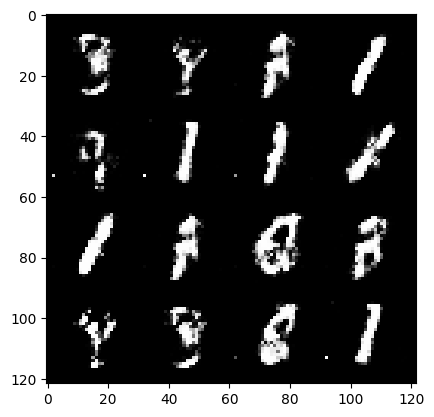

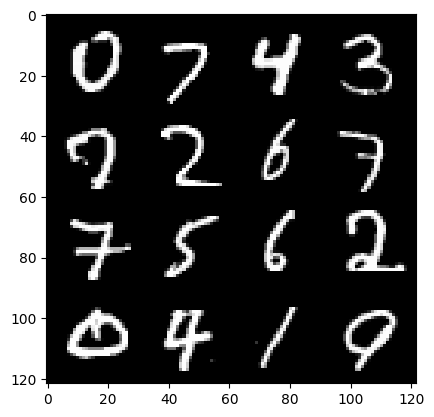

230: Step 108300 / Gen Loss : 1.8081988211472826 / Disc Loss : 0.2912352673709391


  0%|          | 0/469 [00:00<?, ?it/s]

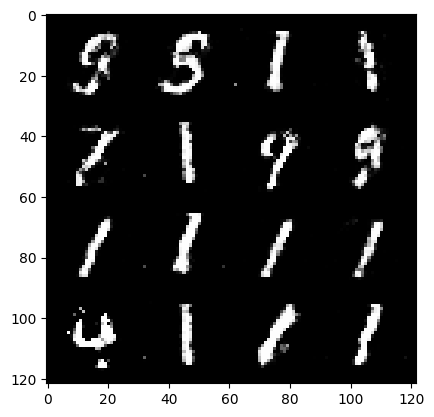

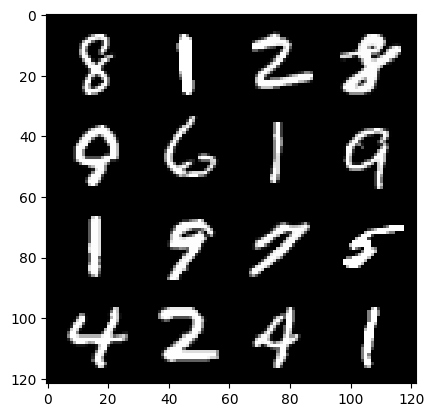

231: Step 108600 / Gen Loss : 1.9136326150099428 / Disc Loss : 0.2714149504403274


  0%|          | 0/469 [00:00<?, ?it/s]

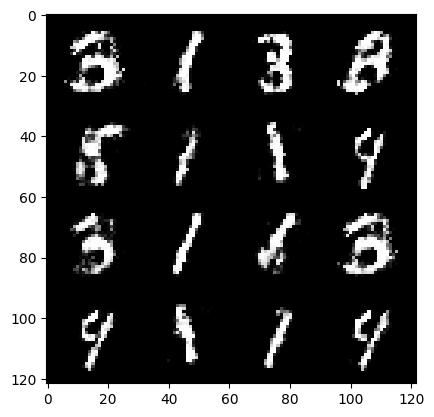

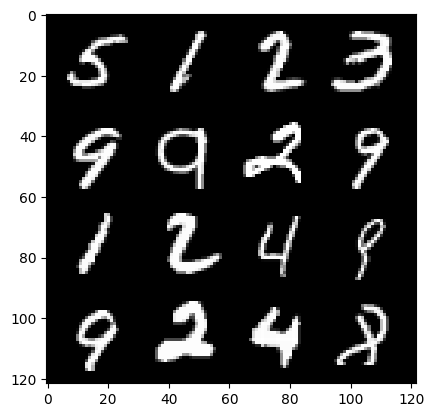

232: Step 108900 / Gen Loss : 1.9148305042584735 / Disc Loss : 0.2657376049955687


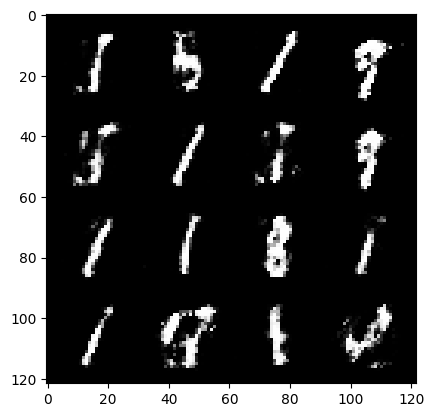

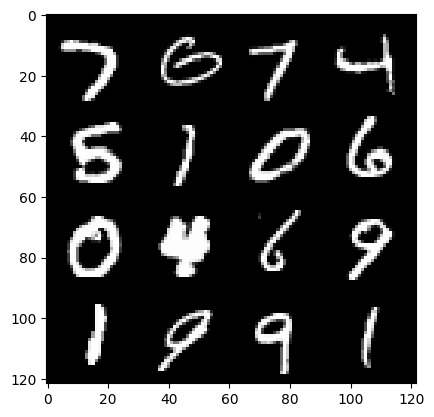

232: Step 109200 / Gen Loss : 1.9263669896125803 / Disc Loss : 0.2727771578232449


  0%|          | 0/469 [00:00<?, ?it/s]

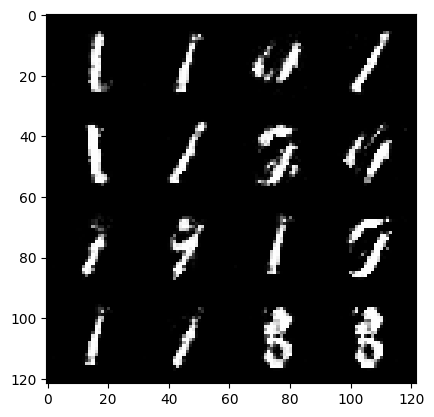

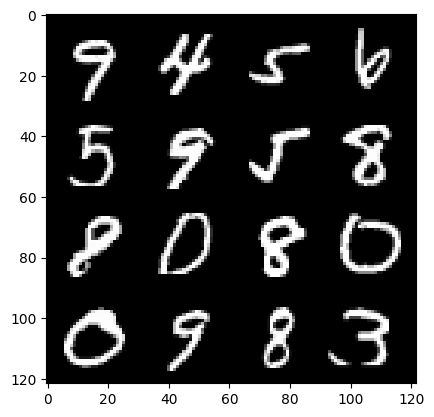

233: Step 109500 / Gen Loss : 1.931977758804957 / Disc Loss : 0.25366609583298355


  0%|          | 0/469 [00:00<?, ?it/s]

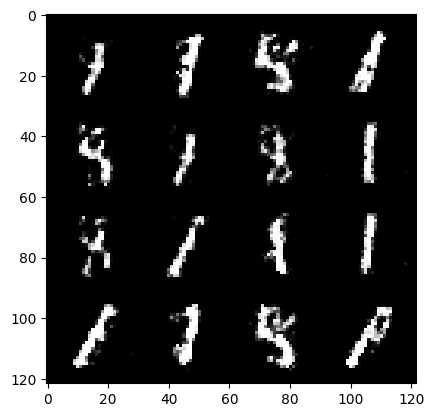

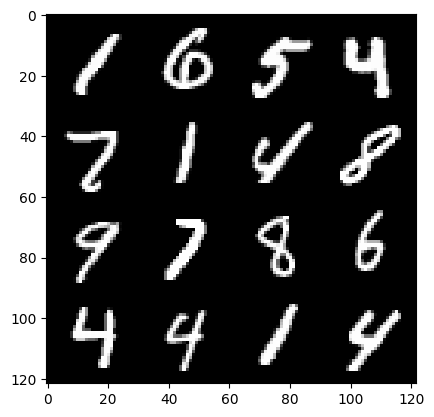

234: Step 109800 / Gen Loss : 2.0651970998446147 / Disc Loss : 0.2479323718945185


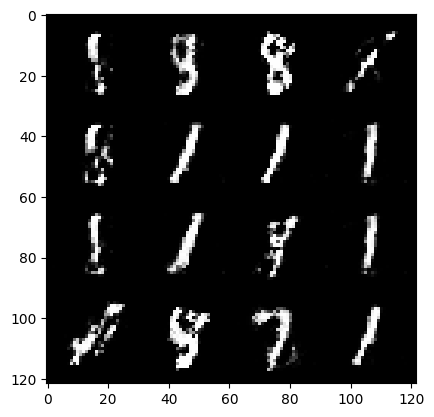

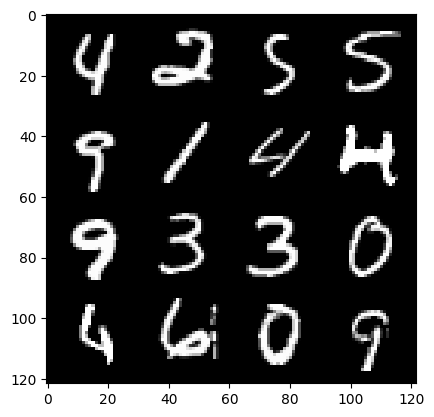

234: Step 110100 / Gen Loss : 2.044708114067714 / Disc Loss : 0.2468879994253316


  0%|          | 0/469 [00:00<?, ?it/s]

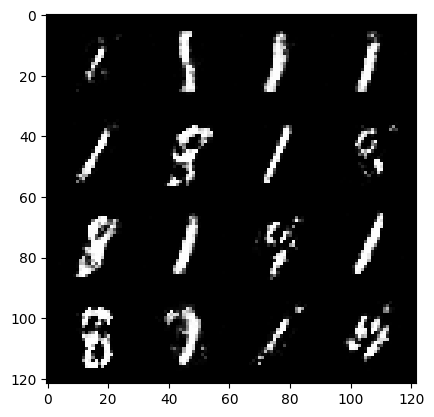

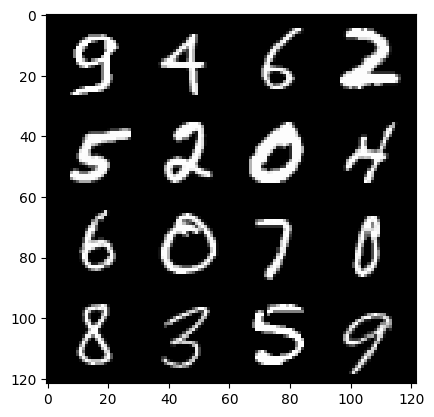

235: Step 110400 / Gen Loss : 2.0525722555319468 / Disc Loss : 0.23543493032455443


  0%|          | 0/469 [00:00<?, ?it/s]

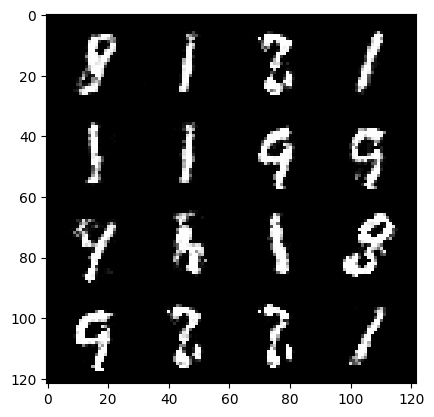

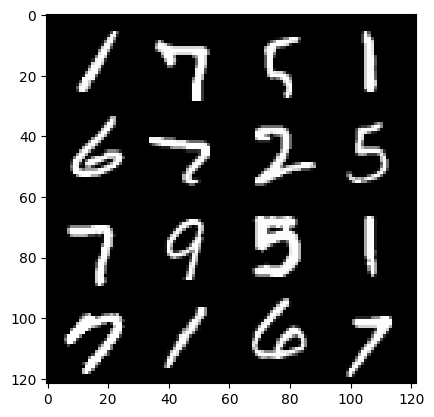

236: Step 110700 / Gen Loss : 1.9909650071461993 / Disc Loss : 0.25109953413407016


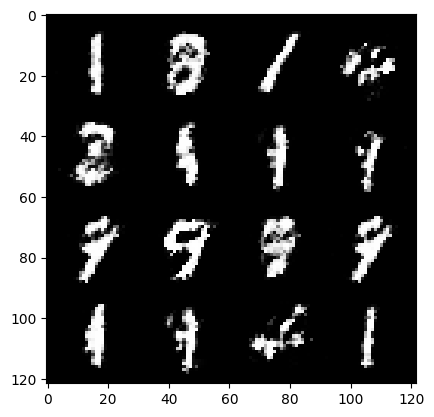

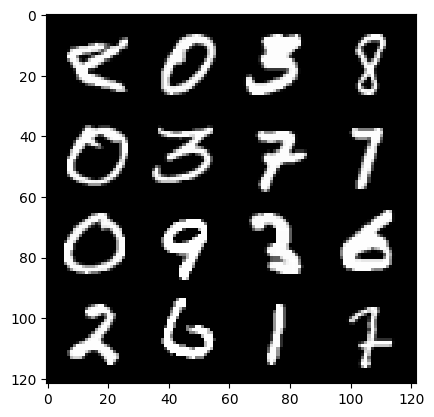

236: Step 111000 / Gen Loss : 2.0236302483081827 / Disc Loss : 0.2588447054227193


  0%|          | 0/469 [00:00<?, ?it/s]

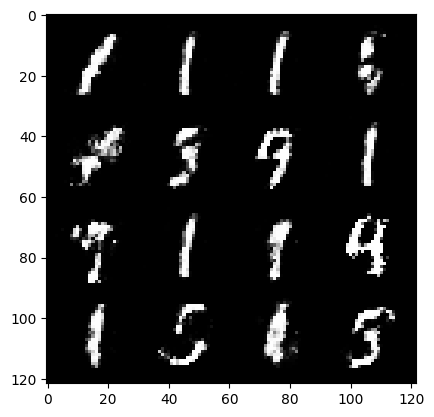

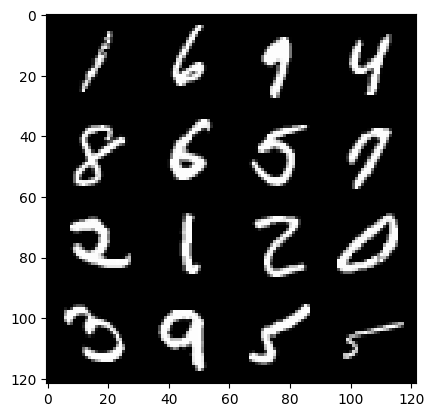

237: Step 111300 / Gen Loss : 1.923326159318289 / Disc Loss : 0.28340823074181876


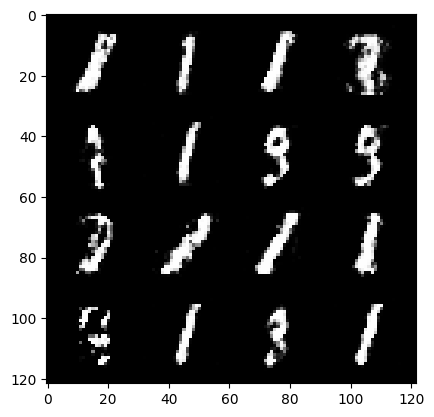

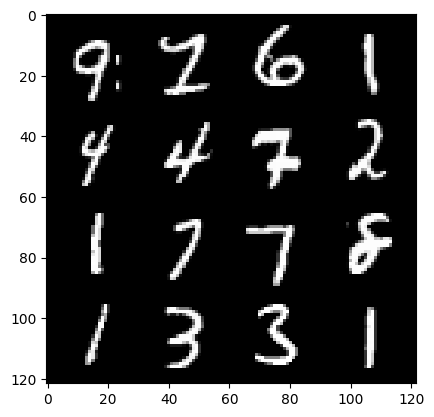

237: Step 111600 / Gen Loss : 2.0341507375240333 / Disc Loss : 0.26131793980797136


  0%|          | 0/469 [00:00<?, ?it/s]

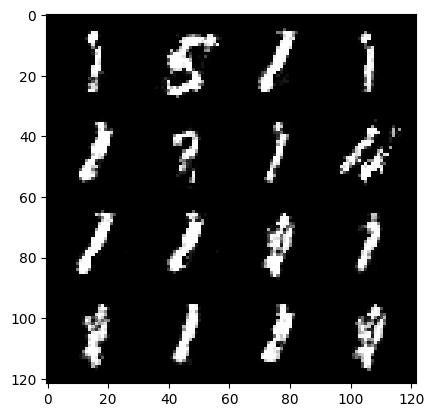

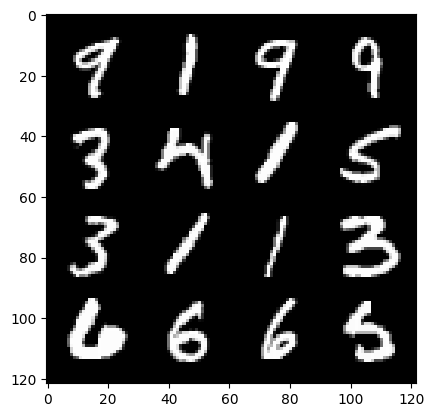

238: Step 111900 / Gen Loss : 2.125527383089066 / Disc Loss : 0.23898594180742916


  0%|          | 0/469 [00:00<?, ?it/s]

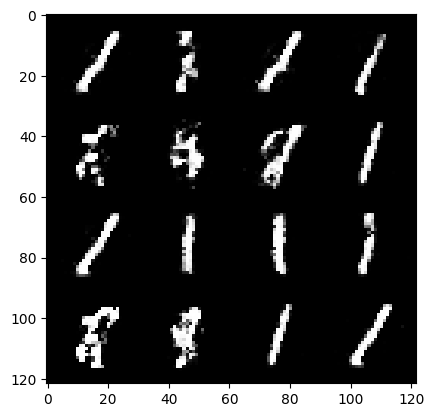

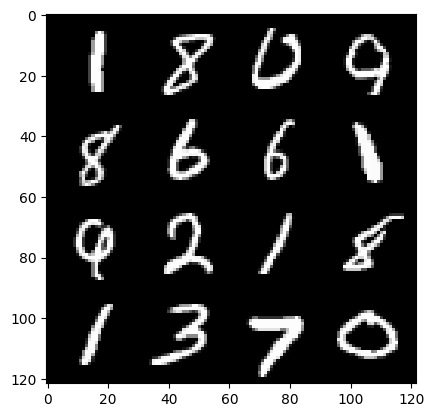

239: Step 112200 / Gen Loss : 2.1946469632784504 / Disc Loss : 0.23064776728550596


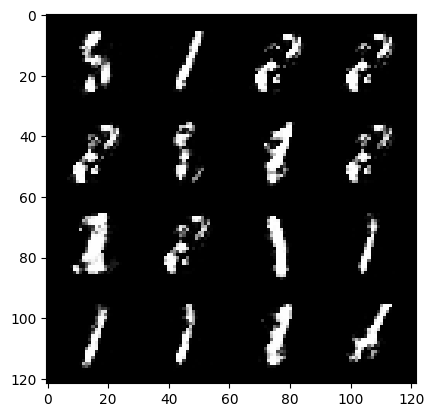

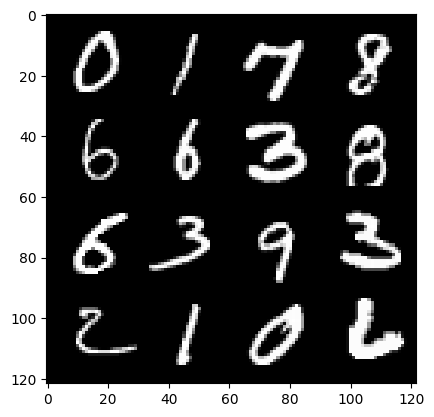

239: Step 112500 / Gen Loss : 2.1112530970573427 / Disc Loss : 0.24384235138694432


  0%|          | 0/469 [00:00<?, ?it/s]

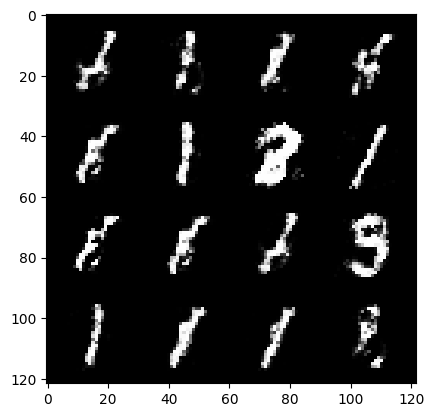

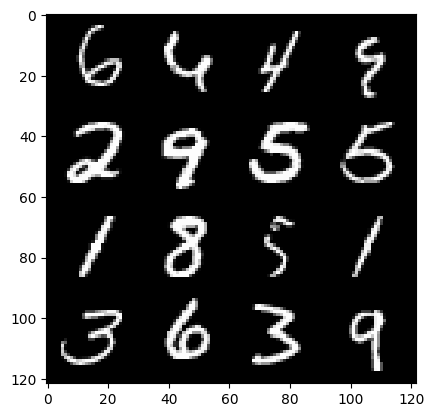

240: Step 112800 / Gen Loss : 2.0500404616196937 / Disc Loss : 0.2583170974254608


  0%|          | 0/469 [00:00<?, ?it/s]

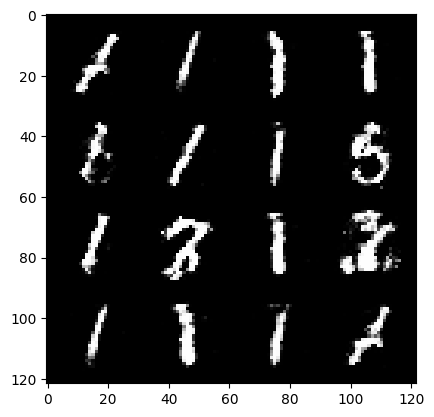

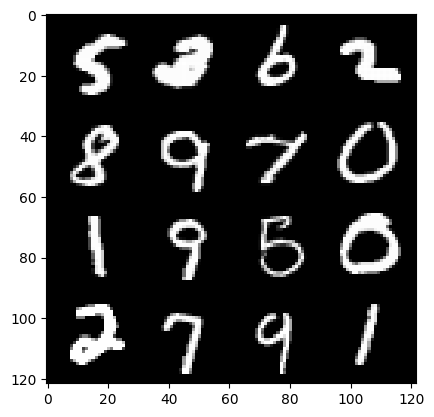

241: Step 113100 / Gen Loss : 2.0039020498593647 / Disc Loss : 0.25083307931820553


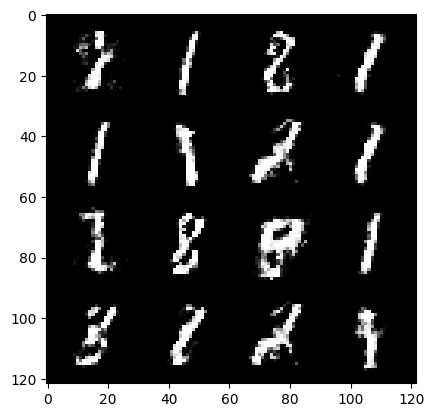

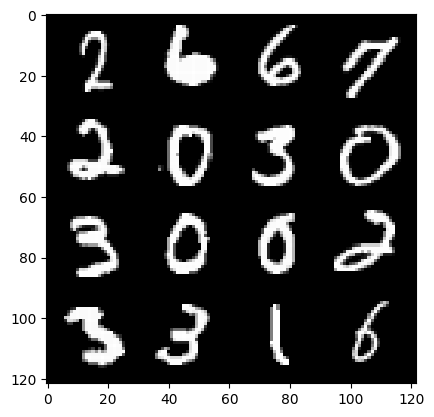

241: Step 113400 / Gen Loss : 2.0461987364292145 / Disc Loss : 0.24977676664789528


  0%|          | 0/469 [00:00<?, ?it/s]

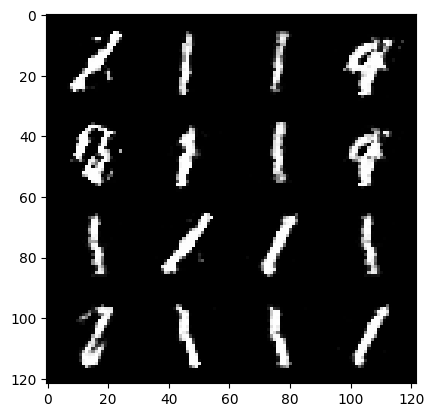

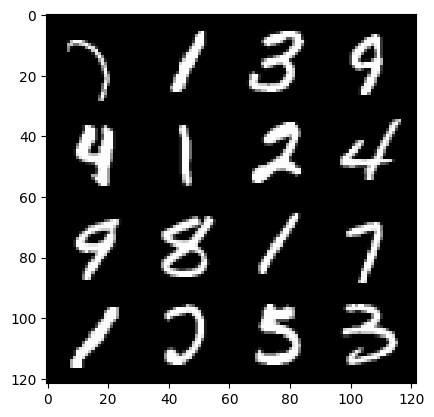

242: Step 113700 / Gen Loss : 1.962048795620601 / Disc Loss : 0.25888717974225667


  0%|          | 0/469 [00:00<?, ?it/s]

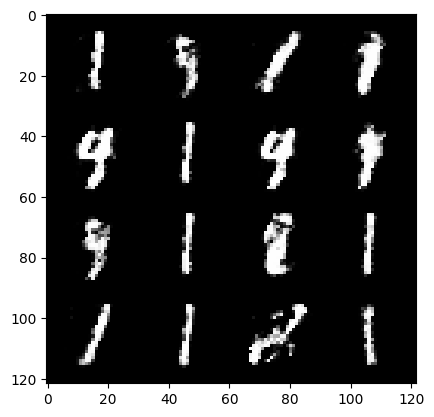

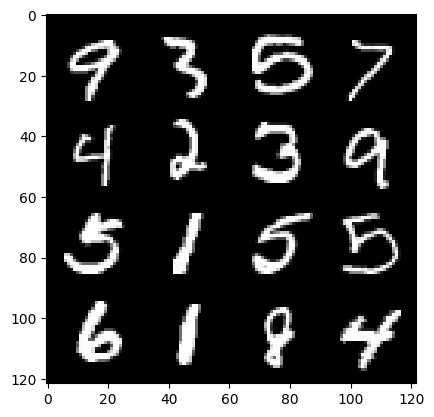

243: Step 114000 / Gen Loss : 1.9708593575159699 / Disc Loss : 0.26984910582502686


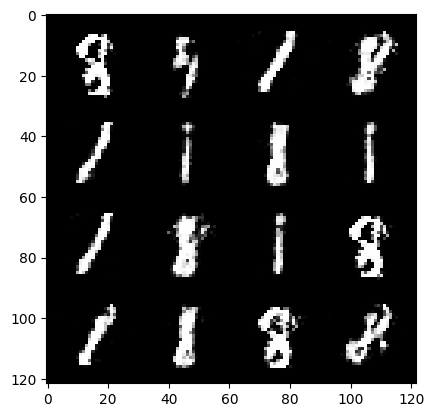

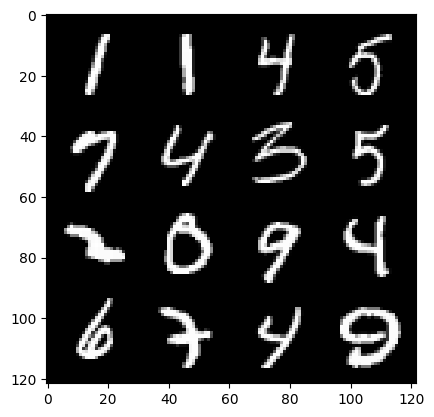

243: Step 114300 / Gen Loss : 2.0944607460498808 / Disc Loss : 0.2525107055902481


  0%|          | 0/469 [00:00<?, ?it/s]

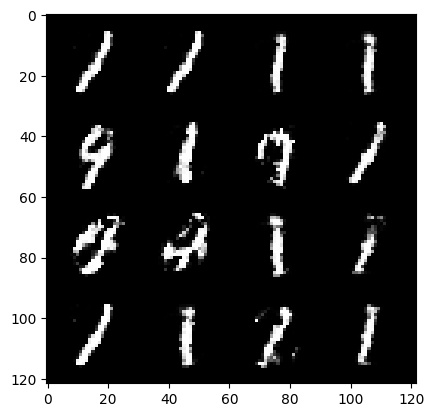

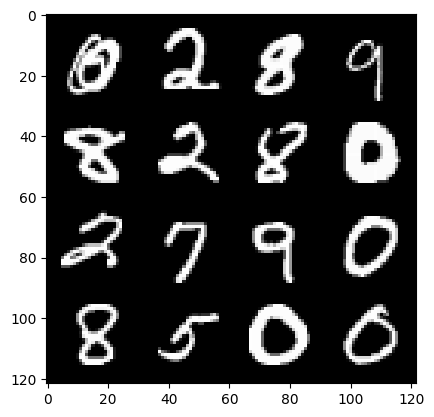

244: Step 114600 / Gen Loss : 2.1245103979110693 / Disc Loss : 0.24638641849160195


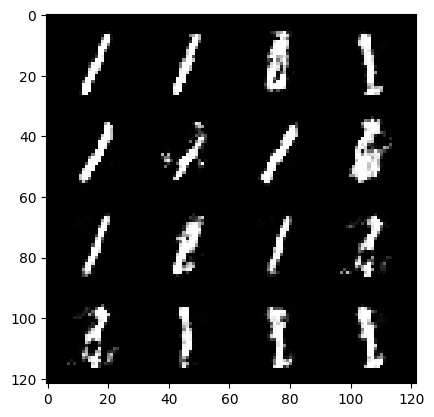

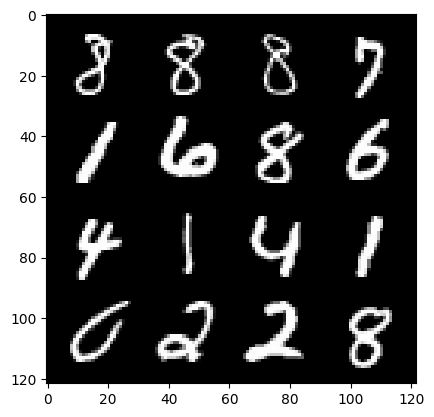

244: Step 114900 / Gen Loss : 2.0121262605984995 / Disc Loss : 0.24457507754365596


  0%|          | 0/469 [00:00<?, ?it/s]

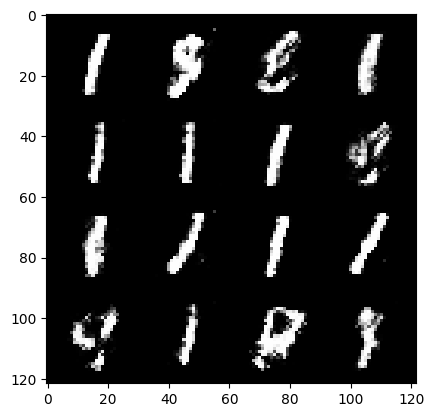

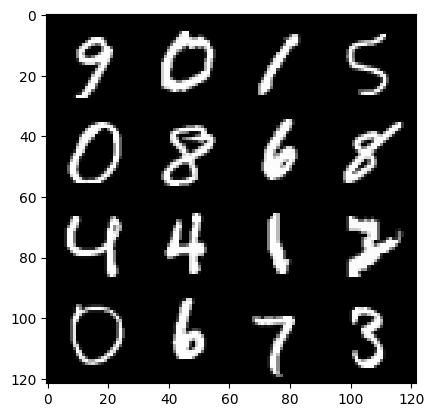

245: Step 115200 / Gen Loss : 2.1329197120666525 / Disc Loss : 0.23395476063092538


  0%|          | 0/469 [00:00<?, ?it/s]

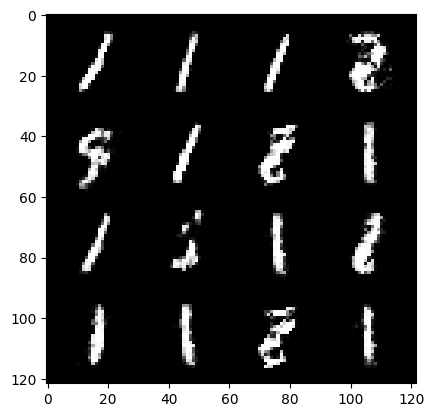

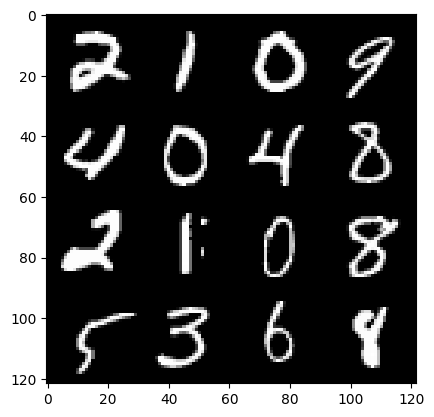

246: Step 115500 / Gen Loss : 2.118499349355698 / Disc Loss : 0.2628495969374974


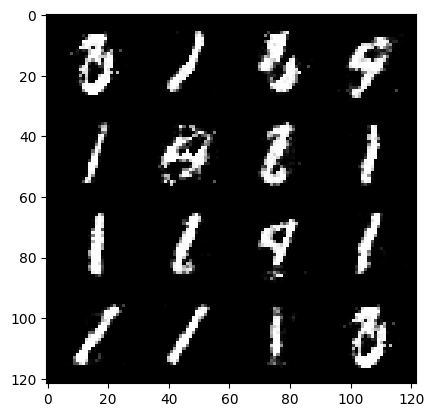

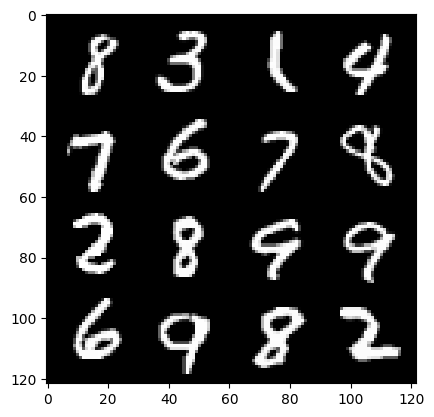

246: Step 115800 / Gen Loss : 1.985277062257129 / Disc Loss : 0.2679321777820586


  0%|          | 0/469 [00:00<?, ?it/s]

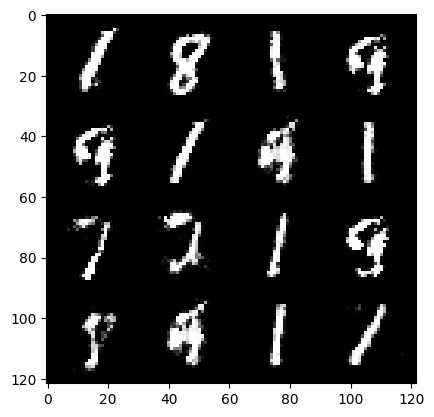

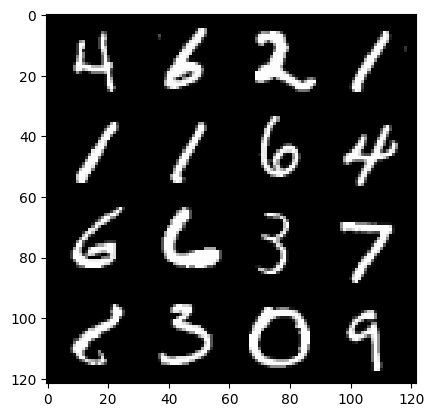

247: Step 116100 / Gen Loss : 1.953243384758631 / Disc Loss : 0.27221555262804026


  0%|          | 0/469 [00:00<?, ?it/s]

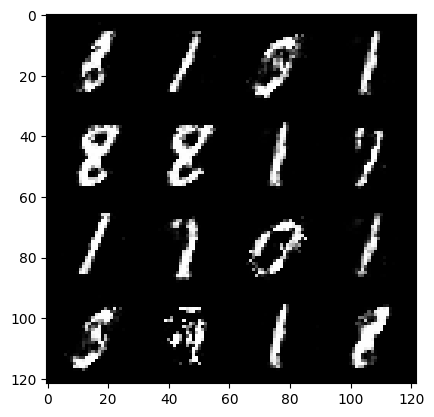

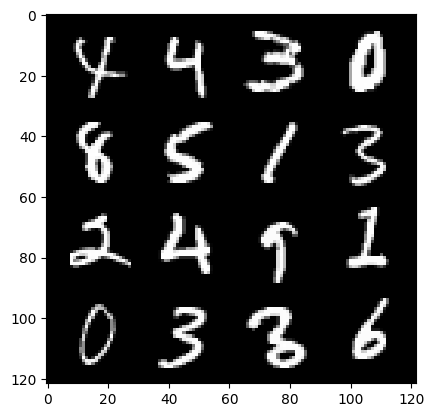

248: Step 116400 / Gen Loss : 1.862063467899959 / Disc Loss : 0.2740541761120162


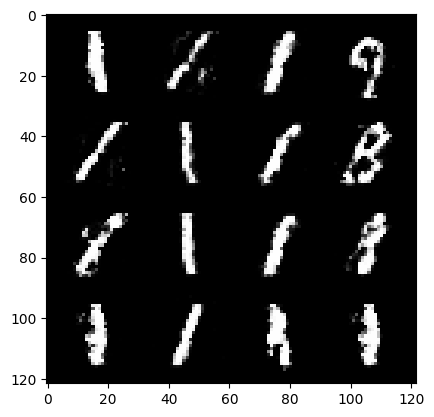

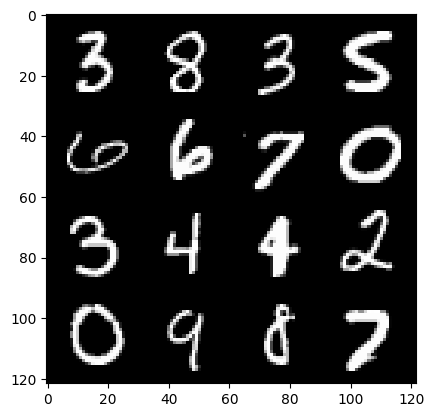

248: Step 116700 / Gen Loss : 1.9056782778104138 / Disc Loss : 0.27139863555630067


  0%|          | 0/469 [00:00<?, ?it/s]

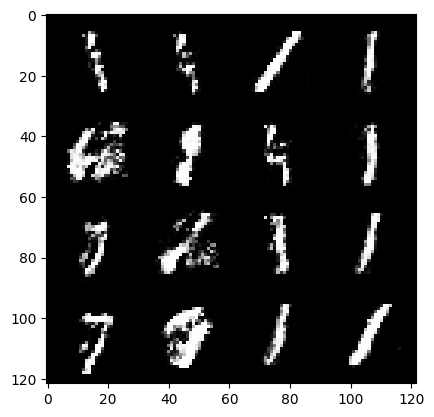

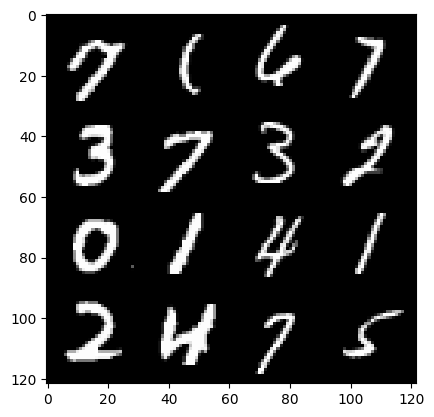

249: Step 117000 / Gen Loss : 2.03050836443901 / Disc Loss : 0.26206737716992695


  0%|          | 0/469 [00:00<?, ?it/s]

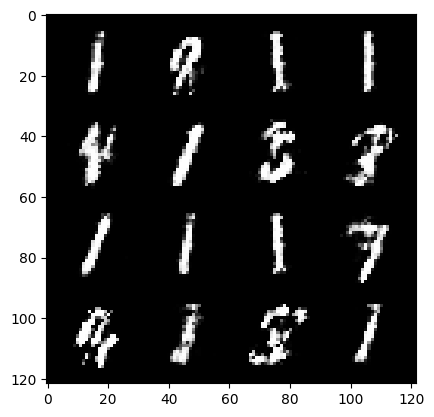

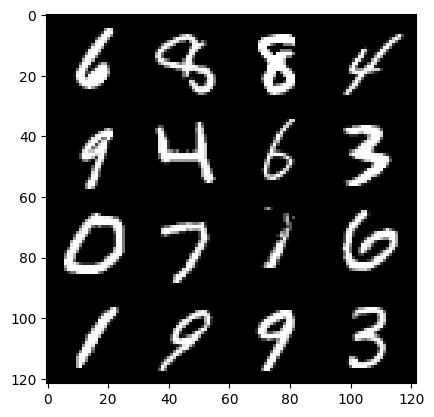

250: Step 117300 / Gen Loss : 1.9739924558003752 / Disc Loss : 0.2714014376699923


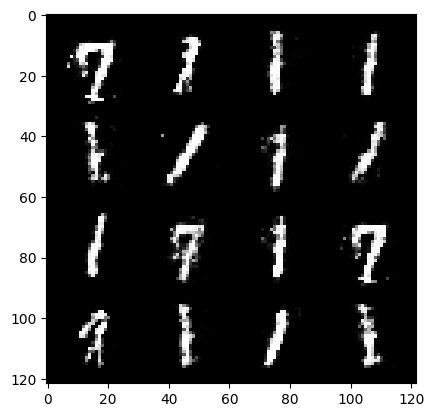

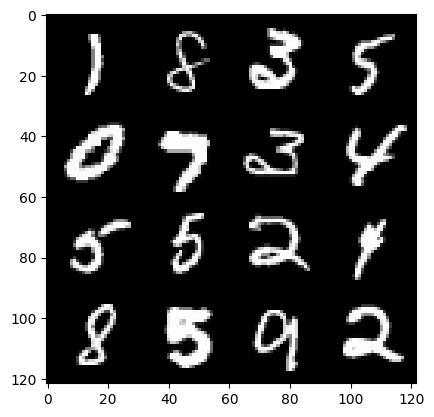

250: Step 117600 / Gen Loss : 2.114039022127787 / Disc Loss : 0.2448983841637771


  0%|          | 0/469 [00:00<?, ?it/s]

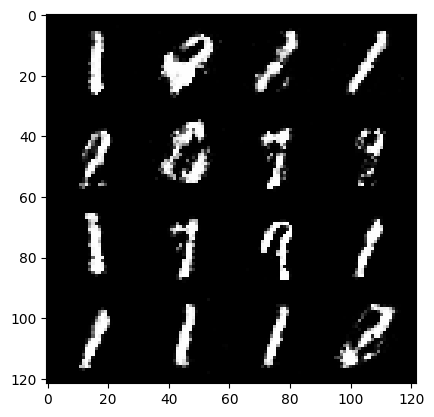

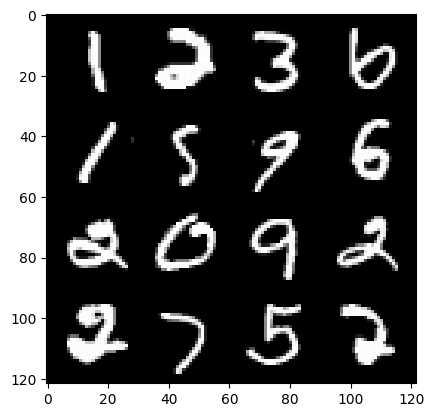

251: Step 117900 / Gen Loss : 1.9962450353304537 / Disc Loss : 0.26202812472979226


  0%|          | 0/469 [00:00<?, ?it/s]

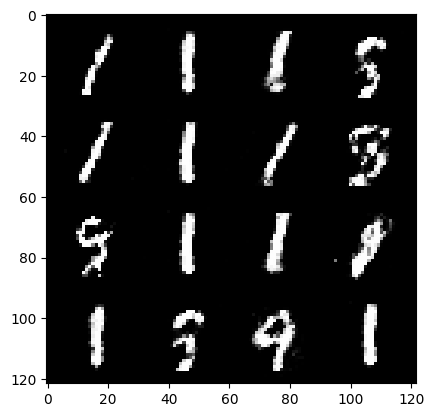

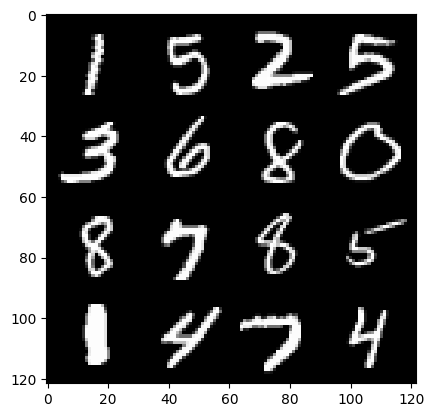

252: Step 118200 / Gen Loss : 2.115731116930644 / Disc Loss : 0.23947491784890496


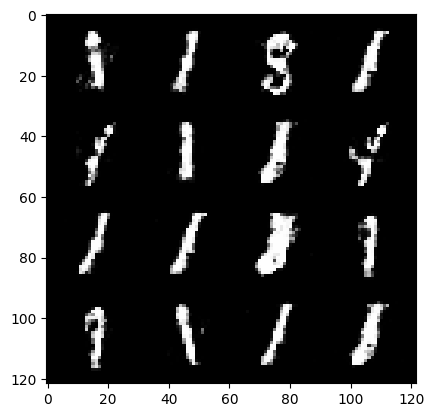

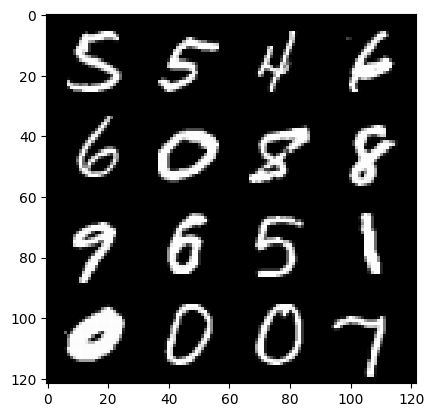

252: Step 118500 / Gen Loss : 2.062563031514485 / Disc Loss : 0.25354007860024774


  0%|          | 0/469 [00:00<?, ?it/s]

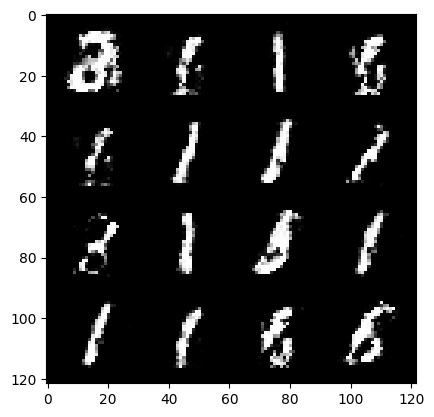

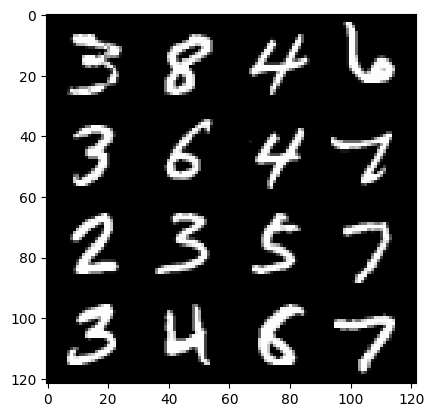

253: Step 118800 / Gen Loss : 2.171312888065972 / Disc Loss : 0.22482063919305809


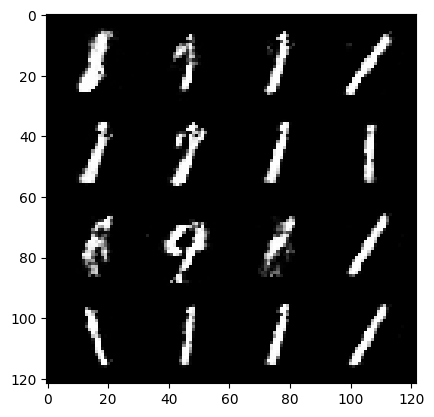

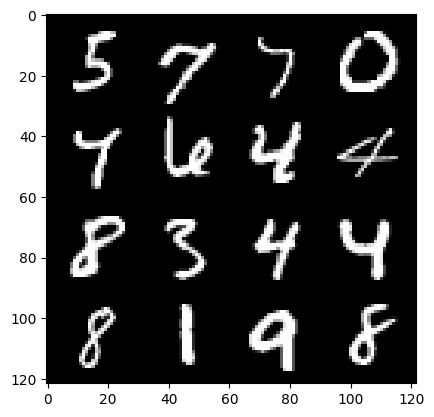

253: Step 119100 / Gen Loss : 2.108319165706636 / Disc Loss : 0.23149910201629


  0%|          | 0/469 [00:00<?, ?it/s]

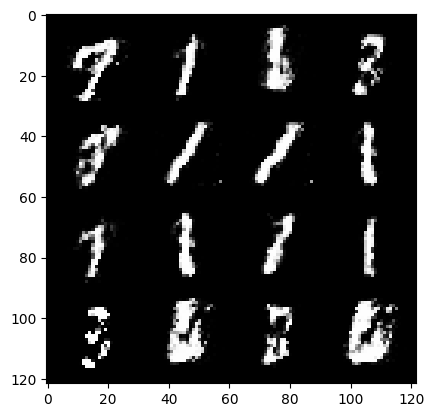

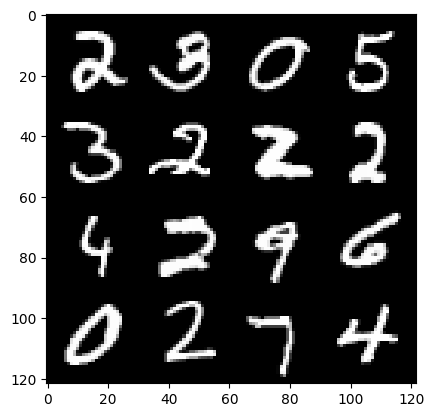

254: Step 119400 / Gen Loss : 2.1518101771672575 / Disc Loss : 0.23793350487947454


  0%|          | 0/469 [00:00<?, ?it/s]

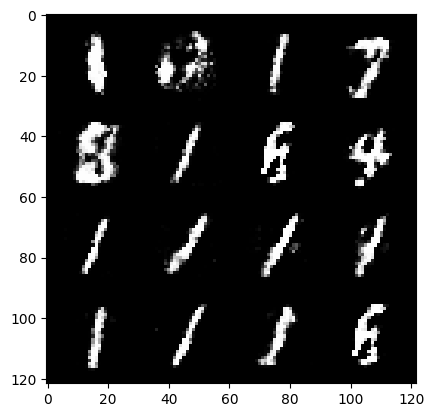

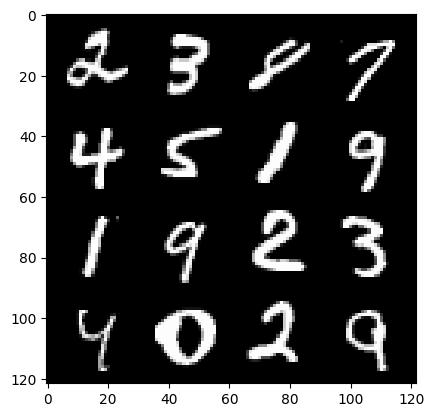

255: Step 119700 / Gen Loss : 2.1250644548734026 / Disc Loss : 0.25355565175414085


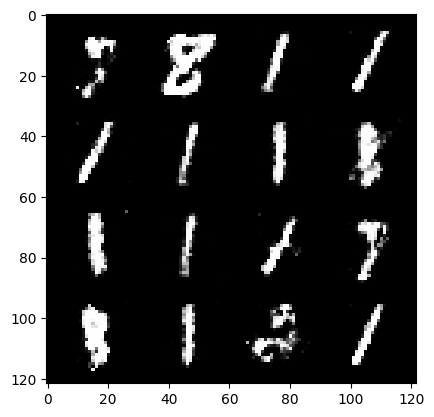

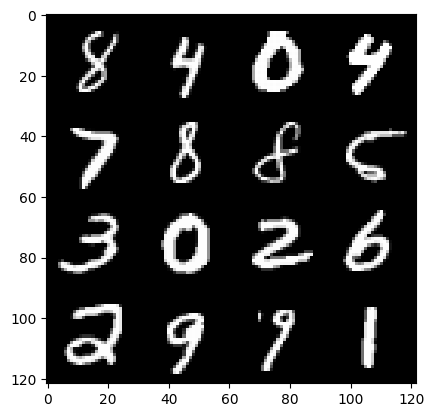

255: Step 120000 / Gen Loss : 2.0616563626130424 / Disc Loss : 0.2449319273233414


  0%|          | 0/469 [00:00<?, ?it/s]

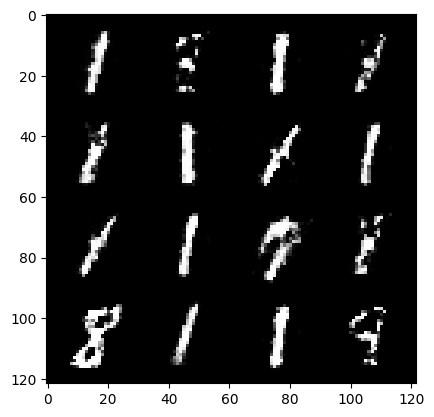

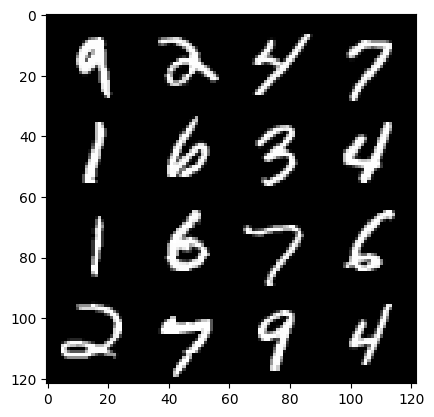

256: Step 120300 / Gen Loss : 2.119530632495881 / Disc Loss : 0.22427217905720062


  0%|          | 0/469 [00:00<?, ?it/s]

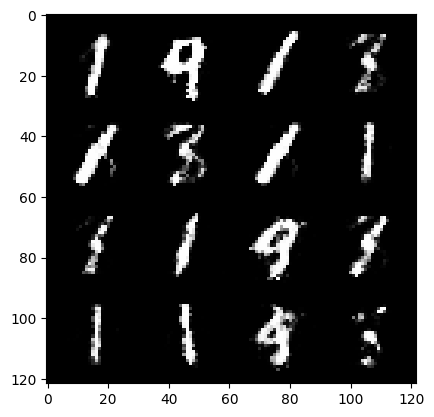

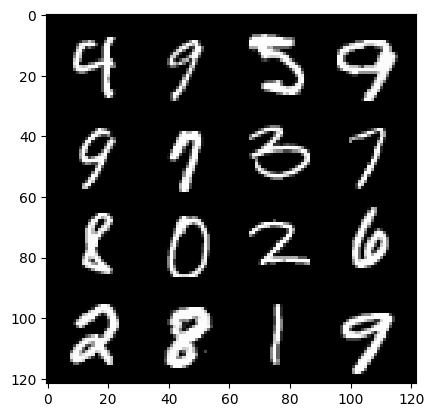

257: Step 120600 / Gen Loss : 2.0321100342273715 / Disc Loss : 0.25382093399763117


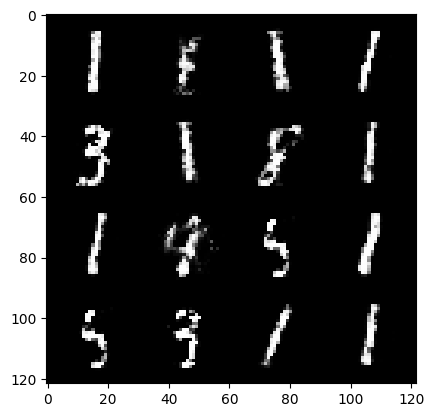

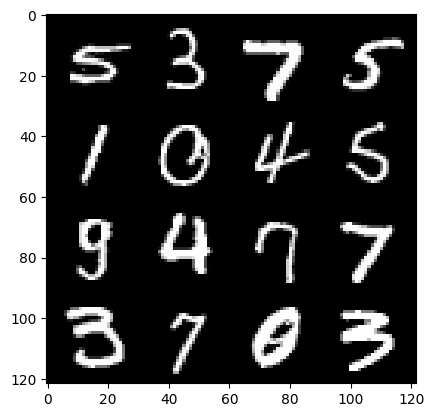

257: Step 120900 / Gen Loss : 1.9476199197769164 / Disc Loss : 0.25962172026435526


  0%|          | 0/469 [00:00<?, ?it/s]

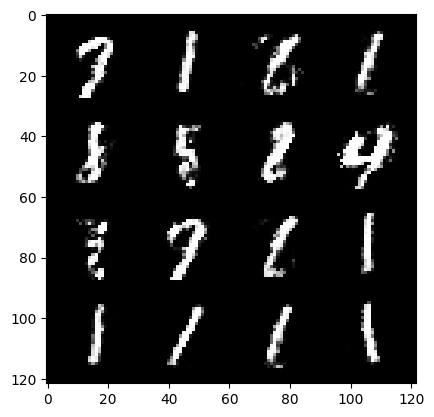

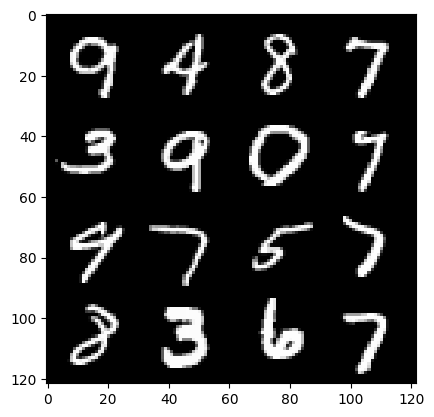

258: Step 121200 / Gen Loss : 1.9522803274790441 / Disc Loss : 0.2584447974463305


  0%|          | 0/469 [00:00<?, ?it/s]

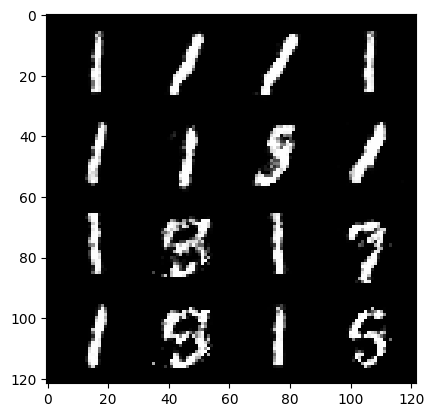

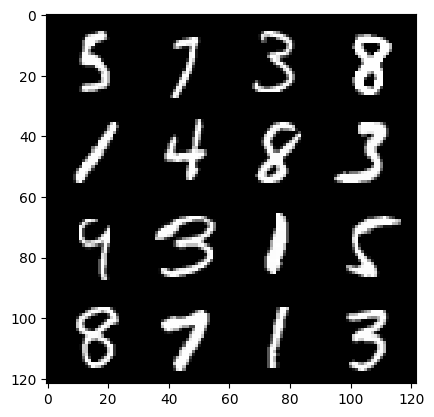

259: Step 121500 / Gen Loss : 1.9081796590487172 / Disc Loss : 0.2779508227109908


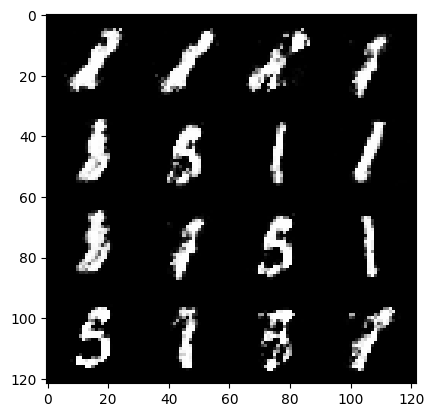

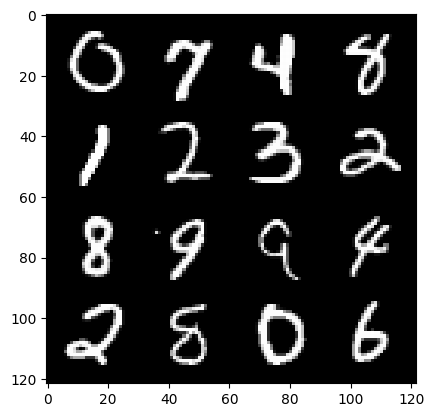

259: Step 121800 / Gen Loss : 2.061902082761128 / Disc Loss : 0.2640934713681541


  0%|          | 0/469 [00:00<?, ?it/s]

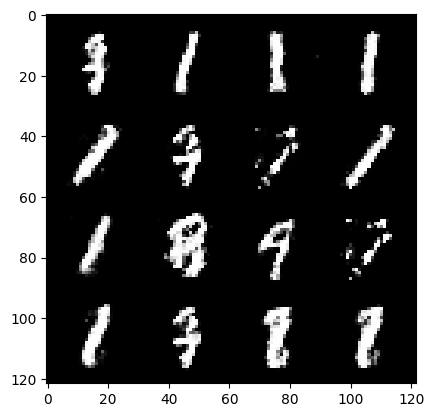

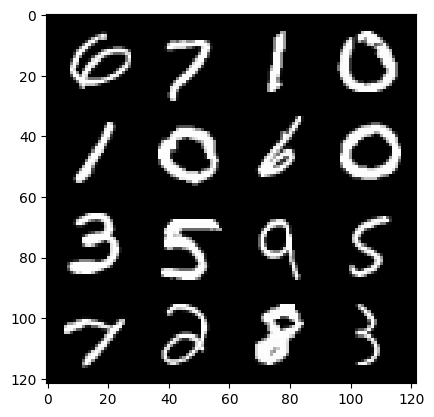

260: Step 122100 / Gen Loss : 2.1585306489467615 / Disc Loss : 0.25185600300629923


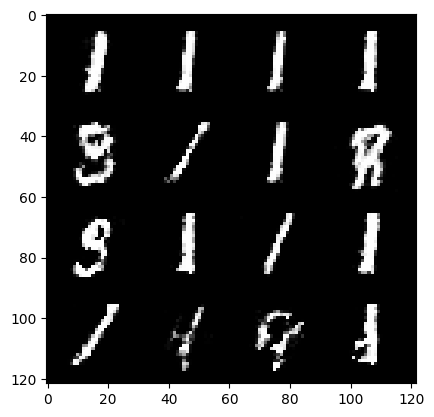

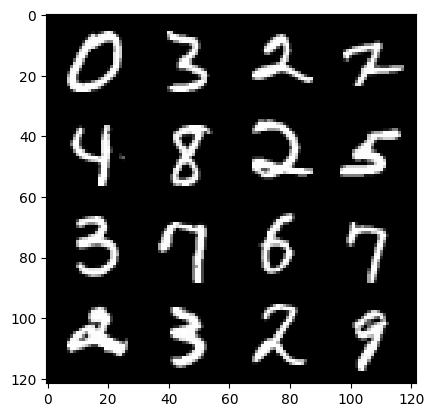

260: Step 122400 / Gen Loss : 2.0984711865584065 / Disc Loss : 0.24528650557001425


  0%|          | 0/469 [00:00<?, ?it/s]

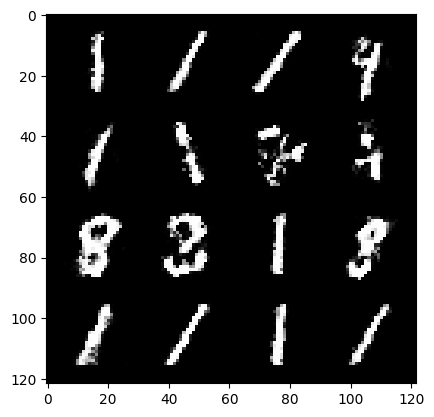

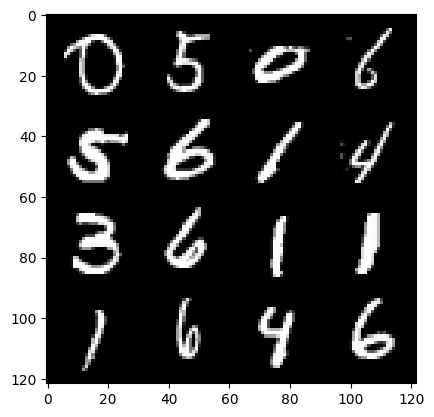

261: Step 122700 / Gen Loss : 2.0497348694006603 / Disc Loss : 0.25339155967036864


  0%|          | 0/469 [00:00<?, ?it/s]

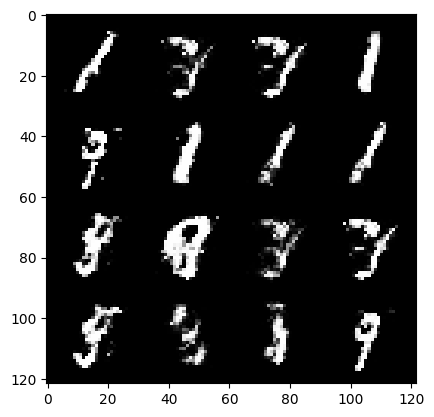

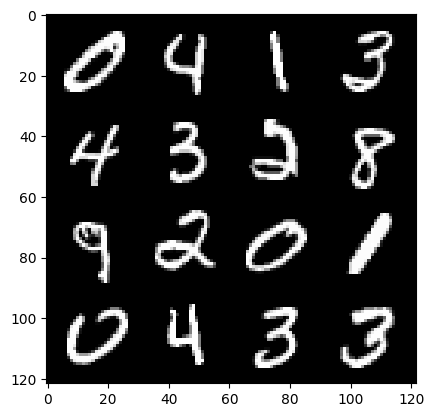

262: Step 123000 / Gen Loss : 2.0847917624314625 / Disc Loss : 0.2561951970557372


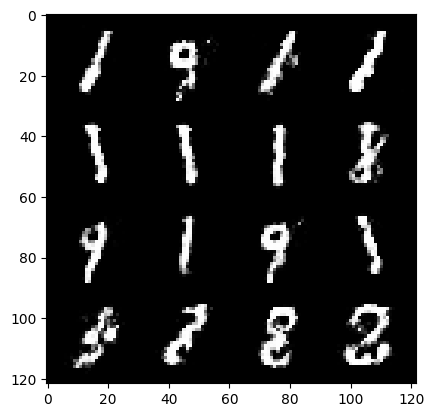

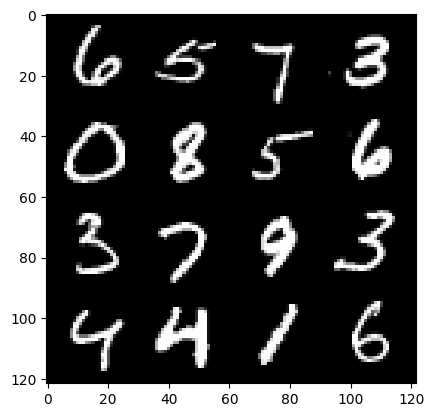

262: Step 123300 / Gen Loss : 2.0545738681157433 / Disc Loss : 0.24664335017402972


  0%|          | 0/469 [00:00<?, ?it/s]

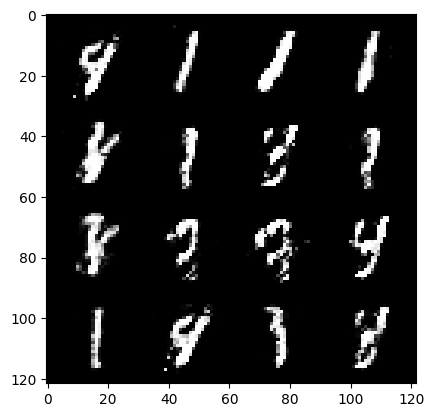

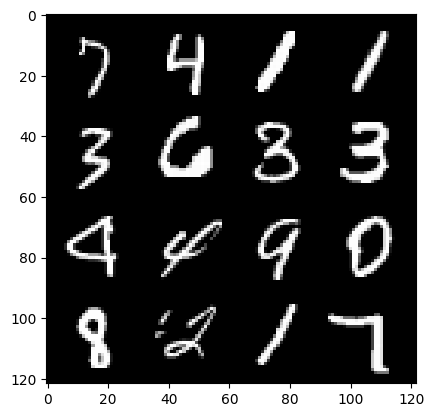

263: Step 123600 / Gen Loss : 1.9850575554370884 / Disc Loss : 0.26146601776281986


  0%|          | 0/469 [00:00<?, ?it/s]

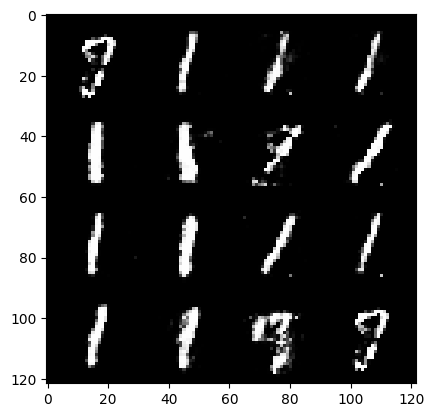

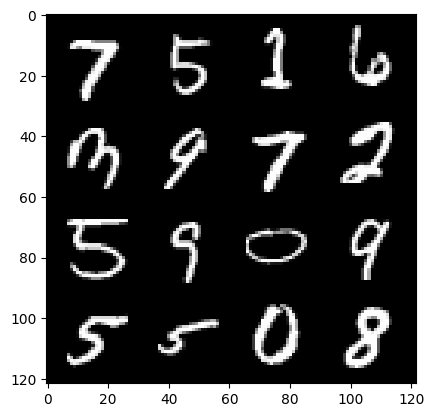

264: Step 123900 / Gen Loss : 2.0088576495647437 / Disc Loss : 0.2607831696172555


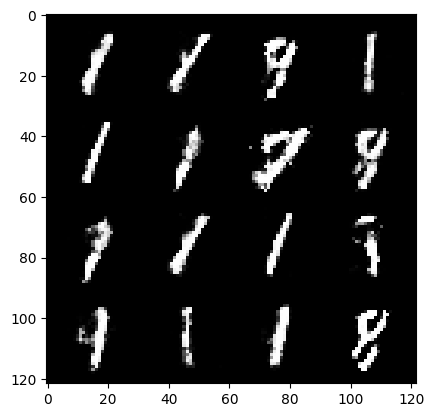

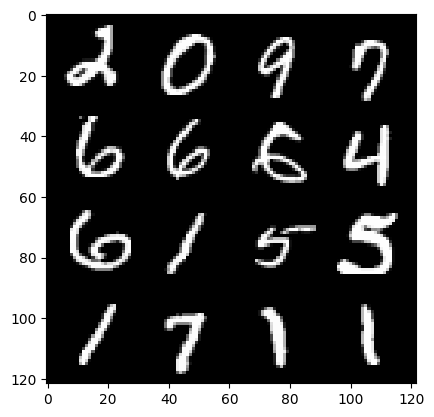

264: Step 124200 / Gen Loss : 2.036450751622518 / Disc Loss : 0.25195634543895723


  0%|          | 0/469 [00:00<?, ?it/s]

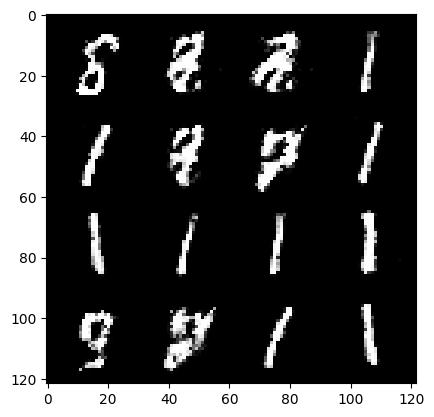

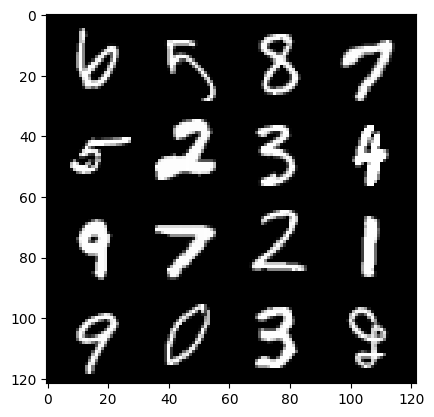

265: Step 124500 / Gen Loss : 2.05369152824084 / Disc Loss : 0.24923737590511652


  0%|          | 0/469 [00:00<?, ?it/s]

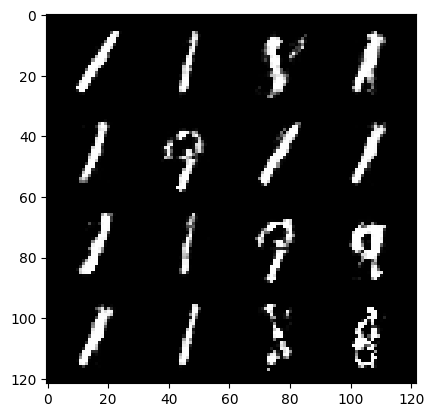

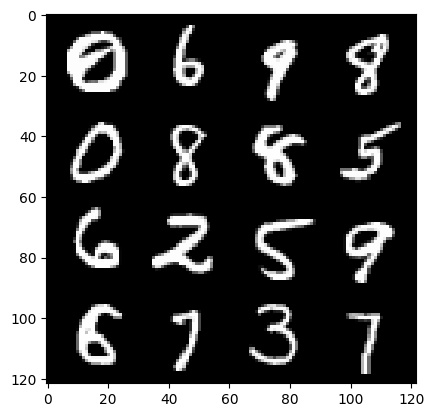

266: Step 124800 / Gen Loss : 2.016684916416805 / Disc Loss : 0.253006981164217


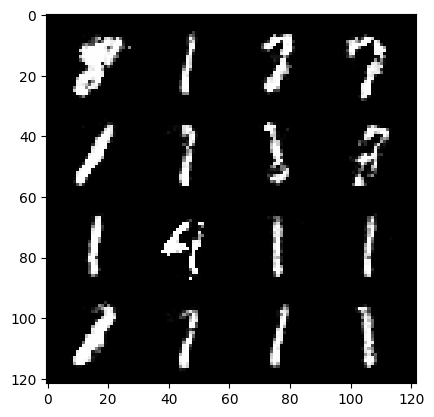

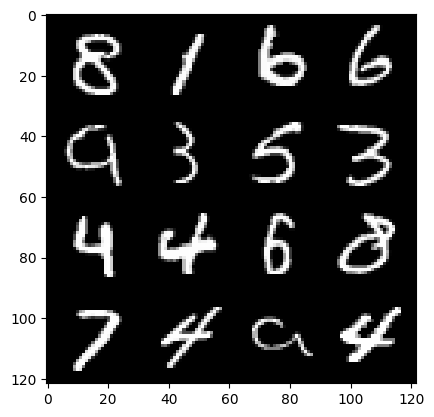

266: Step 125100 / Gen Loss : 1.9538176226615902 / Disc Loss : 0.2585359516739844


  0%|          | 0/469 [00:00<?, ?it/s]

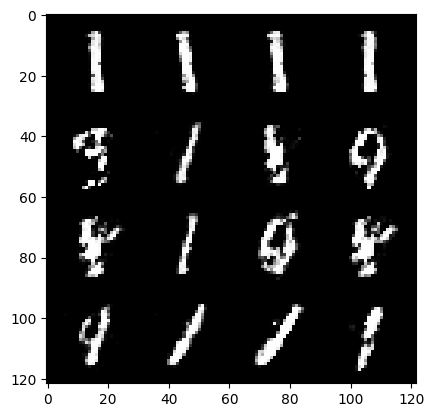

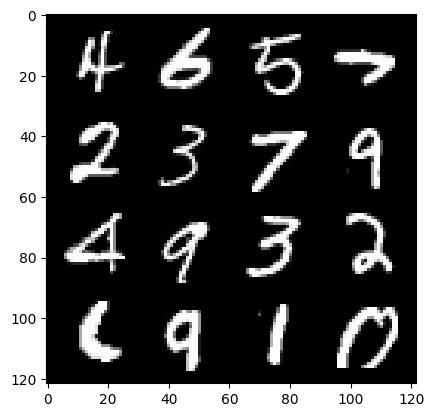

267: Step 125400 / Gen Loss : 1.9275839499632512 / Disc Loss : 0.2754012815157572


  0%|          | 0/469 [00:00<?, ?it/s]

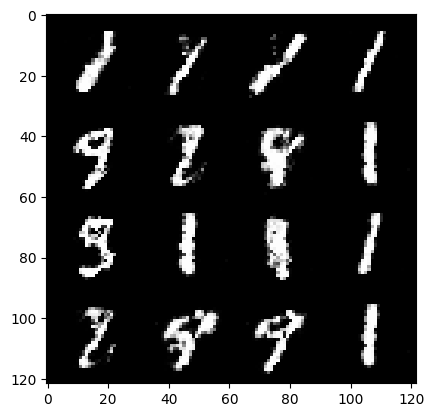

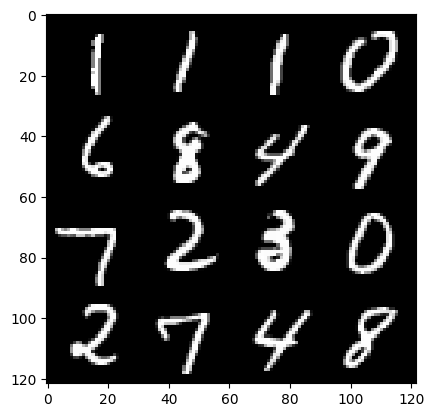

268: Step 125700 / Gen Loss : 1.9633485945065836 / Disc Loss : 0.27782705103357624


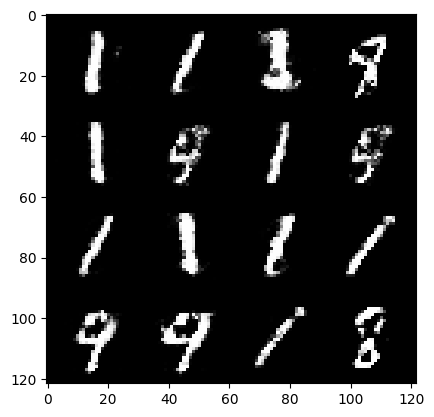

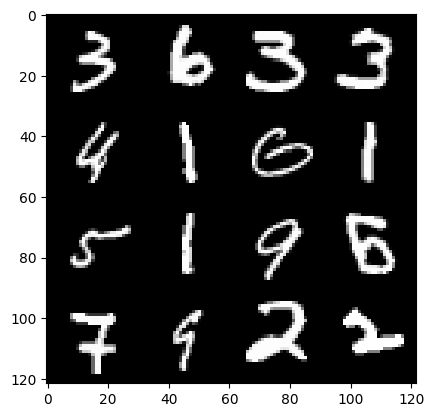

268: Step 126000 / Gen Loss : 1.9552633210023234 / Disc Loss : 0.27223677044113476


  0%|          | 0/469 [00:00<?, ?it/s]

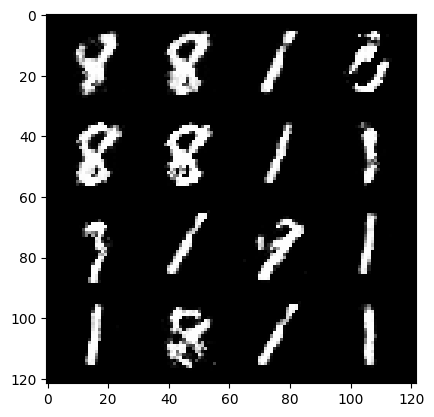

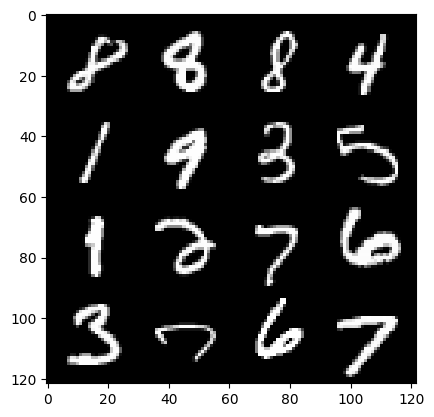

269: Step 126300 / Gen Loss : 1.9842440958817789 / Disc Loss : 0.270403508991003


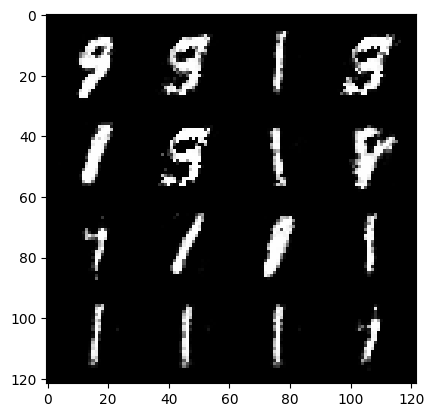

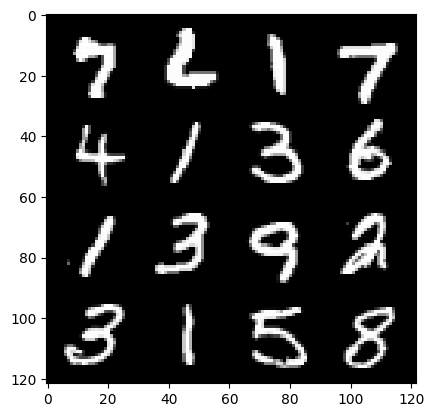

269: Step 126600 / Gen Loss : 1.9899361968040452 / Disc Loss : 0.2716809670130412


  0%|          | 0/469 [00:00<?, ?it/s]

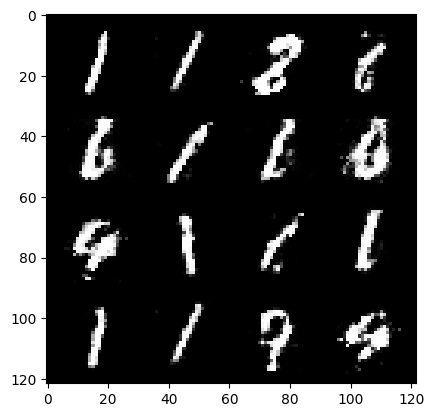

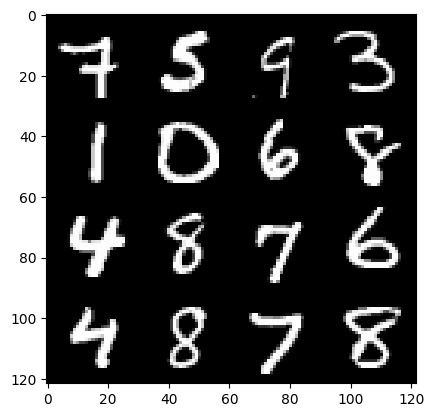

270: Step 126900 / Gen Loss : 2.014356104532878 / Disc Loss : 0.2606938747068247


  0%|          | 0/469 [00:00<?, ?it/s]

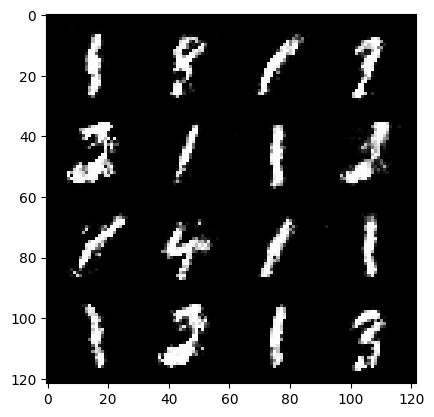

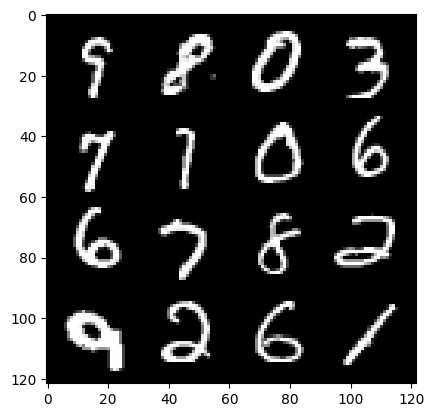

271: Step 127200 / Gen Loss : 2.0124207234382627 / Disc Loss : 0.26119521389404926


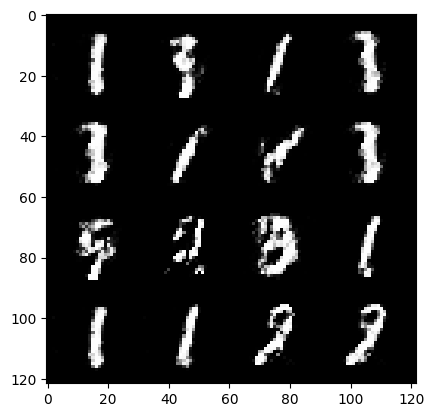

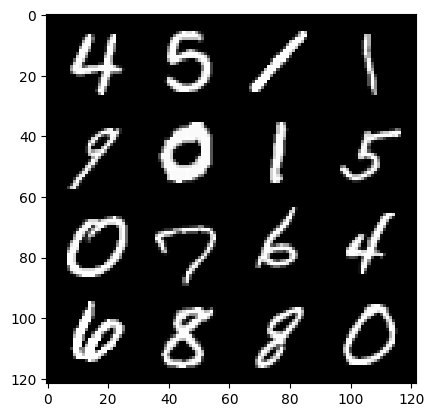

271: Step 127500 / Gen Loss : 1.9790904041131334 / Disc Loss : 0.26968030755718553


  0%|          | 0/469 [00:00<?, ?it/s]

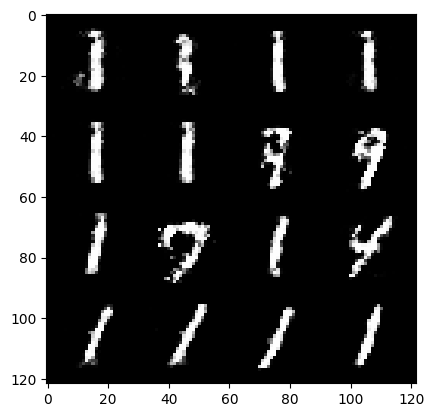

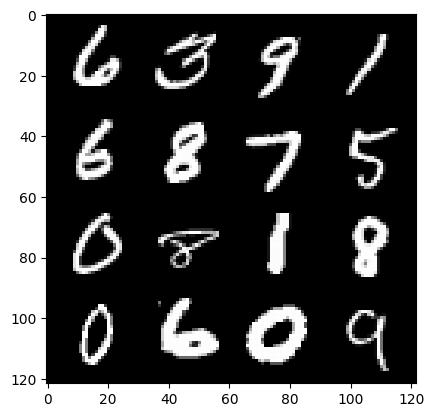

272: Step 127800 / Gen Loss : 2.0867501533031474 / Disc Loss : 0.2613334600130718


  0%|          | 0/469 [00:00<?, ?it/s]

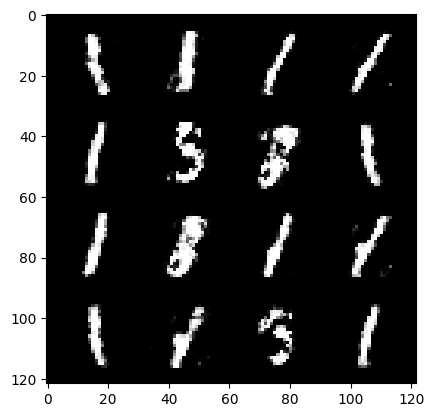

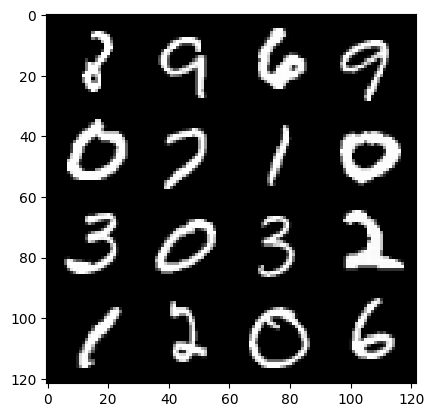

273: Step 128100 / Gen Loss : 2.055462330182394 / Disc Loss : 0.25627300207813575


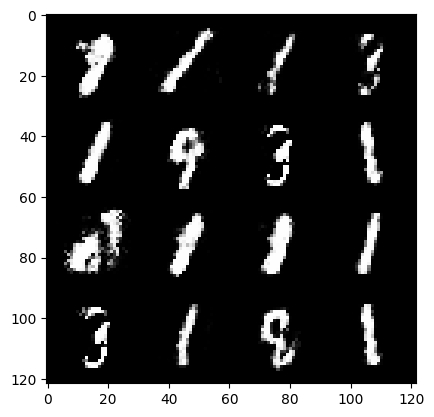

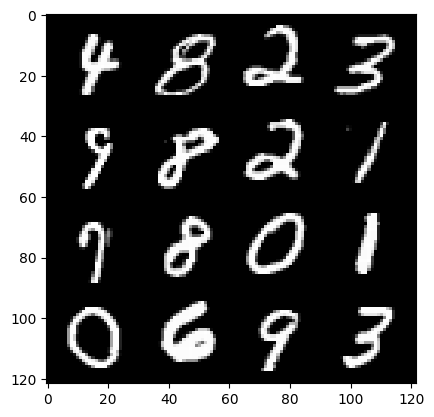

273: Step 128400 / Gen Loss : 2.015885595083238 / Disc Loss : 0.2560249569018682


  0%|          | 0/469 [00:00<?, ?it/s]

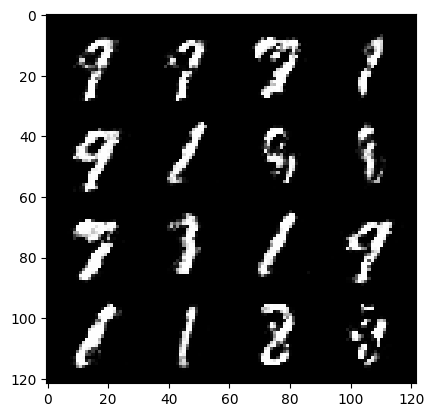

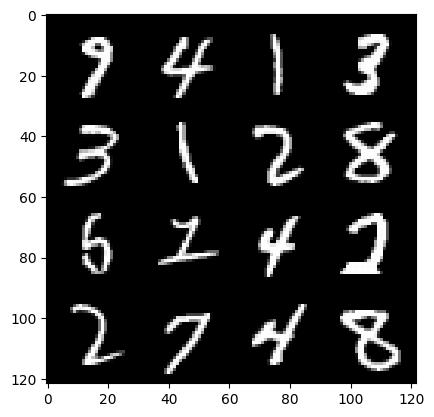

274: Step 128700 / Gen Loss : 2.070193586349488 / Disc Loss : 0.24614927306771286


  0%|          | 0/469 [00:00<?, ?it/s]

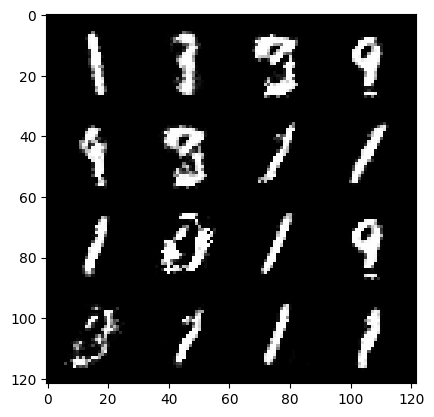

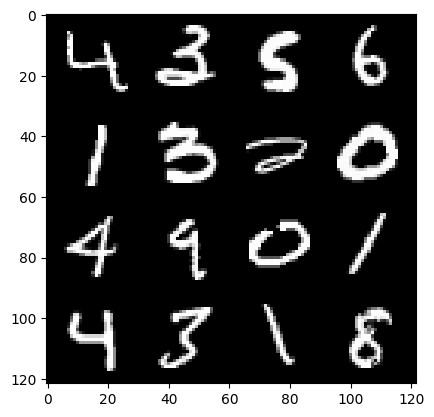

275: Step 129000 / Gen Loss : 2.0707072556018837 / Disc Loss : 0.2533695057531198


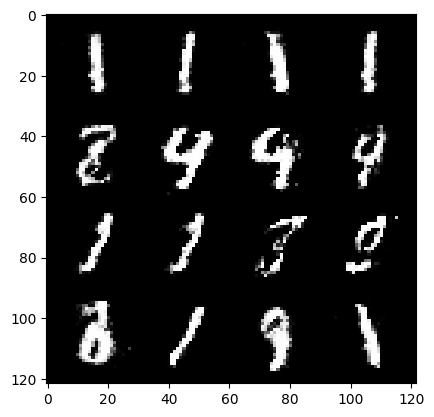

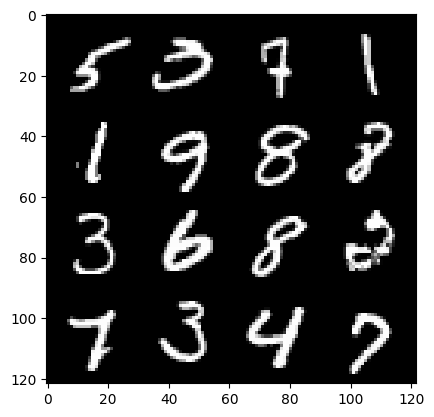

275: Step 129300 / Gen Loss : 2.2746818888187406 / Disc Loss : 0.23922263860702514


  0%|          | 0/469 [00:00<?, ?it/s]

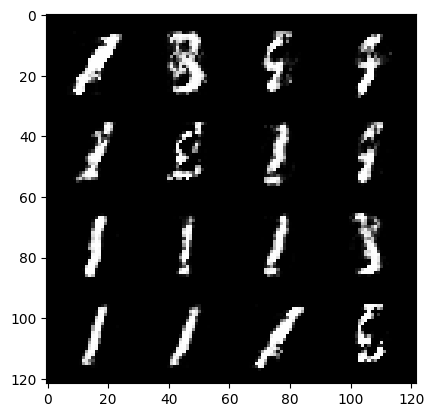

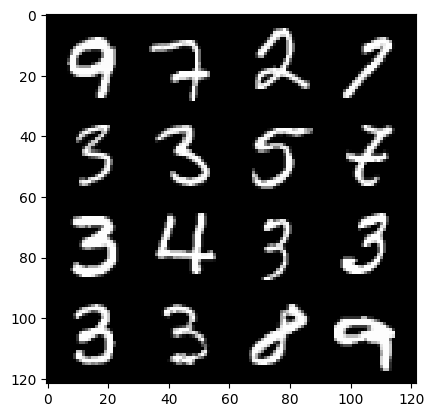

276: Step 129600 / Gen Loss : 2.128533680438997 / Disc Loss : 0.2354224395751953


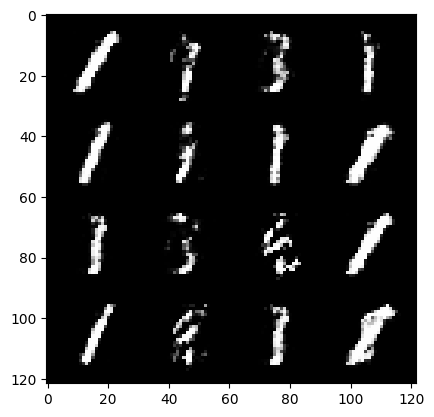

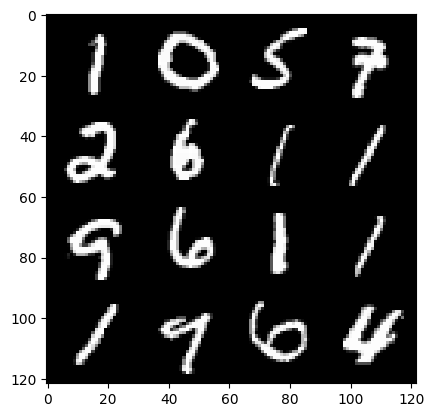

276: Step 129900 / Gen Loss : 2.0956084891160325 / Disc Loss : 0.23657470802466096


  0%|          | 0/469 [00:00<?, ?it/s]

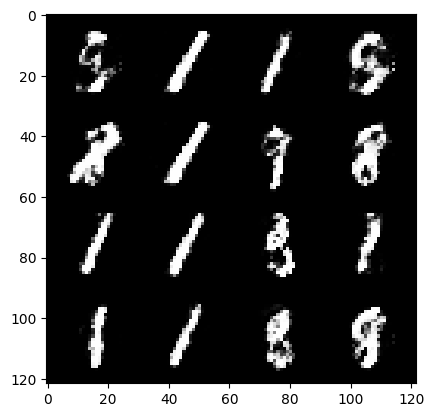

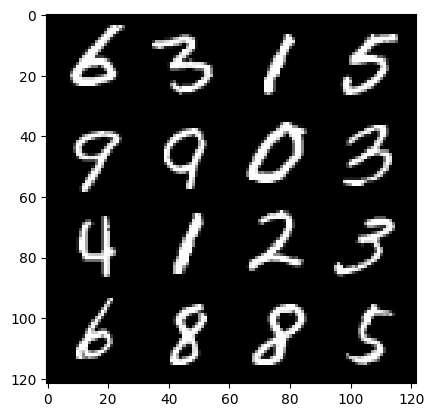

277: Step 130200 / Gen Loss : 2.071253213087718 / Disc Loss : 0.25568359479308134


  0%|          | 0/469 [00:00<?, ?it/s]

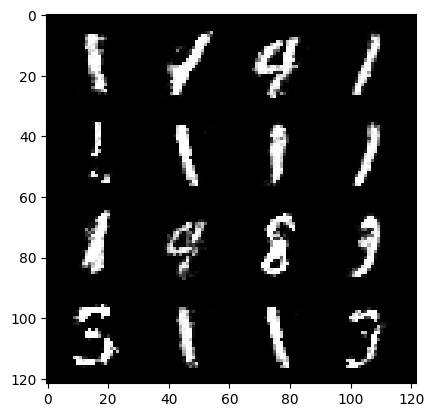

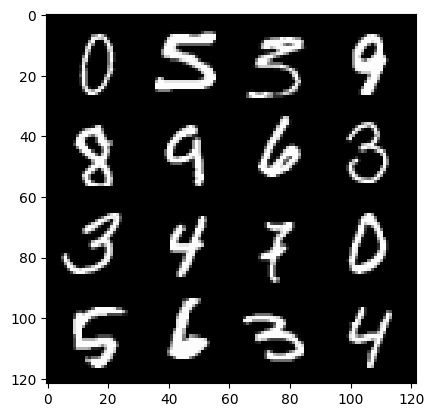

278: Step 130500 / Gen Loss : 2.0616832641760503 / Disc Loss : 0.2523385431369148


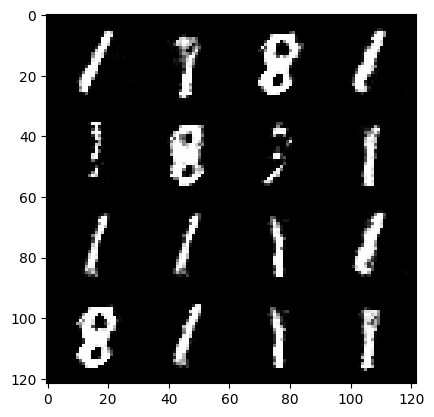

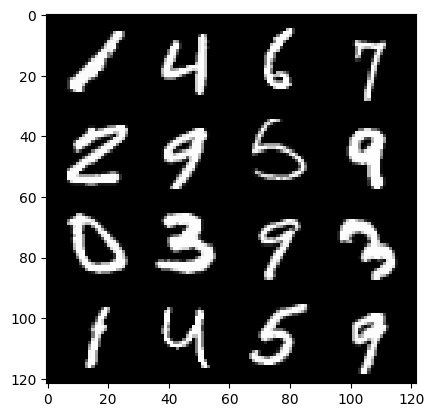

278: Step 130800 / Gen Loss : 2.17668556133906 / Disc Loss : 0.226472126642863


  0%|          | 0/469 [00:00<?, ?it/s]

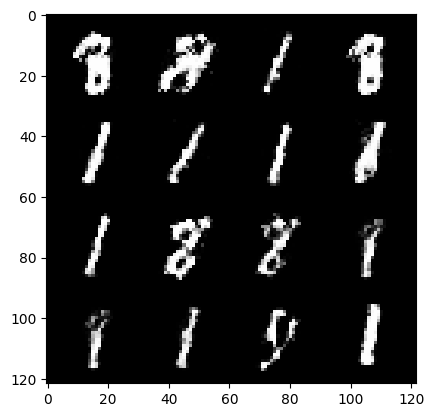

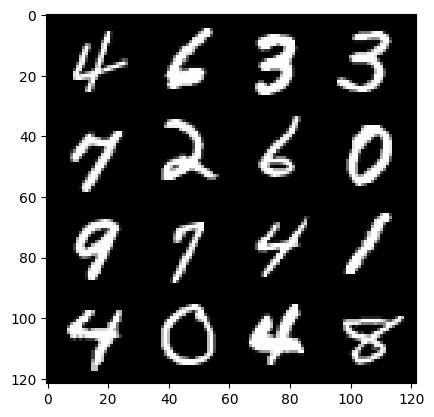

279: Step 131100 / Gen Loss : 2.169931196769079 / Disc Loss : 0.22154267524679513


  0%|          | 0/469 [00:00<?, ?it/s]

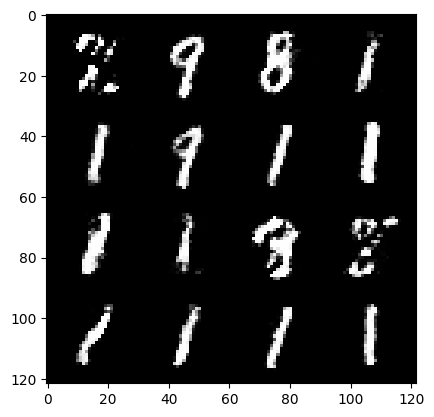

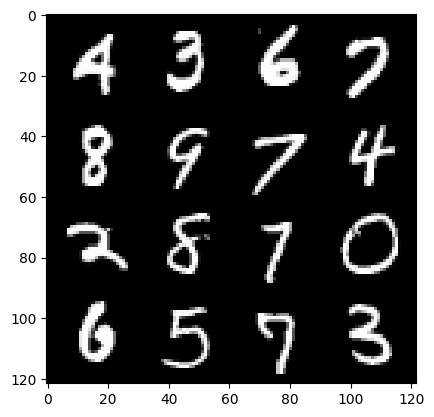

280: Step 131400 / Gen Loss : 2.0837766889731095 / Disc Loss : 0.2421714976926645


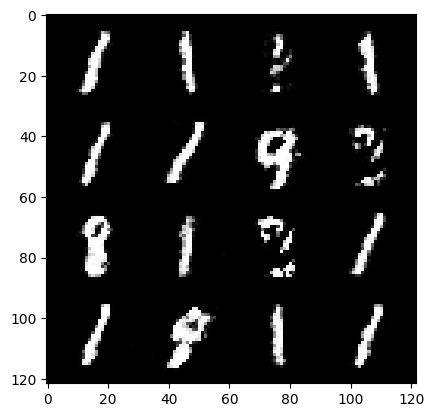

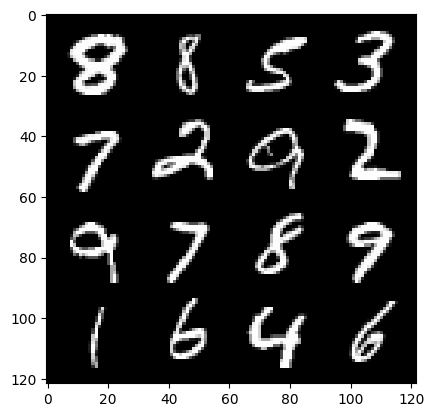

280: Step 131700 / Gen Loss : 2.0930597742398587 / Disc Loss : 0.2373500988880794


  0%|          | 0/469 [00:00<?, ?it/s]

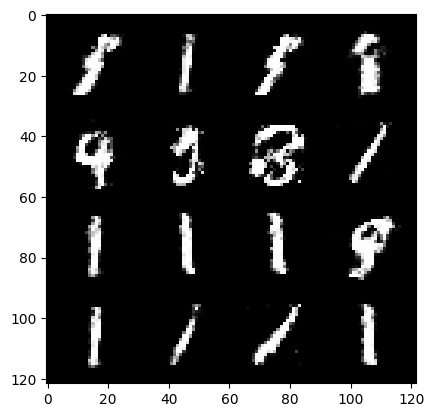

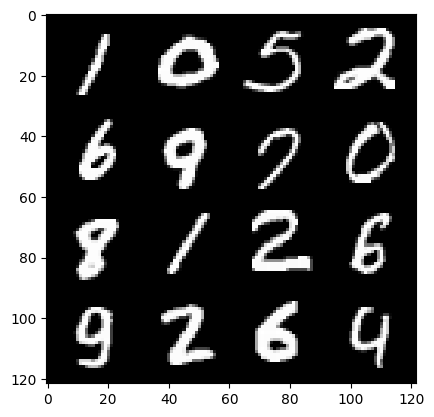

281: Step 132000 / Gen Loss : 2.065069645643234 / Disc Loss : 0.24539011776447278


  0%|          | 0/469 [00:00<?, ?it/s]

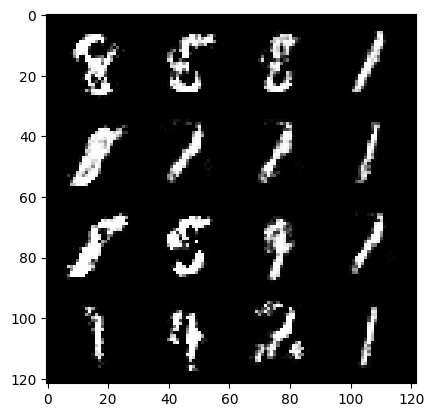

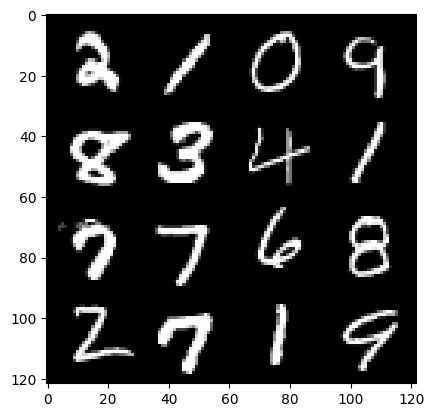

282: Step 132300 / Gen Loss : 2.0044065773487096 / Disc Loss : 0.25269146497050915


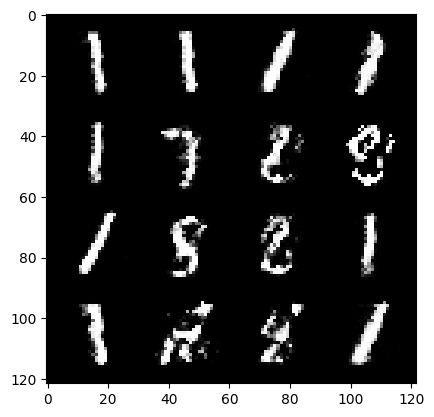

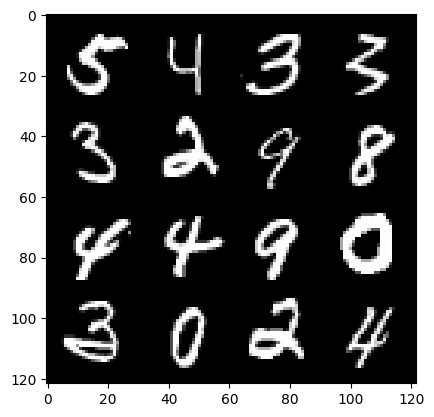

282: Step 132600 / Gen Loss : 2.026413020292918 / Disc Loss : 0.2458287470042706


  0%|          | 0/469 [00:00<?, ?it/s]

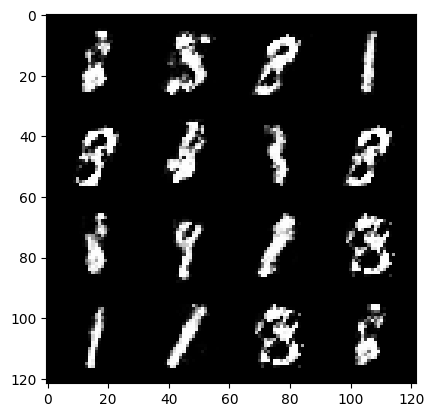

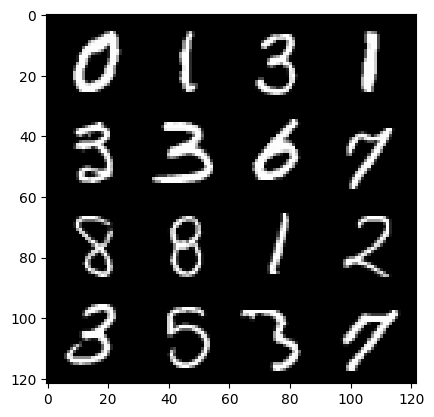

283: Step 132900 / Gen Loss : 1.987056360642116 / Disc Loss : 0.256629889011383


  0%|          | 0/469 [00:00<?, ?it/s]

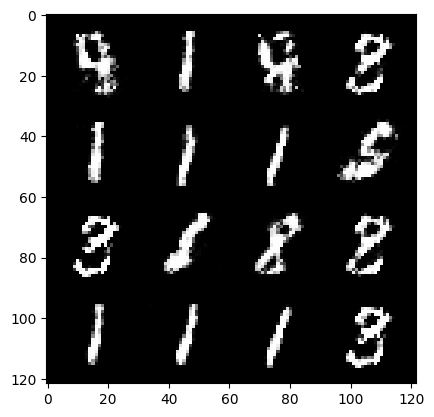

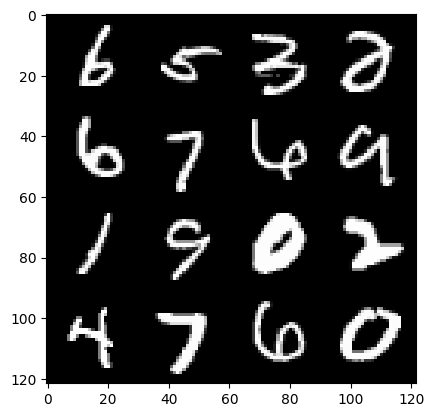

284: Step 133200 / Gen Loss : 2.011005528370537 / Disc Loss : 0.25670404295126603


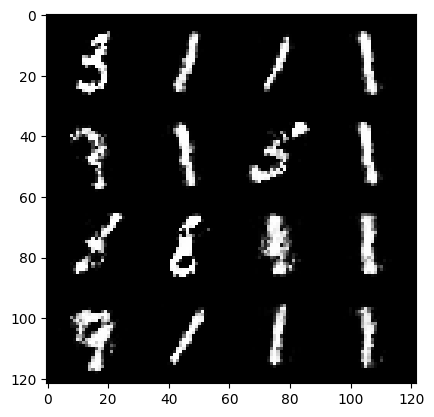

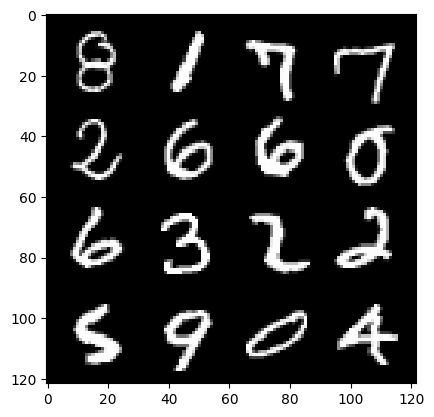

284: Step 133500 / Gen Loss : 2.102639539639155 / Disc Loss : 0.245108593304952


  0%|          | 0/469 [00:00<?, ?it/s]

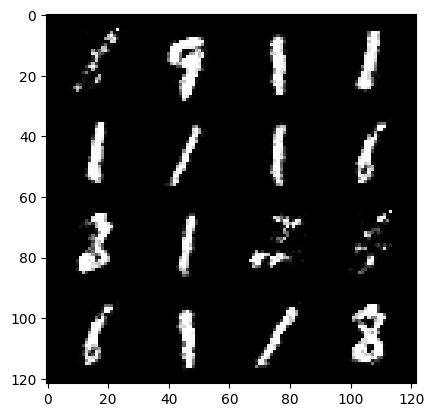

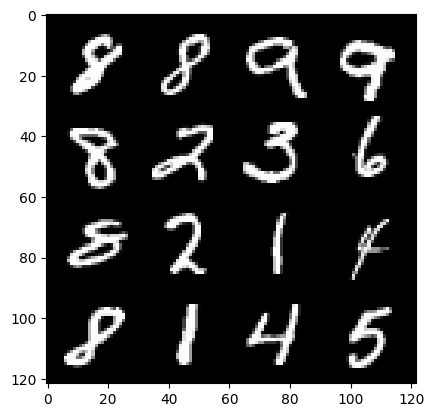

285: Step 133800 / Gen Loss : 2.139591678778331 / Disc Loss : 0.24474724734822903


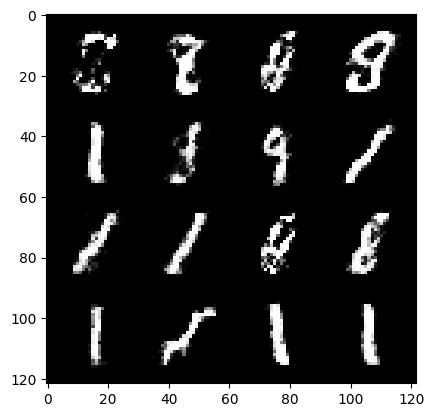

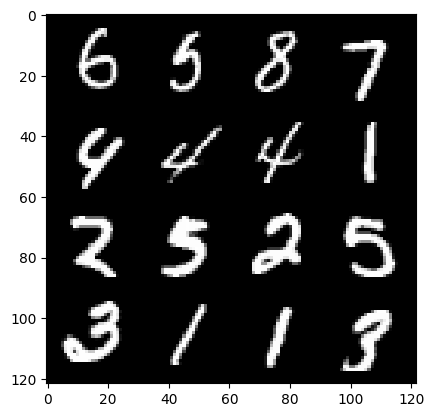

285: Step 134100 / Gen Loss : 2.0761279384295146 / Disc Loss : 0.246357847948869


  0%|          | 0/469 [00:00<?, ?it/s]

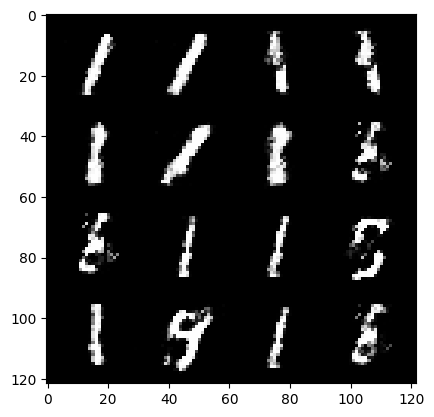

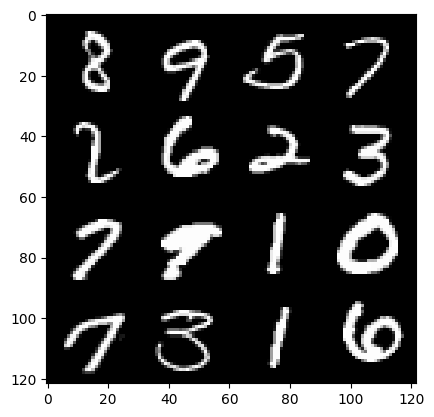

286: Step 134400 / Gen Loss : 2.05270982027054 / Disc Loss : 0.24610724290212


  0%|          | 0/469 [00:00<?, ?it/s]

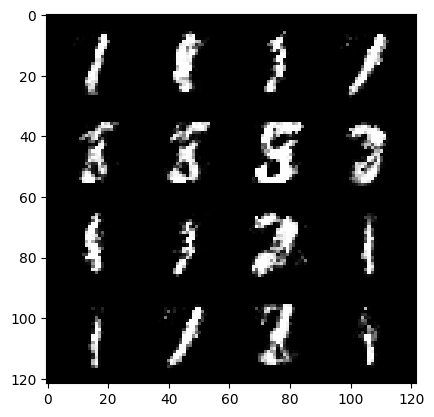

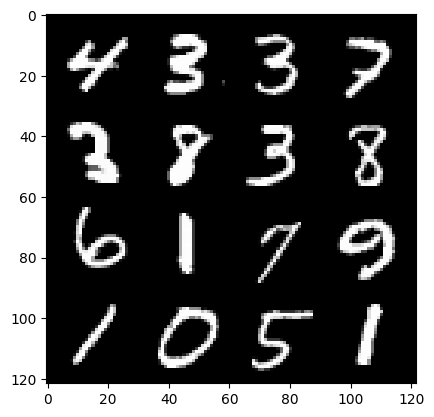

287: Step 134700 / Gen Loss : 2.1365088876088474 / Disc Loss : 0.2286946586519478


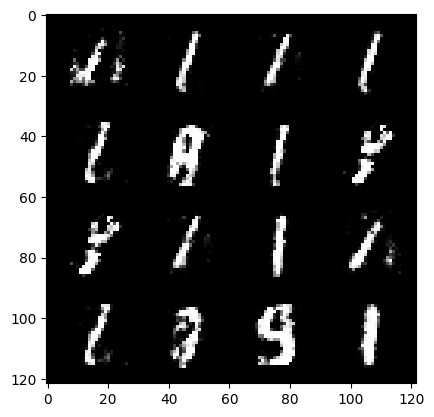

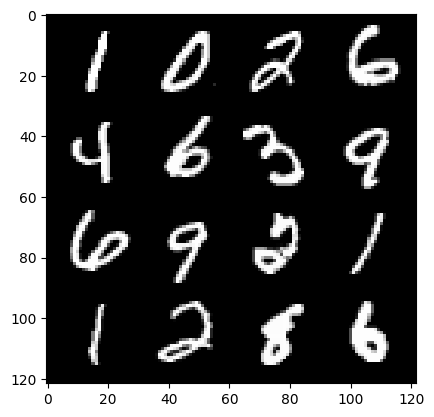

287: Step 135000 / Gen Loss : 2.2746673258145638 / Disc Loss : 0.21866525987784063


  0%|          | 0/469 [00:00<?, ?it/s]

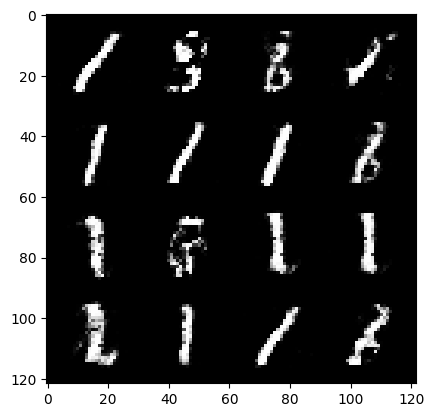

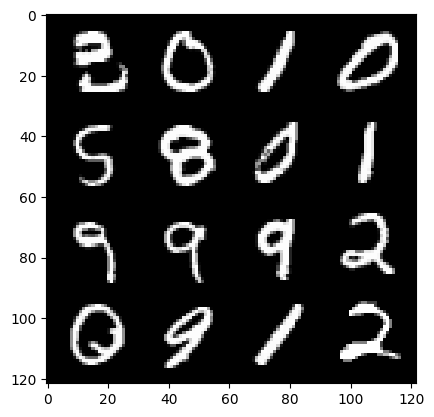

288: Step 135300 / Gen Loss : 2.0768697015444437 / Disc Loss : 0.24064079299569124


  0%|          | 0/469 [00:00<?, ?it/s]

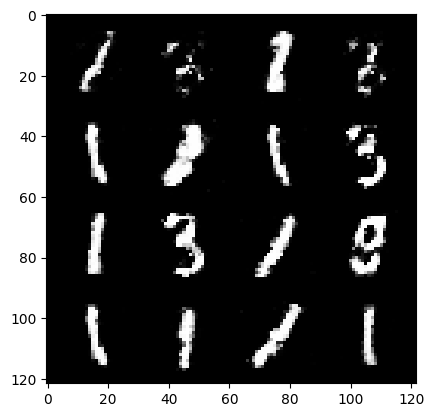

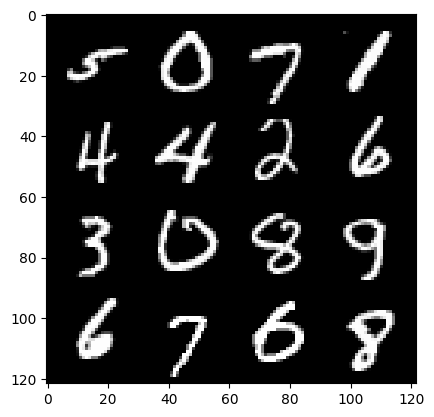

289: Step 135600 / Gen Loss : 2.2049053883552547 / Disc Loss : 0.22539977853496845


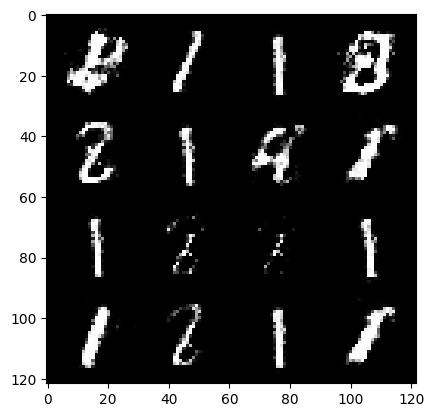

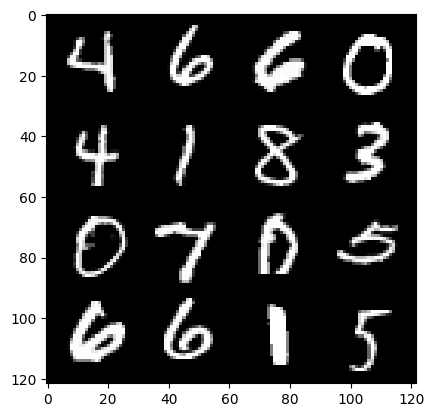

289: Step 135900 / Gen Loss : 2.1478494830926262 / Disc Loss : 0.2375666617850464


  0%|          | 0/469 [00:00<?, ?it/s]

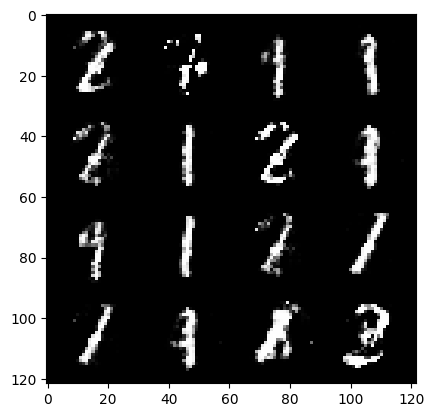

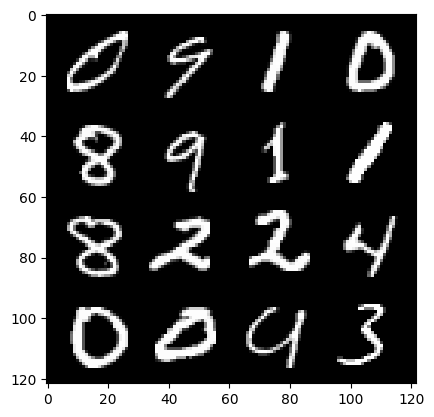

290: Step 136200 / Gen Loss : 2.2958102234204603 / Disc Loss : 0.22538832212487867


  0%|          | 0/469 [00:00<?, ?it/s]

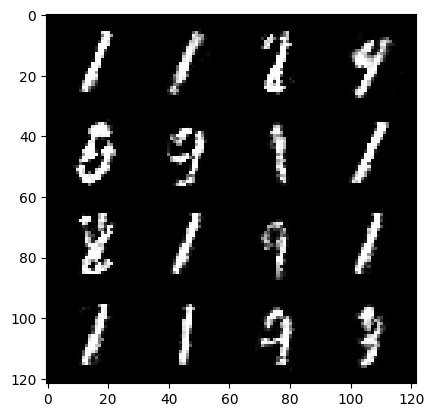

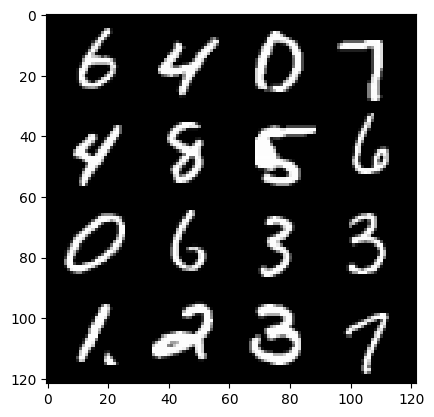

291: Step 136500 / Gen Loss : 2.159721329609553 / Disc Loss : 0.22764001145958923


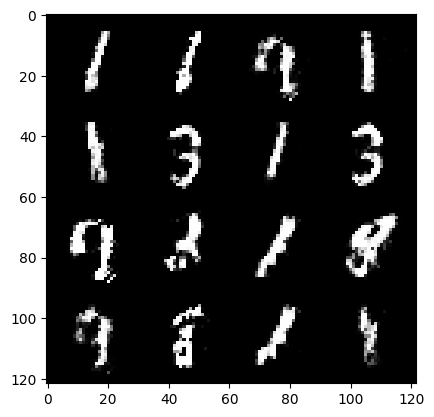

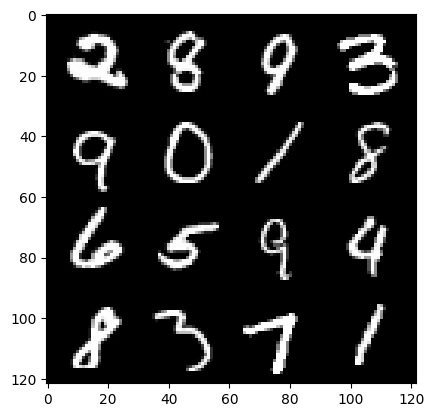

291: Step 136800 / Gen Loss : 2.100736633936563 / Disc Loss : 0.24336416145165754


  0%|          | 0/469 [00:00<?, ?it/s]

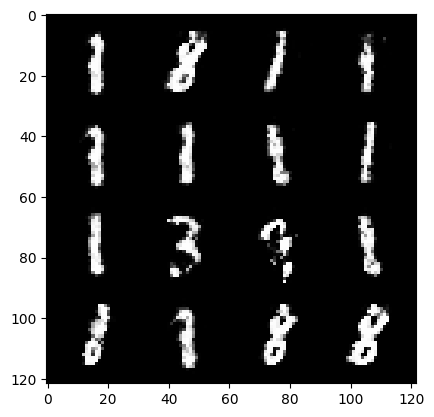

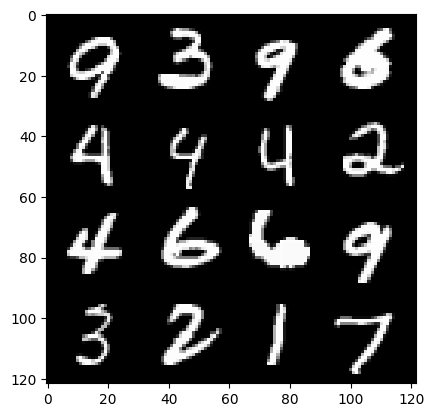

292: Step 137100 / Gen Loss : 2.240336112976075 / Disc Loss : 0.2087531551967065


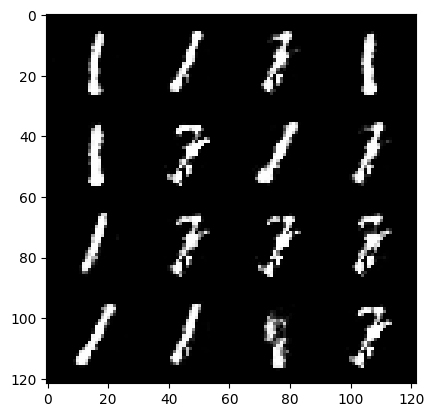

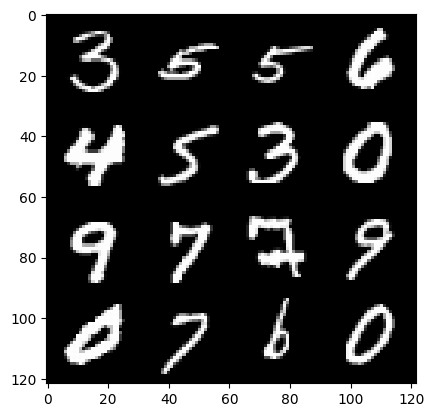

292: Step 137400 / Gen Loss : 2.230510486761728 / Disc Loss : 0.22257956830163797


  0%|          | 0/469 [00:00<?, ?it/s]

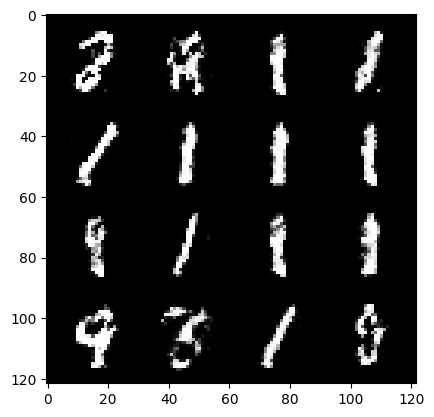

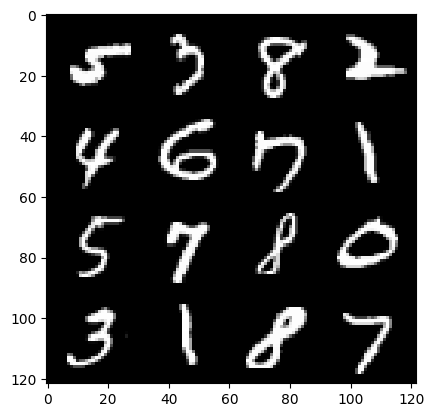

293: Step 137700 / Gen Loss : 2.05914992570877 / Disc Loss : 0.24869348223010698


  0%|          | 0/469 [00:00<?, ?it/s]

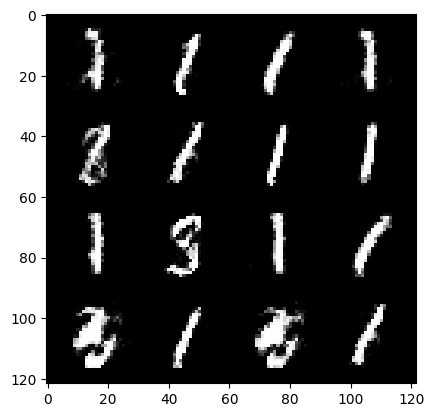

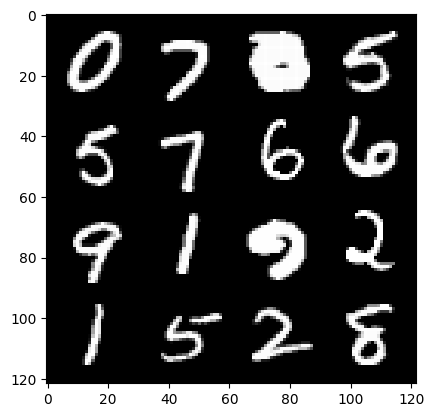

294: Step 138000 / Gen Loss : 2.0762198026974987 / Disc Loss : 0.25207854176561045


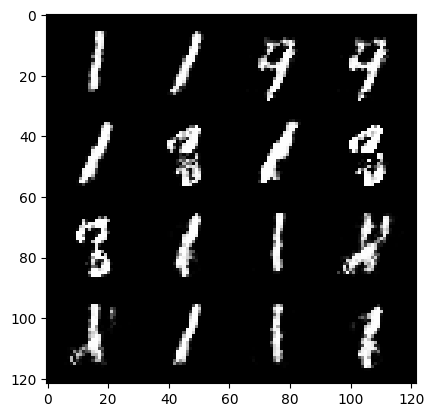

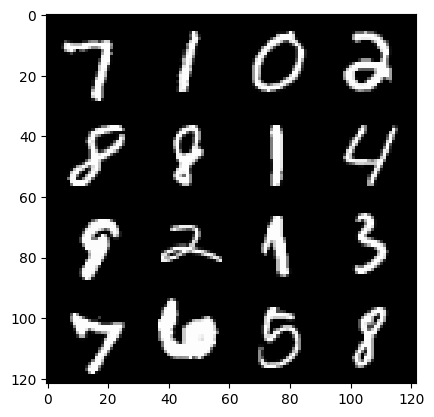

294: Step 138300 / Gen Loss : 2.074697218338649 / Disc Loss : 0.25173346375425637


  0%|          | 0/469 [00:00<?, ?it/s]

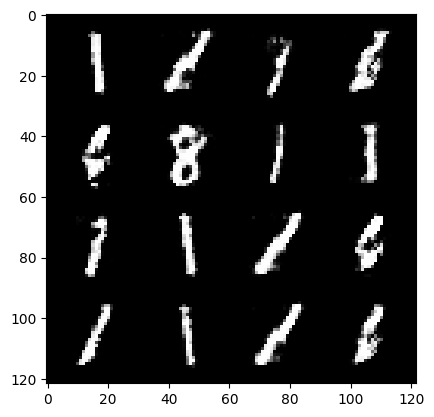

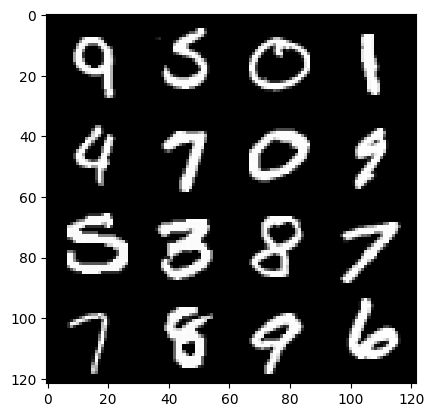

295: Step 138600 / Gen Loss : 2.153201018174489 / Disc Loss : 0.24420178343852375


  0%|          | 0/469 [00:00<?, ?it/s]

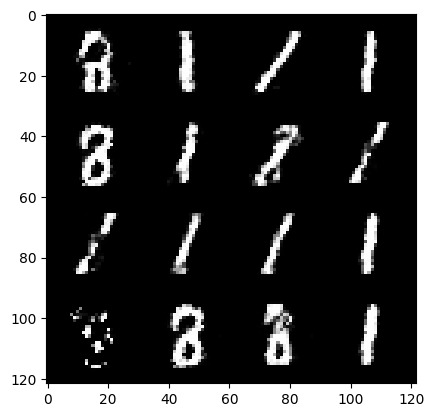

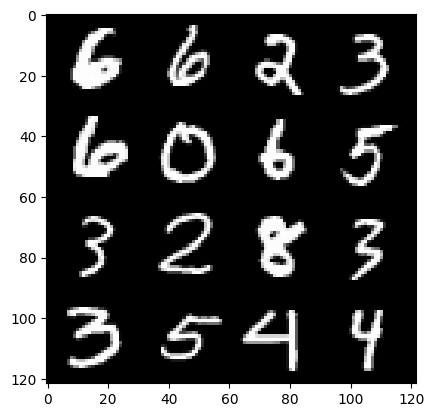

296: Step 138900 / Gen Loss : 2.1631201934814457 / Disc Loss : 0.23852176497379948


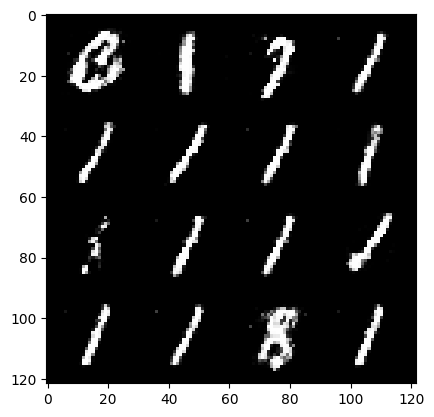

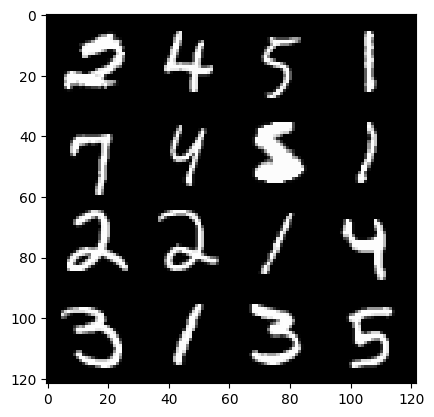

296: Step 139200 / Gen Loss : 2.175101153055828 / Disc Loss : 0.23696274911363907


  0%|          | 0/469 [00:00<?, ?it/s]

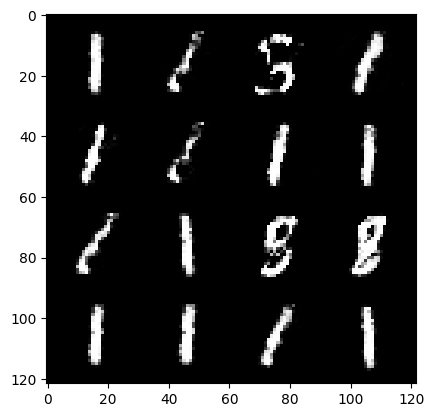

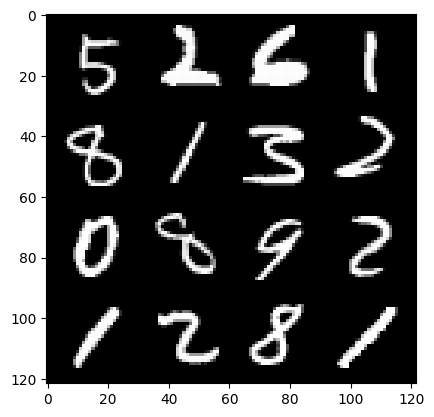

297: Step 139500 / Gen Loss : 2.2875797347227738 / Disc Loss : 0.22577770255506052


  0%|          | 0/469 [00:00<?, ?it/s]

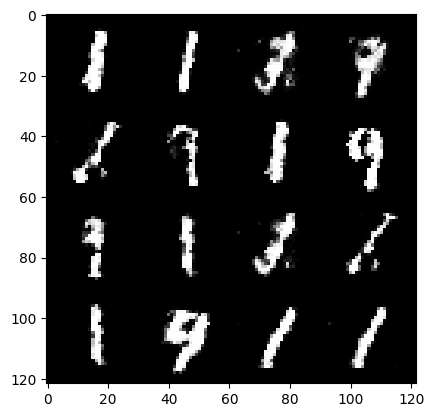

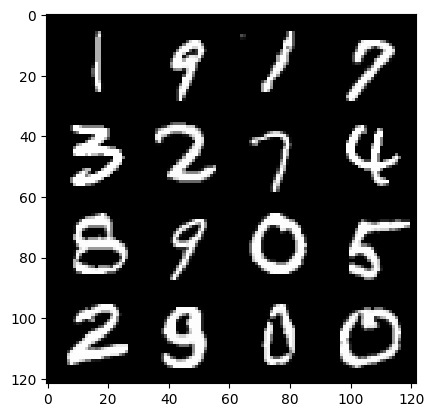

298: Step 139800 / Gen Loss : 2.1360163879394536 / Disc Loss : 0.24168306718269983


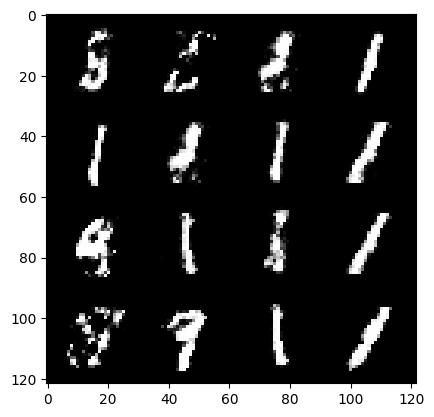

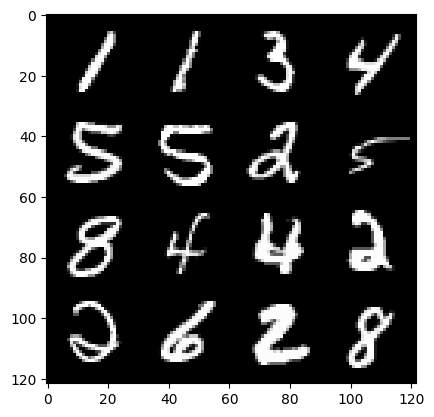

298: Step 140100 / Gen Loss : 2.179176687002181 / Disc Loss : 0.23147650882601747


  0%|          | 0/469 [00:00<?, ?it/s]

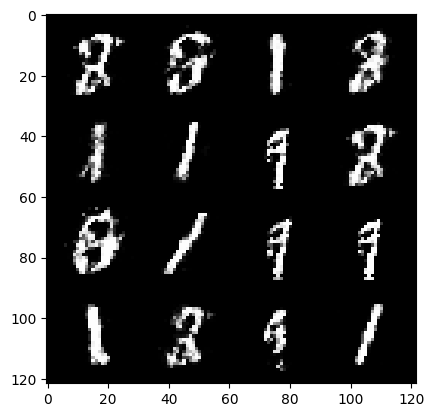

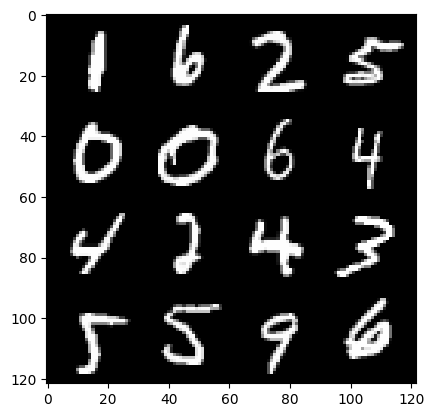

299: Step 140400 / Gen Loss : 2.215203583637872 / Disc Loss : 0.23235559413830442


  0%|          | 0/469 [00:00<?, ?it/s]

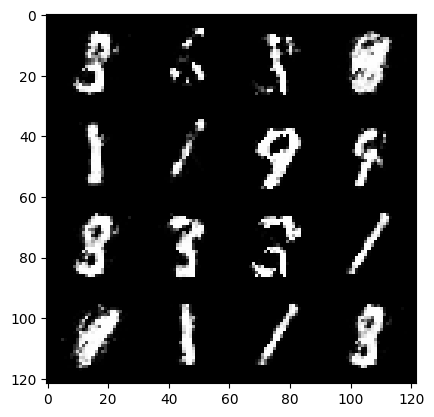

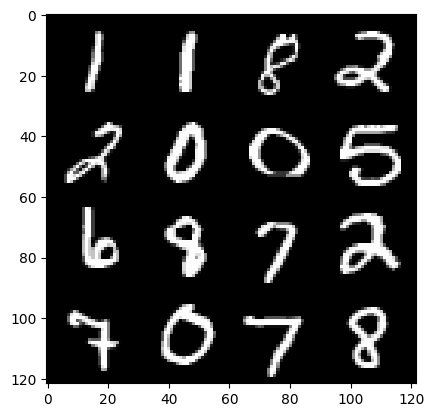

300: Step 140700 / Gen Loss : 2.1006395455201456 / Disc Loss : 0.251742413987716


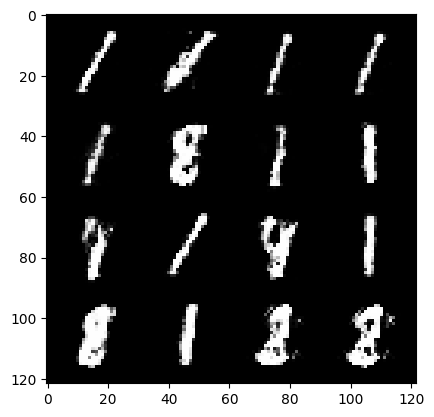

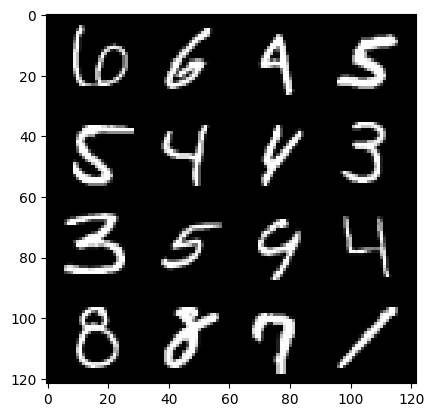

300: Step 141000 / Gen Loss : 2.0951114602883663 / Disc Loss : 0.23871788188815127


  0%|          | 0/469 [00:00<?, ?it/s]

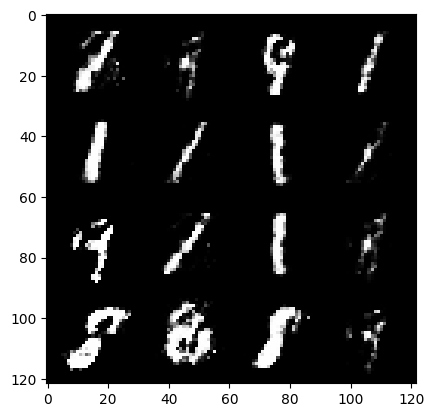

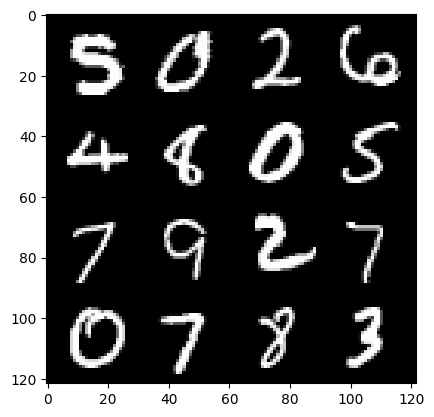

301: Step 141300 / Gen Loss : 2.2181673375765483 / Disc Loss : 0.23033720672130586


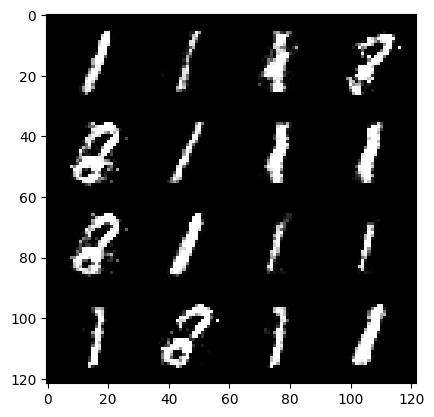

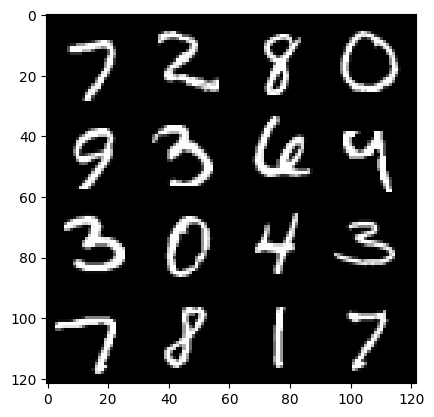

301: Step 141600 / Gen Loss : 2.2268145187695816 / Disc Loss : 0.20708061901231595


  0%|          | 0/469 [00:00<?, ?it/s]

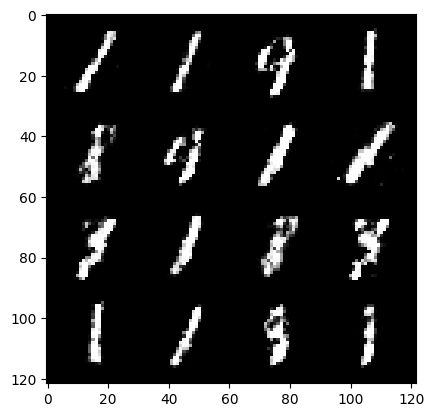

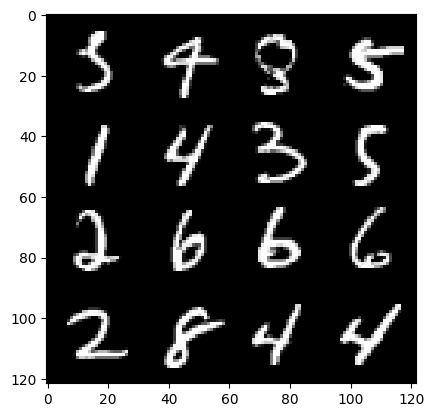

302: Step 141900 / Gen Loss : 2.109417895476024 / Disc Loss : 0.21656152476867035


  0%|          | 0/469 [00:00<?, ?it/s]

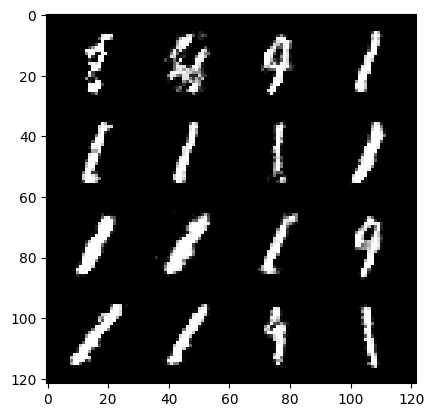

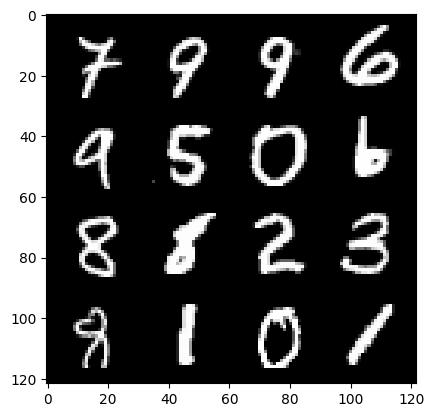

303: Step 142200 / Gen Loss : 2.1431560325622567 / Disc Loss : 0.22828209638595565


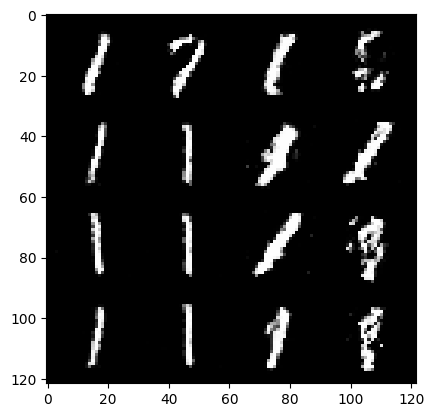

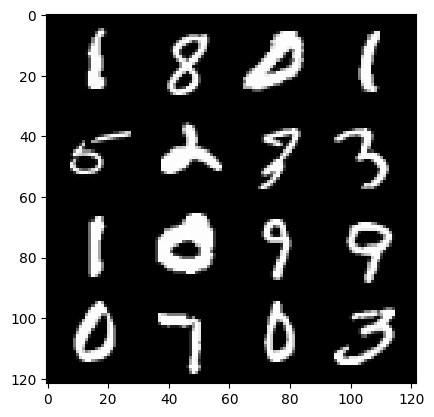

303: Step 142500 / Gen Loss : 2.1680885032812762 / Disc Loss : 0.21775902514656387


  0%|          | 0/469 [00:00<?, ?it/s]

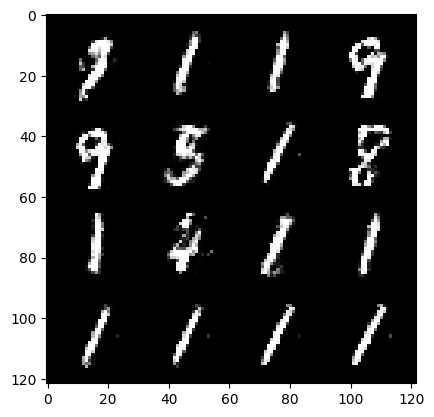

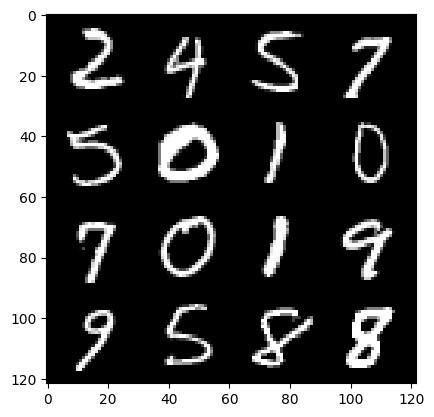

304: Step 142800 / Gen Loss : 2.0959762350718183 / Disc Loss : 0.24173884068926185


  0%|          | 0/469 [00:00<?, ?it/s]

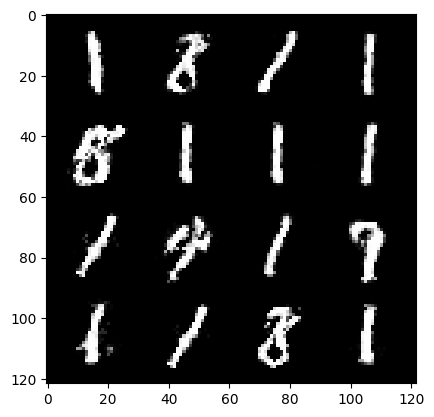

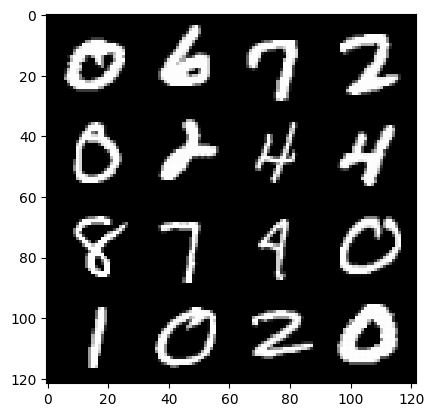

305: Step 143100 / Gen Loss : 2.0539914500713348 / Disc Loss : 0.2563236693044501


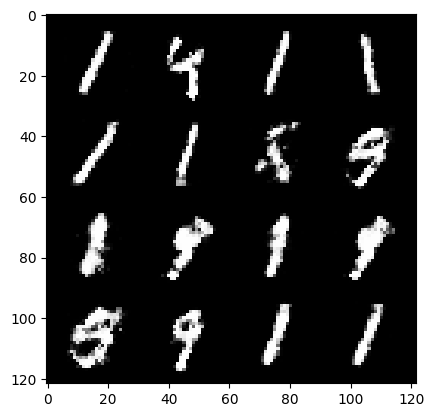

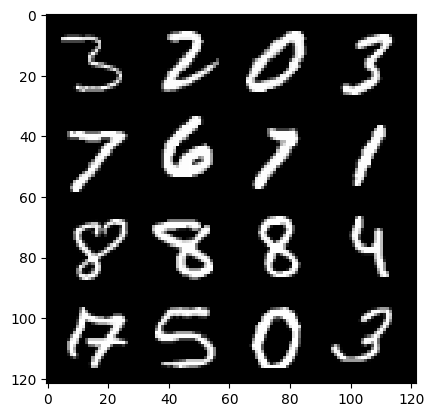

305: Step 143400 / Gen Loss : 2.0228320348262794 / Disc Loss : 0.2576040224234261


  0%|          | 0/469 [00:00<?, ?it/s]

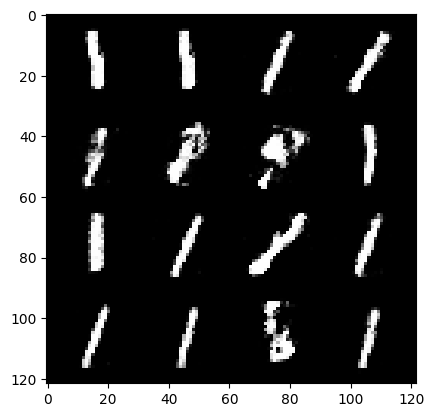

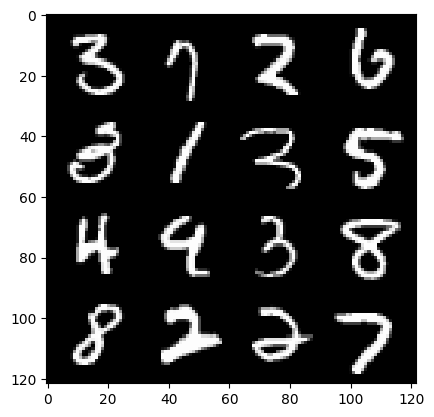

306: Step 143700 / Gen Loss : 2.0825729008515674 / Disc Loss : 0.2625667740404607


  0%|          | 0/469 [00:00<?, ?it/s]

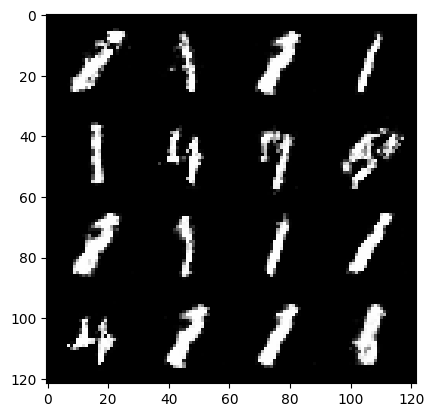

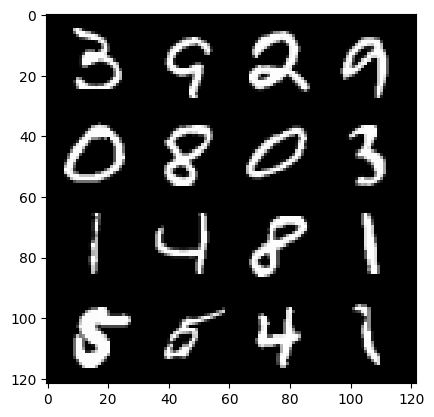

307: Step 144000 / Gen Loss : 2.1117343950271614 / Disc Loss : 0.24894695321718852


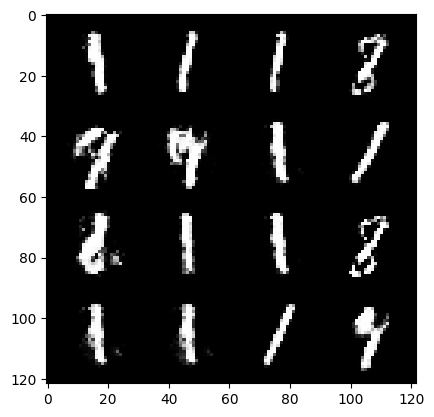

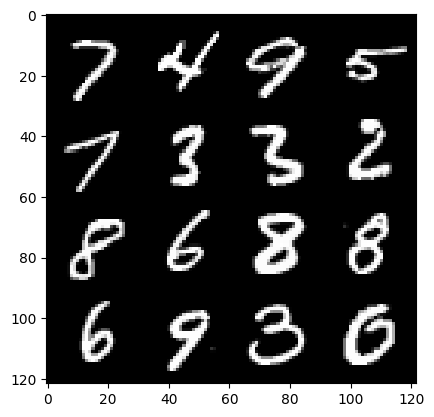

307: Step 144300 / Gen Loss : 2.1382035116354614 / Disc Loss : 0.2573928001523018


  0%|          | 0/469 [00:00<?, ?it/s]

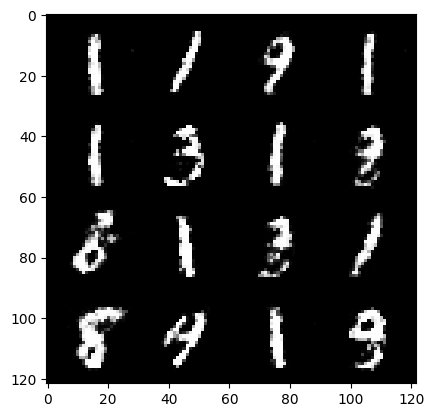

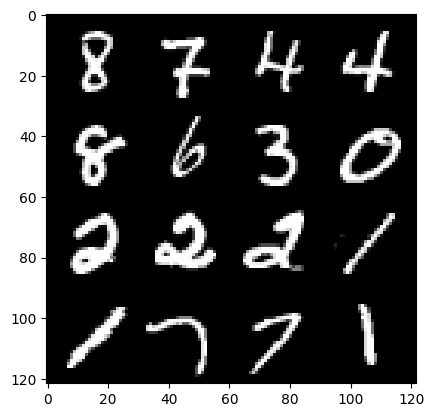

308: Step 144600 / Gen Loss : 2.1058062450091057 / Disc Loss : 0.2521633167068163


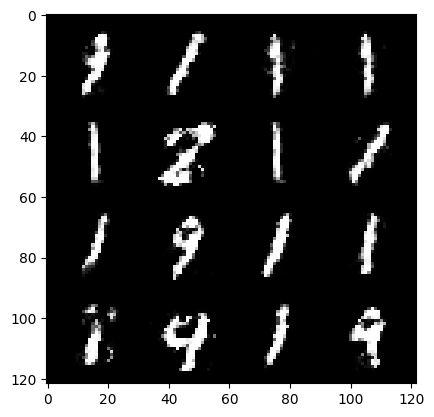

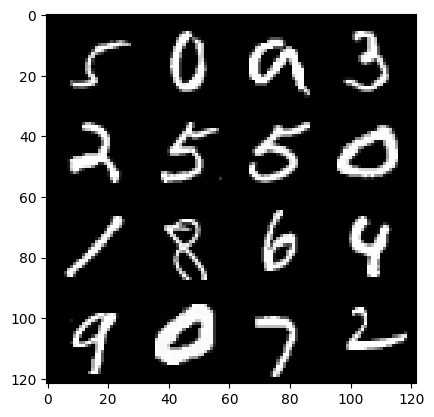

308: Step 144900 / Gen Loss : 2.0609284857908894 / Disc Loss : 0.24515110120177264


  0%|          | 0/469 [00:00<?, ?it/s]

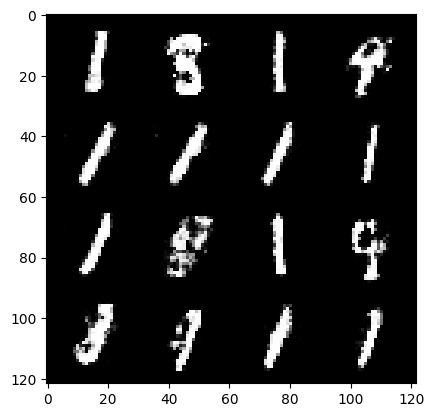

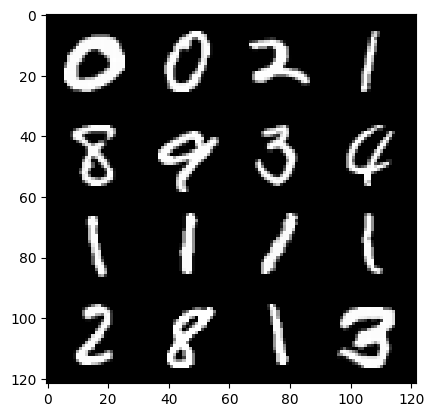

309: Step 145200 / Gen Loss : 2.229268651008608 / Disc Loss : 0.23644888704021771


  0%|          | 0/469 [00:00<?, ?it/s]

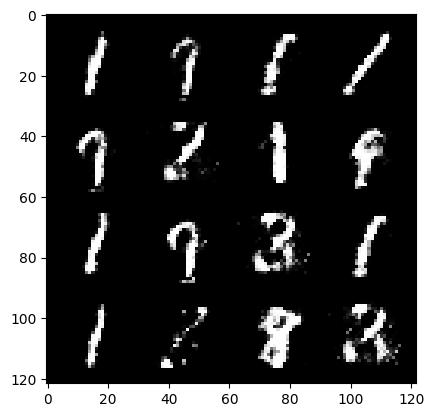

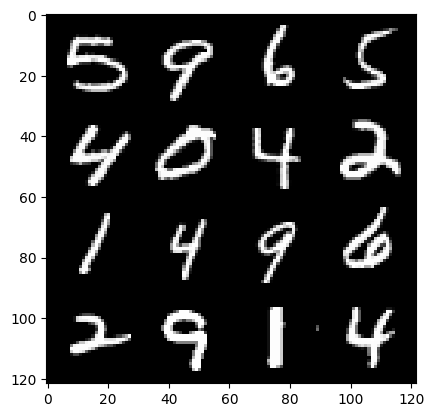

310: Step 145500 / Gen Loss : 2.1316728369394973 / Disc Loss : 0.2522963547706605


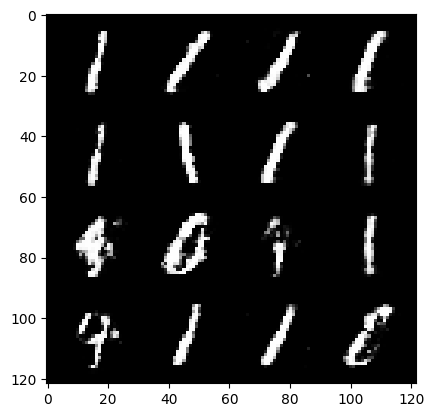

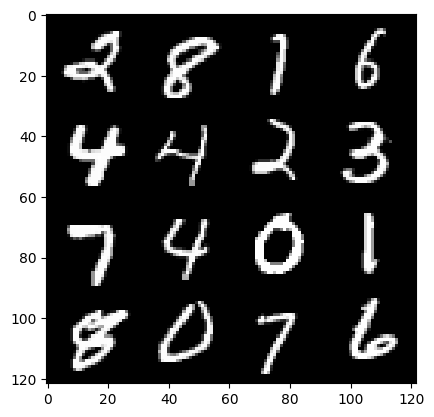

310: Step 145800 / Gen Loss : 2.128027175267538 / Disc Loss : 0.23734582111239433


  0%|          | 0/469 [00:00<?, ?it/s]

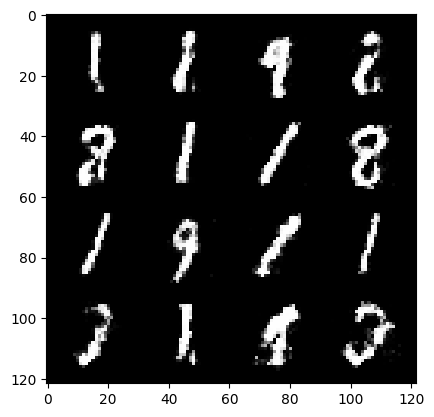

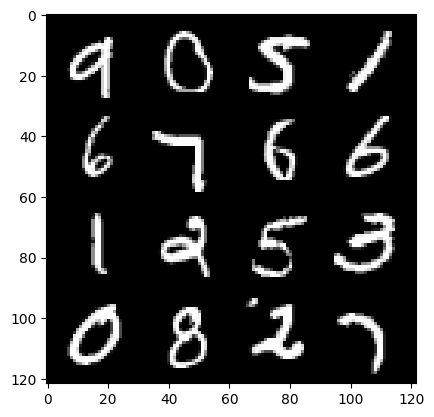

311: Step 146100 / Gen Loss : 2.0805180267492953 / Disc Loss : 0.24830113177498161


  0%|          | 0/469 [00:00<?, ?it/s]

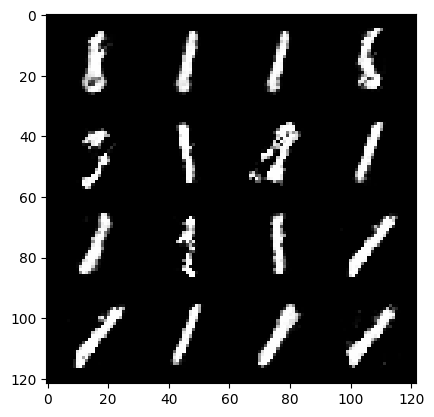

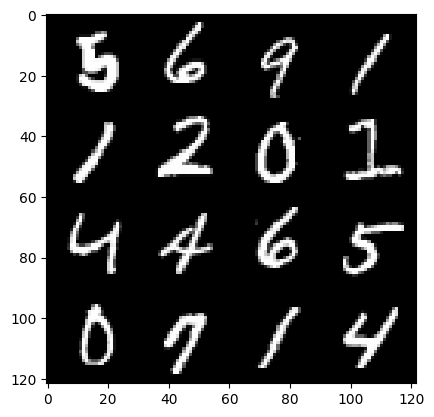

312: Step 146400 / Gen Loss : 2.1107403326034553 / Disc Loss : 0.24933316737413405


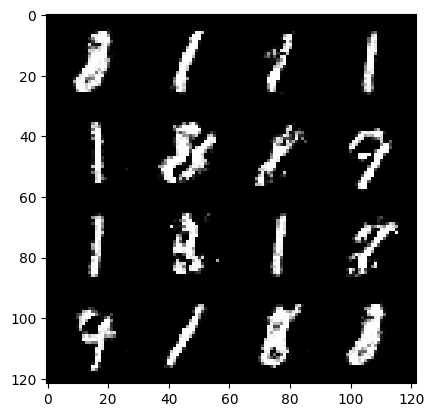

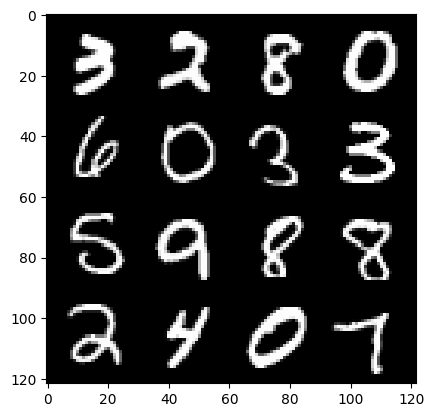

312: Step 146700 / Gen Loss : 2.0791788013776147 / Disc Loss : 0.25578251883387554


  0%|          | 0/469 [00:00<?, ?it/s]

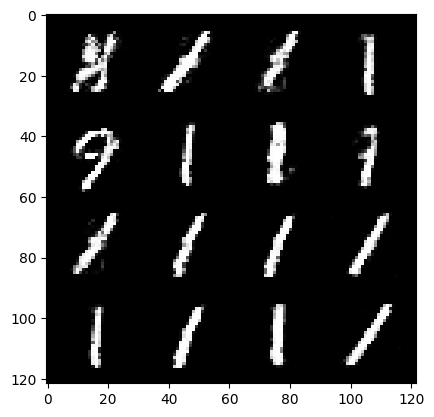

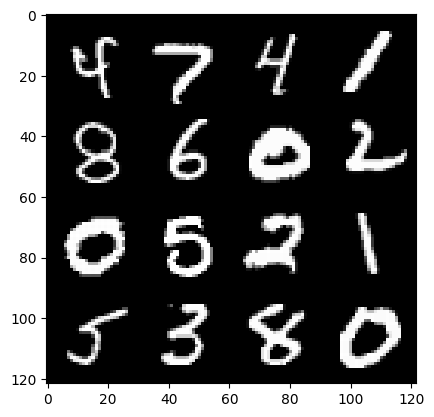

313: Step 147000 / Gen Loss : 2.054393499294918 / Disc Loss : 0.25668135429422057


  0%|          | 0/469 [00:00<?, ?it/s]

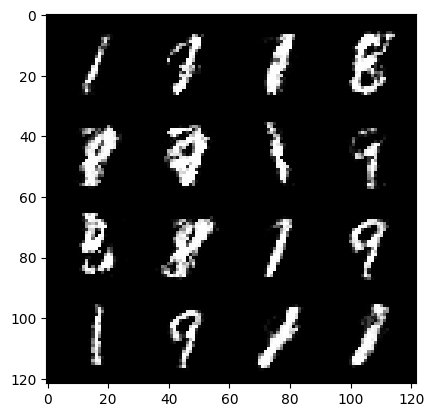

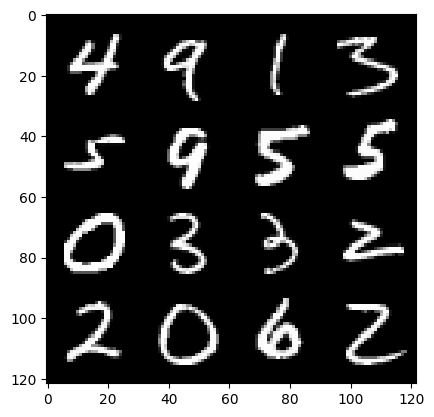

314: Step 147300 / Gen Loss : 2.078461194435755 / Disc Loss : 0.2466098493337631


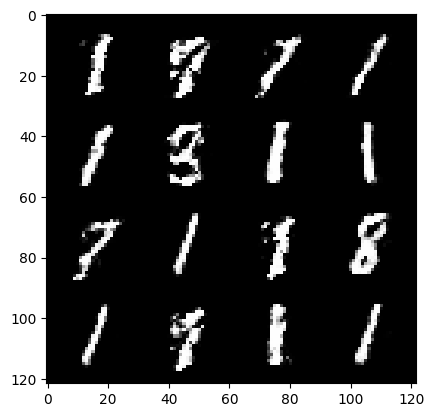

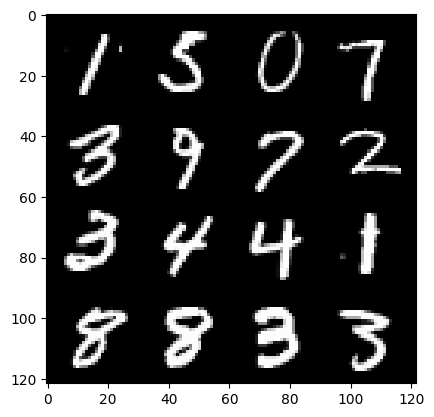

314: Step 147600 / Gen Loss : 1.979500125646591 / Disc Loss : 0.25662390520175316


  0%|          | 0/469 [00:00<?, ?it/s]

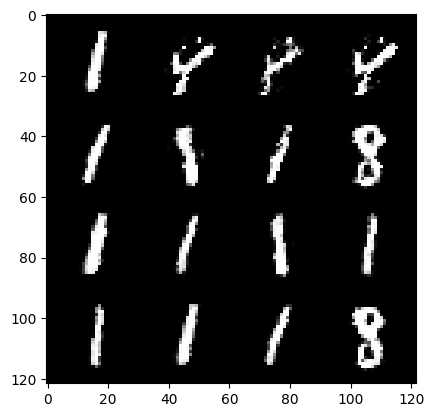

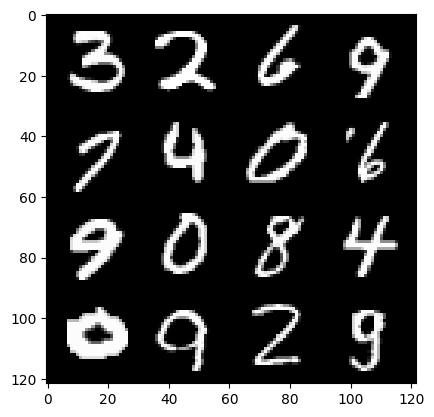

315: Step 147900 / Gen Loss : 2.0531008783976237 / Disc Loss : 0.2422140940030415


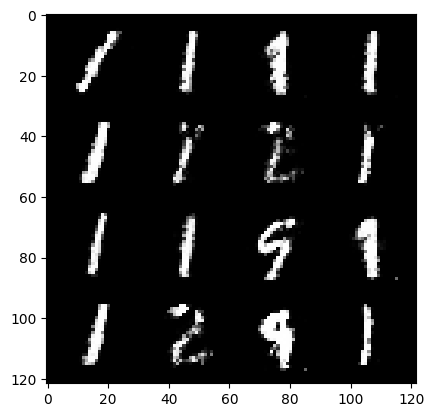

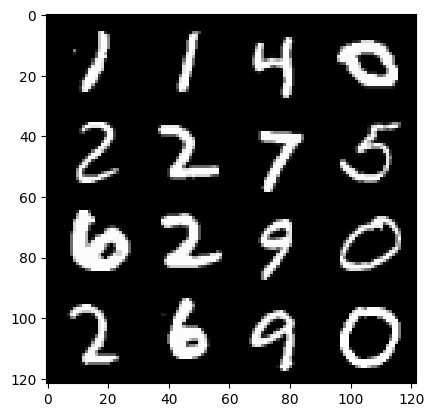

315: Step 148200 / Gen Loss : 2.1268321021397916 / Disc Loss : 0.23964374884963038


  0%|          | 0/469 [00:00<?, ?it/s]

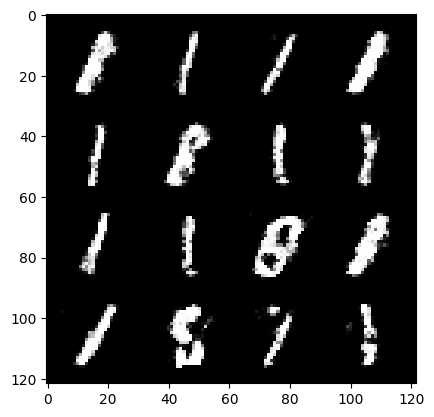

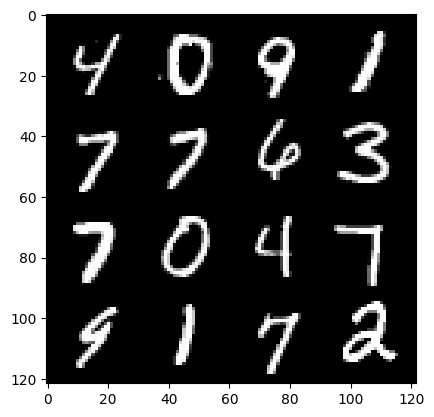

316: Step 148500 / Gen Loss : 2.213749945561092 / Disc Loss : 0.23155403032898908


  0%|          | 0/469 [00:00<?, ?it/s]

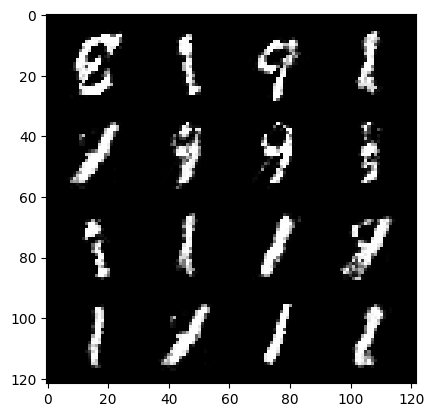

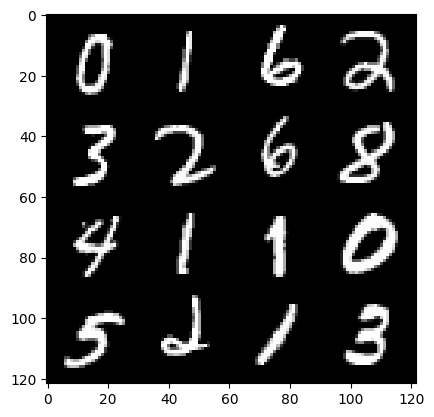

317: Step 148800 / Gen Loss : 2.19431207060814 / Disc Loss : 0.24278421476483347


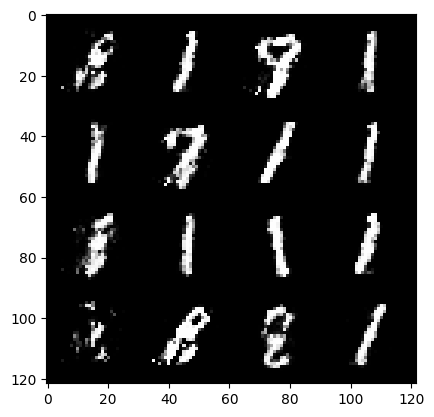

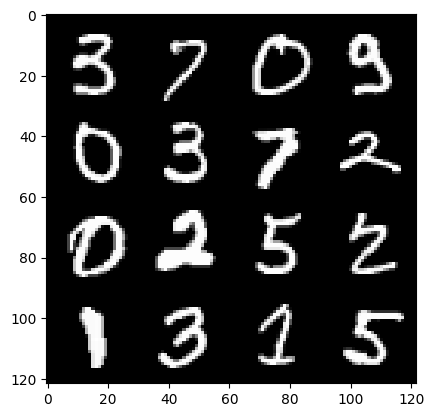

317: Step 149100 / Gen Loss : 2.2233235879739137 / Disc Loss : 0.25087758724888176


  0%|          | 0/469 [00:00<?, ?it/s]

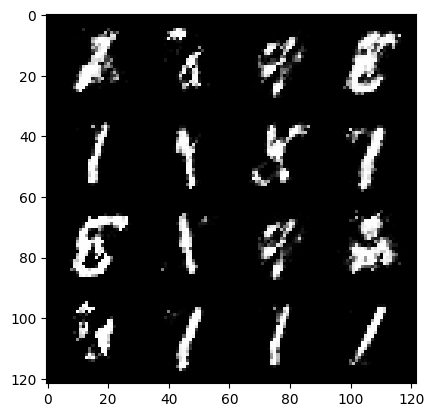

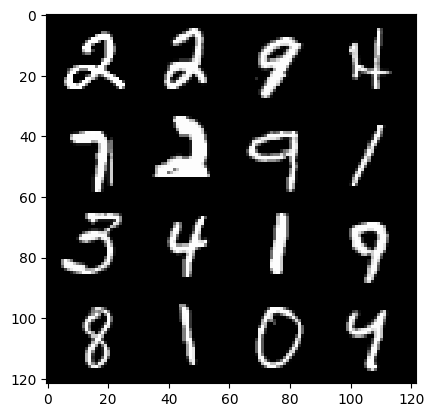

318: Step 149400 / Gen Loss : 2.207298307021458 / Disc Loss : 0.2285961402952672


  0%|          | 0/469 [00:00<?, ?it/s]

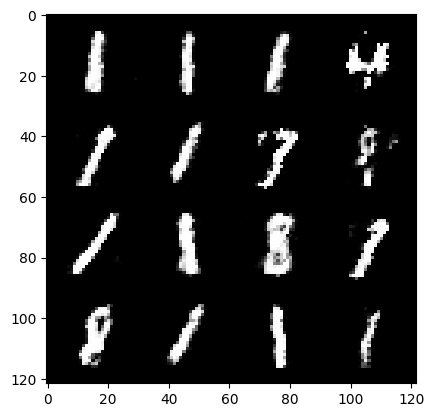

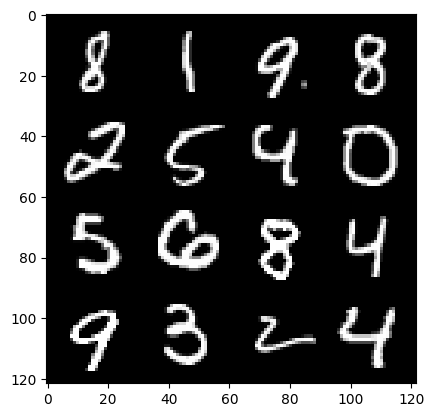

319: Step 149700 / Gen Loss : 2.076876679261525 / Disc Loss : 0.25838813031713165


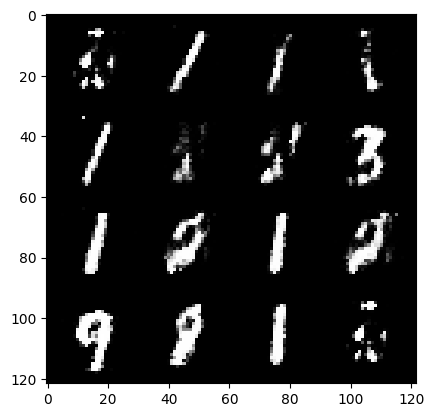

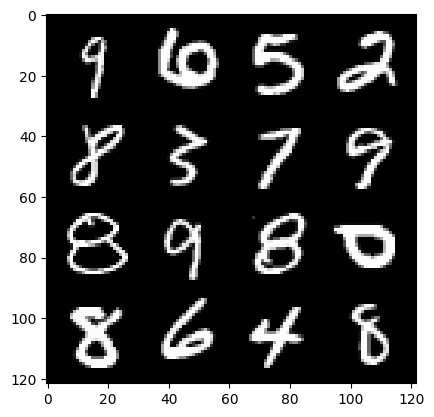

319: Step 150000 / Gen Loss : 2.118993666569393 / Disc Loss : 0.24796923170487079


  0%|          | 0/469 [00:00<?, ?it/s]

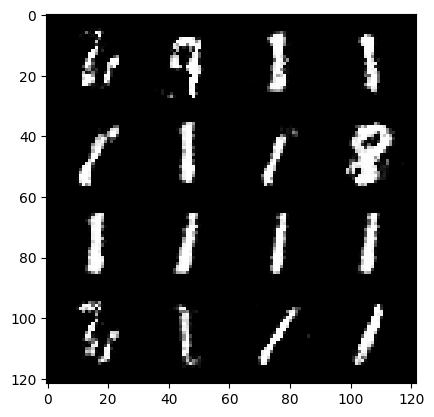

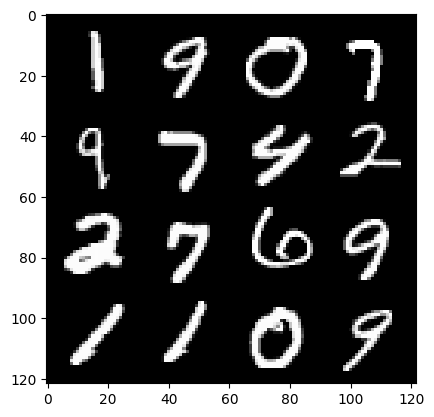

320: Step 150300 / Gen Loss : 2.0608076147238426 / Disc Loss : 0.24963388050595905


  0%|          | 0/469 [00:00<?, ?it/s]

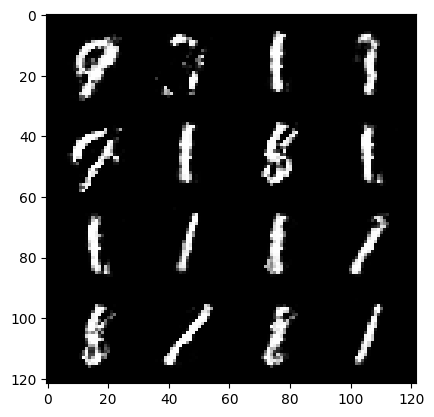

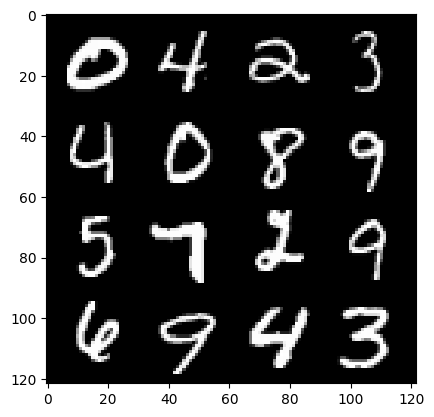

321: Step 150600 / Gen Loss : 2.1389018718401585 / Disc Loss : 0.24394363706310593


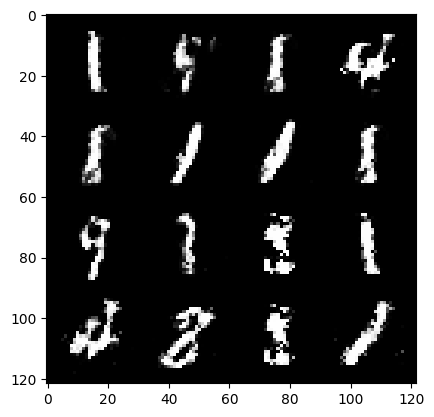

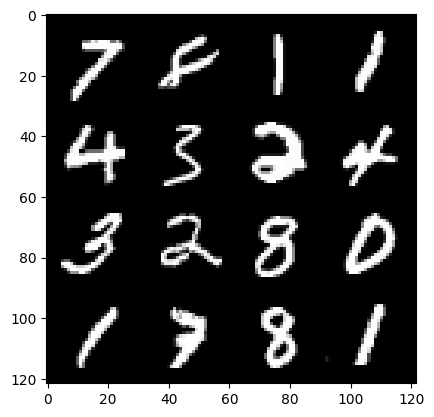

321: Step 150900 / Gen Loss : 2.0839613378047948 / Disc Loss : 0.2528673058251538


  0%|          | 0/469 [00:00<?, ?it/s]

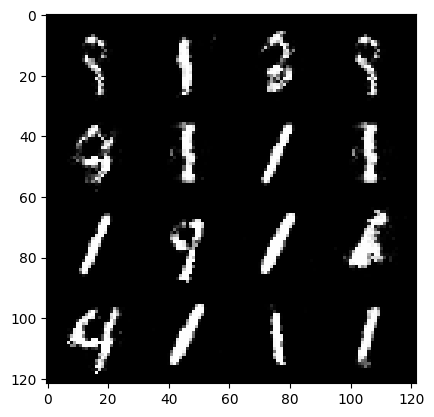

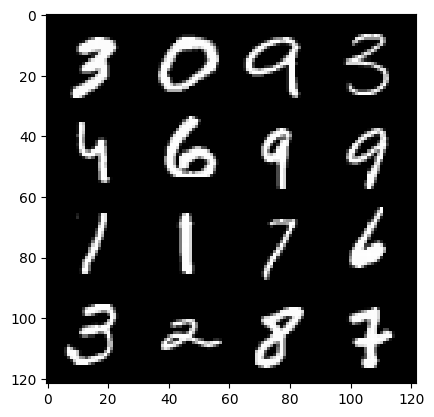

322: Step 151200 / Gen Loss : 2.1684414482116705 / Disc Loss : 0.24547903254628184


  0%|          | 0/469 [00:00<?, ?it/s]

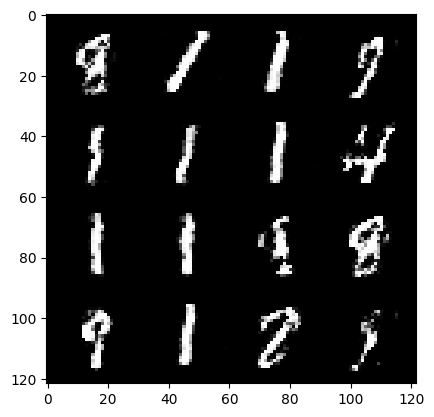

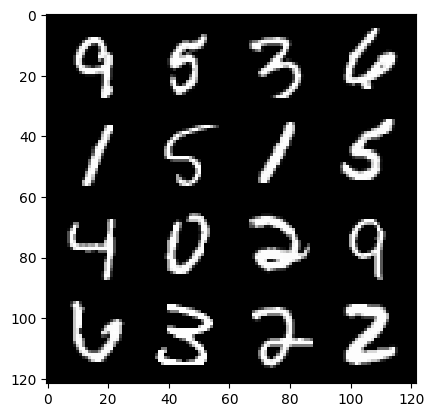

323: Step 151500 / Gen Loss : 2.149181977907817 / Disc Loss : 0.25335834865768764


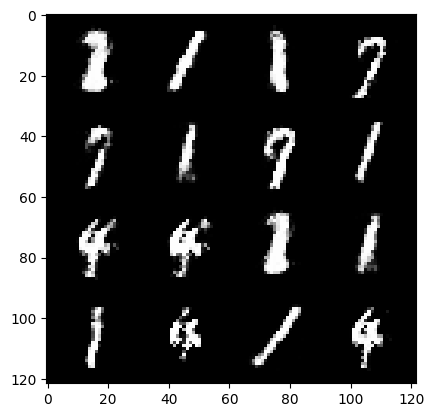

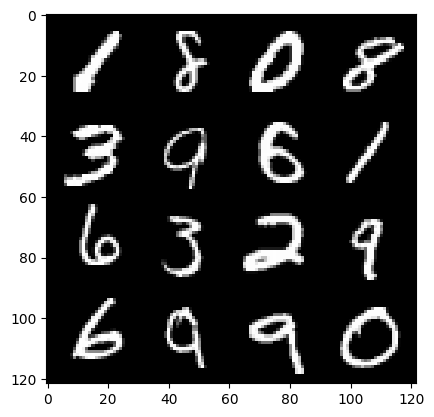

323: Step 151800 / Gen Loss : 2.12971950451533 / Disc Loss : 0.25096111595630644


  0%|          | 0/469 [00:00<?, ?it/s]

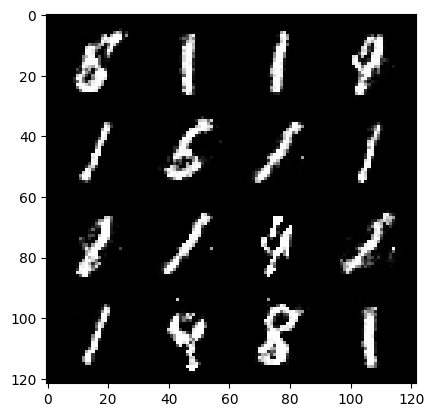

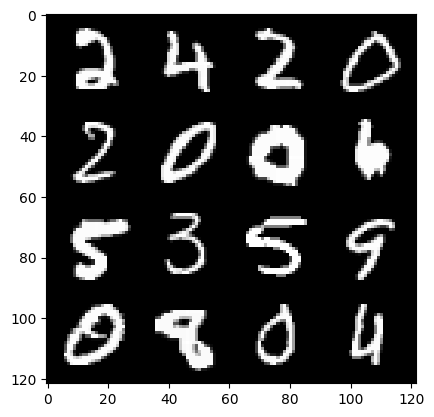

324: Step 152100 / Gen Loss : 2.126188075542449 / Disc Loss : 0.2347578929364681


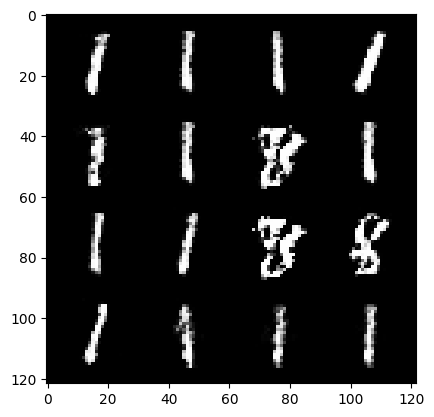

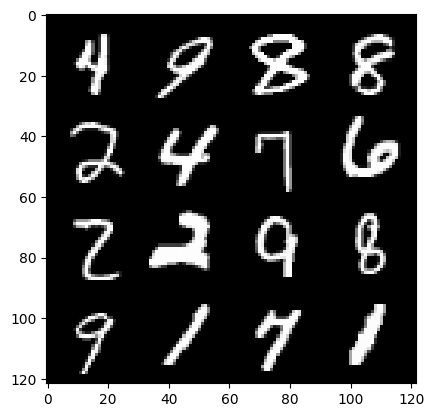

324: Step 152400 / Gen Loss : 2.155232562621433 / Disc Loss : 0.2389604492982228


  0%|          | 0/469 [00:00<?, ?it/s]

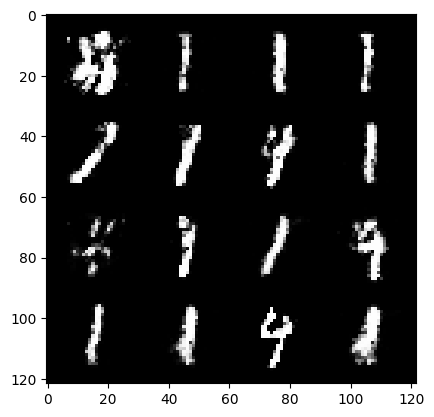

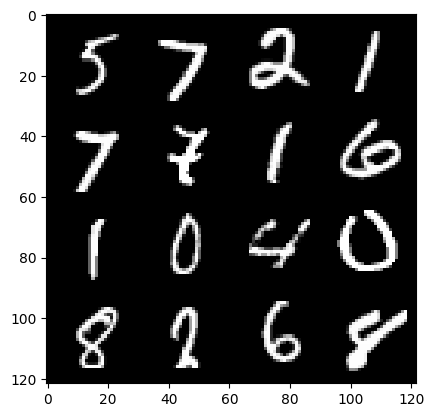

325: Step 152700 / Gen Loss : 2.176195530096689 / Disc Loss : 0.24292238940795247


  0%|          | 0/469 [00:00<?, ?it/s]

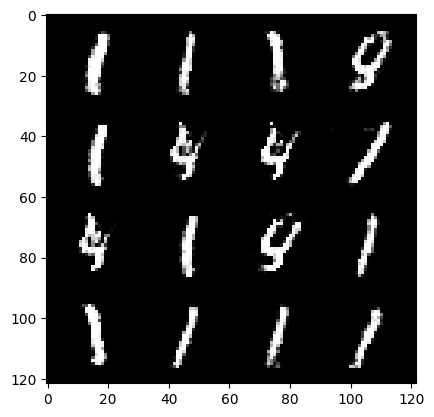

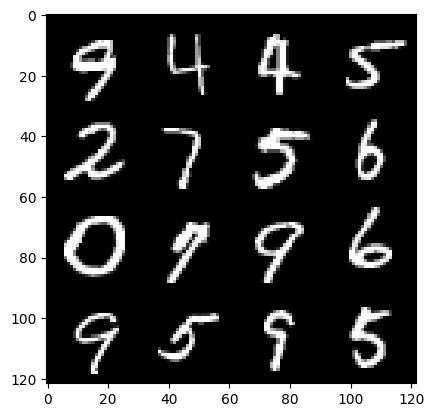

326: Step 153000 / Gen Loss : 2.1860580253601047 / Disc Loss : 0.2437886762619018


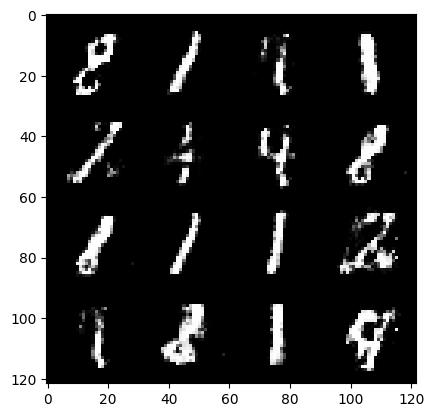

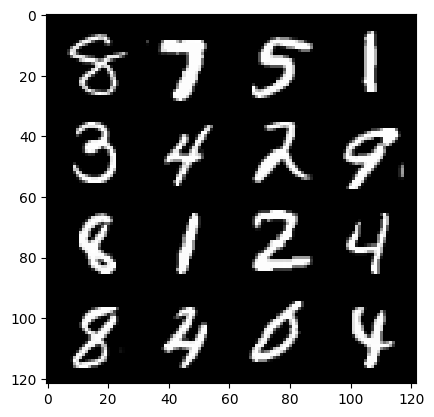

326: Step 153300 / Gen Loss : 2.173811289469402 / Disc Loss : 0.2307246618469556


  0%|          | 0/469 [00:00<?, ?it/s]

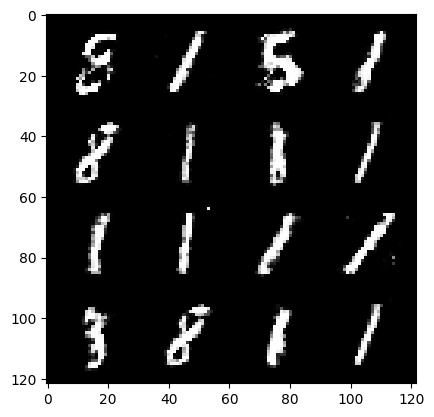

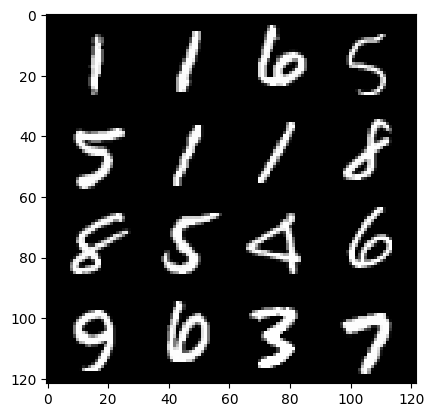

327: Step 153600 / Gen Loss : 2.126052685181301 / Disc Loss : 0.24646174713969238


  0%|          | 0/469 [00:00<?, ?it/s]

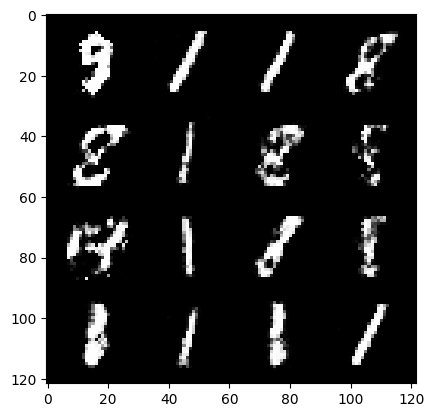

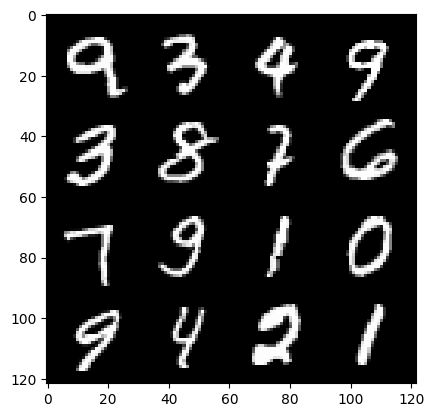

328: Step 153900 / Gen Loss : 2.073456488847733 / Disc Loss : 0.24533409059047698


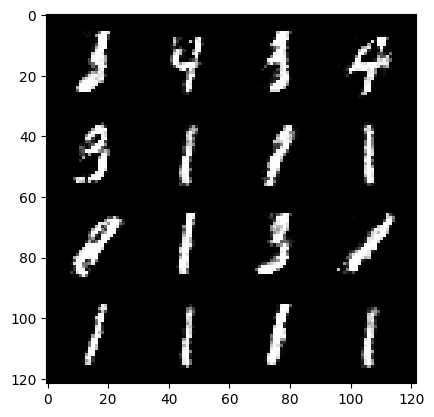

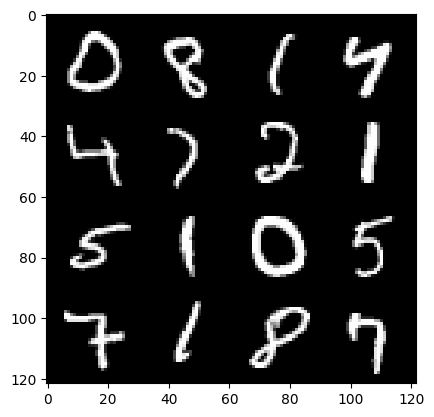

328: Step 154200 / Gen Loss : 2.073048494656881 / Disc Loss : 0.25410388911763826


  0%|          | 0/469 [00:00<?, ?it/s]

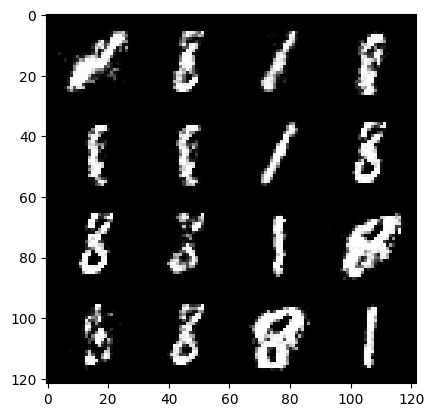

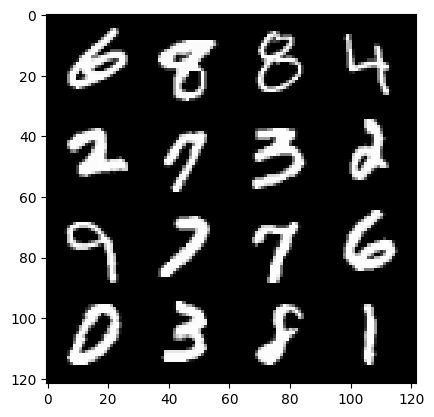

329: Step 154500 / Gen Loss : 2.047256789604822 / Disc Loss : 0.25355052679777146


  0%|          | 0/469 [00:00<?, ?it/s]

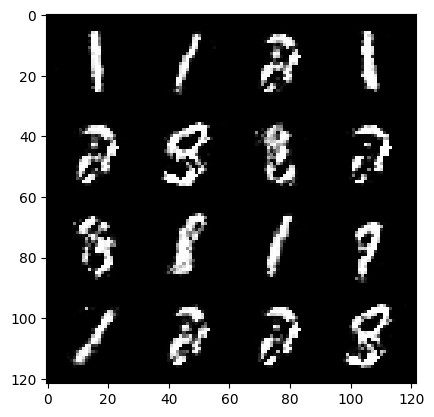

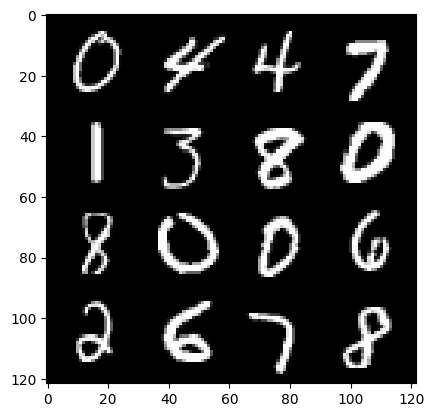

330: Step 154800 / Gen Loss : 2.0509202698866527 / Disc Loss : 0.26325489396850255


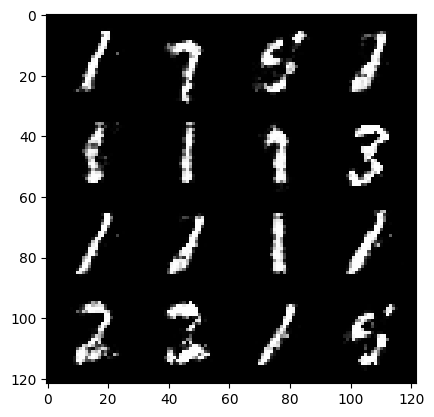

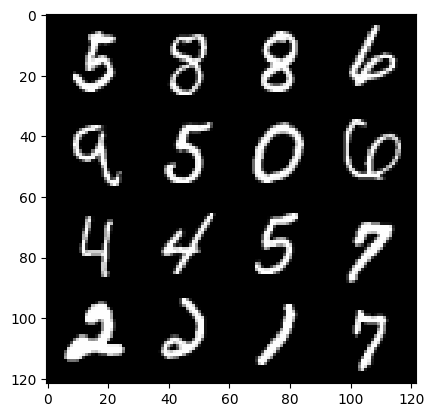

330: Step 155100 / Gen Loss : 1.9278968489170087 / Disc Loss : 0.2773047742744288


  0%|          | 0/469 [00:00<?, ?it/s]

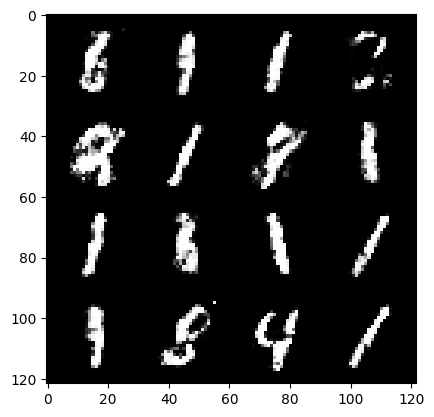

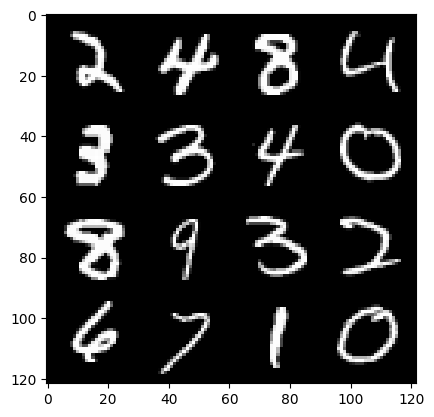

331: Step 155400 / Gen Loss : 1.9889609805742892 / Disc Loss : 0.26186757673819877


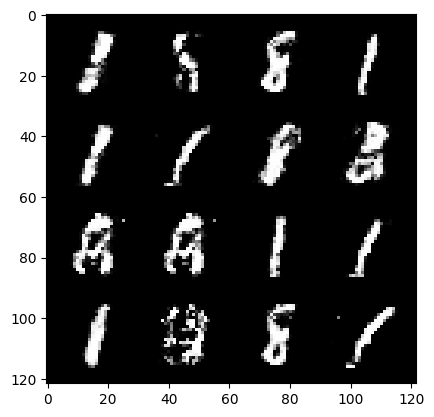

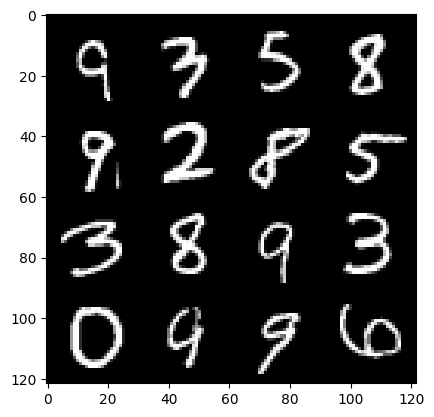

331: Step 155700 / Gen Loss : 2.0492522946993494 / Disc Loss : 0.2683365407089396


  0%|          | 0/469 [00:00<?, ?it/s]

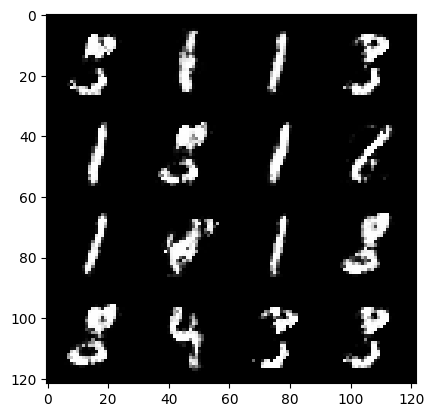

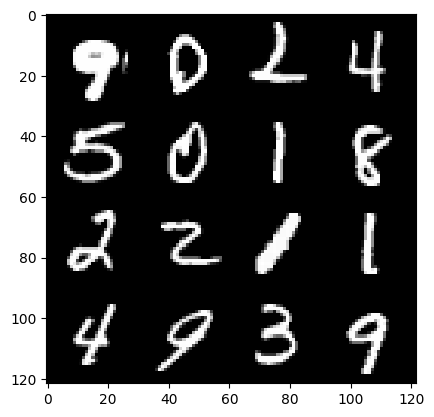

332: Step 156000 / Gen Loss : 2.0316217124462135 / Disc Loss : 0.25606250678499554


  0%|          | 0/469 [00:00<?, ?it/s]

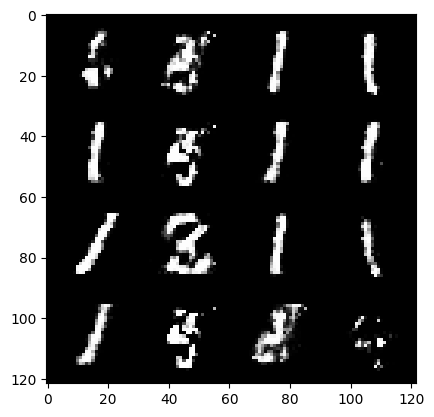

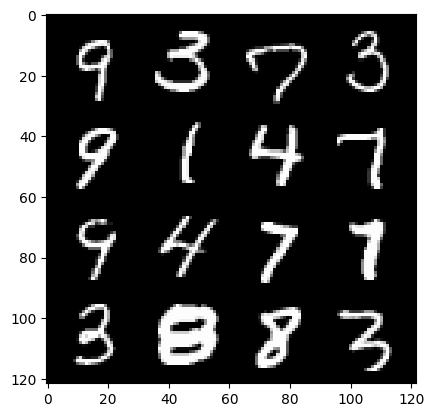

333: Step 156300 / Gen Loss : 2.1079846886793763 / Disc Loss : 0.25053647528092055


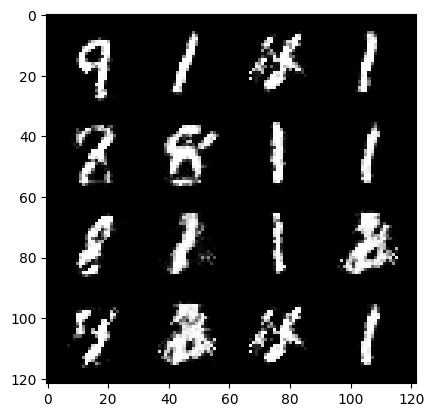

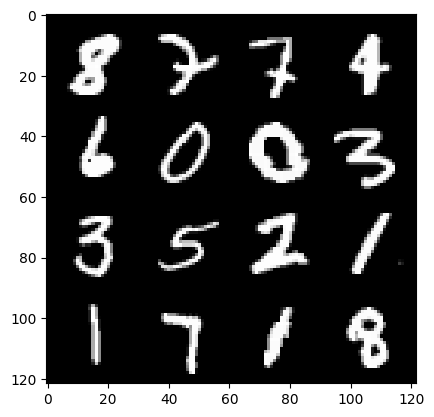

333: Step 156600 / Gen Loss : 2.1196731173992154 / Disc Loss : 0.26286264921228075


  0%|          | 0/469 [00:00<?, ?it/s]

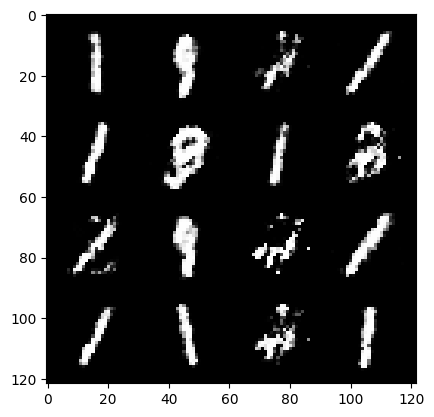

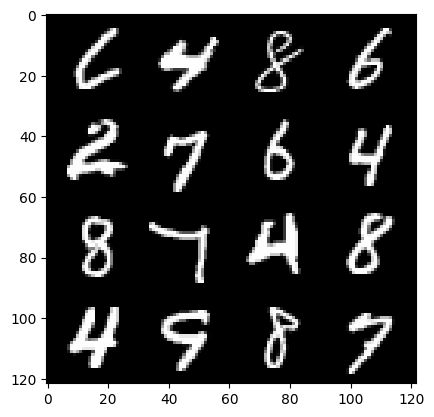

334: Step 156900 / Gen Loss : 2.0757862718900055 / Disc Loss : 0.2525099784632523


  0%|          | 0/469 [00:00<?, ?it/s]

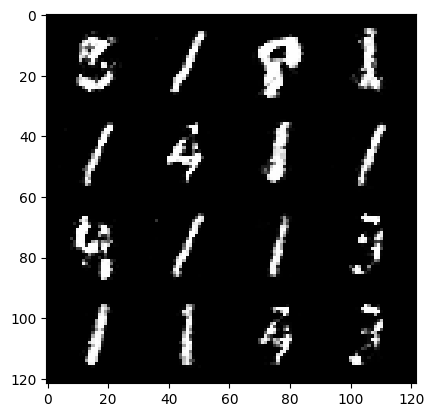

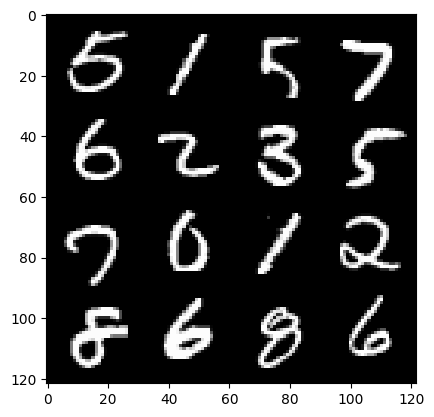

335: Step 157200 / Gen Loss : 2.0386292541027085 / Disc Loss : 0.2596383060514928


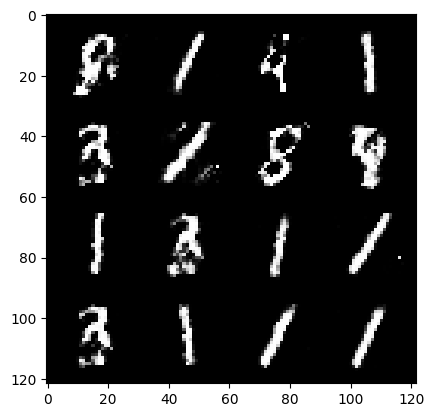

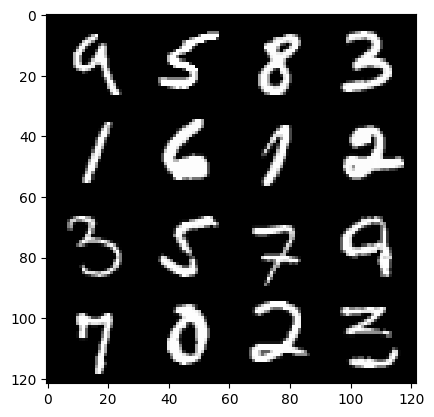

335: Step 157500 / Gen Loss : 2.105791178941727 / Disc Loss : 0.23983573282758405


  0%|          | 0/469 [00:00<?, ?it/s]

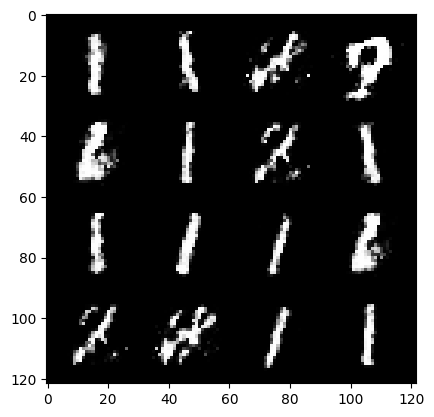

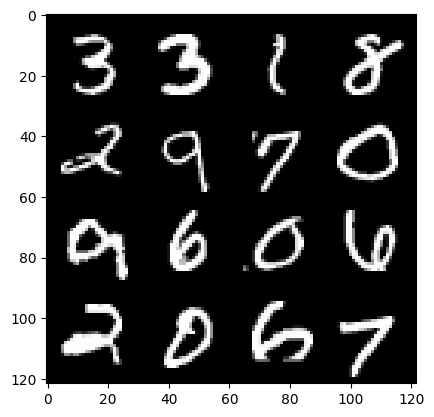

336: Step 157800 / Gen Loss : 1.9904265169302624 / Disc Loss : 0.26988674367467547


  0%|          | 0/469 [00:00<?, ?it/s]

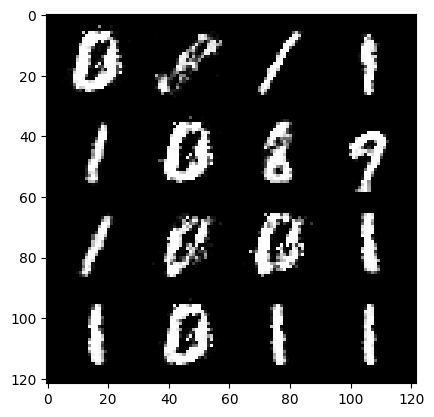

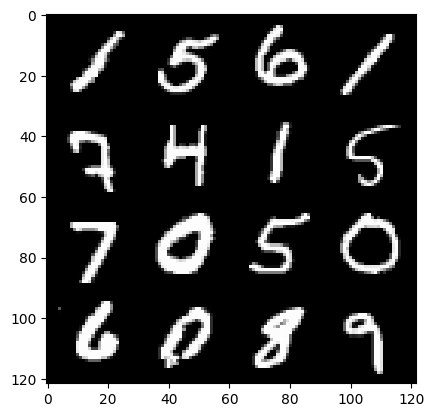

337: Step 158100 / Gen Loss : 2.0777725470066066 / Disc Loss : 0.2670881066222985


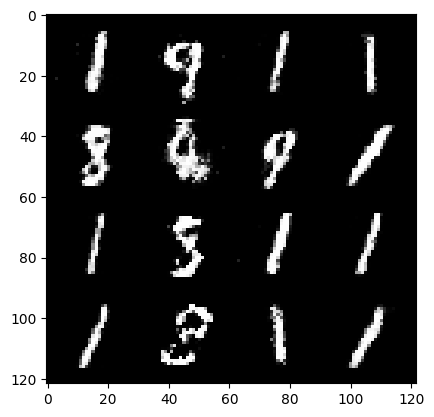

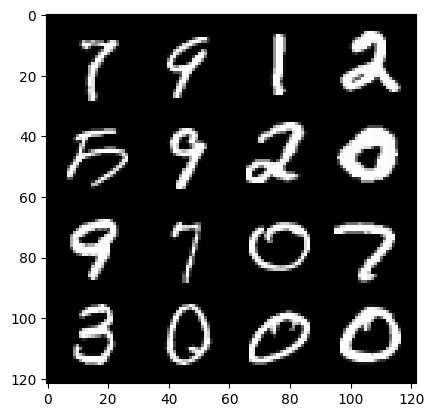

337: Step 158400 / Gen Loss : 2.0889720539251964 / Disc Loss : 0.28151442746321353


  0%|          | 0/469 [00:00<?, ?it/s]

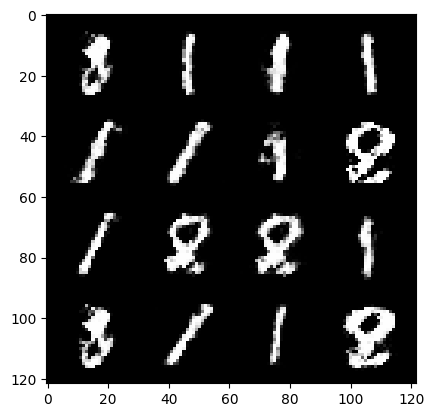

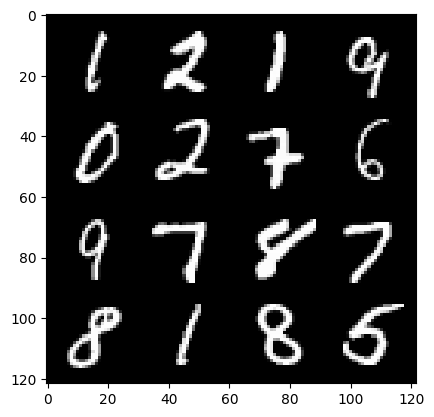

338: Step 158700 / Gen Loss : 2.13036231835683 / Disc Loss : 0.26060381233692165


  0%|          | 0/469 [00:00<?, ?it/s]

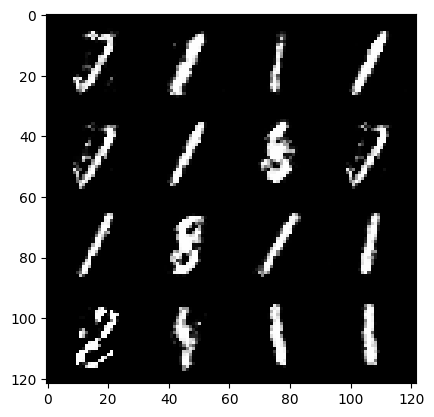

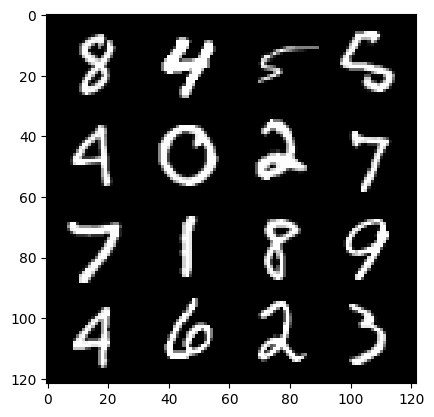

339: Step 159000 / Gen Loss : 2.084546989599863 / Disc Loss : 0.2567668375372886


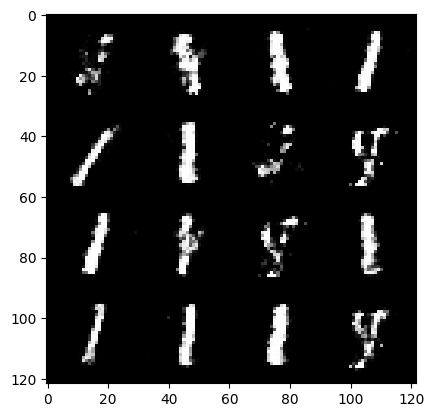

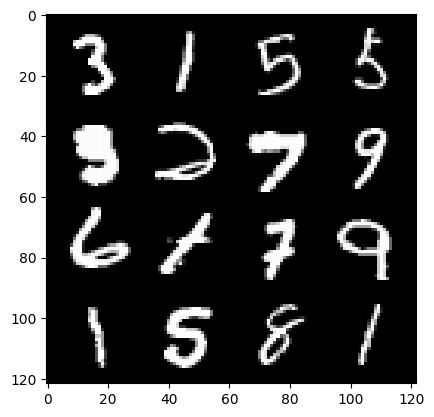

339: Step 159300 / Gen Loss : 2.1513350347677878 / Disc Loss : 0.24392132833600033


  0%|          | 0/469 [00:00<?, ?it/s]

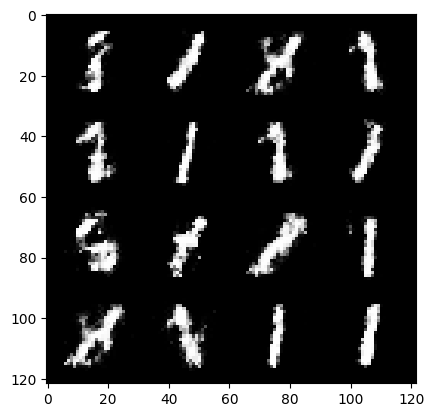

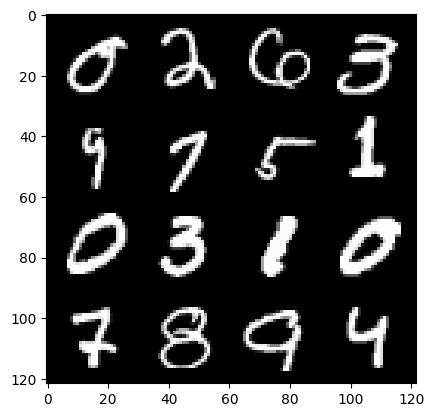

340: Step 159600 / Gen Loss : 2.145211069583894 / Disc Loss : 0.24169800812999417


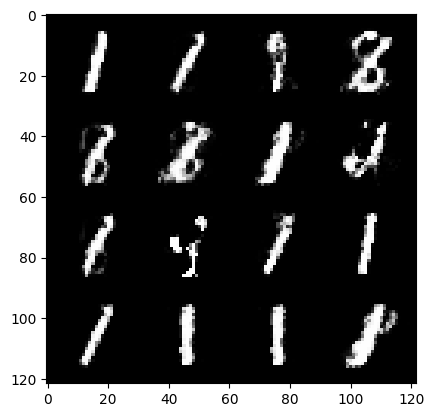

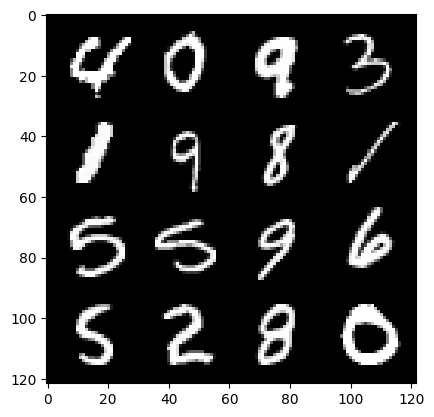

340: Step 159900 / Gen Loss : 1.9553057555357622 / Disc Loss : 0.2820132549603782


  0%|          | 0/469 [00:00<?, ?it/s]

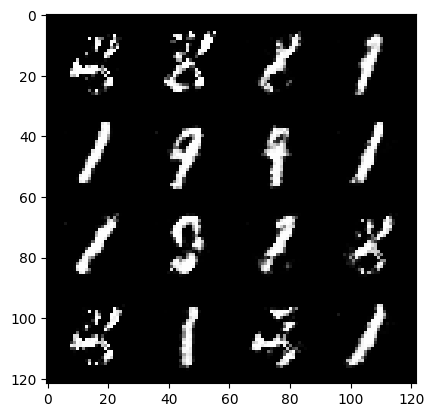

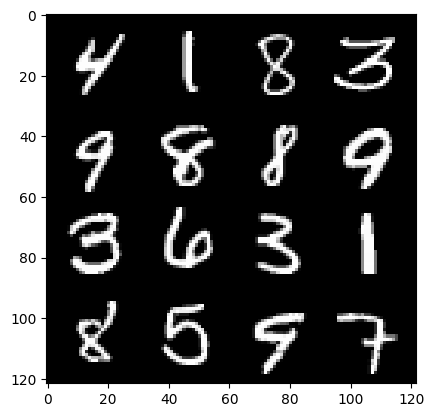

341: Step 160200 / Gen Loss : 2.1031925078233087 / Disc Loss : 0.26488939747214313


  0%|          | 0/469 [00:00<?, ?it/s]

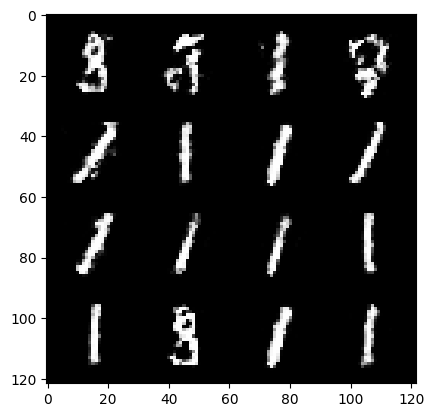

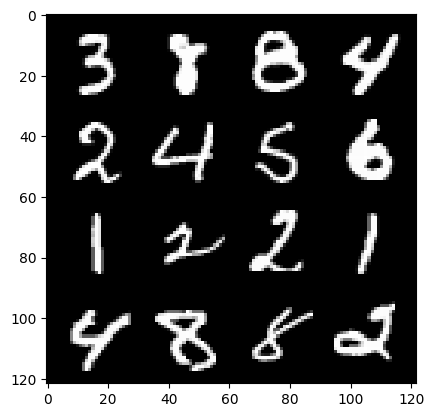

342: Step 160500 / Gen Loss : 2.100301945606867 / Disc Loss : 0.247230454881986


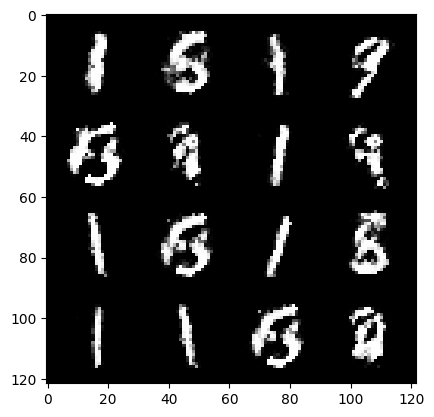

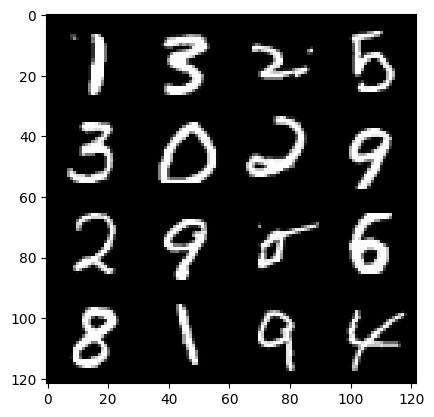

342: Step 160800 / Gen Loss : 2.030109393994013 / Disc Loss : 0.2602020843327045


  0%|          | 0/469 [00:00<?, ?it/s]

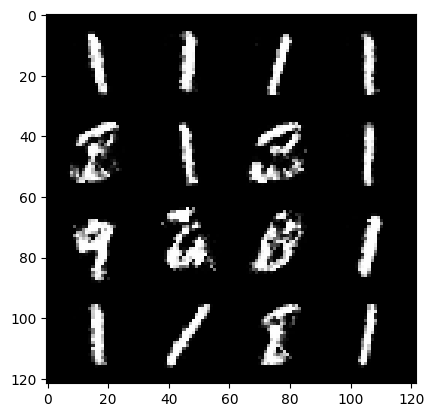

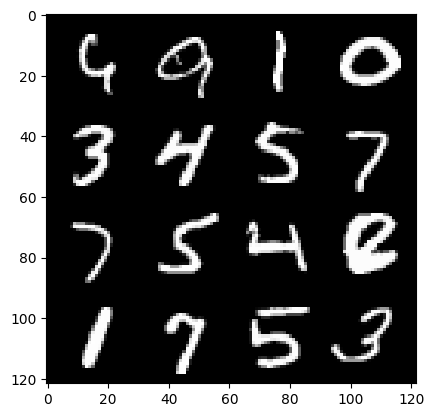

343: Step 161100 / Gen Loss : 2.0483901683489476 / Disc Loss : 0.26049145008126884


  0%|          | 0/469 [00:00<?, ?it/s]

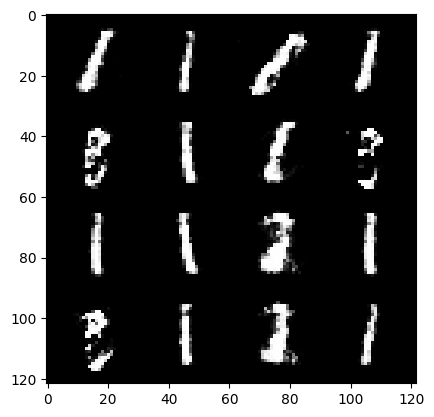

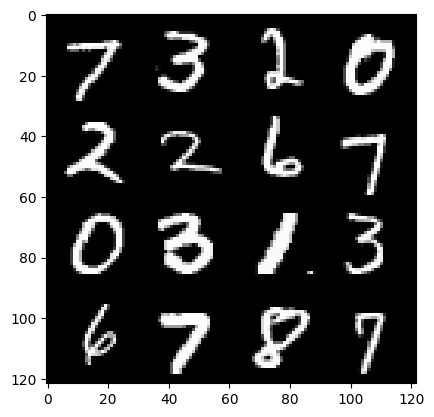

344: Step 161400 / Gen Loss : 2.131252408027649 / Disc Loss : 0.263468276411295


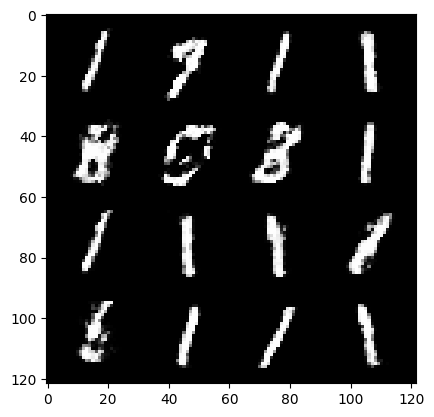

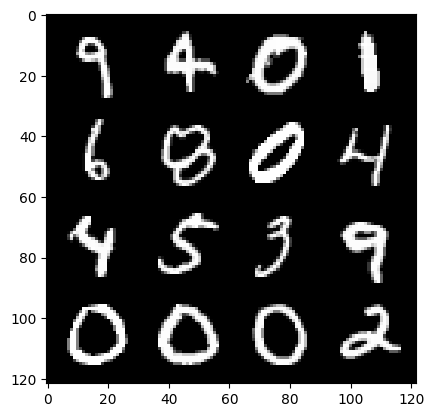

344: Step 161700 / Gen Loss : 1.9658816770712544 / Disc Loss : 0.29068277984857566


  0%|          | 0/469 [00:00<?, ?it/s]

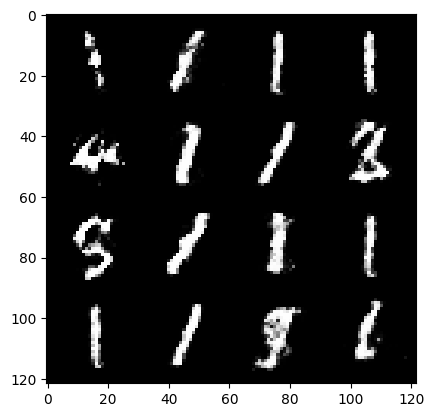

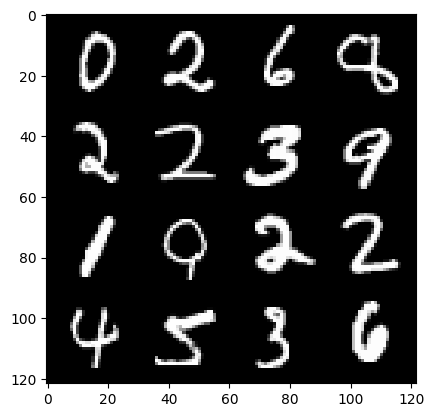

345: Step 162000 / Gen Loss : 1.9165196645259863 / Disc Loss : 0.2939053806165857


  0%|          | 0/469 [00:00<?, ?it/s]

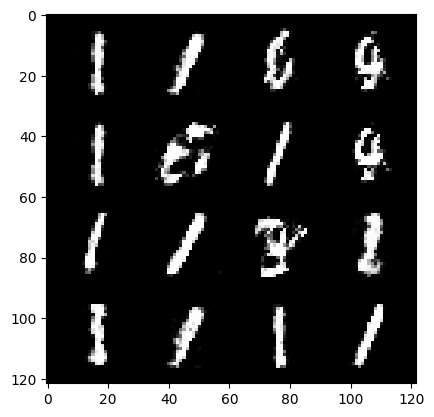

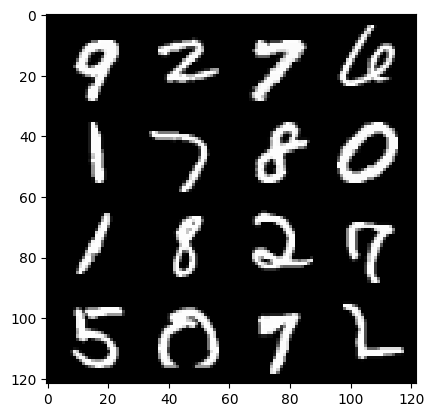

346: Step 162300 / Gen Loss : 1.9725563629468283 / Disc Loss : 0.2847909157474835


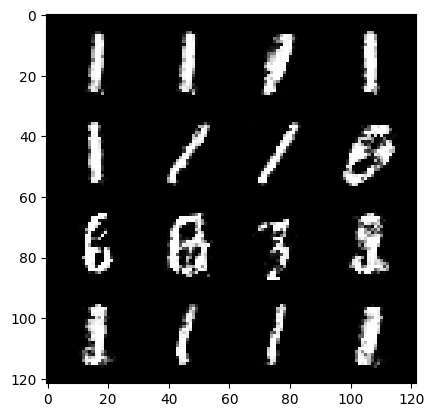

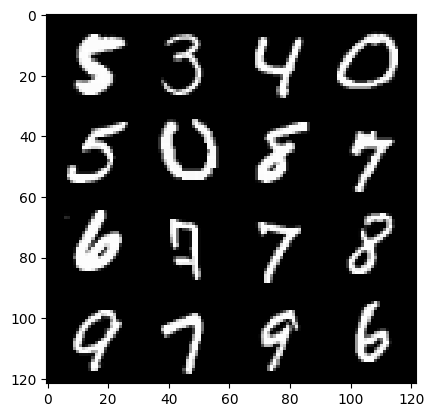

346: Step 162600 / Gen Loss : 2.060368409156799 / Disc Loss : 0.2608137634893257


  0%|          | 0/469 [00:00<?, ?it/s]

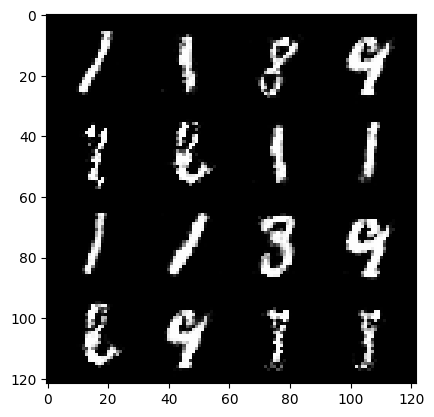

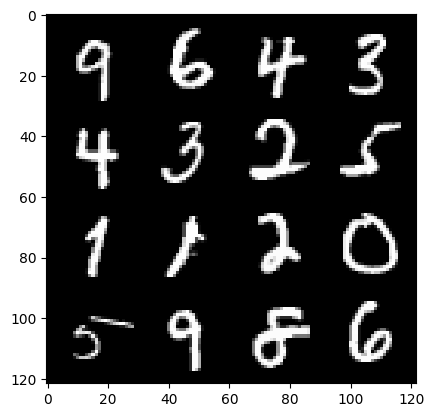

347: Step 162900 / Gen Loss : 1.9977128887176496 / Disc Loss : 0.2611332072317598


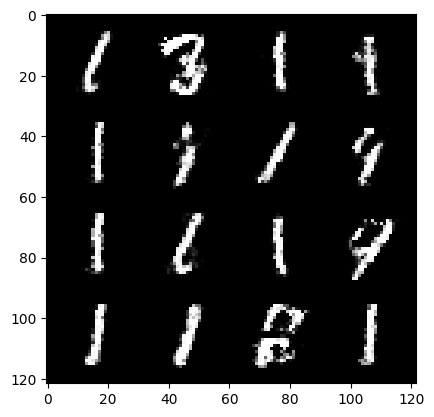

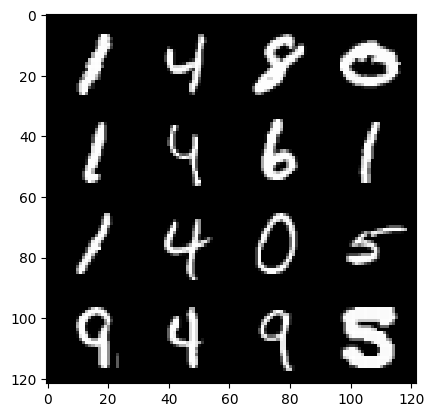

347: Step 163200 / Gen Loss : 2.0328593516349787 / Disc Loss : 0.26200891137123117


  0%|          | 0/469 [00:00<?, ?it/s]

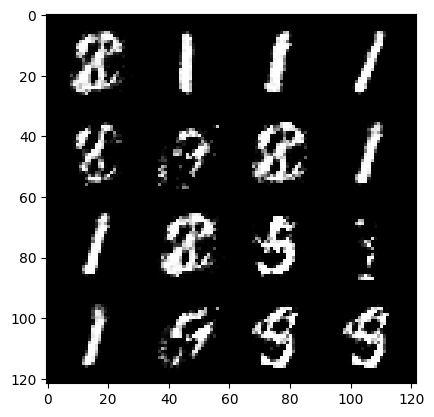

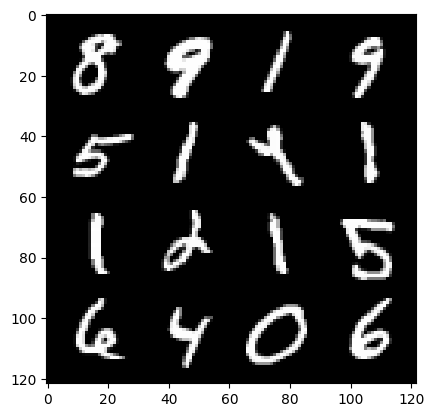

348: Step 163500 / Gen Loss : 2.0085487127304065 / Disc Loss : 0.26257134690880773


  0%|          | 0/469 [00:00<?, ?it/s]

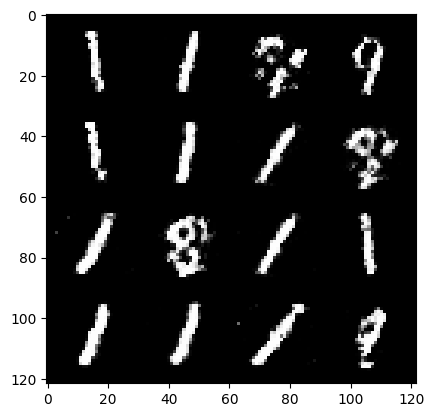

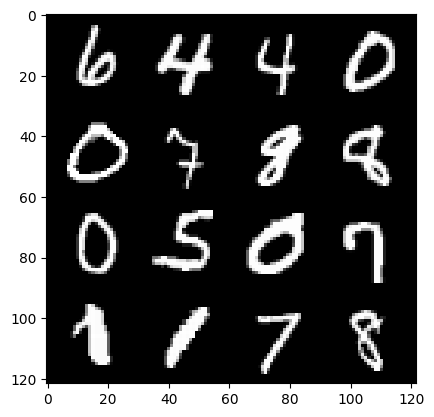

349: Step 163800 / Gen Loss : 2.019825115998584 / Disc Loss : 0.2644798224667708


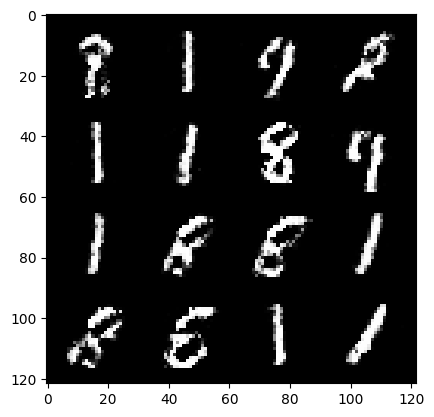

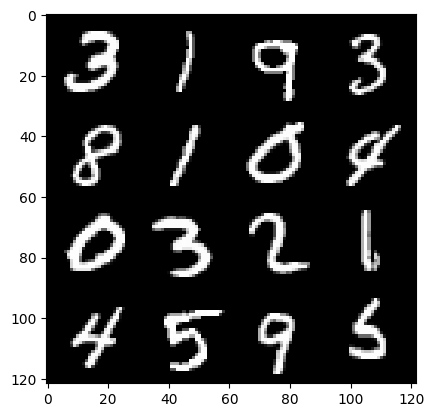

349: Step 164100 / Gen Loss : 2.1506851732730876 / Disc Loss : 0.24705537681778264


  0%|          | 0/469 [00:00<?, ?it/s]

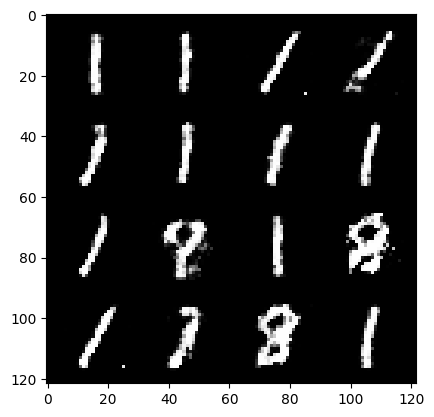

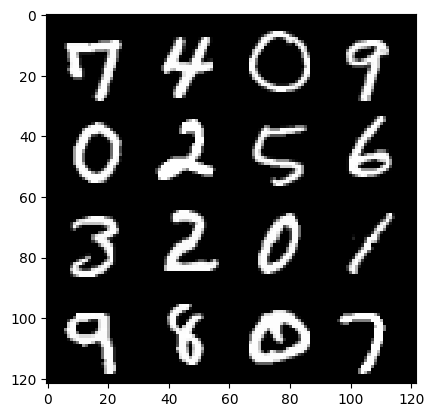

350: Step 164400 / Gen Loss : 2.0841742781798054 / Disc Loss : 0.25325487986207024


  0%|          | 0/469 [00:00<?, ?it/s]

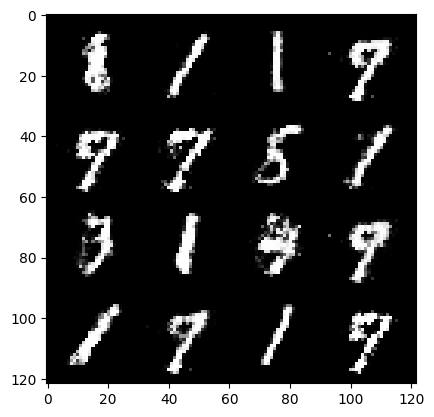

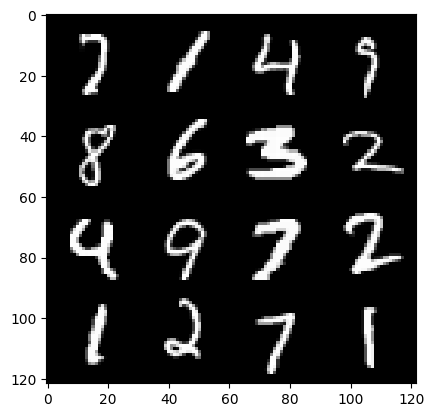

351: Step 164700 / Gen Loss : 2.073825962543488 / Disc Loss : 0.25008641531070075


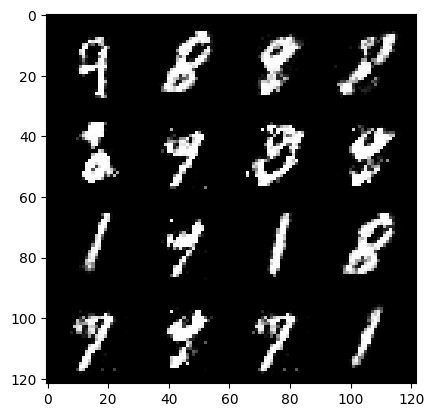

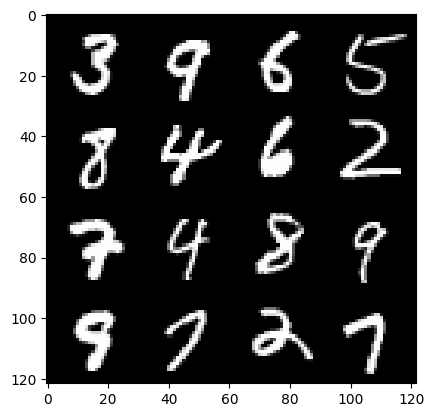

351: Step 165000 / Gen Loss : 2.2075732537110655 / Disc Loss : 0.25536906386415154


  0%|          | 0/469 [00:00<?, ?it/s]

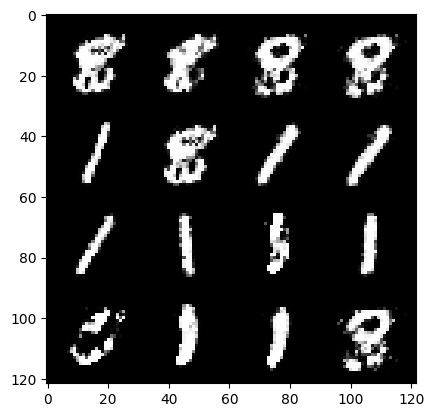

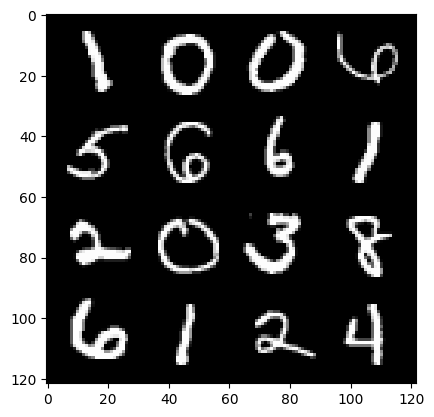

352: Step 165300 / Gen Loss : 2.1522019449869805 / Disc Loss : 0.25304381211598737


  0%|          | 0/469 [00:00<?, ?it/s]

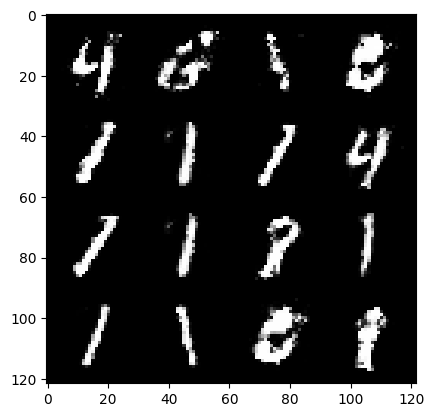

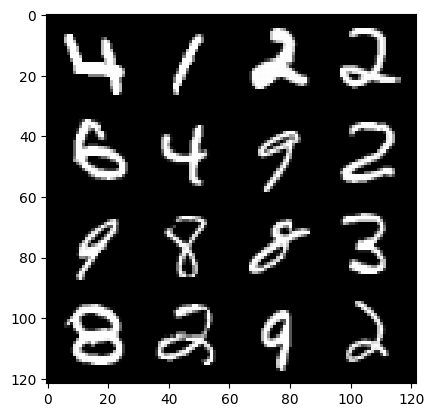

353: Step 165600 / Gen Loss : 2.095437204043069 / Disc Loss : 0.2620898843308291


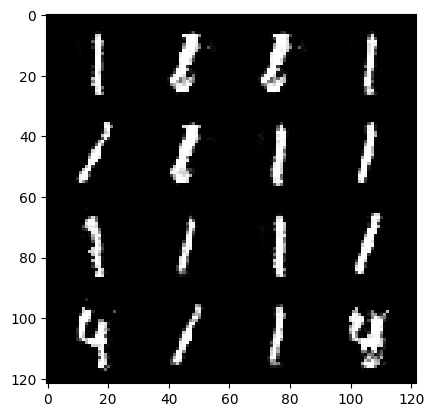

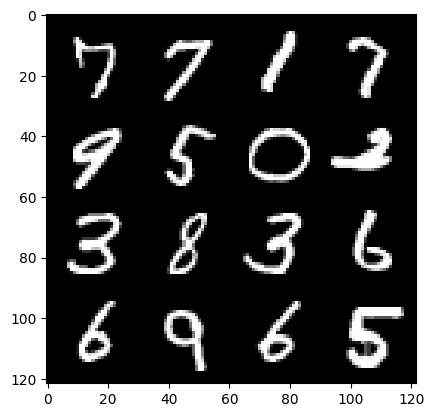

353: Step 165900 / Gen Loss : 2.0772953633467357 / Disc Loss : 0.2566175074875355


  0%|          | 0/469 [00:00<?, ?it/s]

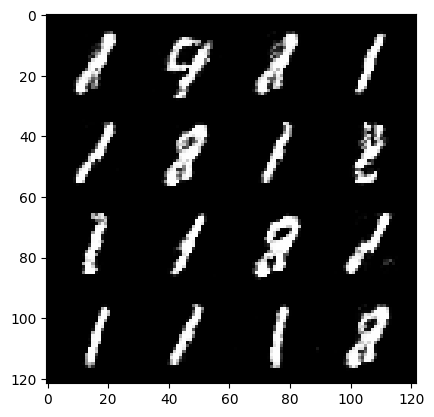

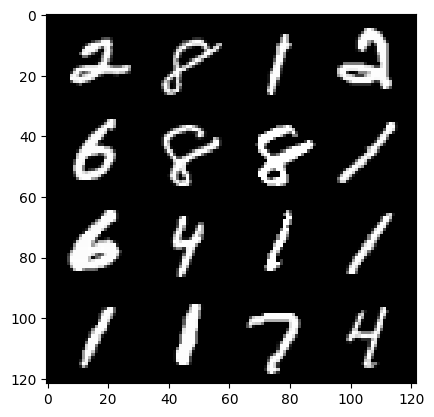

354: Step 166200 / Gen Loss : 2.0145585147539777 / Disc Loss : 0.2727645929654441


  0%|          | 0/469 [00:00<?, ?it/s]

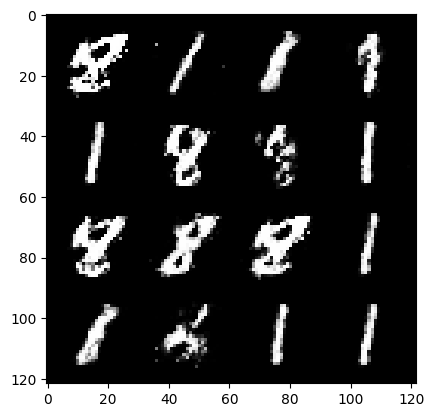

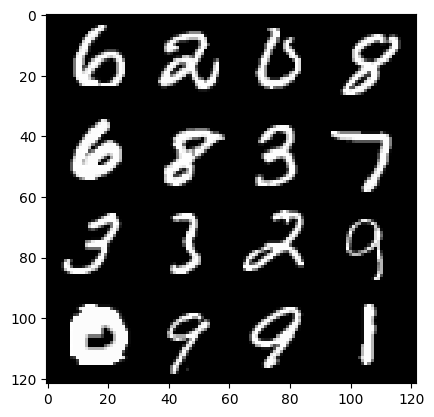

355: Step 166500 / Gen Loss : 1.9730774780114508 / Disc Loss : 0.29654497315486283


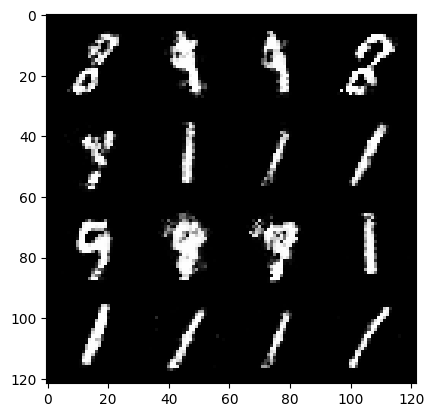

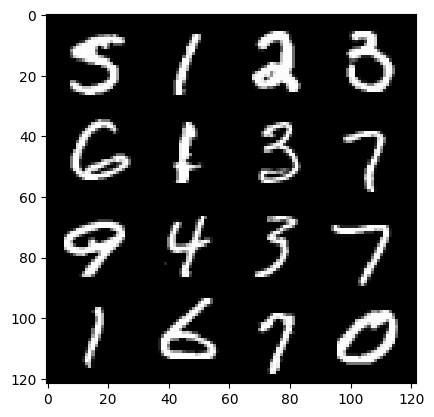

355: Step 166800 / Gen Loss : 1.9710211324691769 / Disc Loss : 0.27719290281335507


  0%|          | 0/469 [00:00<?, ?it/s]

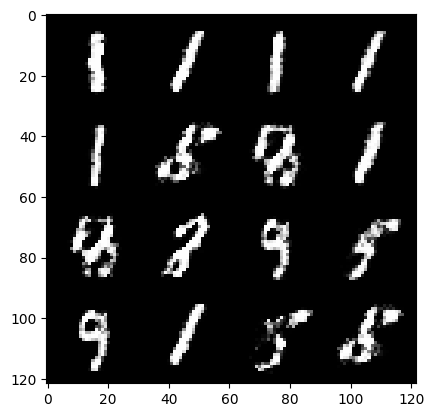

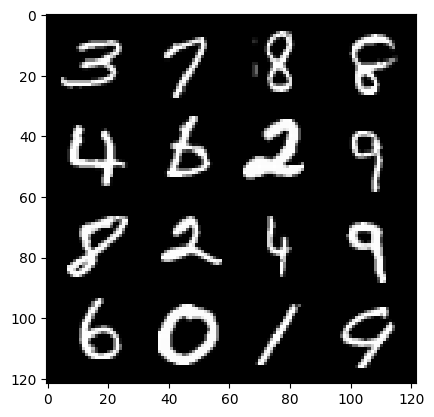

356: Step 167100 / Gen Loss : 2.0124484471480053 / Disc Loss : 0.2782203057408334


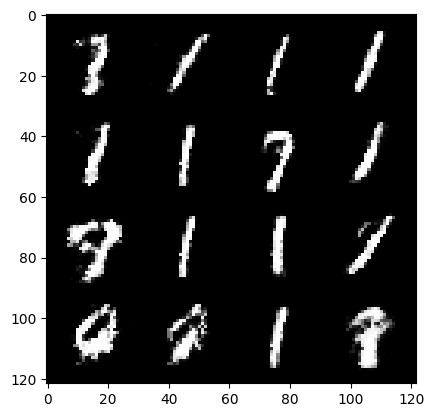

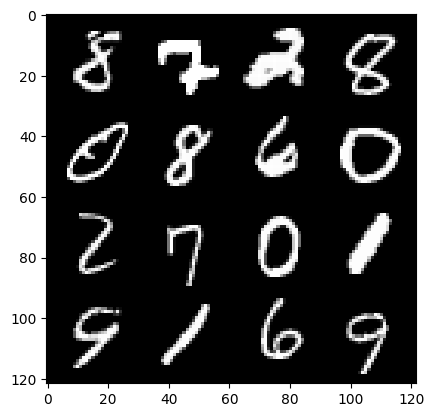

356: Step 167400 / Gen Loss : 2.0465526096026108 / Disc Loss : 0.26675989309946696


  0%|          | 0/469 [00:00<?, ?it/s]

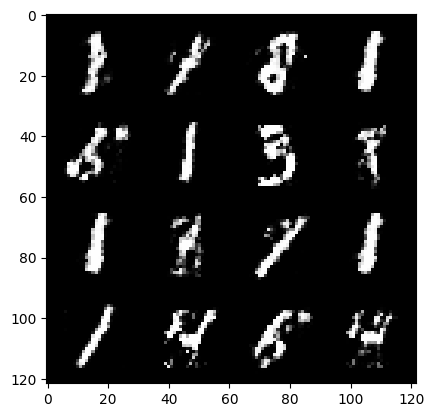

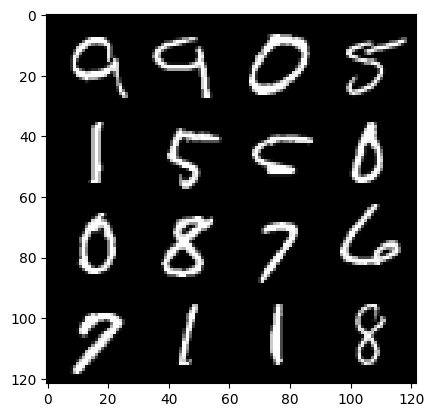

357: Step 167700 / Gen Loss : 2.008264924287796 / Disc Loss : 0.27113144025206565


  0%|          | 0/469 [00:00<?, ?it/s]

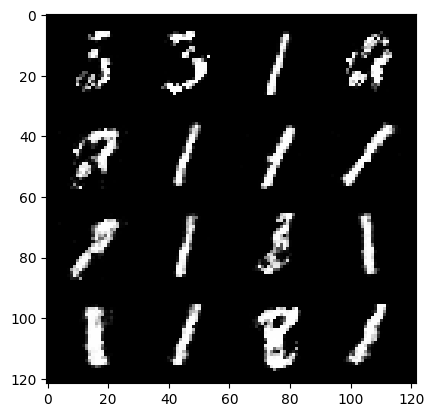

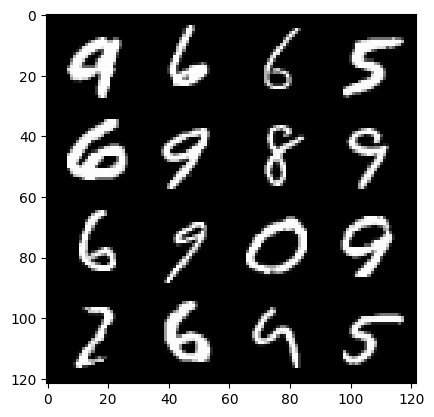

358: Step 168000 / Gen Loss : 2.116077398061754 / Disc Loss : 0.26154152279098836


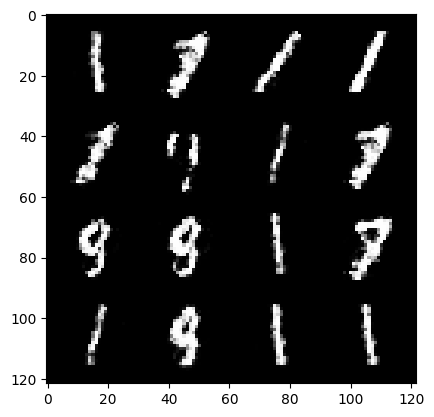

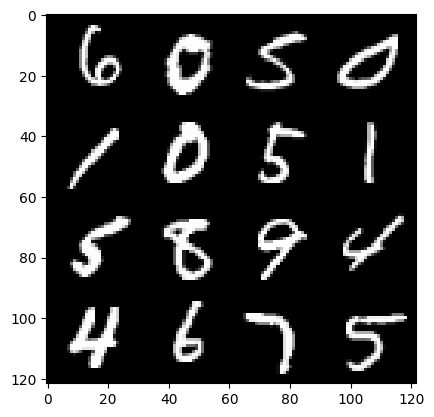

358: Step 168300 / Gen Loss : 2.027643344402313 / Disc Loss : 0.263113139718771


  0%|          | 0/469 [00:00<?, ?it/s]

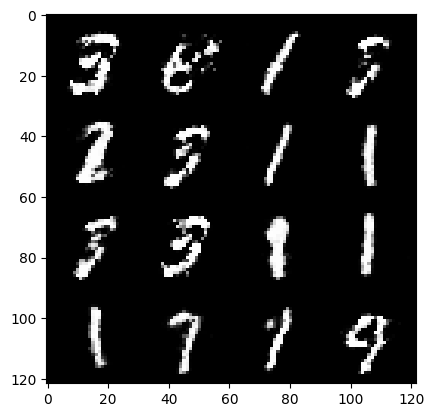

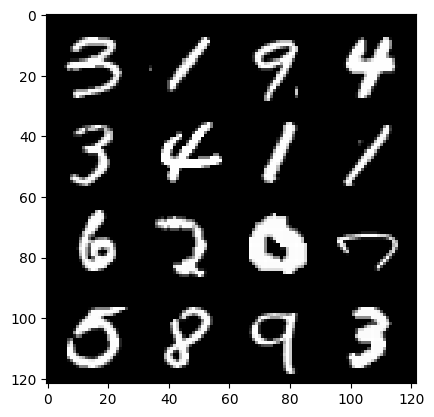

359: Step 168600 / Gen Loss : 2.0414051103591917 / Disc Loss : 0.2601248167951903


  0%|          | 0/469 [00:00<?, ?it/s]

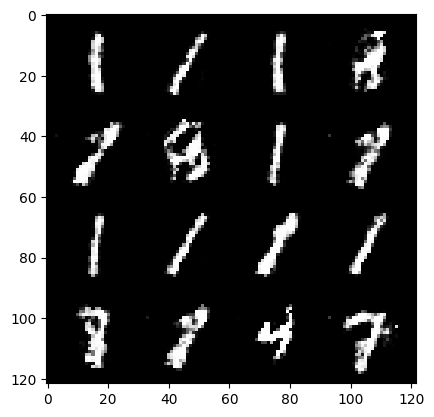

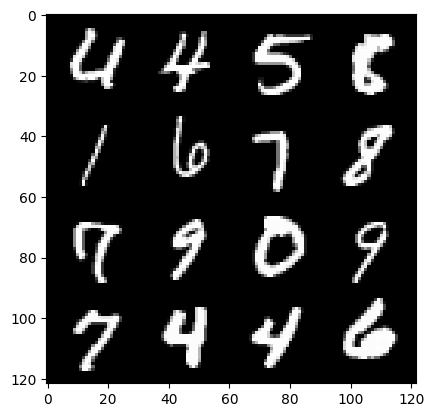

360: Step 168900 / Gen Loss : 2.1206773678461714 / Disc Loss : 0.2691157431403794


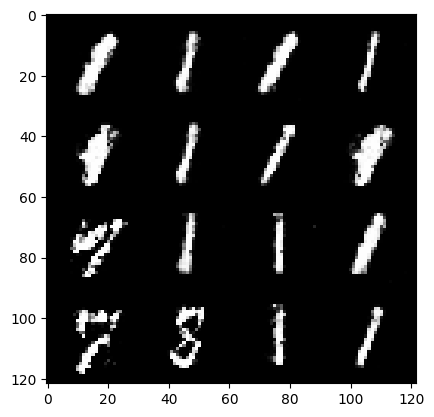

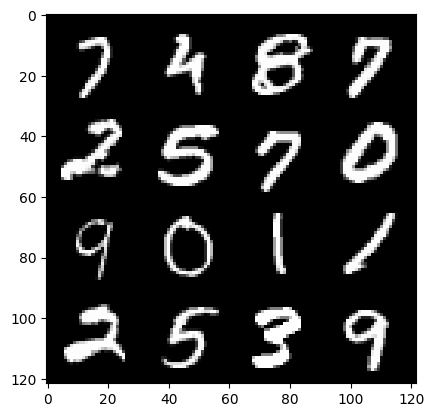

360: Step 169200 / Gen Loss : 2.0470360330740607 / Disc Loss : 0.25936402072509135


  0%|          | 0/469 [00:00<?, ?it/s]

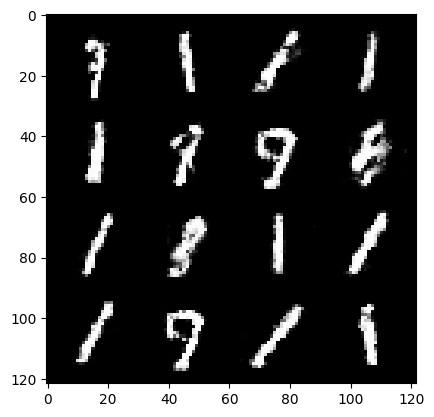

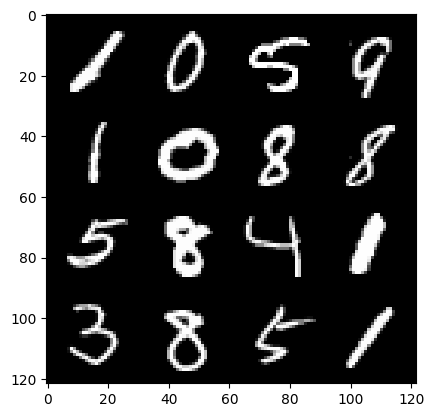

361: Step 169500 / Gen Loss : 2.1167215534051267 / Disc Loss : 0.25727477798859266


  0%|          | 0/469 [00:00<?, ?it/s]

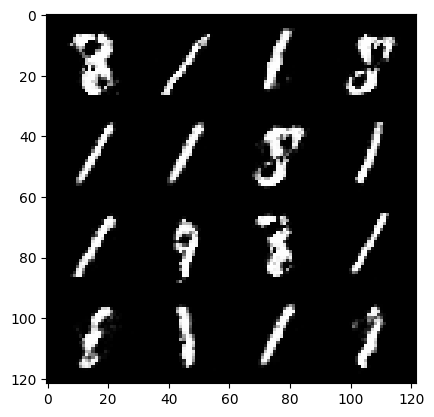

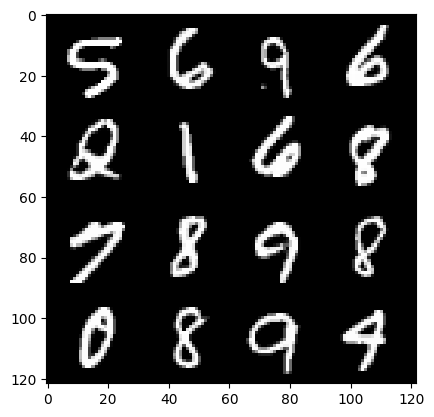

362: Step 169800 / Gen Loss : 2.1736576219399777 / Disc Loss : 0.2567037923137347


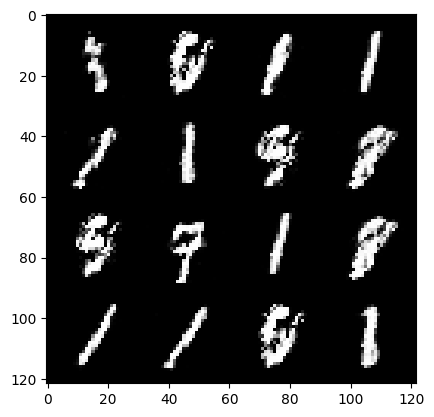

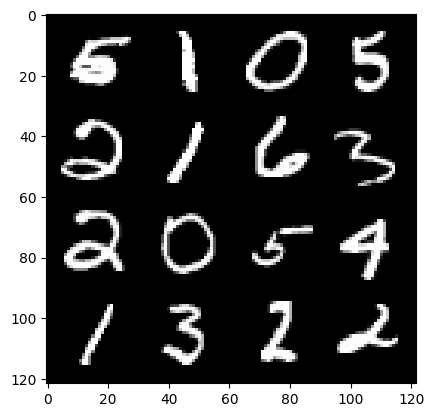

362: Step 170100 / Gen Loss : 2.07042920589447 / Disc Loss : 0.25949327453970916


  0%|          | 0/469 [00:00<?, ?it/s]

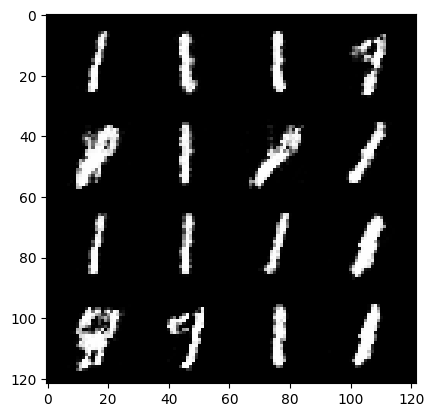

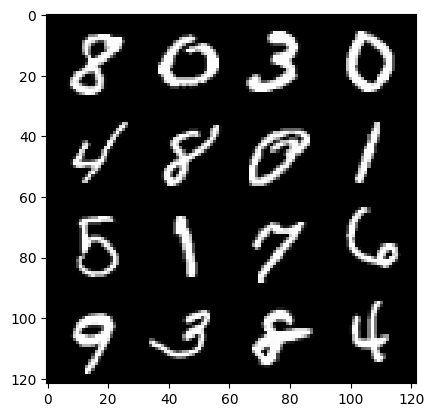

363: Step 170400 / Gen Loss : 2.277901522318525 / Disc Loss : 0.23903860419988626


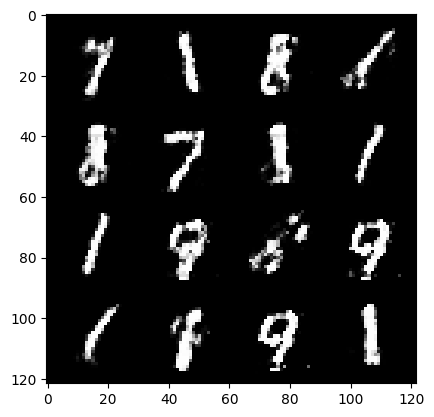

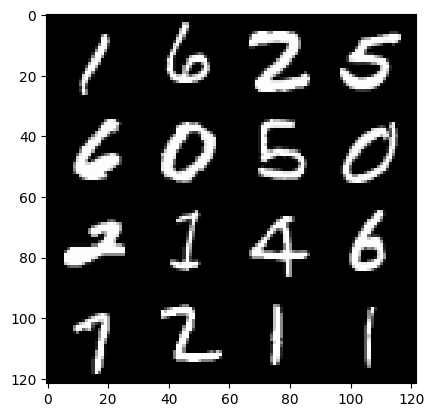

363: Step 170700 / Gen Loss : 2.219459564288457 / Disc Loss : 0.2536512577533722


  0%|          | 0/469 [00:00<?, ?it/s]

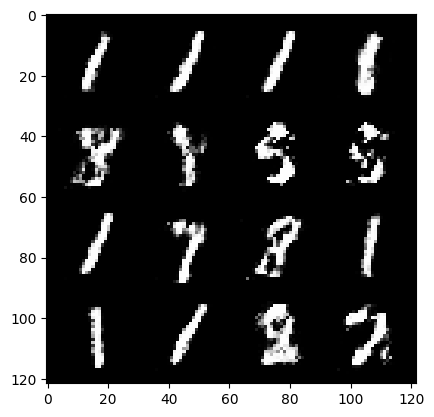

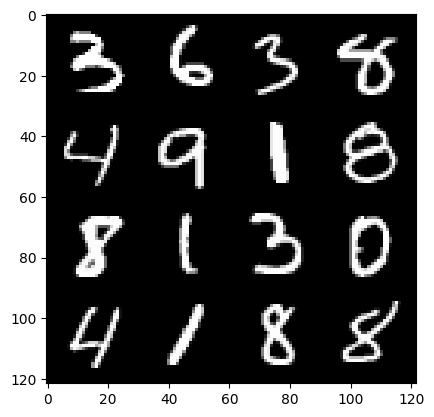

364: Step 171000 / Gen Loss : 2.1622179679075897 / Disc Loss : 0.24823263789216676


  0%|          | 0/469 [00:00<?, ?it/s]

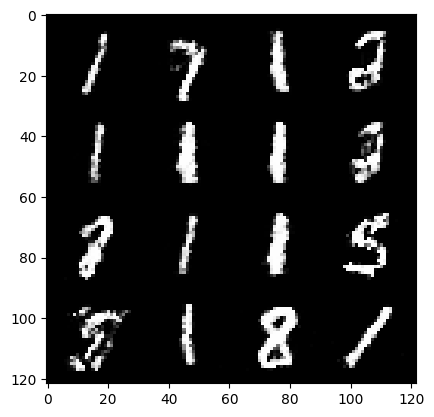

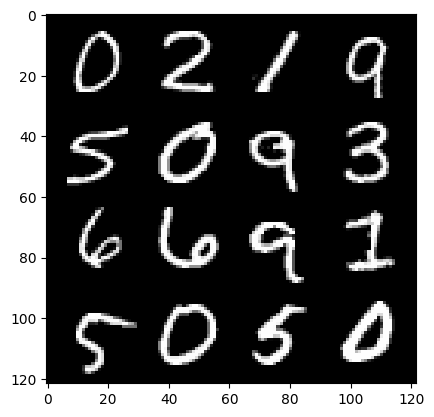

365: Step 171300 / Gen Loss : 2.260007528066636 / Disc Loss : 0.237455088744561


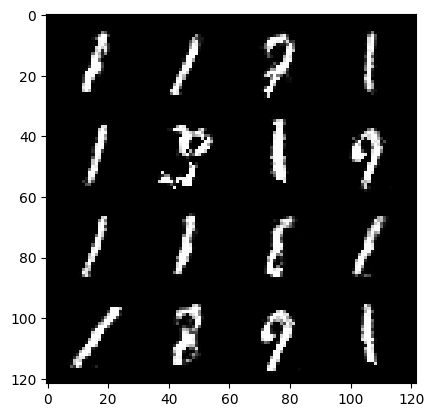

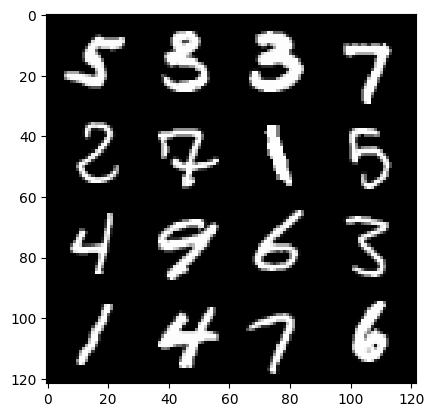

365: Step 171600 / Gen Loss : 2.1738653258482614 / Disc Loss : 0.2424010118842125


  0%|          | 0/469 [00:00<?, ?it/s]

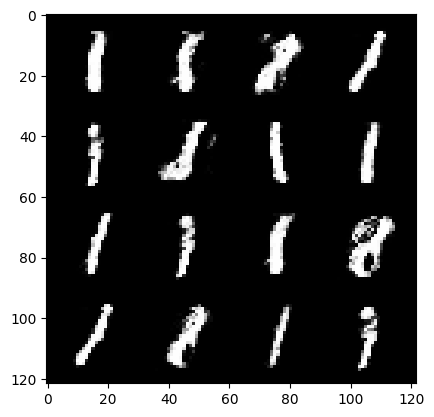

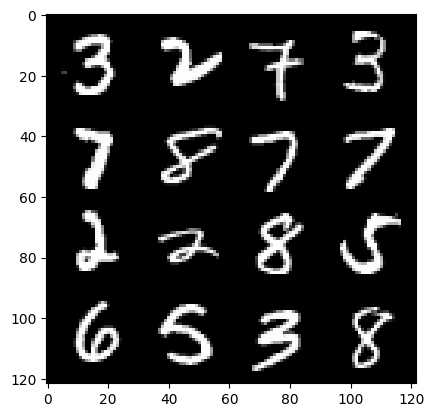

366: Step 171900 / Gen Loss : 2.1610137371222176 / Disc Loss : 0.2436216997603576


  0%|          | 0/469 [00:00<?, ?it/s]

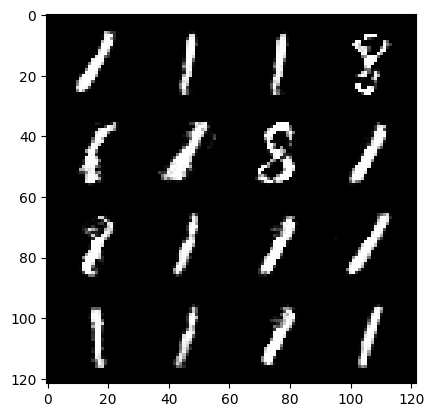

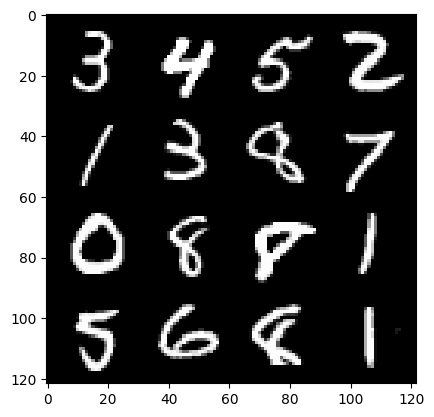

367: Step 172200 / Gen Loss : 2.3224191625912987 / Disc Loss : 0.20774915009737002


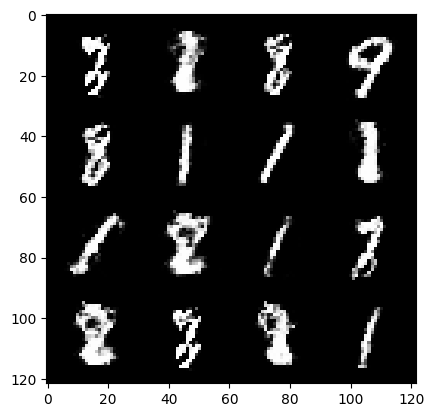

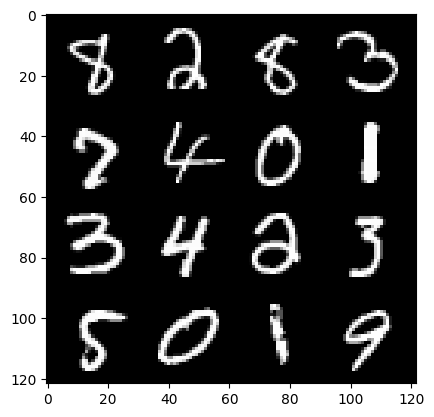

367: Step 172500 / Gen Loss : 2.1814256878693925 / Disc Loss : 0.23704126805067058


  0%|          | 0/469 [00:00<?, ?it/s]

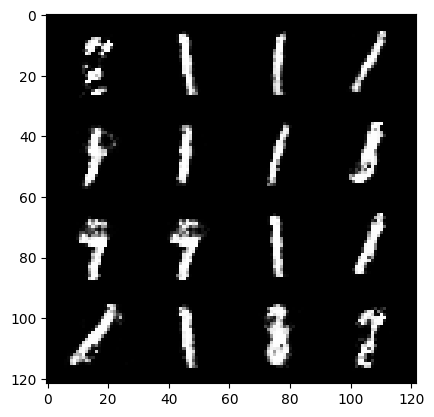

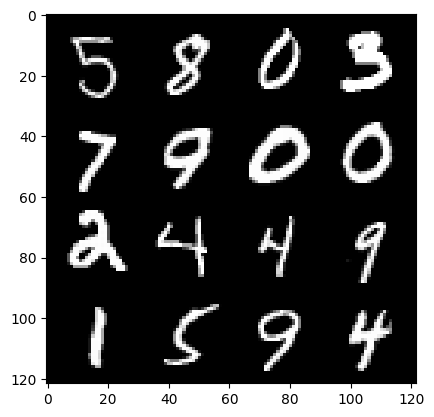

368: Step 172800 / Gen Loss : 2.1163637157281245 / Disc Loss : 0.2582159297168256


  0%|          | 0/469 [00:00<?, ?it/s]

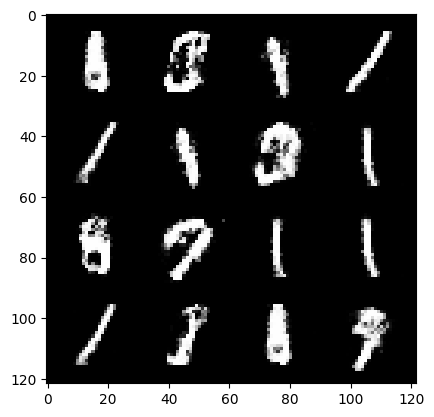

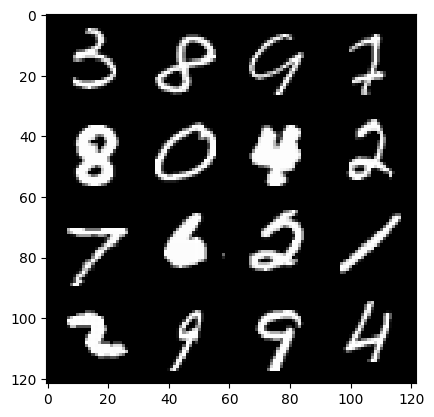

369: Step 173100 / Gen Loss : 2.0810565471649176 / Disc Loss : 0.25479538843035704


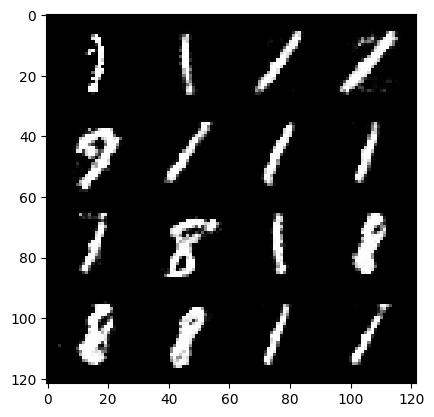

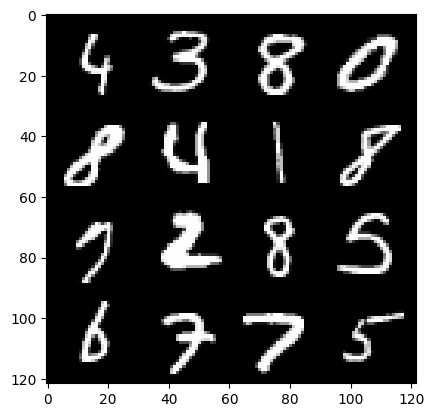

369: Step 173400 / Gen Loss : 2.045346352656684 / Disc Loss : 0.25938909227649365


  0%|          | 0/469 [00:00<?, ?it/s]

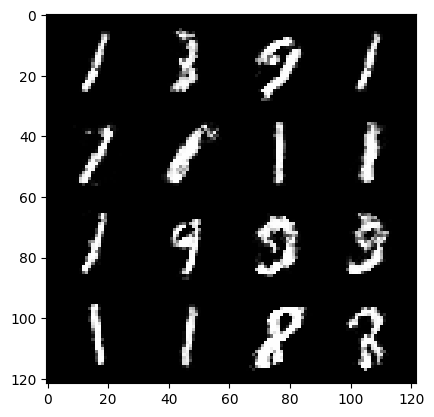

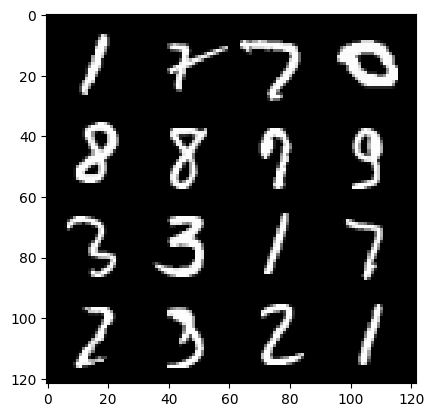

370: Step 173700 / Gen Loss : 2.099473712841671 / Disc Loss : 0.25353893414139733


  0%|          | 0/469 [00:00<?, ?it/s]

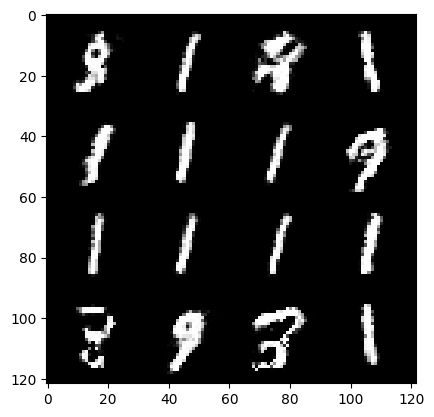

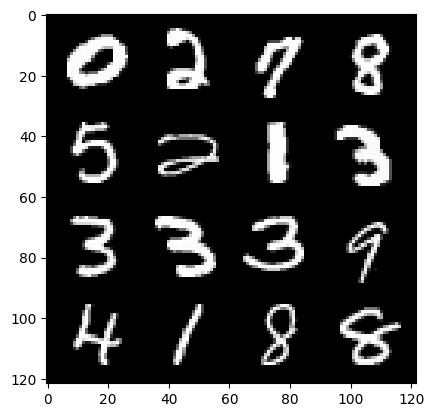

371: Step 174000 / Gen Loss : 2.1013095080852513 / Disc Loss : 0.24359293783704425


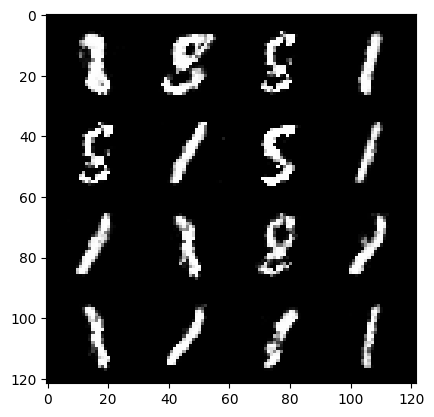

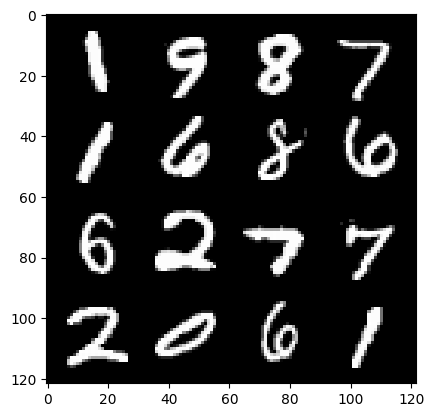

371: Step 174300 / Gen Loss : 2.100772287448248 / Disc Loss : 0.25597651789585757


  0%|          | 0/469 [00:00<?, ?it/s]

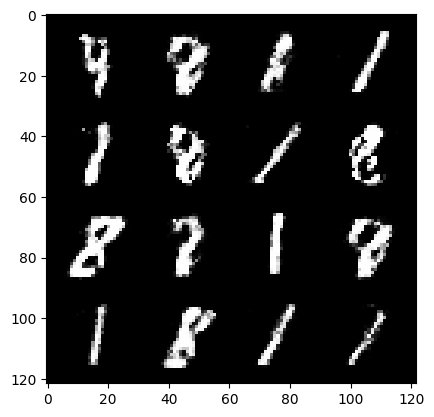

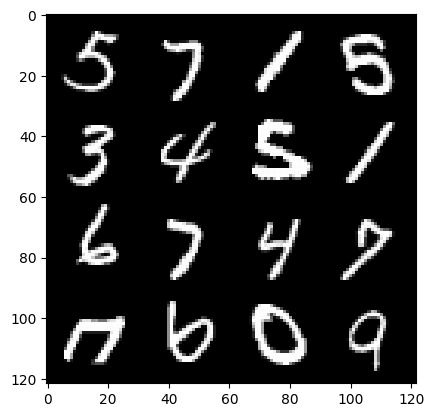

372: Step 174600 / Gen Loss : 2.081130685408909 / Disc Loss : 0.26107165182630226


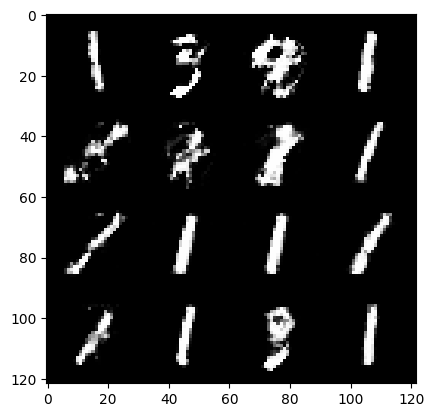

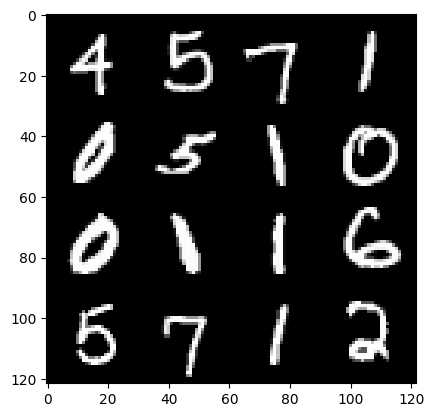

372: Step 174900 / Gen Loss : 2.1759438498814894 / Disc Loss : 0.243980557322502


  0%|          | 0/469 [00:00<?, ?it/s]

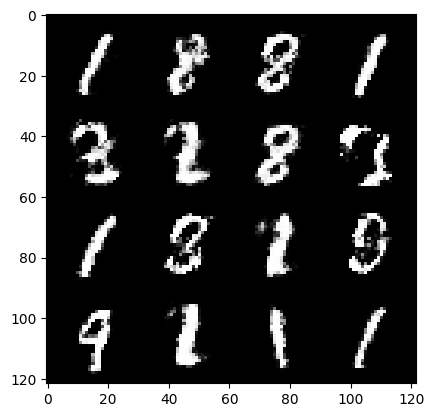

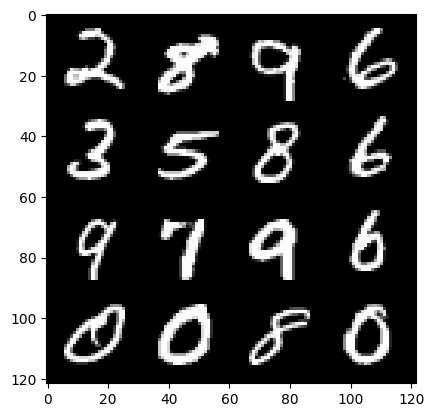

373: Step 175200 / Gen Loss : 2.151220728556316 / Disc Loss : 0.25298482403159156


  0%|          | 0/469 [00:00<?, ?it/s]

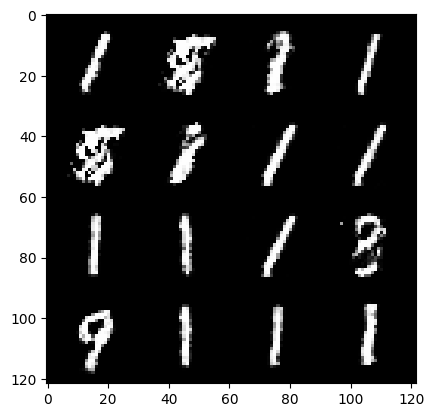

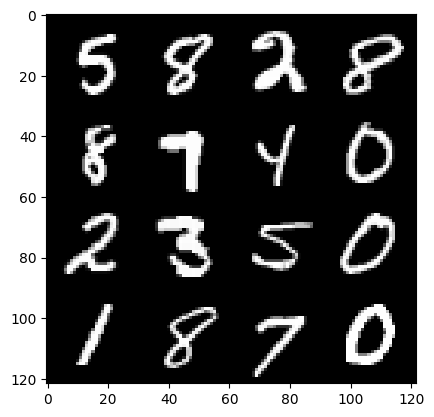

374: Step 175500 / Gen Loss : 2.123358086744944 / Disc Loss : 0.2641281704604628


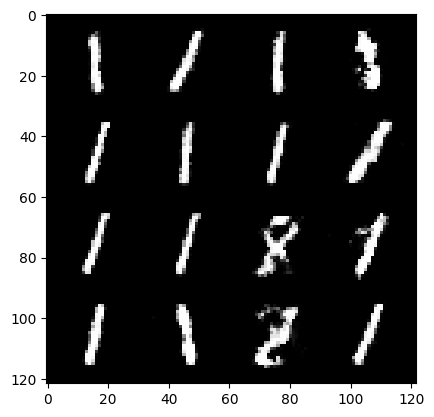

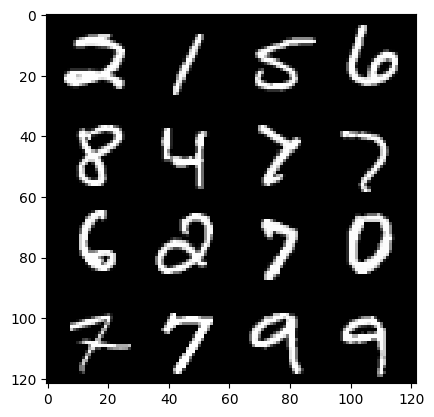

374: Step 175800 / Gen Loss : 2.113645919958751 / Disc Loss : 0.2694502719740075


  0%|          | 0/469 [00:00<?, ?it/s]

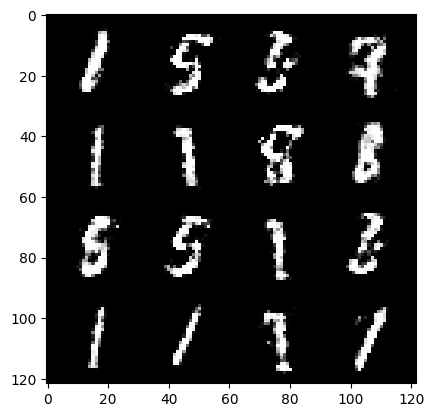

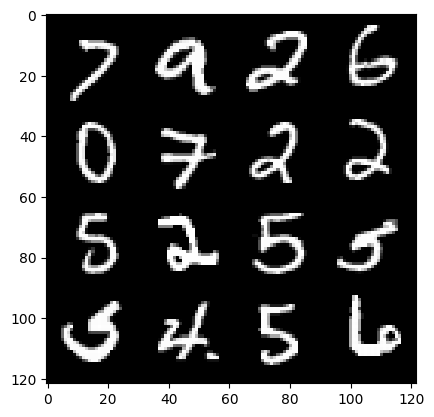

375: Step 176100 / Gen Loss : 2.0938459793726616 / Disc Loss : 0.26072292760014537


  0%|          | 0/469 [00:00<?, ?it/s]

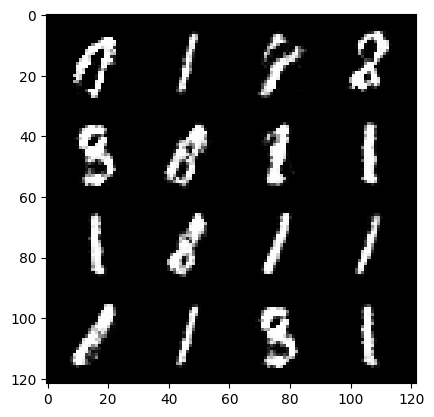

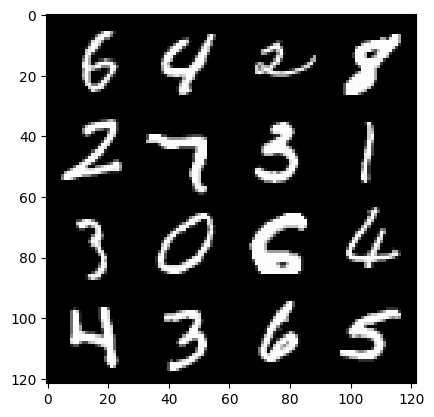

376: Step 176400 / Gen Loss : 2.0977058009306586 / Disc Loss : 0.25290841420491544


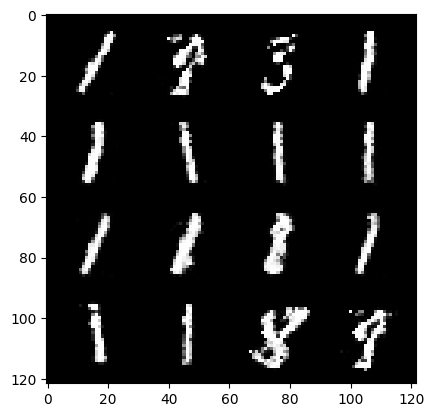

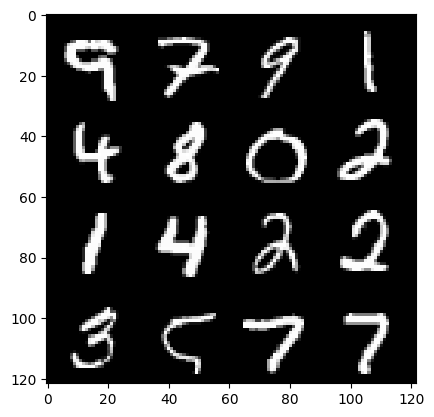

376: Step 176700 / Gen Loss : 2.081626973946888 / Disc Loss : 0.2588340644041697


  0%|          | 0/469 [00:00<?, ?it/s]

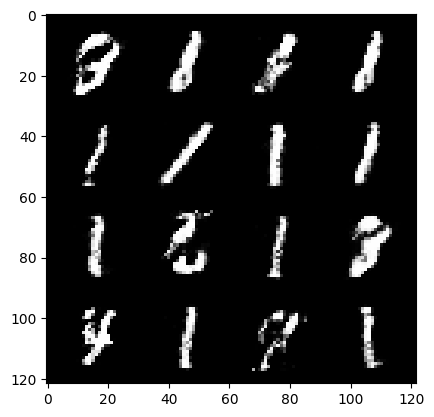

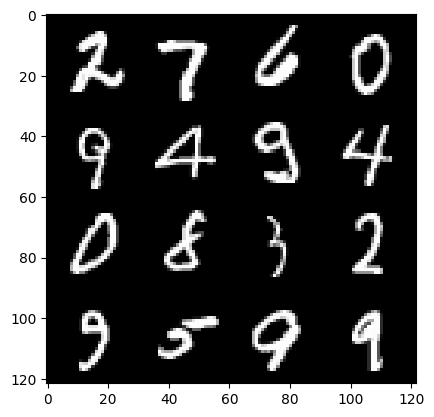

377: Step 177000 / Gen Loss : 2.102463889916736 / Disc Loss : 0.26192092483242346


  0%|          | 0/469 [00:00<?, ?it/s]

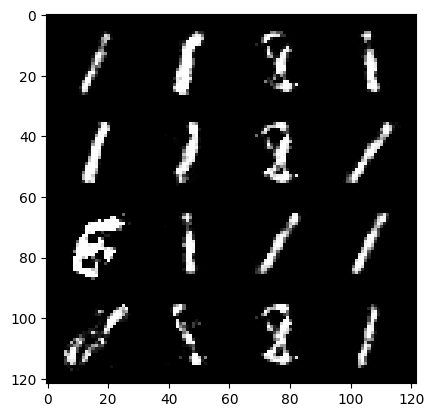

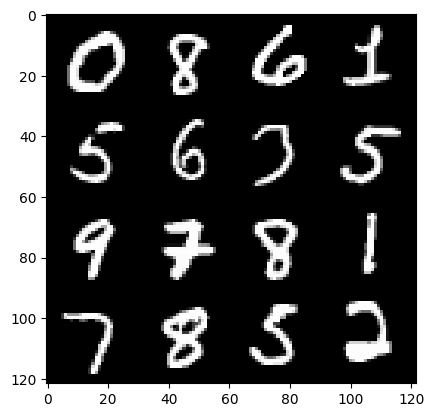

378: Step 177300 / Gen Loss : 2.20649655898412 / Disc Loss : 0.23676769629120825


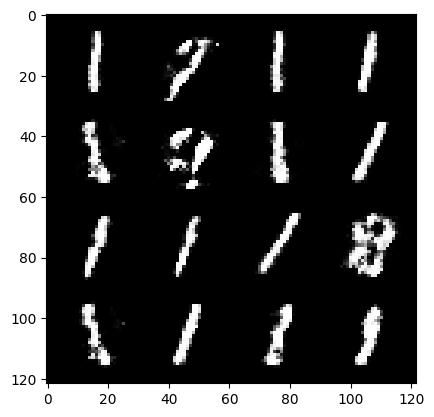

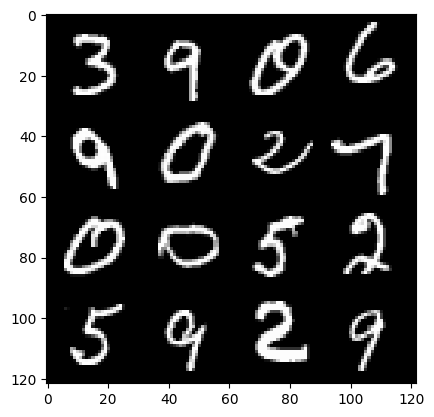

378: Step 177600 / Gen Loss : 2.2553287136554716 / Disc Loss : 0.22837647934754673


  0%|          | 0/469 [00:00<?, ?it/s]

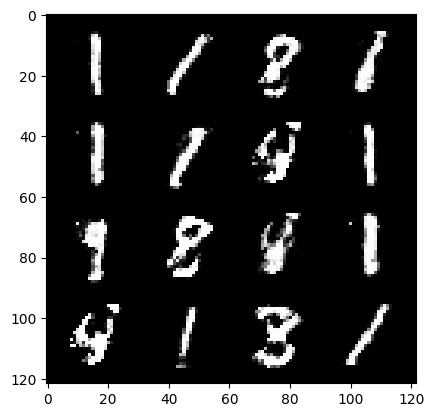

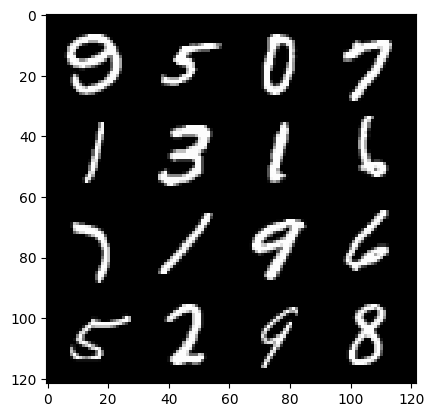

379: Step 177900 / Gen Loss : 2.2117208290100114 / Disc Loss : 0.24505375027656556


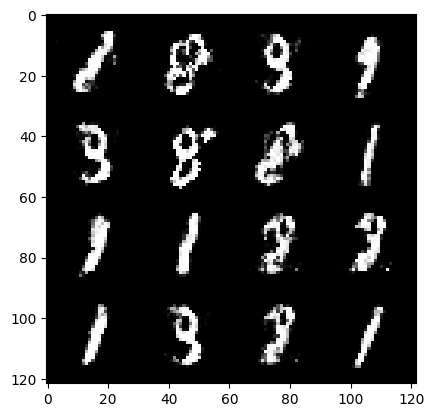

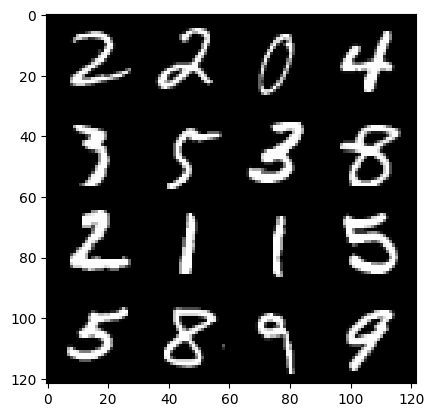

379: Step 178200 / Gen Loss : 2.1508405069510146 / Disc Loss : 0.25088335737586026


  0%|          | 0/469 [00:00<?, ?it/s]

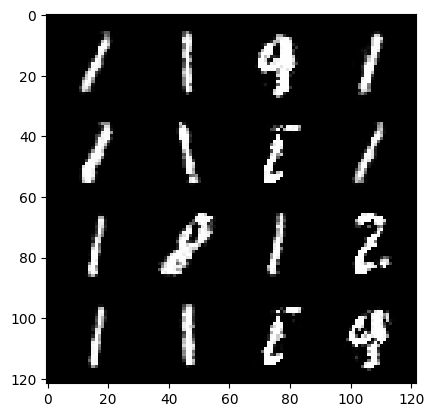

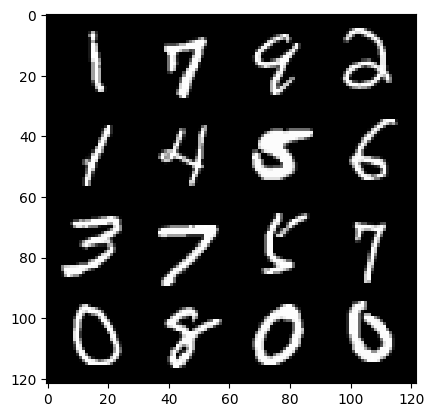

380: Step 178500 / Gen Loss : 2.1718317540486662 / Disc Loss : 0.25801977872848525


  0%|          | 0/469 [00:00<?, ?it/s]

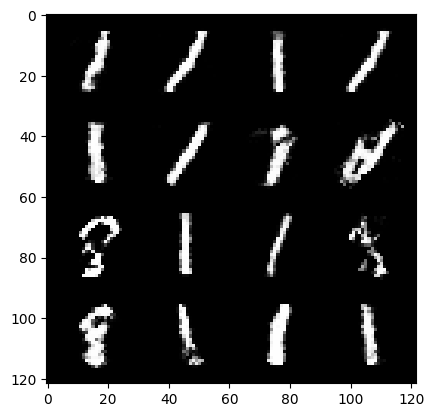

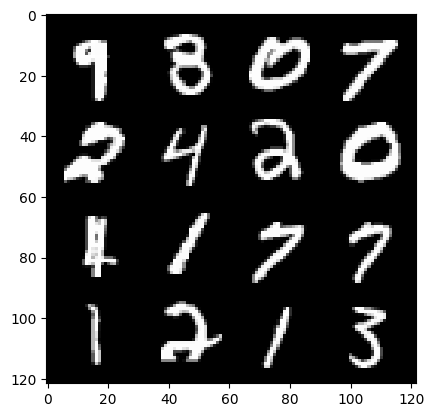

381: Step 178800 / Gen Loss : 2.1341855529944103 / Disc Loss : 0.25909787327051165


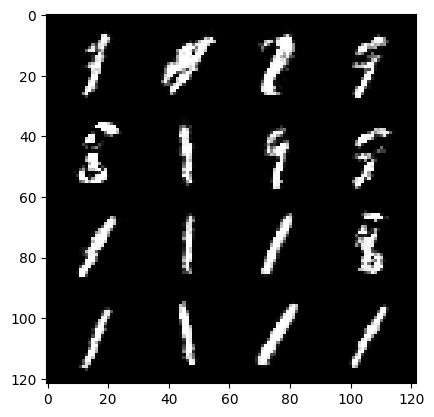

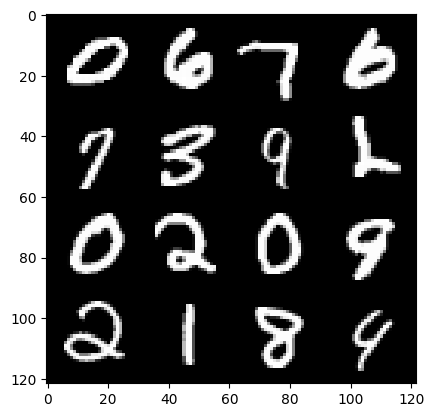

381: Step 179100 / Gen Loss : 2.0587295405069974 / Disc Loss : 0.2533415473004186


  0%|          | 0/469 [00:00<?, ?it/s]

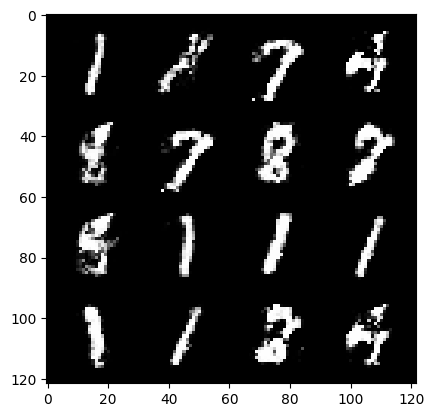

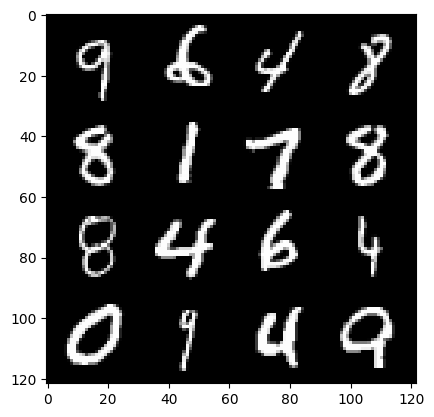

382: Step 179400 / Gen Loss : 2.206673586765926 / Disc Loss : 0.24374441320697465


  0%|          | 0/469 [00:00<?, ?it/s]

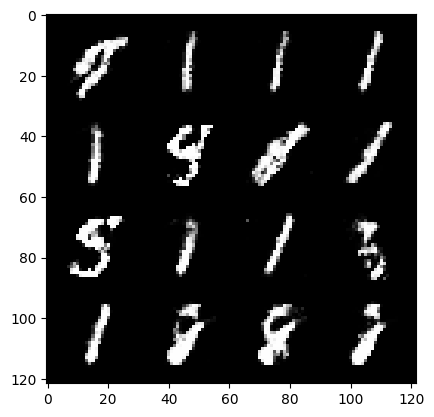

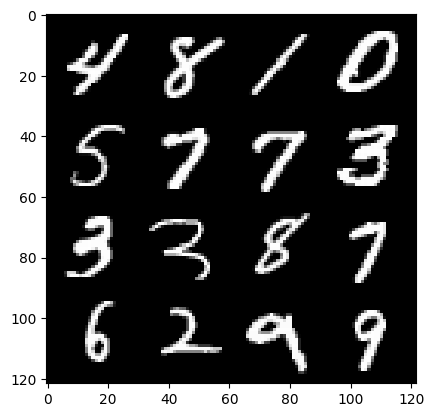

383: Step 179700 / Gen Loss : 2.2355470601717653 / Disc Loss : 0.2360587731500465


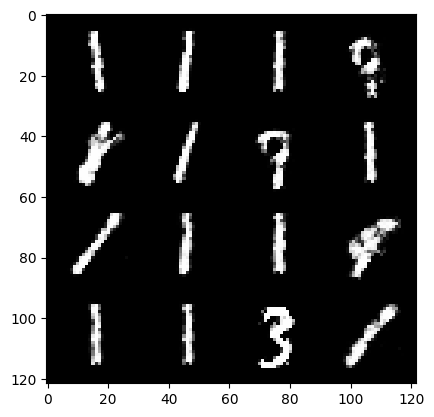

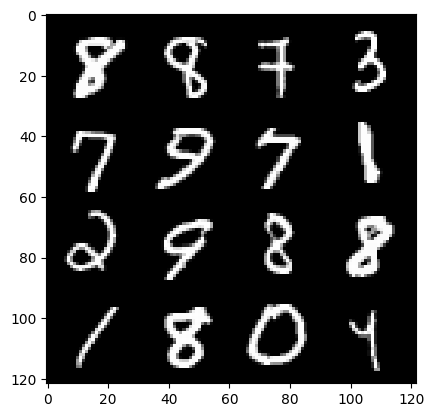

383: Step 180000 / Gen Loss : 2.201281064351399 / Disc Loss : 0.2349576066434383


  0%|          | 0/469 [00:00<?, ?it/s]

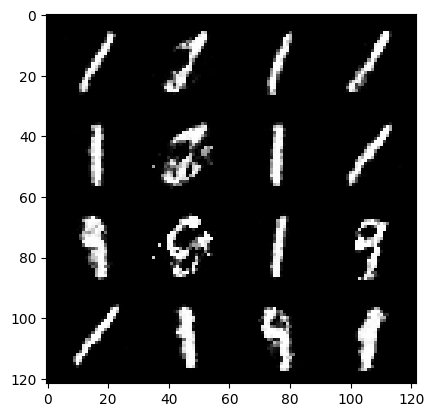

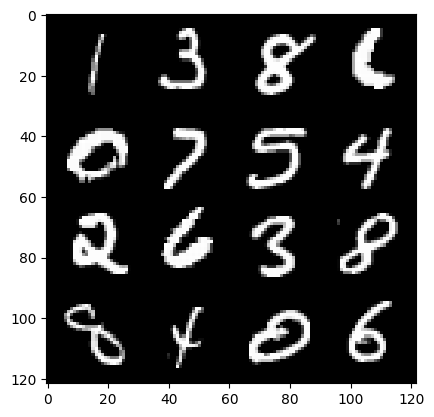

384: Step 180300 / Gen Loss : 2.1362500643730162 / Disc Loss : 0.2532987743616102


  0%|          | 0/469 [00:00<?, ?it/s]

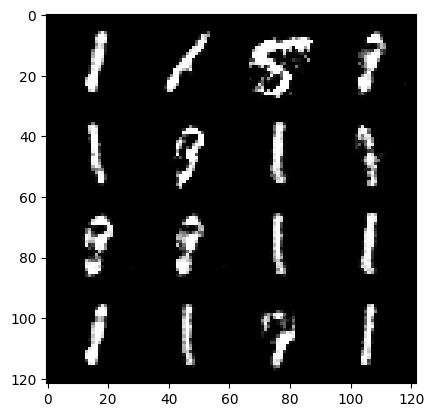

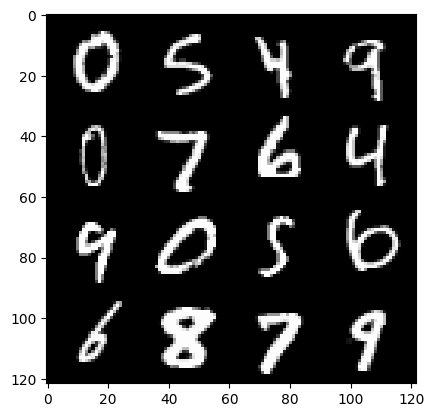

385: Step 180600 / Gen Loss : 2.2115841416517896 / Disc Loss : 0.24495381613572434


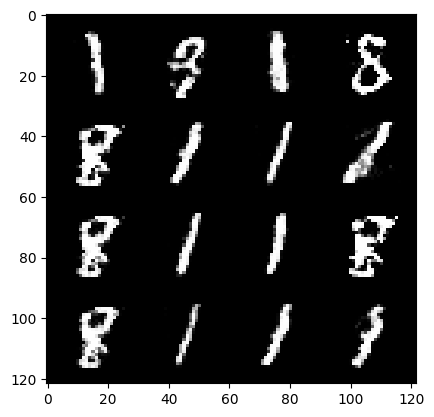

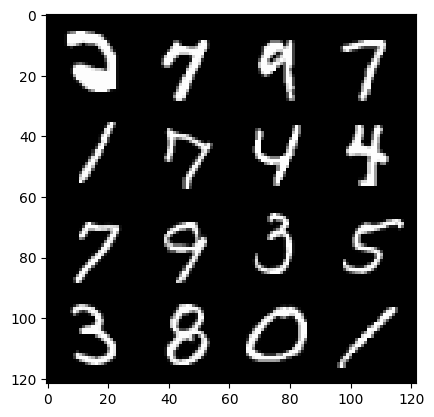

385: Step 180900 / Gen Loss : 2.190634190638861 / Disc Loss : 0.23997331435481714


  0%|          | 0/469 [00:00<?, ?it/s]

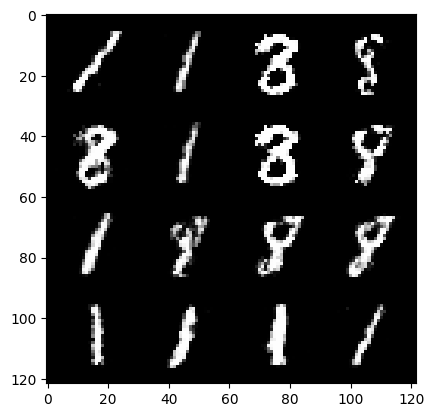

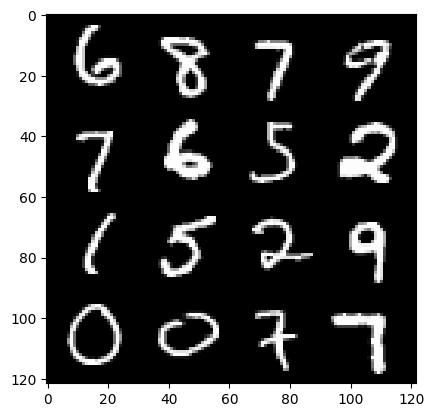

386: Step 181200 / Gen Loss : 2.2234734261035936 / Disc Loss : 0.2308756769200166


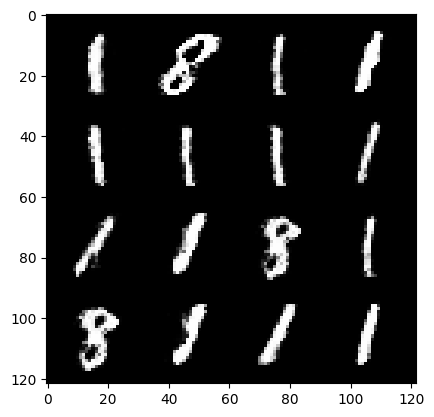

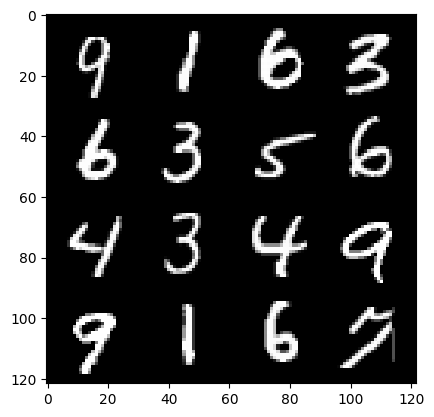

386: Step 181500 / Gen Loss : 2.174469923178355 / Disc Loss : 0.24726421147584932


  0%|          | 0/469 [00:00<?, ?it/s]

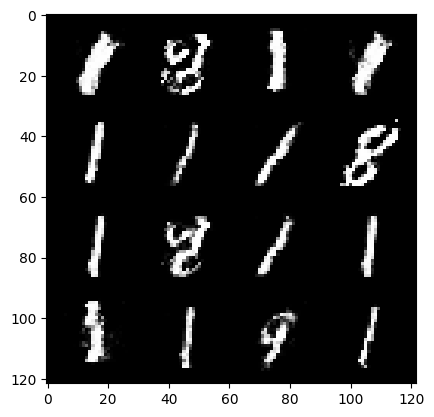

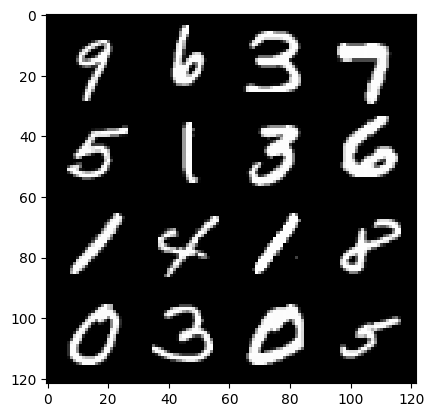

387: Step 181800 / Gen Loss : 2.1747804665565496 / Disc Loss : 0.2528139076133569


  0%|          | 0/469 [00:00<?, ?it/s]

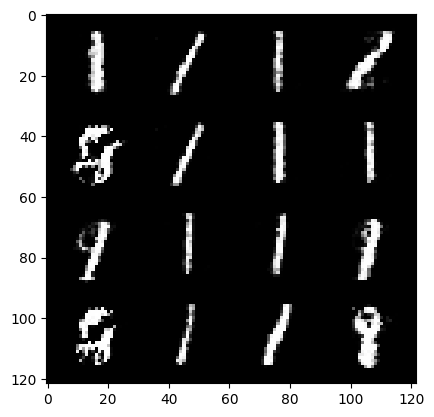

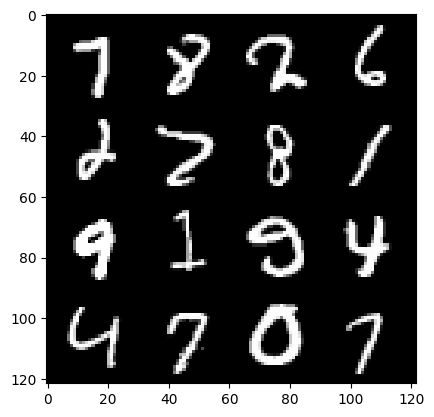

388: Step 182100 / Gen Loss : 2.219852138757705 / Disc Loss : 0.2354415620366732


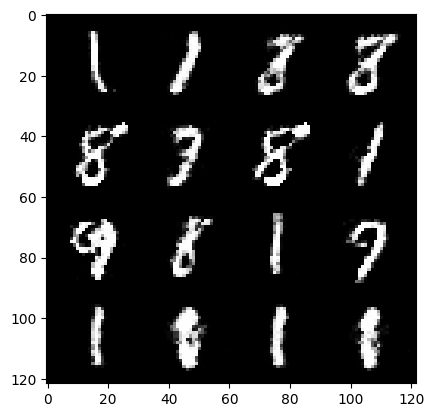

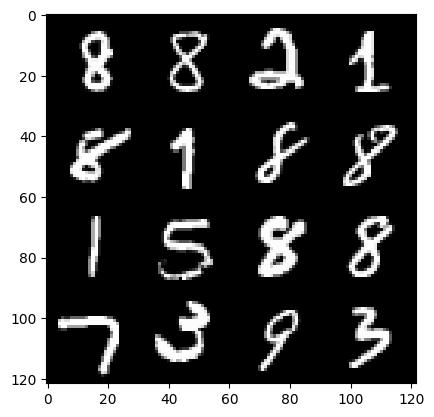

388: Step 182400 / Gen Loss : 2.0609625709056862 / Disc Loss : 0.26350024546186135


  0%|          | 0/469 [00:00<?, ?it/s]

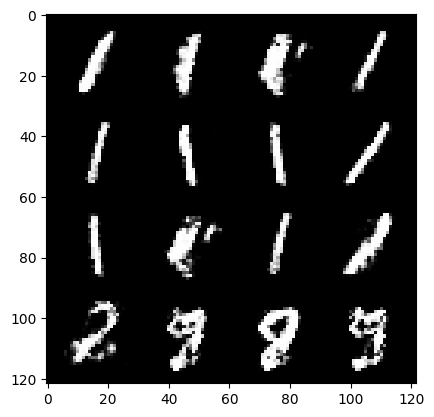

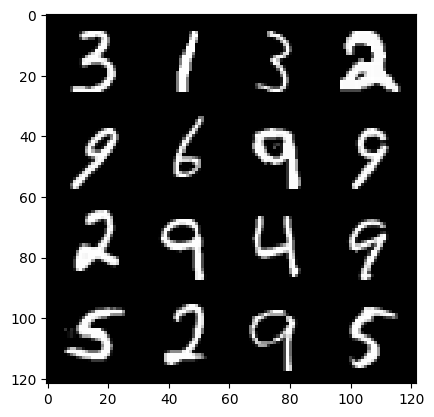

389: Step 182700 / Gen Loss : 2.118524051904679 / Disc Loss : 0.2514023982485135


  0%|          | 0/469 [00:00<?, ?it/s]

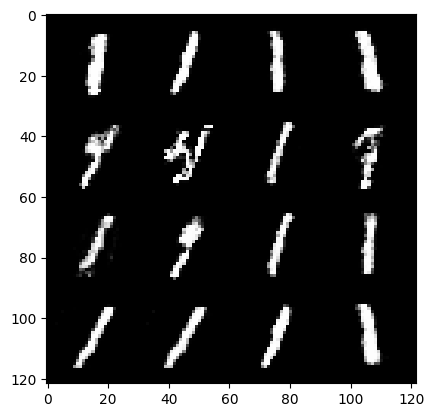

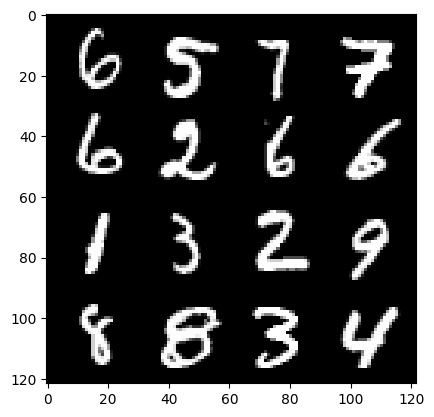

390: Step 183000 / Gen Loss : 2.251612904071807 / Disc Loss : 0.2434950837989648


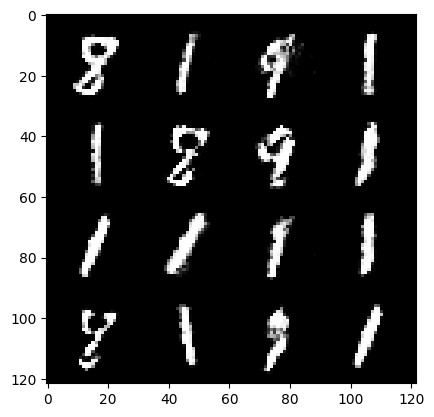

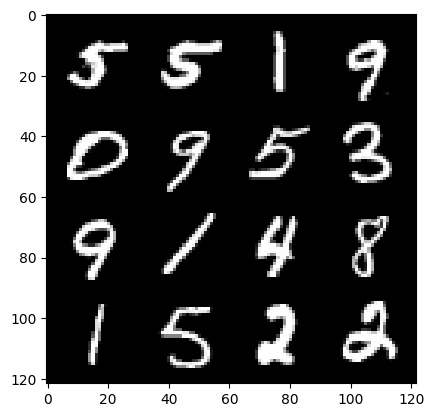

390: Step 183300 / Gen Loss : 2.2538766590754187 / Disc Loss : 0.2441191664338113


  0%|          | 0/469 [00:00<?, ?it/s]

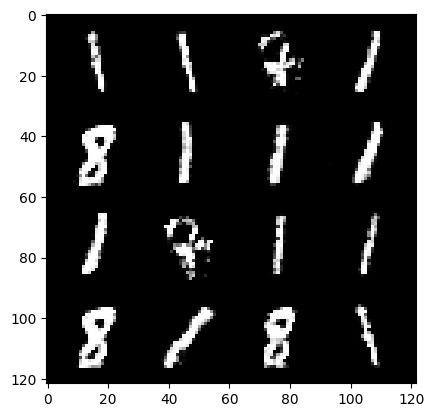

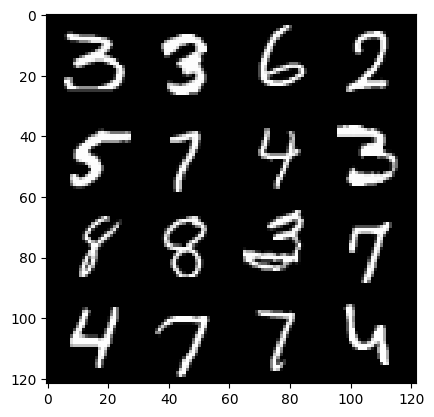

391: Step 183600 / Gen Loss : 2.236161589622498 / Disc Loss : 0.23462797467907276


  0%|          | 0/469 [00:00<?, ?it/s]

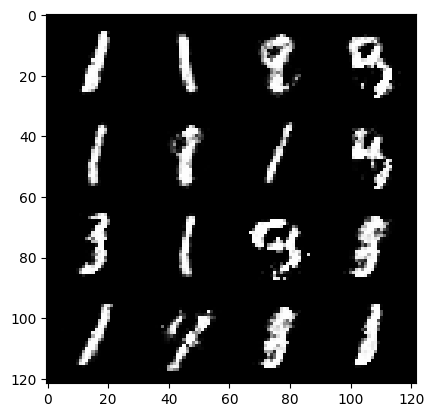

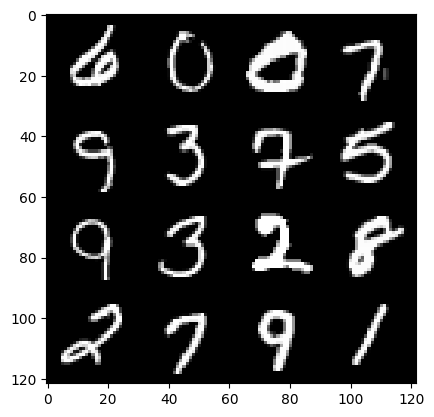

392: Step 183900 / Gen Loss : 2.158125064373016 / Disc Loss : 0.24684576715032266


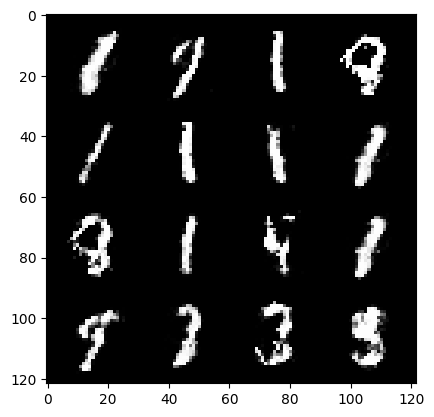

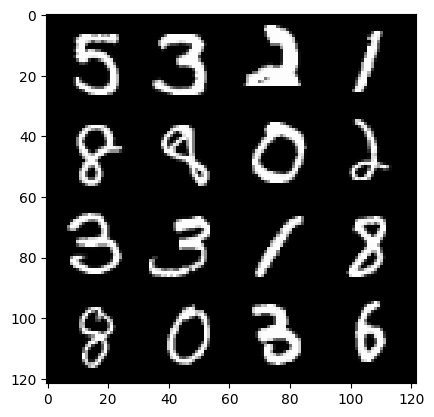

392: Step 184200 / Gen Loss : 2.182443908055624 / Disc Loss : 0.24656932552655542


  0%|          | 0/469 [00:00<?, ?it/s]

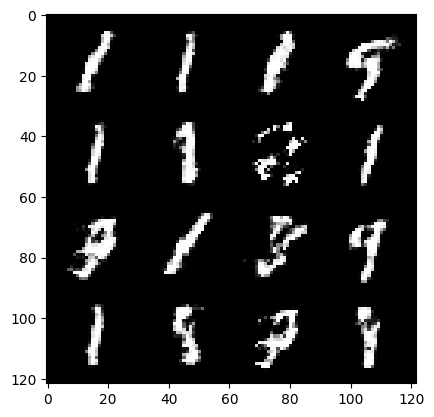

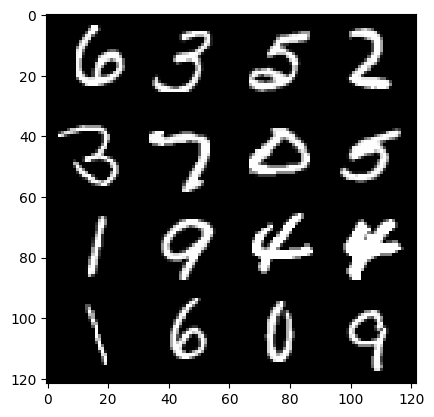

393: Step 184500 / Gen Loss : 2.150198074181875 / Disc Loss : 0.26363829905788116


  0%|          | 0/469 [00:00<?, ?it/s]

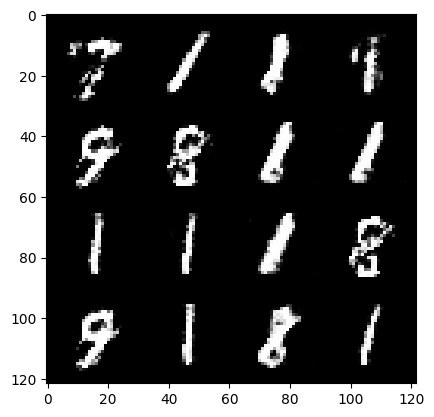

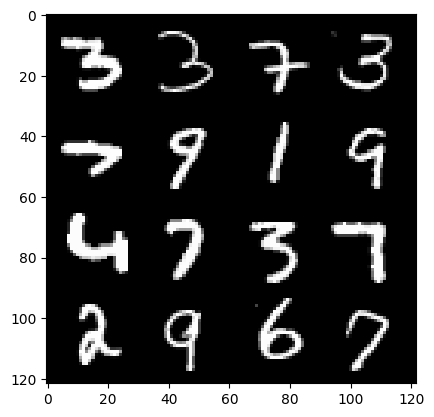

394: Step 184800 / Gen Loss : 2.0707952555020652 / Disc Loss : 0.27934500147899


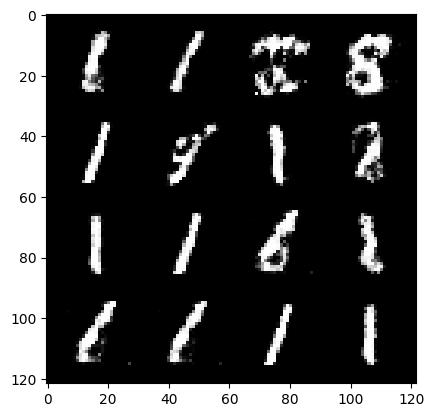

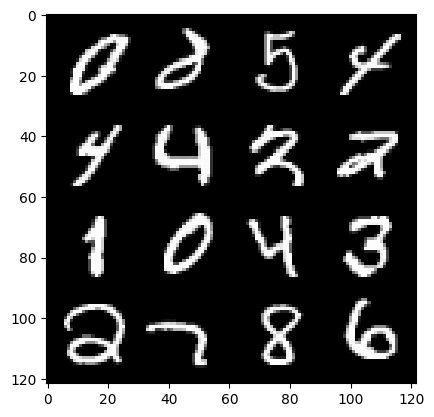

394: Step 185100 / Gen Loss : 2.1829634718100235 / Disc Loss : 0.24347571358084674


  0%|          | 0/469 [00:00<?, ?it/s]

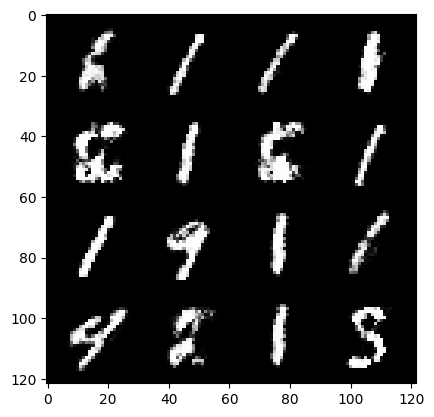

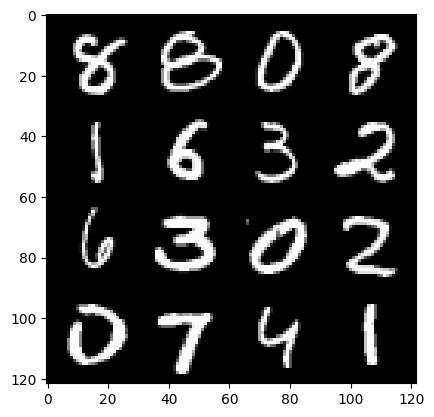

395: Step 185400 / Gen Loss : 2.2000519581635802 / Disc Loss : 0.2574354157348473


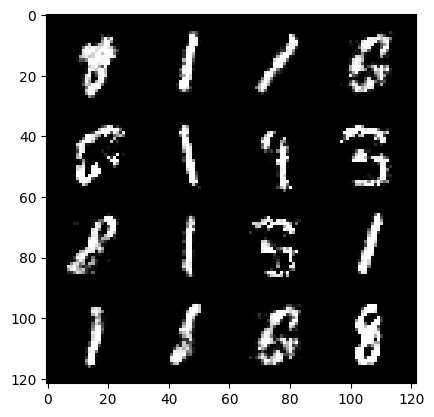

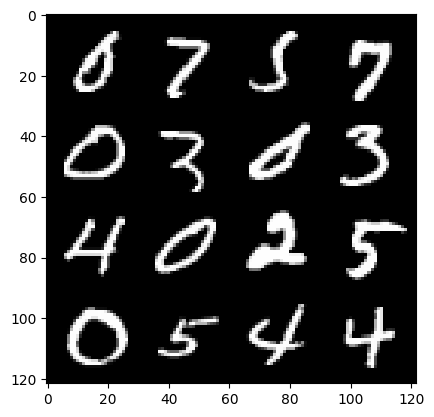

395: Step 185700 / Gen Loss : 2.228487746318183 / Disc Loss : 0.2505061107377214


  0%|          | 0/469 [00:00<?, ?it/s]

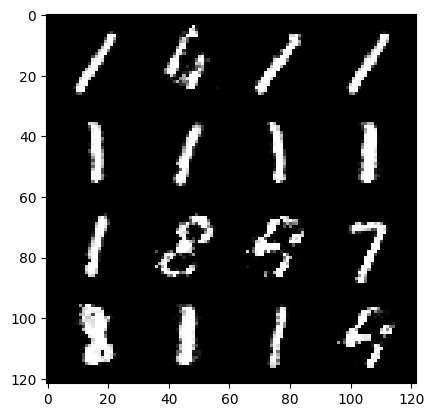

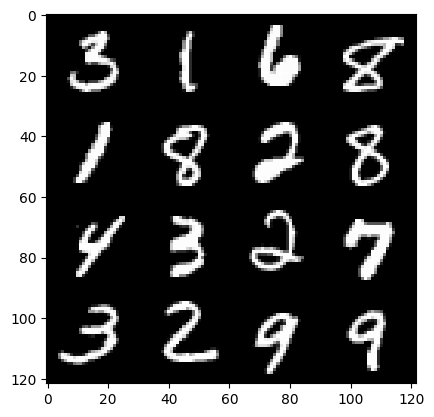

396: Step 186000 / Gen Loss : 2.2942147064208984 / Disc Loss : 0.2376358456412952


  0%|          | 0/469 [00:00<?, ?it/s]

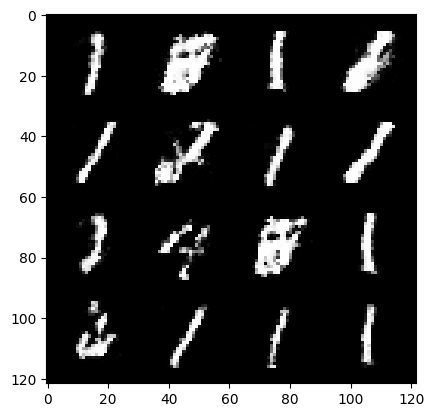

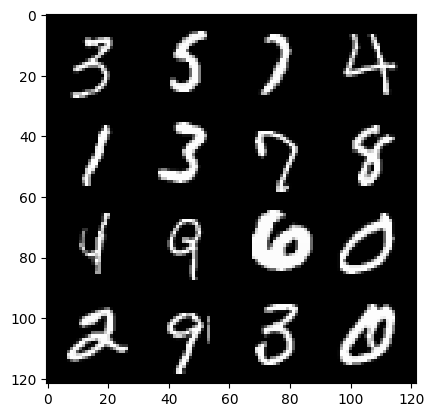

397: Step 186300 / Gen Loss : 2.1774026902516694 / Disc Loss : 0.26265617251396167


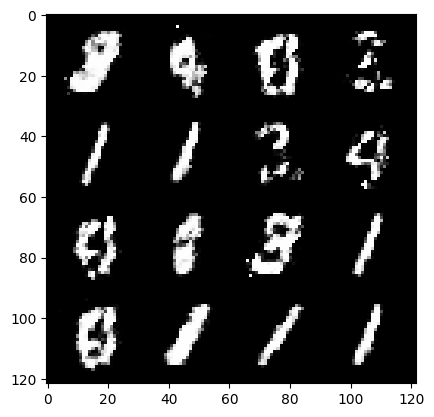

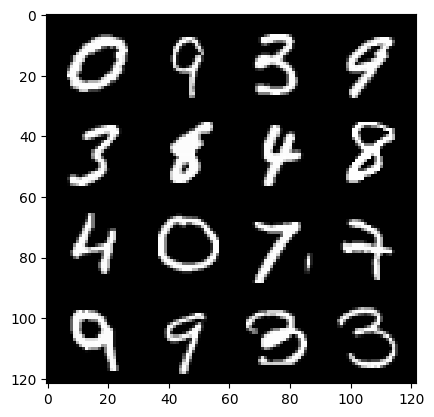

397: Step 186600 / Gen Loss : 2.328113580544791 / Disc Loss : 0.24827544266978918


  0%|          | 0/469 [00:00<?, ?it/s]

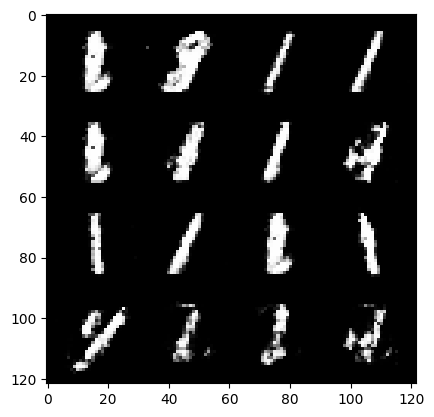

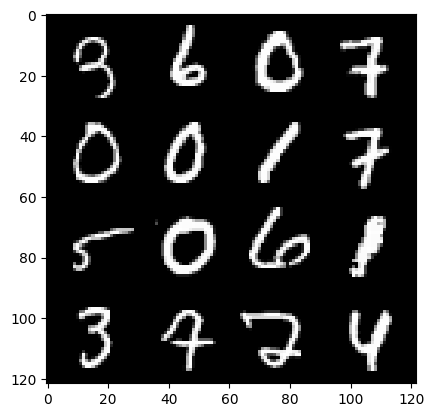

398: Step 186900 / Gen Loss : 2.2411939267317442 / Disc Loss : 0.24270583798487977


  0%|          | 0/469 [00:00<?, ?it/s]

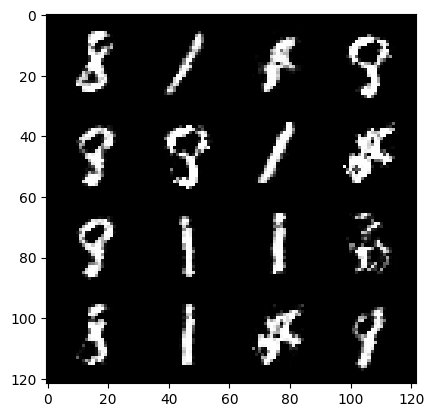

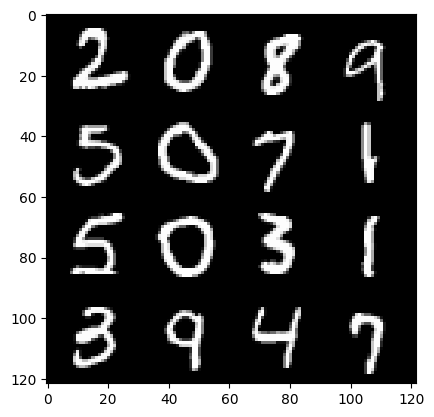

399: Step 187200 / Gen Loss : 2.1927006796995783 / Disc Loss : 0.24134264315168064


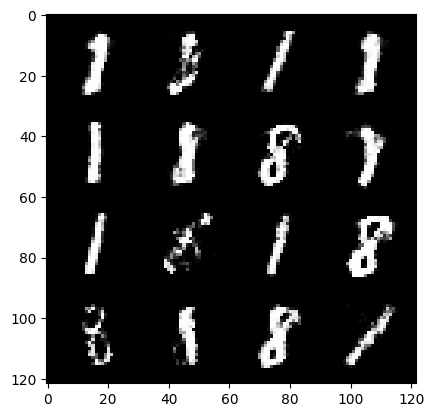

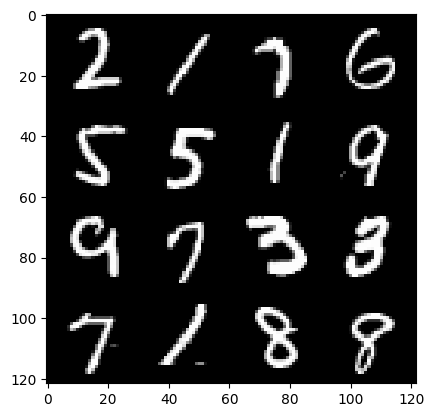

399: Step 187500 / Gen Loss : 2.239512863953908 / Disc Loss : 0.24063440054655075


  0%|          | 0/469 [00:00<?, ?it/s]

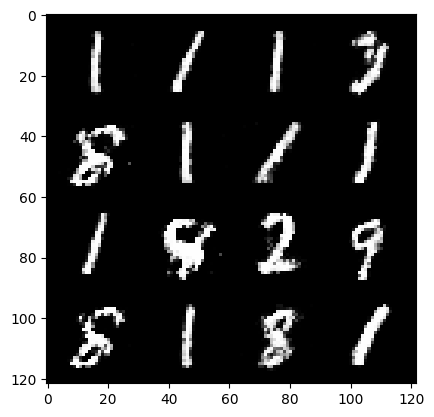

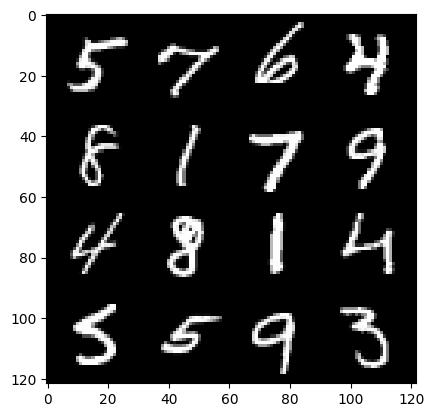

400: Step 187800 / Gen Loss : 2.2230370954672503 / Disc Loss : 0.2349502242604892


  0%|          | 0/469 [00:00<?, ?it/s]

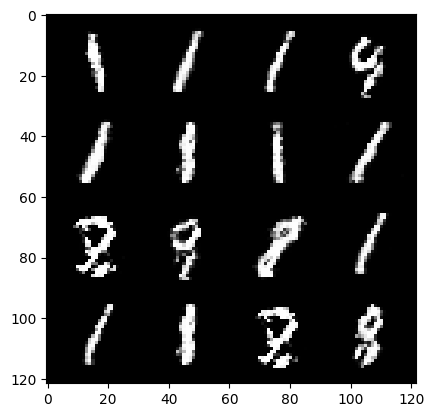

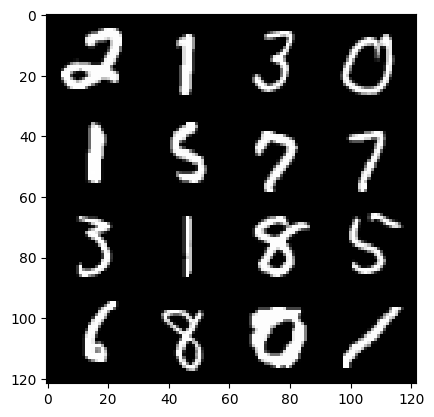

401: Step 188100 / Gen Loss : 2.101283000310263 / Disc Loss : 0.2624501577019694


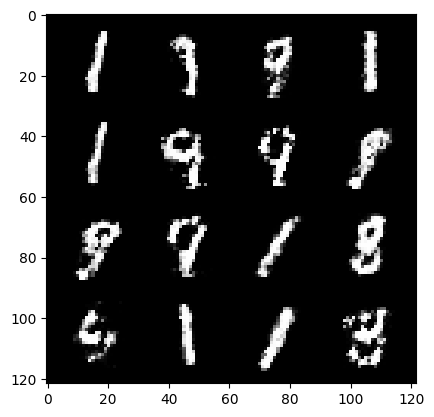

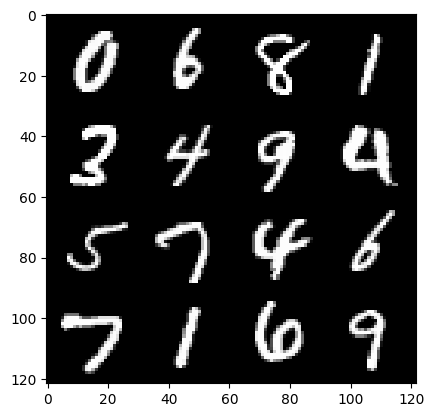

401: Step 188400 / Gen Loss : 2.1354724244276677 / Disc Loss : 0.24754970287283254


  0%|          | 0/469 [00:00<?, ?it/s]

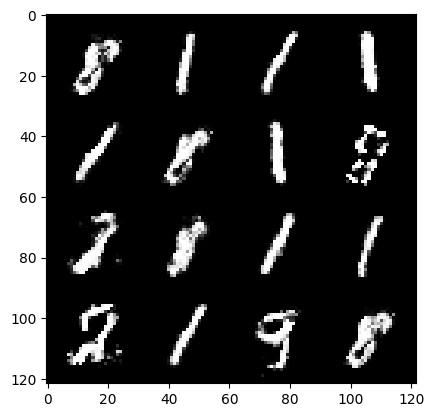

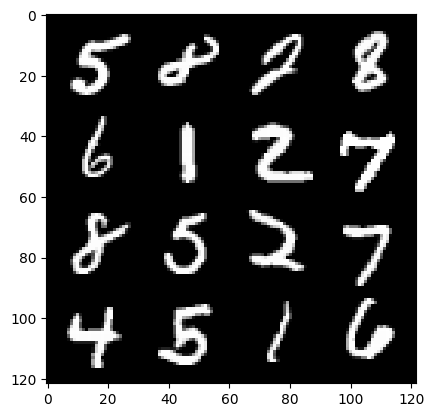

402: Step 188700 / Gen Loss : 2.1940602493286123 / Disc Loss : 0.24070826376477839


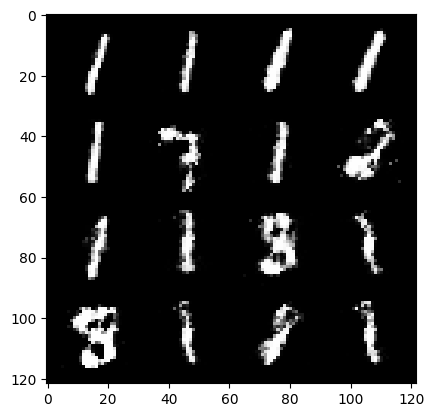

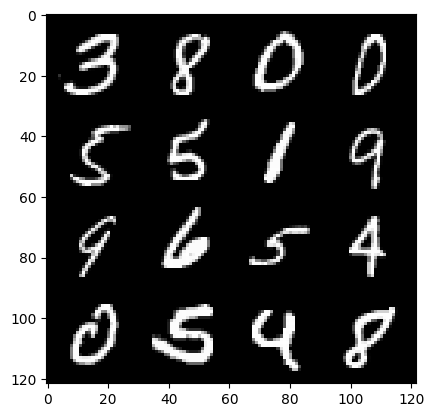

402: Step 189000 / Gen Loss : 2.2060261785984046 / Disc Loss : 0.25341236501932135


  0%|          | 0/469 [00:00<?, ?it/s]

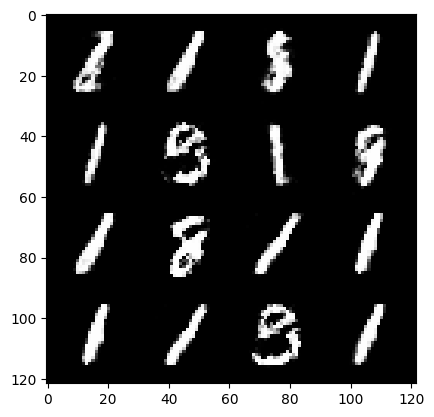

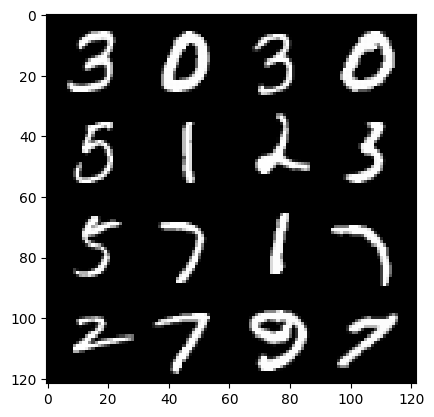

403: Step 189300 / Gen Loss : 2.099751955270769 / Disc Loss : 0.2612400107582409


  0%|          | 0/469 [00:00<?, ?it/s]

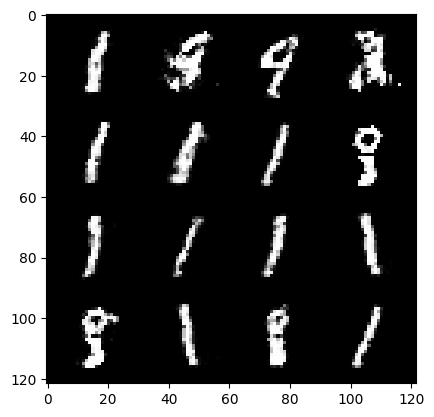

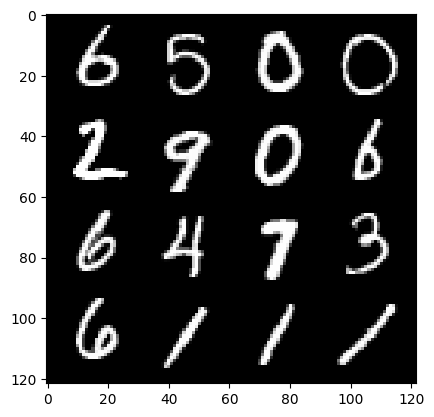

404: Step 189600 / Gen Loss : 2.1738555276393887 / Disc Loss : 0.2594642628977697


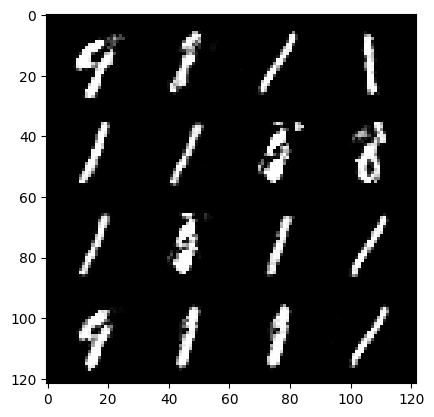

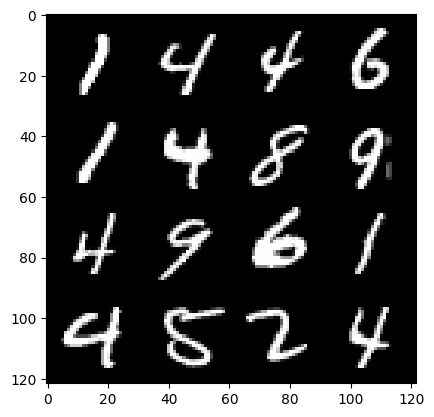

404: Step 189900 / Gen Loss : 2.285981574058534 / Disc Loss : 0.2231778702139854


  0%|          | 0/469 [00:00<?, ?it/s]

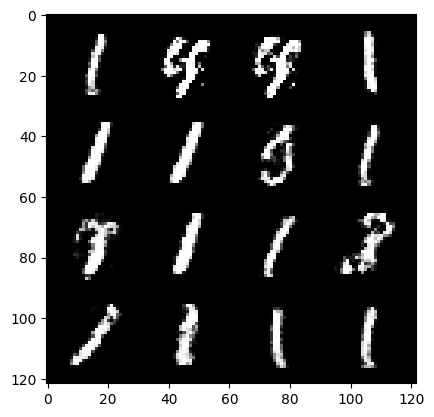

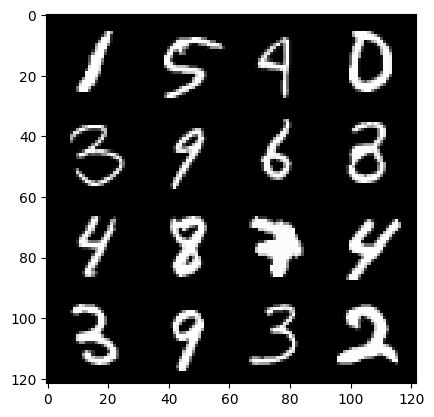

405: Step 190200 / Gen Loss : 2.265617702404658 / Disc Loss : 0.25122668032844864


  0%|          | 0/469 [00:00<?, ?it/s]

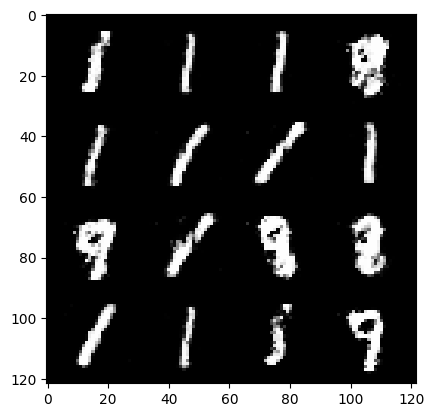

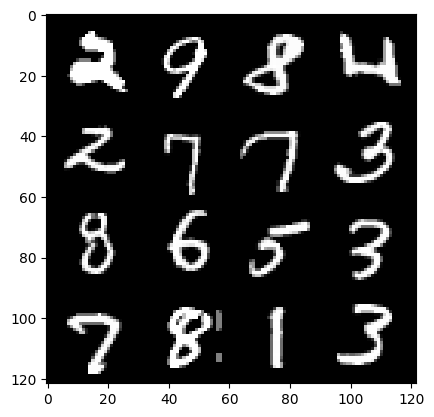

406: Step 190500 / Gen Loss : 2.1534074715773284 / Disc Loss : 0.2577205897370974


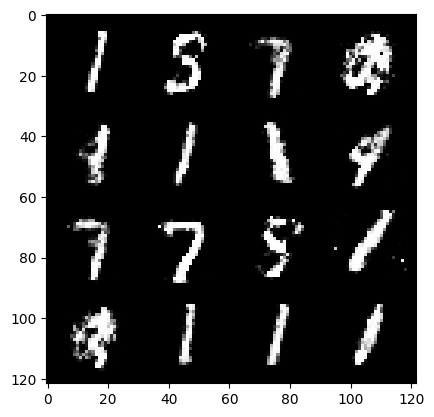

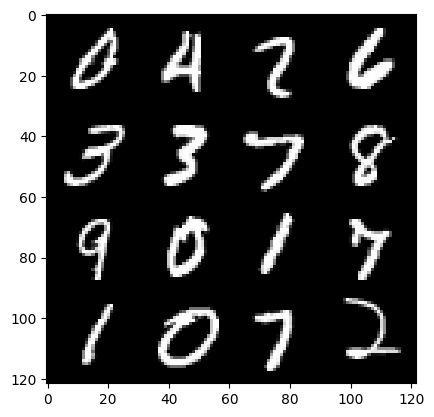

406: Step 190800 / Gen Loss : 2.1554680403073636 / Disc Loss : 0.2457295451064904


  0%|          | 0/469 [00:00<?, ?it/s]

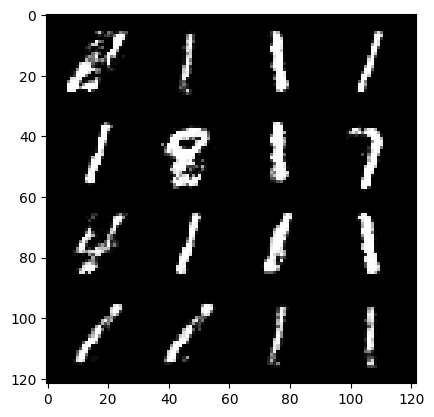

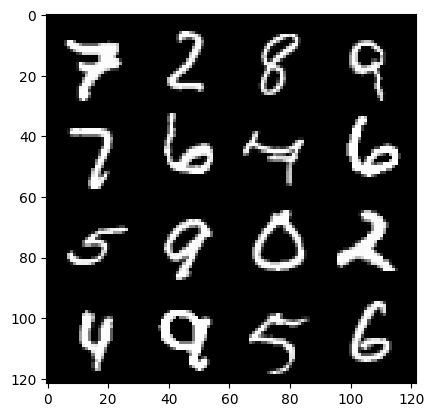

407: Step 191100 / Gen Loss : 2.1026542043685916 / Disc Loss : 0.2603828005492685


  0%|          | 0/469 [00:00<?, ?it/s]

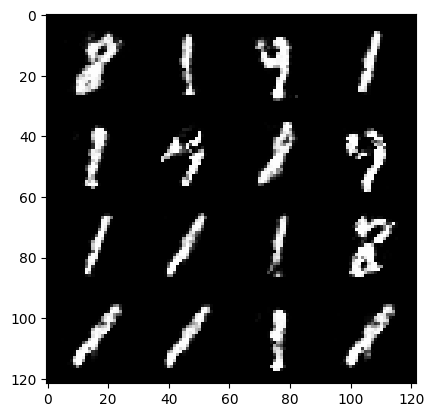

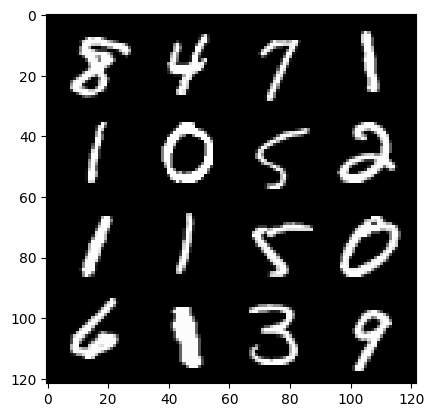

408: Step 191400 / Gen Loss : 2.1710073975722004 / Disc Loss : 0.24296276633938166


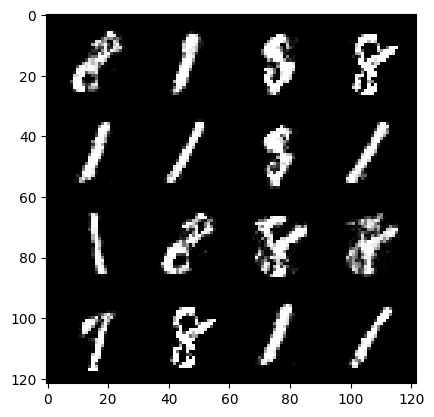

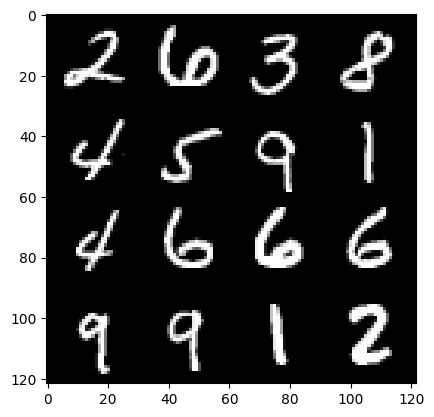

408: Step 191700 / Gen Loss : 2.2673497796058655 / Disc Loss : 0.2298841381072997


  0%|          | 0/469 [00:00<?, ?it/s]

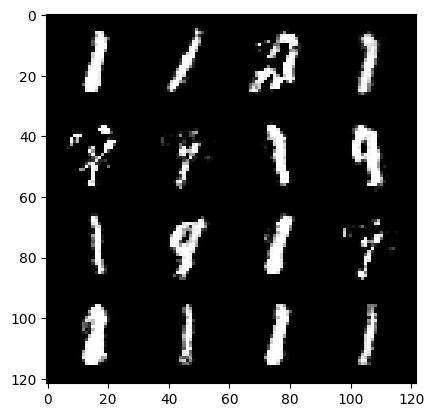

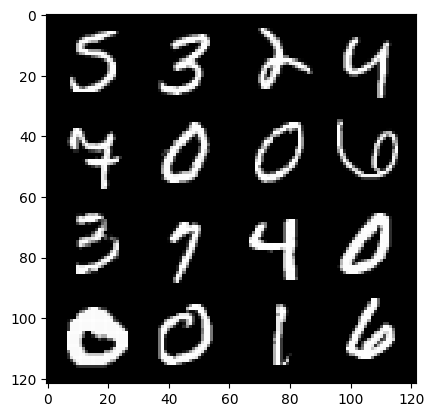

409: Step 192000 / Gen Loss : 2.3061573851108546 / Disc Loss : 0.2468944558004538


  0%|          | 0/469 [00:00<?, ?it/s]

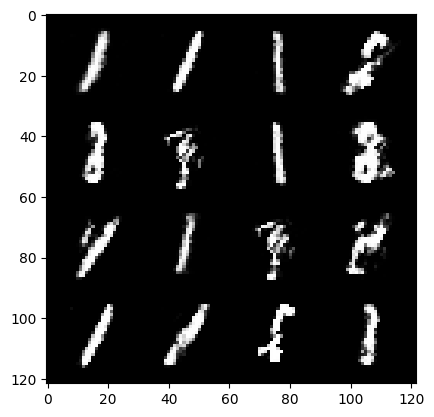

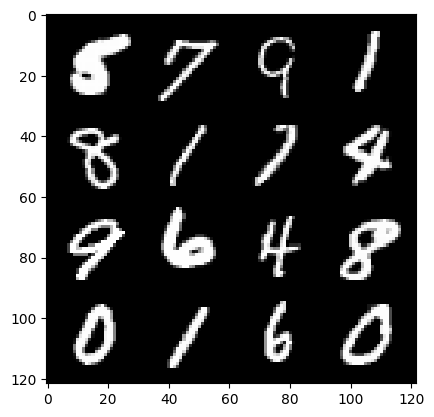

410: Step 192300 / Gen Loss : 2.304231834808986 / Disc Loss : 0.22003679176171637


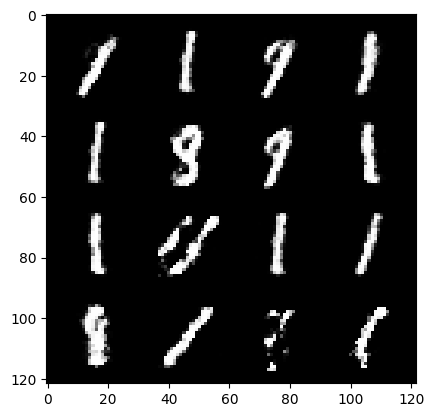

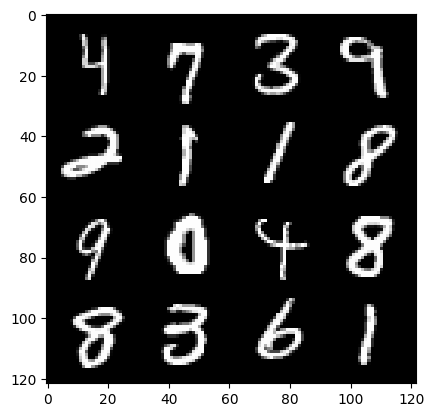

410: Step 192600 / Gen Loss : 2.237685996691387 / Disc Loss : 0.2285833749175071


  0%|          | 0/469 [00:00<?, ?it/s]

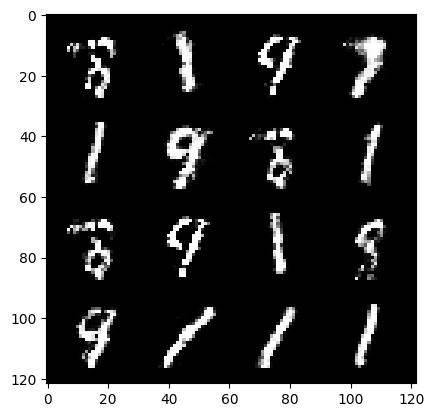

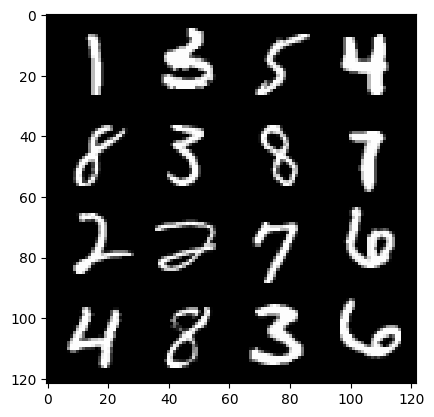

411: Step 192900 / Gen Loss : 2.158805799881618 / Disc Loss : 0.2530170554916064


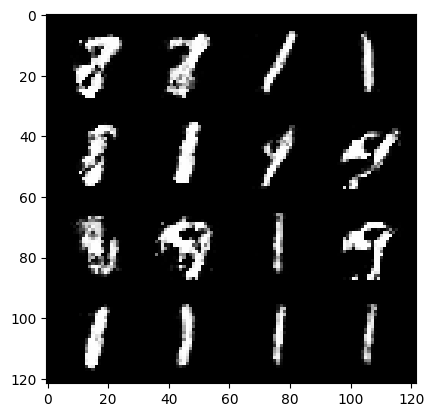

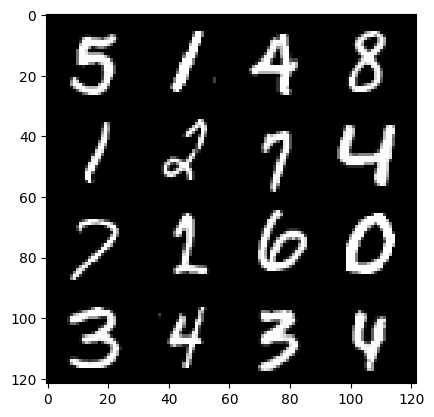

411: Step 193200 / Gen Loss : 2.1500658806165065 / Disc Loss : 0.2449676650762558


  0%|          | 0/469 [00:00<?, ?it/s]

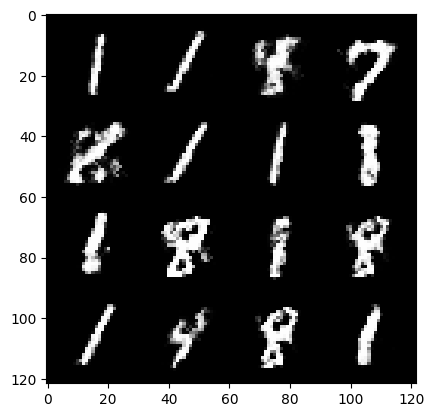

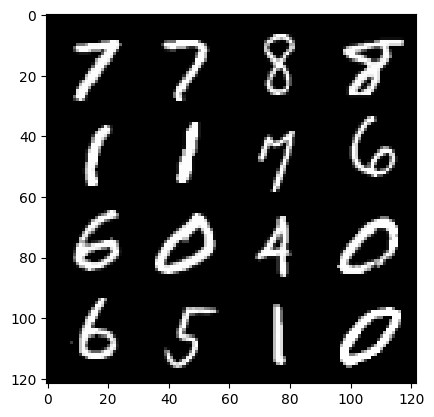

412: Step 193500 / Gen Loss : 2.143275894323985 / Disc Loss : 0.25676587462425243


  0%|          | 0/469 [00:00<?, ?it/s]

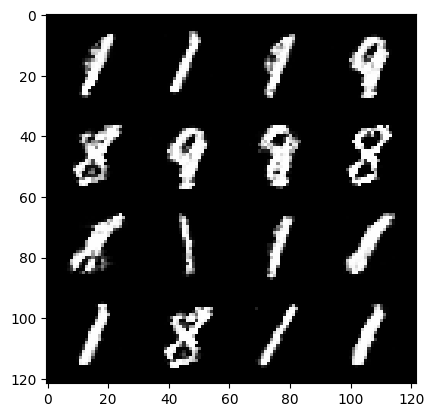

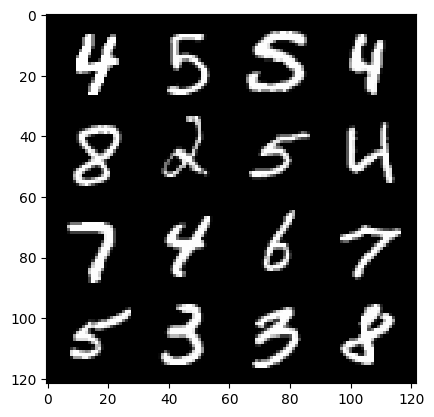

413: Step 193800 / Gen Loss : 2.1740973615646366 / Disc Loss : 0.24794359276692074


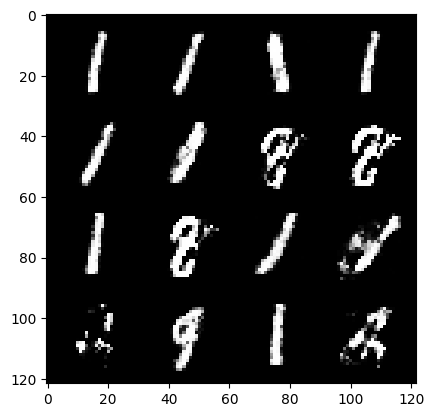

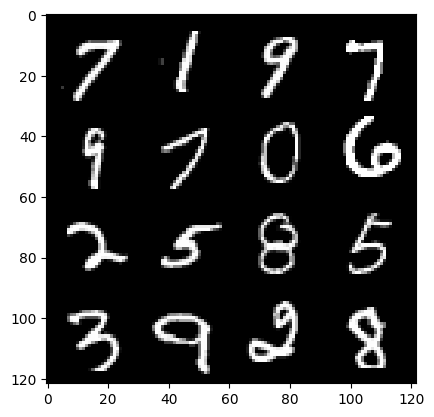

413: Step 194100 / Gen Loss : 2.17416086991628 / Disc Loss : 0.24760692814985907


  0%|          | 0/469 [00:00<?, ?it/s]

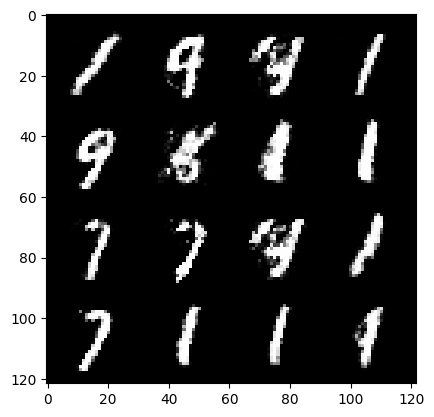

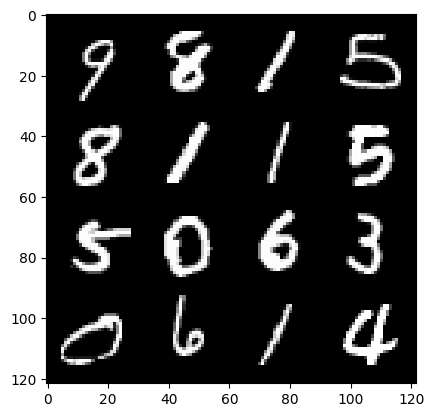

414: Step 194400 / Gen Loss : 2.2327674885590865 / Disc Loss : 0.2522204437851907


  0%|          | 0/469 [00:00<?, ?it/s]

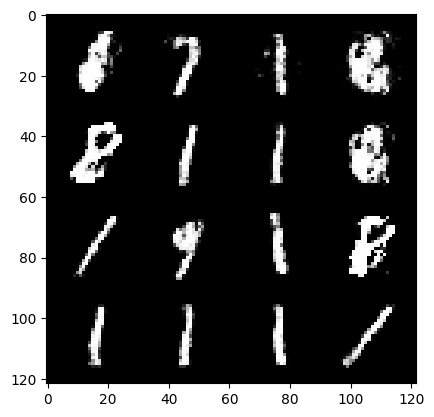

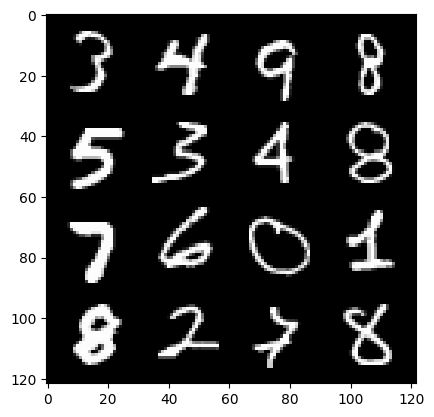

415: Step 194700 / Gen Loss : 2.2611590107282 / Disc Loss : 0.24592799266179408


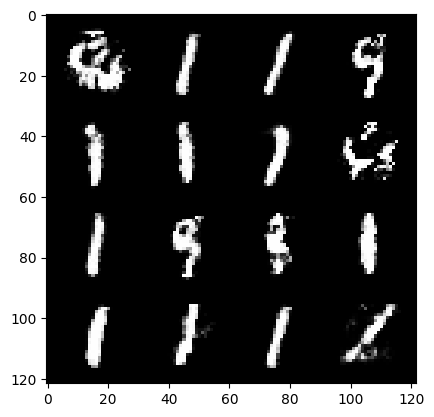

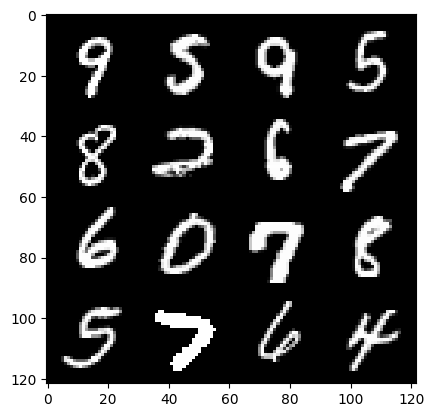

415: Step 195000 / Gen Loss : 2.2990911662578566 / Disc Loss : 0.23094554707407974


  0%|          | 0/469 [00:00<?, ?it/s]

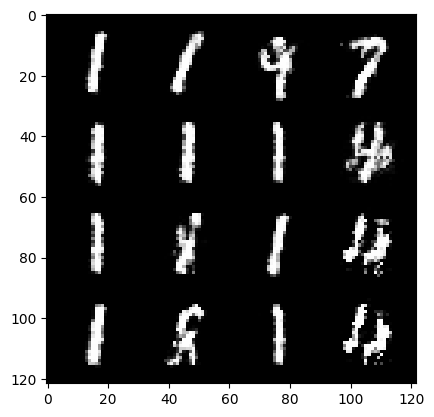

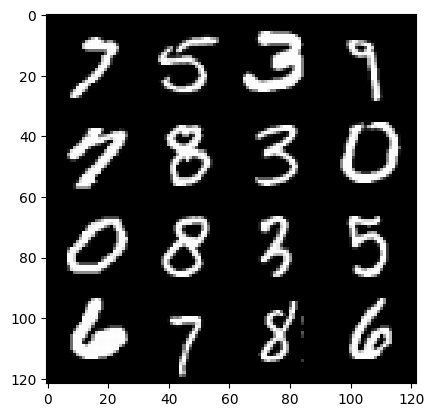

416: Step 195300 / Gen Loss : 2.4214692036310836 / Disc Loss : 0.2258597613871097


  0%|          | 0/469 [00:00<?, ?it/s]

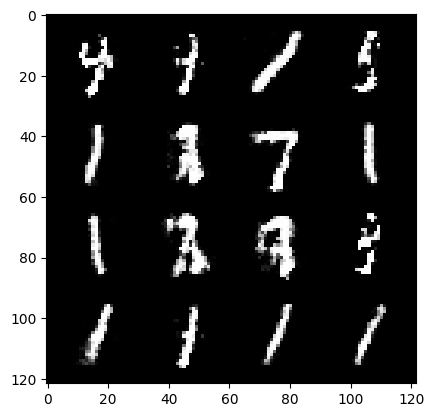

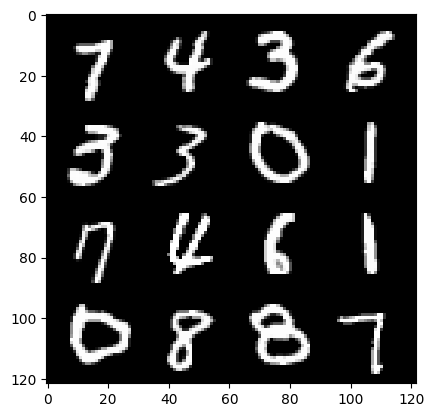

417: Step 195600 / Gen Loss : 2.1298581735293065 / Disc Loss : 0.2552223400771619


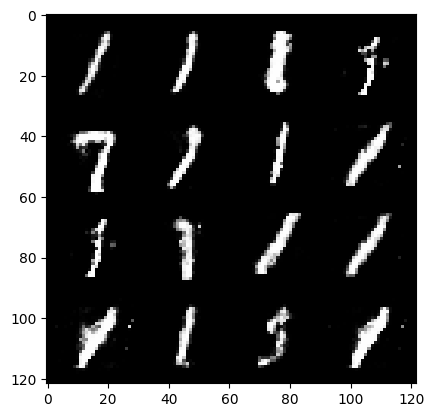

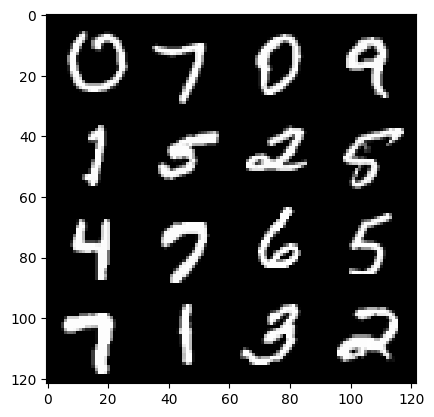

417: Step 195900 / Gen Loss : 2.1724383906523403 / Disc Loss : 0.24890958512822786


  0%|          | 0/469 [00:00<?, ?it/s]

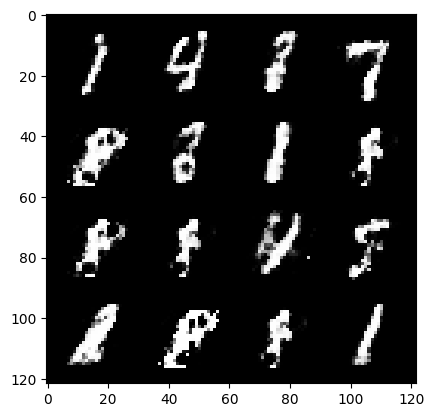

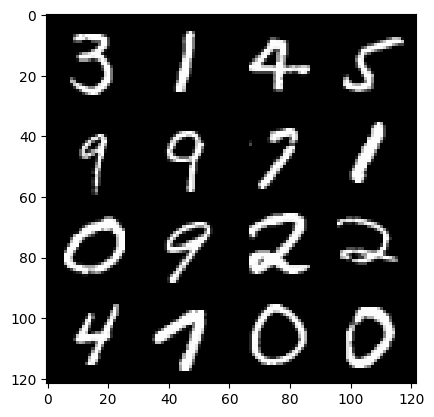

418: Step 196200 / Gen Loss : 2.234716385602952 / Disc Loss : 0.2355523765583833


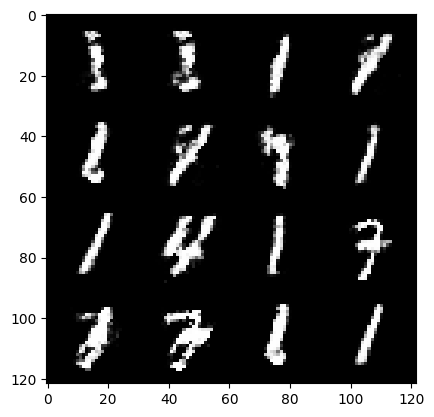

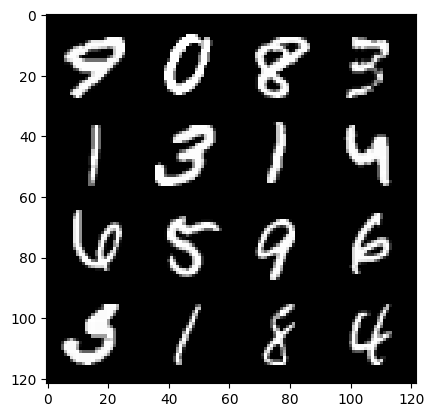

418: Step 196500 / Gen Loss : 2.2804040439923616 / Disc Loss : 0.23495828206340474


  0%|          | 0/469 [00:00<?, ?it/s]

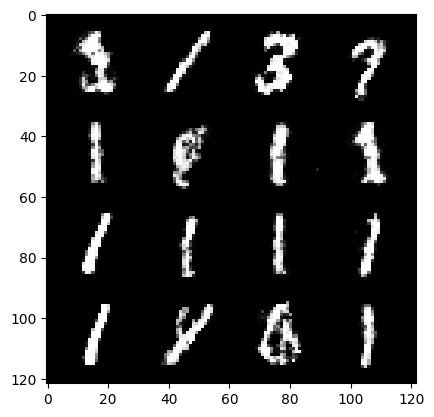

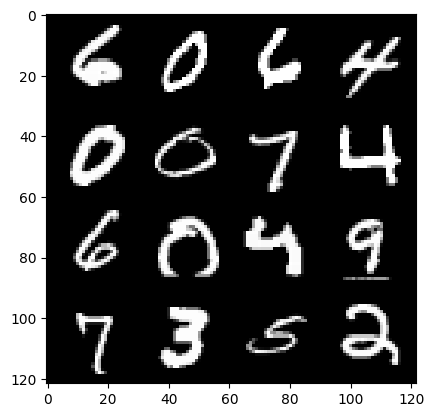

419: Step 196800 / Gen Loss : 2.2042640431722 / Disc Loss : 0.24821129664778716


  0%|          | 0/469 [00:00<?, ?it/s]

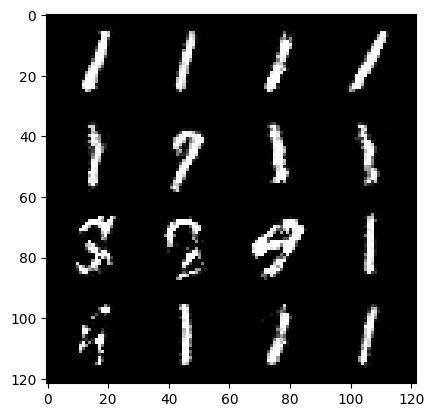

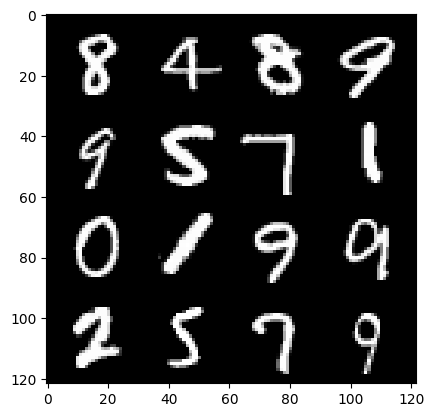

420: Step 197100 / Gen Loss : 2.2634130660692855 / Disc Loss : 0.23120219866434738


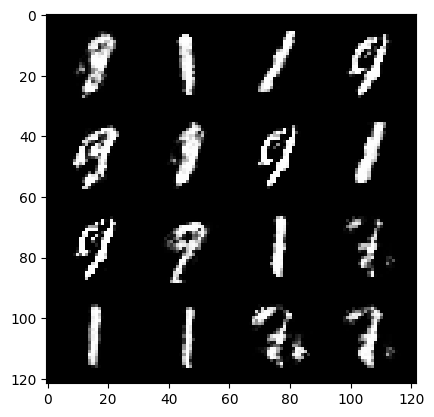

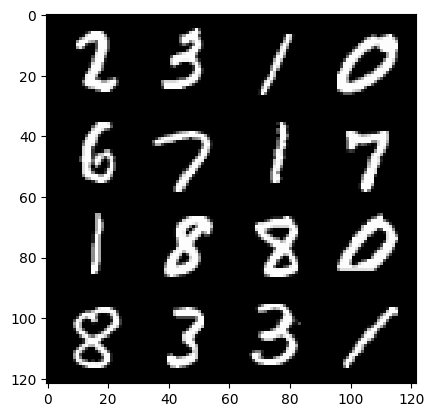

420: Step 197400 / Gen Loss : 2.219906014998754 / Disc Loss : 0.24943234359224636


  0%|          | 0/469 [00:00<?, ?it/s]

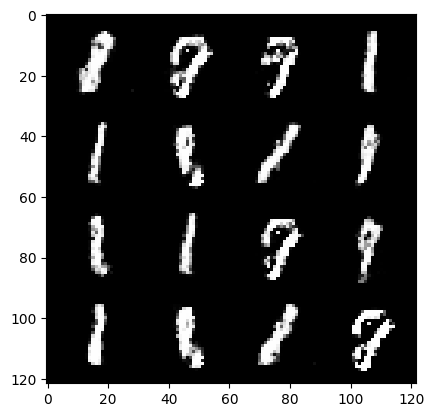

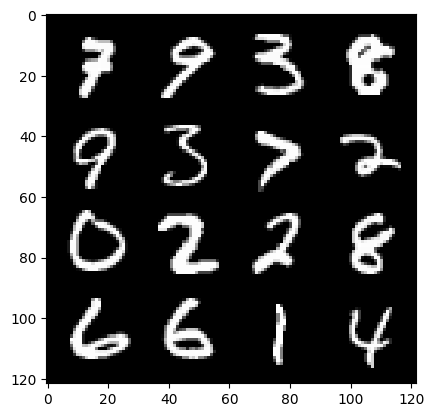

421: Step 197700 / Gen Loss : 2.07020666440328 / Disc Loss : 0.27865757241845135


  0%|          | 0/469 [00:00<?, ?it/s]

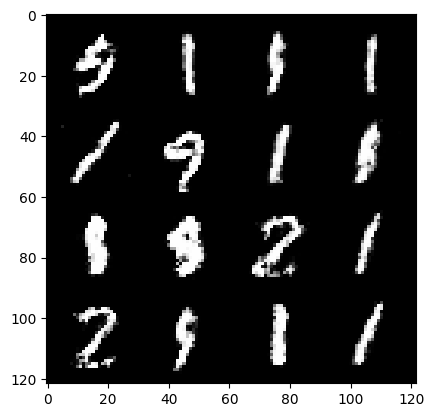

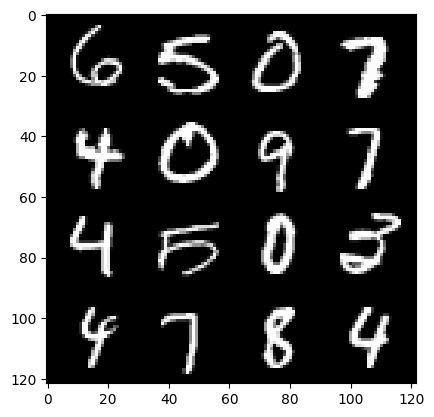

422: Step 198000 / Gen Loss : 2.1130197326342253 / Disc Loss : 0.25676430851221077


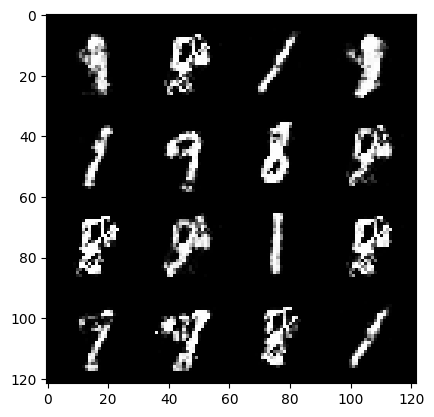

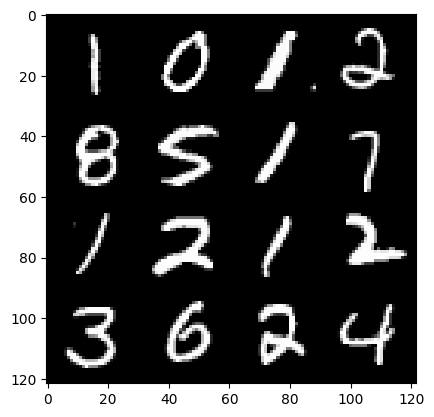

422: Step 198300 / Gen Loss : 2.245307796796163 / Disc Loss : 0.23846941992640477


  0%|          | 0/469 [00:00<?, ?it/s]

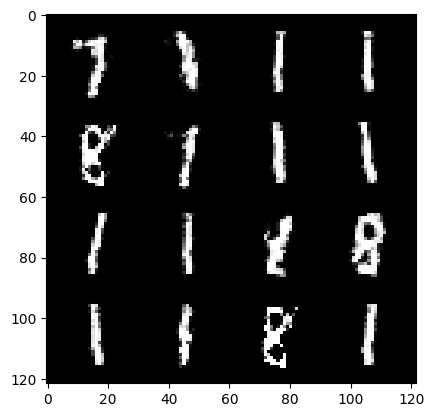

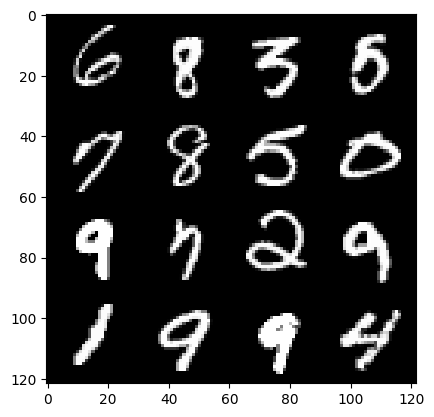

423: Step 198600 / Gen Loss : 2.2315697733561195 / Disc Loss : 0.2375723322729268


  0%|          | 0/469 [00:00<?, ?it/s]

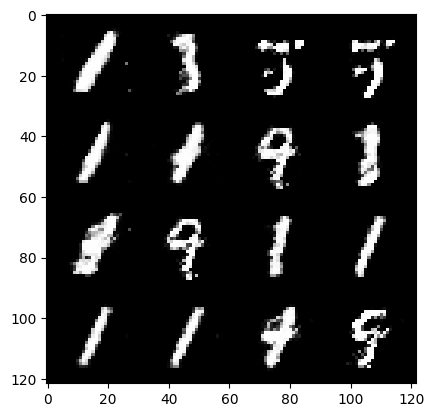

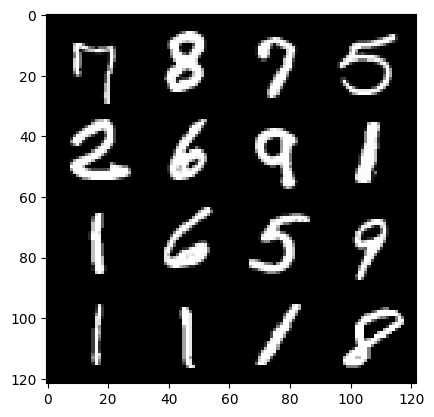

424: Step 198900 / Gen Loss : 2.2633001240094504 / Disc Loss : 0.24810447807113314


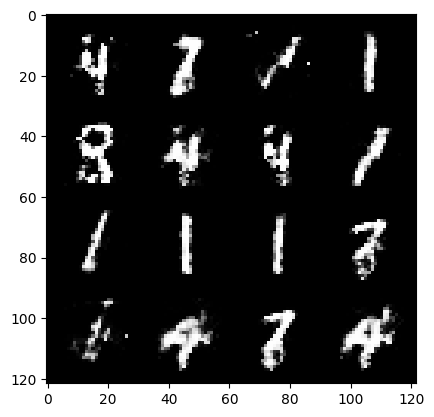

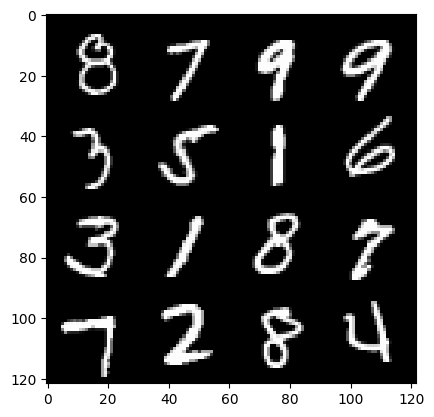

424: Step 199200 / Gen Loss : 2.2877925018469485 / Disc Loss : 0.23894864633679394


  0%|          | 0/469 [00:00<?, ?it/s]

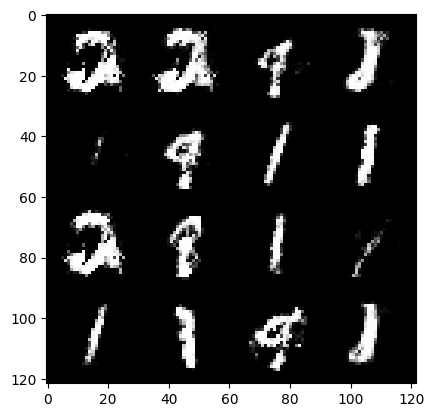

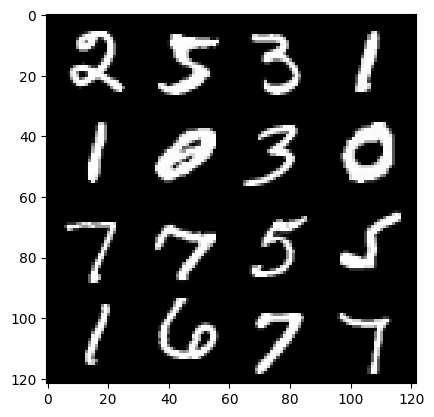

425: Step 199500 / Gen Loss : 2.2053071157137536 / Disc Loss : 0.27958541765809053


  0%|          | 0/469 [00:00<?, ?it/s]

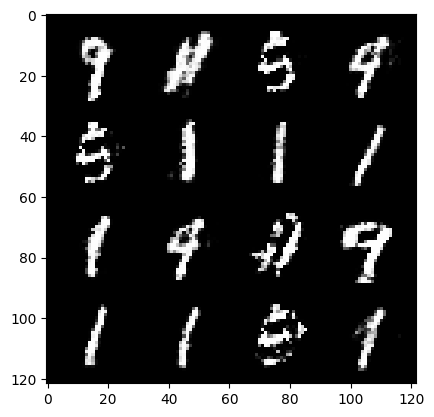

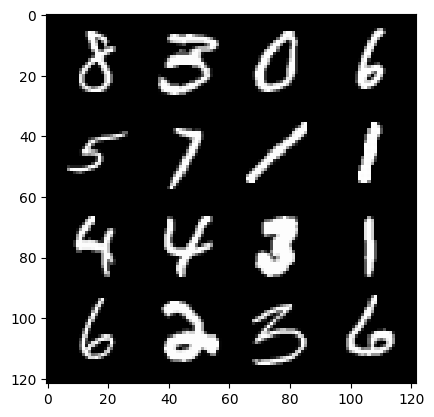

426: Step 199800 / Gen Loss : 2.16654139479001 / Disc Loss : 0.2625120043754578


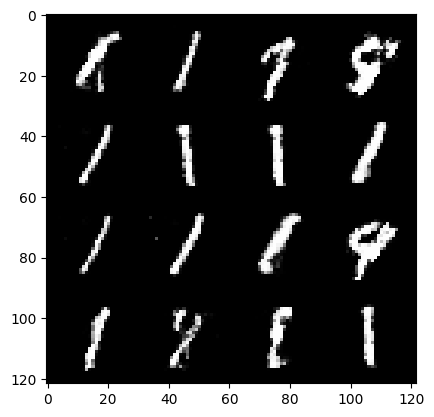

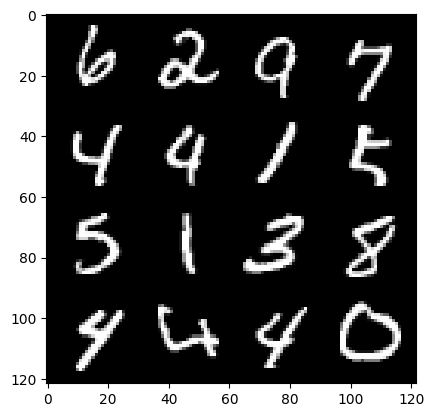

426: Step 200100 / Gen Loss : 2.319280497233073 / Disc Loss : 0.21581128224730495


  0%|          | 0/469 [00:00<?, ?it/s]

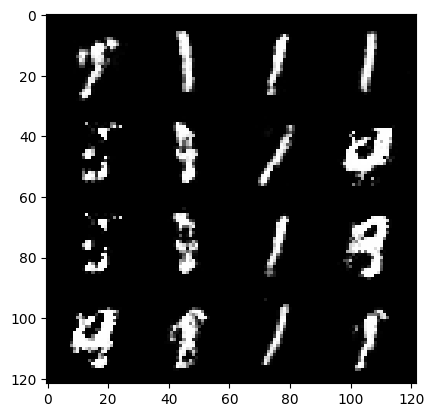

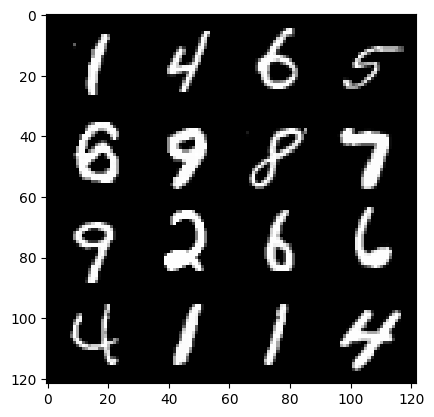

427: Step 200400 / Gen Loss : 2.353680899540582 / Disc Loss : 0.24125642716884593


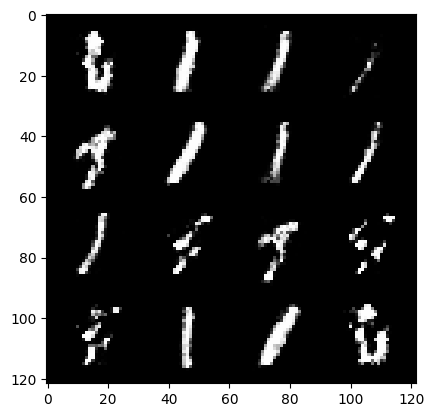

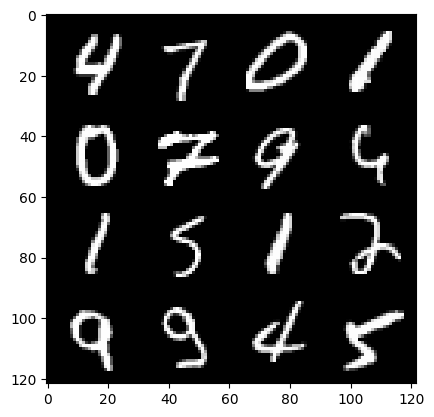

427: Step 200700 / Gen Loss : 2.294786302248636 / Disc Loss : 0.2244787880778312


  0%|          | 0/469 [00:00<?, ?it/s]

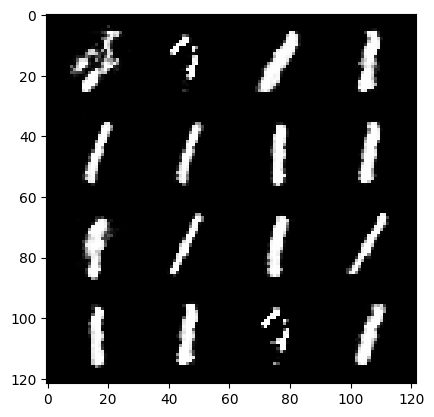

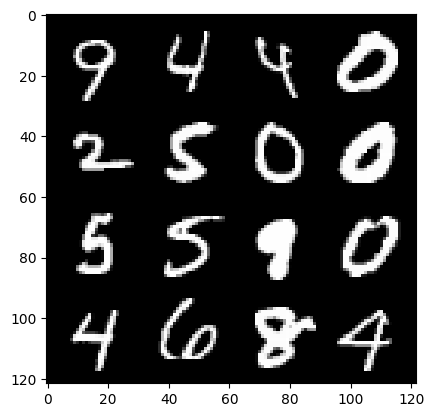

428: Step 201000 / Gen Loss : 2.4352395009994496 / Disc Loss : 0.21682281509041781


  0%|          | 0/469 [00:00<?, ?it/s]

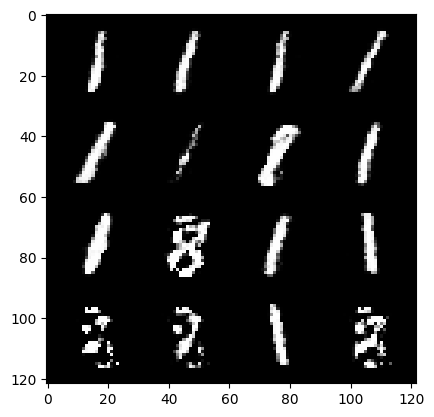

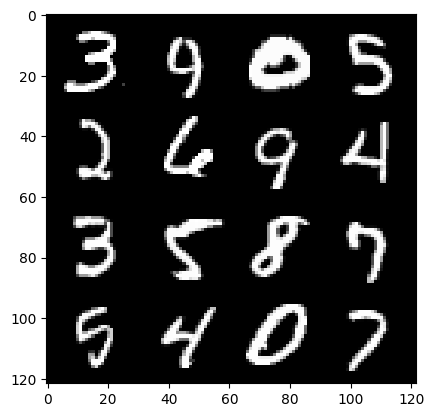

429: Step 201300 / Gen Loss : 2.4863391272227005 / Disc Loss : 0.22272080153226873


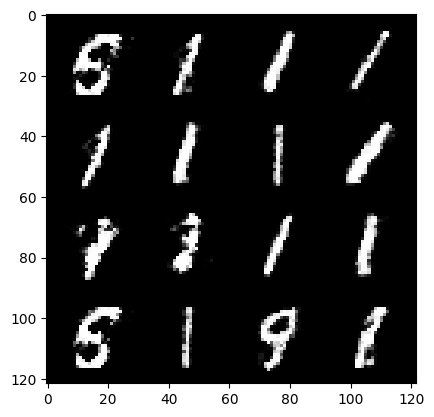

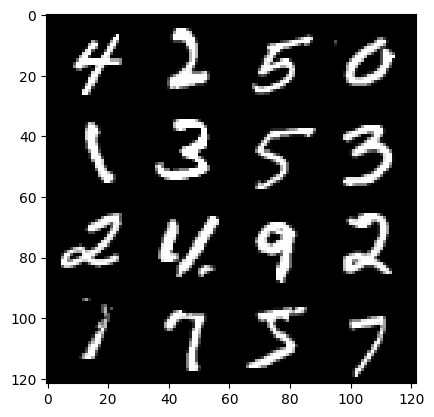

429: Step 201600 / Gen Loss : 2.3114304109414405 / Disc Loss : 0.23433951263626412


  0%|          | 0/469 [00:00<?, ?it/s]

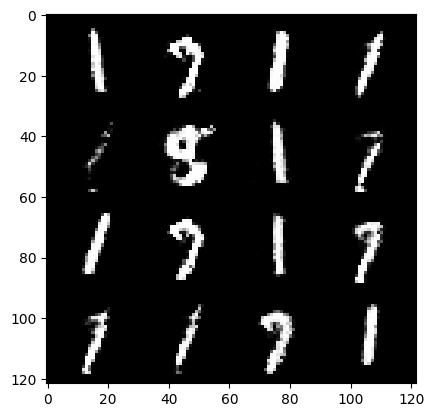

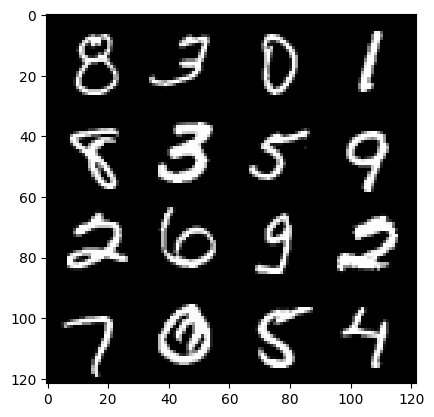

430: Step 201900 / Gen Loss : 2.292691195408503 / Disc Loss : 0.23412438049912432


  0%|          | 0/469 [00:00<?, ?it/s]

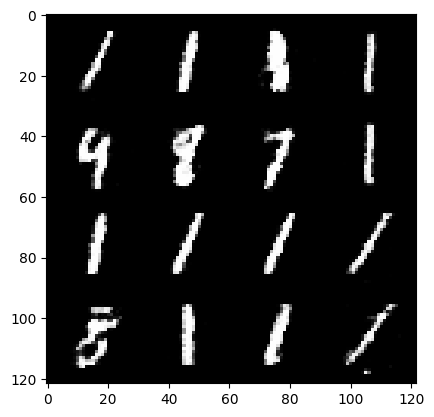

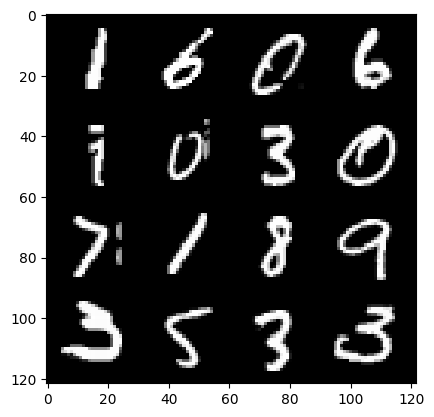

431: Step 202200 / Gen Loss : 2.372262140115103 / Disc Loss : 0.23475690419475234


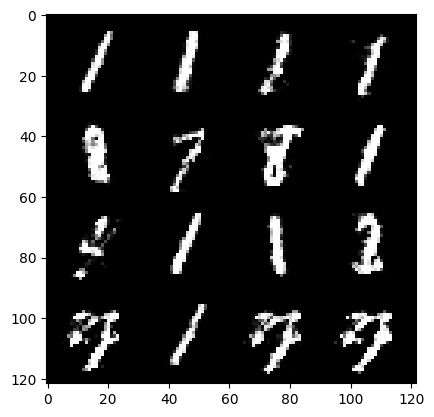

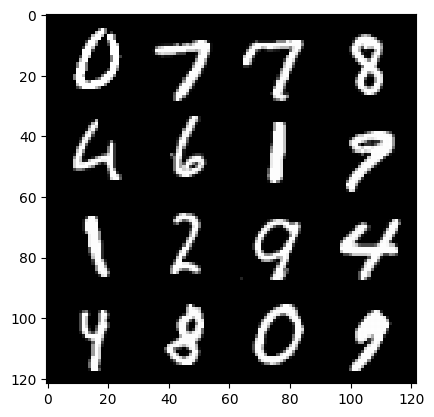

431: Step 202500 / Gen Loss : 2.4565816338857016 / Disc Loss : 0.22928077608346936


  0%|          | 0/469 [00:00<?, ?it/s]

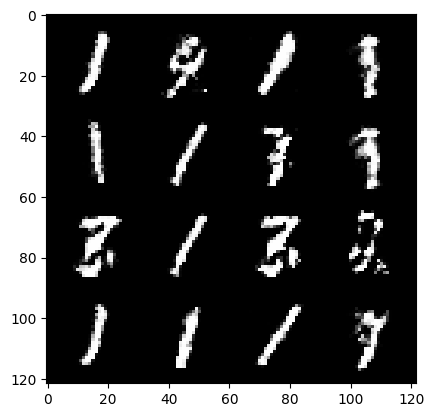

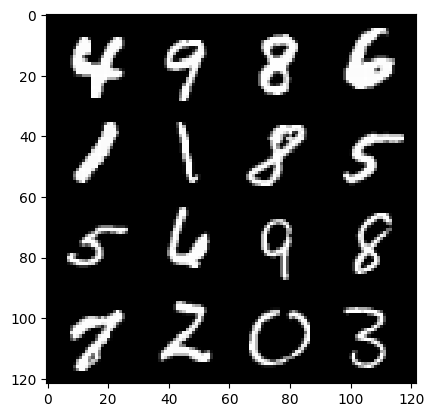

432: Step 202800 / Gen Loss : 2.414738465547563 / Disc Loss : 0.2345943272113801


  0%|          | 0/469 [00:00<?, ?it/s]

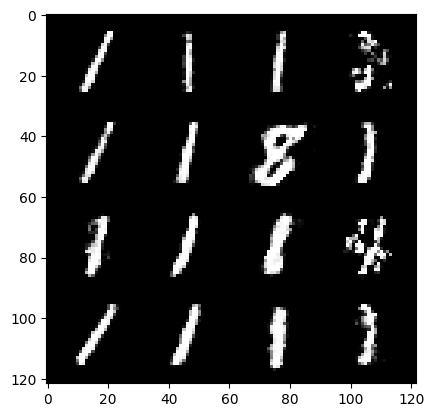

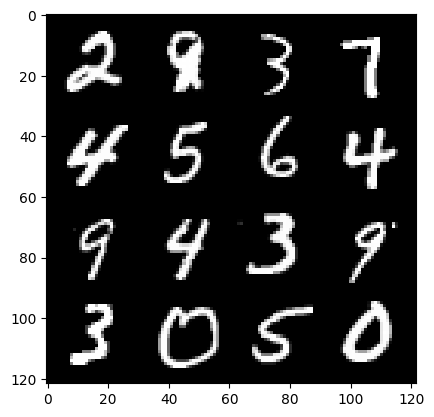

433: Step 203100 / Gen Loss : 2.25767869154612 / Disc Loss : 0.23051384175817177


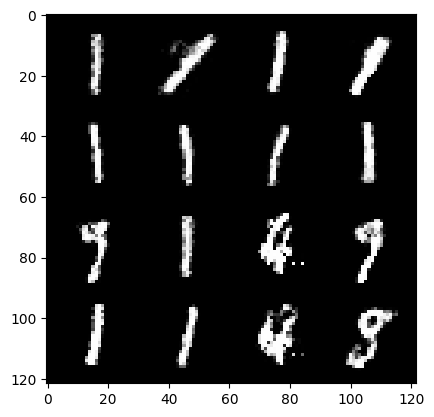

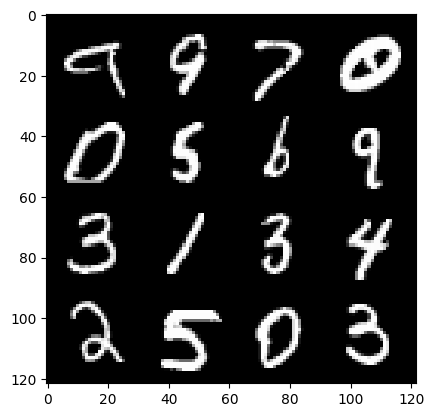

433: Step 203400 / Gen Loss : 2.4046404139200868 / Disc Loss : 0.21638694400588668


  0%|          | 0/469 [00:00<?, ?it/s]

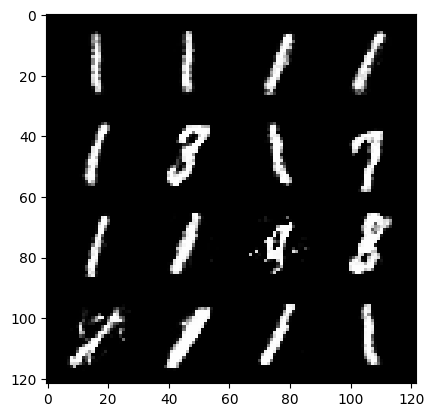

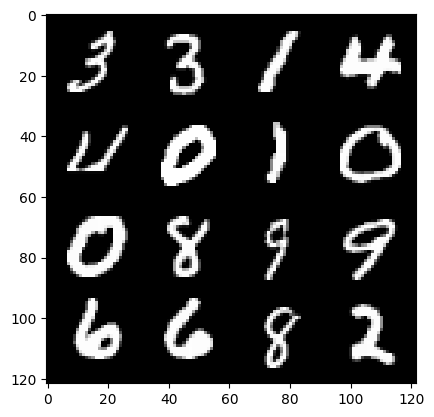

434: Step 203700 / Gen Loss : 2.343085734446844 / Disc Loss : 0.2225892538825669


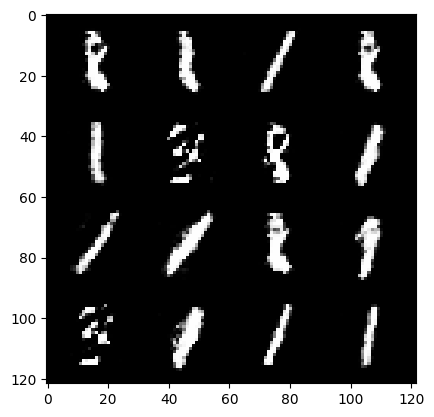

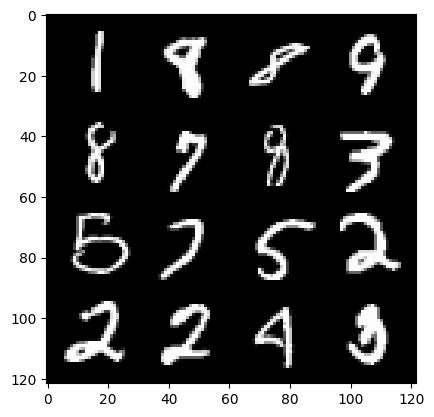

434: Step 204000 / Gen Loss : 2.375353597402572 / Disc Loss : 0.2282151292016109


  0%|          | 0/469 [00:00<?, ?it/s]

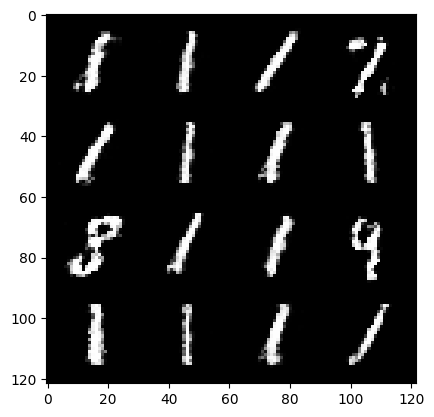

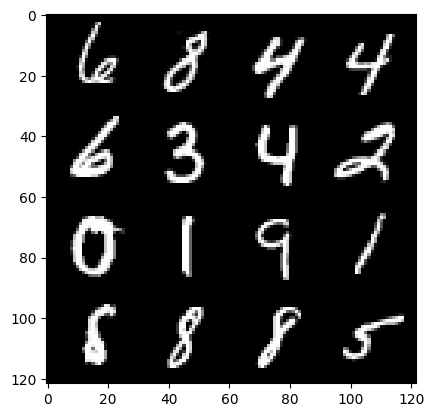

435: Step 204300 / Gen Loss : 2.2809267282485948 / Disc Loss : 0.23104771643877045


  0%|          | 0/469 [00:00<?, ?it/s]

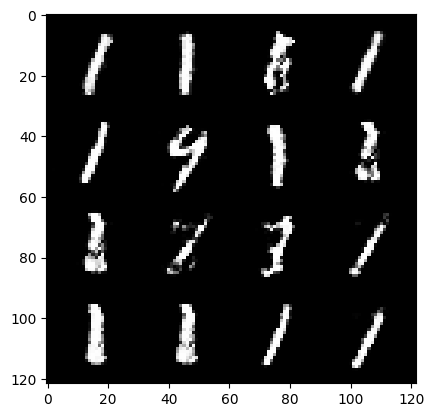

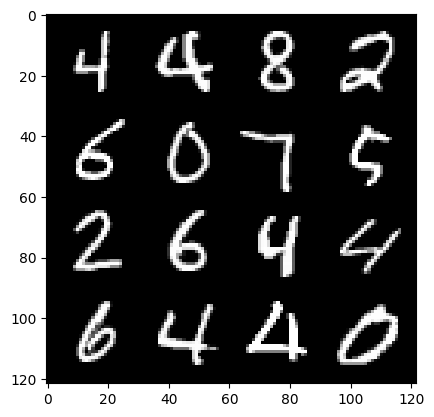

436: Step 204600 / Gen Loss : 2.2628386147816983 / Disc Loss : 0.22811403622229898


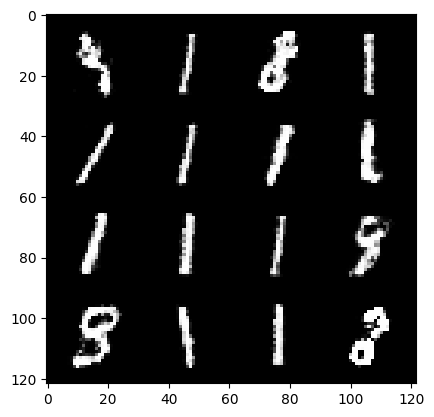

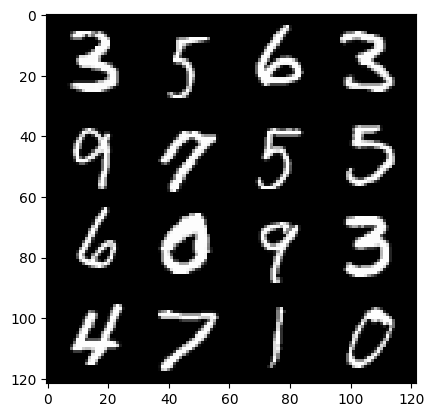

436: Step 204900 / Gen Loss : 2.257998243172963 / Disc Loss : 0.22808744092782324


  0%|          | 0/469 [00:00<?, ?it/s]

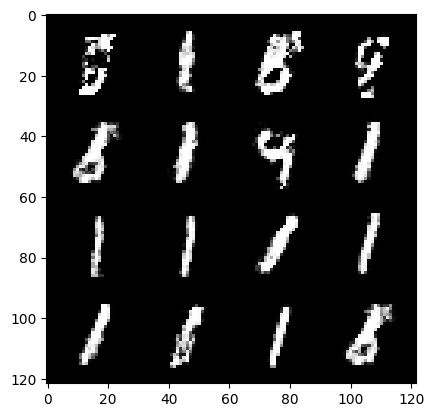

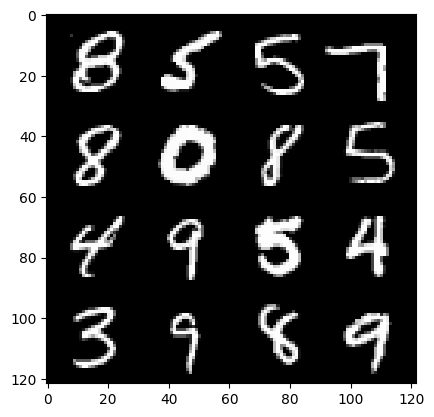

437: Step 205200 / Gen Loss : 2.2737437331676476 / Disc Loss : 0.22479004303614303


  0%|          | 0/469 [00:00<?, ?it/s]

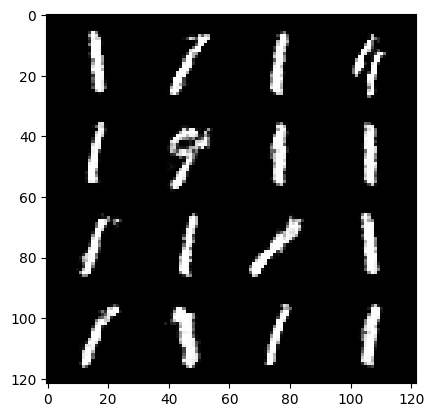

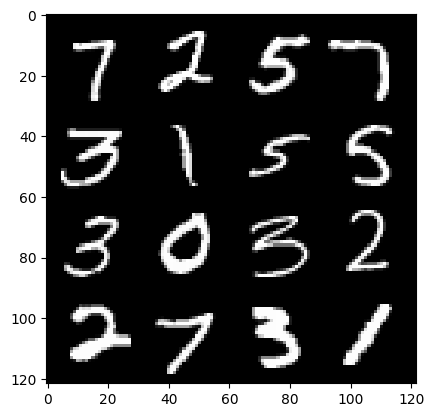

438: Step 205500 / Gen Loss : 2.274952013889947 / Disc Loss : 0.22849397569894808


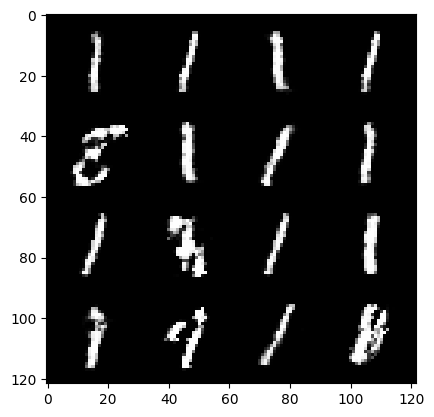

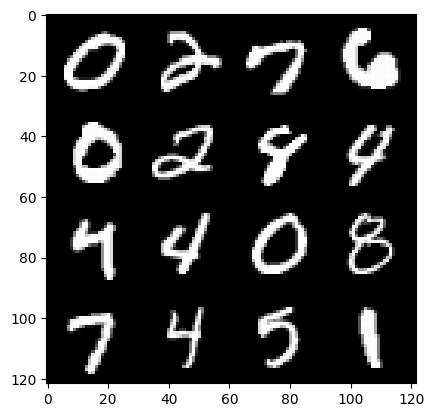

438: Step 205800 / Gen Loss : 2.2498720820744844 / Disc Loss : 0.22880301634470623


  0%|          | 0/469 [00:00<?, ?it/s]

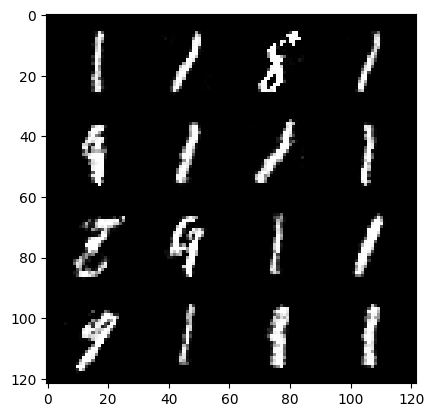

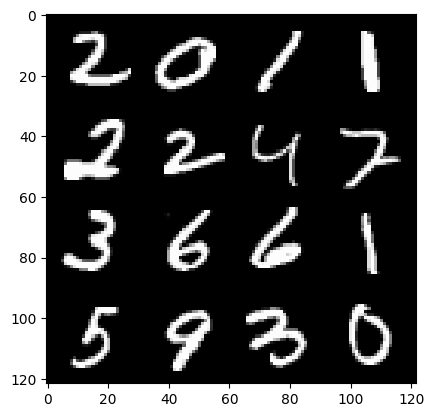

439: Step 206100 / Gen Loss : 2.2949503322442366 / Disc Loss : 0.20866836443543427


  0%|          | 0/469 [00:00<?, ?it/s]

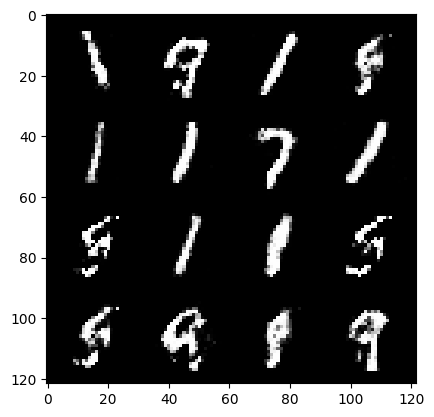

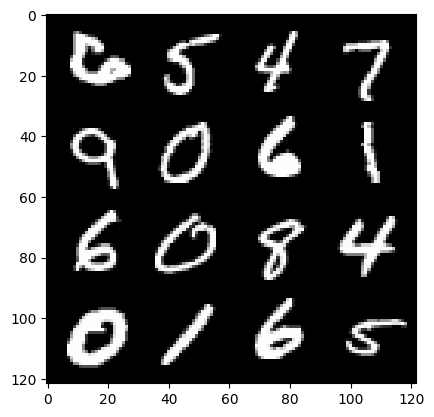

440: Step 206400 / Gen Loss : 2.240300879875819 / Disc Loss : 0.23383389939864488


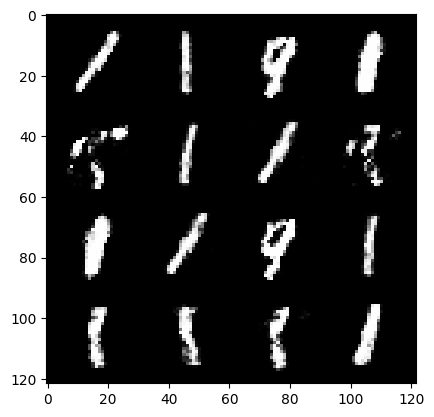

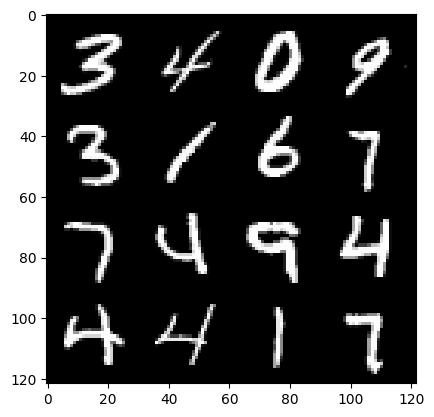

440: Step 206700 / Gen Loss : 2.184230399529139 / Disc Loss : 0.24604575778047252


  0%|          | 0/469 [00:00<?, ?it/s]

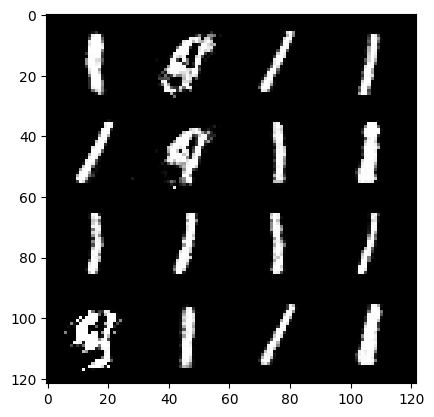

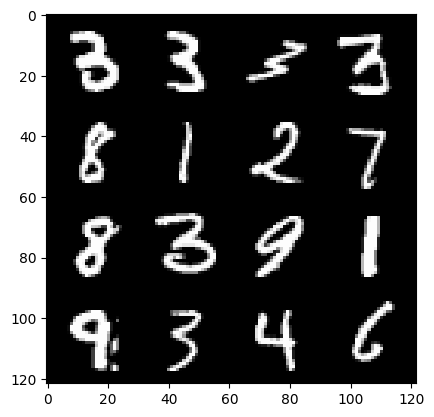

441: Step 207000 / Gen Loss : 2.204495269060134 / Disc Loss : 0.2413693414628506


  0%|          | 0/469 [00:00<?, ?it/s]

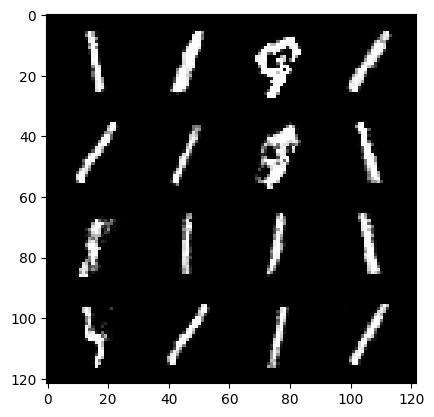

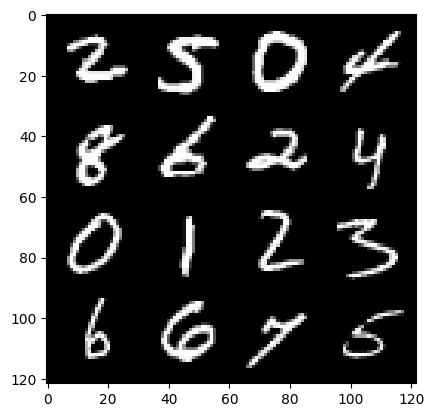

442: Step 207300 / Gen Loss : 2.2044421482086176 / Disc Loss : 0.23952003205815958


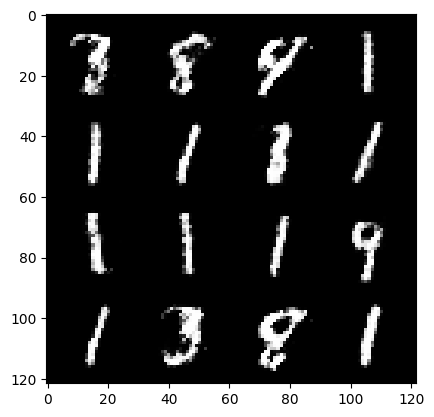

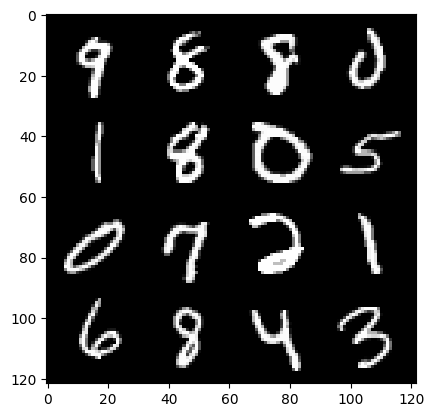

442: Step 207600 / Gen Loss : 2.2835531071821844 / Disc Loss : 0.24335116128126766


  0%|          | 0/469 [00:00<?, ?it/s]

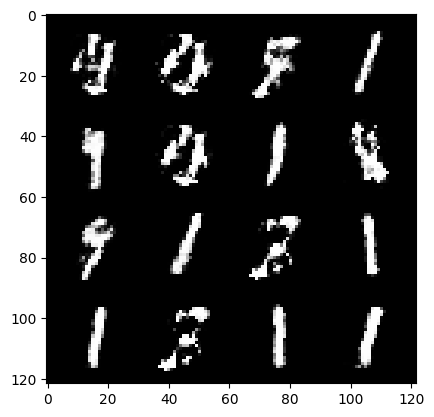

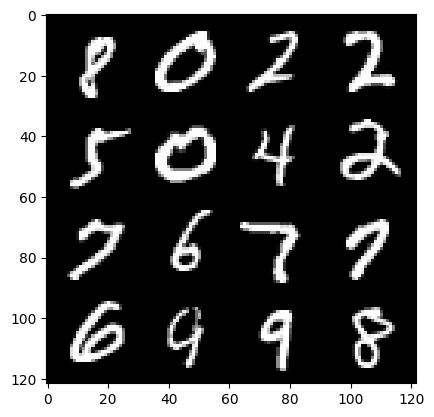

443: Step 207900 / Gen Loss : 2.2515877405802422 / Disc Loss : 0.24521318624416982


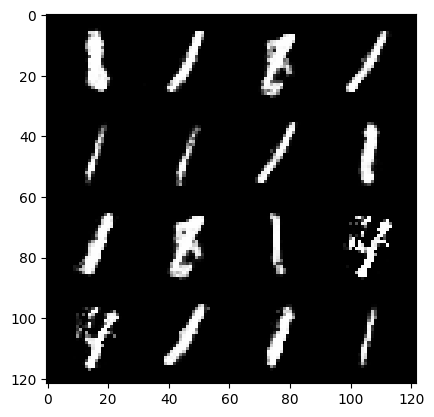

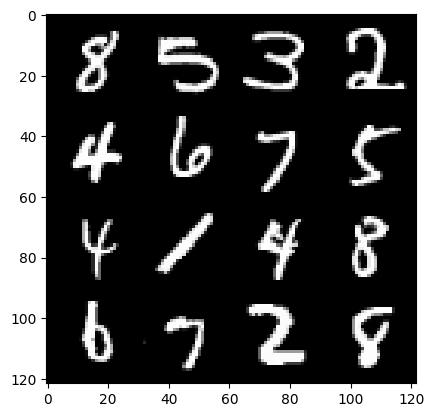

443: Step 208200 / Gen Loss : 2.2719645313421903 / Disc Loss : 0.24805184985200554


  0%|          | 0/469 [00:00<?, ?it/s]

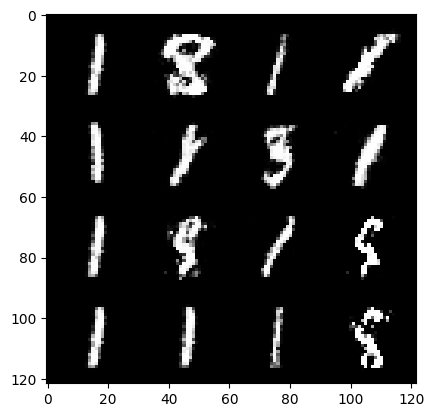

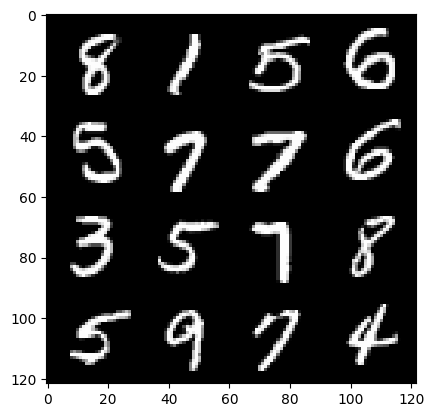

444: Step 208500 / Gen Loss : 2.256627363761266 / Disc Loss : 0.2408847920099892


  0%|          | 0/469 [00:00<?, ?it/s]

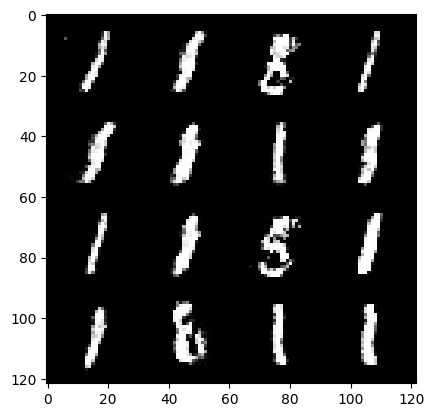

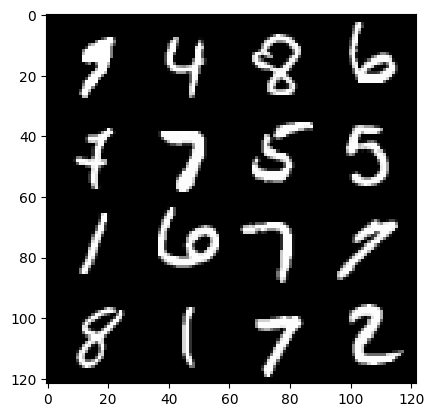

445: Step 208800 / Gen Loss : 2.2037063372135153 / Disc Loss : 0.254968379586935


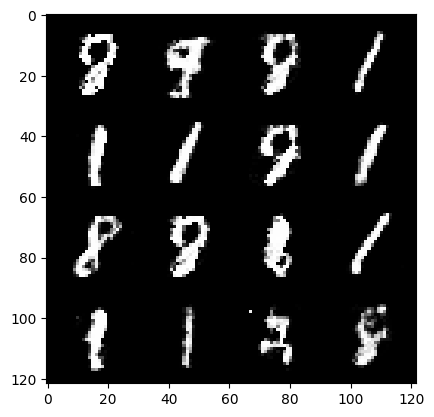

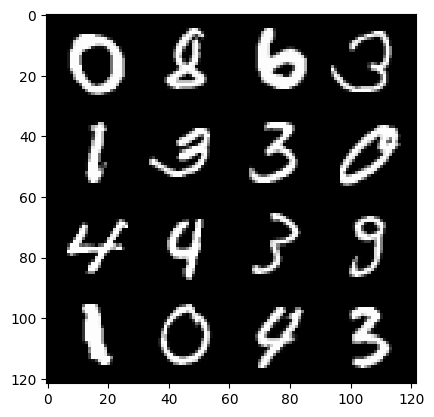

445: Step 209100 / Gen Loss : 2.2605546915531183 / Disc Loss : 0.24293263157208753


  0%|          | 0/469 [00:00<?, ?it/s]

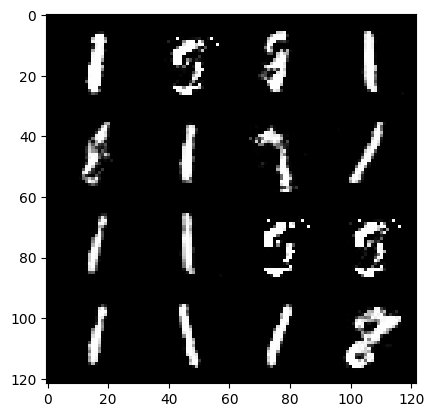

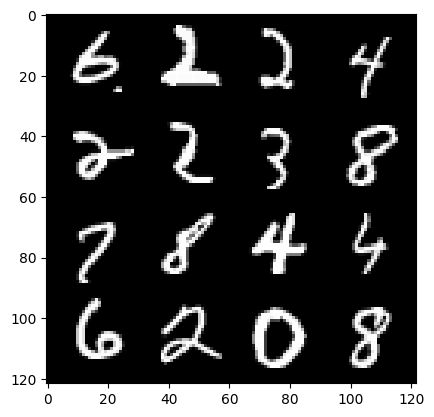

446: Step 209400 / Gen Loss : 2.3849690651893622 / Disc Loss : 0.21987530633807179


  0%|          | 0/469 [00:00<?, ?it/s]

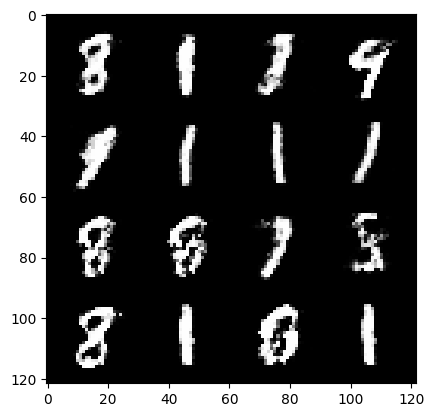

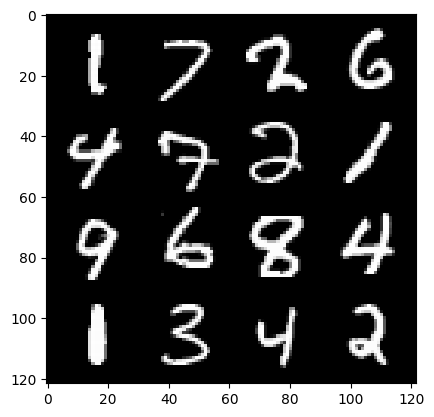

447: Step 209700 / Gen Loss : 2.2402662233511603 / Disc Loss : 0.23715389870107165


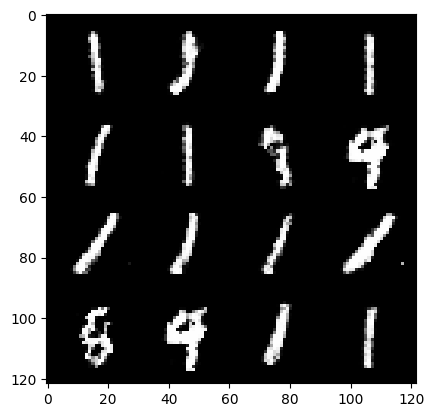

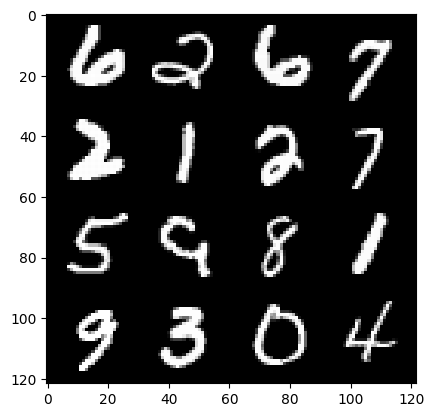

447: Step 210000 / Gen Loss : 2.2290642833709704 / Disc Loss : 0.2428456408282123


  0%|          | 0/469 [00:00<?, ?it/s]

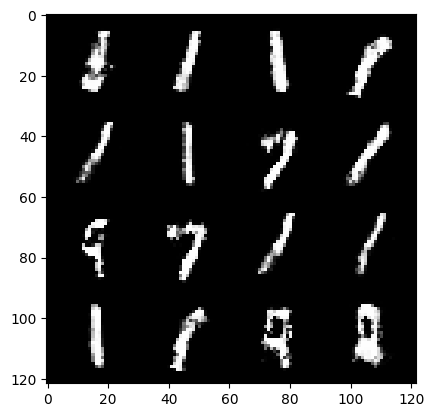

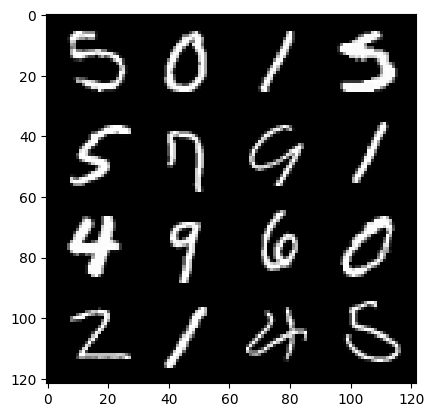

448: Step 210300 / Gen Loss : 2.206274197498957 / Disc Loss : 0.24134698162476217


  0%|          | 0/469 [00:00<?, ?it/s]

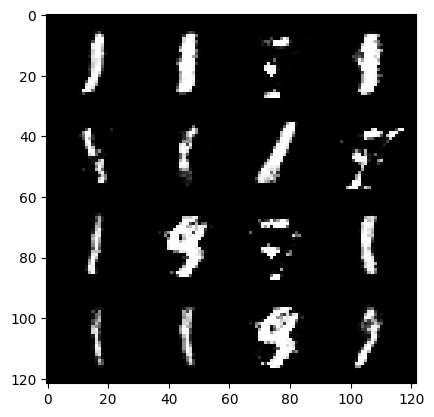

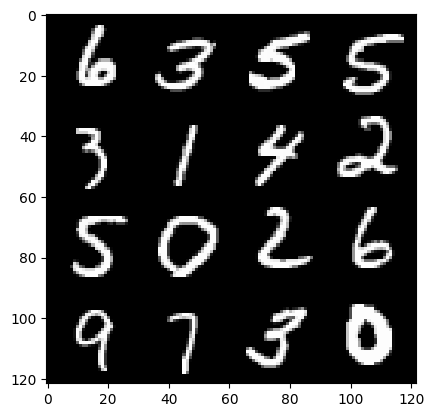

449: Step 210600 / Gen Loss : 2.139893410603204 / Disc Loss : 0.23909495428204522


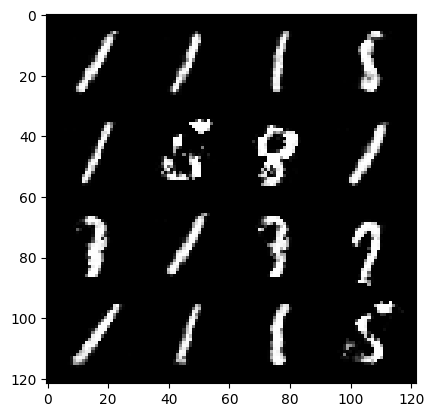

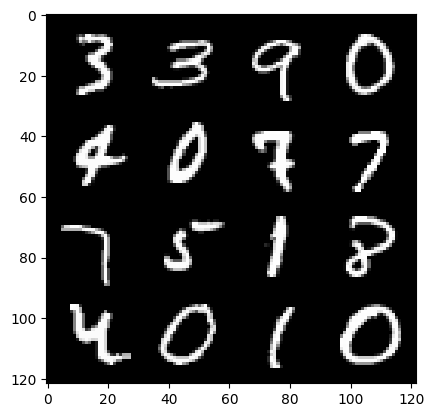

449: Step 210900 / Gen Loss : 2.295104843378066 / Disc Loss : 0.22173305022219794


  0%|          | 0/469 [00:00<?, ?it/s]

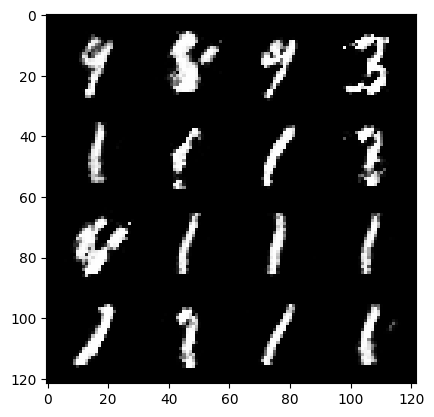

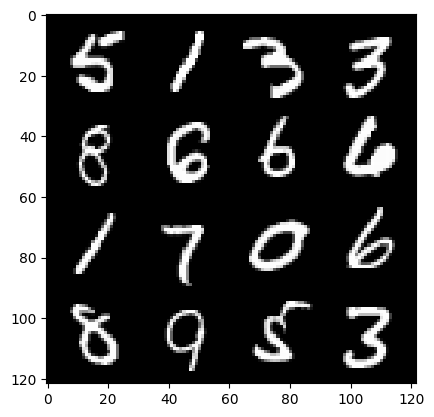

450: Step 211200 / Gen Loss : 2.373743000825246 / Disc Loss : 0.23209013581275947


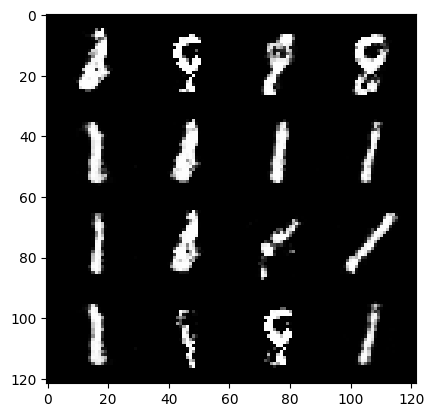

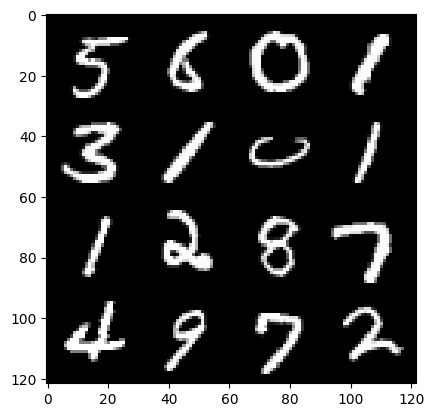

450: Step 211500 / Gen Loss : 2.458435015678407 / Disc Loss : 0.21183445483446123


  0%|          | 0/469 [00:00<?, ?it/s]

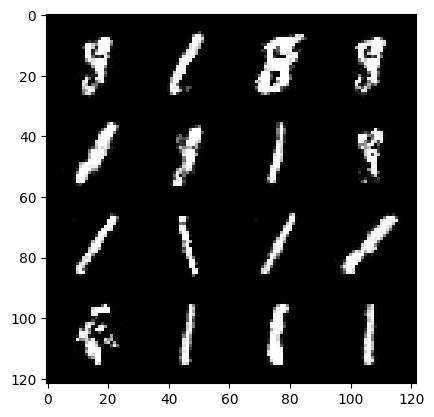

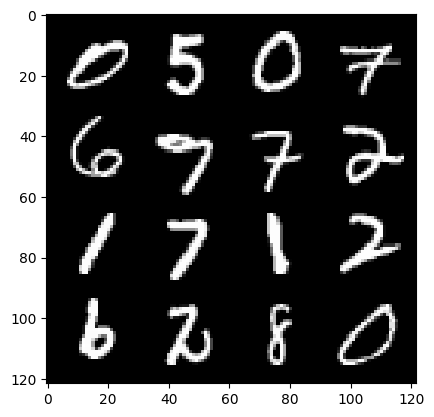

451: Step 211800 / Gen Loss : 2.39096288482348 / Disc Loss : 0.19971886160473032


  0%|          | 0/469 [00:00<?, ?it/s]

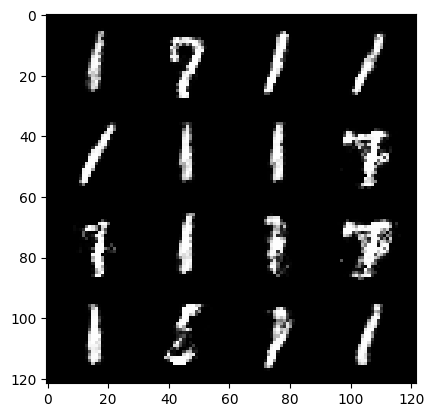

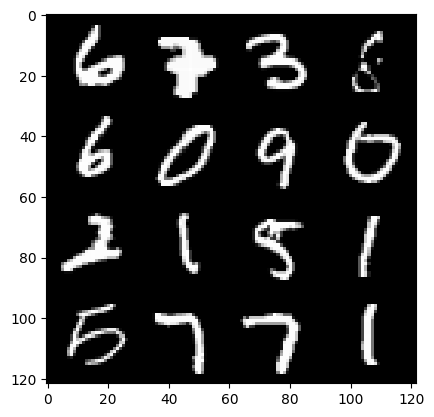

452: Step 212100 / Gen Loss : 2.446712199846904 / Disc Loss : 0.21132754966616643


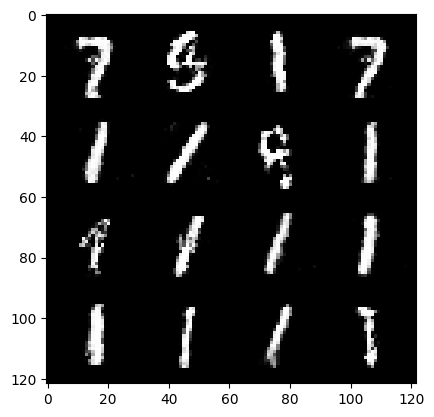

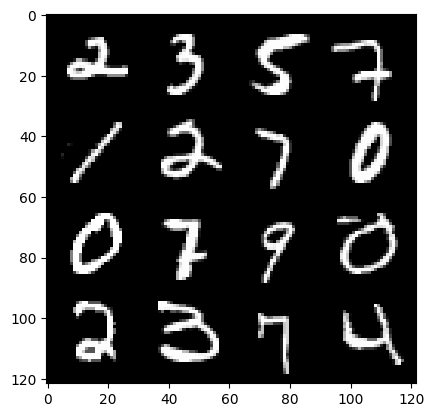

452: Step 212400 / Gen Loss : 2.484182531833648 / Disc Loss : 0.20764234508077306


  0%|          | 0/469 [00:00<?, ?it/s]

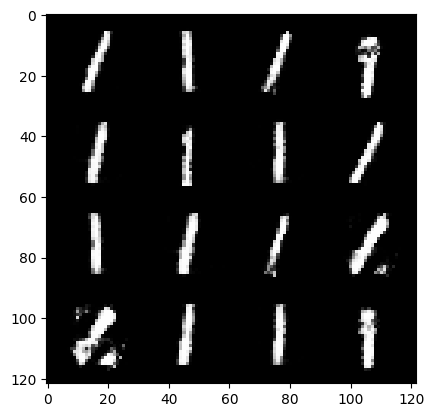

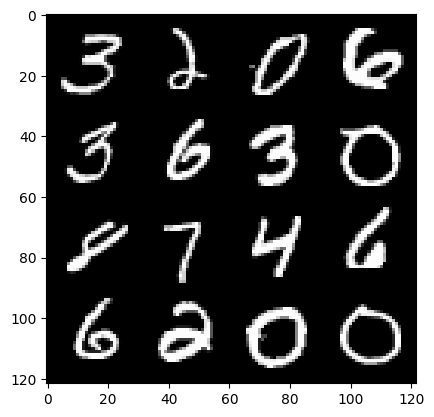

453: Step 212700 / Gen Loss : 2.325150564511617 / Disc Loss : 0.22376230835914615


  0%|          | 0/469 [00:00<?, ?it/s]

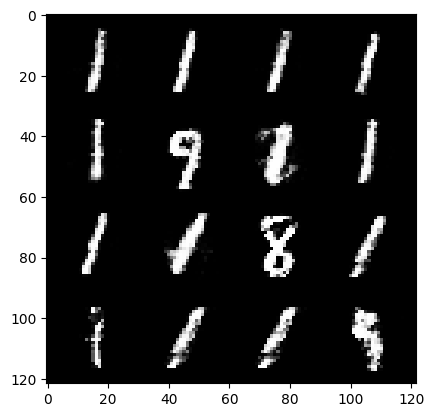

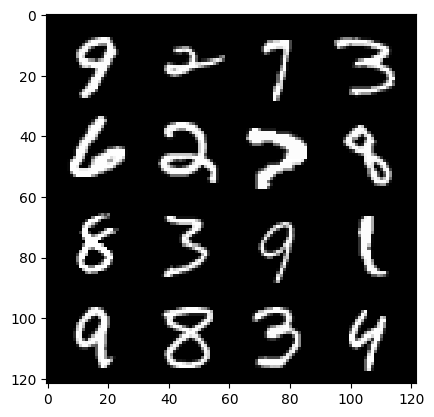

454: Step 213000 / Gen Loss : 2.303435153961182 / Disc Loss : 0.2248763886094094


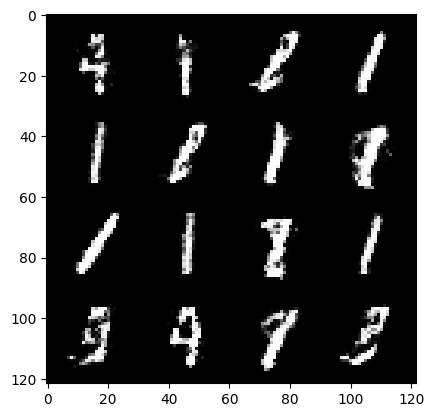

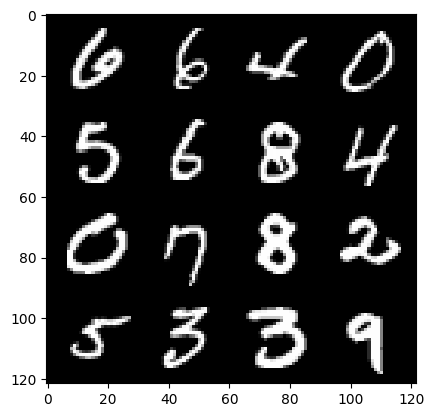

454: Step 213300 / Gen Loss : 2.4400203132629366 / Disc Loss : 0.2018776622911292


  0%|          | 0/469 [00:00<?, ?it/s]

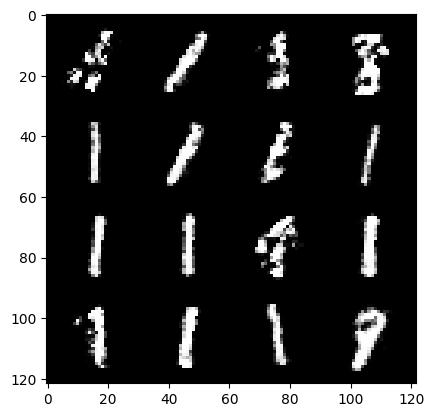

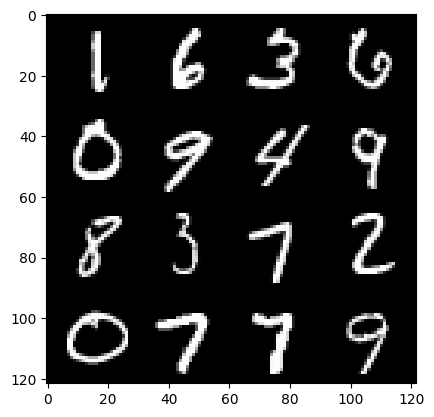

455: Step 213600 / Gen Loss : 2.373077748219173 / Disc Loss : 0.22489789138237656


  0%|          | 0/469 [00:00<?, ?it/s]

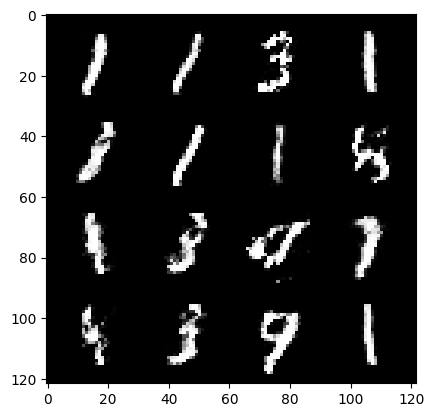

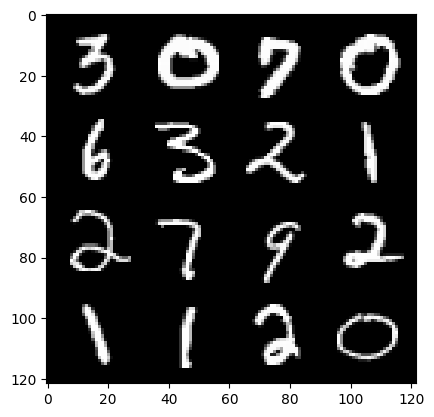

456: Step 213900 / Gen Loss : 2.2547820111115775 / Disc Loss : 0.23823290710647896


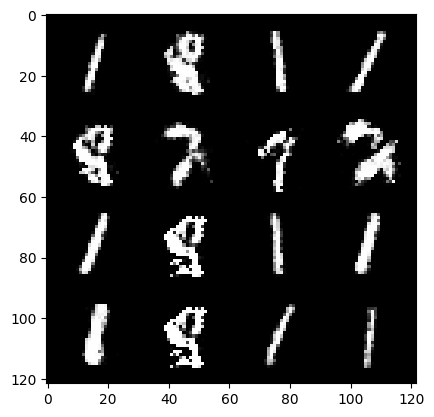

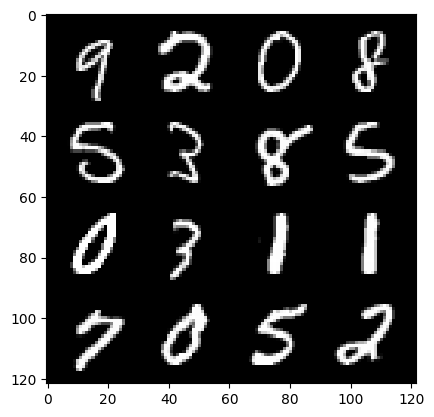

456: Step 214200 / Gen Loss : 2.3214354626337697 / Disc Loss : 0.22963616306583093


  0%|          | 0/469 [00:00<?, ?it/s]

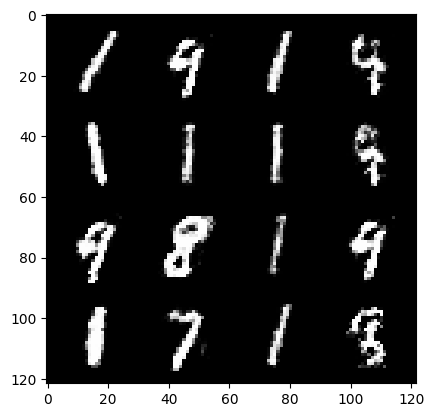

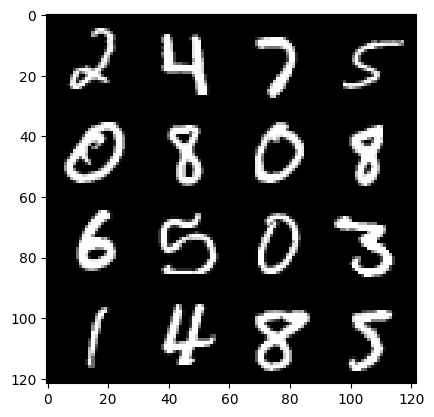

457: Step 214500 / Gen Loss : 2.3182162209351844 / Disc Loss : 0.21985680172840757


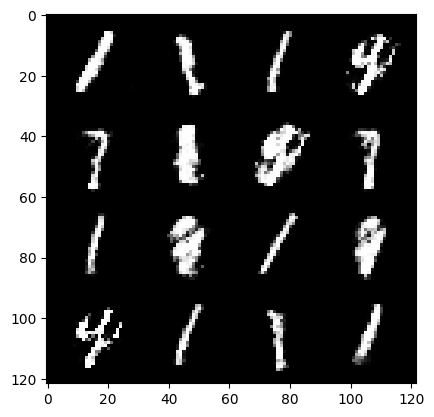

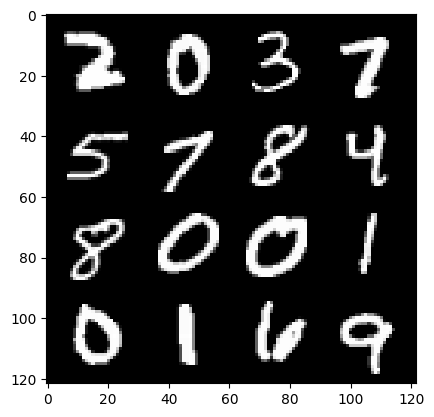

457: Step 214800 / Gen Loss : 2.3623004980882034 / Disc Loss : 0.22947125812371597


  0%|          | 0/469 [00:00<?, ?it/s]

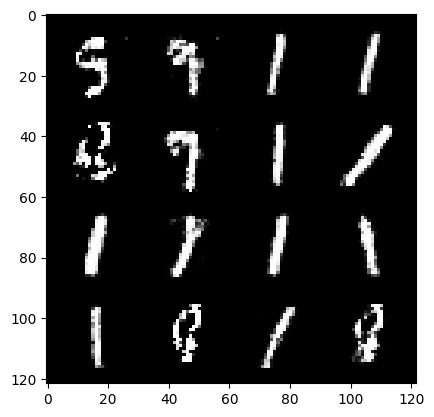

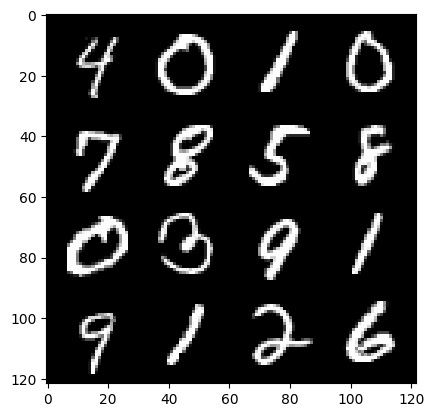

458: Step 215100 / Gen Loss : 2.247653966347375 / Disc Loss : 0.2291241287688414


  0%|          | 0/469 [00:00<?, ?it/s]

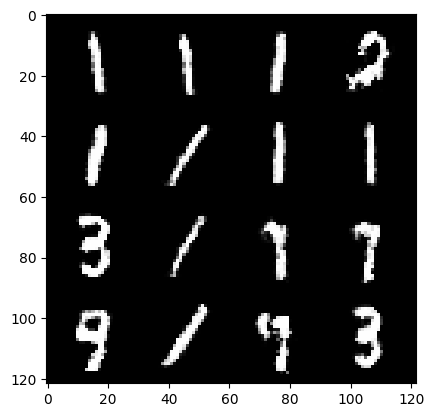

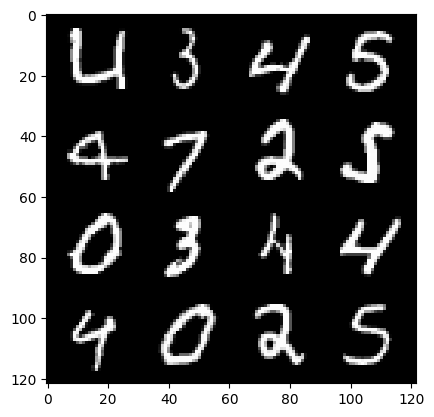

459: Step 215400 / Gen Loss : 2.1646484216054294 / Disc Loss : 0.2582330008844533


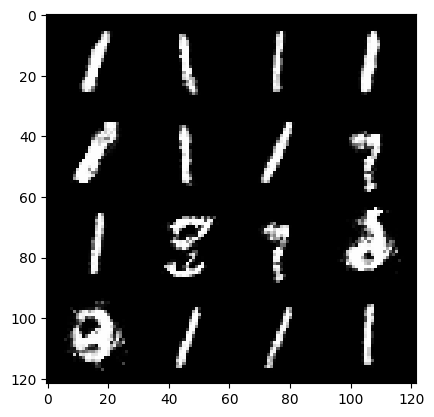

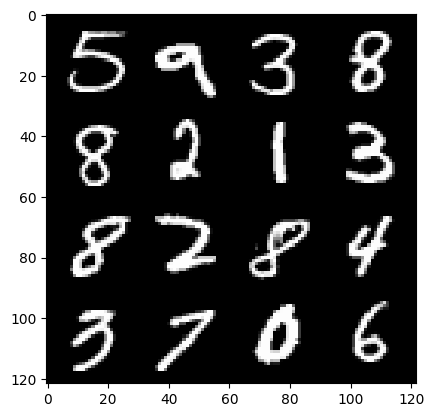

459: Step 215700 / Gen Loss : 2.1589511072635634 / Disc Loss : 0.26977589910229044


  0%|          | 0/469 [00:00<?, ?it/s]

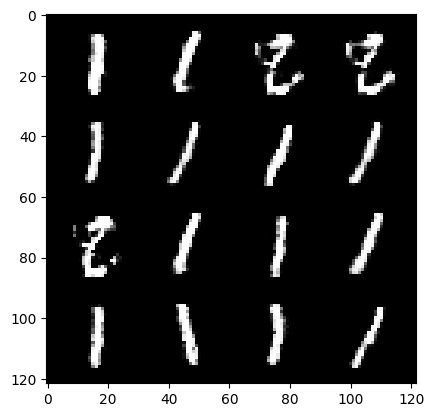

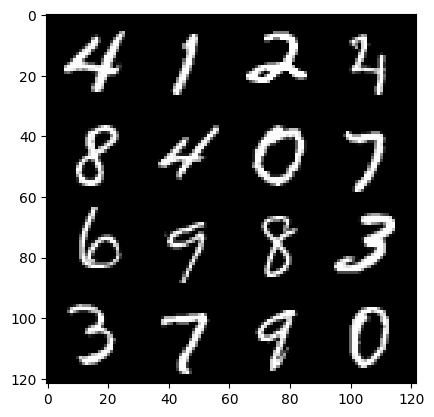

460: Step 216000 / Gen Loss : 2.140102424224218 / Disc Loss : 0.2528895613551141


  0%|          | 0/469 [00:00<?, ?it/s]

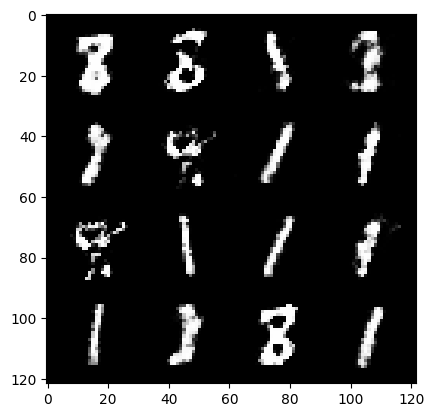

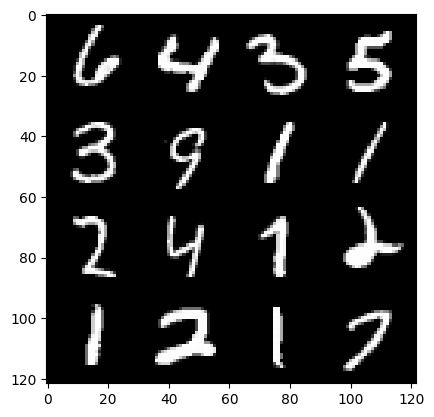

461: Step 216300 / Gen Loss : 2.2033014527956647 / Disc Loss : 0.2570496499538423


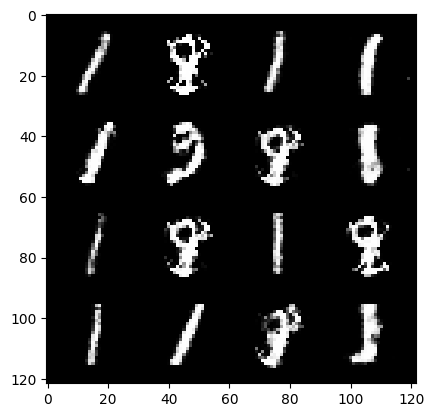

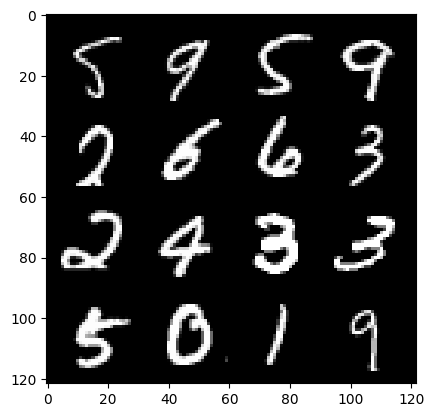

461: Step 216600 / Gen Loss : 2.193048524856567 / Disc Loss : 0.24666439503431323


  0%|          | 0/469 [00:00<?, ?it/s]

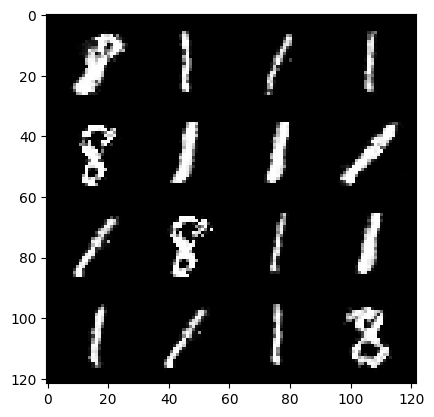

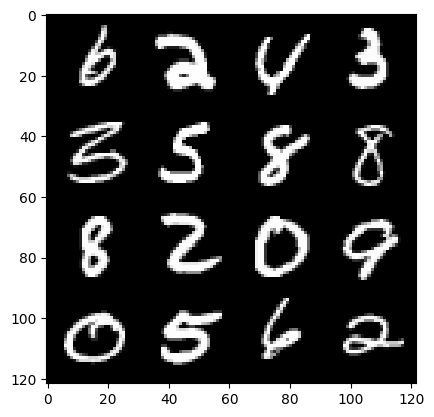

462: Step 216900 / Gen Loss : 2.099964844783148 / Disc Loss : 0.26200780371824905


  0%|          | 0/469 [00:00<?, ?it/s]

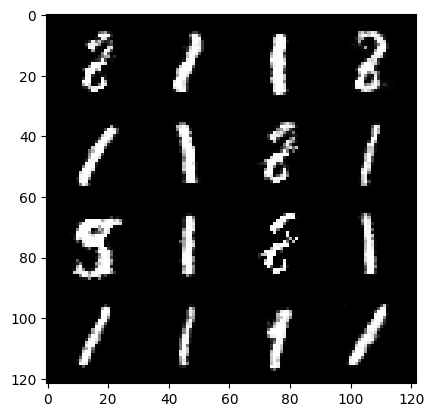

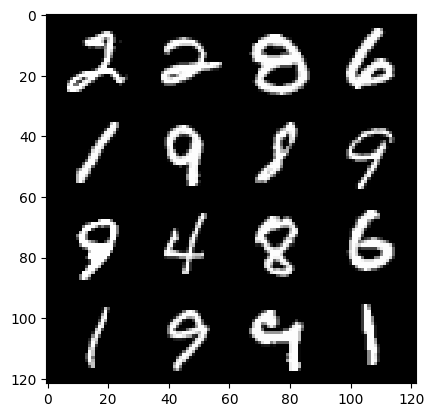

463: Step 217200 / Gen Loss : 2.185255973736446 / Disc Loss : 0.24747545987367645


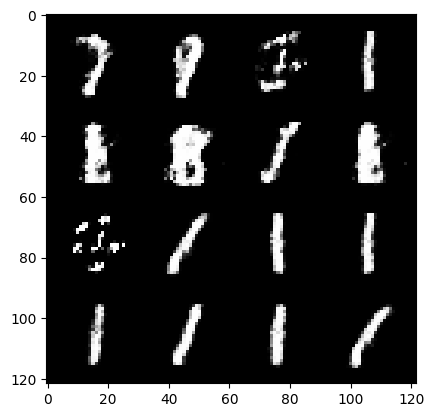

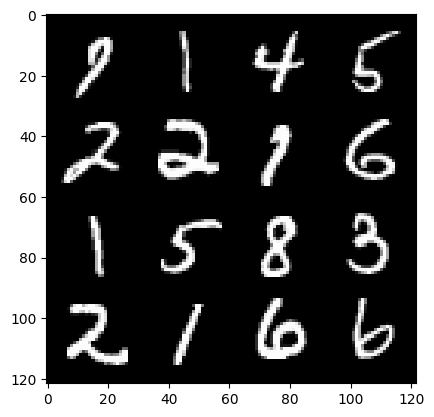

463: Step 217500 / Gen Loss : 2.1664229619503037 / Disc Loss : 0.2669761786858242


  0%|          | 0/469 [00:00<?, ?it/s]

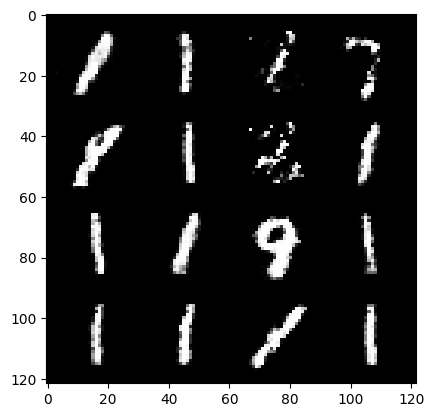

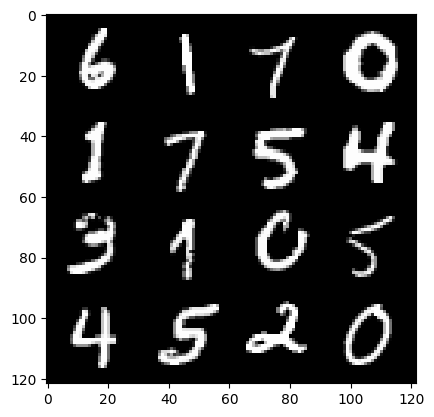

464: Step 217800 / Gen Loss : 2.2692052535216005 / Disc Loss : 0.2302124558389187


  0%|          | 0/469 [00:00<?, ?it/s]

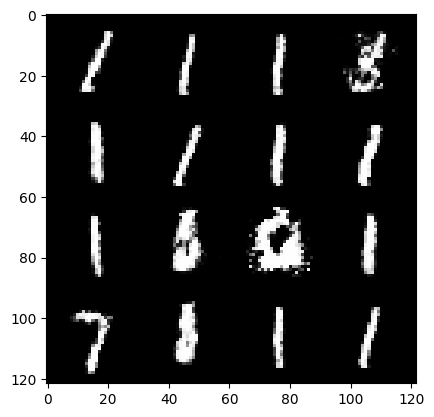

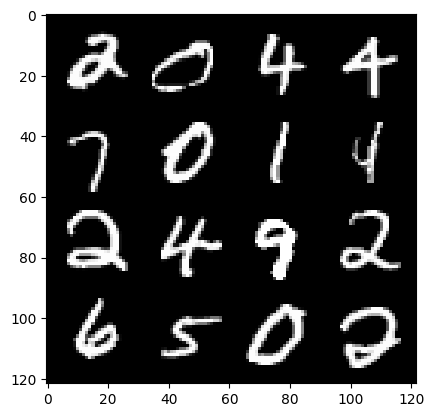

465: Step 218100 / Gen Loss : 2.3335077838102967 / Disc Loss : 0.21927827293674126


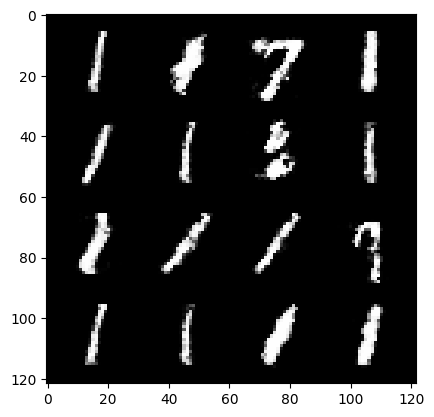

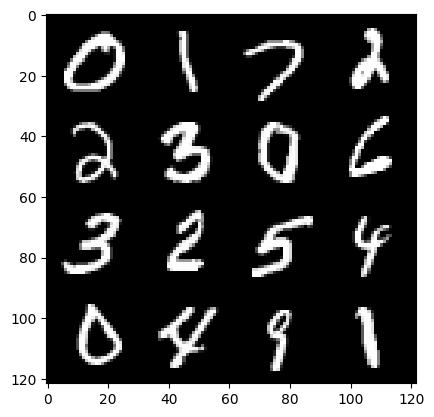

465: Step 218400 / Gen Loss : 2.240505143801373 / Disc Loss : 0.2448638321459294


  0%|          | 0/469 [00:00<?, ?it/s]

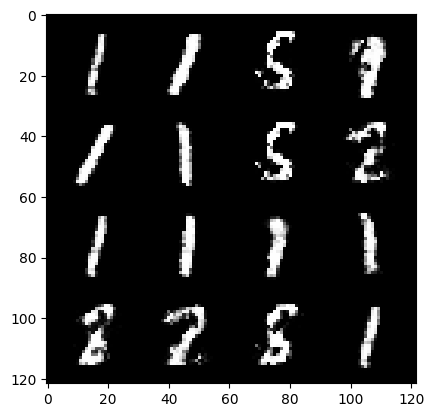

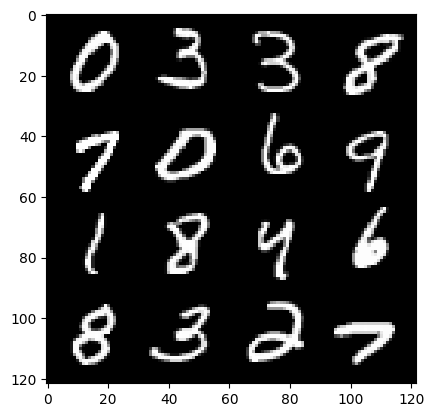

466: Step 218700 / Gen Loss : 2.427157714366915 / Disc Loss : 0.23131207024057712


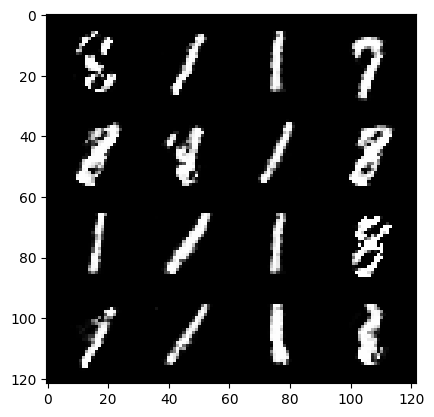

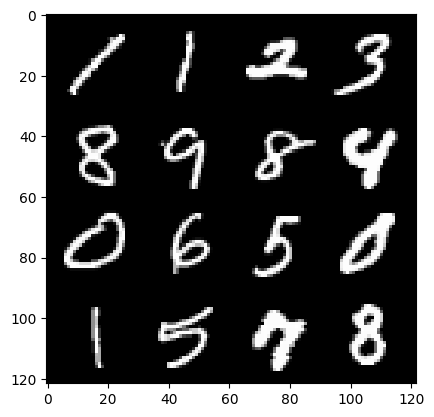

466: Step 219000 / Gen Loss : 2.2548875880241384 / Disc Loss : 0.24962076693773294


  0%|          | 0/469 [00:00<?, ?it/s]

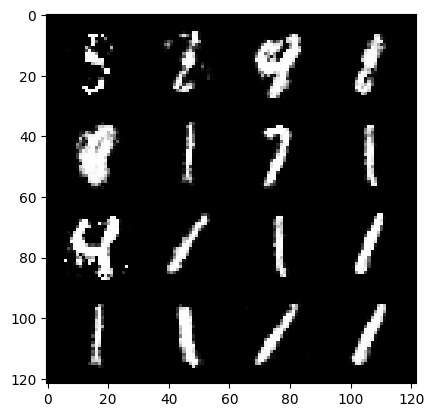

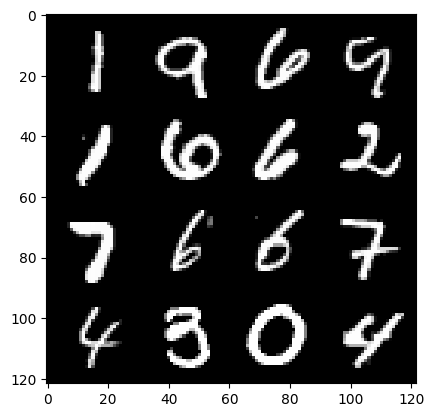

467: Step 219300 / Gen Loss : 2.2617110840479535 / Disc Loss : 0.25116119876503956


  0%|          | 0/469 [00:00<?, ?it/s]

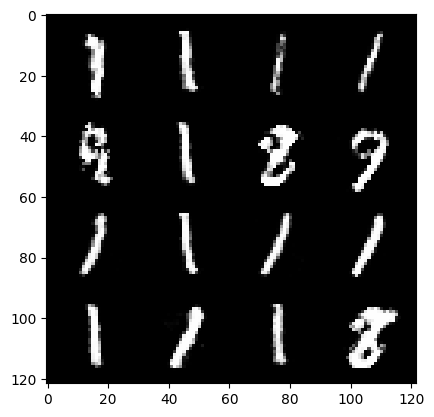

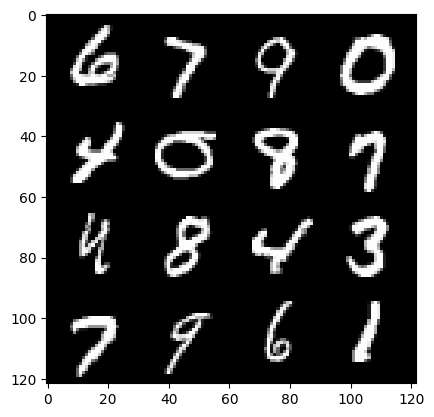

468: Step 219600 / Gen Loss : 2.2130243070920312 / Disc Loss : 0.24026922578612955


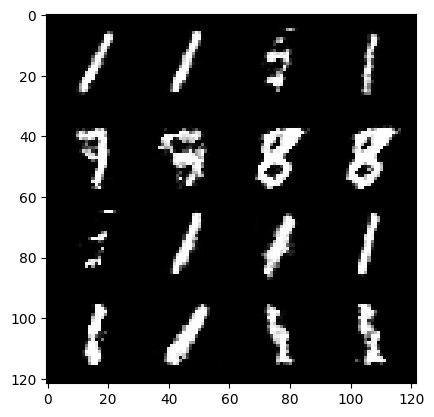

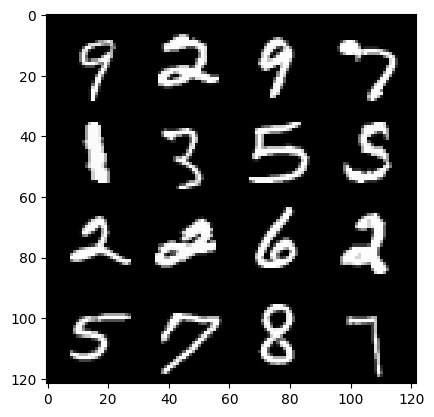

468: Step 219900 / Gen Loss : 2.226245120366414 / Disc Loss : 0.2628342732290426


  0%|          | 0/469 [00:00<?, ?it/s]

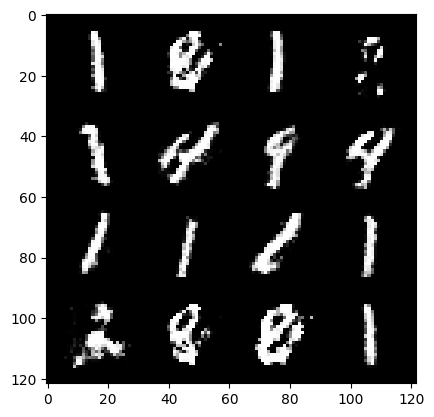

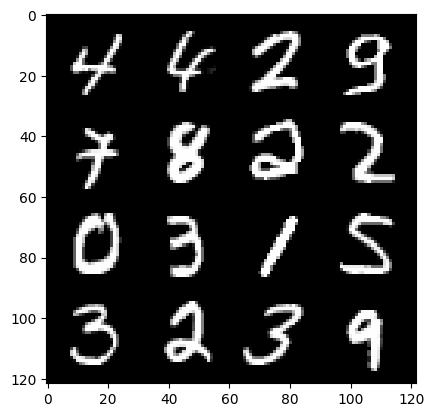

469: Step 220200 / Gen Loss : 2.2206672020753233 / Disc Loss : 0.2609041330218314


  0%|          | 0/469 [00:00<?, ?it/s]

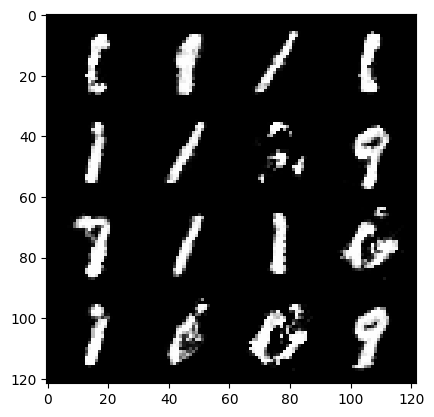

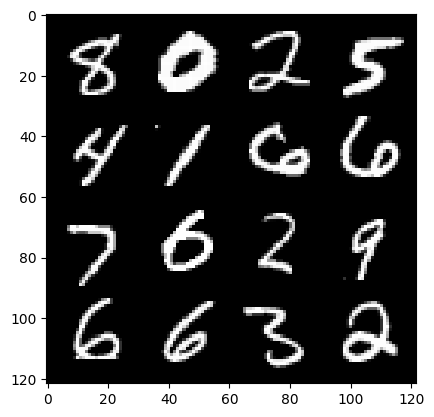

470: Step 220500 / Gen Loss : 2.2805840023358654 / Disc Loss : 0.24361055364211376


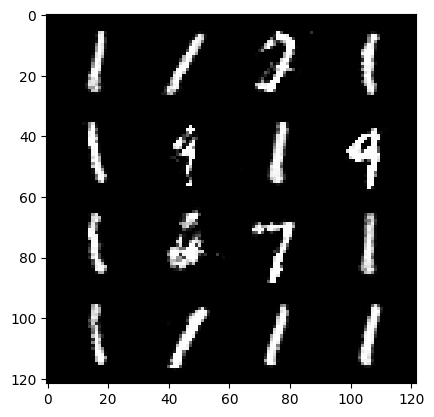

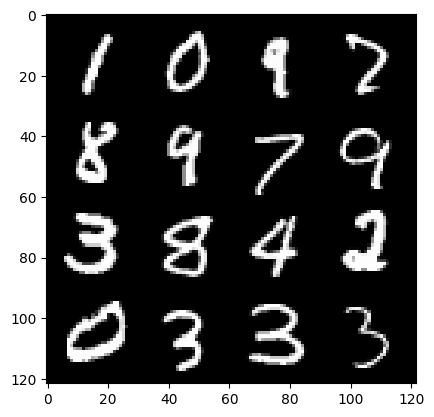

470: Step 220800 / Gen Loss : 2.303440670569739 / Disc Loss : 0.23611909210681928


  0%|          | 0/469 [00:00<?, ?it/s]

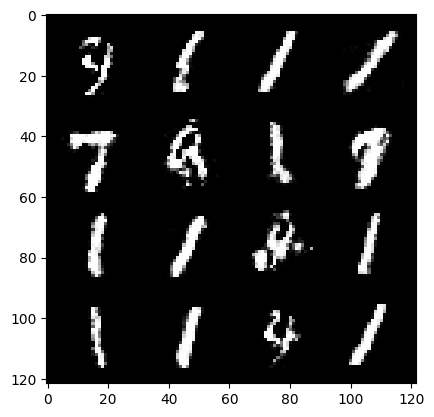

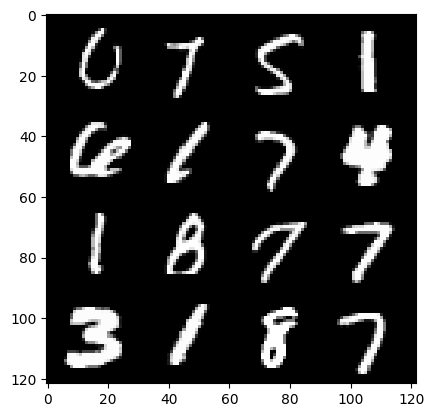

471: Step 221100 / Gen Loss : 2.2095253018538155 / Disc Loss : 0.2530149198571841


  0%|          | 0/469 [00:00<?, ?it/s]

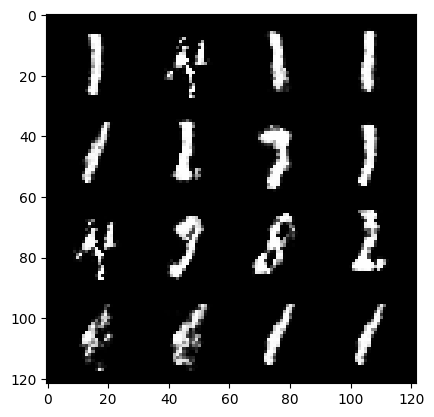

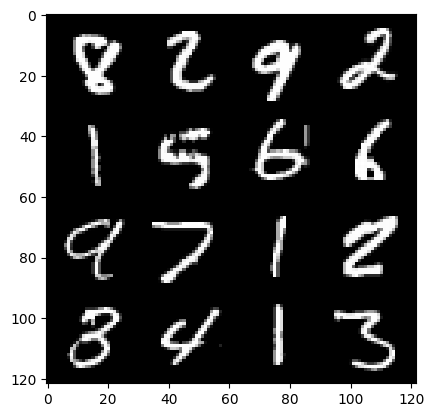

472: Step 221400 / Gen Loss : 2.201451574563981 / Disc Loss : 0.2506163870791597


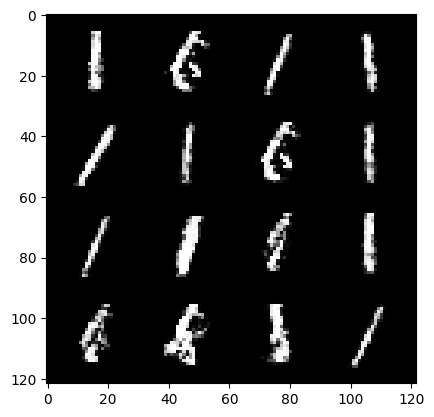

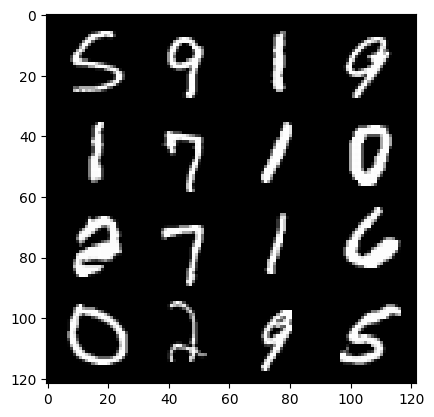

472: Step 221700 / Gen Loss : 2.14008309284846 / Disc Loss : 0.24755894045035048


  0%|          | 0/469 [00:00<?, ?it/s]

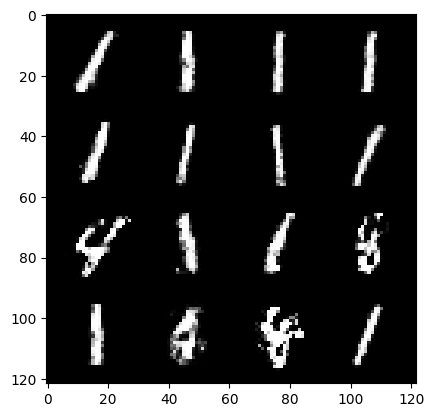

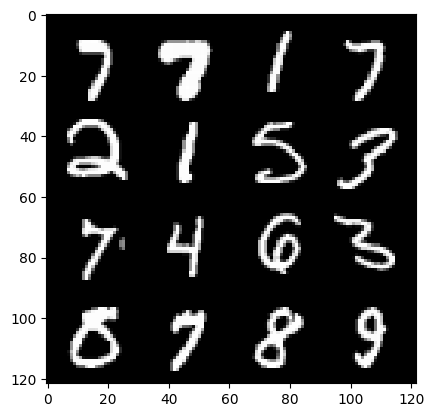

473: Step 222000 / Gen Loss : 2.135452738205592 / Disc Loss : 0.2434996751447518


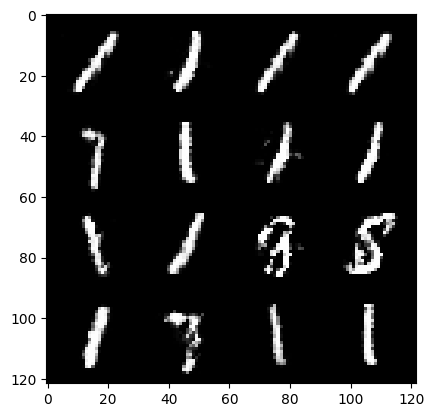

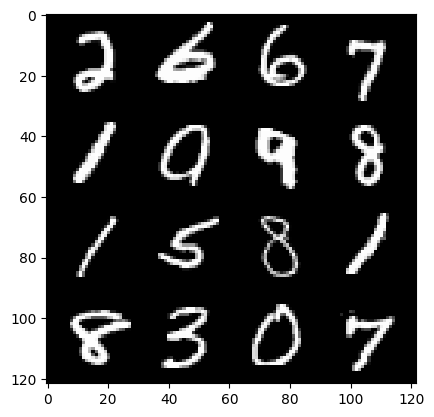

473: Step 222300 / Gen Loss : 2.14847704052925 / Disc Loss : 0.2570504255096119


  0%|          | 0/469 [00:00<?, ?it/s]

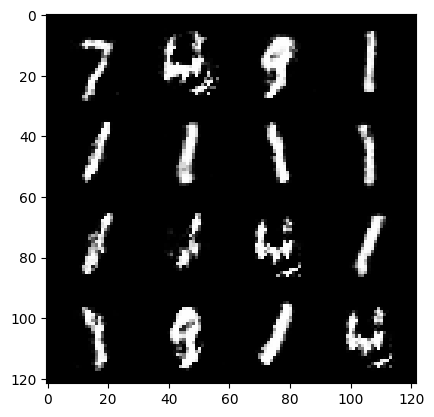

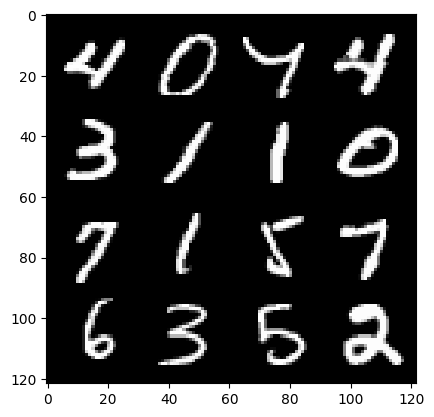

474: Step 222600 / Gen Loss : 2.115607558488845 / Disc Loss : 0.2586398534476757


  0%|          | 0/469 [00:00<?, ?it/s]

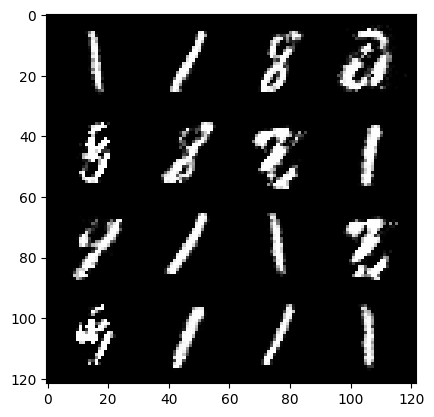

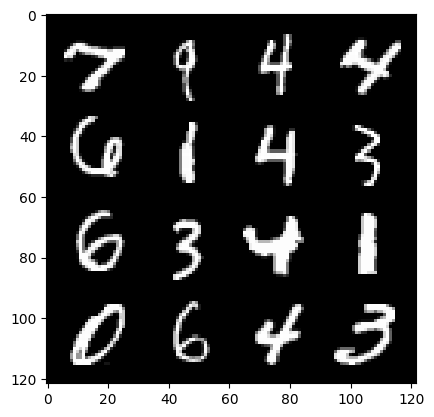

475: Step 222900 / Gen Loss : 2.2054826609293627 / Disc Loss : 0.25014959986011187


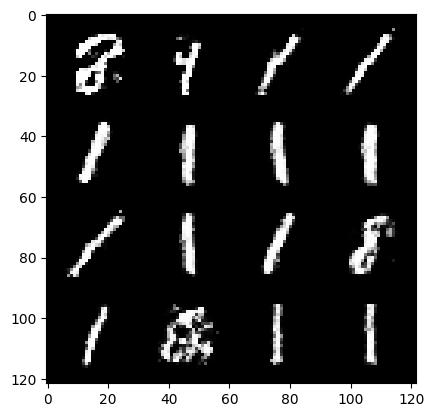

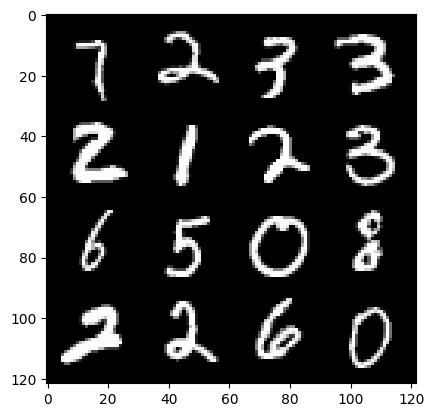

475: Step 223200 / Gen Loss : 2.181969047387441 / Disc Loss : 0.24227333212892221


  0%|          | 0/469 [00:00<?, ?it/s]

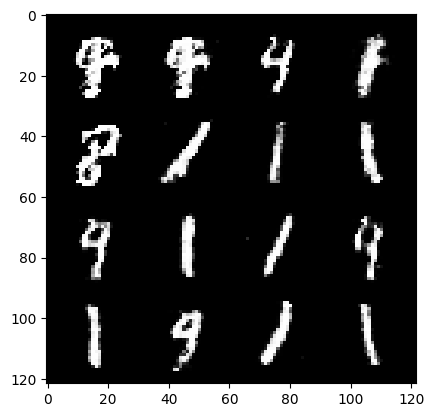

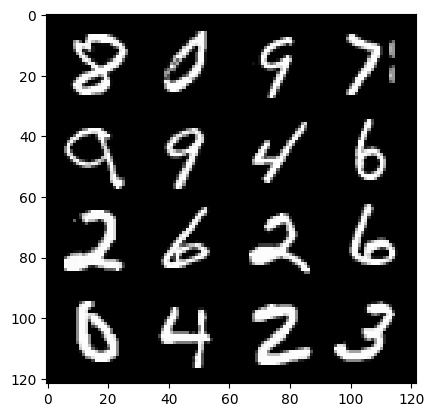

476: Step 223500 / Gen Loss : 2.1965011207262686 / Disc Loss : 0.24780883391698194


  0%|          | 0/469 [00:00<?, ?it/s]

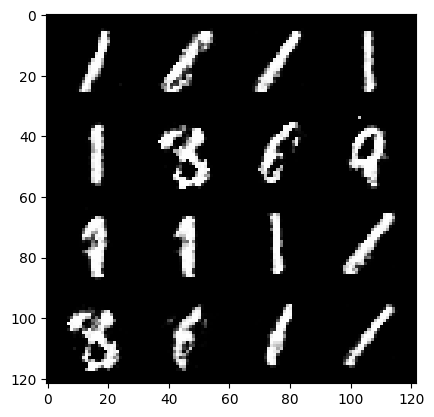

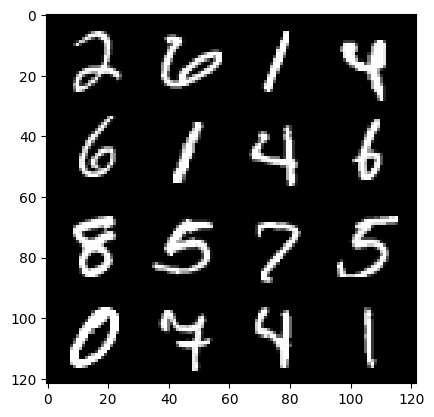

477: Step 223800 / Gen Loss : 2.0870160663127892 / Disc Loss : 0.2651151041189828


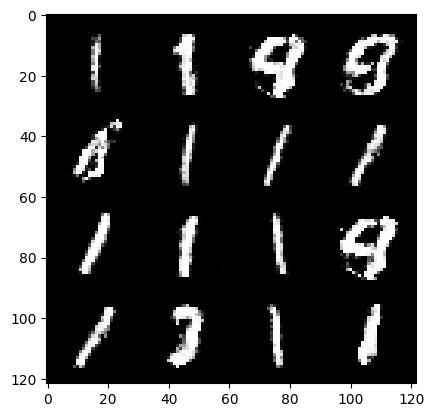

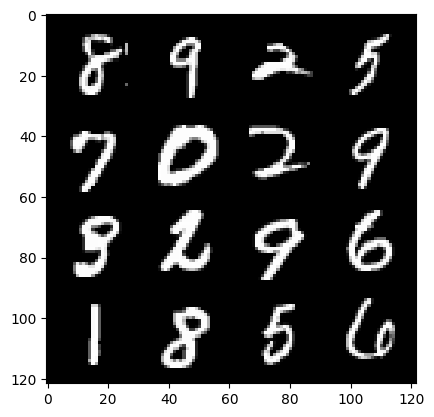

477: Step 224100 / Gen Loss : 2.154514692624409 / Disc Loss : 0.25144766300916677


  0%|          | 0/469 [00:00<?, ?it/s]

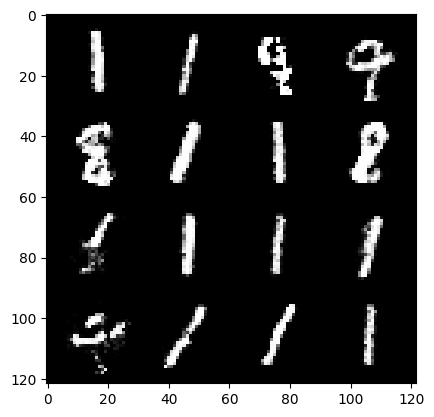

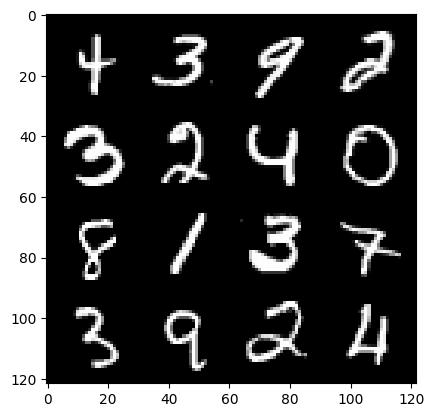

478: Step 224400 / Gen Loss : 2.171421562433243 / Disc Loss : 0.26827855010827384


  0%|          | 0/469 [00:00<?, ?it/s]

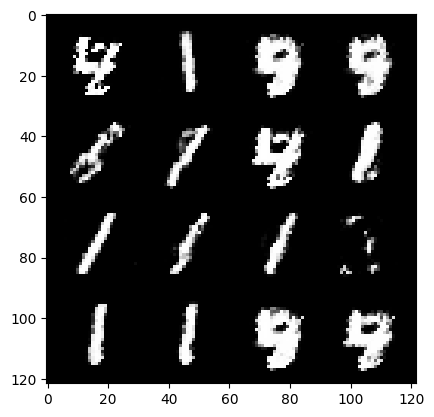

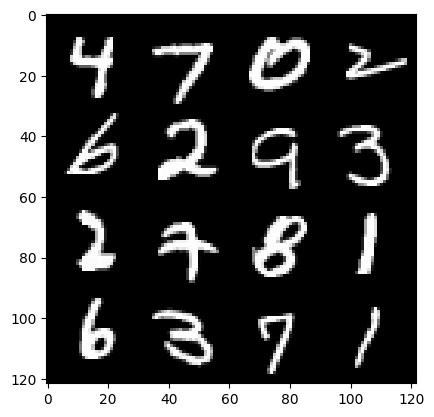

479: Step 224700 / Gen Loss : 2.1159301392237357 / Disc Loss : 0.2743830041587352


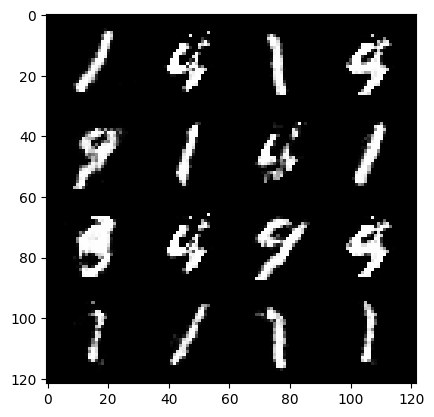

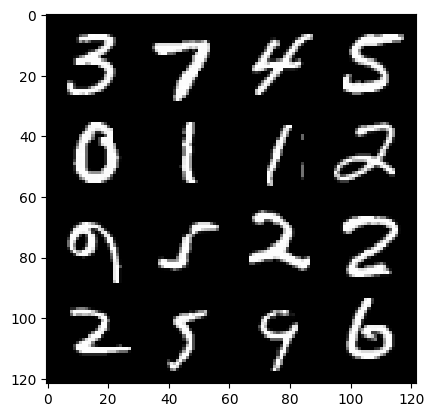

479: Step 225000 / Gen Loss : 2.145043750206629 / Disc Loss : 0.248858090688785


  0%|          | 0/469 [00:00<?, ?it/s]

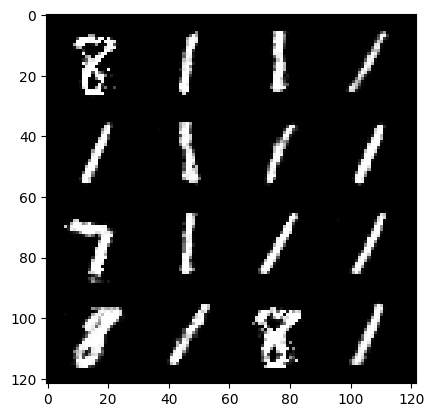

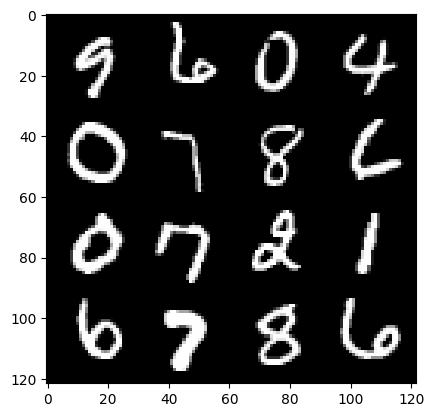

480: Step 225300 / Gen Loss : 2.1686748377482092 / Disc Loss : 0.2485665777822335


  0%|          | 0/469 [00:00<?, ?it/s]

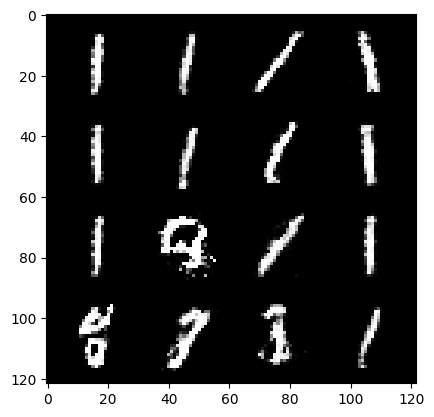

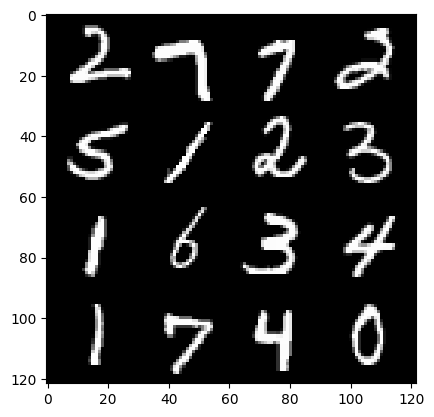

481: Step 225600 / Gen Loss : 2.1216341328620927 / Disc Loss : 0.2636164594193301


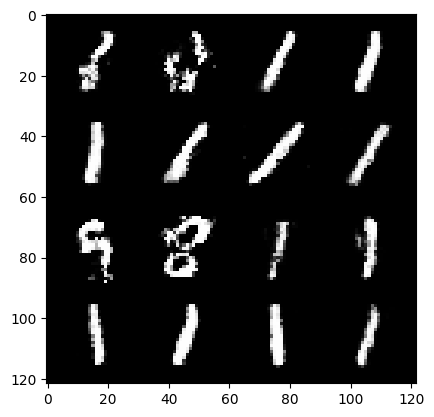

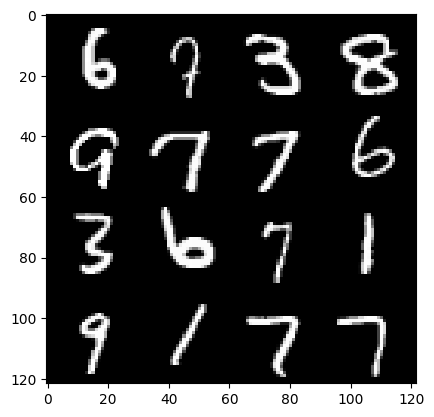

481: Step 225900 / Gen Loss : 2.0891537106037137 / Disc Loss : 0.28455169404546415


  0%|          | 0/469 [00:00<?, ?it/s]

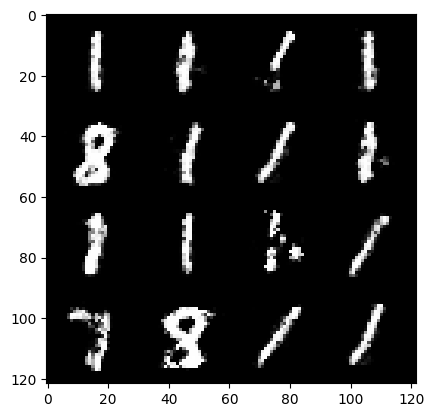

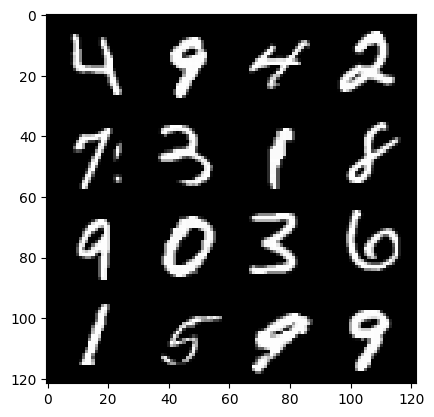

482: Step 226200 / Gen Loss : 2.2249468187491113 / Disc Loss : 0.23848679959774002


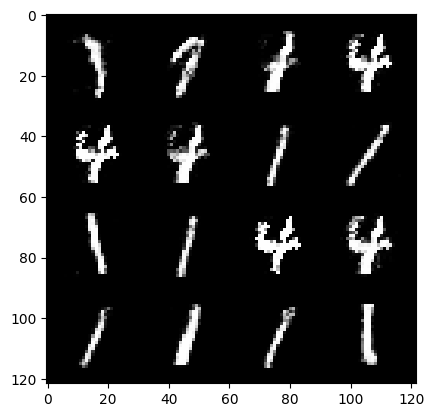

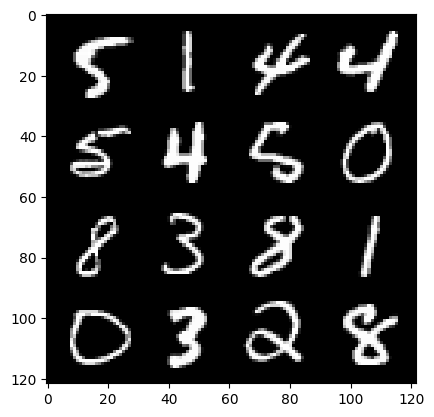

482: Step 226500 / Gen Loss : 2.183754459619523 / Disc Loss : 0.24539384375015907


  0%|          | 0/469 [00:00<?, ?it/s]

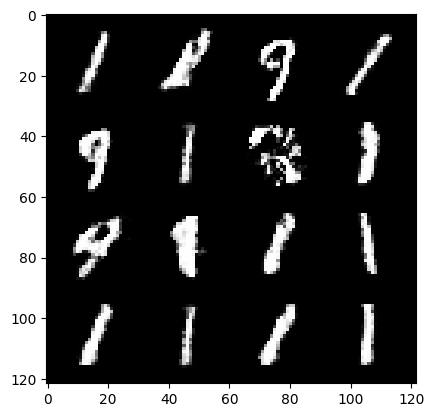

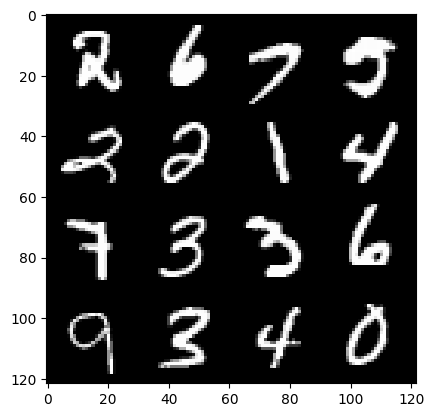

483: Step 226800 / Gen Loss : 2.1365193128585824 / Disc Loss : 0.2558215050896009


  0%|          | 0/469 [00:00<?, ?it/s]

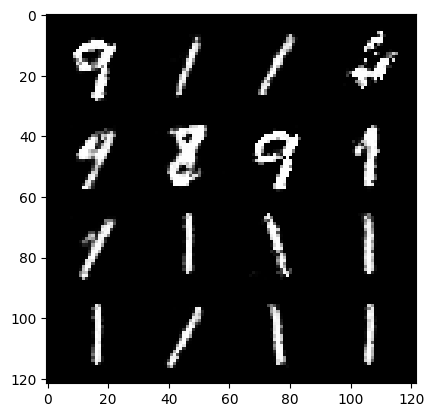

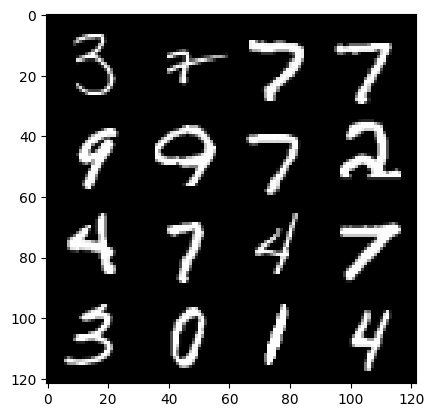

484: Step 227100 / Gen Loss : 2.1956469599405932 / Disc Loss : 0.24926888778805736


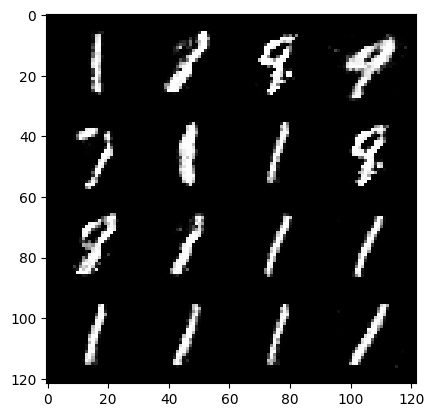

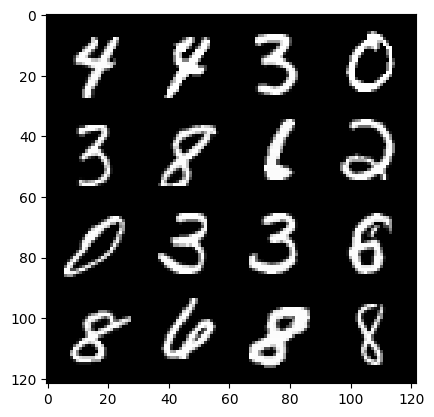

484: Step 227400 / Gen Loss : 2.1583917601903284 / Disc Loss : 0.2541829713185628


  0%|          | 0/469 [00:00<?, ?it/s]

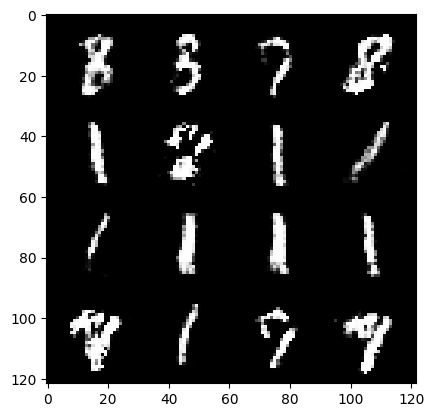

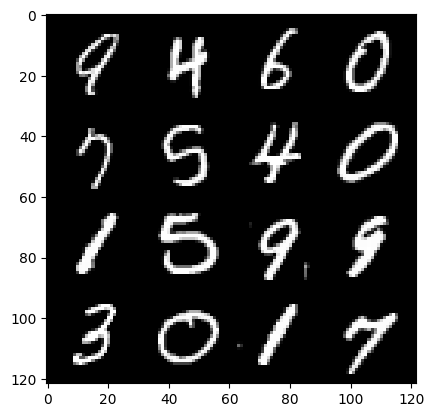

485: Step 227700 / Gen Loss : 2.0808894948164616 / Disc Loss : 0.29124520008762683


  0%|          | 0/469 [00:00<?, ?it/s]

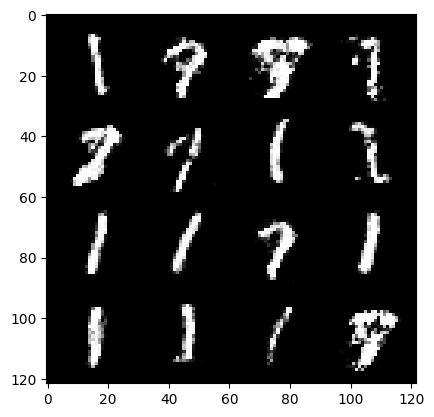

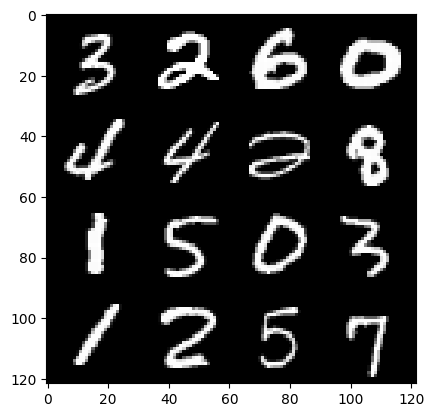

486: Step 228000 / Gen Loss : 2.0824763258298242 / Disc Loss : 0.2676529899736244


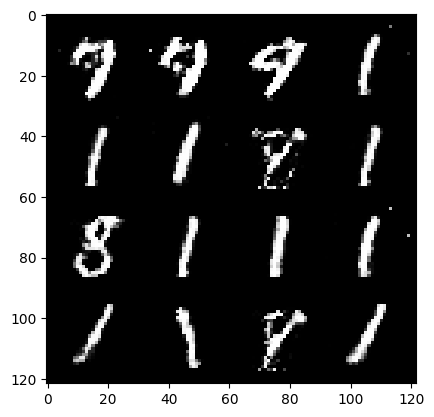

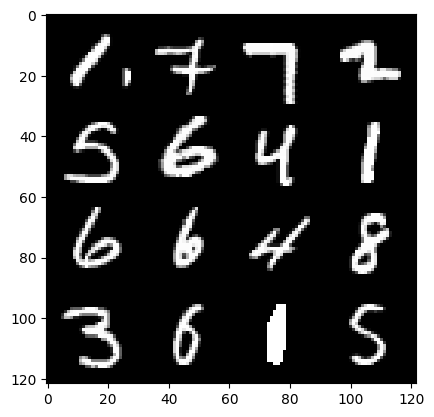

486: Step 228300 / Gen Loss : 2.138205589850744 / Disc Loss : 0.25918050145109495


  0%|          | 0/469 [00:00<?, ?it/s]

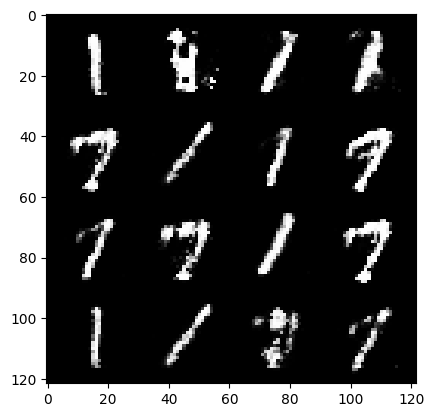

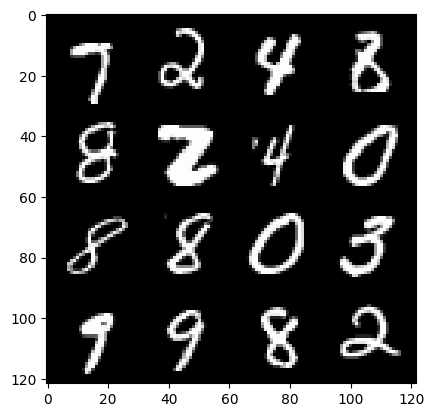

487: Step 228600 / Gen Loss : 2.19833770831426 / Disc Loss : 0.2518532573680083


  0%|          | 0/469 [00:00<?, ?it/s]

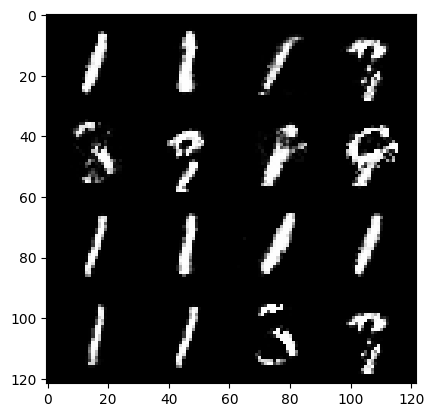

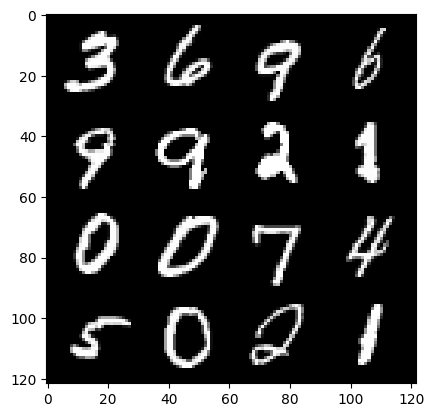

488: Step 228900 / Gen Loss : 2.277048292557399 / Disc Loss : 0.246933137277762


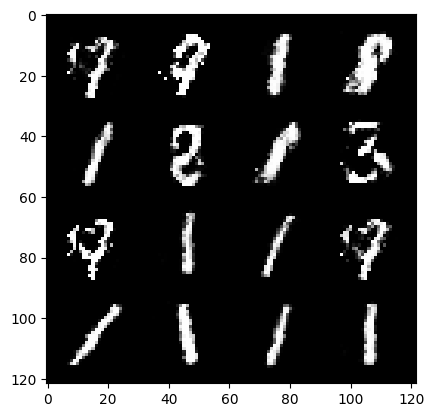

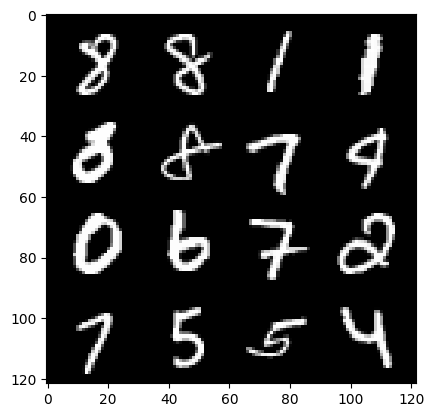

488: Step 229200 / Gen Loss : 2.180778700510661 / Disc Loss : 0.24997662767767925


  0%|          | 0/469 [00:00<?, ?it/s]

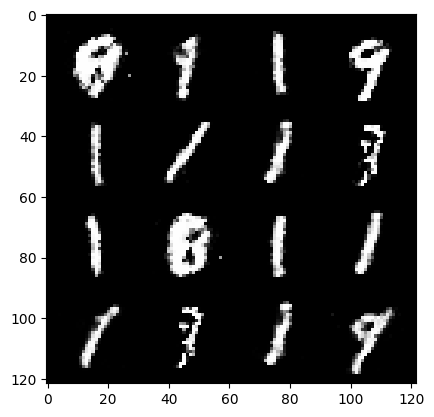

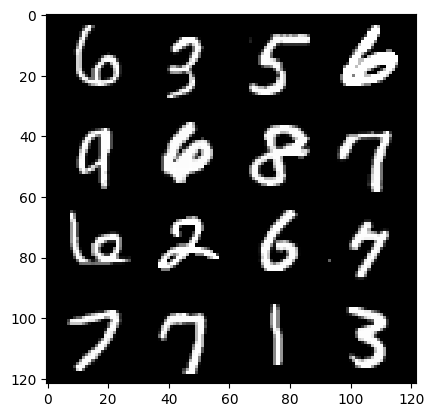

489: Step 229500 / Gen Loss : 2.257807839711507 / Disc Loss : 0.24189908196528753


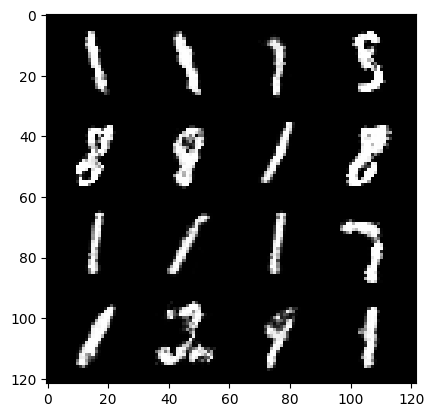

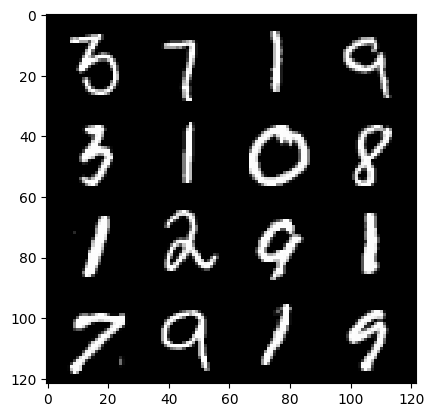

489: Step 229800 / Gen Loss : 2.1898815139134715 / Disc Loss : 0.2360527646541597


  0%|          | 0/469 [00:00<?, ?it/s]

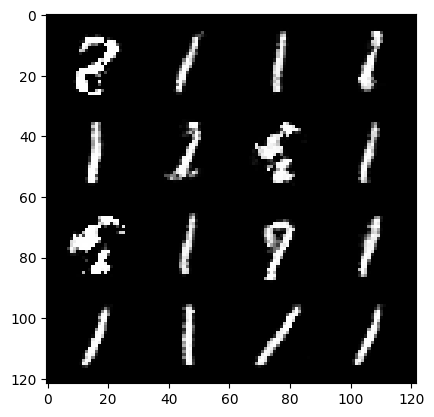

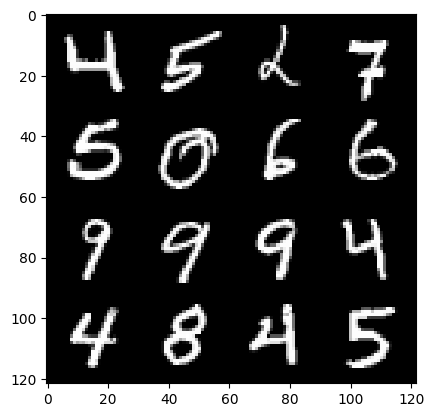

490: Step 230100 / Gen Loss : 2.173432767391205 / Disc Loss : 0.245826899210612


  0%|          | 0/469 [00:00<?, ?it/s]

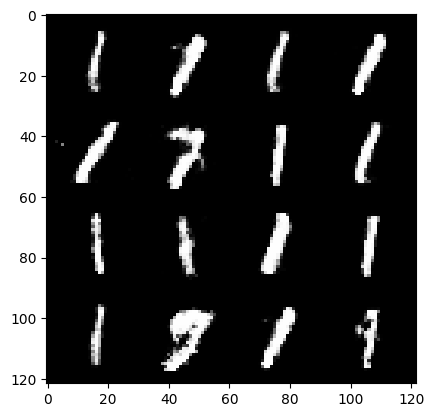

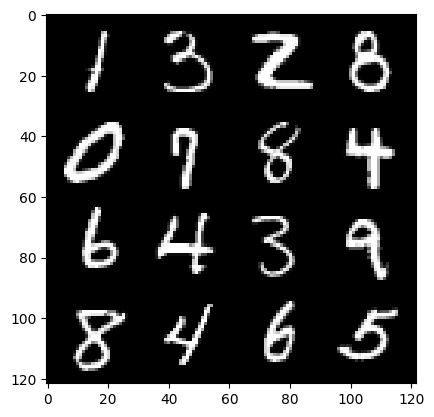

491: Step 230400 / Gen Loss : 2.22299423456192 / Disc Loss : 0.24427210589249929


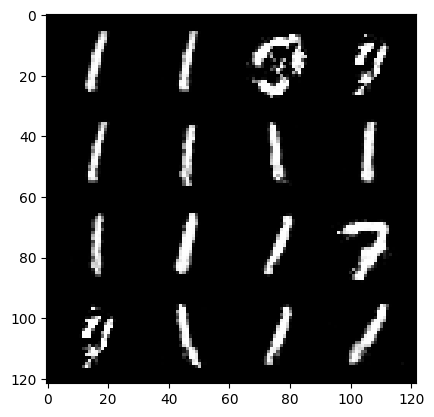

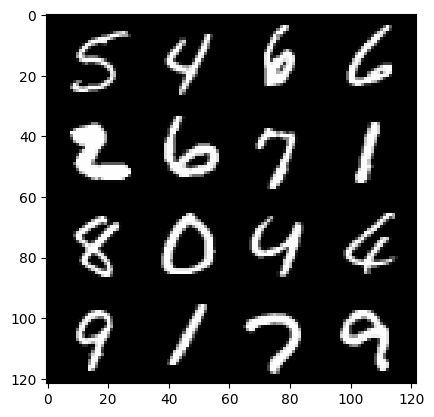

491: Step 230700 / Gen Loss : 2.20465788880984 / Disc Loss : 0.24179642349481592


  0%|          | 0/469 [00:00<?, ?it/s]

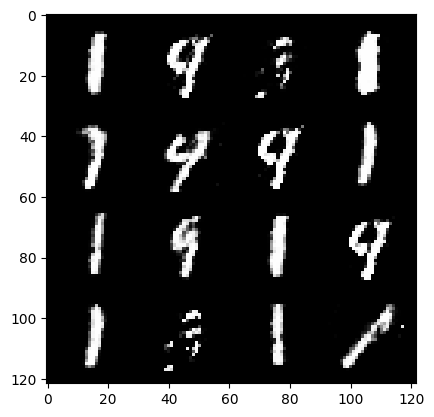

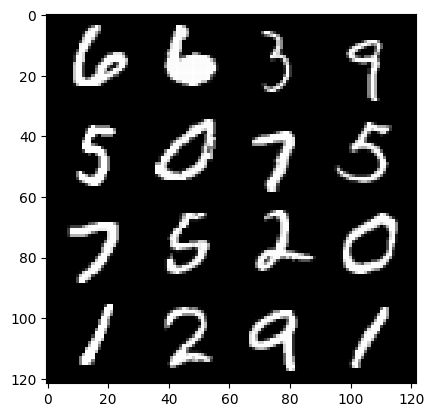

492: Step 231000 / Gen Loss : 2.2213220040003474 / Disc Loss : 0.25206627781192487


  0%|          | 0/469 [00:00<?, ?it/s]

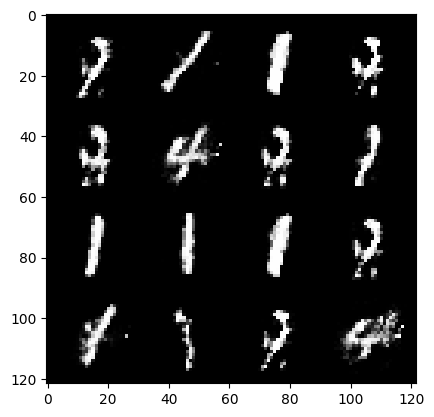

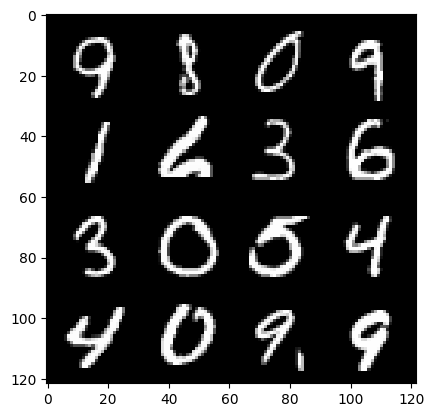

493: Step 231300 / Gen Loss : 2.1459672296047207 / Disc Loss : 0.2704677138725917


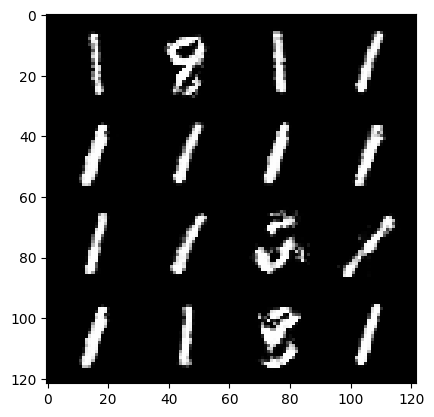

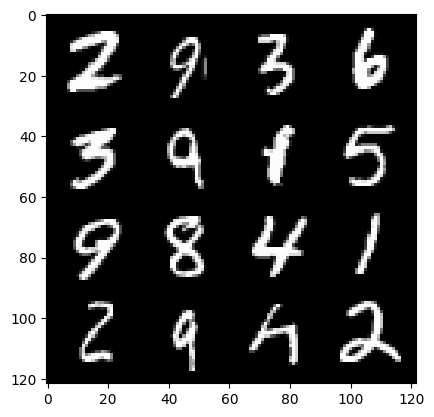

493: Step 231600 / Gen Loss : 2.022718370755513 / Disc Loss : 0.28756053715944274


  0%|          | 0/469 [00:00<?, ?it/s]

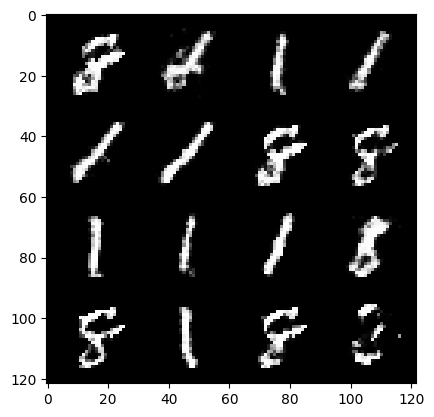

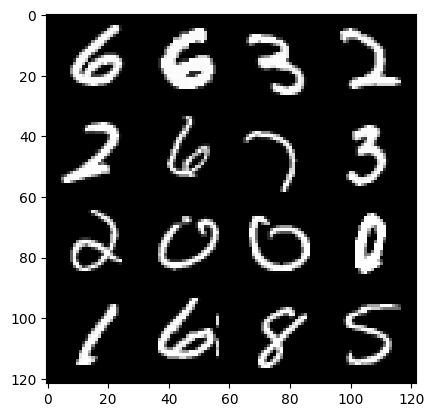

494: Step 231900 / Gen Loss : 1.9864800385634098 / Disc Loss : 0.2982109836737317


  0%|          | 0/469 [00:00<?, ?it/s]

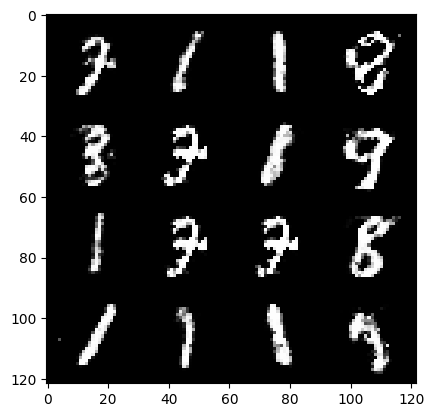

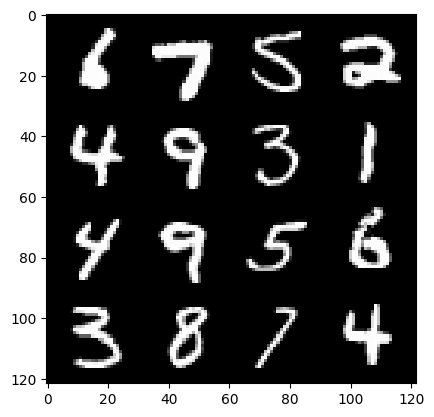

495: Step 232200 / Gen Loss : 2.037759962876638 / Disc Loss : 0.2716305519143741


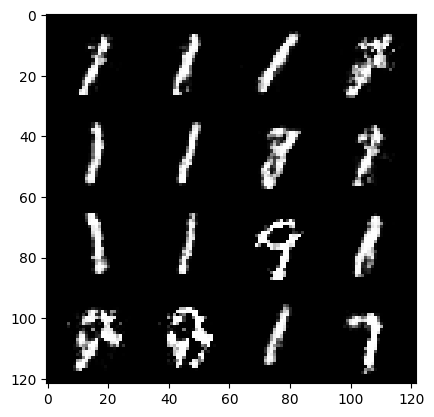

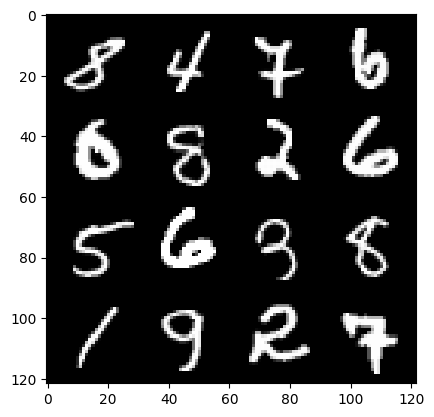

495: Step 232500 / Gen Loss : 2.1416765983899437 / Disc Loss : 0.2534311525523665


  0%|          | 0/469 [00:00<?, ?it/s]

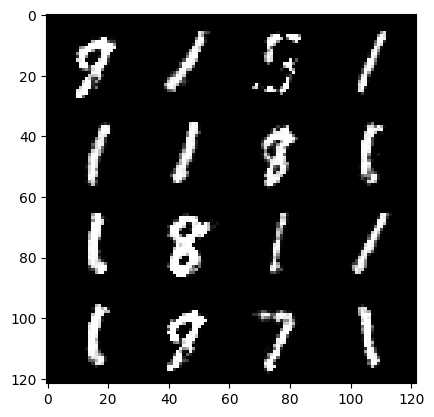

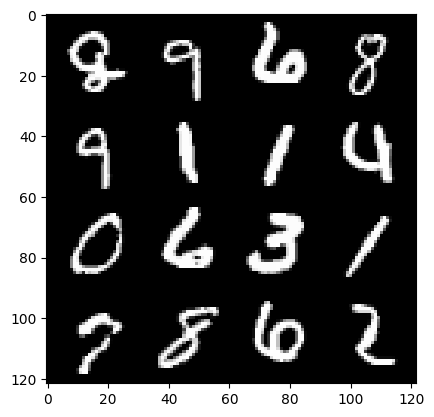

496: Step 232800 / Gen Loss : 2.1788205115000414 / Disc Loss : 0.25597326631347356


  0%|          | 0/469 [00:00<?, ?it/s]

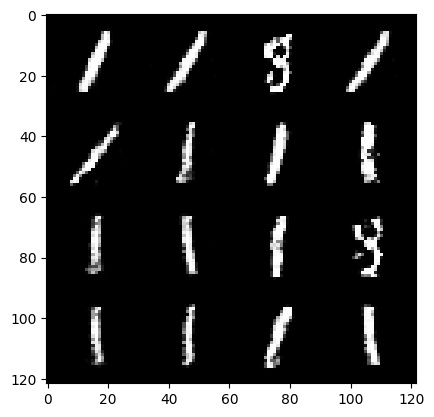

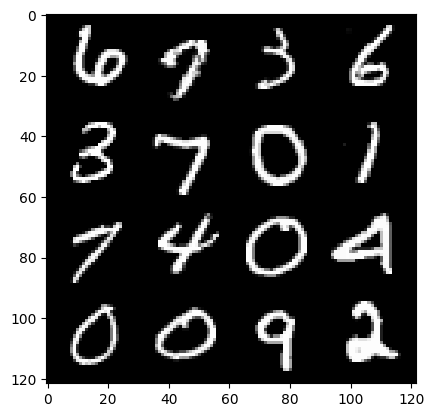

497: Step 233100 / Gen Loss : 2.1622422802448287 / Disc Loss : 0.2520840676625571


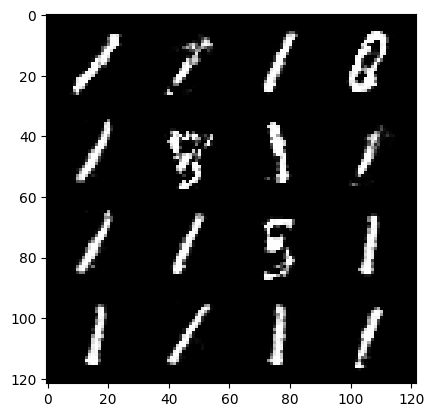

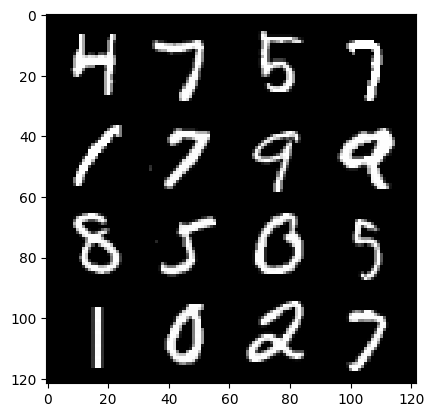

497: Step 233400 / Gen Loss : 2.167032691240311 / Disc Loss : 0.2577748442689577


  0%|          | 0/469 [00:00<?, ?it/s]

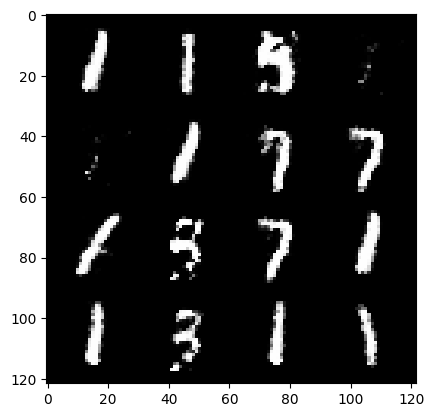

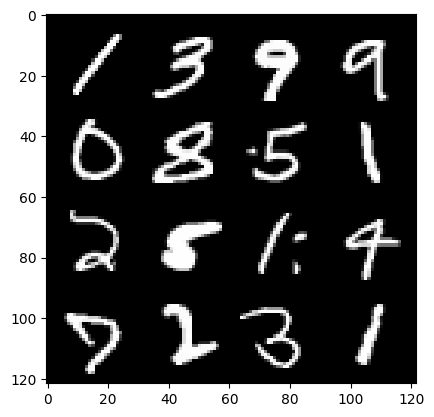

498: Step 233700 / Gen Loss : 2.223850109974543 / Disc Loss : 0.25608713860313104


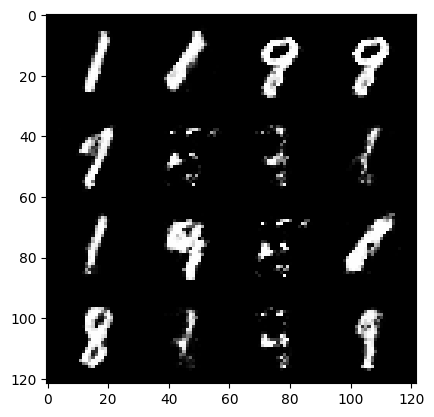

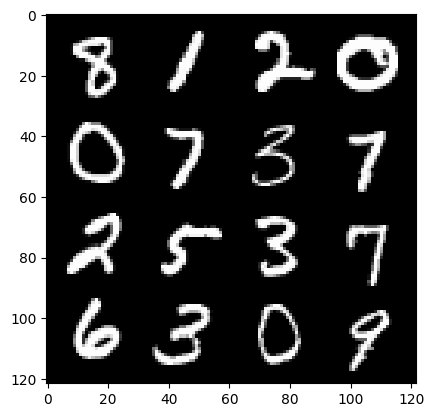

498: Step 234000 / Gen Loss : 2.2585635372002923 / Disc Loss : 0.22906036908427885


  0%|          | 0/469 [00:00<?, ?it/s]

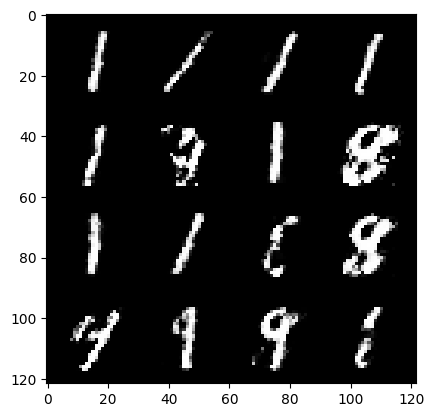

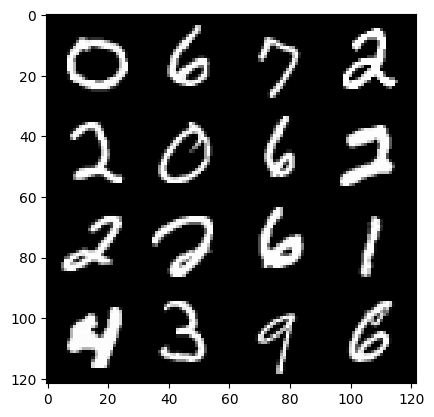

499: Step 234300 / Gen Loss : 2.1317294673124962 / Disc Loss : 0.2610565229753654


In [15]:
for epoch in range(epochs):
    for real, _ in tqdm(dataloader): # _ is labels
        # Discriminator
        disc_opt.zero_grad()#set initial params
        cur_batch_size = len(real) # since batch size is different for last set (not 128x1x28x28)
        real = real.view(cur_batch_size, -1) #128x784 reshaping
        real = real.to(device)
        
        disc_loss_val = disc_loss(loss_fn, gen, disc, cur_batch_size, real, z_dim)
        disc_loss_val.backward(retain_graph=True)
        disc_opt.step()#one update for parameters
        
        #Generator
        gen_opt.zero_grad()
        gen_loss_val = gen_loss(loss_fn, gen, disc, cur_batch_size, z_dim)
        gen_loss_val.backward(retain_graph=True)
        gen_opt.step()
        
        #visualize & stats
        mean_disc_loss += disc_loss_val.item() / info_step # .item() - for compatibility
        mean_gen_loss += gen_loss_val.item() / info_step
        
        if(cur_step%info_step==0 and cur_step>0):
            fake_noise = gen_noise(cur_batch_size, z_dim)
            fake = gen(fake_noise)
            show(fake)
            show(real)
            print(f"{epoch}: Step {cur_step} / Gen Loss : {mean_gen_loss} / Disc Loss : {mean_disc_loss}")
            mean_disc_loss, mean_gen_loss = 0,0
        cur_step+=1